# Comparison of MLP and SVM

# 1. EDA

In [55]:
import torch
import torch.nn as nn
import sklearn 
from sklearn.model_selection import train_test_split
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import numpy as np
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from skorch.callbacks import EarlyStopping
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

from sklearn.preprocessing import StandardScaler    
from sklearn.metrics import confusion_matrix, classification_report
from skorch import NeuralNetClassifier


In [56]:
df = pd.read_csv('HD.csv')
df.head()


,HeartDiseaseorAttack,HighBP,HighChol,CholCheck,BMI,Smoker,Stroke,Diabetes,PhysActivity,Fruits,...,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income
0,0.0,1.0,1.0,1.0,40.0,1.0,0.0,0.0,0.0,0.0,...,1.0,0.0,5.0,18.0,15.0,1.0,0.0,9.0,4.0,3.0
1,0.0,0.0,0.0,0.0,25.0,1.0,0.0,0.0,1.0,0.0,...,0.0,1.0,3.0,0.0,0.0,0.0,0.0,7.0,6.0,1.0
2,0.0,1.0,1.0,1.0,28.0,0.0,0.0,0.0,0.0,1.0,...,1.0,1.0,5.0,30.0,30.0,1.0,0.0,9.0,4.0,8.0
3,0.0,1.0,0.0,1.0,27.0,0.0,0.0,0.0,1.0,1.0,...,1.0,0.0,2.0,0.0,0.0,0.0,0.0,11.0,3.0,6.0
4,0.0,1.0,1.0,1.0,24.0,0.0,0.0,0.0,1.0,1.0,...,1.0,0.0,2.0,3.0,0.0,0.0,0.0,11.0,5.0,4.0


In [57]:
len(df.columns)

22

In [58]:
df.isna().sum()

HeartDiseaseorAttack    0
HighBP                  0
HighChol                0
CholCheck               0
BMI                     0
Smoker                  0
Stroke                  0
Diabetes                0
PhysActivity            0
Fruits                  0
Veggies                 0
HvyAlcoholConsump       0
AnyHealthcare           0
NoDocbcCost             0
GenHlth                 0
MentHlth                0
PhysHlth                0
DiffWalk                0
Sex                     0
Age                     0
Education               0
Income                  0
dtype: int64

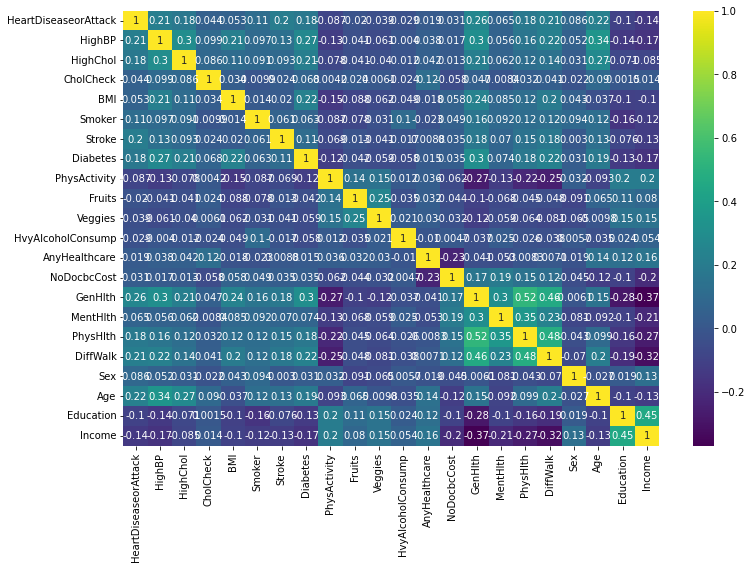

In [59]:
plt.figure(figsize=(12,8))
dffullheatmap = sns.heatmap(df.corr(),cmap='viridis',annot=True)
dffullheatmap.figure.savefig("figure1DFHEATMAP.png") 
plt.savefig("corrmatrix.png")


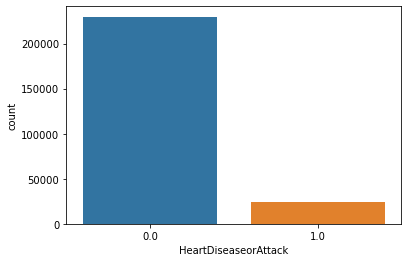

In [60]:
ClassImbalance = sns.countplot(x='HeartDiseaseorAttack',data=df)
plt.savefig("classimbalance.png")


In [61]:
df[df['HeartDiseaseorAttack']==1]['HeartDiseaseorAttack'].count()

23893

In [62]:
df[df['HeartDiseaseorAttack']==0]['HeartDiseaseorAttack'].count()

229787

# 2. Creating Training/Validation/Testing

### a) A stratified holdout is set created. It contains the same ratio of classes as the original data and will only be used for final Model Evaluation. Remaining data is called 'Set A'.

### b) Due to the large data set size, hyper-parameter tuning will be done using a smaller sample (10% of Set A) , "Sample 1", of the data. The remaining data is "Sample 2" (90% of Set A). 

### c) Sample 1 will be split into stratified training and validation sets for hyperparameter tuning. The training set will undergo SMOTE to fix the class imbalance. The Validation set will remain unbalanced to resemble the stratified hold-out set.

### d) Hyperparameter tuning will be done using the class balanced Sample 1 training data and the imbalanced Sample 1 validation data.

### e) Once the best hyperparamters are found, Sample 1 is no longer used. Sample 2 will be split into a NEW training and stratified validation set. The training set will be balanced with SMOTE. The models will be trained with the training data using the previously decided hyper-parameters (step d). Due to the large dataset and to have a clearer pipeline, Sample 1 is ignored after hyper-parameter tunin rather than being recombined with Sample 2 to for a new Set which would require undergoing subsequent splits and SMOTE.

## 2.1 Creating the sets: 
- X_holdout and y_holdout
- X_train_S1, X_valid_S1, y_train_S1, y_valid_S1 from Sample 1
- X_train_S2, X_valid_S2, y_train_S2, y_valid_S2 from Sample 2

In [96]:
X = df.drop('HeartDiseaseorAttack', axis = 1)
y = df['HeartDiseaseorAttack']


In [97]:
# Create Holdout sets
X_, X_Holdout, y_, y_Holdout = train_test_split(X,y,test_size = 0.1,random_state = 2, shuffle=True, stratify=y) 


In [98]:
# Create sample 1 and sample 2 using all data except hold-out set
X_sample2, X_sample1, y_sample2, y_sample1 = train_test_split(X_,y_,test_size = 0.1,random_state = 1, shuffle=True, stratify=y_) 




In [99]:
# Create training and validation sets from sample1 for Hyperparameter training
X_train_S1, X_valid_S1, y_train_S1, y_valid_S1 = train_test_split(X_sample1,y_sample1,test_size = 0.3,random_state = 1, shuffle=True, stratify=y_sample1) 


In [100]:
# Create training and validation sets from sample2 for final training and validation.
X_train_S2, X_valid_S2, y_train_S2, y_valid_S2 = train_test_split(X_sample2,y_sample2,test_size = 0.1,random_state = 1, shuffle=True, stratify=y_sample2) 


## 2.2 SMOTE 

### Balancing X_train_S1 and y_train_S1

In [101]:
from imblearn.over_sampling import SMOTE 

In [102]:
# Rebalancing training set

In [103]:
from collections import Counter
oversample = SMOTE()
X_train_S1_b, y_train_S1_b = oversample.fit_resample(X_train_S1, y_train_S1) # _b for balanced

In [104]:
counter = Counter(y_train_S1)
print('Before:', counter)
counter = Counter(y_train_S1_b)
print('After:', counter)

Before: Counter({0.0: 14477, 1.0: 1505})
After: Counter({0.0: 14477, 1.0: 14477})


### Balancing X_train_S2 and y_train_S2

In [105]:
from collections import Counter
oversample = SMOTE()
X_train_S2_b, y_train_S2_b = oversample.fit_resample(X_train_S2, y_train_S2) # _b for balanced

In [106]:
counter = Counter(y_train_S2)
print('Before:', counter)
counter = Counter(y_train_S2_b)
print('After:', counter)

Before: Counter({0.0: 167513, 1.0: 17419})
After: Counter({0.0: 167513, 1.0: 167513})


## 2.3 Standardising Training and Validation sets

- To avoid data leakage, the training and validation sets are standardised seperately
- The data needs to be converted to a dataframe for section 2.4

### Sample 1

In [107]:
# Converting back to dataframes as necessary for next section 2.4 "Creating Indices..."
# Standardising seperated to avoid data leakage from validation set
scaler = StandardScaler()
X_train_S1_b =pd.DataFrame(scaler.fit_transform(X_train_S1_b).astype('float32'))
X_valid_S1 = pd.DataFrame(scaler.transform(X_valid_S1).astype('float32'))
y_train_S1_b =pd.DataFrame(y_train_S1_b.to_numpy().astype('int64'))
y_valid_S1 = pd.DataFrame(y_valid_S1.to_numpy().astype('int64'))

### Sample 2

In [108]:
scaler_final = StandardScaler()
X_train_S2_b =pd.DataFrame(scaler_final.fit_transform(X_train_S2_b).astype('float32'))
pickle.dump(scaler_final, open('scaler.pkl', 'wb'))
#Saving scalar
X_valid_S2 = pd.DataFrame(scaler_final.transform(X_valid_S2).astype('float32'))
y_train_S2_b =pd.DataFrame(y_train_S2_b.to_numpy().astype('int64'))
y_valid_S2 = pd.DataFrame(y_valid_S2.to_numpy().astype('int64'))

### Holdout

In [109]:
X_Holdout = scaler_final.transform(X_Holdout)

## 2.4 Creating indices to specify my own train - validation split in gridsearchcv, otherwise the gridsearch function will split the data randomly itself. This is done because I have balanced the training set via smote but don't want to balance the validation set so it is more representitive of the final holdout set. K-fold crossvalidation not used due to large dataset size

In [110]:
#To specify my own explicit training and validation sets in the gridsearchCV function,
#I need to recombine my unbalanced validation set and balanced training set,
# then provide the gridsearch function with indices to resplit the two sets 
#(ensuring the training set is still balanced and validation is stratified).
# The dataset is large, therefore kfold cross validation is not feasible  
# Code adapted from: https://stackoverflow.com/questions/48390601/explicitly-specifying-test-train-sets-in-gridsearchcv
from sklearn.model_selection import PredefinedSplit

In [111]:
print(len(X_train_S1_b), len(y_train_S1_b))
print(len(X_valid_S1), len(y_valid_S1))
y_temp = np.array(pd.concat([y_train_S1_b, y_valid_S1], axis=0),dtype=np.int64) # y_temp = y_train_S1_b + y_valid_S1
X_temp = np.array(pd.concat([X_train_S1_b, X_valid_S1], axis=0),dtype=np.float32) # X_temp = X_train_S1_b + X_valid_S1_b
print(len(X_temp), len(y_temp))
train_indices = np.full((28954,), -1, dtype=int)
test_indices = np.full((6850,), 0, dtype=int)
test_fold = np.append(train_indices, test_indices)
print(len(test_fold))
ps = PredefinedSplit(test_fold)
print(ps.get_n_splits())
for train_index, test_index in ps.split():
    print("TRAIN:", train_index, "TEST:", test_index)

28954 28954
6850 6850
35804 35804
35804
1
TRAIN: [    0     1     2 ... 28951 28952 28953] TEST: [28954 28955 28956 ... 35801 35802 35803]


In [112]:
print(len(X_train_S2_b), len(y_train_S2_b))
print(len(X_valid_S2), len(y_valid_S2))
y_temp1 = np.array(pd.concat([y_train_S2_b, y_valid_S2], axis=0),dtype=np.int64)
X_temp1 = np.array(pd.concat([X_train_S2_b, X_valid_S2], axis=0),dtype=np.float32)
print(len(X_temp1), len(y_temp1))
train_indices1 = np.full((335026,), -1, dtype=int)
test_indices1 = np.full((20548,), 0, dtype=int)
test_fold1 = np.append(train_indices1, test_indices1)
print(len(test_fold1))
ps1 = PredefinedSplit(test_fold1)
print(ps1.get_n_splits())
for train_index, test_index in ps1.split():
    print("TRAIN:", train_index, "TEST:", test_index)

335026 335026
20548 20548
355574 355574
355574
1
TRAIN: [     0      1      2 ... 335023 335024 335025] TEST: [335026 335027 335028 ... 355571 355572 355573]


## Converting back to np arrays for future use

In [113]:
X_train_S1_b = np.array(X_train_S1_b, dtype=np.float32) 
y_train_S1_b = np.array(y_train_S1_b, dtype=np.int64).ravel()

In [114]:
X_train_S2_b = np.array(X_train_S2_b, dtype=np.float32) 
y_train_S2_b = np.array(y_train_S2_b, dtype=np.int64).ravel()

In [115]:
print(X_train_S2_b.shape, y_train_S2_b.shape)
print(type(y_train_S2_b), type(X_train_S2_b))
print(y_train_S2_b.dtype, X_train_S2_b.dtype)

(335026, 21) (335026,)
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
int64 float32


In [116]:
print(X_valid_S2.shape, y_valid_S2.shape)
print(type(y_valid_S2), type(X_valid_S2))


(20548, 21) (20548, 1)
<class 'pandas.core.frame.DataFrame'> <class 'pandas.core.frame.DataFrame'>


# 3. SVM

In [34]:
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV

## The following hyper-parameters are optimised:
- Kernel
- C (for all kernels)
- Gamma (for sigmoid, rbf and poly)
- Degree for poly
​
## Method:
- Perform Gridsearch for each kernel
- Potentially repeat over updated range of hyper-parameter values
- Use F1 score to accommodate for class imbalance; both false negatives and false postives will be costly.

### 3.1 Kernel : Linear
### C is optimised

In [ ]:
#https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html

In [26]:
svm = SVC(kernel = 'linear')
params = {'C':[0.01, 0.1, 0.5, 1]}
svm_grid = GridSearchCV(svm,params, refit=False, verbose=3, cv=ps,
    error_score="raise" , scoring = 'f1')
print(svm_grid.fit(X_temp, y_temp))

Fitting 1 folds for each of 4 candidates, totalling 4 fits
[CV 1/1] END ............................C=0.01;, score=0.376 total time=  22.4s
[CV 1/1] END .............................C=0.1;, score=0.376 total time=  23.3s
[CV 1/1] END .............................C=0.5;, score=0.377 total time=  33.8s
[CV 1/1] END ...............................C=1;, score=0.377 total time=  45.3s
GridSearchCV(cv=PredefinedSplit(test_fold=array([-1, -1, ...,  0,  0])),
             error_score='raise', estimator=SVC(kernel='linear'),
             param_grid={'C': [0.01, 0.1, 0.5, 1]}, refit=False, scoring='f1',
             verbose=3)


In [27]:
print(svm_grid.best_score_, svm_grid.best_params_)
pd.DataFrame(svm_grid.cv_results_)

0.37671728127259585 {'C': 0.5}


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,params,split0_test_score,mean_test_score,std_test_score,rank_test_score
0,19.403029,0.0,3.004115,0.0,0.01,{'C': 0.01},0.376038,0.376038,0.0,4
1,20.315893,0.0,2.968776,0.0,0.1,{'C': 0.1},0.376309,0.376309,0.0,3
2,30.864140,0.0,2.964952,0.0,0.5,{'C': 0.5},0.376717,0.376717,0.0,1
3,42.324906,0.0,2.968401,0.0,1,{'C': 1},0.376717,0.376717,0.0,1


### 3.2 Kernel : Sigmoid
### C and gamma are optimised

In [28]:
svm = SVC(kernel = 'sigmoid')
params = {'C':[0.01, 0.1, 0.5, 1], 'gamma' : [0.01, 0.1, 0.001]}
svm_grid = GridSearchCV(svm,params, refit=False, verbose=3, cv=ps,
    error_score="raise" , scoring = 'f1')
print(svm_grid.fit(X_temp, y_temp))

Fitting 1 folds for each of 12 candidates, totalling 12 fits
[CV 1/1] END ................C=0.01, gamma=0.01;, score=0.365 total time=  37.4s
[CV 1/1] END .................C=0.01, gamma=0.1;, score=0.332 total time=  42.9s
[CV 1/1] END ...............C=0.01, gamma=0.001;, score=0.383 total time=  50.5s
[CV 1/1] END .................C=0.1, gamma=0.01;, score=0.374 total time=  32.1s
[CV 1/1] END ..................C=0.1, gamma=0.1;, score=0.296 total time=  53.9s
[CV 1/1] END ................C=0.1, gamma=0.001;, score=0.365 total time=  37.2s
[CV 1/1] END .................C=0.5, gamma=0.01;, score=0.370 total time=  31.3s
[CV 1/1] END ..................C=0.5, gamma=0.1;, score=0.292 total time=  41.0s
[CV 1/1] END ................C=0.5, gamma=0.001;, score=0.372 total time=  32.7s
[CV 1/1] END ...................C=1, gamma=0.01;, score=0.362 total time=  30.8s
[CV 1/1] END ....................C=1, gamma=0.1;, score=0.292 total time=  40.3s
[CV 1/1] END ..................C=1, gamma=0.001;

In [29]:
print(svm_grid.best_score_, svm_grid.best_params_)
pd.DataFrame(svm_grid.cv_results_)

0.3833533413365346 {'C': 0.01, 'gamma': 0.001}


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_gamma,params,split0_test_score,mean_test_score,std_test_score,rank_test_score
0,31.627375,0.0,5.793244,0.0,0.01,0.01,"{'C': 0.01, 'gamma': 0.01}",0.365134,0.365134,0.0,6
1,37.801103,0.0,5.107792,0.0,0.01,0.1,"{'C': 0.01, 'gamma': 0.1}",0.331727,0.331727,0.0,9
2,42.027806,0.0,8.422550,0.0,0.01,0.001,"{'C': 0.01, 'gamma': 0.001}",0.383353,0.383353,0.0,1
3,27.466337,0.0,4.673727,0.0,0.1,0.01,"{'C': 0.1, 'gamma': 0.01}",0.373978,0.373978,0.0,2
4,50.116112,0.0,3.750620,0.0,0.1,0.1,"{'C': 0.1, 'gamma': 0.1}",0.295881,0.295881,0.0,10
5,31.456662,0.0,5.764137,0.0,0.1,0.001,"{'C': 0.1, 'gamma': 0.001}",0.364948,0.364948,0.0,7
6,26.919606,0.0,4.416023,0.0,0.5,0.01,"{'C': 0.5, 'gamma': 0.01}",0.369873,0.369873,0.0,5
7,37.448151,0.0,3.568826,0.0,0.5,0.1,"{'C': 0.5, 'gamma': 0.1}",0.291980,0.291980,0.0,11
8,27.826446,0.0,4.862971,0.0,0.5,0.001,"{'C': 0.5, 'gamma': 0.001}",0.372044,0.372044,0.0,4
9,26.539804,0.0,4.291742,0.0,1,0.01,"{'C': 1, 'gamma': 0.01}",0.362155,0.362155,0.0,8


### 3.3 Kernel : rbf
### C and Gamma are optimised

In [30]:
svm = SVC(kernel = 'rbf')
params = {'C':[0.01, 0.1, 0.5, 1], 'gamma' : [0.01, 0.1, 0.001]}
svm_grid = GridSearchCV(svm,params, refit=False, verbose=3, cv=ps,
    error_score="raise" , scoring = 'f1')
print(svm_grid.fit(X_temp, y_temp))

Fitting 1 folds for each of 12 candidates, totalling 12 fits
[CV 1/1] END ................C=0.01, gamma=0.01;, score=0.370 total time=  47.9s
[CV 1/1] END .................C=0.01, gamma=0.1;, score=0.372 total time=  52.3s
[CV 1/1] END ...............C=0.01, gamma=0.001;, score=0.368 total time= 1.1min
[CV 1/1] END .................C=0.1, gamma=0.01;, score=0.382 total time=  39.3s
[CV 1/1] END ..................C=0.1, gamma=0.1;, score=0.403 total time=  38.4s
[CV 1/1] END ................C=0.1, gamma=0.001;, score=0.368 total time=  47.4s
[CV 1/1] END .................C=0.5, gamma=0.01;, score=0.406 total time=  34.0s
[CV 1/1] END ..................C=0.5, gamma=0.1;, score=0.391 total time=  31.7s
[CV 1/1] END ................C=0.5, gamma=0.001;, score=0.376 total time=  42.5s
[CV 1/1] END ...................C=1, gamma=0.01;, score=0.414 total time=  31.6s
[CV 1/1] END ....................C=1, gamma=0.1;, score=0.369 total time=  31.9s
[CV 1/1] END ..................C=1, gamma=0.001;

In [31]:
print(svm_grid.best_score_, svm_grid.best_params_)
pd.DataFrame(svm_grid.cv_results_)

0.41390374331550805 {'C': 1, 'gamma': 0.01}


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_gamma,params,split0_test_score,mean_test_score,std_test_score,rank_test_score
0,36.245357,0.0,11.611749,0.0,0.01,0.01,"{'C': 0.01, 'gamma': 0.01}",0.370423,0.370423,0.0,9
1,39.304259,0.0,12.987112,0.0,0.01,0.1,"{'C': 0.01, 'gamma': 0.1}",0.372328,0.372328,0.0,8
2,47.029452,0.0,16.316297,0.0,0.01,0.001,"{'C': 0.01, 'gamma': 0.001}",0.367726,0.367726,0.0,11
3,30.023870,0.0,9.324493,0.0,0.1,0.01,"{'C': 0.1, 'gamma': 0.01}",0.381600,0.381600,0.0,5
4,29.168097,0.0,9.201601,0.0,0.1,0.1,"{'C': 0.1, 'gamma': 0.1}",0.403166,0.403166,0.0,3
5,36.109717,0.0,11.327855,0.0,0.1,0.001,"{'C': 0.1, 'gamma': 0.001}",0.367616,0.367616,0.0,12
6,25.813033,0.0,8.200935,0.0,0.5,0.01,"{'C': 0.5, 'gamma': 0.01}",0.406325,0.406325,0.0,2
7,24.762609,0.0,6.939229,0.0,0.5,0.1,"{'C': 0.5, 'gamma': 0.1}",0.390884,0.390884,0.0,4
8,32.564977,0.0,9.894969,0.0,0.5,0.001,"{'C': 0.5, 'gamma': 0.001}",0.375723,0.375723,0.0,7
9,23.997037,0.0,7.584374,0.0,1,0.01,"{'C': 1, 'gamma': 0.01}",0.413904,0.413904,0.0,1


### Repeated over updated range of hyper-parameter values informed by the previous gridsearch

In [43]:
svm = SVC(kernel = 'rbf')
params = {'C':[0.01, 0.1, 0.5, 1], 'gamma' : [0.01, 0.1, 0.05, 0.2]}
svm_grid = GridSearchCV(svm,params, refit=False, verbose=3, cv=ps,
    error_score="raise" , scoring = 'f1')
print(svm_grid.fit(X_temp, y_temp))

Fitting 1 folds for each of 16 candidates, totalling 16 fits
[CV 1/1] END ................C=0.01, gamma=0.01;, score=0.368 total time=  48.0s
[CV 1/1] END .................C=0.01, gamma=0.1;, score=0.371 total time=  51.7s
[CV 1/1] END ................C=0.01, gamma=0.05;, score=0.373 total time=  46.5s
[CV 1/1] END .................C=0.01, gamma=0.2;, score=0.266 total time= 1.0min
[CV 1/1] END .................C=0.1, gamma=0.01;, score=0.383 total time=  38.4s
[CV 1/1] END ..................C=0.1, gamma=0.1;, score=0.408 total time=  37.6s
[CV 1/1] END .................C=0.1, gamma=0.05;, score=0.410 total time=  34.6s
[CV 1/1] END ..................C=0.1, gamma=0.2;, score=0.388 total time=  45.7s
[CV 1/1] END .................C=0.5, gamma=0.01;, score=0.404 total time=  33.7s
[CV 1/1] END ..................C=0.5, gamma=0.1;, score=0.379 total time=  31.3s
[CV 1/1] END .................C=0.5, gamma=0.05;, score=0.406 total time=  28.3s
[CV 1/1] END ..................C=0.5, gamma=0.2;

In [45]:
print(svm_grid.best_score_, svm_grid.best_params_)
pd.DataFrame(svm_grid.cv_results_)

0.41523605150214593 {'C': 1, 'gamma': 0.01}


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_gamma,params,split0_test_score,mean_test_score,std_test_score,rank_test_score
0,36.417358,0.0,11.572245,0.0,0.01,0.01,"{'C': 0.01, 'gamma': 0.01}",0.367994,0.367994,0.0,12
1,38.909113,0.0,12.794364,0.0,0.01,0.1,"{'C': 0.01, 'gamma': 0.1}",0.370543,0.370543,0.0,11
2,35.183703,0.0,11.283306,0.0,0.01,0.05,"{'C': 0.01, 'gamma': 0.05}",0.373129,0.373129,0.0,10
3,46.607469,0.0,15.596915,0.0,0.01,0.2,"{'C': 0.01, 'gamma': 0.2}",0.266218,0.266218,0.0,16
4,29.409826,0.0,8.984291,0.0,0.1,0.01,"{'C': 0.1, 'gamma': 0.01}",0.383320,0.383320,0.0,8
5,28.607615,0.0,8.957906,0.0,0.1,0.1,"{'C': 0.1, 'gamma': 0.1}",0.408055,0.408055,0.0,3
6,26.317139,0.0,8.332793,0.0,0.1,0.05,"{'C': 0.1, 'gamma': 0.05}",0.409771,0.409771,0.0,2
7,34.386046,0.0,11.354151,0.0,0.1,0.2,"{'C': 0.1, 'gamma': 0.2}",0.388339,0.388339,0.0,7
8,25.598556,0.0,8.073008,0.0,0.5,0.01,"{'C': 0.5, 'gamma': 0.01}",0.403837,0.403837,0.0,5
9,24.444688,0.0,6.895137,0.0,0.5,0.1,"{'C': 0.5, 'gamma': 0.1}",0.379286,0.379286,0.0,9


### 3.4 Kernel : Poly
### Optimising C, Gamma and degree

In [32]:
svm = SVC(kernel = 'poly')
params = {'C':[0.01, 0.1, 0.5, 1], 'gamma' : [0.01, 0.1, 0.001], 'degree' : [1,2,3,4,5]}
svm_grid = GridSearchCV(svm,params, refit=False, verbose=3, cv=ps,
    error_score="raise" , scoring = 'f1')
print(svm_grid.fit(X_temp, y_temp))

Fitting 1 folds for each of 60 candidates, totalling 60 fits
[CV 1/1] END C=0.01, degree=1, gamma=0.01, kernel=poly;, score=0.365 total time=  29.8s
[CV 1/1] END C=0.01, degree=1, gamma=0.1, kernel=poly;, score=0.374 total time=  25.3s
[CV 1/1] END C=0.01, degree=1, gamma=0.001, kernel=poly;, score=0.383 total time=  40.9s
[CV 1/1] END C=0.01, degree=2, gamma=0.01, kernel=poly;, score=0.185 total time=39.5min
[CV 1/1] END C=0.01, degree=2, gamma=0.1, kernel=poly;, score=0.335 total time= 2.0min
[CV 1/1] END C=0.01, degree=2, gamma=0.001, kernel=poly;, score=0.180 total time=  42.5s
[CV 1/1] END C=0.01, degree=3, gamma=0.01, kernel=poly;, score=0.185 total time=  42.5s
[CV 1/1] END C=0.01, degree=3, gamma=0.1, kernel=poly;, score=0.364 total time=  26.8s
[CV 1/1] END C=0.01, degree=3, gamma=0.001, kernel=poly;, score=0.179 total time=  42.6s
[CV 1/1] END C=0.01, degree=4, gamma=0.01, kernel=poly;, score=0.175 total time=  43.8s
[CV 1/1] END C=0.01, degree=4, gamma=0.1, kernel=poly;, sco

In [33]:
print(svm_grid.best_score_, svm_grid.best_params_)
pd.DataFrame(svm_grid.cv_results_)

0.39340885684860966 {'C': 0.1, 'degree': 3, 'gamma': 0.01, 'kernel': 'poly'}


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_degree,param_gamma,param_kernel,params,split0_test_score,mean_test_score,std_test_score,rank_test_score
0,25.403225,0.0,4.432230,0.0,0.01,1,0.01,poly,"{'C': 0.01, 'degree': 1, 'gamma': 0.01, 'kerne...",0.364948,0.364948,0.0,18
1,21.776853,0.0,3.542523,0.0,0.01,1,0.1,poly,"{'C': 0.01, 'degree': 1, 'gamma': 0.1, 'kernel...",0.373799,0.373799,0.0,11
2,34.466876,0.0,6.416516,0.0,0.01,1,0.001,poly,"{'C': 0.01, 'degree': 1, 'gamma': 0.001, 'kern...",0.383353,0.383353,0.0,5
3,2362.429020,0.0,6.860463,0.0,0.01,2,0.01,poly,"{'C': 0.01, 'degree': 2, 'gamma': 0.01, 'kerne...",0.185430,0.185430,0.0,37
4,113.936573,0.0,4.902338,0.0,0.01,2,0.1,poly,"{'C': 0.01, 'degree': 2, 'gamma': 0.1, 'kernel...",0.335204,0.335204,0.0,26
5,35.602876,0.0,6.877585,0.0,0.01,2,0.001,poly,"{'C': 0.01, 'degree': 2, 'gamma': 0.001, 'kern...",0.179963,0.179963,0.0,42
6,35.505402,0.0,6.974462,0.0,0.01,3,0.01,poly,"{'C': 0.01, 'degree': 3, 'gamma': 0.01, 'kerne...",0.185028,0.185028,0.0,39
7,22.931136,0.0,3.884059,0.0,0.01,3,0.1,poly,"{'C': 0.01, 'degree': 3, 'gamma': 0.1, 'kernel...",0.363979,0.363979,0.0,20
8,35.628066,0.0,6.960209,0.0,0.01,3,0.001,poly,"{'C': 0.01, 'degree': 3, 'gamma': 0.001, 'kern...",0.178581,0.178581,0.0,45
9,36.668819,0.0,7.155930,0.0,0.01,4,0.01,poly,"{'C': 0.01, 'degree': 4, 'gamma': 0.01, 'kerne...",0.174976,0.174976,0.0,51


### Best degree was 3. Optimising Gamma and C using updated range of values

In [41]:
svm = SVC(kernel = 'poly', degree = 3)
params = {'C':[0.05, 0.1, 0.2, 0.3], 'gamma' : [0.01,0.05, 0.1]}
svm_grid = GridSearchCV(svm,params, refit=False, verbose=3, cv=ps,
    error_score="raise" , scoring = 'f1')
print(svm_grid.fit(X_temp, y_temp))

Fitting 1 folds for each of 12 candidates, totalling 12 fits
[CV 1/1] END ................C=0.05, gamma=0.01;, score=0.386 total time=  41.2s
[CV 1/1] END ................C=0.05, gamma=0.05;, score=0.361 total time=  27.1s
[CV 1/1] END .................C=0.05, gamma=0.1;, score=0.380 total time=  23.2s
[CV 1/1] END .................C=0.1, gamma=0.01;, score=0.393 total time=  39.5s
[CV 1/1] END .................C=0.1, gamma=0.05;, score=0.371 total time=  25.7s
[CV 1/1] END ..................C=0.1, gamma=0.1;, score=0.390 total time=  22.7s
[CV 1/1] END .................C=0.2, gamma=0.01;, score=0.386 total time=  37.6s
[CV 1/1] END .................C=0.2, gamma=0.05;, score=0.384 total time=  24.1s
[CV 1/1] END ..................C=0.2, gamma=0.1;, score=0.389 total time=  22.9s
[CV 1/1] END .................C=0.3, gamma=0.01;, score=0.359 total time=  36.3s
[CV 1/1] END .................C=0.3, gamma=0.05;, score=0.381 total time=  23.6s
[CV 1/1] END ..................C=0.3, gamma=0.1;

In [42]:
print(svm_grid.best_score_, svm_grid.best_params_)
pd.DataFrame(svm_grid.cv_results_)

0.3929524826481581 {'C': 0.1, 'gamma': 0.01}


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_gamma,params,split0_test_score,mean_test_score,std_test_score,rank_test_score
0,34.622702,0.0,6.577836,0.0,0.05,0.01,"{'C': 0.05, 'gamma': 0.01}",0.385737,0.385737,0.0,5
1,23.055989,0.0,4.007386,0.0,0.05,0.05,"{'C': 0.05, 'gamma': 0.05}",0.361463,0.361463,0.0,11
2,20.131208,0.0,3.058139,0.0,0.05,0.1,"{'C': 0.05, 'gamma': 0.1}",0.379803,0.379803,0.0,9
3,33.170437,0.0,6.367528,0.0,0.1,0.01,"{'C': 0.1, 'gamma': 0.01}",0.392952,0.392952,0.0,1
4,22.009234,0.0,3.702736,0.0,0.1,0.05,"{'C': 0.1, 'gamma': 0.05}",0.370627,0.370627,0.0,10
5,19.890084,0.0,2.785733,0.0,0.1,0.1,"{'C': 0.1, 'gamma': 0.1}",0.389635,0.389635,0.0,2
6,31.534313,0.0,6.021692,0.0,0.2,0.01,"{'C': 0.2, 'gamma': 0.01}",0.386382,0.386382,0.0,4
7,20.775413,0.0,3.339738,0.0,0.2,0.05,"{'C': 0.2, 'gamma': 0.05}",0.383822,0.383822,0.0,6
8,20.408268,0.0,2.522294,0.0,0.2,0.1,"{'C': 0.2, 'gamma': 0.1}",0.389381,0.389381,0.0,3
9,30.542506,0.0,5.753738,0.0,0.3,0.01,"{'C': 0.3, 'gamma': 0.01}",0.359261,0.359261,0.0,12


### 3.5 Ensemble the best SVMs

In [35]:
from sklearn.ensemble import VotingClassifier

In [36]:
SVM1_r = SVC(kernel = 'rbf', gamma = 0.01, C = 1)
SVM2_r = SVC(kernel = 'rbf', gamma = 0.05, C = 0.1)
SVM3_r = SVC(kernel = 'rbf', gamma = 0.1 , C = 0.1)
SVM4_r = SVC(kernel = 'rbf', gamma = 0.05, C = 0.5)
SVM5_r = SVC(kernel = 'rbf', gamma = 0.01 , C = 0.5)

SVM6_p = SVC(kernel = 'poly', gamma = 0.01, C = 0.1, degree = 3)
SVM7_r = SVC(kernel = 'rbf', gamma = 0.05, C = 1)
SVM8_r = SVC(kernel = 'rbf', gamma = 0.1, C = 0.5)

SVM9_p = SVC(kernel = 'poly', gamma = 0.1, C = 0.1, degree = 3)
SVM10_r = SVC(kernel = 'rbf', gamma = 0.2, C = 0.1)


SVM11_p = SVC(kernel = 'poly', gamma = 0.1, C = 1, degree = 2)
SVM12_p = SVC(kernel = 'poly', gamma = 0.1, C = 0.5, degree = 2)

SVM13_p = SVC(kernel = 'poly', gamma = 0.05, C = 0.2, degree = 3)
SVM14_p = SVC(kernel = 'poly', gamma = 0.001, C = 0.01, degree = 1)
SVM15_r = SVC(kernel = 'rbf', gamma = 0.01 , C = 0.1)
SVM16_s = SVC(kernel = 'sigmoid', gamma = 0.001 , C = 0.01)


### Checking f1 score of ensemble of 16 best SVMS

In [56]:
Ens1 = VotingClassifier(estimators= [('svm1', SVM1_r), ('svm2', SVM2_r),('svm3', SVM3_r),('svm4', SVM4_r),('svm5', SVM5_r),('svm6', SVM6_p),('svm7', SVM7_r), ('svm8', SVM8_r),('svm9', SVM9_p),('svm10', SVM10_r),('svm11', SVM11_p),('svm12', SVM12_p),('svm13', SVM13_p), ('svm14', SVM14_p),('svm15', SVM15_r),('svm16', SVM16_s)], voting='hard')

In [58]:
Ens1 = Ens1.fit(X_train_S1_b, y_train_S1_b)

In [59]:
y_valid_S1_pred = Ens1.predict(X_valid_S1)

In [60]:
from sklearn.metrics import f1_score
sklearn.metrics.f1_score(y_valid_S1, y_valid_S1_pred)

0.4112646121147715

### Checking f1 score of ensemble of 10 best SVMS

In [64]:
Ens2 = VotingClassifier(estimators= [('svm1', SVM1_r), ('svm2', SVM2_r),('svm3', SVM3_r),('svm4', SVM4_r),('svm5', SVM5_r),('svm6', SVM6_p),('svm7', SVM7_r), ('svm8', SVM8_r),('svm9', SVM9_p),('svm10', SVM10_r)], voting='hard')

In [65]:
Ens2 = Ens2.fit(X_train_S1_b, y_train_S1_b)

In [66]:
y_valid_S1_pred = Ens2.predict(X_valid_S1)

In [67]:
sklearn.metrics.f1_score(y_valid_S1, y_valid_S1_pred)

0.40935005701254273

### Checking f1 score of ensemble of 5 best SVMS

In [70]:
Ens3 = VotingClassifier(estimators= [('svm1', SVM1_r), ('svm2', SVM2_r),('svm3', SVM3_r),('svm4', SVM4_r),('svm5', SVM5_r)], voting='hard')

In [71]:
Ens3 = Ens3.fit(X_train_S1_b, y_train_S1_b)

In [72]:
y_valid_S1_pred = Ens3.predict(X_valid_S1)

In [73]:
sklearn.metrics.f1_score(y_valid_S1, y_valid_S1_pred)

0.4110589462702139

### Checking f1 score of ensemble of best rbf

In [76]:
Ens4 = VotingClassifier(estimators= [('svm1', SVM1_r), ('svm2', SVM2_r),('svm3', SVM3_r),('svm4', SVM4_r),('svm5', SVM5_r),('svm7', SVM7_r), ('svm8', SVM8_r),('svm10', SVM10_r),('svm15', SVM15_r)], voting='hard')

In [77]:
Ens4 = Ens4.fit(X_train_S1_b, y_train_S1_b)

In [79]:
y_valid_S1_pred = Ens4.predict(X_valid_S1)

In [80]:
sklearn.metrics.f1_score(y_valid_S1, y_valid_S1_pred)

0.4071661237785016

### Checking f1 score of ensemble of best poly

In [82]:
Ens5 = VotingClassifier(estimators= [('svm6', SVM6_p), ('svm9', SVM9_p),('svm11', SVM11_p),('svm12', SVM12_p),('svm13', SVM13_p), ('svm14', SVM14_p)], voting='hard')

In [83]:
Ens5 = Ens5.fit(X_train_S1_b, y_train_S1_b)

In [84]:
y_valid_S1_pred = Ens5.predict(X_valid_S1)

In [85]:
sklearn.metrics.f1_score(y_valid_S1, y_valid_S1_pred)

0.41329179646936653

## 4. Training and Validating Best SVMs on Sample 2

## Note: the three SVM ensembles below were the best performing models trained and validated on Sample 1.
## However, they were taking too long to train on the Sample 2 training set
## Therefore, my final model is a single SVM, 'SVM1_r' which was the best performing individual model

# Validation Performance of Final Model SVM_r

In [27]:
SVM1_r = SVC(kernel = 'rbf', gamma = 0.01, C = 1)
SVM1_r = SVM1_r.fit(X_train_S2_b, y_train_S2_b)


In [36]:
# Also using 'probablities = true' so ROC can be made.
SVM1_r_prob = SVC(kernel = 'rbf', gamma = 0.01, C = 1, probability=True)
SVM1_r_prob = SVM1_r_prob.fit(X_train_S2_b, y_train_S2_b)


In [39]:
import pickle

filename = 'SVMFinal_prob.sav'
pickle.dump(SVM1_r_prob, open(filename, 'wb'))

In [28]:
filename = 'SVMFinal.sav'
pickle.dump(SVM1_r, open(filename, 'wb'))

In [29]:
y_valid_S2_pred = SVM1_r.predict(X_valid_S2)

In [35]:
cm = confusion_matrix(y_valid_S2, y_valid_S2_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)

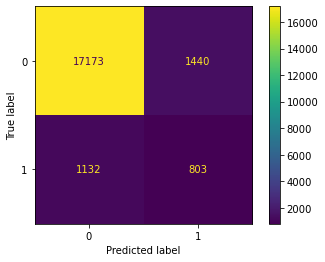

In [36]:
disp.plot()
plt.savefig("SVMVP.png")

# 5. Final Testing for SVM

In [51]:
filename = 'SVMFinal.sav'
loaded_model1 = pickle.load(open(filename, 'rb'))

In [40]:
filename = 'SVMFinal_prob.sav'
loaded_model2 = pickle.load(open(filename, 'rb'))

In [41]:
y_pred_prob = SVM1_r_prob.predict(X_Holdout)

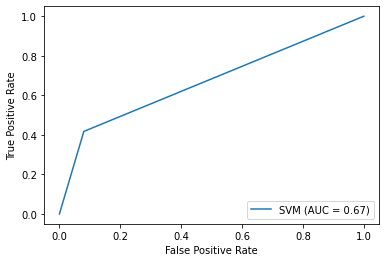

In [43]:
from sklearn import metrics
# Code adapted from below link
#https://scikit-learn.org/stable/modules/generated/sklearn.metrics.RocCurveDisplay.html#sklearn.metrics.RocCurveDisplay.from_predictions
a, b, c = metrics.roc_curve(y_Holdout, y_pred_prob)
roc_auc = metrics.auc(a, b)
display = metrics.RocCurveDisplay(fpr=a, tpr=b, roc_auc=roc_auc, estimator_name='SVM')
display.plot()

In [57]:
y_pred = SVM1_r.predict(X_Holdout)

In [52]:
len(y_pred)

25368

In [59]:
cm = confusion_matrix(y_Holdout, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)

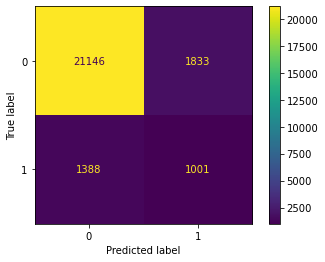

In [60]:
disp.plot()
plt.savefig("SVMTP.png")

In [ ]:
import scikitplot as skplt

In [ ]:
skplt.metrics.plot_roc_curve(y_Holdout, y_pred)

# 6. ANN


## The following hyper-parameters are optimised:
- Learning rate
- Weight decay
- Number of neurons in Hidden Layer 1
- Number of neurons in Hidden Layer 2
- Activation Function

## Method:
1) Define Neural Network A (NNA) which uses Sigmoid Activation function and Neural Network B (NNB) which uses Relu Activation function (for hidden layers)
2) Perform Gridsearch to tune the other hyper-parameters for NNA and NNB

3) Repeat the gridsearch, updating the range of the hyper-parameter values based on the previous gridsearch

In [ ]:
# Adapted from https://skorch.readthedocs.io/en/stable/user/quickstart.html

## 6.1 Define the Neural Network with sigmoid

In [26]:
class Classifier(nn.Module):

    def __init__(self, n_units_1 = 512,n_units_2 = 1024):

        super(Classifier, self).__init__() 
        self.hidden1 = nn.Linear(21, n_units_1)
        self.hidden2 = nn.Linear(n_units_1, n_units_2)
        self.linear = nn.Linear(n_units_2,1)

    def forward(self, x):
        x = self.hidden1(x)
        x = torch.sigmoid(x)
        x = self.hidden2(x)
        x = torch.sigmoid(x)
        x = self.linear(x)
        out = torch.sigmoid(x)
        return out
optimizer=torch.optim.Adam
criterion=torch.nn.BCELoss

## Gridsearch (Sigmoid)

In [24]:
from sklearn.model_selection import GridSearchCV


In [42]:
X_temp = np.array(X_temp, dtype=np.float32) 
y_temp = np.array(y_temp, dtype=np.float32)

In [26]:
from sklearn.model_selection import GridSearchCV
torch.manual_seed(0)


net = NeuralNetClassifier(
    Classifier,
    max_epochs=1000,
    callbacks=[EarlyStopping(patience = 20)],criterion=torch.nn.BCELoss()
)

params = {
    'lr': [1],
    'module__n_units_1': [8,16, 32, 64, 128, 256],
    'module__n_units_2': [8,16, 32, 64, 128, 256], 'optimizer__weight_decay' : [0.001,0.01,0.1, 0.5]
}
gs = GridSearchCV(net, params, refit=False, cv=ps, error_score = 'raise', verbose = 3)

gs.fit(X_temp, y_temp)
print(gs.best_score_, gs.best_params_)

# Lost output by accidently running cell again

NameError: name 'Classifier' is not defined

In [ ]:
from sklearn.model_selection import GridSearchCV
torch.manual_seed(0)


net = NeuralNetClassifier(
    Classifier,
    max_epochs=1000,
    callbacks=[EarlyStopping(patience = 20)],criterion=torch.nn.BCELoss()
)

params = {
    'lr': [0.1, 0.01, 0.001, 1],
    'module__n_units_1': [8,16, 32, 64, 128, 256],
    'module__n_units_2': [8,16, 32, 64, 128, 256], 'optimizer__weight_decay' : [0.001,0.01,0.1, 0.5]
}
gs = GridSearchCV(net, params, refit=False, cv=ps, error_score = 'raise', verbose = 3)

gs.fit(X_temp, y_temp)
print(gs.best_score_, gs.best_params_)

Fitting 1 folds for each of 576 candidates, totalling 576 fits
[CV] lr=0.1, module__n_units_1=8, module__n_units_2=8, optimizer__weight_decay=0.001 


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.2502       0.5001        1.6615  0.4174
      2        0.3723       0.5001        1.6515  0.4230
      3        0.3762       0.5001        1.6384  0.4943
      4        0.3796       0.5001        1.6255  0.3997
      5        0.3829       0.5001        1.6127  0.3801
      6        0.3859       0.5001        1.6000  0.3780
      7        0.3886       0.5001        1.5870  0.3812
      8        0.3907       0.5001        1.5733  0.3756
      9        0.3920       0.5001        1.5583  0.3833
     10        0.3916       0.5001        1.5406  0.3759
     11        0.3886       0.5001        1.5175  0.3735
     12        0.3809       0.5001        1.4838  0.3763
     13        0.3663       0.5001        1.4327  0.3754
     14        0.3443       0.5001        1.3608  0.3777
     15        0.3196       0.5001        1.2774  0.3753
     16        0.2996       0.5

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   43.9s remaining:    0.0s


  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.2366       0.5001        1.6387  0.5623
      2        0.3471       0.5001        1.6277  0.4102
      3        0.3520       0.5001        1.6172  0.5726
      4        0.3560       0.5001        1.6087  0.5076
      5        0.3593       0.5001        1.6016  0.5458
      6        0.3620       0.5001        1.5959  0.5552
      7        0.3642       0.5001        1.5912  0.4800
      8        0.3660       0.5001        1.5873  0.4136
      9        0.3675       0.5001        1.5841  0.5247
     10        0.3687       0.5001        1.5815  0.4499
     11        0.3697       0.5001        1.5794  0.4551
     12        0.3705       0.5001        1.5776  0.4047
     13        0.3711       0.5001        1.5762  0.4168
     14        0.3717       0.5001        1.5750  0.4276
     15        0.3721       0.5001        1.5741  0.3906
     16        0.3725       0.5

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:  1.1min remaining:    0.0s


  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.2164       0.5001        1.3047  0.3823
      2        0.3072       0.5001        1.3007  0.4458
      3        0.3084       0.5001        1.3001  0.5248
      4        0.3085       0.5001        1.3000  0.4244
      5        0.3086       0.5001        1.3000  0.5079
      6        0.3086       0.5001        1.3000  0.5345
      7        0.3086       0.5001        1.3000  0.3885
      8        0.3086       0.5001        1.3000  0.7297
      9        0.3086       0.5001        1.3000  0.4212
     10        0.3086       0.5001        1.3000  0.4565
     11        0.3086       0.5001        1.3000  0.3788
     12        0.3086       0.5001        1.3000  0.5097
     13        0.3086       0.5001        1.3000  0.6371
     14        0.3086       0.5001        1.3000  0.4986
     15        0.3086       0.5001        1.3000  0.6546
     16        0.3086       0.5

     74        0.2374       0.5001        1.1436  0.4120
     75        0.2375       0.5001        1.1433  0.5999
     76        0.2375       0.5001        1.1430  0.6201
     77        0.2376       0.5001        1.1427  0.4486
     78        0.2376       0.5001        1.1423  0.5446
     79        0.2376       0.5001        1.1421  0.4089
     80        0.2376       0.5001        1.1418  0.3997
     81        0.2377       0.5001        1.1415  0.3744
     82        0.2377       0.5001        1.1412  0.3754
     83        0.2377       0.5001        1.1410  0.3746
     84        0.2377       0.5001        1.1407  0.5100
     85        0.2378       0.5001        1.1405  0.6933
     86        0.2378       0.5001        1.1403  0.4941
     87        0.2378       0.5001        1.1401  0.4138
     88        0.2378       0.5001        1.1399  0.3830
     89        0.2378       0.5001        1.1397  0.3761
     90        0.2378       0.5001        1.1395  0.4258
     91        0.2378       0.5

     28        0.2912       0.5001        1.8092  0.4344
     29        0.2912       0.5001        1.8091  0.4535
     30        0.2912       0.5001        1.8091  0.4289
     31        0.2912       0.5001        1.8091  0.4285
     32        0.2913       0.5001        1.8091  0.3906
     33        0.2913       0.5001        1.8090  0.4228
     34        0.2913       0.5001        1.8090  0.4144
     35        0.2913       0.5001        1.8090  0.3892
     36        0.2913       0.5001        1.8090  0.4377
     37        0.2913       0.5001        1.8090  0.5702
     38        0.2913       0.5001        1.8090  0.5296
     39        0.2913       0.5001        1.8090  0.5649
     40        0.2913       0.5001        1.8090  0.4716
     41        0.2913       0.5001        1.8090  0.4642
     42        0.2913       0.5001        1.8090  0.3753
     43        0.2913       0.5001        1.8090  0.5712
     44        0.2913       0.5001        1.8090  0.4371
     45        0.2913       0.5

     46        0.1828       0.5001        1.4066  0.4201
     47        0.1830       0.5001        1.4049  0.4006
     48        0.1832       0.5001        1.4032  0.3972
     49        0.1834       0.5001        1.4016  0.4036
     50        0.1836       0.5001        1.4001  0.4255
     51        0.1838       0.5001        1.3987  0.3886
     52        0.1840       0.5001        1.3973  0.4045
     53        0.1841       0.5001        1.3960  0.4047
     54        0.1843       0.5001        1.3947  0.4543
     55        0.1845       0.5001        1.3935  0.5301
     56        0.1847       0.5001        1.3924  0.5088
     57        0.1848       0.5001        1.3912  0.4989
     58        0.1850       0.5001        1.3902  0.5481
     59        0.1852       0.5001        1.3891  0.4863
     60        0.1853       0.5001        1.3881  0.6855
     61        0.1855       0.5001        1.3871  0.5115
     62        0.1856       0.5001        1.3862  0.5428
     63        0.1858       0.5

    171        0.1908       0.5001        1.3506  0.4070
    172        0.1908       0.5001        1.3505  0.4199
    173        0.1908       0.5001        1.3504  0.3918
    174        0.1908       0.5001        1.3503  0.3997
    175        0.1908       0.5001        1.3502  0.3907
    176        0.1909       0.5001        1.3501  0.3793
    177        0.1909       0.5001        1.3501  0.4648
    178        0.1909       0.5001        1.3500  0.4039
    179        0.1909       0.5001        1.3499  0.6371
    180        0.1909       0.5001        1.3498  0.4180
    181        0.1909       0.5001        1.3497  0.4639
    182        0.1909       0.5001        1.3496  0.6066
    183        0.1909       0.5001        1.3496  0.4450
    184        0.1909       0.5001        1.3495  0.4387
    185        0.1909       0.5001        1.3494  0.4797
    186        0.1909       0.5001        1.3493  0.3907
    187        0.1909       0.5001        1.3492  0.4582
    188        0.1909       0.5

    296        0.1913       0.5001        1.3451  0.4042
    297        0.1913       0.5001        1.3451  0.3816
    298        0.1913       0.5001        1.3450  0.3822
    299        0.1913       0.5001        1.3450  0.3943
    300        0.1913       0.5001        1.3450  0.4216
    301        0.1913       0.5001        1.3450  0.4099
    302        0.1913       0.5001        1.3450  0.4039
    303        0.1913       0.5001        1.3450  0.4275
    304        0.1913       0.5001        1.3449  0.4184
    305        0.1913       0.5001        1.3449  0.4436
    306        0.1913       0.5001        1.3449  0.4311
    307        0.1913       0.5001        1.3449  0.4179
    308        0.1913       0.5001        1.3449  0.4425
    309        0.1913       0.5001        1.3449  0.4184
    310        0.1913       0.5001        1.3448  0.4222
    311        0.1913       0.5001        1.3448  0.4066
    312        0.1913       0.5001        1.3448  0.3937
    313        0.1913       0.5

    421        0.1915       0.5001        1.3438  0.4756
    422        0.1915       0.5001        1.3438  0.4712
    423        0.1915       0.5001        1.3438  0.6609
    424        0.1915       0.5001        1.3438  0.4539
    425        0.1915       0.5001        1.3437  0.5707
    426        0.1915       0.5001        1.3437  0.5042
    427        0.1915       0.5001        1.3437  0.3997
    428        0.1915       0.5001        1.3437  0.6625
    429        0.1915       0.5001        1.3437  0.4360
    430        0.1915       0.5001        1.3437  0.5072
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.1, module__n_units_1=8, module__n_units_2=32, optimizer__weight_decay=0.001, score=0.906, total= 3.1min
[CV] lr=0.1, module__n_units_1=8, module__n_units_2=32, optimizer__weight_decay=0.01 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.1370       0.5001        2.1259 

      7        0.1441       0.5001        2.5144  0.4493
      8        0.1448       0.5001        2.5067  0.4012
      9        0.1455       0.5001        2.4987  0.3904
     10        0.1461       0.5001        2.4905  0.5476
     11        0.1467       0.5001        2.4820  0.6008
     12        0.1473       0.5001        2.4732  0.4425
     13        0.1478       0.5001        2.4639  0.3860
     14        0.1483       0.5001        2.4540  0.4188
     15        0.1486       0.5001        2.4436  0.4141
     16        0.1489       0.5001        2.4324  0.4447
     17        0.1491       0.5001        2.4202  0.4426
     18        0.1492       0.5001        2.4071  0.4284
     19        0.1491       0.5001        2.3926  0.4288
     20        0.1489       0.5001        2.3767  0.4306
     21        0.1485       0.5001        2.3590  0.4351
     22        0.1480       0.5001        2.3394  0.4476
     23        0.1472       0.5001        2.3176  0.4565
     24        0.1463       0.5

    132        0.1383       0.5001        1.6706  0.4175
    133        0.1383       0.5001        1.6703  0.3814
    134        0.1384       0.5001        1.6700  0.3848
    135        0.1384       0.5001        1.6698  0.3868
    136        0.1384       0.5001        1.6695  0.3791
    137        0.1385       0.5001        1.6692  0.3853
    138        0.1385       0.5001        1.6690  0.3802
    139        0.1385       0.5001        1.6687  0.3811
    140        0.1386       0.5001        1.6685  0.3827
    141        0.1386       0.5001        1.6683  0.3804
    142        0.1386       0.5001        1.6680  0.3796
    143        0.1387       0.5001        1.6678  0.4222
    144        0.1387       0.5001        1.6676  0.4907
    145        0.1387       0.5001        1.6674  0.5937
    146        0.1388       0.5001        1.6671  0.4380
    147        0.1388       0.5001        1.6669  0.4898
    148        0.1388       0.5001        1.6667  0.4266
    149        0.1389       0.5

    257        0.1402       0.5001        1.6563  0.3887
    258        0.1402       0.5001        1.6562  0.3929
    259        0.1402       0.5001        1.6562  0.3899
    260        0.1402       0.5001        1.6562  0.3858
    261        0.1402       0.5001        1.6561  0.3851
    262        0.1402       0.5001        1.6561  0.3865
    263        0.1402       0.5001        1.6561  0.3850
    264        0.1402       0.5001        1.6560  0.3887
    265        0.1402       0.5001        1.6560  0.3875
    266        0.1402       0.5001        1.6559  0.3941
    267        0.1403       0.5001        1.6559  0.3900
    268        0.1403       0.5001        1.6559  0.3965
    269        0.1403       0.5001        1.6558  0.3882
    270        0.1403       0.5001        1.6558  0.3882
    271        0.1403       0.5001        1.6558  0.3911
    272        0.1403       0.5001        1.6557  0.3863
    273        0.1403       0.5001        1.6557  0.3911
    274        0.1403       0.5

    382        0.1405       0.5001        1.6536  0.3861
    383        0.1405       0.5001        1.6536  0.3850
    384        0.1405       0.5001        1.6536  0.3867
    385        0.1405       0.5001        1.6536  0.3844
    386        0.1405       0.5001        1.6536  0.3864
    387        0.1405       0.5001        1.6536  0.3868
    388        0.1405       0.5001        1.6536  0.3858
    389        0.1405       0.5001        1.6536  0.3865
    390        0.1405       0.5001        1.6536  0.3854
    391        0.1405       0.5001        1.6536  0.3879
    392        0.1405       0.5001        1.6536  0.3930
    393        0.1405       0.5001        1.6536  0.3896
    394        0.1405       0.5001        1.6535  0.3861
    395        0.1405       0.5001        1.6535  0.3876
    396        0.1405       0.5001        1.6535  0.3889
    397        0.1405       0.5001        1.6535  0.3909
    398        0.1405       0.5001        1.6535  0.3876
    399        0.1405       0.5

      9        0.1291       0.5001        1.3416  0.3715
     10        0.1291       0.5001        1.3416  0.3749
     11        0.1291       0.5001        1.3416  0.3741
     12        0.1291       0.5001        1.3416  0.3732
     13        0.1291       0.5001        1.3416  0.3735
     14        0.1291       0.5001        1.3416  0.3743
     15        0.1291       0.5001        1.3416  0.3736
     16        0.1291       0.5001        1.3416  0.3745
     17        0.1291       0.5001        1.3416  0.3717
     18        0.1291       0.5001        1.3416  0.3755
     19        0.1291       0.5001        1.3416  0.3760
     20        0.1291       0.5001        1.3416  0.3724
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.1, module__n_units_1=8, module__n_units_2=64, optimizer__weight_decay=0.5, score=0.906, total=   8.0s
[CV] lr=0.1, module__n_units_1=8, module__n_units_2=128, optimizer__weight_decay=0.001 
  epoch    train_loss    valid_acc    valid_loss 

    109        0.0964       0.5001        2.0726  0.3883
    110        0.0964       0.5001        2.0714  0.3851
    111        0.0964       0.5001        2.0703  0.3864
    112        0.0964       0.5001        2.0692  0.3850
    113        0.0964       0.5001        2.0682  0.3872
    114        0.0964       0.5001        2.0673  0.3857
    115        0.0964       0.5001        2.0664  0.3862
    116        0.0964       0.5001        2.0656  0.3874
    117        0.0964       0.5001        2.0648  0.3857
    118        0.0964       0.5001        2.0640  0.3866
    119        0.0964       0.5001        2.0633  0.3875
    120        0.0964       0.5001        2.0627  0.3854
    121        0.0964       0.5001        2.0620  0.3872
    122        0.0964       0.5001        2.0614  0.3851
    123        0.0964       0.5001        2.0609  0.3864
    124        0.0964       0.5001        2.0603  0.3857
    125        0.0964       0.5001        2.0598  0.3885
    126        0.0964       0.5

    234        0.0966       0.5001        2.0480  0.3898
    235        0.0966       0.5001        2.0480  0.3906
    236        0.0966       0.5001        2.0480  0.3949
    237        0.0966       0.5001        2.0480  0.4152
    238        0.0966       0.5001        2.0480  0.4333
    239        0.0966       0.5001        2.0479  0.4131
    240        0.0966       0.5001        2.0479  0.4133
    241        0.0966       0.5001        2.0479  0.3924
    242        0.0966       0.5001        2.0479  0.3896
    243        0.0966       0.5001        2.0479  0.3916
    244        0.0966       0.5001        2.0479  0.3909
    245        0.0966       0.5001        2.0479  0.3944
    246        0.0966       0.5001        2.0479  0.3912
    247        0.0966       0.5001        2.0479  0.3948
    248        0.0966       0.5001        2.0479  0.3928
    249        0.0966       0.5001        2.0479  0.3919
    250        0.0966       0.5001        2.0479  0.3949
    251        0.0966       0.5

     19        0.0881       0.5001        1.5649  0.3825
     20        0.0881       0.5001        1.5649  0.3830
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.1, module__n_units_1=8, module__n_units_2=128, optimizer__weight_decay=0.5, score=0.906, total=   8.2s
[CV] lr=0.1, module__n_units_1=8, module__n_units_2=256, optimizer__weight_decay=0.001 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.0449       0.5001        3.2148  0.4060
      2        0.0791       0.5001        3.2106  0.4094
      3        0.0792       0.5001        3.2063  0.4195
      4        0.0793       0.5001        3.2022  0.4165
      5        0.0794       0.5001        3.1983  0.4144
      6        0.0795       0.5001        3.1946  0.4149
      7        0.0796       0.5001        3.1910  0.4498
      8        0.0797       0.5001        3.1875  0.4181
      9        0.0798       0.5001        3.1841

    118        0.0831       0.5001        2.9688  0.4123
    119        0.0831       0.5001        2.9662  0.4418
    120        0.0830       0.5001        2.9635  0.4134
    121        0.0829       0.5001        2.9607  0.4141
    122        0.0829       0.5001        2.9579  0.4140
    123        0.0828       0.5001        2.9550  0.4405
    124        0.0827       0.5001        2.9520  0.4144
    125        0.0827       0.5001        2.9489  0.4146
    126        0.0826       0.5001        2.9457  0.4126
    127        0.0825       0.5001        2.9425  0.4136
    128        0.0824       0.5001        2.9391  0.4136
    129        0.0823       0.5001        2.9357  0.4145
    130        0.0822       0.5001        2.9321  0.4144
    131        0.0821       0.5001        2.9285  0.4143
    132        0.0820       0.5001        2.9248  0.4144
    133        0.0819       0.5001        2.9209  0.4150
    134        0.0818       0.5001        2.9170  0.4134
    135        0.0816       0.5

    243        0.0702       0.5001        2.5015  0.4201
    244        0.0702       0.5001        2.5010  0.4173
    245        0.0702       0.5001        2.5004  0.4178
    246        0.0702       0.5001        2.4999  0.4177
    247        0.0702       0.5001        2.4994  0.4283
    248        0.0701       0.5001        2.4989  0.4194
    249        0.0701       0.5001        2.4984  0.4190
    250        0.0701       0.5001        2.4980  0.4200
    251        0.0701       0.5001        2.4975  0.4211
    252        0.0701       0.5001        2.4971  0.4169
    253        0.0701       0.5001        2.4967  0.4188
    254        0.0701       0.5001        2.4963  0.4193
    255        0.0701       0.5001        2.4959  0.4184
    256        0.0700       0.5001        2.4956  0.4184
    257        0.0700       0.5001        2.4952  0.4189
    258        0.0700       0.5001        2.4949  0.4175
    259        0.0700       0.5001        2.4945  0.4172
    260        0.0700       0.5

    368        0.0696       0.5001        2.4835  0.4239
    369        0.0696       0.5001        2.4835  0.4210
    370        0.0696       0.5001        2.4835  0.4216
    371        0.0696       0.5001        2.4834  0.4226
    372        0.0696       0.5001        2.4834  0.4234
    373        0.0696       0.5001        2.4834  0.4223
    374        0.0696       0.5001        2.4834  0.4224
    375        0.0696       0.5001        2.4834  0.4225
    376        0.0696       0.5001        2.4833  0.4219
    377        0.0696       0.5001        2.4833  0.4221
    378        0.0696       0.5001        2.4833  0.4233
    379        0.0696       0.5001        2.4833  0.4236
    380        0.0696       0.5001        2.4832  0.4339
    381        0.0696       0.5001        2.4832  0.4223
    382        0.0696       0.5001        2.4832  0.4228
    383        0.0696       0.5001        2.4832  0.4227
    384        0.0696       0.5001        2.4832  0.4213
    385        0.0696       0.5

     44        0.0768       0.5001        3.0724  0.4111
     45        0.0768       0.5001        3.0724  0.4092
     46        0.0768       0.5001        3.0724  0.4108
     47        0.0768       0.5001        3.0724  0.4082
     48        0.0768       0.5001        3.0724  0.4095
     49        0.0768       0.5001        3.0724  0.4104
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.1, module__n_units_1=8, module__n_units_2=256, optimizer__weight_decay=0.01, score=0.906, total=  20.8s
[CV] lr=0.1, module__n_units_1=8, module__n_units_2=256, optimizer__weight_decay=0.1 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.0370       0.5001        2.4483  0.4118
      2        0.0613       0.5001        2.4486  0.4118
      3        0.0613       0.5001        2.4487  0.4062
      4        0.0613       0.5001        2.4487  0.4057
      5        0.0613       0.5001        2.4487 

     66        0.2611       0.5001        1.0515  0.3745
     67        0.2612       0.5001        1.0509  0.3774
     68        0.2613       0.5001        1.0504  0.3794
     69        0.2614       0.5001        1.0499  0.3780
     70        0.2615       0.5001        1.0495  0.3747
     71        0.2616       0.5001        1.0490  0.3705
     72        0.2617       0.5001        1.0486  0.4637
     73        0.2618       0.5001        1.0482  0.4368
     74        0.2619       0.5001        1.0478  0.3916
     75        0.2619       0.5001        1.0474  0.3714
     76        0.2620       0.5001        1.0470  0.3754
     77        0.2621       0.5001        1.0467  0.3780
     78        0.2621       0.5001        1.0463  0.3745
     79        0.2622       0.5001        1.0460  0.3815
     80        0.2623       0.5001        1.0457  0.3746
     81        0.2623       0.5001        1.0454  0.3799
     82        0.2624       0.5001        1.0451  0.3772
     83        0.2624       0.5

    191        0.2622       0.5001        1.0380  0.4221
    192        0.2622       0.5001        1.0380  0.4210
    193        0.2622       0.5001        1.0380  0.4320
    194        0.2622       0.5001        1.0380  0.4127
    195        0.2622       0.5001        1.0380  0.4106
    196        0.2622       0.5001        1.0380  0.4272
    197        0.2621       0.5001        1.0380  0.4947
    198        0.2621       0.5001        1.0380  0.4327
    199        0.2621       0.5001        1.0380  0.4102
    200        0.2621       0.5001        1.0380  0.4220
    201        0.2621       0.5001        1.0380  0.4330
    202        0.2621       0.5001        1.0380  0.4304
    203        0.2621       0.5001        1.0380  0.3925
    204        0.2621       0.5001        1.0380  0.4303
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.1, module__n_units_1=16, module__n_units_2=8, optimizer__weight_decay=0.001, score=0.906, total= 1.4min
[CV] lr=0.1, module__

      5        0.2849       0.5001        1.9030  0.3919
      6        0.2888       0.5001        1.8855  0.4031
      7        0.2921       0.5001        1.8672  0.3758
      8        0.2948       0.5001        1.8476  0.4260
      9        0.2964       0.5001        1.8256  0.4234
     10        0.2961       0.5001        1.7993  0.4163
     11        0.2932       0.5001        1.7656  0.4183
     12        0.2865       0.5001        1.7204  0.3964
     13        0.2755       0.5001        1.6601  0.4405
     14        0.2614       0.5001        1.5870  0.4236
     15        0.2476       0.5001        1.5106  0.3820
     16        0.2369       0.5001        1.4422  0.4043
     17        0.2301       0.5001        1.3874  0.4072
     18        0.2264       0.5001        1.3460  0.3989
     19        0.2244       0.5001        1.3153  0.3964
     20        0.2234       0.5001        1.2923  0.4245
     21        0.2230       0.5001        1.2748  0.4159
     22        0.2228       0.5

    130        0.2405       0.5001        1.1294  0.4875
    131        0.2405       0.5001        1.1293  0.5697
    132        0.2406       0.5001        1.1292  0.5759
    133        0.2406       0.5001        1.1292  0.6549
    134        0.2406       0.5001        1.1291  0.4511
    135        0.2406       0.5001        1.1290  0.4230
    136        0.2406       0.5001        1.1290  0.4360
    137        0.2406       0.5001        1.1289  0.6107
    138        0.2406       0.5001        1.1288  0.5222
    139        0.2406       0.5001        1.1288  0.5096
    140        0.2406       0.5001        1.1287  0.5202
    141        0.2406       0.5001        1.1287  0.4328
    142        0.2406       0.5001        1.1286  0.4207
    143        0.2407       0.5001        1.1286  0.4774
    144        0.2407       0.5001        1.1285  0.4174
    145        0.2407       0.5001        1.1285  0.4862
    146        0.2407       0.5001        1.1284  0.4973
    147        0.2407       0.5

     22        0.2931       0.5001        1.8195  0.4264
     23        0.2932       0.5001        1.8193  0.3860
     24        0.2932       0.5001        1.8191  0.4193
     25        0.2933       0.5001        1.8190  0.4127
     26        0.2933       0.5001        1.8188  0.4324
     27        0.2933       0.5001        1.8187  0.4178
     28        0.2934       0.5001        1.8187  0.4357
     29        0.2934       0.5001        1.8186  0.4251
     30        0.2934       0.5001        1.8185  0.4145
     31        0.2934       0.5001        1.8185  0.4609
     32        0.2934       0.5001        1.8184  0.3749
     33        0.2934       0.5001        1.8184  0.3940
     34        0.2935       0.5001        1.8184  0.5804
     35        0.2935       0.5001        1.8184  0.3762
     36        0.2935       0.5001        1.8184  0.3770
     37        0.2935       0.5001        1.8183  0.5969
     38        0.2935       0.5001        1.8183  0.4488
     39        0.2935       0.5

     38        0.1832       0.5001        1.4197  0.3960
     39        0.1835       0.5001        1.4162  0.3779
     40        0.1838       0.5001        1.4129  0.3825
     41        0.1841       0.5001        1.4097  0.3901
     42        0.1845       0.5001        1.4068  0.3908
     43        0.1848       0.5001        1.4039  0.3961
     44        0.1851       0.5001        1.4013  0.3733
     45        0.1854       0.5001        1.3987  0.3790
     46        0.1857       0.5001        1.3963  0.4033
     47        0.1860       0.5001        1.3939  0.3983
     48        0.1863       0.5001        1.3917  0.3919
     49        0.1866       0.5001        1.3895  0.3743
     50        0.1869       0.5001        1.3874  0.3746
     51        0.1872       0.5001        1.3854  0.4163
     52        0.1875       0.5001        1.3835  0.3910
     53        0.1878       0.5001        1.3817  0.3986
     54        0.1881       0.5001        1.3799  0.3826
     55        0.1884       0.5

    163        0.2000       0.5001        1.3179  0.3990
    164        0.2001       0.5001        1.3178  0.4079
    165        0.2001       0.5001        1.3176  0.4111
    166        0.2001       0.5001        1.3174  0.3799
    167        0.2002       0.5001        1.3173  0.3972
    168        0.2002       0.5001        1.3171  0.3975
    169        0.2002       0.5001        1.3170  0.4156
    170        0.2003       0.5001        1.3168  0.4348
    171        0.2003       0.5001        1.3167  0.3803
    172        0.2003       0.5001        1.3165  0.3950
    173        0.2004       0.5001        1.3164  0.4015
    174        0.2004       0.5001        1.3163  0.3870
    175        0.2004       0.5001        1.3161  0.3798
    176        0.2004       0.5001        1.3160  0.3796
    177        0.2005       0.5001        1.3159  0.3911
    178        0.2005       0.5001        1.3157  0.3983
    179        0.2005       0.5001        1.3156  0.3983
    180        0.2006       0.5

    288        0.2024       0.5001        1.3069  0.3915
    289        0.2025       0.5001        1.3068  0.4075
    290        0.2025       0.5001        1.3068  0.4284
    291        0.2025       0.5001        1.3067  0.3799
    292        0.2025       0.5001        1.3067  0.4078
    293        0.2025       0.5001        1.3066  0.3907
    294        0.2025       0.5001        1.3066  0.3966
    295        0.2025       0.5001        1.3065  0.4018
    296        0.2025       0.5001        1.3065  0.3893
    297        0.2025       0.5001        1.3064  0.3828
    298        0.2026       0.5001        1.3064  0.3837
    299        0.2026       0.5001        1.3063  0.4132
    300        0.2026       0.5001        1.3063  0.4117
    301        0.2026       0.5001        1.3062  0.3904
    302        0.2026       0.5001        1.3062  0.3814
    303        0.2026       0.5001        1.3061  0.3825
    304        0.2026       0.5001        1.3061  0.3964
    305        0.2026       0.5

    413        0.2036       0.5001        1.3017  0.6251
    414        0.2037       0.5001        1.3016  0.5895
    415        0.2037       0.5001        1.3016  0.6416
    416        0.2037       0.5001        1.3016  0.4574
    417        0.2037       0.5001        1.3015  0.6125
    418        0.2037       0.5001        1.3015  0.5457
    419        0.2037       0.5001        1.3015  0.4918
    420        0.2037       0.5001        1.3014  0.6516
    421        0.2037       0.5001        1.3014  0.4550
    422        0.2037       0.5001        1.3013  0.6517
    423        0.2037       0.5001        1.3013  0.5927
    424        0.2037       0.5001        1.3013  0.7195
    425        0.2038       0.5001        1.3012  0.6074
    426        0.2038       0.5001        1.3012  0.7800
    427        0.2038       0.5001        1.3012  1.1854
    428        0.2038       0.5001        1.3011  0.5903
    429        0.2038       0.5001        1.3011  0.5240
    430        0.2038       0.5

    538        0.2046       0.5001        1.2974  0.4163
    539        0.2046       0.5001        1.2974  0.4111
    540        0.2046       0.5001        1.2973  0.4519
    541        0.2046       0.5001        1.2973  0.4362
    542        0.2047       0.5001        1.2973  0.4515
    543        0.2047       0.5001        1.2972  0.4425
    544        0.2047       0.5001        1.2972  0.4715
    545        0.2047       0.5001        1.2972  0.4453
    546        0.2047       0.5001        1.2972  0.5120
    547        0.2047       0.5001        1.2971  0.4672
    548        0.2047       0.5001        1.2971  0.4351
    549        0.2047       0.5001        1.2971  0.4230
    550        0.2047       0.5001        1.2970  0.4252
    551        0.2047       0.5001        1.2970  0.4251
    552        0.2047       0.5001        1.2970  0.5009
    553        0.2047       0.5001        1.2969  0.4314
    554        0.2047       0.5001        1.2969  0.4284
    555        0.2047       0.5

    663        0.2054       0.5001        1.2938  0.4079
    664        0.2054       0.5001        1.2937  0.4209
    665        0.2054       0.5001        1.2937  0.4112
    666        0.2054       0.5001        1.2937  0.3952
    667        0.2055       0.5001        1.2937  0.3949
    668        0.2055       0.5001        1.2936  0.4107
    669        0.2055       0.5001        1.2936  0.4543
    670        0.2055       0.5001        1.2936  0.6109
    671        0.2055       0.5001        1.2936  0.5724
    672        0.2055       0.5001        1.2935  0.4714
    673        0.2055       0.5001        1.2935  0.5439
    674        0.2055       0.5001        1.2935  0.3944
    675        0.2055       0.5001        1.2935  0.4376
    676        0.2055       0.5001        1.2934  0.4174
    677        0.2055       0.5001        1.2934  0.4118
    678        0.2055       0.5001        1.2934  0.4049
    679        0.2055       0.5001        1.2934  0.4623
    680        0.2055       0.5

    788        0.2060       0.5001        1.2910  0.3964
    789        0.2060       0.5001        1.2910  0.4011
    790        0.2060       0.5001        1.2910  0.4403
    791        0.2060       0.5001        1.2910  0.4256
    792        0.2060       0.5001        1.2909  0.3999
    793        0.2060       0.5001        1.2909  0.4007
    794        0.2060       0.5001        1.2909  0.4176
    795        0.2060       0.5001        1.2909  0.4155
    796        0.2060       0.5001        1.2909  0.4194
    797        0.2060       0.5001        1.2909  0.3953
    798        0.2061       0.5001        1.2908  0.3958
    799        0.2061       0.5001        1.2908  0.4034
    800        0.2061       0.5001        1.2908  0.4265
    801        0.2061       0.5001        1.2908  0.4153
    802        0.2061       0.5001        1.2908  0.3962
    803        0.2061       0.5001        1.2908  0.3967
    804        0.2061       0.5001        1.2907  0.4005
    805        0.2061       0.5

    913        0.2064       0.5001        1.2893  0.3981
    914        0.2064       0.5001        1.2893  0.3957
    915        0.2064       0.5001        1.2893  0.4098
    916        0.2064       0.5001        1.2892  0.4079
    917        0.2064       0.5001        1.2892  0.4155
    918        0.2064       0.5001        1.2892  0.4076
    919        0.2064       0.5001        1.2892  0.3978
    920        0.2064       0.5001        1.2892  0.3968
    921        0.2064       0.5001        1.2892  0.4197
    922        0.2064       0.5001        1.2892  0.4093
    923        0.2064       0.5001        1.2892  0.3997
    924        0.2064       0.5001        1.2892  0.3985
    925        0.2064       0.5001        1.2892  0.4127
    926        0.2064       0.5001        1.2891  0.4171
    927        0.2064       0.5001        1.2891  0.4124
    928        0.2064       0.5001        1.2891  0.3972
    929        0.2064       0.5001        1.2891  0.3963
    930        0.2064       0.5

     33        0.2143       0.5001        2.0882  0.6258
     34        0.2144       0.5001        2.0882  0.5843
     35        0.2144       0.5001        2.0882  0.3951
     36        0.2144       0.5001        2.0882  0.4040
     37        0.2144       0.5001        2.0882  0.4789
     38        0.2144       0.5001        2.0882  0.3995
     39        0.2144       0.5001        2.0881  0.4490
     40        0.2144       0.5001        2.0881  0.3998
     41        0.2144       0.5001        2.0881  0.4206
     42        0.2144       0.5001        2.0881  0.3825
     43        0.2144       0.5001        2.0881  0.3722
     44        0.2144       0.5001        2.0881  0.3922
     45        0.2144       0.5001        2.0881  0.5023
     46        0.2144       0.5001        2.0881  0.3939
     47        0.2144       0.5001        2.0881  0.4316
     48        0.2144       0.5001        2.0881  1.0266
     49        0.2144       0.5001        2.0881  0.6442
     50        0.2144       0.5

     50        0.1413       0.5001        1.6760  0.3911
     51        0.1415       0.5001        1.6726  0.3774
     52        0.1417       0.5001        1.6695  0.3770
     53        0.1419       0.5001        1.6666  0.3992
     54        0.1421       0.5001        1.6638  0.3919
     55        0.1423       0.5001        1.6612  0.3793
     56        0.1425       0.5001        1.6588  0.3798
     57        0.1427       0.5001        1.6564  0.3818
     58        0.1429       0.5001        1.6542  0.3930
     59        0.1431       0.5001        1.6521  0.3949
     60        0.1432       0.5001        1.6501  0.3862
     61        0.1434       0.5001        1.6481  0.3784
     62        0.1436       0.5001        1.6463  0.3784
     63        0.1438       0.5001        1.6445  0.3921
     64        0.1439       0.5001        1.6429  0.4555
     65        0.1441       0.5001        1.6412  0.3814
     66        0.1443       0.5001        1.6397  0.3801
     67        0.1444       0.5

    175        0.1514       0.5001        1.5869  0.4109
    176        0.1515       0.5001        1.5868  0.3994
    177        0.1515       0.5001        1.5867  0.3807
    178        0.1515       0.5001        1.5865  0.3835
    179        0.1515       0.5001        1.5864  0.4010
    180        0.1515       0.5001        1.5862  0.4025
    181        0.1516       0.5001        1.5861  0.3957
    182        0.1516       0.5001        1.5860  0.3806
    183        0.1516       0.5001        1.5858  0.3828
    184        0.1516       0.5001        1.5857  0.3950
    185        0.1517       0.5001        1.5856  0.3882
    186        0.1517       0.5001        1.5854  0.4015
    187        0.1517       0.5001        1.5853  0.3921
    188        0.1517       0.5001        1.5852  0.3820
    189        0.1517       0.5001        1.5850  0.3822
    190        0.1518       0.5001        1.5849  0.4019
    191        0.1518       0.5001        1.5848  0.3961
    192        0.1518       0.5

    300        0.1533       0.5001        1.5751  0.4095
    301        0.1533       0.5001        1.5750  0.4041
    302        0.1533       0.5001        1.5750  0.3868
    303        0.1533       0.5001        1.5749  0.3881
    304        0.1534       0.5001        1.5748  0.4063
    305        0.1534       0.5001        1.5748  0.4064
    306        0.1534       0.5001        1.5747  0.4052
    307        0.1534       0.5001        1.5746  0.3970
    308        0.1534       0.5001        1.5746  0.4254
    309        0.1534       0.5001        1.5745  0.4139
    310        0.1534       0.5001        1.5744  0.4116
    311        0.1534       0.5001        1.5744  0.4104
    312        0.1534       0.5001        1.5743  0.3871
    313        0.1535       0.5001        1.5742  0.4026
    314        0.1535       0.5001        1.5742  0.4172
    315        0.1535       0.5001        1.5741  0.4065
    316        0.1535       0.5001        1.5740  0.4144
    317        0.1535       0.5

    425        0.1544       0.5001        1.5678  0.3977
    426        0.1544       0.5001        1.5677  0.4141
    427        0.1545       0.5001        1.5677  0.4037
    428        0.1545       0.5001        1.5676  0.7776
    429        0.1545       0.5001        1.5676  0.5354
    430        0.1545       0.5001        1.5675  0.5344
    431        0.1545       0.5001        1.5675  0.4732
    432        0.1545       0.5001        1.5674  0.4279
    433        0.1545       0.5001        1.5674  0.5534
    434        0.1545       0.5001        1.5673  0.4130
    435        0.1545       0.5001        1.5673  0.5051
    436        0.1545       0.5001        1.5672  0.4738
    437        0.1545       0.5001        1.5672  0.4428
    438        0.1545       0.5001        1.5671  0.4116
    439        0.1545       0.5001        1.5671  0.4102
    440        0.1545       0.5001        1.5670  0.4926
    441        0.1546       0.5001        1.5670  0.4058
    442        0.1546       0.5

    550        0.1552       0.5001        1.5623  0.4179
    551        0.1553       0.5001        1.5622  0.6311
    552        0.1553       0.5001        1.5622  0.4328
    553        0.1553       0.5001        1.5622  0.5924
    554        0.1553       0.5001        1.5621  0.4363
    555        0.1553       0.5001        1.5621  0.6066
    556        0.1553       0.5001        1.5621  0.4816
    557        0.1553       0.5001        1.5620  0.5752
    558        0.1553       0.5001        1.5620  0.6247
    559        0.1553       0.5001        1.5619  0.4438
    560        0.1553       0.5001        1.5619  0.6037
    561        0.1553       0.5001        1.5619  0.4491
    562        0.1553       0.5001        1.5618  0.4444
    563        0.1553       0.5001        1.5618  0.4105
    564        0.1553       0.5001        1.5618  0.4230
    565        0.1553       0.5001        1.5617  0.7976
    566        0.1553       0.5001        1.5617  0.4694
    567        0.1553       0.5

    675        0.1559       0.5001        1.5581  0.6101
    676        0.1559       0.5001        1.5581  0.5602
    677        0.1559       0.5001        1.5580  0.5995
    678        0.1559       0.5001        1.5580  0.5671
    679        0.1559       0.5001        1.5580  0.5924
    680        0.1559       0.5001        1.5579  0.4608
    681        0.1559       0.5001        1.5579  0.6628
    682        0.1559       0.5001        1.5579  0.4821
    683        0.1559       0.5001        1.5579  1.1382
    684        0.1559       0.5001        1.5578  0.9914
    685        0.1559       0.5001        1.5578  1.0915
    686        0.1559       0.5001        1.5578  1.1794
    687        0.1559       0.5001        1.5577  0.6673
    688        0.1559       0.5001        1.5577  0.6523
    689        0.1559       0.5001        1.5577  0.8074
    690        0.1559       0.5001        1.5577  0.7377
    691        0.1559       0.5001        1.5576  0.4304
    692        0.1559       0.5

    800        0.1563       0.5001        1.5549  0.4216
    801        0.1563       0.5001        1.5549  0.4392
    802        0.1563       0.5001        1.5548  0.4034
    803        0.1563       0.5001        1.5548  0.4569
    804        0.1563       0.5001        1.5548  0.4656
    805        0.1563       0.5001        1.5548  0.6123
    806        0.1563       0.5001        1.5548  0.4446
    807        0.1563       0.5001        1.5547  0.4541
    808        0.1563       0.5001        1.5547  0.4660
    809        0.1563       0.5001        1.5547  0.5336
    810        0.1563       0.5001        1.5547  0.4054
    811        0.1564       0.5001        1.5546  0.3997
    812        0.1564       0.5001        1.5546  0.4858
    813        0.1564       0.5001        1.5546  0.6685
    814        0.1564       0.5001        1.5546  0.5748
    815        0.1564       0.5001        1.5546  0.5076
    816        0.1564       0.5001        1.5545  0.4172
    817        0.1564       0.5

    925        0.1567       0.5001        1.5525  0.5341
    926        0.1567       0.5001        1.5525  0.5866
    927        0.1567       0.5001        1.5525  0.5830
    928        0.1567       0.5001        1.5525  0.6408
    929        0.1567       0.5001        1.5524  0.5029
    930        0.1567       0.5001        1.5524  0.4906
    931        0.1567       0.5001        1.5524  0.4069
    932        0.1567       0.5001        1.5524  0.4095
    933        0.1567       0.5001        1.5524  0.4644
    934        0.1567       0.5001        1.5524  0.4247
    935        0.1567       0.5001        1.5523  0.4336
    936        0.1567       0.5001        1.5523  0.4092
    937        0.1567       0.5001        1.5523  0.4101
    938        0.1567       0.5001        1.5523  0.4283
    939        0.1567       0.5001        1.5523  0.4333
    940        0.1567       0.5001        1.5523  0.4348
    941        0.1567       0.5001        1.5523  0.4110
    942        0.1567       0.5

     45        0.1492       0.5001        2.3955  0.3922
     46        0.1492       0.5001        2.3955  0.4021
     47        0.1492       0.5001        2.3955  0.5178
     48        0.1492       0.5001        2.3955  0.3936
     49        0.1492       0.5001        2.3955  0.4228
     50        0.1492       0.5001        2.3955  0.4004
     51        0.1492       0.5001        2.3955  0.4746
     52        0.1492       0.5001        2.3955  0.4784
     53        0.1492       0.5001        2.3955  0.4443
     54        0.1492       0.5001        2.3955  0.4187
     55        0.1492       0.5001        2.3955  0.3975
     56        0.1492       0.5001        2.3955  0.4197
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.1, module__n_units_1=16, module__n_units_2=64, optimizer__weight_decay=0.01, score=0.906, total=  28.3s
[CV] lr=0.1, module__n_units_1=16, module__n_units_2=64, optimizer__weight_decay=0.1 
  epoch    train_loss    valid_acc    valid_loss 

     60        0.1002       0.5001        2.0857  0.4073
     61        0.1002       0.5001        2.0794  0.4088
     62        0.1002       0.5001        2.0736  0.3980
     63        0.1002       0.5001        2.0683  0.3862
     64        0.1003       0.5001        2.0633  0.3907
     65        0.1003       0.5001        2.0588  0.4047
     66        0.1003       0.5001        2.0545  0.4153
     67        0.1004       0.5001        2.0506  0.3953
     68        0.1004       0.5001        2.0469  0.3887
     69        0.1004       0.5001        2.0435  0.3916
     70        0.1005       0.5001        2.0403  0.4098
     71        0.1005       0.5001        2.0373  0.4108
     72        0.1006       0.5001        2.0345  0.3889
     73        0.1006       0.5001        2.0318  0.3876
     74        0.1007       0.5001        2.0293  0.4005
     75        0.1007       0.5001        2.0270  0.4043
     76        0.1008       0.5001        2.0247  0.4092
     77        0.1008       0.5

    185        0.1038       0.5001        1.9675  0.4115
    186        0.1038       0.5001        1.9674  0.3921
    187        0.1038       0.5001        1.9673  0.4081
    188        0.1038       0.5001        1.9672  0.4427
    189        0.1038       0.5001        1.9671  0.4247
    190        0.1038       0.5001        1.9670  0.3995
    191        0.1038       0.5001        1.9669  0.3907
    192        0.1038       0.5001        1.9668  0.4251
    193        0.1039       0.5001        1.9667  0.4157
    194        0.1039       0.5001        1.9666  0.4159
    195        0.1039       0.5001        1.9665  0.3931
    196        0.1039       0.5001        1.9665  0.3915
    197        0.1039       0.5001        1.9664  0.4044
    198        0.1039       0.5001        1.9663  0.4326
    199        0.1039       0.5001        1.9662  0.4162
    200        0.1039       0.5001        1.9661  0.4028
    201        0.1039       0.5001        1.9660  0.3950
    202        0.1039       0.5

    310        0.1044       0.5001        1.9618  0.4119
    311        0.1044       0.5001        1.9618  0.4186
    312        0.1044       0.5001        1.9618  0.3953
    313        0.1044       0.5001        1.9618  0.3951
    314        0.1044       0.5001        1.9618  0.4166
    315        0.1044       0.5001        1.9617  0.4136
    316        0.1044       0.5001        1.9617  0.4189
    317        0.1044       0.5001        1.9617  0.3948
    318        0.1044       0.5001        1.9617  0.3965
    319        0.1044       0.5001        1.9617  0.4119
    320        0.1044       0.5001        1.9617  0.4153
    321        0.1044       0.5001        1.9616  0.4130
    322        0.1044       0.5001        1.9616  0.3958
    323        0.1044       0.5001        1.9616  0.3950
    324        0.1044       0.5001        1.9616  0.4148
    325        0.1044       0.5001        1.9616  0.4235
    326        0.1044       0.5001        1.9616  0.4032
    327        0.1044       0.5

     42        0.1041       0.5001        2.7242  0.3862
     43        0.1041       0.5001        2.7242  0.3904
     44        0.1041       0.5001        2.7242  0.4051
     45        0.1041       0.5001        2.7242  0.4103
     46        0.1041       0.5001        2.7242  0.3946
     47        0.1041       0.5001        2.7242  0.3839
     48        0.1041       0.5001        2.7242  0.3906
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.1, module__n_units_1=16, module__n_units_2=128, optimizer__weight_decay=0.01, score=0.906, total=  19.6s
[CV] lr=0.1, module__n_units_1=16, module__n_units_2=128, optimizer__weight_decay=0.1 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.0523       0.5001        2.1746  0.4251
      2        0.0822       0.5001        2.1738  0.4105
      3        0.0823       0.5001        2.1737  0.3882
      4        0.0823       0.5001        2.173

     64        0.0882       0.5001        3.0373  0.6743
     65        0.0883       0.5001        3.0359  0.5847
     66        0.0884       0.5001        3.0346  0.4649
     67        0.0885       0.5001        3.0332  0.5874
     68        0.0886       0.5001        3.0318  0.5239
     69        0.0887       0.5001        3.0305  0.6703
     70        0.0888       0.5001        3.0291  0.4913
     71        0.0889       0.5001        3.0278  0.5814
     72        0.0890       0.5001        3.0265  0.5103
     73        0.0891       0.5001        3.0252  0.4464
     74        0.0891       0.5001        3.0239  0.4696
     75        0.0892       0.5001        3.0225  0.4397
     76        0.0893       0.5001        3.0212  0.4251
     77        0.0894       0.5001        3.0199  0.4208
     78        0.0895       0.5001        3.0186  0.5224
     79        0.0895       0.5001        3.0173  0.5964
     80        0.0896       0.5001        3.0160  0.6838
     81        0.0897       0.5

    189        0.0754       0.5001        2.4620  0.4214
    190        0.0754       0.5001        2.4589  0.4380
    191        0.0753       0.5001        2.4561  0.4417
    192        0.0752       0.5001        2.4534  0.4295
    193        0.0752       0.5001        2.4509  0.4221
    194        0.0751       0.5001        2.4485  0.4409
    195        0.0750       0.5001        2.4462  0.4388
    196        0.0750       0.5001        2.4441  0.4396
    197        0.0749       0.5001        2.4420  0.4221
    198        0.0749       0.5001        2.4401  0.4206
    199        0.0748       0.5001        2.4383  0.4385
    200        0.0747       0.5001        2.4367  0.4387
    201        0.0747       0.5001        2.4351  0.4419
    202        0.0747       0.5001        2.4335  0.4213
    203        0.0746       0.5001        2.4321  0.4272
    204        0.0746       0.5001        2.4308  0.4602
    205        0.0745       0.5001        2.4295  0.5408
    206        0.0745       0.5

      6        0.0763       0.5001        3.0798  0.4121
      7        0.0765       0.5001        3.0772  0.4145
      8        0.0766       0.5001        3.0751  0.4361
      9        0.0767       0.5001        3.0734  0.7405
     10        0.0768       0.5001        3.0720  0.5975
     11        0.0769       0.5001        3.0709  0.6260
     12        0.0769       0.5001        3.0700  0.6907
     13        0.0770       0.5001        3.0693  0.4174
     14        0.0770       0.5001        3.0687  0.7666
     15        0.0770       0.5001        3.0681  0.5972
     16        0.0771       0.5001        3.0677  0.5926
     17        0.0771       0.5001        3.0674  0.5109
     18        0.0771       0.5001        3.0671  0.4359
     19        0.0771       0.5001        3.0669  0.4795
     20        0.0771       0.5001        3.0667  0.4309
     21        0.0771       0.5001        3.0665  0.4166
     22        0.0772       0.5001        3.0664  0.4189
     23        0.0772       0.5

     27        0.2303       0.5001        1.1792  0.4947
     28        0.2309       0.5001        1.1753  0.4498
     29        0.2316       0.5001        1.1716  0.4265
     30        0.2322       0.5001        1.1682  0.5757
     31        0.2328       0.5001        1.1648  0.5199
     32        0.2335       0.5001        1.1616  0.6045
     33        0.2341       0.5001        1.1586  0.5669
     34        0.2347       0.5001        1.1557  0.6482
     35        0.2353       0.5001        1.1529  0.5333
     36        0.2359       0.5001        1.1503  0.5706
     37        0.2364       0.5001        1.1477  0.4867
     38        0.2370       0.5001        1.1453  0.5172
     39        0.2375       0.5001        1.1429  0.4308
     40        0.2380       0.5001        1.1407  0.7047
     41        0.2385       0.5001        1.1385  0.4686
     42        0.2390       0.5001        1.1365  0.4438
     43        0.2394       0.5001        1.1345  0.3814
     44        0.2399       0.5

    152        0.2491       0.5001        1.0843  0.3992
    153        0.2491       0.5001        1.0842  0.3939
    154        0.2491       0.5001        1.0841  0.3884
    155        0.2491       0.5001        1.0840  0.3760
    156        0.2492       0.5001        1.0839  0.3781
    157        0.2492       0.5001        1.0838  0.3957
    158        0.2492       0.5001        1.0837  0.3976
    159        0.2492       0.5001        1.0836  0.4120
    160        0.2492       0.5001        1.0835  0.3858
    161        0.2492       0.5001        1.0834  0.3775
    162        0.2492       0.5001        1.0833  0.3846
    163        0.2492       0.5001        1.0832  0.4113
    164        0.2493       0.5001        1.0831  0.3886
    165        0.2493       0.5001        1.0830  0.3783
    166        0.2493       0.5001        1.0829  0.3778
    167        0.2493       0.5001        1.0828  0.4037
    168        0.2493       0.5001        1.0827  0.3927
    169        0.2493       0.5

    277        0.2499       0.5001        1.0772  0.4059
    278        0.2499       0.5001        1.0772  0.4001
    279        0.2499       0.5001        1.0772  0.3897
    280        0.2499       0.5001        1.0771  0.3796
    281        0.2499       0.5001        1.0771  0.3787
    282        0.2499       0.5001        1.0771  0.3942
    283        0.2499       0.5001        1.0771  0.3929
    284        0.2499       0.5001        1.0770  0.4021
    285        0.2499       0.5001        1.0770  0.3818
    286        0.2499       0.5001        1.0770  0.3812
    287        0.2499       0.5001        1.0770  0.3963
    288        0.2499       0.5001        1.0769  0.3966
    289        0.2499       0.5001        1.0769  0.4035
    290        0.2499       0.5001        1.0769  0.3785
    291        0.2499       0.5001        1.0769  0.3808
    292        0.2499       0.5001        1.0769  0.3880
    293        0.2499       0.5001        1.0768  0.4061
    294        0.2499       0.5

     20        0.3696       0.5001        1.6404  0.3805
     21        0.3697       0.5001        1.6401  0.3860
     22        0.3697       0.5001        1.6399  0.3952
     23        0.3697       0.5001        1.6397  0.3728
     24        0.3697       0.5001        1.6395  0.3723
     25        0.3697       0.5001        1.6394  0.3858
     26        0.3698       0.5001        1.6393  0.3936
     27        0.3698       0.5001        1.6392  0.4003
     28        0.3698       0.5001        1.6391  0.3727
     29        0.3698       0.5001        1.6391  0.3717
     30        0.3698       0.5001        1.6390  0.3834
     31        0.3698       0.5001        1.6390  0.3879
     32        0.3698       0.5001        1.6390  0.3925
     33        0.3698       0.5001        1.6389  0.3800
     34        0.3698       0.5001        1.6389  0.3721
     35        0.3698       0.5001        1.6389  0.3721
     36        0.3698       0.5001        1.6389  0.3874
     37        0.3698       0.5

     37        0.2178       0.5001        1.2271  0.3939
     38        0.2184       0.5001        1.2245  0.3779
     39        0.2190       0.5001        1.2219  0.3723
     40        0.2195       0.5001        1.2195  0.3816
     41        0.2201       0.5001        1.2172  0.3921
     42        0.2206       0.5001        1.2150  0.3940
     43        0.2211       0.5001        1.2129  0.3835
     44        0.2216       0.5001        1.2108  0.3750
     45        0.2220       0.5001        1.2089  0.3758
     46        0.2225       0.5001        1.2071  0.3910
     47        0.2229       0.5001        1.2053  0.4045
     48        0.2233       0.5001        1.2036  0.3824
     49        0.2237       0.5001        1.2020  0.3736
     50        0.2241       0.5001        1.2005  0.3740
     51        0.2245       0.5001        1.1990  0.3902
     52        0.2248       0.5001        1.1976  0.3861
     53        0.2251       0.5001        1.1963  0.3967
     54        0.2255       0.5

    162        0.2332       0.5001        1.1662  0.3765
    163        0.2332       0.5001        1.1662  0.3798
    164        0.2332       0.5001        1.1662  0.3934
    165        0.2332       0.5001        1.1661  0.3953
    166        0.2332       0.5001        1.1661  0.3909
    167        0.2332       0.5001        1.1661  0.3782
    168        0.2332       0.5001        1.1661  0.3869
    169        0.2332       0.5001        1.1661  0.3993
    170        0.2332       0.5001        1.1660  0.3956
    171        0.2332       0.5001        1.1660  0.3878
    172        0.2332       0.5001        1.1660  0.3775
    173        0.2332       0.5001        1.1660  0.3785
    174        0.2333       0.5001        1.1660  0.3915
    175        0.2333       0.5001        1.1660  0.3981
    176        0.2333       0.5001        1.1660  0.3913
    177        0.2333       0.5001        1.1659  0.3775
    178        0.2333       0.5001        1.1659  0.3786
    179        0.2333       0.5

    287        0.2340       0.5001        1.1646  0.4086
    288        0.2340       0.5001        1.1646  0.3836
    289        0.2340       0.5001        1.1646  0.3827
    290        0.2340       0.5001        1.1646  0.3987
    291        0.2340       0.5001        1.1646  0.3978
    292        0.2340       0.5001        1.1645  0.3917
    293        0.2340       0.5001        1.1645  0.3818
    294        0.2340       0.5001        1.1645  0.3818
    295        0.2340       0.5001        1.1645  0.4290
    296        0.2341       0.5001        1.1645  0.3981
    297        0.2341       0.5001        1.1645  0.4041
    298        0.2341       0.5001        1.1645  0.3802
    299        0.2341       0.5001        1.1645  0.3870
    300        0.2341       0.5001        1.1644  0.4155
    301        0.2341       0.5001        1.1644  0.4004
    302        0.2341       0.5001        1.1644  0.3902
    303        0.2341       0.5001        1.1644  0.3818
    304        0.2341       0.5

    412        0.2348       0.5001        1.1630  0.4005
    413        0.2348       0.5001        1.1630  0.4059
    414        0.2348       0.5001        1.1630  0.3858
    415        0.2348       0.5001        1.1630  0.3840
    416        0.2348       0.5001        1.1629  0.4007
    417        0.2348       0.5001        1.1629  0.4033
    418        0.2348       0.5001        1.1629  0.3937
    419        0.2348       0.5001        1.1629  0.3834
    420        0.2348       0.5001        1.1629  0.3819
    421        0.2348       0.5001        1.1629  0.3981
    422        0.2348       0.5001        1.1629  0.4090
    423        0.2348       0.5001        1.1629  0.3946
    424        0.2348       0.5001        1.1629  0.3835
    425        0.2348       0.5001        1.1628  0.3834
    426        0.2348       0.5001        1.1628  0.3982
    427        0.2348       0.5001        1.1628  0.4053
    428        0.2348       0.5001        1.1628  0.3921
    429        0.2349       0.5

    537        0.2352       0.5001        1.1619  0.3884
    538        0.2352       0.5001        1.1619  0.3862
    539        0.2352       0.5001        1.1619  0.4047
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.1, module__n_units_1=32, module__n_units_2=16, optimizer__weight_decay=0.001, score=0.906, total= 3.6min
[CV] lr=0.1, module__n_units_1=32, module__n_units_2=16, optimizer__weight_decay=0.01 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.1716       0.5001        1.9227  0.3890
      2        0.2668       0.5001        1.9078  0.3719
      3        0.2720       0.5001        1.8955  0.3710
      4        0.2763       0.5001        1.8857  0.3875
      5        0.2799       0.5001        1.8777  0.3867
      6        0.2829       0.5001        1.8711  0.3949
      7        0.2854       0.5001        1.8657  0.3722
      8        0.2874       0.5001        1.861

      8        0.2250       0.5001        2.1239  0.3810
      9        0.2291       0.5001        2.1014  0.4000
     10        0.2329       0.5001        2.0785  0.3978
     11        0.2361       0.5001        2.0547  0.3833
     12        0.2384       0.5001        2.0295  0.3745
     13        0.2394       0.5001        2.0019  0.3835
     14        0.2386       0.5001        1.9704  0.3832
     15        0.2354       0.5001        1.9329  0.3988
     16        0.2294       0.5001        1.8875  0.3749
     17        0.2208       0.5001        1.8335  0.3726
     18        0.2107       0.5001        1.7737  0.3832
     19        0.2010       0.5001        1.7141  0.3917
     20        0.1933       0.5001        1.6605  0.3963
     21        0.1880       0.5001        1.6157  0.3739
     22        0.1847       0.5001        1.5798  0.3762
     23        0.1828       0.5001        1.5513  0.3800
     24        0.1817       0.5001        1.5287  0.3886
     25        0.1811       0.5

    133        0.2059       0.5001        1.3023  0.3855
    134        0.2059       0.5001        1.3021  0.3795
    135        0.2060       0.5001        1.3019  0.3768
    136        0.2060       0.5001        1.3017  0.3901
    137        0.2061       0.5001        1.3015  0.3967
    138        0.2061       0.5001        1.3013  0.4058
    139        0.2062       0.5001        1.3011  0.3800
    140        0.2062       0.5001        1.3009  0.3803
    141        0.2062       0.5001        1.3008  0.3929
    142        0.2063       0.5001        1.3006  0.3890
    143        0.2063       0.5001        1.3004  0.4048
    144        0.2063       0.5001        1.3002  0.3860
    145        0.2064       0.5001        1.3001  0.3784
    146        0.2064       0.5001        1.2999  0.3863
    147        0.2064       0.5001        1.2997  0.4004
    148        0.2065       0.5001        1.2996  0.3974
    149        0.2065       0.5001        1.2994  0.3854
    150        0.2065       0.5

    258        0.2084       0.5001        1.2896  0.3968
    259        0.2084       0.5001        1.2895  0.4099
    260        0.2084       0.5001        1.2895  0.3810
    261        0.2085       0.5001        1.2894  0.3808
    262        0.2085       0.5001        1.2893  0.4183
    263        0.2085       0.5001        1.2893  0.4052
    264        0.2085       0.5001        1.2892  0.4037
    265        0.2085       0.5001        1.2892  0.3886
    266        0.2085       0.5001        1.2891  0.3816
    267        0.2085       0.5001        1.2890  0.4173
    268        0.2085       0.5001        1.2890  0.3966
    269        0.2085       0.5001        1.2889  0.4030
    270        0.2086       0.5001        1.2889  0.3825
    271        0.2086       0.5001        1.2888  0.3861
    272        0.2086       0.5001        1.2888  0.3955
    273        0.2086       0.5001        1.2887  0.4063
    274        0.2086       0.5001        1.2887  0.4159
    275        0.2086       0.5

    383        0.2095       0.5001        1.2835  0.4046
    384        0.2095       0.5001        1.2834  0.4090
    385        0.2095       0.5001        1.2834  0.3883
    386        0.2095       0.5001        1.2833  0.3849
    387        0.2095       0.5001        1.2833  0.3931
    388        0.2095       0.5001        1.2833  0.4018
    389        0.2096       0.5001        1.2832  0.4127
    390        0.2096       0.5001        1.2832  0.3848
    391        0.2096       0.5001        1.2831  0.3858
    392        0.2096       0.5001        1.2831  0.4000
    393        0.2096       0.5001        1.2830  0.4061
    394        0.2096       0.5001        1.2830  0.4089
    395        0.2096       0.5001        1.2830  0.3847
    396        0.2096       0.5001        1.2829  0.3837
    397        0.2096       0.5001        1.2829  0.4006
    398        0.2096       0.5001        1.2828  0.4009
    399        0.2096       0.5001        1.2828  0.4064
    400        0.2096       0.5

    508        0.2103       0.5001        1.2791  0.4145
    509        0.2103       0.5001        1.2791  0.3874
    510        0.2103       0.5001        1.2790  0.3888
    511        0.2103       0.5001        1.2790  0.4041
    512        0.2103       0.5001        1.2790  0.4071
    513        0.2103       0.5001        1.2789  0.3987
    514        0.2103       0.5001        1.2789  0.3878
    515        0.2103       0.5001        1.2789  0.4011
    516        0.2103       0.5001        1.2789  0.4066
    517        0.2103       0.5001        1.2788  0.4047
    518        0.2103       0.5001        1.2788  0.4113
    519        0.2103       0.5001        1.2788  0.3878
    520        0.2103       0.5001        1.2787  0.3870
    521        0.2103       0.5001        1.2787  0.4055
    522        0.2103       0.5001        1.2787  0.4040
    523        0.2103       0.5001        1.2787  0.4116
    524        0.2104       0.5001        1.2786  0.3941
    525        0.2104       0.5

    633        0.2108       0.5001        1.2763  0.4318
    634        0.2108       0.5001        1.2763  0.4095
    635        0.2108       0.5001        1.2763  0.3985
    636        0.2108       0.5001        1.2763  0.3896
    637        0.2108       0.5001        1.2763  0.3910
    638        0.2108       0.5001        1.2763  0.4270
    639        0.2108       0.5001        1.2762  0.4112
    640        0.2108       0.5001        1.2762  0.4003
    641        0.2108       0.5001        1.2762  0.3924
    642        0.2108       0.5001        1.2762  0.3984
    643        0.2108       0.5001        1.2762  0.4058
    644        0.2108       0.5001        1.2762  0.4132
    645        0.2108       0.5001        1.2761  0.3985
    646        0.2108       0.5001        1.2761  0.3928
    647        0.2108       0.5001        1.2761  0.3922
    648        0.2108       0.5001        1.2761  0.4123
    649        0.2108       0.5001        1.2761  0.4127
    650        0.2108       0.5

    758        0.2111       0.5001        1.2749  0.7952
    759        0.2111       0.5001        1.2749  0.8216
    760        0.2111       0.5001        1.2749  0.7398
    761        0.2111       0.5001        1.2749  0.7980
    762        0.2111       0.5001        1.2749  0.7776
    763        0.2111       0.5001        1.2749  0.7298
    764        0.2111       0.5001        1.2749  0.7411
    765        0.2111       0.5001        1.2749  0.7217
    766        0.2111       0.5001        1.2748  0.7425
    767        0.2111       0.5001        1.2748  0.7559
    768        0.2111       0.5001        1.2748  0.7213
    769        0.2111       0.5001        1.2748  0.7990
    770        0.2111       0.5001        1.2748  0.7640
    771        0.2111       0.5001        1.2748  0.7624
    772        0.2111       0.5001        1.2748  0.7981
    773        0.2111       0.5001        1.2748  0.7053
    774        0.2111       0.5001        1.2748  0.7732
    775        0.2111       0.5

     19        0.1655       0.5001        1.6996  0.5312
     20        0.1655       0.5001        1.6996  0.5133
     21        0.1655       0.5001        1.6996  0.5377
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.1, module__n_units_1=32, module__n_units_2=32, optimizer__weight_decay=0.1, score=0.906, total=  10.1s
[CV] lr=0.1, module__n_units_1=32, module__n_units_2=32, optimizer__weight_decay=0.5 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.1594       0.5001        1.1606  0.5062
      2        0.1836       0.5001        1.1606  0.5245
      3        0.1836       0.5001        1.1606  0.5558
      4        0.1836       0.5001        1.1606  0.5232
      5        0.1836       0.5001        1.1606  0.5188
      6        0.1836       0.5001        1.1606  0.5310
      7        0.1836       0.5001        1.1606  0.5395
      8        0.1836       0.5001        1.1606  

     93        0.1603       0.5001        1.5407  0.4838
     94        0.1604       0.5001        1.5401  0.4803
     95        0.1605       0.5001        1.5395  0.4658
     96        0.1606       0.5001        1.5389  0.4695
     97        0.1607       0.5001        1.5383  0.4986
     98        0.1608       0.5001        1.5377  0.4819
     99        0.1609       0.5001        1.5372  0.4651
    100        0.1610       0.5001        1.5367  0.4640
    101        0.1611       0.5001        1.5362  0.4830
    102        0.1612       0.5001        1.5357  0.4920
    103        0.1613       0.5001        1.5352  0.4635
    104        0.1614       0.5001        1.5347  0.4804
    105        0.1615       0.5001        1.5342  0.4805
    106        0.1615       0.5001        1.5338  0.5705
    107        0.1616       0.5001        1.5334  0.4672
    108        0.1617       0.5001        1.5329  0.4699
    109        0.1618       0.5001        1.5325  0.4861
    110        0.1618       0.5

    218        0.1651       0.5001        1.5147  0.4919
    219        0.1651       0.5001        1.5147  0.5177
    220        0.1651       0.5001        1.5146  0.5169
    221        0.1651       0.5001        1.5145  0.5079
    222        0.1651       0.5001        1.5144  0.4744
    223        0.1651       0.5001        1.5144  0.4693
    224        0.1651       0.5001        1.5143  0.4918
    225        0.1651       0.5001        1.5142  0.4876
    226        0.1652       0.5001        1.5142  0.4704
    227        0.1652       0.5001        1.5141  0.4755
    228        0.1652       0.5001        1.5140  0.4925
    229        0.1652       0.5001        1.5140  0.4916
    230        0.1652       0.5001        1.5139  0.4688
    231        0.1652       0.5001        1.5138  0.4691
    232        0.1652       0.5001        1.5138  0.4862
    233        0.1652       0.5001        1.5137  0.5604
    234        0.1652       0.5001        1.5136  0.4779
    235        0.1653       0.5

    343        0.1663       0.5001        1.5076  0.4960
    344        0.1663       0.5001        1.5076  0.4877
    345        0.1663       0.5001        1.5075  0.4708
    346        0.1663       0.5001        1.5075  0.4983
    347        0.1663       0.5001        1.5074  0.4927
    348        0.1663       0.5001        1.5074  0.4881
    349        0.1664       0.5001        1.5073  0.4731
    350        0.1664       0.5001        1.5073  0.5062
    351        0.1664       0.5001        1.5072  0.5041
    352        0.1664       0.5001        1.5072  0.4959
    353        0.1664       0.5001        1.5071  0.4716
    354        0.1664       0.5001        1.5071  0.4795
    355        0.1664       0.5001        1.5070  0.5049
    356        0.1664       0.5001        1.5070  0.4973
    357        0.1664       0.5001        1.5069  0.4770
    358        0.1664       0.5001        1.5069  7196.2924
    359        0.1664       0.5001        1.5068  0.4707
    360        0.1665       

    468        0.1674       0.5001        1.5010  0.4205
    469        0.1675       0.5001        1.5009  0.4012
    470        0.1675       0.5001        1.5009  0.4238
    471        0.1675       0.5001        1.5008  0.4308
    472        0.1675       0.5001        1.5008  0.4283
    473        0.1675       0.5001        1.5007  0.4261
    474        0.1675       0.5001        1.5007  0.4032
    475        0.1675       0.5001        1.5006  0.4010
    476        0.1675       0.5001        1.5005  0.4240
    477        0.1675       0.5001        1.5005  0.4149
    478        0.1675       0.5001        1.5004  0.4114
    479        0.1676       0.5001        1.5004  0.3936
    480        0.1676       0.5001        1.5003  0.3955
    481        0.1676       0.5001        1.5003  0.4074
    482        0.1676       0.5001        1.5002  0.4103
    483        0.1676       0.5001        1.5001  0.4137
    484        0.1676       0.5001        1.5001  0.4057
    485        0.1676       0.5

    593        0.1686       0.5001        1.4936  0.5157
    594        0.1687       0.5001        1.4936  0.5064
    595        0.1687       0.5001        1.4935  0.4871
    596        0.1687       0.5001        1.4934  0.4877
    597        0.1687       0.5001        1.4934  0.5046
    598        0.1687       0.5001        1.4933  0.5044
    599        0.1687       0.5001        1.4933  0.4808
    600        0.1687       0.5001        1.4932  0.4846
    601        0.1687       0.5001        1.4931  0.5076
    602        0.1687       0.5001        1.4931  0.5079
    603        0.1687       0.5001        1.4930  0.4906
    604        0.1688       0.5001        1.4930  0.5056
    605        0.1688       0.5001        1.4929  0.5046
    606        0.1688       0.5001        1.4928  0.5061
    607        0.1688       0.5001        1.4928  0.4757
    608        0.1688       0.5001        1.4927  0.4881
    609        0.1688       0.5001        1.4927  0.4939
    610        0.1688       0.5

    718        0.1697       0.5001        1.4864  0.5190
    719        0.1697       0.5001        1.4864  0.5345
    720        0.1697       0.5001        1.4863  0.4958
    721        0.1697       0.5001        1.4862  0.4896
    722        0.1697       0.5001        1.4862  0.5130
    723        0.1698       0.5001        1.4861  0.5326
    724        0.1698       0.5001        1.4861  0.4891
    725        0.1698       0.5001        1.4860  0.4913
    726        0.1698       0.5001        1.4860  0.5010
    727        0.1698       0.5001        1.4859  0.5040
    728        0.1698       0.5001        1.4859  0.4978
    729        0.1698       0.5001        1.4858  0.4809
    730        0.1698       0.5001        1.4858  0.4981
    731        0.1698       0.5001        1.4857  0.5176
    732        0.1698       0.5001        1.4857  0.4978
    733        0.1698       0.5001        1.4856  0.4820
    734        0.1698       0.5001        1.4856  0.5009
    735        0.1698       0.5

    843        0.1705       0.5001        1.4806  0.4398
    844        0.1705       0.5001        1.4806  0.5197
    845        0.1705       0.5001        1.4805  0.6300
    846        0.1706       0.5001        1.4805  0.5380
    847        0.1706       0.5001        1.4804  0.5590
    848        0.1706       0.5001        1.4804  0.6492
    849        0.1706       0.5001        1.4804  0.6227
    850        0.1706       0.5001        1.4803  0.5799
    851        0.1706       0.5001        1.4803  0.6389
    852        0.1706       0.5001        1.4802  0.5079
    853        0.1706       0.5001        1.4802  0.5071
    854        0.1706       0.5001        1.4802  0.4275
    855        0.1706       0.5001        1.4801  0.6139
    856        0.1706       0.5001        1.4801  0.4815
    857        0.1706       0.5001        1.4800  0.6461
    858        0.1706       0.5001        1.4800  0.5476
    859        0.1706       0.5001        1.4800  0.7800
    860        0.1706       0.5

    968        0.1711       0.5001        1.4764  0.4262
    969        0.1711       0.5001        1.4764  0.4308
    970        0.1711       0.5001        1.4763  0.4338
    971        0.1711       0.5001        1.4763  0.4089
    972        0.1711       0.5001        1.4763  0.4057
    973        0.1712       0.5001        1.4763  0.4270
    974        0.1712       0.5001        1.4762  0.4267
    975        0.1712       0.5001        1.4762  0.4264
    976        0.1712       0.5001        1.4762  0.4100
    977        0.1712       0.5001        1.4762  0.4060
    978        0.1712       0.5001        1.4761  0.4299
    979        0.1712       0.5001        1.4761  0.4306
    980        0.1712       0.5001        1.4761  0.4210
    981        0.1712       0.5001        1.4760  0.4096
    982        0.1712       0.5001        1.4760  0.4188
    983        0.1712       0.5001        1.4760  0.4239
    984        0.1712       0.5001        1.4760  0.4408
    985        0.1712       0.5

      2        0.1281       0.5001        1.3464  0.3782
      3        0.1281       0.5001        1.3464  0.3802
      4        0.1281       0.5001        1.3464  0.3997
      5        0.1281       0.5001        1.3464  0.4001
      6        0.1281       0.5001        1.3464  0.3865
      7        0.1281       0.5001        1.3464  0.3783
      8        0.1281       0.5001        1.3464  0.3777
      9        0.1281       0.5001        1.3464  0.3949
     10        0.1281       0.5001        1.3464  0.3983
     11        0.1281       0.5001        1.3464  0.3894
     12        0.1281       0.5001        1.3464  0.3842
     13        0.1281       0.5001        1.3464  0.3809
     14        0.1281       0.5001        1.3464  0.3957
     15        0.1281       0.5001        1.3464  0.4046
     16        0.1281       0.5001        1.3464  0.4068
     17        0.1281       0.5001        1.3464  0.3815
     18        0.1281       0.5001        1.3464  0.3809
     19        0.1281       0.5

    103        0.1150       0.5001        1.8657  0.4133
    104        0.1151       0.5001        1.8651  0.4368
    105        0.1152       0.5001        1.8645  0.4292
    106        0.1152       0.5001        1.8638  0.4773
    107        0.1153       0.5001        1.8633  0.4182
    108        0.1153       0.5001        1.8627  0.4795
    109        0.1154       0.5001        1.8621  0.4135
    110        0.1154       0.5001        1.8616  0.4280
    111        0.1155       0.5001        1.8610  0.4286
    112        0.1155       0.5001        1.8605  0.4212
    113        0.1156       0.5001        1.8600  0.4353
    114        0.1156       0.5001        1.8595  0.4510
    115        0.1156       0.5001        1.8590  0.4357
    116        0.1157       0.5001        1.8586  0.4180
    117        0.1157       0.5001        1.8581  0.4358
    118        0.1158       0.5001        1.8577  0.5389
    119        0.1158       0.5001        1.8572  0.5461
    120        0.1159       0.5

    228        0.1182       0.5001        1.8347  0.5355
    229        0.1182       0.5001        1.8346  0.5907
    230        0.1182       0.5001        1.8345  0.6382
    231        0.1182       0.5001        1.8343  0.4303
    232        0.1182       0.5001        1.8342  0.5121
    233        0.1183       0.5001        1.8341  0.5088
    234        0.1183       0.5001        1.8340  0.4316
    235        0.1183       0.5001        1.8339  0.6289
    236        0.1183       0.5001        1.8338  0.4658
    237        0.1183       0.5001        1.8337  0.4347
    238        0.1183       0.5001        1.8335  0.4425
    239        0.1183       0.5001        1.8334  0.5012
    240        0.1183       0.5001        1.8333  0.4014
    241        0.1184       0.5001        1.8332  0.4053
    242        0.1184       0.5001        1.8331  0.4277
    243        0.1184       0.5001        1.8330  0.4256
    244        0.1184       0.5001        1.8329  0.4098
    245        0.1184       0.5

    353        0.1194       0.5001        1.8224  0.4216
    354        0.1194       0.5001        1.8223  0.4040
    355        0.1195       0.5001        1.8222  0.4041
    356        0.1195       0.5001        1.8222  0.4193
    357        0.1195       0.5001        1.8221  0.4228
    358        0.1195       0.5001        1.8220  0.4168
    359        0.1195       0.5001        1.8219  0.4043
    360        0.1195       0.5001        1.8218  0.4160
    361        0.1195       0.5001        1.8217  0.4531
    362        0.1195       0.5001        1.8216  0.4802
    363        0.1195       0.5001        1.8216  0.4298
    364        0.1195       0.5001        1.8215  0.4241
    365        0.1195       0.5001        1.8214  0.4392
    366        0.1195       0.5001        1.8213  0.4284
    367        0.1196       0.5001        1.8212  0.4219
    368        0.1196       0.5001        1.8211  0.4047
    369        0.1196       0.5001        1.8210  0.4040
    370        0.1196       0.5

    478        0.1203       0.5001        1.8126  0.4212
    479        0.1204       0.5001        1.8125  0.4265
    480        0.1204       0.5001        1.8125  0.4203
    481        0.1204       0.5001        1.8124  0.4200
    482        0.1204       0.5001        1.8123  0.4138
    483        0.1204       0.5001        1.8123  0.4215
    484        0.1204       0.5001        1.8122  0.4313
    485        0.1204       0.5001        1.8121  0.4168
    486        0.1204       0.5001        1.8121  0.4077
    487        0.1204       0.5001        1.8120  0.4081
    488        0.1204       0.5001        1.8119  0.4203
    489        0.1204       0.5001        1.8118  0.4246
    490        0.1204       0.5001        1.8118  0.4246
    491        0.1204       0.5001        1.8117  0.4114
    492        0.1204       0.5001        1.8116  0.4085
    493        0.1204       0.5001        1.8116  0.4286
    494        0.1204       0.5001        1.8115  0.4246
    495        0.1205       0.5

    603        0.1210       0.5001        1.8049  0.4269
    604        0.1211       0.5001        1.8048  0.4136
    605        0.1211       0.5001        1.8048  0.4106
    606        0.1211       0.5001        1.8047  0.4296
    607        0.1211       0.5001        1.8047  0.4225
    608        0.1211       0.5001        1.8046  0.4114
    609        0.1211       0.5001        1.8045  0.4086
    610        0.1211       0.5001        1.8045  0.4241
    611        0.1211       0.5001        1.8044  0.4278
    612        0.1211       0.5001        1.8044  0.4316
    613        0.1211       0.5001        1.8043  0.4089
    614        0.1211       0.5001        1.8043  0.4098
    615        0.1211       0.5001        1.8042  0.4486
    616        0.1211       0.5001        1.8042  0.4317
    617        0.1211       0.5001        1.8041  0.4302
    618        0.1211       0.5001        1.8041  0.4111
    619        0.1211       0.5001        1.8040  0.4502
    620        0.1211       0.5

    728        0.1216       0.5001        1.7990  0.4418
    729        0.1216       0.5001        1.7989  0.4165
    730        0.1216       0.5001        1.7989  0.4179
    731        0.1216       0.5001        1.7988  0.4271
    732        0.1216       0.5001        1.7988  0.4363
    733        0.1216       0.5001        1.7988  0.4311
    734        0.1216       0.5001        1.7987  0.4201
    735        0.1216       0.5001        1.7987  0.4161
    736        0.1216       0.5001        1.7986  0.4308
    737        0.1216       0.5001        1.7986  0.4403
    738        0.1216       0.5001        1.7986  0.4263
    739        0.1216       0.5001        1.7985  0.4128
    740        0.1216       0.5001        1.7985  0.4124
    741        0.1216       0.5001        1.7984  0.4261
    742        0.1216       0.5001        1.7984  0.4318
    743        0.1216       0.5001        1.7984  0.4274
    744        0.1216       0.5001        1.7983  0.4242
    745        0.1216       0.5

    853        0.1220       0.5001        1.7945  0.4149
    854        0.1220       0.5001        1.7945  0.4316
    855        0.1220       0.5001        1.7945  0.4373
    856        0.1220       0.5001        1.7944  0.4310
    857        0.1220       0.5001        1.7944  0.4166
    858        0.1220       0.5001        1.7944  0.4511
    859        0.1220       0.5001        1.7944  0.4308
    860        0.1220       0.5001        1.7943  0.4389
    861        0.1220       0.5001        1.7943  0.4409
    862        0.1220       0.5001        1.7943  0.4397
    863        0.1220       0.5001        1.7942  0.4186
    864        0.1220       0.5001        1.7942  0.4367
    865        0.1220       0.5001        1.7942  0.4329
    866        0.1220       0.5001        1.7942  0.4177
    867        0.1220       0.5001        1.7941  0.4192
    868        0.1220       0.5001        1.7941  0.4382
    869        0.1220       0.5001        1.7941  0.4463
    870        0.1220       0.5

    978        0.1223       0.5001        1.7913  0.4229
    979        0.1223       0.5001        1.7913  0.4231
    980        0.1223       0.5001        1.7913  0.4386
    981        0.1223       0.5001        1.7913  0.5567
    982        0.1223       0.5001        1.7913  0.4689
    983        0.1223       0.5001        1.7912  0.7856
    984        0.1223       0.5001        1.7912  0.4449
    985        0.1223       0.5001        1.7912  0.4772
    986        0.1223       0.5001        1.7912  0.5449
    987        0.1223       0.5001        1.7912  0.4355
    988        0.1223       0.5001        1.7911  0.4423
    989        0.1223       0.5001        1.7911  0.4490
    990        0.1223       0.5001        1.7911  0.4209
    991        0.1223       0.5001        1.7911  0.5763
    992        0.1223       0.5001        1.7911  0.6239
    993        0.1223       0.5001        1.7910  0.6917
    994        0.1223       0.5001        1.7910  0.4830
    995        0.1223       0.5

     15        0.0879       0.5001        1.5670  0.4004
     16        0.0879       0.5001        1.5670  0.3937
     17        0.0879       0.5001        1.5670  0.3980
     18        0.0879       0.5001        1.5670  0.4120
     19        0.0879       0.5001        1.5670  0.4228
     20        0.0879       0.5001        1.5670  0.3989
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.1, module__n_units_1=32, module__n_units_2=128, optimizer__weight_decay=0.5, score=0.906, total=   9.7s
[CV] lr=0.1, module__n_units_1=32, module__n_units_2=256, optimizer__weight_decay=0.001 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.0443       0.5001        3.2165  0.4334
      2        0.0788       0.5001        3.2076  0.4630
      3        0.0791       0.5001        3.1987  0.4395
      4        0.0794       0.5001        3.1901  0.4265
      5        0.0797       0.5001        3.18

    114        0.1065       0.5001        2.7259  0.4508
    115        0.1063       0.5001        2.7209  0.4459
    116        0.1062       0.5001        2.7157  0.4702
    117        0.1060       0.5001        2.7101  0.4329
    118        0.1059       0.5001        2.7043  0.4452
    119        0.1056       0.5001        2.6981  0.4634
    120        0.1054       0.5001        2.6915  0.4337
    121        0.1051       0.5001        2.6845  0.4318
    122        0.1048       0.5001        2.6771  0.4461
    123        0.1044       0.5001        2.6692  0.4570
    124        0.1041       0.5001        2.6608  0.4454
    125        0.1036       0.5001        2.6519  0.4308
    126        0.1032       0.5001        2.6425  0.4316
    127        0.1027       0.5001        2.6324  0.4638
    128        0.1021       0.5001        2.6218  0.4525
    129        0.1015       0.5001        2.6105  0.4493
    130        0.1009       0.5001        2.5987  0.4319
    131        0.1002       0.5

     22        0.0779       0.5001        3.0536  1.1134
     23        0.0780       0.5001        3.0534  0.7127
     24        0.0780       0.5001        3.0533  0.4946
     25        0.0780       0.5001        3.0531  0.5309
     26        0.0780       0.5001        3.0530  0.5098
     27        0.0780       0.5001        3.0529  0.4957
     28        0.0780       0.5001        3.0529  0.4654
     29        0.0780       0.5001        3.0528  0.4584
     30        0.0780       0.5001        3.0528  0.6364
     31        0.0780       0.5001        3.0527  1.0574
     32        0.0780       0.5001        3.0527  1.2605
     33        0.0780       0.5001        3.0527  0.4344
     34        0.0780       0.5001        3.0526  0.4307
     35        0.0780       0.5001        3.0526  0.4613
     36        0.0780       0.5001        3.0526  0.5854
     37        0.0780       0.5001        3.0526  0.6028
     38        0.0780       0.5001        3.0526  0.5425
     39        0.0780       0.5

     43        0.2129       0.5001        1.2458  0.5621
     44        0.2134       0.5001        1.2434  0.5160
     45        0.2138       0.5001        1.2411  0.5212
     46        0.2143       0.5001        1.2389  0.6272
     47        0.2147       0.5001        1.2369  0.5435
     48        0.2151       0.5001        1.2349  0.5365
     49        0.2154       0.5001        1.2331  0.5375
     50        0.2157       0.5001        1.2313  0.5758
     51        0.2161       0.5001        1.2297  0.5576
     52        0.2163       0.5001        1.2281  0.5183
     53        0.2166       0.5001        1.2266  0.5670
     54        0.2169       0.5001        1.2252  0.5343
     55        0.2171       0.5001        1.2239  0.5220
     56        0.2173       0.5001        1.2226  0.5207
     57        0.2175       0.5001        1.2214  0.4394
     58        0.2177       0.5001        1.2203  0.4922
     59        0.2179       0.5001        1.2192  0.4185
     60        0.2180       0.5

     38        0.3561       0.5001        1.7300  0.3770
     39        0.3561       0.5001        1.7300  0.3944
     40        0.3561       0.5001        1.7300  0.3958
     41        0.3561       0.5001        1.7300  0.4004
     42        0.3561       0.5001        1.7300  0.3773
     43        0.3561       0.5001        1.7299  0.3866
     44        0.3561       0.5001        1.7299  0.3977
     45        0.3561       0.5001        1.7299  0.3898
     46        0.3561       0.5001        1.7299  0.4007
     47        0.3561       0.5001        1.7299  0.3789
     48        0.3561       0.5001        1.7299  0.3764
     49        0.3561       0.5001        1.7299  0.3953
     50        0.3561       0.5001        1.7299  0.3964
     51        0.3561       0.5001        1.7299  0.3990
     52        0.3561       0.5001        1.7299  0.3794
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.1, module__n_units_1=64, module__n_units_2=8, optimizer__weight_deca

     55        0.2078       0.5001        1.2868  0.4025
     56        0.2080       0.5001        1.2855  0.3790
     57        0.2083       0.5001        1.2842  0.3816
     58        0.2085       0.5001        1.2830  0.3953
     59        0.2087       0.5001        1.2818  0.4058
     60        0.2089       0.5001        1.2808  0.3992
     61        0.2091       0.5001        1.2797  0.3812
     62        0.2093       0.5001        1.2787  0.3786
     63        0.2095       0.5001        1.2778  0.3960
     64        0.2096       0.5001        1.2769  0.4071
     65        0.2098       0.5001        1.2761  0.4012
     66        0.2099       0.5001        1.2753  0.3868
     67        0.2100       0.5001        1.2745  0.3820
     68        0.2102       0.5001        1.2738  0.3895
     69        0.2103       0.5001        1.2731  0.3988
     70        0.2104       0.5001        1.2725  0.4043
     71        0.2105       0.5001        1.2719  0.3918
     72        0.2106       0.5

    180        0.2125       0.5001        1.2575  0.4108
    181        0.2125       0.5001        1.2575  0.4121
    182        0.2125       0.5001        1.2575  0.3859
    183        0.2125       0.5001        1.2575  0.3918
    184        0.2125       0.5001        1.2575  0.4007
    185        0.2125       0.5001        1.2575  0.4024
    186        0.2125       0.5001        1.2575  0.3845
    187        0.2125       0.5001        1.2575  0.3840
    188        0.2125       0.5001        1.2575  0.3997
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.1, module__n_units_1=64, module__n_units_2=16, optimizer__weight_decay=0.001, score=0.906, total= 1.3min
[CV] lr=0.1, module__n_units_1=64, module__n_units_2=16, optimizer__weight_decay=0.01 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.1751       0.5001        1.9712  0.4009
      2        0.2683       0.5001        1.956

     10        0.2470       0.5001        1.9800  0.4093
     11        0.2419       0.5001        1.9410  0.3812
     12        0.2322       0.5001        1.8962  0.3805
     13        0.2192       0.5001        1.8455  0.3906
     14        0.2051       0.5001        1.7919  0.3965
     15        0.1927       0.5001        1.7409  0.4041
     16        0.1836       0.5001        1.6965  0.3918
     17        0.1777       0.5001        1.6599  0.3813
     18        0.1743       0.5001        1.6302  0.3885
     19        0.1724       0.5001        1.6061  0.3970
     20        0.1714       0.5001        1.5860  0.4041
     21        0.1711       0.5001        1.5691  0.3811
     22        0.1712       0.5001        1.5544  0.3808
     23        0.1715       0.5001        1.5416  0.4078
     24        0.1720       0.5001        1.5300  0.4007
     25        0.1726       0.5001        1.5196  0.4068
     26        0.1733       0.5001        1.5100  0.4080
     27        0.1740       0.5

    135        0.1979       0.5001        1.3436  0.4161
    136        0.1979       0.5001        1.3436  0.3892
    137        0.1979       0.5001        1.3435  0.3852
    138        0.1979       0.5001        1.3435  0.3972
    139        0.1979       0.5001        1.3435  0.4073
    140        0.1979       0.5001        1.3435  0.4007
    141        0.1979       0.5001        1.3435  0.3925
    142        0.1979       0.5001        1.3435  0.3857
    143        0.1979       0.5001        1.3435  0.3916
    144        0.1979       0.5001        1.3435  0.4174
    145        0.1979       0.5001        1.3435  0.4133
    146        0.1978       0.5001        1.3434  0.3943
    147        0.1978       0.5001        1.3434  0.3975
    148        0.1978       0.5001        1.3434  0.3974
    149        0.1978       0.5001        1.3434  0.4071
    150        0.1978       0.5001        1.3434  0.4117
    151        0.1978       0.5001        1.3434  0.3881
    152        0.1978       0.5

  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.0869       0.5001        2.5434  0.4138
      2        0.1465       0.5001        2.5155  0.4074
      3        0.1506       0.5001        2.4875  0.3907
      4        0.1549       0.5001        2.4594  0.3912
      5        0.1593       0.5001        2.4313  0.4084
      6        0.1638       0.5001        2.4031  0.4056
      7        0.1684       0.5001        2.3749  0.5171
      8        0.1730       0.5001        2.3467  0.4566
      9        0.1774       0.5001        2.3185  0.5253
     10        0.1817       0.5001        2.2903  0.5239
     11        0.1857       0.5001        2.2620  0.5993
     12        0.1892       0.5001        2.2336  0.5877
     13        0.1919       0.5001        2.2047  0.6160
     14        0.1937       0.5001        2.1750  0.6266
     15        0.1941       0.5001        2.1440  0.5849
     16        0.1931       0.5

    124        0.1721       0.5001        1.4884  0.4088
    125        0.1722       0.5001        1.4882  0.4146
    126        0.1722       0.5001        1.4879  0.4214
    127        0.1723       0.5001        1.4876  0.3973
    128        0.1723       0.5001        1.4874  0.3987
    129        0.1723       0.5001        1.4871  0.4277
    130        0.1724       0.5001        1.4869  0.4121
    131        0.1724       0.5001        1.4867  0.4153
    132        0.1724       0.5001        1.4864  0.3960
    133        0.1725       0.5001        1.4862  0.3936
    134        0.1725       0.5001        1.4860  0.4101
    135        0.1725       0.5001        1.4858  0.4101
    136        0.1725       0.5001        1.4855  0.4158
    137        0.1726       0.5001        1.4853  0.3978
    138        0.1726       0.5001        1.4851  0.3949
    139        0.1726       0.5001        1.4849  0.4108
    140        0.1726       0.5001        1.4847  0.4168
    141        0.1727       0.5

    249        0.1737       0.5001        1.4721  0.3990
    250        0.1737       0.5001        1.4720  0.4061
    251        0.1737       0.5001        1.4719  0.4201
    252        0.1737       0.5001        1.4719  0.4172
    253        0.1737       0.5001        1.4718  0.4024
    254        0.1737       0.5001        1.4717  0.3996
    255        0.1737       0.5001        1.4716  0.4033
    256        0.1737       0.5001        1.4715  0.4142
    257        0.1737       0.5001        1.4714  0.4180
    258        0.1737       0.5001        1.4714  0.4040
    259        0.1737       0.5001        1.4713  0.4001
    260        0.1737       0.5001        1.4712  0.4015
    261        0.1738       0.5001        1.4711  0.4122
    262        0.1738       0.5001        1.4710  0.4202
    263        0.1738       0.5001        1.4709  0.4147
    264        0.1738       0.5001        1.4708  0.4013
    265        0.1738       0.5001        1.4708  0.4272
    266        0.1738       0.5

    374        0.1745       0.5001        1.4628  0.4053
    375        0.1745       0.5001        1.4628  0.4105
    376        0.1745       0.5001        1.4627  0.4365
    377        0.1745       0.5001        1.4626  0.4291
    378        0.1745       0.5001        1.4626  0.4050
    379        0.1745       0.5001        1.4625  0.4012
    380        0.1746       0.5001        1.4625  0.4889
    381        0.1746       0.5001        1.4624  0.4603
    382        0.1746       0.5001        1.4623  0.5928
    383        0.1746       0.5001        1.4623  0.5047
    384        0.1746       0.5001        1.4622  0.4433
    385        0.1746       0.5001        1.4622  0.4267
    386        0.1746       0.5001        1.4621  0.4082
    387        0.1746       0.5001        1.4620  0.4003
    388        0.1746       0.5001        1.4620  0.4061
    389        0.1746       0.5001        1.4619  0.4245
    390        0.1746       0.5001        1.4619  0.4207
    391        0.1746       0.5

    499        0.1753       0.5001        1.4564  0.4046
    500        0.1753       0.5001        1.4564  0.4067
    501        0.1753       0.5001        1.4563  0.4208
    502        0.1753       0.5001        1.4563  0.4234
    503        0.1753       0.5001        1.4563  0.4216
    504        0.1753       0.5001        1.4562  0.4051
    505        0.1754       0.5001        1.4562  0.4083
    506        0.1754       0.5001        1.4561  0.4230
    507        0.1754       0.5001        1.4561  0.4272
    508        0.1754       0.5001        1.4561  0.4121
    509        0.1754       0.5001        1.4560  0.4044
    510        0.1754       0.5001        1.4560  0.4120
    511        0.1754       0.5001        1.4559  0.4277
    512        0.1754       0.5001        1.4559  0.4295
    513        0.1754       0.5001        1.4558  0.4042
    514        0.1754       0.5001        1.4558  0.4046
    515        0.1754       0.5001        1.4558  0.4122
    516        0.1754       0.5

    624        0.1759       0.5001        1.4519  0.4289
    625        0.1759       0.5001        1.4518  0.4340
    626        0.1759       0.5001        1.4518  0.4263
    627        0.1759       0.5001        1.4518  0.4144
    628        0.1759       0.5001        1.4517  0.4121
    629        0.1759       0.5001        1.4517  0.4280
    630        0.1759       0.5001        1.4517  0.4312
    631        0.1759       0.5001        1.4517  0.4108
    632        0.1760       0.5001        1.4516  0.4049
    633        0.1760       0.5001        1.4516  0.6758
    634        0.1760       0.5001        1.4516  0.6255
    635        0.1760       0.5001        1.4515  0.7155
    636        0.1760       0.5001        1.4515  0.5424
    637        0.1760       0.5001        1.4515  0.4602
    638        0.1760       0.5001        1.4515  0.6966
    639        0.1760       0.5001        1.4514  0.5622
    640        0.1760       0.5001        1.4514  0.6278
    641        0.1760       0.5

    749        0.1763       0.5001        1.4488  0.4104
    750        0.1763       0.5001        1.4488  0.4142
    751        0.1763       0.5001        1.4488  0.4255
    752        0.1763       0.5001        1.4488  0.4380
    753        0.1763       0.5001        1.4487  0.4214
    754        0.1763       0.5001        1.4487  0.4132
    755        0.1764       0.5001        1.4487  0.4220
    756        0.1764       0.5001        1.4487  0.4339
    757        0.1764       0.5001        1.4487  0.4319
    758        0.1764       0.5001        1.4486  0.4103
    759        0.1764       0.5001        1.4486  0.4093
    760        0.1764       0.5001        1.4486  0.4262
    761        0.1764       0.5001        1.4486  0.8805
    762        0.1764       0.5001        1.4486  0.6921
    763        0.1764       0.5001        1.4486  0.4256
    764        0.1764       0.5001        1.4485  0.7239
    765        0.1764       0.5001        1.4485  0.7812
    766        0.1764       0.5

    874        0.1766       0.5001        1.4469  0.5437
    875        0.1766       0.5001        1.4469  0.5143
    876        0.1766       0.5001        1.4469  0.7422
    877        0.1766       0.5001        1.4469  0.6406
    878        0.1766       0.5001        1.4469  0.5696
    879        0.1767       0.5001        1.4469  0.4601
    880        0.1767       0.5001        1.4469  0.4300
    881        0.1767       0.5001        1.4468  0.4392
    882        0.1767       0.5001        1.4468  0.6481
    883        0.1767       0.5001        1.4468  0.6181
    884        0.1767       0.5001        1.4468  0.5244
    885        0.1767       0.5001        1.4468  0.5901
    886        0.1767       0.5001        1.4468  0.6083
    887        0.1767       0.5001        1.4468  0.6319
    888        0.1767       0.5001        1.4468  0.8893
    889        0.1767       0.5001        1.4467  0.5557
    890        0.1767       0.5001        1.4467  0.6414
    891        0.1767       0.5

    999        0.1769       0.5001        1.4455  0.4286
   1000        0.1769       0.5001        1.4455  0.4329
[CV]  lr=0.1, module__n_units_1=64, module__n_units_2=64, optimizer__weight_decay=0.001, score=0.906, total= 7.6min
[CV] lr=0.1, module__n_units_1=64, module__n_units_2=64, optimizer__weight_decay=0.01 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.0892       0.5001        2.4461  0.4025
      2        0.1442       0.5001        2.4299  0.3903
      3        0.1471       0.5001        2.4174  0.3996
      4        0.1495       0.5001        2.4074  0.4126
      5        0.1516       0.5001        2.3993  0.4119
      6        0.1533       0.5001        2.3927  0.3998
      7        0.1547       0.5001        2.3872  0.3998
      8        0.1559       0.5001        2.3827  0.3957
      9        0.1568       0.5001        2.3789  0.4080
     10        0.1576       0.5001        2.3758  0.4196

      9        0.1187       0.5001        2.7042  0.5612
     10        0.1209       0.5001        2.6853  0.7383
     11        0.1231       0.5001        2.6665  0.4232
     12        0.1253       0.5001        2.6478  0.4251
     13        0.1276       0.5001        2.6291  0.4325
     14        0.1300       0.5001        2.6106  0.4219
     15        0.1323       0.5001        2.5922  0.4349
     16        0.1347       0.5001        2.5739  0.4068
     17        0.1371       0.5001        2.5558  0.4542
     18        0.1394       0.5001        2.5378  0.6410
     19        0.1418       0.5001        2.5200  0.5744
     20        0.1441       0.5001        2.5022  0.6151
     21        0.1464       0.5001        2.4846  0.5412
     22        0.1486       0.5001        2.4670  0.4781
     23        0.1507       0.5001        2.4496  0.4210
     24        0.1527       0.5001        2.4321  0.4208
     25        0.1546       0.5001        2.4145  0.5104
     26        0.1563       0.5

    134        0.1332       0.5001        1.7341  0.4281
    135        0.1333       0.5001        1.7338  0.4288
    136        0.1333       0.5001        1.7335  0.4104
    137        0.1333       0.5001        1.7332  0.4612
    138        0.1334       0.5001        1.7329  0.4399
    139        0.1334       0.5001        1.7326  0.4391
    140        0.1334       0.5001        1.7323  0.4083
    141        0.1335       0.5001        1.7320  0.4129
    142        0.1335       0.5001        1.7317  0.4458
    143        0.1335       0.5001        1.7314  0.4266
    144        0.1336       0.5001        1.7311  0.4606
    145        0.1336       0.5001        1.7309  0.5091
    146        0.1336       0.5001        1.7306  0.4850
    147        0.1336       0.5001        1.7303  0.4708
    148        0.1337       0.5001        1.7300  0.6191
    149        0.1337       0.5001        1.7298  0.6230
    150        0.1337       0.5001        1.7295  0.4458
    151        0.1338       0.5

    259        0.1359       0.5001        1.7076  0.4348
    260        0.1360       0.5001        1.7074  0.4364
    261        0.1360       0.5001        1.7072  0.4145
    262        0.1360       0.5001        1.7070  0.8512
    263        0.1360       0.5001        1.7069  0.6552
    264        0.1360       0.5001        1.7067  0.6058
    265        0.1360       0.5001        1.7065  0.6846
    266        0.1361       0.5001        1.7064  0.5512
    267        0.1361       0.5001        1.7062  0.5696
    268        0.1361       0.5001        1.7060  0.4993
    269        0.1361       0.5001        1.7059  0.5886
    270        0.1361       0.5001        1.7057  0.6086
    271        0.1361       0.5001        1.7055  0.4299
    272        0.1362       0.5001        1.7053  0.9073
    273        0.1362       0.5001        1.7052  0.8407
    274        0.1362       0.5001        1.7050  0.6651
    275        0.1362       0.5001        1.7048  0.9927
    276        0.1362       0.5

    384        0.1377       0.5001        1.6888  0.4351
    385        0.1377       0.5001        1.6887  0.4340
    386        0.1377       0.5001        1.6886  0.4507
    387        0.1377       0.5001        1.6885  0.4456
    388        0.1378       0.5001        1.6883  0.4223
    389        0.1378       0.5001        1.6882  0.4192
    390        0.1378       0.5001        1.6881  0.4654
    391        0.1378       0.5001        1.6880  0.4424
    392        0.1378       0.5001        1.6878  0.4365
    393        0.1378       0.5001        1.6877  0.4217
    394        0.1378       0.5001        1.6876  0.4253
    395        0.1378       0.5001        1.6875  0.4312
    396        0.1378       0.5001        1.6873  0.4396
    397        0.1379       0.5001        1.6872  0.4243
    398        0.1379       0.5001        1.6871  0.6847
    399        0.1379       0.5001        1.6870  0.8034
    400        0.1379       0.5001        1.6869  0.4650
    401        0.1379       0.5

    509        0.1390       0.5001        1.6757  0.5364
    510        0.1390       0.5001        1.6756  0.5388
    511        0.1390       0.5001        1.6755  0.4901
    512        0.1391       0.5001        1.6754  0.5664
    513        0.1391       0.5001        1.6753  0.4844
    514        0.1391       0.5001        1.6752  0.5329
    515        0.1391       0.5001        1.6752  0.5218
    516        0.1391       0.5001        1.6751  0.5073
    517        0.1391       0.5001        1.6750  0.4572
    518        0.1391       0.5001        1.6749  0.5611
    519        0.1391       0.5001        1.6748  0.5684
    520        0.1391       0.5001        1.6747  0.5804
    521        0.1391       0.5001        1.6746  0.5855
    522        0.1391       0.5001        1.6746  0.7357
    523        0.1392       0.5001        1.6745  0.6832
    524        0.1392       0.5001        1.6744  0.6001
    525        0.1392       0.5001        1.6743  0.5225
    526        0.1392       0.5

    634        0.1400       0.5001        1.6668  0.4516
    635        0.1400       0.5001        1.6668  0.4380
    636        0.1400       0.5001        1.6667  0.4290
    637        0.1400       0.5001        1.6666  0.4395
    638        0.1400       0.5001        1.6666  0.4421
    639        0.1400       0.5001        1.6665  0.4613
    640        0.1400       0.5001        1.6665  0.4271
    641        0.1400       0.5001        1.6664  0.4277
    642        0.1400       0.5001        1.6664  0.4444
    643        0.1400       0.5001        1.6663  0.4472
    644        0.1400       0.5001        1.6662  0.4379
    645        0.1401       0.5001        1.6662  0.4296
    646        0.1401       0.5001        1.6661  0.4348
    647        0.1401       0.5001        1.6661  0.4469
    648        0.1401       0.5001        1.6660  0.4520
    649        0.1401       0.5001        1.6660  0.4311
    650        0.1401       0.5001        1.6659  0.4458
    651        0.1401       0.5

    759        0.1407       0.5001        1.6609  0.4580
    760        0.1407       0.5001        1.6609  0.7274
    761        0.1407       0.5001        1.6608  0.7596
    762        0.1407       0.5001        1.6608  0.5392
    763        0.1407       0.5001        1.6607  0.6310
    764        0.1407       0.5001        1.6607  0.6557
    765        0.1407       0.5001        1.6607  0.6841
    766        0.1407       0.5001        1.6606  0.6673
    767        0.1407       0.5001        1.6606  0.4355
    768        0.1407       0.5001        1.6606  0.6614
    769        0.1407       0.5001        1.6605  0.4447
    770        0.1407       0.5001        1.6605  0.4341
    771        0.1407       0.5001        1.6604  0.4513
    772        0.1407       0.5001        1.6604  0.4798
    773        0.1407       0.5001        1.6604  0.4758
    774        0.1407       0.5001        1.6603  0.5046
    775        0.1407       0.5001        1.6603  0.4808
    776        0.1407       0.5

    884        0.1411       0.5001        1.6569  0.4515
    885        0.1411       0.5001        1.6569  0.4543
    886        0.1411       0.5001        1.6568  0.4718
    887        0.1411       0.5001        1.6568  0.4393
    888        0.1411       0.5001        1.6568  0.4528
    889        0.1411       0.5001        1.6568  0.4595
    890        0.1411       0.5001        1.6567  0.4672
    891        0.1411       0.5001        1.6567  0.4412
    892        0.1412       0.5001        1.6567  0.4407
    893        0.1412       0.5001        1.6567  0.4628
    894        0.1412       0.5001        1.6566  0.4603
    895        0.1412       0.5001        1.6566  0.4487
    896        0.1412       0.5001        1.6566  0.4378
    897        0.1412       0.5001        1.6565  0.4740
    898        0.1412       0.5001        1.6565  0.4649
    899        0.1412       0.5001        1.6565  0.4544
    900        0.1412       0.5001        1.6565  0.4395
    901        0.1412       0.5

      4        0.1032       0.5001        2.7296  0.4167
      5        0.1044       0.5001        2.7218  0.6599
      6        0.1054       0.5001        2.7153  0.4426
      7        0.1063       0.5001        2.7098  0.4368
      8        0.1070       0.5001        2.7053  0.4436
      9        0.1075       0.5001        2.7015  0.4224
     10        0.1080       0.5001        2.6984  0.4316
     11        0.1084       0.5001        2.6958  0.4035
     12        0.1087       0.5001        2.6936  0.4083
     13        0.1090       0.5001        2.6918  0.4233
     14        0.1092       0.5001        2.6903  0.4227
     15        0.1094       0.5001        2.6890  0.4241
     16        0.1096       0.5001        2.6880  0.4090
     17        0.1097       0.5001        2.6871  0.4057
     18        0.1098       0.5001        2.6864  0.4549
     19        0.1099       0.5001        2.6858  0.4385
     20        0.1100       0.5001        2.6853  0.6529
     21        0.1100       0.5

     18        0.0910       0.5001        2.9811  0.4658
     19        0.0918       0.5001        2.9702  0.4651
     20        0.0927       0.5001        2.9593  0.4725
     21        0.0935       0.5001        2.9486  0.4516
     22        0.0944       0.5001        2.9380  0.4589
     23        0.0952       0.5001        2.9275  0.4842
     24        0.0961       0.5001        2.9171  0.4756
     25        0.0970       0.5001        2.9069  0.4502
     26        0.0978       0.5001        2.8967  0.5211
     27        0.0987       0.5001        2.8867  0.4732
     28        0.0995       0.5001        2.8767  0.4713
     29        0.1004       0.5001        2.8669  0.4508
     30        0.1013       0.5001        2.8572  0.4603
     31        0.1021       0.5001        2.8475  0.4756
     32        0.1030       0.5001        2.8380  0.4673
     33        0.1039       0.5001        2.8286  0.4906
     34        0.1047       0.5001        2.8193  0.4548
     35        0.1056       0.5

    143        0.0948       0.5001        2.0909  0.4651
    144        0.0948       0.5001        2.0908  0.4567
    145        0.0948       0.5001        2.0907  0.4673
    146        0.0948       0.5001        2.0907  0.4772
    147        0.0947       0.5001        2.0906  0.4672
    148        0.0947       0.5001        2.0905  0.4554
    149        0.0947       0.5001        2.0904  0.4632
    150        0.0947       0.5001        2.0904  0.4700
    151        0.0947       0.5001        2.0903  0.4869
    152        0.0946       0.5001        2.0903  0.4527
    153        0.0946       0.5001        2.0902  0.4566
    154        0.0946       0.5001        2.0901  0.4772
    155        0.0946       0.5001        2.0901  0.4765
    156        0.0946       0.5001        2.0900  0.4550
    157        0.0946       0.5001        2.0900  0.4588
    158        0.0945       0.5001        2.0899  0.4921
    159        0.0945       0.5001        2.0899  0.5011
    160        0.0945       0.5

    268        0.0944       0.5001        2.0806  0.4846
    269        0.0945       0.5001        2.0804  0.4669
    270        0.0945       0.5001        2.0803  0.4591
    271        0.0945       0.5001        2.0802  0.4781
    272        0.0945       0.5001        2.0801  0.4745
    273        0.0945       0.5001        2.0799  0.4801
    274        0.0945       0.5001        2.0798  0.4588
    275        0.0945       0.5001        2.0797  0.4584
    276        0.0945       0.5001        2.0796  0.4795
    277        0.0945       0.5001        2.0794  0.4777
    278        0.0945       0.5001        2.0793  0.4659
    279        0.0945       0.5001        2.0792  0.4570
    280        0.0945       0.5001        2.0791  0.4724
    281        0.0945       0.5001        2.0789  0.4776
    282        0.0945       0.5001        2.0788  0.4670
    283        0.0945       0.5001        2.0787  0.4567
    284        0.0945       0.5001        2.0786  0.4663
    285        0.0945       0.5

    393        0.0951       0.5001        2.0646  0.4879
    394        0.0951       0.5001        2.0644  0.4828
    395        0.0952       0.5001        2.0643  0.4634
    396        0.0952       0.5001        2.0642  0.4612
    397        0.0952       0.5001        2.0641  0.4845
    398        0.0952       0.5001        2.0639  0.4786
    399        0.0952       0.5001        2.0638  0.4829
    400        0.0952       0.5001        2.0637  0.4624
    401        0.0952       0.5001        2.0636  0.4728
    402        0.0952       0.5001        2.0635  0.4863
    403        0.0952       0.5001        2.0633  0.4750
    404        0.0952       0.5001        2.0632  0.4704
    405        0.0952       0.5001        2.0631  0.4835
    406        0.0952       0.5001        2.0630  0.4786
    407        0.0952       0.5001        2.0628  0.4813
    408        0.0952       0.5001        2.0627  0.4644
    409        0.0952       0.5001        2.0626  0.4743
    410        0.0952       0.5

    518        0.0958       0.5001        2.0507  0.4862
    519        0.0958       0.5001        2.0506  0.4867
    520        0.0958       0.5001        2.0506  0.4652
    521        0.0958       0.5001        2.0505  0.4641
    522        0.0958       0.5001        2.0504  0.4841
    523        0.0958       0.5001        2.0503  0.4913
    524        0.0958       0.5001        2.0502  0.4647
    525        0.0958       0.5001        2.0501  0.4656
    526        0.0958       0.5001        2.0500  0.4828
    527        0.0958       0.5001        2.0499  0.4927
    528        0.0959       0.5001        2.0498  0.4649
    529        0.0959       0.5001        2.0497  0.4656
    530        0.0959       0.5001        2.0496  0.4787
    531        0.0959       0.5001        2.0495  0.4885
    532        0.0959       0.5001        2.0494  0.4764
    533        0.0959       0.5001        2.0493  0.4666
    534        0.0959       0.5001        2.0492  0.4810
    535        0.0959       0.5

    643        0.0963       0.5001        2.0406  0.4705
    644        0.0963       0.5001        2.0405  0.4695
    645        0.0963       0.5001        2.0404  0.4861
    646        0.0963       0.5001        2.0404  0.4943
    647        0.0963       0.5001        2.0403  0.5498
    648        0.0964       0.5001        2.0402  0.4693
    649        0.0964       0.5001        2.0402  0.4866
    650        0.0964       0.5001        2.0401  0.4825
    651        0.0964       0.5001        2.0400  0.4889
    652        0.0964       0.5001        2.0400  0.4680
    653        0.0964       0.5001        2.0399  0.4769
    654        0.0964       0.5001        2.0399  0.4943
    655        0.0964       0.5001        2.0398  0.4773
    656        0.0964       0.5001        2.0397  0.4693
    657        0.0964       0.5001        2.0397  0.4768
    658        0.0964       0.5001        2.0396  0.4841
    659        0.0964       0.5001        2.0395  0.4950
    660        0.0964       0.5

    768        0.0967       0.5001        2.0336  0.5087
    769        0.0967       0.5001        2.0335  0.5004
    770        0.0967       0.5001        2.0335  0.4756
    771        0.0967       0.5001        2.0334  0.4798
    772        0.0967       0.5001        2.0334  0.4861
    773        0.0967       0.5001        2.0333  0.4928
    774        0.0967       0.5001        2.0333  0.4831
    775        0.0967       0.5001        2.0332  0.5176
    776        0.0967       0.5001        2.0332  0.4951
    777        0.0967       0.5001        2.0332  0.4943
    778        0.0967       0.5001        2.0331  0.4718
    779        0.0967       0.5001        2.0331  0.4717
    780        0.0967       0.5001        2.0330  0.6259
    781        0.0967       0.5001        2.0330  0.4926
    782        0.0968       0.5001        2.0329  0.4717
    783        0.0968       0.5001        2.0329  0.4755
    784        0.0968       0.5001        2.0328  0.4924
    785        0.0968       0.5

    893        0.0970       0.5001        2.0288  0.4919
    894        0.0970       0.5001        2.0288  0.4915
    895        0.0970       0.5001        2.0287  0.4985
    896        0.0970       0.5001        2.0287  0.4765
    897        0.0970       0.5001        2.0287  0.4955
    898        0.0970       0.5001        2.0286  0.5040
    899        0.0970       0.5001        2.0286  0.4854
    900        0.0970       0.5001        2.0286  0.7065
    901        0.0970       0.5001        2.0286  0.8941
    902        0.0970       0.5001        2.0285  0.4859
    903        0.0970       0.5001        2.0285  0.7084
    904        0.0970       0.5001        2.0285  0.7023
    905        0.0970       0.5001        2.0284  0.7492
    906        0.0970       0.5001        2.0284  1.0348
    907        0.0970       0.5001        2.0284  0.9838
    908        0.0970       0.5001        2.0283  0.9021
    909        0.0970       0.5001        2.0283  0.9042
    910        0.0970       0.5

     13        0.0791       0.5001        3.0356  0.4608
     14        0.0792       0.5001        3.0342  0.4560
     15        0.0793       0.5001        3.0331  0.5834
     16        0.0794       0.5001        3.0321  0.6474
     17        0.0794       0.5001        3.0314  0.6460
     18        0.0795       0.5001        3.0307  0.5693
     19        0.0795       0.5001        3.0302  0.6566
     20        0.0796       0.5001        3.0297  0.5957
     21        0.0796       0.5001        3.0293  0.5189
     22        0.0796       0.5001        3.0290  0.5172
     23        0.0796       0.5001        3.0288  0.6003
     24        0.0797       0.5001        3.0285  0.4935
     25        0.0797       0.5001        3.0283  0.5034
     26        0.0797       0.5001        3.0282  0.5177
     27        0.0797       0.5001        3.0281  0.5269
     28        0.0797       0.5001        3.0280  0.4973
     29        0.0797       0.5001        3.0279  0.5631
     30        0.0797       0.5

     27        0.1657       0.5001        1.5043  0.4179
     28        0.1669       0.5001        1.4966  0.4112
     29        0.1680       0.5001        1.4893  0.3981
     30        0.1691       0.5001        1.4822  0.3931
     31        0.1702       0.5001        1.4754  0.3934
     32        0.1713       0.5001        1.4688  0.4113
     33        0.1723       0.5001        1.4625  0.4181
     34        0.1732       0.5001        1.4564  0.3926
     35        0.1742       0.5001        1.4506  0.3946
     36        0.1750       0.5001        1.4450  0.4841
     37        0.1759       0.5001        1.4397  0.4123
     38        0.1767       0.5001        1.4346  0.4127
     39        0.1774       0.5001        1.4298  0.3924
     40        0.1782       0.5001        1.4251  0.3938
     41        0.1789       0.5001        1.4207  0.4088
     42        0.1795       0.5001        1.4164  0.4110
     43        0.1801       0.5001        1.4124  0.4067
     44        0.1807       0.5

     18        0.2522       0.5001        1.4829  0.5619
     19        0.2522       0.5001        1.4829  0.4234
     20        0.2522       0.5001        1.4829  0.4422
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.1, module__n_units_1=128, module__n_units_2=8, optimizer__weight_decay=0.1, score=0.906, total=  12.1s
[CV] lr=0.1, module__n_units_1=128, module__n_units_2=8, optimizer__weight_decay=0.5 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.2709       0.5001        0.9637  0.3915
      2        0.2891       0.5001        0.9637  0.5823
      3        0.2891       0.5001        0.9637  0.4719
      4        0.2891       0.5001        0.9637  0.4087
      5        0.2891       0.5001        0.9637  0.4039
      6        0.2891       0.5001        0.9637  0.4183
      7        0.2891       0.5001        0.9637  0.4266
      8        0.2891       0.5001        0.9637  

     93        0.1833       0.5001        1.4040  0.4153
     94        0.1832       0.5001        1.4037  0.3936
     95        0.1832       0.5001        1.4035  0.3984
     96        0.1832       0.5001        1.4033  0.4094
     97        0.1832       0.5001        1.4032  0.4092
     98        0.1832       0.5001        1.4030  0.4142
     99        0.1831       0.5001        1.4028  0.3959
    100        0.1831       0.5001        1.4027  0.3956
    101        0.1831       0.5001        1.4026  0.4114
    102        0.1831       0.5001        1.4024  0.4217
    103        0.1831       0.5001        1.4023  0.4138
    104        0.1830       0.5001        1.4022  0.3920
    105        0.1830       0.5001        1.4021  0.3940
    106        0.1830       0.5001        1.4020  0.4099
    107        0.1830       0.5001        1.4019  0.4139
    108        0.1829       0.5001        1.4019  0.4128
    109        0.1829       0.5001        1.4018  0.3935
    110        0.1829       0.5

Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.1, module__n_units_1=128, module__n_units_2=16, optimizer__weight_decay=0.5, score=0.906, total=   8.6s
[CV] lr=0.1, module__n_units_1=128, module__n_units_2=32, optimizer__weight_decay=0.001 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.1228       0.5001        2.3238  0.4028
      2        0.2026       0.5001        2.2793  0.4095
      3        0.2145       0.5001        2.2342  0.4143
      4        0.2263       0.5001        2.1892  0.3956
      5        0.2368       0.5001        2.1451  0.3975
      6        0.2448       0.5001        2.1029  0.4572
      7        0.2484       0.5001        2.0631  0.4154
      8        0.2464       0.5001        2.0259  0.4148
      9        0.2383       0.5001        1.9903  0.3950
     10        0.2250       0.5001        1.9549  0.3985
     11        0.2088       0.5001        1.91

    120        0.1766       0.5001        1.4580  0.4002
    121        0.1766       0.5001        1.4580  0.4084
    122        0.1766       0.5001        1.4580  0.4155
    123        0.1766       0.5001        1.4580  0.4215
    124        0.1765       0.5001        1.4581  0.4098
    125        0.1765       0.5001        1.4581  0.4019
    126        0.1765       0.5001        1.4581  0.4302
    127        0.1765       0.5001        1.4582  0.4122
    128        0.1764       0.5001        1.4582  0.4250
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.1, module__n_units_1=128, module__n_units_2=32, optimizer__weight_decay=0.001, score=0.906, total=  53.6s
[CV] lr=0.1, module__n_units_1=128, module__n_units_2=32, optimizer__weight_decay=0.01 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.1210       0.5001        2.2700  0.3958
      2        0.1899       0.5001        2.2

      3        0.1487       0.5001        2.5297  0.4302
      4        0.1566       0.5001        2.4842  0.4170
      5        0.1652       0.5001        2.4384  0.4122
      6        0.1744       0.5001        2.3928  0.4322
      7        0.1839       0.5001        2.3477  0.4333
      8        0.1936       0.5001        2.3036  0.4123
      9        0.2030       0.5001        2.2611  0.4084
     10        0.2118       0.5001        2.2208  0.4164
     11        0.2193       0.5001        2.1834  0.4234
     12        0.2249       0.5001        2.1492  0.4282
     13        0.2279       0.5001        2.1183  0.4078
     14        0.2276       0.5001        2.0902  0.4110
     15        0.2237       0.5001        2.0635  0.4272
     16        0.2162       0.5001        2.0367  0.4191
     17        0.2059       0.5001        2.0082  0.4300
     18        0.1940       0.5001        1.9777  0.4076
     19        0.1822       0.5001        1.9459  0.4098
     20        0.1719       0.5

    128        0.1640       0.5001        1.5360  0.4642
    129        0.1640       0.5001        1.5360  0.5635
    130        0.1640       0.5001        1.5361  0.4737
    131        0.1639       0.5001        1.5361  0.4199
    132        0.1639       0.5001        1.5361  0.4223
    133        0.1639       0.5001        1.5361  0.4595
    134        0.1639       0.5001        1.5361  0.5576
    135        0.1638       0.5001        1.5361  0.5784
    136        0.1638       0.5001        1.5362  0.5735
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.1, module__n_units_1=128, module__n_units_2=64, optimizer__weight_decay=0.001, score=0.906, total= 1.0min
[CV] lr=0.1, module__n_units_1=128, module__n_units_2=64, optimizer__weight_decay=0.01 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.0827       0.5001        2.5140  0.7670
      2        0.1380       0.5001        2.4

      7        0.1253       0.5001        2.6608  0.4431
      8        0.1300       0.5001        2.6268  0.4675
      9        0.1349       0.5001        2.5930  1.0715
     10        0.1400       0.5001        2.5595  0.4629
     11        0.1452       0.5001        2.5264  0.4528
     12        0.1505       0.5001        2.4939  0.6861
     13        0.1558       0.5001        2.4621  0.5848
     14        0.1610       0.5001        2.4311  0.4654
     15        0.1661       0.5001        2.4010  0.6111
     16        0.1709       0.5001        2.3720  0.4539
     17        0.1753       0.5001        2.3441  0.5114
     18        0.1791       0.5001        2.3173  0.5433
     19        0.1822       0.5001        2.2917  0.4591
     20        0.1844       0.5001        2.2671  0.6702
     21        0.1854       0.5001        2.2432  0.5113
     22        0.1851       0.5001        2.2194  0.8317
     23        0.1833       0.5001        2.1949  0.6465
     24        0.1799       0.5

    132        0.1444       0.5001        1.6716  0.4602
    133        0.1444       0.5001        1.6715  0.4320
    134        0.1444       0.5001        1.6714  0.4351
    135        0.1444       0.5001        1.6714  0.4640
    136        0.1444       0.5001        1.6713  0.4609
    137        0.1444       0.5001        1.6712  0.4412
    138        0.1444       0.5001        1.6712  0.4353
    139        0.1444       0.5001        1.6711  0.4489
    140        0.1443       0.5001        1.6710  0.4500
    141        0.1443       0.5001        1.6710  0.4597
    142        0.1443       0.5001        1.6709  0.4363
    143        0.1443       0.5001        1.6709  0.4331
    144        0.1443       0.5001        1.6708  0.4576
    145        0.1443       0.5001        1.6708  0.4551
    146        0.1443       0.5001        1.6707  0.4506
    147        0.1443       0.5001        1.6707  0.4843
    148        0.1443       0.5001        1.6707  0.4634
    149        0.1443       0.5

    257        0.1429       0.5001        1.6654  0.4746
    258        0.1429       0.5001        1.6653  0.4437
    259        0.1429       0.5001        1.6652  0.4484
    260        0.1429       0.5001        1.6651  0.4668
    261        0.1429       0.5001        1.6651  0.4609
    262        0.1429       0.5001        1.6650  0.4392
    263        0.1429       0.5001        1.6649  0.4432
    264        0.1429       0.5001        1.6648  0.4597
    265        0.1429       0.5001        1.6647  0.6990
    266        0.1429       0.5001        1.6646  0.7371
    267        0.1429       0.5001        1.6646  0.7109
    268        0.1429       0.5001        1.6645  0.4728
    269        0.1429       0.5001        1.6644  0.7687
    270        0.1429       0.5001        1.6643  0.6203
    271        0.1429       0.5001        1.6642  0.4619
    272        0.1429       0.5001        1.6641  0.4592
    273        0.1428       0.5001        1.6640  0.4420
    274        0.1428       0.5

    382        0.1428       0.5001        1.6546  0.6327
    383        0.1428       0.5001        1.6545  0.5992
    384        0.1428       0.5001        1.6544  0.6630
    385        0.1428       0.5001        1.6544  0.5854
    386        0.1428       0.5001        1.6543  0.5902
    387        0.1428       0.5001        1.6542  0.6278
    388        0.1428       0.5001        1.6541  0.5471
    389        0.1429       0.5001        1.6541  0.5874
    390        0.1429       0.5001        1.6540  0.6500
    391        0.1429       0.5001        1.6539  0.6158
    392        0.1429       0.5001        1.6538  0.5619
    393        0.1429       0.5001        1.6538  0.6422
    394        0.1429       0.5001        1.6537  0.8505
    395        0.1429       0.5001        1.6536  0.6284
    396        0.1429       0.5001        1.6536  0.5697
    397        0.1429       0.5001        1.6535  0.6656
    398        0.1429       0.5001        1.6534  0.6393
    399        0.1429       0.5

    507        0.1432       0.5001        1.6474  0.6376
    508        0.1432       0.5001        1.6474  0.6683
    509        0.1432       0.5001        1.6473  0.4706
    510        0.1432       0.5001        1.6473  0.4600
    511        0.1433       0.5001        1.6472  0.4523
    512        0.1433       0.5001        1.6472  0.4673
    513        0.1433       0.5001        1.6472  0.4699
    514        0.1433       0.5001        1.6471  0.5761
    515        0.1433       0.5001        1.6471  0.6241
    516        0.1433       0.5001        1.6471  0.7365
    517        0.1433       0.5001        1.6470  0.7043
    518        0.1433       0.5001        1.6470  0.5837
    519        0.1433       0.5001        1.6469  0.4772
    520        0.1433       0.5001        1.6469  0.6306
    521        0.1433       0.5001        1.6469  0.4878
    522        0.1433       0.5001        1.6468  0.5993
    523        0.1433       0.5001        1.6468  0.6192
    524        0.1433       0.5

    632        0.1436       0.5001        1.6438  0.4879
    633        0.1436       0.5001        1.6438  0.6143
    634        0.1436       0.5001        1.6437  0.5877
    635        0.1436       0.5001        1.6437  0.6139
    636        0.1436       0.5001        1.6437  0.5152
    637        0.1436       0.5001        1.6437  0.7014
    638        0.1436       0.5001        1.6437  0.5788
    639        0.1436       0.5001        1.6437  0.5035
    640        0.1436       0.5001        1.6436  0.5885
    641        0.1436       0.5001        1.6436  0.5185
    642        0.1436       0.5001        1.6436  0.4633
    643        0.1436       0.5001        1.6436  0.4550
    644        0.1436       0.5001        1.6436  0.4660
    645        0.1436       0.5001        1.6435  0.4759
    646        0.1436       0.5001        1.6435  0.4620
    647        0.1436       0.5001        1.6435  0.4518
    648        0.1436       0.5001        1.6435  0.4714
    649        0.1436       0.5

    757        0.1439       0.5001        1.6419  0.4818
    758        0.1439       0.5001        1.6419  0.4775
    759        0.1439       0.5001        1.6419  0.4532
    760        0.1439       0.5001        1.6419  0.4992
    761        0.1439       0.5001        1.6419  1.0952
    762        0.1439       0.5001        1.6419  0.8062
    763        0.1439       0.5001        1.6419  0.4770
    764        0.1439       0.5001        1.6418  0.4922
    765        0.1439       0.5001        1.6418  0.5162
    766        0.1439       0.5001        1.6418  0.8478
    767        0.1439       0.5001        1.6418  0.6991
    768        0.1439       0.5001        1.6418  0.7341
    769        0.1439       0.5001        1.6418  0.8522
    770        0.1439       0.5001        1.6418  1.0527
    771        0.1439       0.5001        1.6418  0.7778
    772        0.1439       0.5001        1.6418  0.7653
    773        0.1439       0.5001        1.6417  0.5188
    774        0.1439       0.5

      5        0.1083       0.5001        2.7018  0.4650
      6        0.1101       0.5001        2.6905  0.4271
      7        0.1116       0.5001        2.6811  0.4426
      8        0.1129       0.5001        2.6733  0.4470
      9        0.1139       0.5001        2.6668  0.4484
     10        0.1148       0.5001        2.6614  0.4273
     11        0.1156       0.5001        2.6569  0.5937
     12        0.1162       0.5001        2.6532  0.6164
     13        0.1167       0.5001        2.6501  0.6221
     14        0.1171       0.5001        2.6476  0.6048
     15        0.1175       0.5001        2.6455  0.8582
     16        0.1178       0.5001        2.6437  0.6014
     17        0.1180       0.5001        2.6423  0.4331
     18        0.1182       0.5001        2.6411  0.4729
     19        0.1184       0.5001        2.6401  0.6062
     20        0.1185       0.5001        2.6393  0.5307
     21        0.1187       0.5001        2.6386  0.7912
     22        0.1188       0.5

     18        0.1101       0.5001        2.7912  0.6341
     19        0.1125       0.5001        2.7695  0.7495
     20        0.1149       0.5001        2.7482  0.6997
     21        0.1174       0.5001        2.7273  0.7773
     22        0.1199       0.5001        2.7067  0.7121
     23        0.1224       0.5001        2.6865  0.7125
     24        0.1249       0.5001        2.6666  0.7480
     25        0.1274       0.5001        2.6472  0.7240
     26        0.1300       0.5001        2.6282  0.7146
     27        0.1324       0.5001        2.6096  0.7921
     28        0.1349       0.5001        2.5914  0.6997
     29        0.1373       0.5001        2.5737  0.7625
     30        0.1397       0.5001        2.5564  0.6982
     31        0.1420       0.5001        2.5395  0.6654
     32        0.1443       0.5001        2.5230  0.7205
     33        0.1465       0.5001        2.5069  0.6739
     34        0.1485       0.5001        2.4913  1.1773
     35        0.1505       0.5

    143        0.1113       0.5001        1.9375  0.5022
    144        0.1113       0.5001        1.9373  0.5207
    145        0.1113       0.5001        1.9371  0.5252
    146        0.1113       0.5001        1.9369  0.5032
    147        0.1113       0.5001        1.9367  0.4982
    148        0.1113       0.5001        1.9365  0.5175
    149        0.1113       0.5001        1.9363  0.5172
    150        0.1113       0.5001        1.9361  0.5131
    151        0.1113       0.5001        1.9359  0.5009
    152        0.1113       0.5001        1.9356  0.5184
    153        0.1113       0.5001        1.9354  0.5309
    154        0.1113       0.5001        1.9352  0.5007
    155        0.1114       0.5001        1.9350  0.5019
    156        0.1114       0.5001        1.9348  0.5223
    157        0.1114       0.5001        1.9346  0.5190
    158        0.1114       0.5001        1.9344  0.5002
    159        0.1114       0.5001        1.9342  0.5090
    160        0.1114       0.5

    268        0.1124       0.5001        1.9077  0.5253
    269        0.1124       0.5001        1.9074  0.5154
    270        0.1124       0.5001        1.9072  0.5038
    271        0.1124       0.5001        1.9069  0.5235
    272        0.1124       0.5001        1.9067  0.5231
    273        0.1124       0.5001        1.9064  0.5037
    274        0.1124       0.5001        1.9061  0.5041
    275        0.1124       0.5001        1.9059  0.5278
    276        0.1125       0.5001        1.9056  0.5234
    277        0.1125       0.5001        1.9054  0.5044
    278        0.1125       0.5001        1.9051  0.5083
    279        0.1125       0.5001        1.9049  0.5232
    280        0.1125       0.5001        1.9046  0.5242
    281        0.1125       0.5001        1.9044  0.5047
    282        0.1125       0.5001        1.9041  0.5141
    283        0.1125       0.5001        1.9039  0.5330
    284        0.1125       0.5001        1.9036  0.5040
    285        0.1126       0.5

    393        0.1138       0.5001        1.8794  0.6179
    394        0.1138       0.5001        1.8792  0.6263
    395        0.1138       0.5001        1.8791  0.5874
    396        0.1138       0.5001        1.8789  0.6035
    397        0.1139       0.5001        1.8787  0.6353
    398        0.1139       0.5001        1.8785  1.7348
    399        0.1139       0.5001        1.8784  0.7895
    400        0.1139       0.5001        1.8782  0.6250
    401        0.1139       0.5001        1.8780  0.7033
    402        0.1139       0.5001        1.8778  0.7850
    403        0.1139       0.5001        1.8777  0.8737
    404        0.1139       0.5001        1.8775  0.9215
    405        0.1139       0.5001        1.8773  0.7530
    406        0.1140       0.5001        1.8771  1.0286
    407        0.1140       0.5001        1.8770  0.8092
    408        0.1140       0.5001        1.8768  0.8102
    409        0.1140       0.5001        1.8766  0.6837
    410        0.1140       0.5

    518        0.1149       0.5001        1.8626  0.5103
    519        0.1149       0.5001        1.8625  0.7636
    520        0.1149       0.5001        1.8624  0.6002
    521        0.1149       0.5001        1.8623  0.5635
    522        0.1149       0.5001        1.8623  0.6898
    523        0.1149       0.5001        1.8622  0.5763
    524        0.1149       0.5001        1.8621  0.5512
    525        0.1149       0.5001        1.8620  0.6058
    526        0.1149       0.5001        1.8619  0.6301
    527        0.1149       0.5001        1.8618  0.6526
    528        0.1149       0.5001        1.8617  0.5976
    529        0.1150       0.5001        1.8616  0.6901
    530        0.1150       0.5001        1.8615  0.6185
    531        0.1150       0.5001        1.8615  0.6476
    532        0.1150       0.5001        1.8614  0.7397
    533        0.1150       0.5001        1.8613  0.6599
    534        0.1150       0.5001        1.8612  0.5508
    535        0.1150       0.5

    643        0.1154       0.5001        1.8546  0.5376
    644        0.1155       0.5001        1.8546  0.5361
    645        0.1155       0.5001        1.8546  0.5479
    646        0.1155       0.5001        1.8545  0.5353
    647        0.1155       0.5001        1.8545  0.5132
    648        0.1155       0.5001        1.8544  0.5631
    649        0.1155       0.5001        1.8544  0.5497
    650        0.1155       0.5001        1.8544  0.5236
    651        0.1155       0.5001        1.8543  0.5840
    652        0.1155       0.5001        1.8543  0.8358
    653        0.1155       0.5001        1.8542  0.9442
    654        0.1155       0.5001        1.8542  1.0673
    655        0.1155       0.5001        1.8542  1.0207
    656        0.1155       0.5001        1.8541  0.6122
    657        0.1155       0.5001        1.8541  0.7759
    658        0.1155       0.5001        1.8541  0.6190
    659        0.1155       0.5001        1.8540  0.7293
    660        0.1155       0.5

    768        0.1157       0.5001        1.8510  0.8413
    769        0.1157       0.5001        1.8510  0.8672
    770        0.1157       0.5001        1.8510  0.6171
    771        0.1157       0.5001        1.8509  0.8454
    772        0.1157       0.5001        1.8509  0.6650
    773        0.1157       0.5001        1.8509  0.6203
    774        0.1157       0.5001        1.8509  0.5838
    775        0.1157       0.5001        1.8509  0.5488
    776        0.1157       0.5001        1.8508  0.7065
    777        0.1157       0.5001        1.8508  0.6999
    778        0.1157       0.5001        1.8508  0.7503
    779        0.1157       0.5001        1.8508  0.6055
    780        0.1157       0.5001        1.8508  0.8296
    781        0.1157       0.5001        1.8507  0.7858
    782        0.1157       0.5001        1.8507  0.7329
    783        0.1157       0.5001        1.8507  1.0804
    784        0.1157       0.5001        1.8507  0.7067
    785        0.1158       0.5

    893        0.1159       0.5001        1.8489  0.5447
    894        0.1159       0.5001        1.8489  0.5240
    895        0.1159       0.5001        1.8489  0.5375
    896        0.1159       0.5001        1.8489  0.5781
    897        0.1159       0.5001        1.8489  0.5419
    898        0.1159       0.5001        1.8489  0.5270
    899        0.1159       0.5001        1.8489  0.5379
    900        0.1159       0.5001        1.8488  0.5490
    901        0.1159       0.5001        1.8488  0.5212
    902        0.1159       0.5001        1.8488  0.5328
    903        0.1159       0.5001        1.8488  0.5395
    904        0.1159       0.5001        1.8488  0.5491
    905        0.1159       0.5001        1.8488  0.5306
    906        0.1159       0.5001        1.8488  0.5301
    907        0.1159       0.5001        1.8487  0.5527
    908        0.1159       0.5001        1.8487  0.5291
    909        0.1159       0.5001        1.8487  0.5235
    910        0.1159       0.5

     12        0.0823       0.5001        2.9960  0.4957
     13        0.0825       0.5001        2.9936  0.5089
     14        0.0827       0.5001        2.9915  0.5143
     15        0.0828       0.5001        2.9898  0.4964
     16        0.0829       0.5001        2.9884  0.4932
     17        0.0830       0.5001        2.9872  0.5089
     18        0.0831       0.5001        2.9862  0.5241
     19        0.0832       0.5001        2.9854  0.4917
     20        0.0832       0.5001        2.9847  0.4941
     21        0.0833       0.5001        2.9841  0.5097
     22        0.0833       0.5001        2.9836  0.5312
     23        0.0834       0.5001        2.9832  0.5012
     24        0.0834       0.5001        2.9829  0.4930
     25        0.0834       0.5001        2.9826  0.5113
     26        0.0834       0.5001        2.9824  0.5136
     27        0.0834       0.5001        2.9822  0.4915
     28        0.0835       0.5001        2.9821  0.5133
     29        0.0835       0.5

     24        0.1343       0.5001        1.7307  0.4369
     25        0.1350       0.5001        1.7236  0.4450
     26        0.1357       0.5001        1.7164  0.4205
     27        0.1364       0.5001        1.7091  0.4226
     28        0.1371       0.5001        1.7019  0.4381
     29        0.1379       0.5001        1.6947  0.4425
     30        0.1386       0.5001        1.6876  0.4282
     31        0.1393       0.5001        1.6807  0.4206
     32        0.1399       0.5001        1.6740  0.4416
     33        0.1406       0.5001        1.6674  0.4428
     34        0.1412       0.5001        1.6611  0.4413
     35        0.1418       0.5001        1.6550  0.4201
     36        0.1424       0.5001        1.6492  0.4208
     37        0.1429       0.5001        1.6436  0.4361
     38        0.1435       0.5001        1.6382  0.4451
     39        0.1440       0.5001        1.6331  0.4421
     40        0.1444       0.5001        1.6283  0.4209
     41        0.1449       0.5

      3        0.2677       0.5001        1.0036  0.4304
      4        0.2677       0.5001        1.0036  0.4458
      5        0.2677       0.5001        1.0036  0.4298
      6        0.2677       0.5001        1.0036  0.4809
      7        0.2677       0.5001        1.0036  0.4387
      8        0.2677       0.5001        1.0036  0.4362
      9        0.2677       0.5001        1.0036  0.4335
     10        0.2677       0.5001        1.0036  0.4303
     11        0.2677       0.5001        1.0036  0.4197
     12        0.2677       0.5001        1.0036  0.4267
     13        0.2677       0.5001        1.0036  0.4368
     14        0.2677       0.5001        1.0036  0.4420
     15        0.2677       0.5001        1.0036  0.4193
     16        0.2677       0.5001        1.0036  0.4190
     17        0.2677       0.5001        1.0036  0.4343
     18        0.2677       0.5001        1.0036  0.4412
     19        0.2677       0.5001        1.0036  0.4266
     20        0.2677       0.5

    103        0.1464       0.5001        1.6534  0.4369
    104        0.1464       0.5001        1.6535  0.4630
    105        0.1464       0.5001        1.6536  0.4528
    106        0.1464       0.5001        1.6537  0.4297
    107        0.1464       0.5001        1.6538  0.4282
    108        0.1465       0.5001        1.6540  0.4362
    109        0.1465       0.5001        1.6541  0.4548
    110        0.1465       0.5001        1.6542  0.4391
    111        0.1465       0.5001        1.6544  0.4265
    112        0.1466       0.5001        1.6544  0.4363
    113        0.1466       0.5001        1.6545  0.4429
    114        0.1466       0.5001        1.6545  0.4535
    115        0.1466       0.5001        1.6544  0.4302
    116        0.1466       0.5001        1.6544  0.4311
    117        0.1467       0.5001        1.6543  0.4441
    118        0.1467       0.5001        1.6541  0.4504
    119        0.1467       0.5001        1.6540  0.4520
Stopping since valid_loss has n

     31        0.1392       0.5001        1.7698  0.4412
     32        0.1398       0.5001        1.7624  0.4407
     33        0.1404       0.5001        1.7554  0.4460
     34        0.1410       0.5001        1.7488  0.4491
     35        0.1416       0.5001        1.7425  0.4562
     36        0.1422       0.5001        1.7365  0.4341
     37        0.1427       0.5001        1.7308  0.4341
     38        0.1432       0.5001        1.7254  0.4513
     39        0.1437       0.5001        1.7203  0.4546
     40        0.1442       0.5001        1.7154  0.4430
     41        0.1447       0.5001        1.7107  0.4337
     42        0.1451       0.5001        1.7063  0.4625
     43        0.1456       0.5001        1.7021  0.4506
     44        0.1460       0.5001        1.6981  0.4569
     45        0.1464       0.5001        1.6943  0.4460
     46        0.1467       0.5001        1.6907  0.4845
     47        0.1471       0.5001        1.6873  0.4601
     48        0.1474       0.5

     16        0.2312       0.5001        2.2595  0.4501
     17        0.2314       0.5001        2.2590  0.4510
     18        0.2316       0.5001        2.2587  0.4575
     19        0.2318       0.5001        2.2584  0.4352
     20        0.2319       0.5001        2.2582  0.4447
     21        0.2319       0.5001        2.2580  0.4593
     22        0.2320       0.5001        2.2579  0.4579
     23        0.2320       0.5001        2.2578  0.4362
     24        0.2320       0.5001        2.2577  0.4361
     25        0.2321       0.5001        2.2577  0.4510
     26        0.2321       0.5001        2.2576  0.4556
     27        0.2321       0.5001        2.2576  0.4461
     28        0.2321       0.5001        2.2575  0.4356
     29        0.2321       0.5001        2.2575  0.4431
     30        0.2321       0.5001        2.2575  0.4513
     31        0.2321       0.5001        2.2575  0.4585
     32        0.2321       0.5001        2.2574  0.4413
     33        0.2321       0.5

     42        0.1410       0.5001        1.7563  0.4705
     43        0.1413       0.5001        1.7516  0.4635
     44        0.1416       0.5001        1.7473  0.5837
     45        0.1420       0.5001        1.7431  0.4960
     46        0.1423       0.5001        1.7392  0.4678
     47        0.1426       0.5001        1.7354  0.4921
     48        0.1429       0.5001        1.7319  0.4918
     49        0.1431       0.5001        1.7285  0.4876
     50        0.1434       0.5001        1.7254  0.4714
     51        0.1436       0.5001        1.7224  0.4581
     52        0.1438       0.5001        1.7195  0.4804
     53        0.1441       0.5001        1.7168  0.4816
     54        0.1443       0.5001        1.7142  0.4677
     55        0.1445       0.5001        1.7118  0.4646
     56        0.1446       0.5001        1.7095  0.4677
     57        0.1448       0.5001        1.7073  0.4817
     58        0.1450       0.5001        1.7053  0.4819
     59        0.1451       0.5

     28        0.1904       0.5001        2.3650  0.4656
     29        0.1905       0.5001        2.3650  0.4678
     30        0.1905       0.5001        2.3650  0.4727
     31        0.1905       0.5001        2.3649  0.4835
     32        0.1905       0.5001        2.3649  0.4599
     33        0.1905       0.5001        2.3649  0.4789
     34        0.1905       0.5001        2.3649  0.4817
     35        0.1905       0.5001        2.3649  0.4945
     36        0.1905       0.5001        2.3649  0.4757
     37        0.1905       0.5001        2.3649  0.4704
     38        0.1905       0.5001        2.3649  0.4769
     39        0.1905       0.5001        2.3649  0.4903
     40        0.1905       0.5001        2.3649  0.4678
     41        0.1905       0.5001        2.3649  0.4648
     42        0.1905       0.5001        2.3649  0.4809
     43        0.1905       0.5001        2.3649  0.4866
     44        0.1905       0.5001        2.3649  0.4740
     45        0.1905       0.5

     54        0.1349       0.5001        1.7947  0.5175
     55        0.1351       0.5001        1.7915  0.4998
     56        0.1353       0.5001        1.7885  0.5078
     57        0.1354       0.5001        1.7856  0.5315
     58        0.1356       0.5001        1.7829  0.5537
     59        0.1357       0.5001        1.7803  0.5029
     60        0.1359       0.5001        1.7779  0.5192
     61        0.1360       0.5001        1.7755  0.5208
     62        0.1361       0.5001        1.7733  0.5106
     63        0.1362       0.5001        1.7712  0.4979
     64        0.1364       0.5001        1.7693  0.6004
     65        0.1365       0.5001        1.7674  0.5288
     66        0.1366       0.5001        1.7656  0.5146
     67        0.1366       0.5001        1.7639  0.5202
     68        0.1367       0.5001        1.7623  0.5430
     69        0.1368       0.5001        1.7608  0.5222
     70        0.1369       0.5001        1.7594  0.5063
     71        0.1369       0.5

    179        0.1353       0.5001        1.7331  0.5586
    180        0.1353       0.5001        1.7330  0.5311
    181        0.1353       0.5001        1.7330  0.5110
    182        0.1352       0.5001        1.7330  0.5178
    183        0.1352       0.5001        1.7330  0.5262
    184        0.1352       0.5001        1.7330  0.5108
    185        0.1352       0.5001        1.7330  0.5040
    186        0.1352       0.5001        1.7330  0.5035
    187        0.1351       0.5001        1.7330  0.5067
    188        0.1351       0.5001        1.7330  0.5037
    189        0.1351       0.5001        1.7330  0.5058
    190        0.1351       0.5001        1.7330  0.5040
    191        0.1351       0.5001        1.7329  0.5106
    192        0.1350       0.5001        1.7329  0.5053
    193        0.1350       0.5001        1.7329  0.5164
    194        0.1350       0.5001        1.7329  0.5061
    195        0.1350       0.5001        1.7329  0.5063
    196        0.1350       0.5

    304        0.1340       0.5001        1.7307  0.5357
    305        0.1339       0.5001        1.7307  0.5133
    306        0.1339       0.5001        1.7307  0.5203
    307        0.1339       0.5001        1.7307  0.5362
    308        0.1339       0.5001        1.7306  0.5496
    309        0.1339       0.5001        1.7306  0.5105
    310        0.1339       0.5001        1.7306  0.5281
    311        0.1339       0.5001        1.7305  0.5388
    312        0.1339       0.5001        1.7305  0.5185
    313        0.1339       0.5001        1.7305  0.5238
    314        0.1339       0.5001        1.7305  0.5920
    315        0.1339       0.5001        1.7304  0.5441
    316        0.1339       0.5001        1.7304  0.5244
    317        0.1339       0.5001        1.7304  0.5395
    318        0.1339       0.5001        1.7304  0.5371
    319        0.1339       0.5001        1.7303  0.5336
    320        0.1339       0.5001        1.7303  0.5131
    321        0.1339       0.5

    429        0.1338       0.5001        1.7281  0.5287
    430        0.1338       0.5001        1.7281  0.5418
    431        0.1338       0.5001        1.7281  0.5179
    432        0.1338       0.5001        1.7281  0.5109
    433        0.1338       0.5001        1.7280  0.5257
    434        0.1338       0.5001        1.7280  0.5358
    435        0.1338       0.5001        1.7280  0.5096
    436        0.1338       0.5001        1.7280  0.5152
    437        0.1338       0.5001        1.7280  0.5261
    438        0.1338       0.5001        1.7280  0.5384
    439        0.1338       0.5001        1.7279  0.5097
    440        0.1338       0.5001        1.7279  0.5277
    441        0.1338       0.5001        1.7279  0.5275
    442        0.1338       0.5001        1.7279  0.5242
    443        0.1338       0.5001        1.7279  0.5096
    444        0.1338       0.5001        1.7279  0.5236
    445        0.1338       0.5001        1.7278  0.5282
    446        0.1338       0.5

      4        0.1114       0.5001        2.6950  0.5060
      5        0.1154       0.5001        2.6738  0.5165
      6        0.1189       0.5001        2.6560  0.6082
      7        0.1219       0.5001        2.6413  94.2262
      8        0.1244       0.5001        2.6291  0.7702
      9        0.1265       0.5001        2.6191  0.7475
     10        0.1282       0.5001        2.6109  0.7020
     11        0.1297       0.5001        2.6042  0.5443
     12        0.1309       0.5001        2.5988  0.5341
     13        0.1318       0.5001        2.5943  0.5638
     14        0.1326       0.5001        2.5907  0.5330
     15        0.1333       0.5001        2.5878  0.5243
     16        0.1338       0.5001        2.5855  0.6039
     17        0.1342       0.5001        2.5836  0.5223
     18        0.1345       0.5001        2.5820  1.1690
     19        0.1348       0.5001        2.5808  0.6350
     20        0.1351       0.5001        2.5798  0.5358
     21        0.1352       0.

     21        0.1784       0.5001        2.3469  0.8814
     22        0.1833       0.5001        2.3204  0.9860
     23        0.1877       0.5001        2.2961  0.8875
     24        0.1914       0.5001        2.2741  0.7533
     25        0.1942       0.5001        2.2544  0.8902
     26        0.1961       0.5001        2.2370  0.8496
     27        0.1969       0.5001        2.2218  0.9125
     28        0.1966       0.5001        2.2088  0.7568
     29        0.1949       0.5001        2.1976  1.0582
     30        0.1919       0.5001        2.1878  0.7118
     31        0.1876       0.5001        2.1788  1.0257
     32        0.1821       0.5001        2.1700  0.7253
     33        0.1757       0.5001        2.1607  0.8679
     34        0.1688       0.5001        2.1506  0.6319
     35        0.1617       0.5001        2.1394  0.6586
     36        0.1548       0.5001        2.1272  0.6142
     37        0.1485       0.5001        2.1144  0.6318
     38        0.1430       0.5

    146        0.1200       0.5001        1.8519  0.6372
    147        0.1200       0.5001        1.8517  0.7173
    148        0.1200       0.5001        1.8516  0.7680
    149        0.1200       0.5001        1.8514  0.8135
    150        0.1200       0.5001        1.8513  0.8325
    151        0.1199       0.5001        1.8511  0.8094
    152        0.1199       0.5001        1.8510  0.9922
    153        0.1199       0.5001        1.8508  0.9856
    154        0.1199       0.5001        1.8507  0.9422
    155        0.1199       0.5001        1.8506  0.8815
    156        0.1199       0.5001        1.8504  0.8046
    157        0.1199       0.5001        1.8503  0.8396
    158        0.1198       0.5001        1.8501  0.7285
    159        0.1198       0.5001        1.8500  0.9284
    160        0.1198       0.5001        1.8499  0.7375
    161        0.1198       0.5001        1.8498  0.6618
    162        0.1198       0.5001        1.8496  0.6551
    163        0.1198       0.5

    271        0.1194       0.5001        1.8378  1.0032
    272        0.1194       0.5001        1.8377  0.7380
    273        0.1194       0.5001        1.8376  0.8622
    274        0.1194       0.5001        1.8375  0.8318
    275        0.1194       0.5001        1.8374  0.8244
    276        0.1194       0.5001        1.8373  0.7292
    277        0.1194       0.5001        1.8372  0.8885
    278        0.1194       0.5001        1.8371  0.8036
    279        0.1194       0.5001        1.8370  0.7902
    280        0.1194       0.5001        1.8369  0.9344
    281        0.1194       0.5001        1.8368  1.0187
    282        0.1194       0.5001        1.8367  0.8035
    283        0.1194       0.5001        1.8366  0.7166
    284        0.1194       0.5001        1.8365  0.8175
    285        0.1194       0.5001        1.8365  0.9553
    286        0.1194       0.5001        1.8364  0.8228
    287        0.1194       0.5001        1.8363  0.8261
    288        0.1194       0.5

    396        0.1199       0.5001        1.8282  0.7873
    397        0.1199       0.5001        1.8282  0.6949
    398        0.1199       0.5001        1.8281  0.7189
    399        0.1200       0.5001        1.8281  0.7653
    400        0.1200       0.5001        1.8280  0.9703
    401        0.1200       0.5001        1.8280  0.7947
    402        0.1200       0.5001        1.8279  1.0195
    403        0.1200       0.5001        1.8279  0.7422
    404        0.1200       0.5001        1.8278  0.7809
    405        0.1200       0.5001        1.8277  0.7018
    406        0.1200       0.5001        1.8277  0.6994
    407        0.1200       0.5001        1.8276  0.7116
    408        0.1200       0.5001        1.8276  0.7093
    409        0.1200       0.5001        1.8275  0.7901
    410        0.1200       0.5001        1.8275  0.8711
    411        0.1200       0.5001        1.8274  0.6661
    412        0.1200       0.5001        1.8274  0.7188
    413        0.1200       0.5

    521        0.1204       0.5001        1.8229  0.8661
    522        0.1204       0.5001        1.8229  0.8029
    523        0.1204       0.5001        1.8229  1.0560
    524        0.1204       0.5001        1.8228  0.7417
    525        0.1205       0.5001        1.8228  0.8804
    526        0.1205       0.5001        1.8228  0.7687
    527        0.1205       0.5001        1.8227  0.7446
    528        0.1205       0.5001        1.8227  0.7809
    529        0.1205       0.5001        1.8227  0.7465
    530        0.1205       0.5001        1.8226  1.1001
    531        0.1205       0.5001        1.8226  1.0377
    532        0.1205       0.5001        1.8226  0.6799
    533        0.1205       0.5001        1.8226  0.6575
    534        0.1205       0.5001        1.8225  0.6329
    535        0.1205       0.5001        1.8225  0.8229
    536        0.1205       0.5001        1.8225  1.1021
    537        0.1205       0.5001        1.8224  0.7252
    538        0.1205       0.5

    646        0.1207       0.5001        1.8201  0.6675
    647        0.1207       0.5001        1.8200  0.6407
    648        0.1207       0.5001        1.8200  0.6572
    649        0.1207       0.5001        1.8200  0.7707
    650        0.1207       0.5001        1.8200  0.8216
    651        0.1207       0.5001        1.8200  0.9123
    652        0.1207       0.5001        1.8200  0.9122
    653        0.1207       0.5001        1.8200  0.7016
    654        0.1207       0.5001        1.8199  0.8166
    655        0.1207       0.5001        1.8199  0.6699
    656        0.1207       0.5001        1.8199  0.7137
    657        0.1207       0.5001        1.8199  0.7277
    658        0.1207       0.5001        1.8199  0.6841
    659        0.1207       0.5001        1.8199  0.7158
    660        0.1208       0.5001        1.8198  0.7130
    661        0.1208       0.5001        1.8198  0.8020
    662        0.1208       0.5001        1.8198  0.7564
    663        0.1208       0.5

    771        0.1209       0.5001        1.8185  0.6925
    772        0.1209       0.5001        1.8185  0.8134
    773        0.1209       0.5001        1.8185  0.8097
    774        0.1209       0.5001        1.8185  0.6578
    775        0.1209       0.5001        1.8185  0.7537
    776        0.1209       0.5001        1.8185  0.7585
    777        0.1209       0.5001        1.8185  0.9320
    778        0.1209       0.5001        1.8185  0.8491
    779        0.1209       0.5001        1.8185  0.9754
    780        0.1209       0.5001        1.8184  0.6761
    781        0.1209       0.5001        1.8184  1.5622
    782        0.1209       0.5001        1.8184  1.1554
    783        0.1209       0.5001        1.8184  0.7946
    784        0.1209       0.5001        1.8184  1.2627
    785        0.1209       0.5001        1.8184  0.9180
    786        0.1209       0.5001        1.8184  0.9609
    787        0.1209       0.5001        1.8184  0.7545
    788        0.1209       0.5

      8        0.0622       0.5001        1.8208  0.9343
      9        0.0622       0.5001        1.8208  0.6718
     10        0.0622       0.5001        1.8208  0.7028
     11        0.0622       0.5001        1.8208  0.9460
     12        0.0622       0.5001        1.8208  0.8148
     13        0.0622       0.5001        1.8208  0.7808
     14        0.0622       0.5001        1.8208  1.1064
     15        0.0622       0.5001        1.8208  0.8554
     16        0.0622       0.5001        1.8208  1.7300
     17        0.0622       0.5001        1.8208  0.7855
     18        0.0622       0.5001        1.8208  0.7060
     19        0.0622       0.5001        1.8208  0.6614
     20        0.0622       0.5001        1.8208  0.6624
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.1, module__n_units_1=256, module__n_units_2=256, optimizer__weight_decay=0.5, score=0.906, total=  17.9s
[CV] lr=0.01, module__n_units_1=8, module__n_units_2=8, optimizer__weight_dec

     16        0.6526       0.5001        0.8167  0.3750
     17        0.6523       0.5001        0.8162  0.3920
     18        0.6519       0.5001        0.8157  0.4139
     19        0.6515       0.5001        0.8151  0.3858
     20        0.6511       0.5001        0.8145  0.3699
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.01, module__n_units_1=8, module__n_units_2=16, optimizer__weight_decay=0.001, score=0.906, total=   8.7s
[CV] lr=0.01, module__n_units_1=8, module__n_units_2=16, optimizer__weight_decay=0.01 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.5867       0.5001        0.8120  0.3829
      2        0.6395       0.5001        0.8304  0.3875
      3        0.6473       0.5001        0.8321  0.3719
      4        0.6481       0.5001        0.8318  0.3662
      5        0.6482       0.5001        0.8313  0.3703
      6        0.6481       0.5001        0.830

     23        0.5911       0.5001        0.9893  0.4579
     24        0.5911       0.5001        0.9890  0.5618
     25        0.5910       0.5001        0.9886  0.4526
     26        0.5910       0.5001        0.9883  0.5444
     27        0.5909       0.5001        0.9880  0.3794
     28        0.5909       0.5001        0.9876  0.4519
     29        0.5908       0.5001        0.9873  0.4046
     30        0.5908       0.5001        0.9870  0.3906
     31        0.5907       0.5001        0.9867  0.3963
     32        0.5907       0.5001        0.9864  0.3733
     33        0.5906       0.5001        0.9861  0.3751
     34        0.5905       0.5001        0.9858  0.3899
     35        0.5904       0.5001        0.9855  0.3898
     36        0.5904       0.5001        0.9852  0.3971
     37        0.5903       0.5001        0.9849  0.3847
     38        0.5902       0.5001        0.9846  0.4465
     39        0.5901       0.5001        0.9843  0.7023
     40        0.5899       0.5

    142        0.4300       0.5001        0.6610  0.3881
    143        0.4296       0.5001        0.6600  0.3777
    144        0.4292       0.5001        0.6590  0.3821
    145        0.4289       0.5001        0.6581  0.3953
    146        0.4285       0.5001        0.6573  0.4099
    147        0.4282       0.5001        0.6565  0.3890
    148        0.4279       0.5001        0.6557  0.4874
    149        0.4277       0.5001        0.6550  0.3939
    150        0.4274       0.5001        0.6543  0.4018
    151        0.4272       0.5001        0.6537  0.4134
    152        0.4269       0.5001        0.6531  0.7842
    153        0.4267       0.5001        0.6526  0.5959
    154        0.4265       0.5001        0.6521  0.5860
    155        0.4263       0.5001        0.6516  0.5311
    156        0.4261       0.5001        0.6511  0.4971
    157        0.4260       0.5001        0.6507  0.5032
    158        0.4258       0.5001        0.6502  0.4323
    159        0.4256       0.5

    252        0.4222       0.5001        0.6416  0.4278
    253        0.4222       0.5001        0.6416  0.3788
    254        0.4221       0.5001        0.6416  0.3823
    255        0.4221       0.5001        0.6416  0.3981
    256        0.4221       0.5001        0.6416  0.4051
    257        0.4221       0.5001        0.6416  0.3849
    258        0.4221       0.5001        0.6416  0.3826
    259        0.4221       0.5001        0.6415  0.3894
    260        0.4221       0.5001        0.6415  0.4044
    261        0.4221       0.5001        0.6415  0.3986
    262        0.4221       0.5001        0.6415  0.5405
    263        0.4221       0.5001        0.6415  0.5464
    264        0.4221       0.5001        0.6415  0.4090
    265        0.4221       0.5001        0.6415  0.4089
    266        0.4221       0.5001        0.6414  0.3858
    267        0.4221       0.5001        0.6414  0.3859
    268        0.4221       0.5001        0.6414  0.3789
    269        0.4221       0.5

    362        0.4218       0.5001        0.6406  0.4979
    363        0.4218       0.5001        0.6406  0.4430
    364        0.4218       0.5001        0.6405  0.4061
    365        0.4218       0.5001        0.6405  0.3898
    366        0.4218       0.5001        0.6405  0.3934
    367        0.4218       0.5001        0.6405  0.4175
    368        0.4218       0.5001        0.6405  0.4427
    369        0.4218       0.5001        0.6405  0.4102
    370        0.4218       0.5001        0.6405  0.3841
    371        0.4218       0.5001        0.6405  0.3819
    372        0.4218       0.5001        0.6405  0.4070
    373        0.4218       0.5001        0.6405  0.4324
    374        0.4218       0.5001        0.6405  0.4892
    375        0.4218       0.5001        0.6405  0.3815
    376        0.4218       0.5001        0.6405  0.4103
    377        0.4218       0.5001        0.6405  0.5415
    378        0.4218       0.5001        0.6405  0.4535
    379        0.4218       0.5

    472        0.4217       0.5001        0.6400  0.4153
    473        0.4217       0.5001        0.6400  0.4093
    474        0.4217       0.5001        0.6400  0.4079
    475        0.4217       0.5001        0.6400  0.3896
    476        0.4217       0.5001        0.6400  0.3917
    477        0.4217       0.5001        0.6399  0.4089
    478        0.4217       0.5001        0.6399  0.4035
    479        0.4217       0.5001        0.6399  0.4164
    480        0.4217       0.5001        0.6399  0.3908
    481        0.4217       0.5001        0.6399  0.3893
    482        0.4217       0.5001        0.6399  0.4045
    483        0.4217       0.5001        0.6399  0.4398
    484        0.4217       0.5001        0.6399  0.3983
    485        0.4217       0.5001        0.6399  0.3883
    486        0.4217       0.5001        0.6399  0.3943
    487        0.4217       0.5001        0.6399  0.4060
    488        0.4217       0.5001        0.6399  0.4135
    489        0.4217       0.5

    582        0.4216       0.5001        0.6395  0.3965
    583        0.4216       0.5001        0.6395  0.3850
    584        0.4216       0.5001        0.6395  0.3977
    585        0.4216       0.5001        0.6395  0.4080
    586        0.4216       0.5001        0.6395  0.5121
    587        0.4216       0.5001        0.6395  0.3861
    588        0.4216       0.5001        0.6395  0.3853
    589        0.4216       0.5001        0.6395  0.4629
    590        0.4216       0.5001        0.6395  0.6051
    591        0.4216       0.5001        0.6395  0.5769
    592        0.4216       0.5001        0.6395  0.5999
    593        0.4216       0.5001        0.6395  0.4959
    594        0.4216       0.5001        0.6395  0.4590
    595        0.4216       0.5001        0.6395  0.3865
    596        0.4216       0.5001        0.6395  0.3859
    597        0.4216       0.5001        0.6395  0.4132
    598        0.4216       0.5001        0.6395  0.4147
    599        0.4216       0.5

      7        0.5529       0.5001        0.9435  0.4020
      8        0.5529       0.5001        0.9434  0.3930
      9        0.5529       0.5001        0.9434  0.3831
     10        0.5529       0.5001        0.9434  0.3814
     11        0.5529       0.5001        0.9434  0.3748
     12        0.5529       0.5001        0.9434  0.3893
     13        0.5529       0.5001        0.9434  0.4038
     14        0.5529       0.5001        0.9434  0.3782
     15        0.5529       0.5001        0.9434  0.3775
     16        0.5529       0.5001        0.9434  0.3870
     17        0.5529       0.5001        0.9434  0.3926
     18        0.5529       0.5001        0.9434  0.4171
     19        0.5529       0.5001        0.9434  0.3911
     20        0.5529       0.5001        0.9434  0.3809
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.01, module__n_units_1=8, module__n_units_2=32, optimizer__weight_decay=0.5, score=0.906, total=   8.3s
[CV] lr=0.01, module__

    109        0.3649       0.5001        0.7062  0.4029
    110        0.3649       0.5001        0.7056  0.3975
    111        0.3648       0.5001        0.7050  0.3857
    112        0.3648       0.5001        0.7045  0.3929
    113        0.3648       0.5001        0.7040  0.4083
    114        0.3648       0.5001        0.7035  0.3967
    115        0.3648       0.5001        0.7030  0.3782
    116        0.3648       0.5001        0.7025  0.3802
    117        0.3648       0.5001        0.7021  0.3952
    118        0.3648       0.5001        0.7017  0.4085
    119        0.3647       0.5001        0.7013  0.3867
    120        0.3647       0.5001        0.7009  0.3914
    121        0.3647       0.5001        0.7005  0.3871
    122        0.3647       0.5001        0.7001  0.3962
    123        0.3647       0.5001        0.6998  0.4222
    124        0.3647       0.5001        0.6994  0.3976
    125        0.3647       0.5001        0.6991  0.3837
    126        0.3647       0.5

    234        0.3649       0.5001        0.6852  0.4186
    235        0.3649       0.5001        0.6852  0.3961
    236        0.3649       0.5001        0.6851  0.3977
    237        0.3649       0.5001        0.6850  0.4032
    238        0.3649       0.5001        0.6849  0.4025
    239        0.3649       0.5001        0.6849  0.4079
    240        0.3649       0.5001        0.6848  0.3888
    241        0.3649       0.5001        0.6847  0.3818
    242        0.3649       0.5001        0.6847  0.3852
    243        0.3649       0.5001        0.6846  0.3995
    244        0.3649       0.5001        0.6845  0.4012
    245        0.3649       0.5001        0.6845  0.3960
    246        0.3649       0.5001        0.6844  0.3821
    247        0.3649       0.5001        0.6843  0.3920
    248        0.3649       0.5001        0.6843  0.3973
    249        0.3649       0.5001        0.6842  0.3973
    250        0.3649       0.5001        0.6841  0.4012
    251        0.3649       0.5

    359        0.3644       0.5001        0.6778  0.4202
    360        0.3644       0.5001        0.6777  0.5348
    361        0.3644       0.5001        0.6777  0.6022
    362        0.3644       0.5001        0.6776  0.5276
    363        0.3644       0.5001        0.6776  0.4411
    364        0.3644       0.5001        0.6775  0.4852
    365        0.3644       0.5001        0.6775  0.4489
    366        0.3644       0.5001        0.6774  0.5598
    367        0.3644       0.5001        0.6774  0.4214
    368        0.3644       0.5001        0.6773  0.4567
    369        0.3644       0.5001        0.6773  0.5031
    370        0.3643       0.5001        0.6772  0.5738
    371        0.3643       0.5001        0.6772  0.4905
    372        0.3643       0.5001        0.6771  0.4614
    373        0.3643       0.5001        0.6770  0.4744
    374        0.3643       0.5001        0.6770  0.5086
    375        0.3643       0.5001        0.6770  0.4550
    376        0.3643       0.5

    484        0.3634       0.5001        0.6721  0.4844
    485        0.3634       0.5001        0.6721  0.4998
    486        0.3633       0.5001        0.6720  0.4634
    487        0.3633       0.5001        0.6720  0.6907
    488        0.3633       0.5001        0.6720  0.4962
    489        0.3633       0.5001        0.6719  0.4820
    490        0.3633       0.5001        0.6719  0.4395
    491        0.3633       0.5001        0.6718  0.4946
    492        0.3633       0.5001        0.6718  0.5250
    493        0.3633       0.5001        0.6718  0.5546
    494        0.3633       0.5001        0.6717  0.4362
    495        0.3633       0.5001        0.6717  0.4234
    496        0.3632       0.5001        0.6717  0.5225
    497        0.3632       0.5001        0.6716  0.5449
    498        0.3632       0.5001        0.6716  0.4094
    499        0.3632       0.5001        0.6715  0.4548
    500        0.3632       0.5001        0.6715  0.5567
    501        0.3632       0.5

    598        0.3620       0.5001        0.6682  0.5089
    599        0.3620       0.5001        0.6682  0.8828
    600        0.3620       0.5001        0.6681  0.5482
    601        0.3620       0.5001        0.6681  0.4477
    602        0.3620       0.5001        0.6681  0.8578
    603        0.3620       0.5001        0.6680  0.9883
    604        0.3620       0.5001        0.6680  0.5831
    605        0.3619       0.5001        0.6680  0.6930
    606        0.3619       0.5001        0.6679  0.4628
    607        0.3619       0.5001        0.6679  0.5154
    608        0.3619       0.5001        0.6679  0.4131
    609        0.3619       0.5001        0.6679  0.4150
    610        0.3619       0.5001        0.6678  0.4022
    611        0.3619       0.5001        0.6678  0.3919
    612        0.3619       0.5001        0.6678  0.3967
    613        0.3618       0.5001        0.6677  0.4199
    614        0.3618       0.5001        0.6677  0.5950
    615        0.3618       0.5

    708        0.3605       0.5001        0.6653  0.4955
    709        0.3605       0.5001        0.6653  0.4224
    710        0.3605       0.5001        0.6653  0.4045
    711        0.3605       0.5001        0.6652  0.3940
    712        0.3604       0.5001        0.6652  0.4066
    713        0.3604       0.5001        0.6652  0.4189
    714        0.3604       0.5001        0.6652  0.4183
    715        0.3604       0.5001        0.6652  0.4034
    716        0.3604       0.5001        0.6651  0.4081
    717        0.3604       0.5001        0.6651  0.4120
    718        0.3604       0.5001        0.6651  0.4198
    719        0.3603       0.5001        0.6651  0.4480
    720        0.3603       0.5001        0.6651  0.3969
    721        0.3603       0.5001        0.6650  0.4124
    722        0.3603       0.5001        0.6650  0.4165
    723        0.3603       0.5001        0.6650  0.4279
    724        0.3603       0.5001        0.6650  0.4158
    725        0.3602       0.5

    818        0.3588       0.5001        0.6633  0.4250
    819        0.3588       0.5001        0.6633  0.4137
    820        0.3588       0.5001        0.6632  0.3969
    821        0.3588       0.5001        0.6632  0.4111
    822        0.3587       0.5001        0.6632  0.4306
    823        0.3587       0.5001        0.6632  0.4160
    824        0.3587       0.5001        0.6632  0.4191
    825        0.3587       0.5001        0.6632  0.4308
    826        0.3587       0.5001        0.6632  0.5052
    827        0.3587       0.5001        0.6631  0.4929
    828        0.3586       0.5001        0.6631  0.4264
    829        0.3586       0.5001        0.6631  0.4676
    830        0.3586       0.5001        0.6631  0.4426
    831        0.3586       0.5001        0.6631  0.4751
    832        0.3586       0.5001        0.6631  0.5105
    833        0.3586       0.5001        0.6631  0.4392
    834        0.3585       0.5001        0.6630  0.4875
    835        0.3585       0.5

    928        0.3570       0.5001        0.6620  0.4253
    929        0.3570       0.5001        0.6620  0.4165
    930        0.3570       0.5001        0.6620  0.4245
    931        0.3569       0.5001        0.6620  0.4133
    932        0.3569       0.5001        0.6619  0.4691
    933        0.3569       0.5001        0.6619  0.4721
    934        0.3569       0.5001        0.6619  0.4860
    935        0.3569       0.5001        0.6619  0.5212
    936        0.3569       0.5001        0.6619  0.4341
    937        0.3568       0.5001        0.6619  0.4851
    938        0.3568       0.5001        0.6619  0.5058
    939        0.3568       0.5001        0.6619  0.4708
    940        0.3568       0.5001        0.6619  0.4396
    941        0.3568       0.5001        0.6619  0.4573
    942        0.3568       0.5001        0.6619  0.5430
    943        0.3567       0.5001        0.6619  0.4848
    944        0.3567       0.5001        0.6618  0.4118
    945        0.3567       0.5

     38        0.4795       0.5001        1.2774  0.4010
     39        0.4795       0.5001        1.2767  0.5387
     40        0.4795       0.5001        1.2760  0.3837
     41        0.4795       0.5001        1.2753  0.3898
     42        0.4795       0.5001        1.2746  0.3885
     43        0.4795       0.5001        1.2739  0.3986
     44        0.4796       0.5001        1.2732  0.4239
     45        0.4795       0.5001        1.2725  0.5739
     46        0.4795       0.5001        1.2719  0.3933
     47        0.4795       0.5001        1.2712  0.5052
     48        0.4795       0.5001        1.2705  0.3948
     49        0.4795       0.5001        1.2699  0.4021
     50        0.4795       0.5001        1.2692  0.3812
     51        0.4794       0.5001        1.2686  0.3809
     52        0.4794       0.5001        1.2679  0.4939
     53        0.4793       0.5001        1.2672  0.4368
     54        0.4793       0.5001        1.2666  0.4333
     55        0.4792       0.5

    163        0.3801       0.5001        0.9194  0.4002
    164        0.3795       0.5001        0.9164  0.3804
    165        0.3789       0.5001        0.9136  0.3853
    166        0.3784       0.5001        0.9108  0.4080
    167        0.3779       0.5001        0.9082  0.3998
    168        0.3774       0.5001        0.9057  0.3982
    169        0.3770       0.5001        0.9033  0.3995
    170        0.3766       0.5001        0.9010  0.3861
    171        0.3762       0.5001        0.8988  0.3968
    172        0.3758       0.5001        0.8967  0.4071
    173        0.3754       0.5001        0.8948  0.4000
    174        0.3751       0.5001        0.8929  0.3878
    175        0.3748       0.5001        0.8911  0.3955
    176        0.3745       0.5001        0.8893  0.3962
    177        0.3742       0.5001        0.8877  0.4000
    178        0.3739       0.5001        0.8861  0.4104
    179        0.3736       0.5001        0.8847  0.3822
    180        0.3734       0.5

    288        0.3679       0.5001        0.8512  0.5642
    289        0.3679       0.5001        0.8512  0.5742
    290        0.3679       0.5001        0.8511  0.6202
    291        0.3679       0.5001        0.8511  0.6065
    292        0.3679       0.5001        0.8511  0.5476
    293        0.3679       0.5001        0.8510  0.5912
    294        0.3679       0.5001        0.8510  0.6223
    295        0.3679       0.5001        0.8510  0.5693
    296        0.3679       0.5001        0.8509  0.5647
    297        0.3679       0.5001        0.8509  0.5750
    298        0.3679       0.5001        0.8509  0.6750
    299        0.3679       0.5001        0.8508  0.5633
    300        0.3679       0.5001        0.8508  0.6150
    301        0.3679       0.5001        0.8508  0.5684
    302        0.3679       0.5001        0.8508  0.5633
    303        0.3679       0.5001        0.8507  0.5949
    304        0.3679       0.5001        0.8507  0.6108
    305        0.3679       0.5

    413        0.3677       0.5001        0.8484  0.4204
    414        0.3677       0.5001        0.8484  0.4072
    415        0.3677       0.5001        0.8484  0.6590
    416        0.3677       0.5001        0.8483  0.4419
    417        0.3677       0.5001        0.8483  0.4623
    418        0.3677       0.5001        0.8483  0.4761
    419        0.3677       0.5001        0.8483  0.4003
    420        0.3677       0.5001        0.8482  0.5934
    421        0.3677       0.5001        0.8482  0.4189
    422        0.3677       0.5001        0.8482  0.5301
    423        0.3677       0.5001        0.8482  0.3889
    424        0.3677       0.5001        0.8481  0.3980
    425        0.3677       0.5001        0.8481  0.5695
    426        0.3677       0.5001        0.8481  0.6037
    427        0.3677       0.5001        0.8481  0.4746
    428        0.3677       0.5001        0.8481  0.6239
    429        0.3677       0.5001        0.8480  0.5790
    430        0.3677       0.5

    538        0.3675       0.5001        0.8452  0.4088
    539        0.3675       0.5001        0.8452  0.3970
    540        0.3675       0.5001        0.8452  0.4149
    541        0.3675       0.5001        0.8451  0.5372
    542        0.3675       0.5001        0.8451  0.4232
    543        0.3675       0.5001        0.8451  0.6891
    544        0.3675       0.5001        0.8451  0.6334
    545        0.3675       0.5001        0.8451  0.5514
    546        0.3675       0.5001        0.8450  0.5266
    547        0.3675       0.5001        0.8450  0.5060
    548        0.3675       0.5001        0.8450  0.4894
    549        0.3675       0.5001        0.8450  0.4701
    550        0.3675       0.5001        0.8449  0.4844
    551        0.3675       0.5001        0.8449  0.4585
    552        0.3675       0.5001        0.8449  0.4705
    553        0.3675       0.5001        0.8449  0.5832
    554        0.3675       0.5001        0.8449  0.4942
    555        0.3675       0.5

    663        0.3674       0.5001        0.8435  0.4875
    664        0.3674       0.5001        0.8434  0.6742
    665        0.3674       0.5001        0.8434  0.7323
    666        0.3674       0.5001        0.8434  0.4640
    667        0.3674       0.5001        0.8434  0.4480
    668        0.3674       0.5001        0.8434  0.7077
    669        0.3674       0.5001        0.8434  1.0342
    670        0.3674       0.5001        0.8434  0.5036
    671        0.3674       0.5001        0.8434  0.5096
    672        0.3674       0.5001        0.8434  0.4741
    673        0.3674       0.5001        0.8434  0.4414
    674        0.3674       0.5001        0.8434  0.4891
    675        0.3674       0.5001        0.8434  0.4296
    676        0.3674       0.5001        0.8434  0.4363
    677        0.3674       0.5001        0.8434  0.3986
    678        0.3674       0.5001        0.8434  0.4087
    679        0.3674       0.5001        0.8434  0.4274
    680        0.3674       0.5

  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.2432       0.5001        1.6465  0.4546
      2        0.3597       0.5001        1.6479  0.4070
      3        0.3598       0.5001        1.6461  0.4069
      4        0.3595       0.5001        1.6443  0.4041
      5        0.3593       0.5001        1.6425  0.4136
      6        0.3590       0.5001        1.6406  0.3985
      7        0.3587       0.5001        1.6387  0.4009
      8        0.3584       0.5001        1.6368  0.4224
      9        0.3581       0.5001        1.6348  0.3919
     10        0.3578       0.5001        1.6328  0.3891
     11        0.3574       0.5001        1.6306  0.4075
     12        0.3570       0.5001        1.6284  0.4024
     13        0.3567       0.5001        1.6261  0.4101
     14        0.3562       0.5001        1.6236  0.3961
     15        0.3558       0.5001        1.6210  0.3832
     16        0.3553       0.5

    124        0.2898       0.5001        0.9564  0.5076
    125        0.2898       0.5001        0.9554  0.4374
    126        0.2898       0.5001        0.9544  0.4210
    127        0.2899       0.5001        0.9535  0.4280
    128        0.2899       0.5001        0.9526  0.4450
    129        0.2900       0.5001        0.9517  0.4308
    130        0.2900       0.5001        0.9509  0.4300
    131        0.2900       0.5001        0.9501  0.4074
    132        0.2901       0.5001        0.9493  0.4150
    133        0.2901       0.5001        0.9485  0.4554
    134        0.2901       0.5001        0.9478  0.7051
    135        0.2902       0.5001        0.9470  0.6059
    136        0.2902       0.5001        0.9464  0.4825
    137        0.2902       0.5001        0.9457  0.5037
    138        0.2903       0.5001        0.9450  0.4513
    139        0.2903       0.5001        0.9444  0.4198
    140        0.2903       0.5001        0.9438  0.4092
    141        0.2903       0.5

    249        0.2925       0.5001        0.9175  0.4011
    250        0.2925       0.5001        0.9174  0.3908
    251        0.2925       0.5001        0.9173  0.3956
    252        0.2925       0.5001        0.9172  0.4156
    253        0.2926       0.5001        0.9171  0.4122
    254        0.2926       0.5001        0.9170  0.3913
    255        0.2926       0.5001        0.9168  0.3911
    256        0.2926       0.5001        0.9167  0.4012
    257        0.2926       0.5001        0.9166  0.4054
    258        0.2926       0.5001        0.9165  0.4196
    259        0.2926       0.5001        0.9164  0.3897
    260        0.2927       0.5001        0.9163  0.3938
    261        0.2927       0.5001        0.9162  0.4012
    262        0.2927       0.5001        0.9161  0.4090
    263        0.2927       0.5001        0.9160  0.4139
    264        0.2927       0.5001        0.9159  0.3907
    265        0.2927       0.5001        0.9158  0.3912
    266        0.2927       0.5

    374        0.2939       0.5001        0.9064  0.4228
    375        0.2939       0.5001        0.9064  0.5517
    376        0.2939       0.5001        0.9063  0.4905
    377        0.2939       0.5001        0.9062  0.4447
    378        0.2939       0.5001        0.9062  0.6273
    379        0.2939       0.5001        0.9061  0.5728
    380        0.2939       0.5001        0.9060  0.5918
    381        0.2939       0.5001        0.9059  0.6001
    382        0.2939       0.5001        0.9059  0.5601
    383        0.2939       0.5001        0.9058  0.5401
    384        0.2940       0.5001        0.9057  0.4052
    385        0.2940       0.5001        0.9057  0.4086
    386        0.2940       0.5001        0.9056  0.4800
    387        0.2940       0.5001        0.9055  0.7384
    388        0.2940       0.5001        0.9054  0.4625
    389        0.2940       0.5001        0.9054  0.3997
    390        0.2940       0.5001        0.9053  0.4886
    391        0.2940       0.5

    499        0.2947       0.5001        0.8986  0.6271
    500        0.2947       0.5001        0.8985  0.4696
    501        0.2947       0.5001        0.8985  0.5778
    502        0.2947       0.5001        0.8984  0.4518
    503        0.2948       0.5001        0.8983  0.4206
    504        0.2948       0.5001        0.8983  0.4071
    505        0.2948       0.5001        0.8982  0.4257
    506        0.2948       0.5001        0.8982  0.4244
    507        0.2948       0.5001        0.8981  0.4317
    508        0.2948       0.5001        0.8981  0.5132
    509        0.2948       0.5001        0.8980  0.4515
    510        0.2948       0.5001        0.8980  0.5535
    511        0.2948       0.5001        0.8979  0.5935
    512        0.2948       0.5001        0.8979  0.5589
    513        0.2948       0.5001        0.8978  0.6131
    514        0.2948       0.5001        0.8978  0.6070
    515        0.2948       0.5001        0.8977  0.5802
    516        0.2948       0.5

    624        0.2952       0.5001        0.8925  0.4495
    625        0.2952       0.5001        0.8925  0.4105
    626        0.2952       0.5001        0.8925  0.4042
    627        0.2952       0.5001        0.8924  0.4156
    628        0.2953       0.5001        0.8924  0.4203
    629        0.2953       0.5001        0.8923  0.4363
    630        0.2953       0.5001        0.8923  0.4040
    631        0.2953       0.5001        0.8923  0.4053
    632        0.2953       0.5001        0.8922  0.4175
    633        0.2953       0.5001        0.8922  0.4248
    634        0.2953       0.5001        0.8921  0.4314
    635        0.2953       0.5001        0.8921  0.4041
    636        0.2953       0.5001        0.8920  0.4044
    637        0.2953       0.5001        0.8920  0.4230
    638        0.2953       0.5001        0.8920  0.4248
    639        0.2953       0.5001        0.8919  0.4182
    640        0.2953       0.5001        0.8919  0.4060
    641        0.2953       0.5

    749        0.2954       0.5001        0.8877  0.4116
    750        0.2954       0.5001        0.8877  0.4326
    751        0.2954       0.5001        0.8877  0.4242
    752        0.2954       0.5001        0.8876  0.4210
    753        0.2954       0.5001        0.8876  0.4085
    754        0.2954       0.5001        0.8876  0.4329
    755        0.2954       0.5001        0.8875  0.4362
    756        0.2954       0.5001        0.8875  0.4293
    757        0.2954       0.5001        0.8875  0.4156
    758        0.2954       0.5001        0.8874  0.4088
    759        0.2954       0.5001        0.8874  0.4158
    760        0.2954       0.5001        0.8874  0.4254
    761        0.2954       0.5001        0.8873  0.4324
    762        0.2954       0.5001        0.8873  0.4075
    763        0.2954       0.5001        0.8873  0.4102
    764        0.2954       0.5001        0.8872  0.4262
    765        0.2954       0.5001        0.8872  0.4378
    766        0.2954       0.5

    874        0.2953       0.5001        0.8838  0.4136
    875        0.2953       0.5001        0.8838  0.4097
    876        0.2953       0.5001        0.8838  0.4176
    877        0.2953       0.5001        0.8837  0.4290
    878        0.2953       0.5001        0.8837  0.4320
    879        0.2953       0.5001        0.8837  0.4108
    880        0.2953       0.5001        0.8836  0.4097
    881        0.2953       0.5001        0.8836  0.4230
    882        0.2953       0.5001        0.8836  0.4240
    883        0.2953       0.5001        0.8836  0.4328
    884        0.2953       0.5001        0.8835  0.4178
    885        0.2953       0.5001        0.8835  0.4125
    886        0.2953       0.5001        0.8835  0.4243
    887        0.2953       0.5001        0.8834  0.4440
    888        0.2953       0.5001        0.8834  0.4230
    889        0.2953       0.5001        0.8834  0.4116
    890        0.2953       0.5001        0.8834  0.4156
    891        0.2953       0.5

    999        0.2951       0.5001        0.8806  0.4146
   1000        0.2951       0.5001        0.8806  0.4251
[CV]  lr=0.01, module__n_units_1=8, module__n_units_2=128, optimizer__weight_decay=0.001, score=0.906, total= 7.5min
[CV] lr=0.01, module__n_units_1=8, module__n_units_2=128, optimizer__weight_decay=0.01 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.2475       0.5001        1.6327  0.4032
      2        0.3611       0.5001        1.6344  0.4078
      3        0.3615       0.5001        1.6332  0.3865
      4        0.3615       0.5001        1.6321  0.3902
      5        0.3615       0.5001        1.6311  0.3970
      6        0.3616       0.5001        1.6301  0.4099
      7        0.3616       0.5001        1.6291  0.4084
      8        0.3617       0.5001        1.6282  0.3898
      9        0.3617       0.5001        1.6274  0.3916
     10        0.3618       0.5001        1.6265  0.43

  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.2316       0.5001        1.4352  0.4297
      2        0.3251       0.5001        1.4346  0.3888
      3        0.3258       0.5001        1.4344  0.4068
      4        0.3259       0.5001        1.4343  0.4156
      5        0.3259       0.5001        1.4343  0.3885
      6        0.3259       0.5001        1.4343  0.3877
      7        0.3259       0.5001        1.4343  0.3971
      8        0.3259       0.5001        1.4343  0.4008
      9        0.3259       0.5001        1.4343  0.3971
     10        0.3259       0.5001        1.4343  0.4121
     11        0.3259       0.5001        1.4343  0.3974
     12        0.3259       0.5001        1.4343  0.3967
     13        0.3259       0.5001        1.4343  0.4055
     14        0.3259       0.5001        1.4343  0.4019
     15        0.3259       0.5001        1.4343  0.4104
     16        0.3259       0.5

     97        0.2099       0.5001        1.3616  0.4390
     98        0.2099       0.5001        1.3581  0.4388
     99        0.2100       0.5001        1.3546  0.4258
    100        0.2101       0.5001        1.3513  0.4201
    101        0.2102       0.5001        1.3480  0.4688
    102        0.2103       0.5001        1.3449  0.4381
    103        0.2104       0.5001        1.3419  0.4418
    104        0.2105       0.5001        1.3390  0.4188
    105        0.2105       0.5001        1.3362  0.4232
    106        0.2106       0.5001        1.3335  0.4486
    107        0.2107       0.5001        1.3309  0.4390
    108        0.2108       0.5001        1.3284  0.4193
    109        0.2109       0.5001        1.3260  0.4184
    110        0.2110       0.5001        1.3237  0.4428
    111        0.2110       0.5001        1.3214  0.4338
    112        0.2111       0.5001        1.3192  0.4395
    113        0.2112       0.5001        1.3171  0.4178
    114        0.2113       0.5

    222        0.2142       0.5001        1.2449  0.4544
    223        0.2142       0.5001        1.2447  0.4274
    224        0.2143       0.5001        1.2446  0.4393
    225        0.2143       0.5001        1.2444  0.4469
    226        0.2143       0.5001        1.2442  0.4331
    227        0.2143       0.5001        1.2440  0.4240
    228        0.2143       0.5001        1.2439  0.4327
    229        0.2143       0.5001        1.2437  0.4341
    230        0.2143       0.5001        1.2435  0.4530
    231        0.2143       0.5001        1.2433  0.4305
    232        0.2143       0.5001        1.2432  0.4236
    233        0.2143       0.5001        1.2430  0.4361
    234        0.2143       0.5001        1.2429  0.4391
    235        0.2144       0.5001        1.2427  0.4466
    236        0.2144       0.5001        1.2425  0.4236
    237        0.2144       0.5001        1.2424  0.4350
    238        0.2144       0.5001        1.2422  0.4796
    239        0.2144       0.5

    347        0.2151       0.5001        1.2313  0.4427
    348        0.2151       0.5001        1.2312  0.4312
    349        0.2151       0.5001        1.2312  0.4238
    350        0.2151       0.5001        1.2311  0.4667
    351        0.2151       0.5001        1.2310  0.4437
    352        0.2151       0.5001        1.2310  0.4569
    353        0.2151       0.5001        1.2309  0.4233
    354        0.2151       0.5001        1.2308  0.4259
    355        0.2151       0.5001        1.2308  0.4352
    356        0.2151       0.5001        1.2307  0.4400
    357        0.2151       0.5001        1.2306  0.4911
    358        0.2152       0.5001        1.2306  31.0501
    359        0.2152       0.5001        1.2305  1.2378
    360        0.2152       0.5001        1.2304  0.6124
    361        0.2152       0.5001        1.2304  0.9191
    362        0.2152       0.5001        1.2303  0.6517
    363        0.2152       0.5001        1.2302  1.7438
    364        0.2152       0.

    472        0.2156       0.5001        1.2242  0.4834
    473        0.2156       0.5001        1.2242  0.4551
    474        0.2156       0.5001        1.2241  0.4385
    475        0.2156       0.5001        1.2241  0.4326
    476        0.2156       0.5001        1.2240  0.4482
    477        0.2156       0.5001        1.2240  0.4574
    478        0.2156       0.5001        1.2239  0.4571
    479        0.2157       0.5001        1.2239  0.4320
    480        0.2157       0.5001        1.2238  0.4338
    481        0.2157       0.5001        1.2238  0.4458
    482        0.2157       0.5001        1.2237  0.4551
    483        0.2157       0.5001        1.2237  0.4487
    484        0.2157       0.5001        1.2236  0.5183
    485        0.2157       0.5001        1.2236  0.5895
    486        0.2157       0.5001        1.2236  0.4601
    487        0.2157       0.5001        1.2235  0.5295
    488        0.2157       0.5001        1.2235  0.6483
    489        0.2157       0.5

    597        0.2160       0.5001        1.2191  0.5040
    598        0.2160       0.5001        1.2191  0.4778
    599        0.2160       0.5001        1.2190  0.4724
    600        0.2160       0.5001        1.2190  0.4476
    601        0.2160       0.5001        1.2190  0.4616
    602        0.2160       0.5001        1.2189  0.4623
    603        0.2160       0.5001        1.2189  0.4584
    604        0.2160       0.5001        1.2189  0.4572
    605        0.2160       0.5001        1.2188  0.4637
    606        0.2160       0.5001        1.2188  0.4794
    607        0.2160       0.5001        1.2188  0.5809
    608        0.2160       0.5001        1.2187  0.4680
    609        0.2160       0.5001        1.2187  0.4797
    610        0.2160       0.5001        1.2187  0.4578
    611        0.2160       0.5001        1.2186  0.4692
    612        0.2160       0.5001        1.2186  0.4389
    613        0.2160       0.5001        1.2186  0.5552
    614        0.2160       0.5

    722        0.2163       0.5001        1.2152  0.5479
    723        0.2163       0.5001        1.2152  0.4919
    724        0.2163       0.5001        1.2152  0.6566
    725        0.2163       0.5001        1.2151  0.6082
    726        0.2163       0.5001        1.2151  0.4567
    727        0.2163       0.5001        1.2151  0.4537
    728        0.2163       0.5001        1.2151  0.4659
    729        0.2163       0.5001        1.2150  0.7038
    730        0.2163       0.5001        1.2150  0.4975
    731        0.2163       0.5001        1.2150  0.4515
    732        0.2163       0.5001        1.2150  0.4733
    733        0.2163       0.5001        1.2149  0.4529
    734        0.2163       0.5001        1.2149  0.4686
    735        0.2163       0.5001        1.2149  0.4579
    736        0.2163       0.5001        1.2149  0.4403
    737        0.2163       0.5001        1.2148  0.4349
    738        0.2163       0.5001        1.2148  0.4567
    739        0.2163       0.5

    847        0.2165       0.5001        1.2122  0.6197
    848        0.2165       0.5001        1.2122  1.6017
    849        0.2165       0.5001        1.2121  0.5603
    850        0.2165       0.5001        1.2121  0.5020
    851        0.2165       0.5001        1.2121  0.4643
    852        0.2165       0.5001        1.2121  0.8307
    853        0.2165       0.5001        1.2121  0.6223
    854        0.2165       0.5001        1.2120  0.4556
    855        0.2165       0.5001        1.2120  0.5992
    856        0.2165       0.5001        1.2120  0.4582
    857        0.2165       0.5001        1.2120  0.5603
    858        0.2165       0.5001        1.2119  0.4513
    859        0.2165       0.5001        1.2119  0.4397
    860        0.2165       0.5001        1.2119  0.4508
    861        0.2165       0.5001        1.2119  0.5653
    862        0.2165       0.5001        1.2119  0.5615
    863        0.2165       0.5001        1.2118  0.4766
    864        0.2165       0.5

    972        0.2166       0.5001        1.2097  0.4480
    973        0.2166       0.5001        1.2097  0.4385
    974        0.2166       0.5001        1.2097  0.4449
    975        0.2166       0.5001        1.2097  0.6310
    976        0.2166       0.5001        1.2097  0.5497
    977        0.2166       0.5001        1.2097  0.5029
    978        0.2166       0.5001        1.2096  0.5452
    979        0.2166       0.5001        1.2096  0.8881
    980        0.2166       0.5001        1.2096  0.6188
    981        0.2166       0.5001        1.2096  0.7001
    982        0.2166       0.5001        1.2096  0.6069
    983        0.2166       0.5001        1.2096  0.5040
    984        0.2166       0.5001        1.2095  0.6324
    985        0.2166       0.5001        1.2095  0.6382
    986        0.2166       0.5001        1.2095  0.4464
    987        0.2166       0.5001        1.2095  0.4760
    988        0.2166       0.5001        1.2095  0.4714
    989        0.2166       0.5

     12        0.2476       0.5001        1.9341  0.4385
     13        0.2477       0.5001        1.9337  0.5485
     14        0.2478       0.5001        1.9334  0.6073
     15        0.2479       0.5001        1.9332  0.5555
     16        0.2479       0.5001        1.9330  0.5395
     17        0.2480       0.5001        1.9329  0.4760
     18        0.2480       0.5001        1.9327  0.4939
     19        0.2480       0.5001        1.9326  0.4348
     20        0.2481       0.5001        1.9325  0.4514
     21        0.2481       0.5001        1.9325  0.6156
     22        0.2481       0.5001        1.9324  0.6352
     23        0.2481       0.5001        1.9324  0.6454
     24        0.2481       0.5001        1.9323  0.6097
     25        0.2482       0.5001        1.9323  0.4282
     26        0.2482       0.5001        1.9322  0.4640
     27        0.2482       0.5001        1.9322  0.4515
     28        0.2482       0.5001        1.9322  0.4913
     29        0.2482       0.5

     10        0.6745       0.5001        0.7445  0.5707
     11        0.6744       0.5001        0.7447  0.6038
     12        0.6744       0.5001        0.7448  0.4729
     13        0.6743       0.5001        0.7450  0.6385
     14        0.6743       0.5001        0.7451  0.6220
     15        0.6743       0.5001        0.7452  0.5091
     16        0.6743       0.5001        0.7453  0.6722
     17        0.6742       0.5001        0.7454  0.6437
     18        0.6742       0.5001        0.7454  0.4141
     19        0.6742       0.5001        0.7455  0.3868
     20        0.6742       0.5001        0.7455  0.5146
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.01, module__n_units_1=16, module__n_units_2=8, optimizer__weight_decay=0.1, score=0.906, total=  11.7s
[CV] lr=0.01, module__n_units_1=16, module__n_units_2=8, optimizer__weight_decay=0.5 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  

     18        0.6223       0.5001        0.8055  0.5239
     19        0.6223       0.5001        0.8055  0.4468
     20        0.6223       0.5001        0.8055  0.4235
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.01, module__n_units_1=16, module__n_units_2=16, optimizer__weight_decay=0.5, score=0.906, total=   9.6s
[CV] lr=0.01, module__n_units_1=16, module__n_units_2=32, optimizer__weight_decay=0.001 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.4820       0.5001        0.9667  0.3793
      2        0.5894       0.5001        0.9902  0.3935
      3        0.5963       0.5001        0.9902  0.5152
      4        0.5963       0.5001        0.9893  0.4396
      5        0.5961       0.5001        0.9883  0.4175
      6        0.5958       0.5001        0.9874  0.3768
      7        0.5955       0.5001        0.9864  0.3969
      8        0.5952       0.5001        0.98

     93        0.4354       0.5001        0.6986  0.4765
     94        0.4341       0.5001        0.6950  0.5286
     95        0.4329       0.5001        0.6917  0.7057
     96        0.4317       0.5001        0.6887  0.3976
     97        0.4307       0.5001        0.6859  0.4164
     98        0.4297       0.5001        0.6833  0.3888
     99        0.4289       0.5001        0.6809  0.5314
    100        0.4280       0.5001        0.6787  0.7937
    101        0.4273       0.5001        0.6766  0.3998
    102        0.4266       0.5001        0.6747  0.5765
    103        0.4259       0.5001        0.6730  0.5944
    104        0.4253       0.5001        0.6714  0.4223
    105        0.4248       0.5001        0.6698  0.4172
    106        0.4243       0.5001        0.6684  0.3807
    107        0.4238       0.5001        0.6672  0.3999
    108        0.4233       0.5001        0.6659  0.4073
    109        0.4229       0.5001        0.6648  0.3930
    110        0.4225       0.5

    203        0.4159       0.5001        0.6464  0.4231
    204        0.4159       0.5001        0.6464  0.6145
    205        0.4159       0.5001        0.6464  0.4120
    206        0.4159       0.5001        0.6464  0.4384
    207        0.4158       0.5001        0.6463  0.4219
    208        0.4158       0.5001        0.6463  0.4428
    209        0.4158       0.5001        0.6463  0.3952
    210        0.4158       0.5001        0.6463  0.4001
    211        0.4158       0.5001        0.6463  0.3969
    212        0.4158       0.5001        0.6462  0.5581
    213        0.4158       0.5001        0.6462  0.4182
    214        0.4158       0.5001        0.6462  0.5041
    215        0.4158       0.5001        0.6462  0.4990
    216        0.4158       0.5001        0.6462  0.4481
    217        0.4158       0.5001        0.6461  0.5663
    218        0.4158       0.5001        0.6461  0.4355
    219        0.4158       0.5001        0.6461  0.4539
    220        0.4158       0.5

    313        0.4157       0.5001        0.6451  0.4032
    314        0.4157       0.5001        0.6450  0.4164
    315        0.4157       0.5001        0.6450  0.6107
    316        0.4157       0.5001        0.6450  0.4056
    317        0.4157       0.5001        0.6450  0.4098
    318        0.4157       0.5001        0.6450  0.5172
    319        0.4157       0.5001        0.6450  0.4163
    320        0.4157       0.5001        0.6450  0.4069
    321        0.4157       0.5001        0.6450  0.4927
    322        0.4157       0.5001        0.6450  0.4567
    323        0.4157       0.5001        0.6450  0.4186
    324        0.4157       0.5001        0.6450  0.4262
    325        0.4157       0.5001        0.6450  0.5481
    326        0.4157       0.5001        0.6450  0.4875
    327        0.4157       0.5001        0.6450  0.4410
    328        0.4157       0.5001        0.6450  0.6780
    329        0.4157       0.5001        0.6449  0.4845
    330        0.4157       0.5

    423        0.4157       0.5001        0.6445  0.5241
    424        0.4157       0.5001        0.6445  0.6307
    425        0.4157       0.5001        0.6445  0.5331
    426        0.4157       0.5001        0.6445  0.5648
    427        0.4156       0.5001        0.6445  0.5370
    428        0.4156       0.5001        0.6445  0.4439
    429        0.4156       0.5001        0.6445  0.4820
    430        0.4156       0.5001        0.6445  0.5247
    431        0.4156       0.5001        0.6445  0.5976
    432        0.4156       0.5001        0.6445  0.6013
    433        0.4156       0.5001        0.6445  0.6148
    434        0.4156       0.5001        0.6445  0.5696
    435        0.4156       0.5001        0.6445  0.5663
    436        0.4156       0.5001        0.6445  0.5589
    437        0.4156       0.5001        0.6445  0.4287
    438        0.4156       0.5001        0.6445  0.4527
    439        0.4156       0.5001        0.6445  0.3902
    440        0.4156       0.5

     43        0.3969       0.5001        0.9526  0.4026
     44        0.3938       0.5001        0.9371  0.3817
     45        0.3911       0.5001        0.9222  0.3813
     46        0.3886       0.5001        0.9079  0.4025
     47        0.3864       0.5001        0.8944  0.4030
     48        0.3845       0.5001        0.8816  0.3952
     49        0.3829       0.5001        0.8696  0.3820
     50        0.3814       0.5001        0.8583  0.3811
     51        0.3802       0.5001        0.8478  0.3967
     52        0.3791       0.5001        0.8380  0.4022
     53        0.3781       0.5001        0.8289  0.3873
     54        0.3773       0.5001        0.8205  0.3955
     55        0.3766       0.5001        0.8126  0.3938
     56        0.3759       0.5001        0.8054  0.4022
     57        0.3753       0.5001        0.7986  0.3916
     58        0.3748       0.5001        0.7924  0.4012
     59        0.3743       0.5001        0.7866  0.3834
     60        0.3739       0.5

    168        0.3665       0.5001        0.6891  0.4013
    169        0.3665       0.5001        0.6890  0.4033
    170        0.3665       0.5001        0.6889  0.4049
    171        0.3665       0.5001        0.6887  0.3911
    172        0.3665       0.5001        0.6886  0.4203
    173        0.3665       0.5001        0.6885  0.4013
    174        0.3665       0.5001        0.6884  0.4055
    175        0.3665       0.5001        0.6883  0.4071
    176        0.3665       0.5001        0.6882  0.3978
    177        0.3665       0.5001        0.6881  0.3981
    178        0.3665       0.5001        0.6880  0.3903
    179        0.3665       0.5001        0.6879  0.4036
    180        0.3665       0.5001        0.6878  0.4104
    181        0.3665       0.5001        0.6877  0.3966
    182        0.3665       0.5001        0.6876  0.3851
    183        0.3666       0.5001        0.6875  0.3942
    184        0.3666       0.5001        0.6874  0.4087
    185        0.3666       0.5

    293        0.3673       0.5001        0.6800  0.4107
    294        0.3673       0.5001        0.6800  0.4048
    295        0.3673       0.5001        0.6799  0.4110
    296        0.3673       0.5001        0.6799  0.3892
    297        0.3673       0.5001        0.6798  0.3889
    298        0.3674       0.5001        0.6798  0.4017
    299        0.3674       0.5001        0.6797  0.4201
    300        0.3674       0.5001        0.6797  0.4072
    301        0.3674       0.5001        0.6796  0.3937
    302        0.3674       0.5001        0.6796  0.3921
    303        0.3674       0.5001        0.6795  0.4104
    304        0.3674       0.5001        0.6795  0.4163
    305        0.3674       0.5001        0.6794  0.3974
    306        0.3674       0.5001        0.6794  0.3920
    307        0.3674       0.5001        0.6793  0.3941
    308        0.3674       0.5001        0.6793  0.4081
    309        0.3674       0.5001        0.6792  0.4119
    310        0.3674       0.5

    418        0.3677       0.5001        0.6748  0.3938
    419        0.3677       0.5001        0.6747  0.3923
    420        0.3677       0.5001        0.6747  0.4053
    421        0.3677       0.5001        0.6747  0.4198
    422        0.3677       0.5001        0.6746  0.4091
    423        0.3677       0.5001        0.6746  0.3947
    424        0.3677       0.5001        0.6746  0.3926
    425        0.3676       0.5001        0.6745  0.4114
    426        0.3676       0.5001        0.6745  0.4145
    427        0.3676       0.5001        0.6745  0.4169
    428        0.3676       0.5001        0.6744  0.3940
    429        0.3676       0.5001        0.6744  0.3945
    430        0.3676       0.5001        0.6744  0.4106
    431        0.3676       0.5001        0.6743  0.4107
    432        0.3676       0.5001        0.6743  0.4057
    433        0.3676       0.5001        0.6743  0.3929
    434        0.3676       0.5001        0.6742  0.3937
    435        0.3676       0.5

    543        0.3673       0.5001        0.6713  0.4509
    544        0.3673       0.5001        0.6713  0.4148
    545        0.3673       0.5001        0.6713  0.4131
    546        0.3673       0.5001        0.6712  0.4175
    547        0.3673       0.5001        0.6712  0.4485
    548        0.3673       0.5001        0.6712  0.5018
    549        0.3673       0.5001        0.6712  0.4025
    550        0.3673       0.5001        0.6711  0.4110
    551        0.3673       0.5001        0.6711  0.4218
    552        0.3673       0.5001        0.6711  0.4276
    553        0.3673       0.5001        0.6711  0.4209
    554        0.3673       0.5001        0.6711  0.3938
    555        0.3673       0.5001        0.6710  0.3995
    556        0.3673       0.5001        0.6710  0.4113
    557        0.3673       0.5001        0.6710  0.4117
    558        0.3673       0.5001        0.6710  0.4018
    559        0.3672       0.5001        0.6710  0.3989
    560        0.3672       0.5

    668        0.3664       0.5001        0.6690  0.7521
    669        0.3664       0.5001        0.6690  0.6994
    670        0.3664       0.5001        0.6690  0.6237
    671        0.3664       0.5001        0.6690  0.6648
    672        0.3664       0.5001        0.6690  0.6876
    673        0.3664       0.5001        0.6690  0.6727
    674        0.3664       0.5001        0.6690  0.7310
    675        0.3664       0.5001        0.6690  0.6697
    676        0.3664       0.5001        0.6689  0.6770
    677        0.3664       0.5001        0.6689  0.6856
    678        0.3664       0.5001        0.6689  0.6564
    679        0.3663       0.5001        0.6689  0.6419
    680        0.3663       0.5001        0.6689  0.5868
    681        0.3663       0.5001        0.6689  0.5244
    682        0.3663       0.5001        0.6689  0.5662
    683        0.3663       0.5001        0.6688  0.6541
    684        0.3663       0.5001        0.6688  0.5970
    685        0.3663       0.5

    790        0.3652       0.5001        0.6677  0.4058
    791        0.3651       0.5001        0.6677  0.4172
    792        0.3651       0.5001        0.6677  0.4373
    793        0.3651       0.5001        0.6677  0.4079
    794        0.3651       0.5001        0.6676  0.4014
    795        0.3651       0.5001        0.6676  0.4101
    796        0.3651       0.5001        0.6676  0.4284
    797        0.3651       0.5001        0.6676  0.4199
    798        0.3651       0.5001        0.6676  0.4098
    799        0.3650       0.5001        0.6676  0.4099
    800        0.3650       0.5001        0.6676  0.4036
    801        0.3650       0.5001        0.6676  0.4142
    802        0.3650       0.5001        0.6676  0.4350
    803        0.3650       0.5001        0.6676  0.4046
    804        0.3650       0.5001        0.6676  0.3985
    805        0.3650       0.5001        0.6676  0.4380
    806        0.3650       0.5001        0.6675  0.4189
    807        0.3649       0.5

    900        0.3637       0.5001        0.6670  0.4957
    901        0.3637       0.5001        0.6670  0.4190
    902        0.3637       0.5001        0.6670  0.4514
    903        0.3637       0.5001        0.6670  0.3981
    904        0.3636       0.5001        0.6669  0.3987
    905        0.3636       0.5001        0.6669  0.4141
    906        0.3636       0.5001        0.6669  0.4143
    907        0.3636       0.5001        0.6669  0.4099
    908        0.3636       0.5001        0.6669  0.3997
    909        0.3636       0.5001        0.6669  0.3993
    910        0.3636       0.5001        0.6669  0.4217
    911        0.3635       0.5001        0.6669  0.4177
    912        0.3635       0.5001        0.6669  0.4119
    913        0.3635       0.5001        0.6669  0.4093
    914        0.3635       0.5001        0.6669  0.4061
    915        0.3635       0.5001        0.6669  0.4173
    916        0.3635       0.5001        0.6669  0.4165
    917        0.3635       0.5

     43        0.4835       0.5001        1.2697  0.4134
     44        0.4835       0.5001        1.2692  0.3885
     45        0.4836       0.5001        1.2686  0.3920
     46        0.4836       0.5001        1.2681  0.4118
     47        0.4836       0.5001        1.2676  0.3799
     48        0.4836       0.5001        1.2671  0.3785
     49        0.4836       0.5001        1.2666  0.3780
     50        0.4836       0.5001        1.2661  0.3944
     51        0.4836       0.5001        1.2657  0.4051
     52        0.4836       0.5001        1.2652  0.3892
     53        0.4836       0.5001        1.2647  0.3783
     54        0.4836       0.5001        1.2642  0.3782
     55        0.4836       0.5001        1.2637  0.3957
     56        0.4836       0.5001        1.2632  0.3930
     57        0.4836       0.5001        1.2627  0.4022
     58        0.4835       0.5001        1.2623  0.3808
     59        0.4835       0.5001        1.2618  0.3772
     60        0.4835       0.5

    168        0.3758       0.5001        0.9091  0.4021
    169        0.3752       0.5001        0.9060  0.3854
    170        0.3747       0.5001        0.9030  0.3833
    171        0.3741       0.5001        0.9003  0.4251
    172        0.3736       0.5001        0.8976  0.4026
    173        0.3731       0.5001        0.8951  0.4180
    174        0.3727       0.5001        0.8927  0.3831
    175        0.3722       0.5001        0.8905  0.3834
    176        0.3718       0.5001        0.8883  0.4035
    177        0.3714       0.5001        0.8863  0.4000
    178        0.3711       0.5001        0.8844  0.4028
    179        0.3707       0.5001        0.8826  0.3847
    180        0.3704       0.5001        0.8808  0.3823
    181        0.3701       0.5001        0.8792  0.3988
    182        0.3698       0.5001        0.8776  0.4035
    183        0.3695       0.5001        0.8762  0.4013
    184        0.3693       0.5001        0.8748  0.3912
    185        0.3690       0.5

    293        0.3638       0.5001        0.8450  0.4079
    294        0.3638       0.5001        0.8449  0.4094
    295        0.3638       0.5001        0.8449  0.3992
    296        0.3638       0.5001        0.8449  0.3941
    297        0.3638       0.5001        0.8448  0.3947
    298        0.3638       0.5001        0.8448  0.4032
    299        0.3638       0.5001        0.8447  0.4087
    300        0.3638       0.5001        0.8447  0.3935
    301        0.3638       0.5001        0.8447  0.3870
    302        0.3637       0.5001        0.8446  0.4047
    303        0.3637       0.5001        0.8446  0.4145
    304        0.3637       0.5001        0.8446  0.4046
    305        0.3637       0.5001        0.8446  0.3947
    306        0.3637       0.5001        0.8445  0.3951
    307        0.3637       0.5001        0.8445  0.4007
    308        0.3637       0.5001        0.8445  0.4026
    309        0.3637       0.5001        0.8444  0.4192
    310        0.3637       0.5

    418        0.3636       0.5001        0.8426  0.4049
    419        0.3636       0.5001        0.8426  0.3858
    420        0.3636       0.5001        0.8426  0.3873
    421        0.3636       0.5001        0.8426  0.4044
    422        0.3636       0.5001        0.8425  0.4062
    423        0.3636       0.5001        0.8425  0.4072
    424        0.3636       0.5001        0.8425  0.4005
    425        0.3636       0.5001        0.8425  0.4378
    426        0.3636       0.5001        0.8425  0.4873
    427        0.3636       0.5001        0.8425  0.4138
    428        0.3636       0.5001        0.8425  0.4003
    429        0.3636       0.5001        0.8425  0.3923
    430        0.3636       0.5001        0.8425  0.3908
    431        0.3636       0.5001        0.8425  0.4126
    432        0.3636       0.5001        0.8425  0.4159
    433        0.3636       0.5001        0.8425  0.3976
    434        0.3636       0.5001        0.8424  0.3864
    435        0.3636       0.5

    543        0.3635       0.5001        0.8418  0.4237
    544        0.3635       0.5001        0.8418  0.3958
    545        0.3635       0.5001        0.8418  0.4052
    546        0.3635       0.5001        0.8418  0.4008
    547        0.3635       0.5001        0.8418  0.3905
    548        0.3635       0.5001        0.8418  0.3914
    549        0.3635       0.5001        0.8418  0.4092
    550        0.3635       0.5001        0.8418  0.4049
    551        0.3635       0.5001        0.8418  0.4035
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.01, module__n_units_1=16, module__n_units_2=64, optimizer__weight_decay=0.01, score=0.906, total= 3.8min
[CV] lr=0.01, module__n_units_1=16, module__n_units_2=64, optimizer__weight_decay=0.1 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.3466       0.5001        1.2737  0.3751
      2        0.4701       0.5001        1.275

     29        0.3536       0.5001        1.5783  0.4040
     30        0.3527       0.5001        1.5739  0.4246
     31        0.3518       0.5001        1.5693  0.3874
     32        0.3508       0.5001        1.5644  0.3892
     33        0.3498       0.5001        1.5592  0.3997
     34        0.3486       0.5001        1.5536  0.4076
     35        0.3474       0.5001        1.5477  0.4059
     36        0.3462       0.5001        1.5414  0.4120
     37        0.3448       0.5001        1.5347  0.4205
     38        0.3434       0.5001        1.5276  0.3948
     39        0.3419       0.5001        1.5201  0.4601
     40        0.3403       0.5001        1.5122  0.4080
     41        0.3386       0.5001        1.5038  0.4045
     42        0.3369       0.5001        1.4949  0.4022
     43        0.3351       0.5001        1.4856  0.3942
     44        0.3332       0.5001        1.4759  0.4037
     45        0.3313       0.5001        1.4656  0.4200
     46        0.3293       0.5

    154        0.2929       0.5001        0.9370  0.4069
    155        0.2929       0.5001        0.9367  0.3933
    156        0.2929       0.5001        0.9363  0.4075
    157        0.2929       0.5001        0.9359  0.4105
    158        0.2929       0.5001        0.9356  0.4052
    159        0.2930       0.5001        0.9352  0.3963
    160        0.2930       0.5001        0.9349  0.3897
    161        0.2930       0.5001        0.9345  0.4158
    162        0.2930       0.5001        0.9342  0.4088
    163        0.2930       0.5001        0.9339  0.4040
    164        0.2931       0.5001        0.9336  0.3914
    165        0.2931       0.5001        0.9332  0.3923
    166        0.2931       0.5001        0.9329  0.4079
    167        0.2931       0.5001        0.9326  0.4190
    168        0.2932       0.5001        0.9324  0.4141
    169        0.2932       0.5001        0.9321  0.3947
    170        0.2932       0.5001        0.9318  0.3992
    171        0.2932       0.5

    279        0.2954       0.5001        0.9148  0.4020
    280        0.2955       0.5001        0.9147  0.4112
    281        0.2955       0.5001        0.9146  0.4287
    282        0.2955       0.5001        0.9145  0.4041
    283        0.2955       0.5001        0.9144  0.4063
    284        0.2955       0.5001        0.9143  0.4328
    285        0.2955       0.5001        0.9142  0.4006
    286        0.2956       0.5001        0.9141  0.4138
    287        0.2956       0.5001        0.9140  0.4206
    288        0.2956       0.5001        0.9139  0.3956
    289        0.2956       0.5001        0.9139  0.4015
    290        0.2956       0.5001        0.9138  0.4307
    291        0.2957       0.5001        0.9137  0.4068
    292        0.2957       0.5001        0.9136  0.3943
    293        0.2957       0.5001        0.9135  0.4092
    294        0.2957       0.5001        0.9134  0.4076
    295        0.2957       0.5001        0.9133  0.4102
    296        0.2957       0.5

    404        0.2974       0.5001        0.9045  0.3975
    405        0.2974       0.5001        0.9044  0.4043
    406        0.2974       0.5001        0.9043  0.4095
    407        0.2974       0.5001        0.9043  0.4277
    408        0.2975       0.5001        0.9042  0.3969
    409        0.2975       0.5001        0.9041  0.3952
    410        0.2975       0.5001        0.9041  0.4047
    411        0.2975       0.5001        0.9040  0.4095
    412        0.2975       0.5001        0.9039  0.4217
    413        0.2975       0.5001        0.9039  0.4077
    414        0.2975       0.5001        0.9038  0.3973
    415        0.2976       0.5001        0.9037  0.4028
    416        0.2976       0.5001        0.9037  0.4209
    417        0.2976       0.5001        0.9036  0.4328
    418        0.2976       0.5001        0.9035  0.3990
    419        0.2976       0.5001        0.9035  0.4048
    420        0.2976       0.5001        0.9034  0.4120
    421        0.2976       0.5

    529        0.2988       0.5001        0.8970  0.4157
    530        0.2988       0.5001        0.8970  0.4009
    531        0.2988       0.5001        0.8969  0.4160
    532        0.2988       0.5001        0.8969  0.4334
    533        0.2988       0.5001        0.8968  0.4161
    534        0.2988       0.5001        0.8968  0.4079
    535        0.2988       0.5001        0.8967  0.4082
    536        0.2988       0.5001        0.8966  0.4214
    537        0.2989       0.5001        0.8966  0.4236
    538        0.2989       0.5001        0.8965  0.4247
    539        0.2989       0.5001        0.8965  0.4007
    540        0.2989       0.5001        0.8964  0.4073
    541        0.2989       0.5001        0.8964  0.4231
    542        0.2989       0.5001        0.8963  0.4217
    543        0.2989       0.5001        0.8963  0.4214
    544        0.2989       0.5001        0.8962  0.4087
    545        0.2989       0.5001        0.8962  0.4025
    546        0.2989       0.5

    654        0.2997       0.5001        0.8913  0.4044
    655        0.2997       0.5001        0.8913  0.4028
    656        0.2997       0.5001        0.8912  0.4268
    657        0.2997       0.5001        0.8912  0.4263
    658        0.2997       0.5001        0.8911  0.4117
    659        0.2997       0.5001        0.8911  0.4023
    660        0.2997       0.5001        0.8911  0.4100
    661        0.2997       0.5001        0.8910  0.4273
    662        0.2997       0.5001        0.8910  0.4243
    663        0.2997       0.5001        0.8909  0.4137
    664        0.2997       0.5001        0.8909  0.4139
    665        0.2997       0.5001        0.8909  0.4143
    666        0.2997       0.5001        0.8908  0.4240
    667        0.2997       0.5001        0.8908  0.4244
    668        0.2997       0.5001        0.8908  0.4056
    669        0.2997       0.5001        0.8907  0.4164
    670        0.2998       0.5001        0.8907  0.4319
    671        0.2998       0.5

    779        0.3001       0.5001        0.8868  0.4183
    780        0.3001       0.5001        0.8868  0.4359
    781        0.3001       0.5001        0.8867  0.4553
    782        0.3001       0.5001        0.8867  0.4187
    783        0.3002       0.5001        0.8867  0.4077
    784        0.3002       0.5001        0.8866  0.4233
    785        0.3002       0.5001        0.8866  0.4413
    786        0.3002       0.5001        0.8866  0.4180
    787        0.3002       0.5001        0.8865  0.4088
    788        0.3002       0.5001        0.8865  0.4240
    789        0.3002       0.5001        0.8865  0.4258
    790        0.3002       0.5001        0.8864  0.4301
    791        0.3002       0.5001        0.8864  0.4369
    792        0.3002       0.5001        0.8864  0.4217
    793        0.3002       0.5001        0.8863  0.4266
    794        0.3002       0.5001        0.8863  0.4438
    795        0.3002       0.5001        0.8863  0.4214
    796        0.3002       0.5

    904        0.3003       0.5001        0.8831  0.4106
    905        0.3003       0.5001        0.8831  0.4228
    906        0.3003       0.5001        0.8830  0.4263
    907        0.3003       0.5001        0.8830  0.4266
    908        0.3003       0.5001        0.8830  0.4085
    909        0.3003       0.5001        0.8830  0.4079
    910        0.3003       0.5001        0.8829  0.4254
    911        0.3003       0.5001        0.8829  0.4275
    912        0.3003       0.5001        0.8829  0.4398
    913        0.3003       0.5001        0.8829  0.4100
    914        0.3003       0.5001        0.8828  0.4105
    915        0.3003       0.5001        0.8828  0.4246
    916        0.3003       0.5001        0.8828  0.4280
    917        0.3003       0.5001        0.8828  0.4253
    918        0.3003       0.5001        0.8827  0.4071
    919        0.3003       0.5001        0.8827  0.4080
    920        0.3003       0.5001        0.8827  0.4242
    921        0.3003       0.5

     24        0.3595       0.5001        1.6292  0.3874
     25        0.3597       0.5001        1.6286  0.4051
     26        0.3598       0.5001        1.6280  0.4026
     27        0.3600       0.5001        1.6274  0.3961
     28        0.3601       0.5001        1.6268  0.3870
     29        0.3603       0.5001        1.6263  0.3893
     30        0.3604       0.5001        1.6258  0.4031
     31        0.3606       0.5001        1.6253  0.4021
     32        0.3607       0.5001        1.6248  0.3851
     33        0.3608       0.5001        1.6243  0.3879
     34        0.3610       0.5001        1.6239  0.3940
     35        0.3611       0.5001        1.6234  0.4115
     36        0.3612       0.5001        1.6230  0.3980
     37        0.3614       0.5001        1.6226  0.3894
     38        0.3615       0.5001        1.6222  0.3856
     39        0.3616       0.5001        1.6218  0.3931
     40        0.3618       0.5001        1.6215  0.4029
     41        0.3619       0.5

    149        0.3695       0.5001        1.6134  0.4246
    150        0.3695       0.5001        1.6134  0.4186
    151        0.3696       0.5001        1.6134  0.4007
    152        0.3696       0.5001        1.6134  0.4086
    153        0.3696       0.5001        1.6134  0.4077
    154        0.3696       0.5001        1.6134  0.4157
    155        0.3697       0.5001        1.6134  0.4198
    156        0.3697       0.5001        1.6134  0.3931
    157        0.3697       0.5001        1.6134  0.4009
    158        0.3697       0.5001        1.6133  0.4240
    159        0.3698       0.5001        1.6133  0.4082
    160        0.3698       0.5001        1.6133  0.4024
    161        0.3698       0.5001        1.6133  0.4040
    162        0.3698       0.5001        1.6133  0.4114
    163        0.3698       0.5001        1.6133  0.4249
    164        0.3699       0.5001        1.6133  0.4166
    165        0.3699       0.5001        1.6133  0.3938
    166        0.3699       0.5

      2        0.3612       0.5001        1.5721  0.4401
      3        0.3610       0.5001        1.5735  0.4350
      4        0.3606       0.5001        1.5751  0.3898
      5        0.3601       0.5001        1.5766  0.4642
      6        0.3597       0.5001        1.5780  0.4025
      7        0.3592       0.5001        1.5793  0.3923
      8        0.3588       0.5001        1.5805  0.3993
      9        0.3585       0.5001        1.5814  0.3861
     10        0.3581       0.5001        1.5823  0.3854
     11        0.3579       0.5001        1.5830  0.3986
     12        0.3576       0.5001        1.5837  0.4063
     13        0.3574       0.5001        1.5842  0.4018
     14        0.3572       0.5001        1.5847  0.3891
     15        0.3571       0.5001        1.5851  0.3849
     16        0.3570       0.5001        1.5854  0.4061
     17        0.3569       0.5001        1.5857  0.4077
     18        0.3568       0.5001        1.5859  0.4010
     19        0.3567       0.5

     80        0.2085       0.5001        1.5613  0.4207
     81        0.2082       0.5001        1.5523  0.4229
     82        0.2079       0.5001        1.5435  0.4378
     83        0.2076       0.5001        1.5348  0.4353
     84        0.2074       0.5001        1.5264  0.4321
     85        0.2072       0.5001        1.5182  0.4180
     86        0.2070       0.5001        1.5102  0.4196
     87        0.2069       0.5001        1.5024  0.4236
     88        0.2068       0.5001        1.4949  0.4348
     89        0.2067       0.5001        1.4875  0.4367
     90        0.2066       0.5001        1.4804  0.4183
     91        0.2066       0.5001        1.4735  0.4240
     92        0.2065       0.5001        1.4668  0.4338
     93        0.2065       0.5001        1.4603  0.4376
     94        0.2065       0.5001        1.4540  0.4310
     95        0.2066       0.5001        1.4479  0.4172
     96        0.2066       0.5001        1.4421  0.4234
     97        0.2066       0.5

    205        0.2120       0.5001        1.2642  0.4918
    206        0.2120       0.5001        1.2639  0.4394
    207        0.2121       0.5001        1.2635  0.4264
    208        0.2121       0.5001        1.2632  0.4277
    209        0.2121       0.5001        1.2628  0.4453
    210        0.2121       0.5001        1.2625  0.4413
    211        0.2122       0.5001        1.2622  0.4435
    212        0.2122       0.5001        1.2618  0.4236
    213        0.2122       0.5001        1.2615  0.4316
    214        0.2122       0.5001        1.2612  0.4553
    215        0.2123       0.5001        1.2609  0.4485
    216        0.2123       0.5001        1.2606  0.4327
    217        0.2123       0.5001        1.2603  0.4373
    218        0.2123       0.5001        1.2600  0.4374
    219        0.2124       0.5001        1.2597  0.4497
    220        0.2124       0.5001        1.2594  0.4362
    221        0.2124       0.5001        1.2591  0.4237
    222        0.2124       0.5

    330        0.2146       0.5001        1.2401  0.4508
    331        0.2146       0.5001        1.2400  0.4485
    332        0.2146       0.5001        1.2399  0.4374
    333        0.2146       0.5001        1.2397  0.4430
    334        0.2146       0.5001        1.2396  0.4264
    335        0.2146       0.5001        1.2395  0.4447
    336        0.2147       0.5001        1.2394  0.4612
    337        0.2147       0.5001        1.2393  0.4381
    338        0.2147       0.5001        1.2392  0.4389
    339        0.2147       0.5001        1.2391  0.4401
    340        0.2147       0.5001        1.2389  0.4451
    341        0.2147       0.5001        1.2388  0.4510
    342        0.2148       0.5001        1.2387  0.4262
    343        0.2148       0.5001        1.2386  0.4283
    344        0.2148       0.5001        1.2385  0.4558
    345        0.2148       0.5001        1.2384  0.4479
    346        0.2148       0.5001        1.2383  0.4349
    347        0.2148       0.5

    455        0.2164       0.5001        1.2284  0.4442
    456        0.2165       0.5001        1.2283  0.4389
    457        0.2165       0.5001        1.2282  0.4280
    458        0.2165       0.5001        1.2282  0.4329
    459        0.2165       0.5001        1.2281  0.4493
    460        0.2165       0.5001        1.2280  0.4407
    461        0.2165       0.5001        1.2279  0.4287
    462        0.2165       0.5001        1.2279  0.4307
    463        0.2165       0.5001        1.2278  0.4489
    464        0.2166       0.5001        1.2277  0.4565
    465        0.2166       0.5001        1.2276  0.4461
    466        0.2166       0.5001        1.2276  0.4297
    467        0.2166       0.5001        1.2275  0.4275
    468        0.2166       0.5001        1.2274  0.4492
    469        0.2166       0.5001        1.2273  0.4435
    470        0.2166       0.5001        1.2273  0.4296
    471        0.2166       0.5001        1.2272  0.4310
    472        0.2167       0.5

    580        0.2179       0.5001        1.2202  0.4477
    581        0.2179       0.5001        1.2201  0.4526
    582        0.2179       0.5001        1.2201  0.4327
    583        0.2179       0.5001        1.2200  0.4359
    584        0.2179       0.5001        1.2199  0.4464
    585        0.2180       0.5001        1.2199  0.4492
    586        0.2180       0.5001        1.2198  0.4460
    587        0.2180       0.5001        1.2198  0.4325
    588        0.2180       0.5001        1.2197  0.4345
    589        0.2180       0.5001        1.2197  0.4466
    590        0.2180       0.5001        1.2196  0.4514
    591        0.2180       0.5001        1.2196  0.4455
    592        0.2180       0.5001        1.2195  0.4317
    593        0.2180       0.5001        1.2194  0.4744
    594        0.2181       0.5001        1.2194  0.4695
    595        0.2181       0.5001        1.2193  0.4493
    596        0.2181       0.5001        1.2193  0.4385
    597        0.2181       0.5

    705        0.2191       0.5001        1.2139  0.4963
    706        0.2191       0.5001        1.2139  0.4445
    707        0.2191       0.5001        1.2139  0.4362
    708        0.2191       0.5001        1.2138  0.4349
    709        0.2191       0.5001        1.2138  0.4530
    710        0.2191       0.5001        1.2137  0.4446
    711        0.2191       0.5001        1.2137  0.4335
    712        0.2191       0.5001        1.2136  0.4404
    713        0.2191       0.5001        1.2136  0.4576
    714        0.2191       0.5001        1.2136  0.4514
    715        0.2191       0.5001        1.2135  0.4454
    716        0.2191       0.5001        1.2135  0.4384
    717        0.2191       0.5001        1.2134  0.4415
    718        0.2192       0.5001        1.2134  0.4555
    719        0.2192       0.5001        1.2133  0.4523
    720        0.2192       0.5001        1.2133  0.4342
    721        0.2192       0.5001        1.2133  0.4384
    722        0.2192       0.5

    830        0.2199       0.5001        1.2091  0.4841
    831        0.2199       0.5001        1.2091  0.4378
    832        0.2200       0.5001        1.2090  0.4441
    833        0.2200       0.5001        1.2090  0.4669
    834        0.2200       0.5001        1.2090  0.4517
    835        0.2200       0.5001        1.2089  0.4422
    836        0.2200       0.5001        1.2089  0.4372
    837        0.2200       0.5001        1.2089  0.4502
    838        0.2200       0.5001        1.2088  0.4542
    839        0.2200       0.5001        1.2088  0.4529
    840        0.2200       0.5001        1.2088  0.4415
    841        0.2200       0.5001        1.2087  0.4361
    842        0.2200       0.5001        1.2087  0.4546
    843        0.2200       0.5001        1.2087  0.4489
    844        0.2200       0.5001        1.2086  0.4364
    845        0.2200       0.5001        1.2086  0.4426
    846        0.2200       0.5001        1.2086  0.4522
    847        0.2200       0.5

    955        0.2206       0.5001        1.2053  0.4596
    956        0.2206       0.5001        1.2053  0.4573
    957        0.2206       0.5001        1.2052  0.4546
    958        0.2206       0.5001        1.2052  0.4398
    959        0.2206       0.5001        1.2052  0.4407
    960        0.2206       0.5001        1.2051  0.4537
    961        0.2206       0.5001        1.2051  0.4547
    962        0.2207       0.5001        1.2051  0.4723
    963        0.2207       0.5001        1.2051  0.4416
    964        0.2207       0.5001        1.2050  0.4455
    965        0.2207       0.5001        1.2050  0.4558
    966        0.2207       0.5001        1.2050  0.4548
    967        0.2207       0.5001        1.2050  0.4391
    968        0.2207       0.5001        1.2049  0.4454
    969        0.2207       0.5001        1.2049  0.4919
    970        0.2207       0.5001        1.2049  0.4550
    971        0.2207       0.5001        1.2049  0.4441
    972        0.2207       0.5

     14        0.2483       0.5001        1.9319  0.4316
     15        0.2483       0.5001        1.9319  0.4270
     16        0.2483       0.5001        1.9319  0.4143
     17        0.2483       0.5001        1.9320  0.4164
     18        0.2483       0.5001        1.9320  0.4279
     19        0.2483       0.5001        1.9320  0.4302
     20        0.2483       0.5001        1.9320  0.4293
     21        0.2483       0.5001        1.9320  0.4171
     22        0.2483       0.5001        1.9320  0.4170
     23        0.2483       0.5001        1.9321  0.4291
     24        0.2483       0.5001        1.9321  0.4334
     25        0.2483       0.5001        1.9321  0.4321
     26        0.2483       0.5001        1.9321  0.4181
     27        0.2483       0.5001        1.9321  0.4236
     28        0.2483       0.5001        1.9321  0.4287
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.01, module__n_units_1=16, module__n_units_2=256, optimizer__weight_d

     38        0.6740       0.5001        0.7462  0.3896
     39        0.6740       0.5001        0.7462  0.3722
     40        0.6740       0.5001        0.7462  0.3716
     41        0.6740       0.5001        0.7462  0.3865
     42        0.6740       0.5001        0.7462  0.3874
     43        0.6740       0.5001        0.7462  0.3761
     44        0.6740       0.5001        0.7462  0.3714
     45        0.6740       0.5001        0.7462  0.3730
     46        0.6740       0.5001        0.7462  0.3860
     47        0.6740       0.5001        0.7462  0.3894
     48        0.6740       0.5001        0.7462  0.3843
     49        0.6740       0.5001        0.7462  0.3721
     50        0.6740       0.5001        0.7462  0.3728
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.01, module__n_units_1=32, module__n_units_2=8, optimizer__weight_decay=0.1, score=0.906, total=  19.9s
[CV] lr=0.01, module__n_units_1=32, module__n_units_2=8, optimizer__weight_deca

     14        0.6219       0.5001        0.8068  0.4032
     15        0.6219       0.5001        0.8068  0.4050
     16        0.6219       0.5001        0.8068  0.3843
     17        0.6219       0.5001        0.8068  0.3696
     18        0.6219       0.5001        0.8068  0.4321
     19        0.6219       0.5001        0.8068  0.3942
     20        0.6219       0.5001        0.8068  0.3828
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.01, module__n_units_1=32, module__n_units_2=16, optimizer__weight_decay=0.5, score=0.906, total=   8.2s
[CV] lr=0.01, module__n_units_1=32, module__n_units_2=32, optimizer__weight_decay=0.001 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.5109       0.5001        0.9673  0.3722
      2        0.5941       0.5001        0.9818  0.3763
      3        0.5985       0.5001        0.9813  0.3871
      4        0.5985       0.5001        0.98

    106        0.4020       0.5001        0.5906  0.3916
    107        0.4019       0.5001        0.5904  0.4074
    108        0.4019       0.5001        0.5902  0.3884
    109        0.4018       0.5001        0.5899  0.3782
    110        0.4018       0.5001        0.5897  0.3787
    111        0.4018       0.5001        0.5895  0.3953
    112        0.4018       0.5001        0.5893  0.3958
    113        0.4017       0.5001        0.5891  0.3784
    114        0.4017       0.5001        0.5889  0.3781
    115        0.4017       0.5001        0.5888  0.3824
    116        0.4017       0.5001        0.5886  0.3933
    117        0.4017       0.5001        0.5884  0.3951
    118        0.4016       0.5001        0.5882  0.3893
    119        0.4016       0.5001        0.5880  0.3778
    120        0.4016       0.5001        0.5879  0.3870
    121        0.4016       0.5001        0.5877  0.3947
    122        0.4016       0.5001        0.5876  0.3969
    123        0.4016       0.5

    227        0.4028       0.5001        0.5779  0.3970
    228        0.4028       0.5001        0.5778  0.4006
    229        0.4028       0.5001        0.5778  0.3913
    230        0.4028       0.5001        0.5777  0.4153
    231        0.4029       0.5001        0.5776  0.3806
    232        0.4029       0.5001        0.5776  0.4450
    233        0.4029       0.5001        0.5775  0.3991
    234        0.4029       0.5001        0.5775  0.3926
    235        0.4029       0.5001        0.5774  0.3846
    236        0.4029       0.5001        0.5773  0.3818
    237        0.4029       0.5001        0.5773  0.3982
    238        0.4029       0.5001        0.5772  0.3976
    239        0.4030       0.5001        0.5772  0.3893
    240        0.4030       0.5001        0.5771  0.3804
    241        0.4030       0.5001        0.5771  0.3821
    242        0.4030       0.5001        0.5770  0.3951
    243        0.4030       0.5001        0.5769  0.3955
    244        0.4030       0.5

    352        0.4040       0.5001        0.5723  0.3896
    353        0.4040       0.5001        0.5723  0.4389
    354        0.4040       0.5001        0.5723  0.4121
    355        0.4040       0.5001        0.5722  0.4133
    356        0.4040       0.5001        0.5722  0.4014
    357        0.4040       0.5001        0.5722  0.3895
    358        0.4040       0.5001        0.5722  0.3961
    359        0.4040       0.5001        0.5721  0.4154
    360        0.4040       0.5001        0.5721  0.4051
    361        0.4040       0.5001        0.5721  0.4070
    362        0.4040       0.5001        0.5720  0.3853
    363        0.4040       0.5001        0.5720  0.3893
    364        0.4040       0.5001        0.5720  0.4056
    365        0.4040       0.5001        0.5719  0.4047
    366        0.4040       0.5001        0.5719  0.3992
    367        0.4040       0.5001        0.5719  0.3858
    368        0.4041       0.5001        0.5719  0.3889
    369        0.4041       0.5

    477        0.4043       0.5001        0.5694  0.3904
    478        0.4043       0.5001        0.5694  0.3989
    479        0.4043       0.5001        0.5694  0.4122
    480        0.4043       0.5001        0.5694  0.3976
    481        0.4043       0.5001        0.5693  0.4114
    482        0.4043       0.5001        0.5693  0.4091
    483        0.4043       0.5001        0.5693  0.4020
    484        0.4043       0.5001        0.5693  0.4100
    485        0.4043       0.5001        0.5693  0.3993
    486        0.4043       0.5001        0.5693  0.5135
    487        0.4042       0.5001        0.5693  0.3952
    488        0.4042       0.5001        0.5692  0.4055
    489        0.4042       0.5001        0.5692  0.4138
    490        0.4042       0.5001        0.5692  0.3930
    491        0.4042       0.5001        0.5692  0.3869
    492        0.4042       0.5001        0.5692  0.4033
    493        0.4042       0.5001        0.5692  0.4029
    494        0.4042       0.5

    602        0.4039       0.5001        0.5679  0.4120
    603        0.4039       0.5001        0.5679  0.4017
    604        0.4039       0.5001        0.5679  0.4035
    605        0.4039       0.5001        0.5679  0.3923
    606        0.4039       0.5001        0.5679  0.4302
    607        0.4039       0.5001        0.5679  0.4334
    608        0.4038       0.5001        0.5679  0.4043
    609        0.4038       0.5001        0.5679  0.3953
    610        0.4038       0.5001        0.5679  0.4072
    611        0.4038       0.5001        0.5679  0.4072
    612        0.4038       0.5001        0.5679  0.4198
    613        0.4038       0.5001        0.5679  0.4031
    614        0.4038       0.5001        0.5679  0.4036
    615        0.4038       0.5001        0.5679  0.4014
    616        0.4038       0.5001        0.5678  0.4259
    617        0.4038       0.5001        0.5678  0.4136
    618        0.4038       0.5001        0.5678  0.3890
    619        0.4038       0.5

     33        0.5523       0.5001        0.9520  0.3756
     34        0.5495       0.5001        0.9481  0.3767
     35        0.5464       0.5001        0.9438  0.4010
     36        0.5431       0.5001        0.9392  0.3958
     37        0.5395       0.5001        0.9342  0.3756
     38        0.5357       0.5001        0.9288  0.3752
     39        0.5317       0.5001        0.9230  0.3817
     40        0.5274       0.5001        0.9168  0.3891
     41        0.5229       0.5001        0.9101  0.3943
     42        0.5182       0.5001        0.9030  0.3835
     43        0.5133       0.5001        0.8955  0.3737
     44        0.5083       0.5001        0.8876  0.3876
     45        0.5032       0.5001        0.8794  0.3846
     46        0.4980       0.5001        0.8708  0.4101
     47        0.4928       0.5001        0.8621  0.3778
     48        0.4877       0.5001        0.8532  0.3754
     49        0.4826       0.5001        0.8442  0.3780
     50        0.4777       0.5

    145        0.4075       0.5001        0.6784  0.3824
    146        0.4075       0.5001        0.6784  0.3936
    147        0.4075       0.5001        0.6783  0.4053
    148        0.4074       0.5001        0.6783  0.4061
    149        0.4074       0.5001        0.6782  0.3856
    150        0.4074       0.5001        0.6782  0.3884
    151        0.4074       0.5001        0.6781  0.3977
    152        0.4074       0.5001        0.6781  0.3997
    153        0.4074       0.5001        0.6780  0.4087
    154        0.4073       0.5001        0.6780  0.3844
    155        0.4073       0.5001        0.6780  0.3860
    156        0.4073       0.5001        0.6779  0.3954
    157        0.4073       0.5001        0.6779  0.3929
    158        0.4073       0.5001        0.6778  0.3991
    159        0.4073       0.5001        0.6778  0.4044
    160        0.4073       0.5001        0.6777  0.3843
    161        0.4073       0.5001        0.6777  0.3847
    162        0.4072       0.5

    255        0.4069       0.5001        0.6757  0.3818
    256        0.4069       0.5001        0.6756  0.3976
    257        0.4069       0.5001        0.6756  0.3963
    258        0.4069       0.5001        0.6756  0.4026
    259        0.4069       0.5001        0.6756  0.3805
    260        0.4069       0.5001        0.6756  0.3818
    261        0.4069       0.5001        0.6756  0.3949
    262        0.4069       0.5001        0.6756  0.3962
    263        0.4069       0.5001        0.6755  0.4060
    264        0.4069       0.5001        0.6755  0.3828
    265        0.4069       0.5001        0.6755  0.3797
    266        0.4069       0.5001        0.6755  0.3908
    267        0.4069       0.5001        0.6755  0.3949
    268        0.4069       0.5001        0.6755  0.4006
    269        0.4069       0.5001        0.6755  0.3873
    270        0.4069       0.5001        0.6754  0.3821
    271        0.4069       0.5001        0.6754  0.3834
    272        0.4069       0.5

    365        0.4069       0.5001        0.6744  0.3902
    366        0.4069       0.5001        0.6744  0.3934
    367        0.4069       0.5001        0.6744  0.3980
    368        0.4069       0.5001        0.6744  0.3972
    369        0.4069       0.5001        0.6744  0.4021
    370        0.4069       0.5001        0.6744  0.3855
    371        0.4069       0.5001        0.6744  0.3939
    372        0.4069       0.5001        0.6744  0.4007
    373        0.4069       0.5001        0.6744  0.4048
    374        0.4069       0.5001        0.6743  0.4136
    375        0.4069       0.5001        0.6743  0.3869
    376        0.4069       0.5001        0.6743  0.3827
    377        0.4069       0.5001        0.6743  0.3993
    378        0.4069       0.5001        0.6743  0.3991
    379        0.4069       0.5001        0.6743  0.4041
    380        0.4069       0.5001        0.6743  0.3842
    381        0.4069       0.5001        0.6743  0.3877
    382        0.4069       0.5

    475        0.4069       0.5001        0.6737  0.6259
    476        0.4069       0.5001        0.6737  0.7090
    477        0.4069       0.5001        0.6737  0.4114
    478        0.4069       0.5001        0.6737  0.4022
    479        0.4069       0.5001        0.6737  0.3988
    480        0.4069       0.5001        0.6737  0.4044
    481        0.4069       0.5001        0.6737  0.4220
    482        0.4069       0.5001        0.6737  0.3927
    483        0.4069       0.5001        0.6736  0.3894
    484        0.4069       0.5001        0.6736  0.4038
    485        0.4069       0.5001        0.6736  0.4000
    486        0.4069       0.5001        0.6736  0.4095
    487        0.4069       0.5001        0.6736  0.4101
    488        0.4069       0.5001        0.6736  0.3859
    489        0.4069       0.5001        0.6736  0.3996
    490        0.4069       0.5001        0.6736  0.4480
    491        0.4069       0.5001        0.6736  0.4070
    492        0.4069       0.5

      3        0.5816       0.5001        0.9952  0.3744
      4        0.5823       0.5001        0.9936  0.3816
      5        0.5828       0.5001        0.9925  0.4079
      6        0.5832       0.5001        0.9917  0.3981
      7        0.5834       0.5001        0.9910  0.3807
      8        0.5837       0.5001        0.9905  0.3745
      9        0.5838       0.5001        0.9901  0.3802
     10        0.5840       0.5001        0.9898  0.3868
     11        0.5841       0.5001        0.9896  0.3920
     12        0.5842       0.5001        0.9894  0.3738
     13        0.5842       0.5001        0.9892  0.3752
     14        0.5843       0.5001        0.9891  0.3845
     15        0.5843       0.5001        0.9890  0.3906
     16        0.5843       0.5001        0.9889  0.3963
     17        0.5844       0.5001        0.9889  0.3829
     18        0.5844       0.5001        0.9888  0.3758
     19        0.5844       0.5001        0.9888  0.3776
     20        0.5844       0.5

     45        0.4086       0.5001        1.0747  0.3845
     46        0.4040       0.5001        1.0588  0.4163
     47        0.3996       0.5001        1.0427  0.4124
     48        0.3953       0.5001        1.0265  0.3995
     49        0.3913       0.5001        1.0103  0.3817
     50        0.3874       0.5001        0.9943  0.3819
     51        0.3839       0.5001        0.9785  0.3962
     52        0.3807       0.5001        0.9632  0.3971
     53        0.3778       0.5001        0.9484  0.4018
     54        0.3752       0.5001        0.9342  0.3808
     55        0.3729       0.5001        0.9207  0.3819
     56        0.3708       0.5001        0.9079  0.3918
     57        0.3691       0.5001        0.8959  0.3968
     58        0.3675       0.5001        0.8845  0.4082
     59        0.3662       0.5001        0.8740  0.3900
     60        0.3650       0.5001        0.8641  0.3808
     61        0.3640       0.5001        0.8549  0.3853
     62        0.3631       0.5

    162        0.3576       0.5001        0.7177  0.4038
    163        0.3577       0.5001        0.7175  0.3984
    164        0.3577       0.5001        0.7173  0.3862
    165        0.3578       0.5001        0.7171  0.3904
    166        0.3578       0.5001        0.7169  0.4006
    167        0.3578       0.5001        0.7167  0.4071
    168        0.3579       0.5001        0.7165  0.3840
    169        0.3579       0.5001        0.7163  0.3915
    170        0.3579       0.5001        0.7161  0.3969
    171        0.3580       0.5001        0.7159  0.4002
    172        0.3580       0.5001        0.7157  0.4066
    173        0.3580       0.5001        0.7155  0.3921
    174        0.3581       0.5001        0.7153  0.3857
    175        0.3581       0.5001        0.7151  0.3922
    176        0.3582       0.5001        0.7150  0.4027
    177        0.3582       0.5001        0.7148  0.4042
    178        0.3582       0.5001        0.7146  0.3921
    179        0.3583       0.5

    287        0.3618       0.5001        0.6995  0.4136
    288        0.3618       0.5001        0.6994  0.3870
    289        0.3619       0.5001        0.6993  0.3884
    290        0.3619       0.5001        0.6992  0.4091
    291        0.3619       0.5001        0.6991  0.4022
    292        0.3620       0.5001        0.6989  0.4067
    293        0.3620       0.5001        0.6988  0.3927
    294        0.3620       0.5001        0.6987  0.3888
    295        0.3620       0.5001        0.6986  0.4085
    296        0.3621       0.5001        0.6985  0.4019
    297        0.3621       0.5001        0.6984  0.4110
    298        0.3621       0.5001        0.6983  0.3940
    299        0.3621       0.5001        0.6982  0.3893
    300        0.3622       0.5001        0.6981  0.4004
    301        0.3622       0.5001        0.6980  0.4059
    302        0.3622       0.5001        0.6979  0.4107
    303        0.3622       0.5001        0.6978  0.3930
    304        0.3623       0.5

    412        0.3645       0.5001        0.6886  0.5991
    413        0.3645       0.5001        0.6886  0.4312
    414        0.3645       0.5001        0.6885  0.4266
    415        0.3645       0.5001        0.6884  0.3959
    416        0.3646       0.5001        0.6883  0.5131
    417        0.3646       0.5001        0.6883  0.6107
    418        0.3646       0.5001        0.6882  0.4556
    419        0.3646       0.5001        0.6881  0.4049
    420        0.3646       0.5001        0.6881  0.3936
    421        0.3646       0.5001        0.6880  0.4120
    422        0.3647       0.5001        0.6879  0.4155
    423        0.3647       0.5001        0.6879  0.4152
    424        0.3647       0.5001        0.6878  0.3978
    425        0.3647       0.5001        0.6877  0.4121
    426        0.3647       0.5001        0.6877  0.4018
    427        0.3647       0.5001        0.6876  0.4198
    428        0.3647       0.5001        0.6875  0.4346
    429        0.3648       0.5

    537        0.3659       0.5001        0.6815  0.4029
    538        0.3659       0.5001        0.6815  0.5970
    539        0.3659       0.5001        0.6814  0.6150
    540        0.3660       0.5001        0.6814  0.4097
    541        0.3660       0.5001        0.6813  0.4400
    542        0.3660       0.5001        0.6813  0.4123
    543        0.3660       0.5001        0.6812  0.4206
    544        0.3660       0.5001        0.6812  0.4227
    545        0.3660       0.5001        0.6812  0.3956
    546        0.3660       0.5001        0.6811  0.4141
    547        0.3660       0.5001        0.6811  0.4268
    548        0.3660       0.5001        0.6810  0.4160
    549        0.3660       0.5001        0.6810  0.3991
    550        0.3660       0.5001        0.6809  0.4166
    551        0.3660       0.5001        0.6809  0.4138
    552        0.3660       0.5001        0.6808  0.4153
    553        0.3660       0.5001        0.6808  0.4205
    554        0.3660       0.5

    662        0.3664       0.5001        0.6769  0.4165
    663        0.3664       0.5001        0.6769  0.4061
    664        0.3664       0.5001        0.6769  0.3991
    665        0.3664       0.5001        0.6768  0.4534
    666        0.3664       0.5001        0.6768  0.4254
    667        0.3664       0.5001        0.6768  0.4274
    668        0.3664       0.5001        0.6767  0.4073
    669        0.3664       0.5001        0.6767  0.4141
    670        0.3664       0.5001        0.6767  0.4292
    671        0.3664       0.5001        0.6767  0.4380
    672        0.3664       0.5001        0.6766  0.4141
    673        0.3664       0.5001        0.6766  0.4050
    674        0.3664       0.5001        0.6766  0.4165
    675        0.3664       0.5001        0.6765  0.4229
    676        0.3664       0.5001        0.6765  0.4189
    677        0.3664       0.5001        0.6765  0.4019
    678        0.3664       0.5001        0.6765  0.3990
    679        0.3664       0.5

    787        0.3661       0.5001        0.6741  0.4193
    788        0.3661       0.5001        0.6741  0.4009
    789        0.3661       0.5001        0.6741  0.4019
    790        0.3661       0.5001        0.6741  0.4159
    791        0.3661       0.5001        0.6741  0.4105
    792        0.3661       0.5001        0.6741  0.4185
    793        0.3660       0.5001        0.6741  0.4092
    794        0.3660       0.5001        0.6740  0.4037
    795        0.3660       0.5001        0.6740  0.4173
    796        0.3660       0.5001        0.6740  0.4187
    797        0.3660       0.5001        0.6740  0.4173
    798        0.3660       0.5001        0.6740  0.4011
    799        0.3660       0.5001        0.6740  0.4052
    800        0.3660       0.5001        0.6739  0.4236
    801        0.3660       0.5001        0.6739  0.4155
    802        0.3660       0.5001        0.6739  0.4178
    803        0.3660       0.5001        0.6739  0.4017
    804        0.3660       0.5

    912        0.3651       0.5001        0.6728  0.4047
    913        0.3651       0.5001        0.6728  0.4332
    914        0.3650       0.5001        0.6728  0.4372
    915        0.3650       0.5001        0.6728  0.4279
    916        0.3650       0.5001        0.6728  0.4117
    917        0.3650       0.5001        0.6728  0.4091
    918        0.3650       0.5001        0.6728  0.4217
    919        0.3650       0.5001        0.6728  0.4238
    920        0.3650       0.5001        0.6728  0.4236
    921        0.3650       0.5001        0.6728  0.4046
    922        0.3650       0.5001        0.6728  0.4041
    923        0.3649       0.5001        0.6728  0.4229
    924        0.3649       0.5001        0.6728  0.4191
    925        0.3649       0.5001        0.6728  0.4314
    926        0.3649       0.5001        0.6728  0.4052
    927        0.3649       0.5001        0.6728  0.4049
    928        0.3649       0.5001        0.6728  0.4344
    929        0.3649       0.5

     69        0.4798       0.5001        1.2307  0.4023
     70        0.4793       0.5001        1.2295  0.3951
     71        0.4787       0.5001        1.2282  0.3826
     72        0.4780       0.5001        1.2269  0.3835
     73        0.4773       0.5001        1.2255  0.3980
     74        0.4766       0.5001        1.2240  0.4043
     75        0.4759       0.5001        1.2225  0.3934
     76        0.4750       0.5001        1.2208  0.3909
     77        0.4742       0.5001        1.2191  0.3873
     78        0.4733       0.5001        1.2172  0.3987
     79        0.4723       0.5001        1.2153  0.4012
     80        0.4713       0.5001        1.2132  0.4021
     81        0.4702       0.5001        1.2110  0.3859
     82        0.4690       0.5001        1.2086  0.3831
     83        0.4678       0.5001        1.2061  0.3969
     84        0.4665       0.5001        1.2035  0.4030
     85        0.4652       0.5001        1.2007  0.4059
     86        0.4637       0.5

    186        0.3588       0.5001        0.8696  0.3956
    187        0.3587       0.5001        0.8694  0.4081
    188        0.3587       0.5001        0.8692  0.4087
    189        0.3586       0.5001        0.8691  0.3854
    190        0.3586       0.5001        0.8689  0.3867
    191        0.3586       0.5001        0.8688  0.3965
    192        0.3585       0.5001        0.8687  0.4031
    193        0.3585       0.5001        0.8685  0.4777
    194        0.3584       0.5001        0.8684  162.5737
    195        0.3584       0.5001        0.8683  0.7374
    196        0.3584       0.5001        0.8682  0.4623
    197        0.3583       0.5001        0.8681  0.5267
    198        0.3583       0.5001        0.8679  0.4263
    199        0.3583       0.5001        0.8678  0.7454
    200        0.3582       0.5001        0.8678  0.5939
    201        0.3582       0.5001        0.8677  0.5270
    202        0.3582       0.5001        0.8676  0.4657
    203        0.3581       0

    296        0.3572       0.5001        0.8647  0.6212
    297        0.3572       0.5001        0.8647  0.7179
    298        0.3572       0.5001        0.8647  0.6252
    299        0.3572       0.5001        0.8646  0.6835
    300        0.3572       0.5001        0.8646  0.6893
    301        0.3572       0.5001        0.8646  0.5632
    302        0.3572       0.5001        0.8646  0.5644
    303        0.3572       0.5001        0.8646  0.6394
    304        0.3572       0.5001        0.8646  0.4600
    305        0.3572       0.5001        0.8646  0.5386
    306        0.3572       0.5001        0.8646  0.6103
    307        0.3572       0.5001        0.8645  0.5065
    308        0.3572       0.5001        0.8645  0.4510
    309        0.3572       0.5001        0.8645  0.4128
    310        0.3572       0.5001        0.8645  0.5222
    311        0.3572       0.5001        0.8645  0.4606
    312        0.3572       0.5001        0.8645  0.4361
    313        0.3572       0.5

    406        0.3571       0.5001        0.8635  0.6714
    407        0.3571       0.5001        0.8635  0.4000
    408        0.3571       0.5001        0.8635  0.3974
    409        0.3571       0.5001        0.8635  0.4154
    410        0.3571       0.5001        0.8635  0.6086
    411        0.3571       0.5001        0.8635  0.4575
    412        0.3571       0.5001        0.8634  0.4149
    413        0.3571       0.5001        0.8634  0.5986
    414        0.3571       0.5001        0.8634  0.5860
    415        0.3571       0.5001        0.8634  0.4895
    416        0.3571       0.5001        0.8634  0.7318
    417        0.3571       0.5001        0.8634  0.6510
    418        0.3571       0.5001        0.8634  0.4303
    419        0.3571       0.5001        0.8634  0.5780
    420        0.3571       0.5001        0.8634  0.6024
    421        0.3571       0.5001        0.8634  0.4186
    422        0.3571       0.5001        0.8634  0.4069
    423        0.3571       0.5

    516        0.3571       0.5001        0.8627  0.5347
    517        0.3571       0.5001        0.8627  0.4411
    518        0.3571       0.5001        0.8627  0.4134
    519        0.3571       0.5001        0.8627  0.4177
    520        0.3571       0.5001        0.8627  0.4258
    521        0.3571       0.5001        0.8627  0.4202
    522        0.3571       0.5001        0.8626  0.4051
    523        0.3571       0.5001        0.8626  0.4049
    524        0.3571       0.5001        0.8626  0.4254
    525        0.3571       0.5001        0.8626  0.4226
    526        0.3571       0.5001        0.8626  0.4105
    527        0.3571       0.5001        0.8626  0.4027
    528        0.3571       0.5001        0.8626  0.4194
    529        0.3571       0.5001        0.8626  0.4191
    530        0.3571       0.5001        0.8626  0.4222
    531        0.3571       0.5001        0.8626  0.4297
    532        0.3571       0.5001        0.8626  0.4090
    533        0.3571       0.5

    626        0.3571       0.5001        0.8621  0.4540
    627        0.3571       0.5001        0.8621  0.4192
    628        0.3571       0.5001        0.8621  0.4401
    629        0.3571       0.5001        0.8621  0.4115
    630        0.3571       0.5001        0.8621  0.4095
    631        0.3571       0.5001        0.8621  0.4008
    632        0.3571       0.5001        0.8621  0.5633
    633        0.3571       0.5001        0.8621  0.4971
    634        0.3571       0.5001        0.8621  0.4547
    635        0.3571       0.5001        0.8621  0.7567
    636        0.3571       0.5001        0.8621  0.6152
    637        0.3571       0.5001        0.8621  0.5857
    638        0.3571       0.5001        0.8621  0.5604
    639        0.3571       0.5001        0.8620  0.6384
    640        0.3571       0.5001        0.8620  0.4990
    641        0.3571       0.5001        0.8620  0.4167
    642        0.3571       0.5001        0.8620  0.4134
    643        0.3571       0.5

      6        0.3595       0.5001        1.6387  2.0925
      7        0.3594       0.5001        1.6368  0.8597
      8        0.3592       0.5001        1.6350  0.6515
      9        0.3591       0.5001        1.6332  0.5153
     10        0.3589       0.5001        1.6313  0.5098
     11        0.3588       0.5001        1.6294  0.4789
     12        0.3586       0.5001        1.6274  0.4821
     13        0.3584       0.5001        1.6254  0.6514
     14        0.3582       0.5001        1.6234  1.4097
     15        0.3580       0.5001        1.6213  1.4230
     16        0.3578       0.5001        1.6192  0.7284
     17        0.3575       0.5001        1.6169  0.4833
     18        0.3572       0.5001        1.6146  0.4463
     19        0.3569       0.5001        1.6123  0.4399
     20        0.3566       0.5001        1.6098  0.5280
     21        0.3563       0.5001        1.6072  0.6530
     22        0.3559       0.5001        1.6045  0.4329
     23        0.3554       0.5

    131        0.2892       0.5001        0.9750  0.6135
    132        0.2892       0.5001        0.9742  0.7743
    133        0.2893       0.5001        0.9735  0.8319
    134        0.2893       0.5001        0.9728  0.8064
    135        0.2893       0.5001        0.9721  0.4951
    136        0.2894       0.5001        0.9714  0.4904
    137        0.2894       0.5001        0.9707  0.6536
    138        0.2894       0.5001        0.9701  0.4795
    139        0.2895       0.5001        0.9695  0.7109
    140        0.2895       0.5001        0.9689  0.6375
    141        0.2895       0.5001        0.9683  0.8022
    142        0.2896       0.5001        0.9677  0.7256
    143        0.2896       0.5001        0.9671  0.4846
    144        0.2896       0.5001        0.9665  0.4809
    145        0.2897       0.5001        0.9660  0.4948
    146        0.2897       0.5001        0.9655  0.4580
    147        0.2897       0.5001        0.9649  0.4448
    148        0.2898       0.5

    256        0.2934       0.5001        0.9355  0.4236
    257        0.2934       0.5001        0.9354  0.4225
    258        0.2934       0.5001        0.9352  0.4072
    259        0.2935       0.5001        0.9350  0.4066
    260        0.2935       0.5001        0.9349  0.4213
    261        0.2935       0.5001        0.9347  0.4167
    262        0.2935       0.5001        0.9345  0.4273
    263        0.2936       0.5001        0.9344  0.4035
    264        0.2936       0.5001        0.9342  0.4047
    265        0.2936       0.5001        0.9340  0.4138
    266        0.2937       0.5001        0.9339  0.4220
    267        0.2937       0.5001        0.9337  0.4283
    268        0.2937       0.5001        0.9335  0.4045
    269        0.2938       0.5001        0.9334  0.4029
    270        0.2938       0.5001        0.9332  0.4196
    271        0.2938       0.5001        0.9331  0.4290
    272        0.2939       0.5001        0.9329  0.4106
    273        0.2939       0.5

    381        0.2970       0.5001        0.9182  0.4122
    382        0.2971       0.5001        0.9181  0.4249
    383        0.2971       0.5001        0.9180  0.4396
    384        0.2971       0.5001        0.9179  0.4141
    385        0.2971       0.5001        0.9178  0.4090
    386        0.2972       0.5001        0.9176  0.4148
    387        0.2972       0.5001        0.9175  0.4202
    388        0.2972       0.5001        0.9174  0.4280
    389        0.2972       0.5001        0.9173  0.4139
    390        0.2973       0.5001        0.9172  0.4069
    391        0.2973       0.5001        0.9171  0.4149
    392        0.2973       0.5001        0.9170  0.4279
    393        0.2973       0.5001        0.9169  0.4356
    394        0.2974       0.5001        0.9167  0.4187
    395        0.2974       0.5001        0.9166  0.4229
    396        0.2974       0.5001        0.9165  0.4358
    397        0.2974       0.5001        0.9164  0.4255
    398        0.2975       0.5

    506        0.2999       0.5001        0.9059  0.4281
    507        0.2999       0.5001        0.9058  0.4319
    508        0.2999       0.5001        0.9057  0.4295
    509        0.3000       0.5001        0.9056  0.4116
    510        0.3000       0.5001        0.9056  0.4162
    511        0.3000       0.5001        0.9055  0.4350
    512        0.3000       0.5001        0.9054  0.4367
    513        0.3000       0.5001        0.9053  0.4113
    514        0.3001       0.5001        0.9052  0.4115
    515        0.3001       0.5001        0.9051  0.4228
    516        0.3001       0.5001        0.9051  0.4342
    517        0.3001       0.5001        0.9050  0.4327
    518        0.3001       0.5001        0.9049  0.4137
    519        0.3002       0.5001        0.9048  0.4091
    520        0.3002       0.5001        0.9047  0.4312
    521        0.3002       0.5001        0.9047  0.4399
    522        0.3002       0.5001        0.9046  0.4269
    523        0.3002       0.5

    631        0.3021       0.5001        0.8967  0.5336
    632        0.3021       0.5001        0.8967  0.4518
    633        0.3021       0.5001        0.8966  0.4348
    634        0.3021       0.5001        0.8965  0.4121
    635        0.3021       0.5001        0.8965  0.4292
    636        0.3021       0.5001        0.8964  0.4392
    637        0.3021       0.5001        0.8963  0.4399
    638        0.3022       0.5001        0.8963  0.4290
    639        0.3022       0.5001        0.8962  0.4151
    640        0.3022       0.5001        0.8961  0.4216
    641        0.3022       0.5001        0.8961  0.4307
    642        0.3022       0.5001        0.8960  0.4287
    643        0.3022       0.5001        0.8960  0.4137
    644        0.3022       0.5001        0.8959  0.4164
    645        0.3023       0.5001        0.8958  0.4387
    646        0.3023       0.5001        0.8958  0.4320
    647        0.3023       0.5001        0.8957  0.4240
    648        0.3023       0.5

    756        0.3036       0.5001        0.8897  0.4214
    757        0.3037       0.5001        0.8897  0.4250
    758        0.3037       0.5001        0.8896  0.4482
    759        0.3037       0.5001        0.8896  0.4521
    760        0.3037       0.5001        0.8895  0.4304
    761        0.3037       0.5001        0.8895  0.4249
    762        0.3037       0.5001        0.8894  0.4423
    763        0.3037       0.5001        0.8894  0.4381
    764        0.3037       0.5001        0.8893  0.4472
    765        0.3037       0.5001        0.8893  0.4207
    766        0.3037       0.5001        0.8892  0.4180
    767        0.3038       0.5001        0.8892  0.4402
    768        0.3038       0.5001        0.8891  0.4437
    769        0.3038       0.5001        0.8891  0.4215
    770        0.3038       0.5001        0.8891  0.4273
    771        0.3038       0.5001        0.8890  0.4422
    772        0.3038       0.5001        0.8890  0.4528
    773        0.3038       0.5

    881        0.3048       0.5001        0.8843  0.4448
    882        0.3048       0.5001        0.8843  0.4266
    883        0.3048       0.5001        0.8843  0.4348
    884        0.3048       0.5001        0.8842  0.6288
    885        0.3048       0.5001        0.8842  0.5099
    886        0.3048       0.5001        0.8841  0.4367
    887        0.3048       0.5001        0.8841  0.4299
    888        0.3048       0.5001        0.8841  0.4516
    889        0.3048       0.5001        0.8840  0.4823
    890        0.3048       0.5001        0.8840  0.4472
    891        0.3048       0.5001        0.8840  0.4420
    892        0.3048       0.5001        0.8839  0.4418
    893        0.3049       0.5001        0.8839  0.4437
    894        0.3049       0.5001        0.8838  0.4431
    895        0.3049       0.5001        0.8838  0.4233
    896        0.3049       0.5001        0.8838  0.4814
    897        0.3049       0.5001        0.8837  0.7096
    898        0.3049       0.5

      2        0.3630       0.5001        1.6308  0.4069
      3        0.3634       0.5001        1.6294  0.4121
      4        0.3635       0.5001        1.6282  0.4758
      5        0.3636       0.5001        1.6270  0.4746
      6        0.3637       0.5001        1.6259  0.4537
      7        0.3639       0.5001        1.6249  0.6664
      8        0.3640       0.5001        1.6239  0.7812
      9        0.3641       0.5001        1.6230  0.5603
     10        0.3643       0.5001        1.6221  0.5683
     11        0.3644       0.5001        1.6213  0.5776
     12        0.3646       0.5001        1.6205  0.5090
     13        0.3647       0.5001        1.6198  0.6015
     14        0.3649       0.5001        1.6191  0.5240
     15        0.3650       0.5001        1.6184  0.6355
     16        0.3652       0.5001        1.6178  0.4468
     17        0.3653       0.5001        1.6172  0.4842
     18        0.3655       0.5001        1.6166  0.4911
     19        0.3656       0.5

    127        0.3739       0.5001        1.6020  0.4251
    128        0.3740       0.5001        1.6020  0.4032
    129        0.3740       0.5001        1.6020  0.4146
    130        0.3740       0.5001        1.6019  0.4348
    131        0.3740       0.5001        1.6019  0.4469
    132        0.3741       0.5001        1.6019  0.4172
    133        0.3741       0.5001        1.6019  0.4133
    134        0.3741       0.5001        1.6018  0.4181
    135        0.3741       0.5001        1.6018  0.4201
    136        0.3741       0.5001        1.6018  0.4236
    137        0.3742       0.5001        1.6017  0.4112
    138        0.3742       0.5001        1.6017  0.4041
    139        0.3742       0.5001        1.6017  0.4236
    140        0.3742       0.5001        1.6016  0.4254
    141        0.3742       0.5001        1.6016  0.4212
    142        0.3743       0.5001        1.6016  0.4168
    143        0.3743       0.5001        1.6016  0.4035
    144        0.3743       0.5

    252        0.3750       0.5001        1.6000  0.6296
    253        0.3750       0.5001        1.6000  0.5955
    254        0.3750       0.5001        1.6000  0.5420
    255        0.3750       0.5001        1.6000  0.4410
    256        0.3750       0.5001        1.5999  0.4261
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.01, module__n_units_1=32, module__n_units_2=128, optimizer__weight_decay=0.01, score=0.906, total= 2.2min
[CV] lr=0.01, module__n_units_1=32, module__n_units_2=128, optimizer__weight_decay=0.1 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.2544       0.5001        1.5779  0.4007
      2        0.3576       0.5001        1.5799  0.5782
      3        0.3581       0.5001        1.5804  0.7073
      4        0.3582       0.5001        1.5811  0.4078
      5        0.3582       0.5001        1.5818  0.5465
      6        0.3580       0.5001        1.5

     65        0.2276       0.5001        1.7506  0.5955
     66        0.2267       0.5001        1.7417  0.4791
     67        0.2258       0.5001        1.7326  0.6831
     68        0.2250       0.5001        1.7235  0.5964
     69        0.2241       0.5001        1.7141  0.6454
     70        0.2232       0.5001        1.7047  0.5878
     71        0.2224       0.5001        1.6952  0.7150
     72        0.2216       0.5001        1.6855  0.6886
     73        0.2208       0.5001        1.6759  0.7269
     74        0.2200       0.5001        1.6661  0.5985
     75        0.2192       0.5001        1.6564  0.5833
     76        0.2185       0.5001        1.6466  0.5897
     77        0.2178       0.5001        1.6368  0.6566
     78        0.2171       0.5001        1.6271  0.6390
     79        0.2165       0.5001        1.6173  0.8742
     80        0.2158       0.5001        1.6077  0.4658
     81        0.2153       0.5001        1.5981  0.4818
     82        0.2147       0.5

    190        0.2145       0.5001        1.2569  0.4618
    191        0.2145       0.5001        1.2564  0.4634
    192        0.2146       0.5001        1.2559  0.4519
    193        0.2146       0.5001        1.2554  0.4448
    194        0.2147       0.5001        1.2550  0.4742
    195        0.2147       0.5001        1.2545  0.4557
    196        0.2147       0.5001        1.2540  0.4509
    197        0.2148       0.5001        1.2536  0.4505
    198        0.2148       0.5001        1.2532  0.4501
    199        0.2148       0.5001        1.2527  0.4663
    200        0.2149       0.5001        1.2523  0.4567
    201        0.2149       0.5001        1.2519  0.4380
    202        0.2149       0.5001        1.2515  0.4624
    203        0.2150       0.5001        1.2510  0.4581
    204        0.2150       0.5001        1.2506  0.4633
    205        0.2150       0.5001        1.2502  0.4468
    206        0.2151       0.5001        1.2499  0.4450
    207        0.2151       0.5

    315        0.2182       0.5001        1.2248  0.4561
    316        0.2183       0.5001        1.2246  0.4488
    317        0.2183       0.5001        1.2245  0.4426
    318        0.2183       0.5001        1.2243  0.4563
    319        0.2184       0.5001        1.2242  0.4582
    320        0.2184       0.5001        1.2240  0.4512
    321        0.2184       0.5001        1.2239  0.4432
    322        0.2184       0.5001        1.2237  0.4595
    323        0.2185       0.5001        1.2236  0.4575
    324        0.2185       0.5001        1.2234  0.4613
    325        0.2185       0.5001        1.2233  0.4432
    326        0.2185       0.5001        1.2231  0.4413
    327        0.2186       0.5001        1.2230  0.4609
    328        0.2186       0.5001        1.2228  0.4592
    329        0.2186       0.5001        1.2227  0.4484
    330        0.2186       0.5001        1.2226  0.4403
    331        0.2187       0.5001        1.2224  0.4566
    332        0.2187       0.5

    440        0.2211       0.5001        1.2096  0.6927
    441        0.2211       0.5001        1.2095  0.8026
    442        0.2211       0.5001        1.2094  0.6721
    443        0.2212       0.5001        1.2093  1.1911
    444        0.2212       0.5001        1.2092  1.3410
    445        0.2212       0.5001        1.2091  1.0164
    446        0.2212       0.5001        1.2090  0.5128
    447        0.2212       0.5001        1.2089  0.9935
    448        0.2213       0.5001        1.2088  0.7884
    449        0.2213       0.5001        1.2087  0.6775
    450        0.2213       0.5001        1.2086  0.5083
    451        0.2213       0.5001        1.2085  0.4603
    452        0.2213       0.5001        1.2084  0.6038
    453        0.2214       0.5001        1.2083  0.6082
    454        0.2214       0.5001        1.2082  0.4727
    455        0.2214       0.5001        1.2081  0.4568
    456        0.2214       0.5001        1.2080  0.4550
    457        0.2214       0.5

    565        0.2233       0.5001        1.1989  0.6000
    566        0.2233       0.5001        1.1988  0.7032
    567        0.2234       0.5001        1.1987  0.5386
    568        0.2234       0.5001        1.1986  0.6097
    569        0.2234       0.5001        1.1986  0.7582
    570        0.2234       0.5001        1.1985  0.5808
    571        0.2234       0.5001        1.1984  0.9874
    572        0.2234       0.5001        1.1984  1.1192
    573        0.2234       0.5001        1.1983  1.2957
    574        0.2235       0.5001        1.1982  0.6523
    575        0.2235       0.5001        1.1981  0.5425
    576        0.2235       0.5001        1.1981  0.5173
    577        0.2235       0.5001        1.1980  0.7033
    578        0.2235       0.5001        1.1979  0.4635
    579        0.2235       0.5001        1.1978  0.5365
    580        0.2236       0.5001        1.1978  0.4967
    581        0.2236       0.5001        1.1977  0.4720
    582        0.2236       0.5

    690        0.2250       0.5001        1.1908  0.4565
    691        0.2250       0.5001        1.1907  0.4602
    692        0.2251       0.5001        1.1907  0.4729
    693        0.2251       0.5001        1.1906  0.4693
    694        0.2251       0.5001        1.1906  0.4489
    695        0.2251       0.5001        1.1905  0.4477
    696        0.2251       0.5001        1.1905  0.4833
    697        0.2251       0.5001        1.1904  0.4705
    698        0.2251       0.5001        1.1904  0.4557
    699        0.2251       0.5001        1.1903  0.4484
    700        0.2251       0.5001        1.1902  0.4691
    701        0.2252       0.5001        1.1902  0.4679
    702        0.2252       0.5001        1.1901  0.4547
    703        0.2252       0.5001        1.1901  0.4506
    704        0.2252       0.5001        1.1900  0.4668
    705        0.2252       0.5001        1.1900  0.4633
    706        0.2252       0.5001        1.1899  0.4681
    707        0.2252       0.5

    815        0.2263       0.5001        1.1846  0.9124
    816        0.2263       0.5001        1.1846  0.6596
    817        0.2264       0.5001        1.1845  0.9335
    818        0.2264       0.5001        1.1845  0.4825
    819        0.2264       0.5001        1.1845  0.4732
    820        0.2264       0.5001        1.1844  0.5941
    821        0.2264       0.5001        1.1844  0.5057
    822        0.2264       0.5001        1.1843  0.4766
    823        0.2264       0.5001        1.1843  0.4603
    824        0.2264       0.5001        1.1842  0.4589
    825        0.2264       0.5001        1.1842  0.4728
    826        0.2264       0.5001        1.1842  0.4919
    827        0.2264       0.5001        1.1841  0.4665
    828        0.2265       0.5001        1.1841  0.4555
    829        0.2265       0.5001        1.1840  0.4721
    830        0.2265       0.5001        1.1840  0.4694
    831        0.2265       0.5001        1.1839  0.5014
    832        0.2265       0.5

    940        0.2273       0.5001        1.1799  0.4968
    941        0.2273       0.5001        1.1798  0.4672
    942        0.2273       0.5001        1.1798  0.4560
    943        0.2274       0.5001        1.1798  0.4955
    944        0.2274       0.5001        1.1797  0.5092
    945        0.2274       0.5001        1.1797  0.4737
    946        0.2274       0.5001        1.1797  0.4609
    947        0.2274       0.5001        1.1796  0.4836
    948        0.2274       0.5001        1.1796  0.4882
    949        0.2274       0.5001        1.1796  0.4787
    950        0.2274       0.5001        1.1795  0.4661
    951        0.2274       0.5001        1.1795  0.4796
    952        0.2274       0.5001        1.1795  0.4749
    953        0.2274       0.5001        1.1794  0.4692
    954        0.2274       0.5001        1.1794  0.4572
    955        0.2274       0.5001        1.1794  0.4715
    956        0.2274       0.5001        1.1793  0.4768
    957        0.2274       0.5

     59        0.2571       0.5001        1.9776  0.4768
     60        0.2571       0.5001        1.9776  0.4580
     61        0.2572       0.5001        1.9775  0.4392
     62        0.2573       0.5001        1.9775  0.4316
     63        0.2574       0.5001        1.9774  0.4419
     64        0.2575       0.5001        1.9774  0.4504
     65        0.2575       0.5001        1.9773  0.4480
     66        0.2576       0.5001        1.9773  0.4336
     67        0.2577       0.5001        1.9772  0.4329
     68        0.2578       0.5001        1.9772  0.4511
     69        0.2578       0.5001        1.9771  0.4683
     70        0.2579       0.5001        1.9771  0.4391
     71        0.2580       0.5001        1.9770  0.4442
     72        0.2580       0.5001        1.9770  0.4462
     73        0.2581       0.5001        1.9769  0.4693
     74        0.2582       0.5001        1.9769  0.4558
     75        0.2582       0.5001        1.9769  0.4419
     76        0.2583       0.5

    184        0.2607       0.5001        1.9732  0.4576
    185        0.2607       0.5001        1.9732  0.4758
    186        0.2607       0.5001        1.9731  0.5333
    187        0.2607       0.5001        1.9731  0.5114
    188        0.2607       0.5001        1.9731  0.5769
    189        0.2607       0.5001        1.9731  0.6102
    190        0.2608       0.5001        1.9731  0.5934
    191        0.2608       0.5001        1.9731  0.4678
    192        0.2608       0.5001        1.9730  0.4521
    193        0.2608       0.5001        1.9730  0.4591
    194        0.2608       0.5001        1.9730  0.4746
    195        0.2608       0.5001        1.9730  0.5727
    196        0.2608       0.5001        1.9730  0.6272
    197        0.2608       0.5001        1.9730  0.4788
    198        0.2608       0.5001        1.9730  0.5787
    199        0.2608       0.5001        1.9729  0.5549
    200        0.2608       0.5001        1.9729  0.4844
    201        0.2608       0.5

     18        0.2237       0.5001        1.7216  0.6927
     19        0.2237       0.5001        1.7216  0.6345
     20        0.2237       0.5001        1.7216  0.6364
     21        0.2237       0.5001        1.7216  0.4465
     22        0.2237       0.5001        1.7216  0.4868
     23        0.2237       0.5001        1.7216  0.4666
     24        0.2237       0.5001        1.7216  0.6285
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.01, module__n_units_1=32, module__n_units_2=256, optimizer__weight_decay=0.5, score=0.906, total=  13.6s
[CV] lr=0.01, module__n_units_1=64, module__n_units_2=8, optimizer__weight_decay=0.001 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6204       0.5001        0.7430  0.4165
      2        0.6550       0.5001        0.7650  0.6253
      3        0.6651       0.5001        0.7689  0.4416
      4        0.6662       0.5001        0.76

    104        0.4125       0.5001        0.5551  0.4096
    105        0.4124       0.5001        0.5550  0.3884
    106        0.4124       0.5001        0.5549  0.3866
    107        0.4123       0.5001        0.5548  0.4131
    108        0.4123       0.5001        0.5547  0.4111
    109        0.4123       0.5001        0.5546  0.4013
    110        0.4122       0.5001        0.5545  0.3928
    111        0.4122       0.5001        0.5544  0.3915
    112        0.4121       0.5001        0.5543  0.4122
    113        0.4121       0.5001        0.5542  0.4042
    114        0.4121       0.5001        0.5541  0.4067
    115        0.4121       0.5001        0.5540  0.3987
    116        0.4120       0.5001        0.5540  0.4085
    117        0.4120       0.5001        0.5539  0.5447
    118        0.4120       0.5001        0.5538  0.4034
    119        0.4119       0.5001        0.5537  0.4009
    120        0.4119       0.5001        0.5536  0.3914
    121        0.4119       0.5

    222        0.4120       0.5001        0.5487  0.4509
    223        0.4120       0.5001        0.5486  0.4316
    224        0.4121       0.5001        0.5486  0.4183
    225        0.4121       0.5001        0.5486  0.4190
    226        0.4121       0.5001        0.5485  0.4223
    227        0.4121       0.5001        0.5485  0.4543
    228        0.4121       0.5001        0.5485  0.4722
    229        0.4121       0.5001        0.5484  0.4233
    230        0.4121       0.5001        0.5484  0.4114
    231        0.4121       0.5001        0.5484  0.4468
    232        0.4121       0.5001        0.5483  0.4481
    233        0.4121       0.5001        0.5483  0.4211
    234        0.4121       0.5001        0.5483  0.4226
    235        0.4121       0.5001        0.5482  0.4220
    236        0.4122       0.5001        0.5482  0.4207
    237        0.4122       0.5001        0.5482  0.4349
    238        0.4122       0.5001        0.5482  0.4216
    239        0.4122       0.5

    347        0.4129       0.5001        0.5455  0.4079
    348        0.4129       0.5001        0.5455  0.4278
    349        0.4129       0.5001        0.5455  0.4758
    350        0.4129       0.5001        0.5455  0.4279
    351        0.4129       0.5001        0.5454  0.4169
    352        0.4129       0.5001        0.5454  0.4680
    353        0.4129       0.5001        0.5454  0.4299
    354        0.4129       0.5001        0.5454  0.4199
    355        0.4129       0.5001        0.5454  0.4164
    356        0.4130       0.5001        0.5453  0.4169
    357        0.4130       0.5001        0.5453  0.4350
    358        0.4130       0.5001        0.5453  0.4505
    359        0.4130       0.5001        0.5453  0.4299
    360        0.4130       0.5001        0.5453  0.4029
    361        0.4130       0.5001        0.5453  0.4363
    362        0.4130       0.5001        0.5452  0.5097
    363        0.4130       0.5001        0.5452  0.5218
    364        0.4130       0.5

    472        0.4134       0.5001        0.5437  0.4867
    473        0.4134       0.5001        0.5437  0.4444
    474        0.4134       0.5001        0.5437  0.4197
    475        0.4134       0.5001        0.5437  0.4181
    476        0.4134       0.5001        0.5437  0.4177
    477        0.4134       0.5001        0.5437  0.4309
    478        0.4134       0.5001        0.5437  0.4423
    479        0.4134       0.5001        0.5437  0.4207
    480        0.4134       0.5001        0.5436  0.4173
    481        0.4134       0.5001        0.5436  0.4503
    482        0.4134       0.5001        0.5436  0.4195
    483        0.4134       0.5001        0.5436  0.4316
    484        0.4134       0.5001        0.5436  0.4188
    485        0.4134       0.5001        0.5436  0.4325
    486        0.4134       0.5001        0.5436  0.4450
    487        0.4134       0.5001        0.5436  0.4609
    488        0.4134       0.5001        0.5436  0.4171
    489        0.4134       0.5

    597        0.4134       0.5001        0.5427  0.4238
    598        0.4134       0.5001        0.5427  0.4282
    599        0.4134       0.5001        0.5427  0.4232
    600        0.4134       0.5001        0.5427  0.4223
    601        0.4134       0.5001        0.5427  0.4455
    602        0.4134       0.5001        0.5427  0.4393
    603        0.4134       0.5001        0.5427  0.4252
    604        0.4134       0.5001        0.5427  0.4167
    605        0.4134       0.5001        0.5427  0.4278
    606        0.4134       0.5001        0.5427  0.4444
    607        0.4134       0.5001        0.5427  0.4443
    608        0.4134       0.5001        0.5427  0.4226
    609        0.4134       0.5001        0.5427  0.4286
    610        0.4134       0.5001        0.5427  0.4392
    611        0.4134       0.5001        0.5427  0.4369
    612        0.4134       0.5001        0.5426  0.4213
    613        0.4134       0.5001        0.5426  0.4282
    614        0.4134       0.5

  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6282       0.5001        0.7377  0.4042
      2        0.6619       0.5001        0.7489  0.3895
      3        0.6706       0.5001        0.7497  0.3969
      4        0.6727       0.5001        0.7489  0.4031
      5        0.6734       0.5001        0.7481  0.3982
      6        0.6738       0.5001        0.7476  0.3928
      7        0.6739       0.5001        0.7472  0.3889
      8        0.6740       0.5001        0.7469  0.3952
      9        0.6741       0.5001        0.7468  0.4057
     10        0.6741       0.5001        0.7467  0.4053
     11        0.6741       0.5001        0.7467  0.3875
     12        0.6741       0.5001        0.7467  0.3900
     13        0.6741       0.5001        0.7467  0.4037
     14        0.6740       0.5001        0.7467  0.4072
     15        0.6740       0.5001        0.7468  0.4069
     16        0.6740       0.5

     72        0.4050       0.5001        0.6002  0.3931
     73        0.4048       0.5001        0.5997  0.3891
     74        0.4046       0.5001        0.5993  0.4088
     75        0.4044       0.5001        0.5988  0.4080
     76        0.4042       0.5001        0.5984  0.4033
     77        0.4040       0.5001        0.5980  0.3900
     78        0.4038       0.5001        0.5976  0.3925
     79        0.4037       0.5001        0.5972  0.4084
     80        0.4036       0.5001        0.5968  0.4129
     81        0.4034       0.5001        0.5964  0.4019
     82        0.4033       0.5001        0.5961  0.3975
     83        0.4032       0.5001        0.5957  0.4023
     84        0.4031       0.5001        0.5954  0.4096
     85        0.4029       0.5001        0.5951  0.4238
     86        0.4028       0.5001        0.5948  0.4031
     87        0.4028       0.5001        0.5945  0.3924
     88        0.4027       0.5001        0.5942  0.3914
     89        0.4026       0.5

    190        0.4031       0.5001        0.5775  0.3981
    191        0.4032       0.5001        0.5774  0.4626
    192        0.4032       0.5001        0.5773  0.4224
    193        0.4032       0.5001        0.5772  0.4000
    194        0.4032       0.5001        0.5771  0.3916
    195        0.4033       0.5001        0.5769  0.3990
    196        0.4033       0.5001        0.5768  0.4113
    197        0.4033       0.5001        0.5767  0.4130
    198        0.4033       0.5001        0.5766  0.4035
    199        0.4034       0.5001        0.5765  0.3958
    200        0.4034       0.5001        0.5764  0.4029
    201        0.4034       0.5001        0.5763  0.4096
    202        0.4034       0.5001        0.5762  0.4114
    203        0.4035       0.5001        0.5761  0.4053
    204        0.4035       0.5001        0.5760  0.3942
    205        0.4035       0.5001        0.5759  0.4048
    206        0.4035       0.5001        0.5758  0.4106
    207        0.4036       0.5

    315        0.4055       0.5001        0.5682  0.3961
    316        0.4055       0.5001        0.5681  0.4509
    317        0.4055       0.5001        0.5681  0.4526
    318        0.4056       0.5001        0.5680  0.4196
    319        0.4056       0.5001        0.5680  0.4004
    320        0.4056       0.5001        0.5679  0.3950
    321        0.4056       0.5001        0.5679  0.4178
    322        0.4056       0.5001        0.5678  0.4255
    323        0.4056       0.5001        0.5678  0.4053
    324        0.4056       0.5001        0.5677  0.4060
    325        0.4056       0.5001        0.5677  0.4023
    326        0.4057       0.5001        0.5676  0.4157
    327        0.4057       0.5001        0.5676  0.4101
    328        0.4057       0.5001        0.5675  0.4197
    329        0.4057       0.5001        0.5675  0.4118
    330        0.4057       0.5001        0.5675  0.4147
    331        0.4057       0.5001        0.5674  0.4176
    332        0.4057       0.5

    440        0.4066       0.5001        0.5638  0.4027
    441        0.4066       0.5001        0.5637  0.4171
    442        0.4066       0.5001        0.5637  0.4180
    443        0.4066       0.5001        0.5637  0.4161
    444        0.4066       0.5001        0.5637  0.4000
    445        0.4066       0.5001        0.5636  0.4010
    446        0.4066       0.5001        0.5636  0.7391
    447        0.4066       0.5001        0.5636  0.4199
    448        0.4066       0.5001        0.5636  0.4043
    449        0.4066       0.5001        0.5636  0.3988
    450        0.4066       0.5001        0.5635  0.4238
    451        0.4066       0.5001        0.5635  0.4297
    452        0.4066       0.5001        0.5635  0.4052
    453        0.4066       0.5001        0.5635  0.4019
    454        0.4066       0.5001        0.5634  0.4029
    455        0.4066       0.5001        0.5634  0.4233
    456        0.4066       0.5001        0.5634  0.4318
    457        0.4066       0.5

    565        0.4067       0.5001        0.5618  0.4096
    566        0.4067       0.5001        0.5618  0.4052
    567        0.4067       0.5001        0.5618  0.4089
    568        0.4067       0.5001        0.5618  0.4487
    569        0.4067       0.5001        0.5618  0.4289
    570        0.4067       0.5001        0.5618  0.4085
    571        0.4067       0.5001        0.5618  0.4048
    572        0.4067       0.5001        0.5618  0.4142
    573        0.4067       0.5001        0.5618  0.4177
    574        0.4067       0.5001        0.5617  0.4299
    575        0.4067       0.5001        0.5617  0.4054
    576        0.4067       0.5001        0.5617  0.4028
    577        0.4067       0.5001        0.5617  0.4102
    578        0.4067       0.5001        0.5617  0.4319
    579        0.4067       0.5001        0.5617  0.4231
    580        0.4067       0.5001        0.5617  0.4064
    581        0.4067       0.5001        0.5617  0.4024
    582        0.4067       0.5

     16        0.6472       0.5001        0.8224  0.3887
     17        0.6471       0.5001        0.8225  0.3873
     18        0.6471       0.5001        0.8226  0.3864
     19        0.6470       0.5001        0.8227  0.3894
     20        0.6470       0.5001        0.8227  0.3895
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.01, module__n_units_1=64, module__n_units_2=16, optimizer__weight_decay=0.1, score=0.906, total=   8.4s
[CV] lr=0.01, module__n_units_1=64, module__n_units_2=16, optimizer__weight_decay=0.5 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.5603       0.5001        0.8005  0.3856
      2        0.6184       0.5001        0.8082  0.3820
      3        0.6212       0.5001        0.8090  0.3871
      4        0.6212       0.5001        0.8093  0.3885
      5        0.6211       0.5001        0.8094  0.3839
      6        0.6211       0.5001        0.8094

     85        0.3832       0.5001        0.6556  0.4289
     86        0.3831       0.5001        0.6551  0.3926
     87        0.3831       0.5001        0.6546  0.3940
     88        0.3831       0.5001        0.6541  0.4051
     89        0.3830       0.5001        0.6536  0.4136
     90        0.3830       0.5001        0.6531  0.4140
     91        0.3830       0.5001        0.6527  0.3926
     92        0.3829       0.5001        0.6523  0.3933
     93        0.3829       0.5001        0.6518  0.4023
     94        0.3829       0.5001        0.6514  0.4182
     95        0.3829       0.5001        0.6510  0.4152
     96        0.3829       0.5001        0.6506  0.3932
     97        0.3829       0.5001        0.6502  0.3961
     98        0.3829       0.5001        0.6498  0.4177
     99        0.3829       0.5001        0.6494  0.4271
    100        0.3829       0.5001        0.6491  0.4347
    101        0.3829       0.5001        0.6487  0.3958
    102        0.3829       0.5

    208        0.3873       0.5001        0.6259  0.3962
    209        0.3874       0.5001        0.6257  0.4086
    210        0.3874       0.5001        0.6256  0.4135
    211        0.3874       0.5001        0.6254  0.4144
    212        0.3875       0.5001        0.6253  0.3988
    213        0.3875       0.5001        0.6251  0.3949
    214        0.3876       0.5001        0.6250  0.4178
    215        0.3876       0.5001        0.6248  0.4142
    216        0.3877       0.5001        0.6247  0.4172
    217        0.3877       0.5001        0.6246  0.3962
    218        0.3877       0.5001        0.6244  0.4006
    219        0.3878       0.5001        0.6243  0.4398
    220        0.3878       0.5001        0.6242  0.4156
    221        0.3879       0.5001        0.6240  0.4029
    222        0.3879       0.5001        0.6239  0.3961
    223        0.3880       0.5001        0.6237  0.4033
    224        0.3880       0.5001        0.6236  0.4255
    225        0.3880       0.5

    333        0.3917       0.5001        0.6122  0.4207
    334        0.3917       0.5001        0.6121  0.4260
    335        0.3918       0.5001        0.6120  0.4186
    336        0.3918       0.5001        0.6119  0.4160
    337        0.3918       0.5001        0.6118  0.4011
    338        0.3918       0.5001        0.6118  0.4086
    339        0.3919       0.5001        0.6117  0.4191
    340        0.3919       0.5001        0.6116  0.4319
    341        0.3919       0.5001        0.6115  0.4150
    342        0.3919       0.5001        0.6114  0.4210
    343        0.3920       0.5001        0.6114  0.4211
    344        0.3920       0.5001        0.6113  0.4157
    345        0.3920       0.5001        0.6112  0.4185
    346        0.3920       0.5001        0.6111  0.4005
    347        0.3921       0.5001        0.6111  0.4060
    348        0.3921       0.5001        0.6110  0.4190
    349        0.3921       0.5001        0.6109  0.4169
    350        0.3921       0.5

    458        0.3943       0.5001        0.6043  0.4268
    459        0.3943       0.5001        0.6043  0.4276
    460        0.3943       0.5001        0.6042  0.4118
    461        0.3944       0.5001        0.6042  0.4044
    462        0.3944       0.5001        0.6041  0.4066
    463        0.3944       0.5001        0.6041  0.4240
    464        0.3944       0.5001        0.6040  0.4335
    465        0.3944       0.5001        0.6040  0.4142
    466        0.3944       0.5001        0.6039  0.4119
    467        0.3945       0.5001        0.6039  0.4138
    468        0.3945       0.5001        0.6038  0.4569
    469        0.3945       0.5001        0.6038  0.4254
    470        0.3945       0.5001        0.6037  0.4063
    471        0.3945       0.5001        0.6037  0.4064
    472        0.3945       0.5001        0.6036  0.4236
    473        0.3945       0.5001        0.6036  0.4209
    474        0.3946       0.5001        0.6036  0.4137
    475        0.3946       0.5

    583        0.3959       0.5001        0.5996  0.4108
    584        0.3959       0.5001        0.5995  0.4084
    585        0.3959       0.5001        0.5995  0.4347
    586        0.3959       0.5001        0.5995  0.4314
    587        0.3959       0.5001        0.5995  0.4246
    588        0.3959       0.5001        0.5994  0.4229
    589        0.3959       0.5001        0.5994  0.4090
    590        0.3959       0.5001        0.5994  0.4219
    591        0.3959       0.5001        0.5993  0.4232
    592        0.3959       0.5001        0.5993  0.4246
    593        0.3959       0.5001        0.5993  0.4082
    594        0.3960       0.5001        0.5993  0.4176
    595        0.3960       0.5001        0.5992  0.4223
    596        0.3960       0.5001        0.5992  0.4253
    597        0.3960       0.5001        0.5992  0.4084
    598        0.3960       0.5001        0.5991  0.4058
    599        0.3960       0.5001        0.5991  0.4232
    600        0.3960       0.5

    708        0.3967       0.5001        0.5967  0.4146
    709        0.3967       0.5001        0.5966  0.5144
    710        0.3967       0.5001        0.5966  0.4240
    711        0.3968       0.5001        0.5966  0.4397
    712        0.3968       0.5001        0.5966  0.4343
    713        0.3968       0.5001        0.5966  0.4440
    714        0.3968       0.5001        0.5966  0.4327
    715        0.3968       0.5001        0.5965  0.4783
    716        0.3968       0.5001        0.5965  0.4066
    717        0.3968       0.5001        0.5965  0.4280
    718        0.3968       0.5001        0.5965  0.4408
    719        0.3968       0.5001        0.5965  0.4316
    720        0.3968       0.5001        0.5965  0.4067
    721        0.3968       0.5001        0.5964  0.4055
    722        0.3968       0.5001        0.5964  0.4300
    723        0.3968       0.5001        0.5964  0.4212
    724        0.3968       0.5001        0.5964  0.4239
    725        0.3968       0.5

    833        0.3972       0.5001        0.5949  0.4337
    834        0.3972       0.5001        0.5949  0.4064
    835        0.3972       0.5001        0.5949  0.4066
    836        0.3972       0.5001        0.5949  0.4138
    837        0.3972       0.5001        0.5949  0.4224
    838        0.3972       0.5001        0.5948  0.4189
    839        0.3972       0.5001        0.5948  0.4138
    840        0.3972       0.5001        0.5948  0.4077
    841        0.3972       0.5001        0.5948  0.4283
    842        0.3972       0.5001        0.5948  0.4237
    843        0.3972       0.5001        0.5948  0.4147
    844        0.3972       0.5001        0.5948  0.4035
    845        0.3972       0.5001        0.5948  0.4216
    846        0.3972       0.5001        0.5948  0.4259
    847        0.3972       0.5001        0.5948  0.4275
    848        0.3972       0.5001        0.5947  0.4087
    849        0.3972       0.5001        0.5947  0.4066
    850        0.3972       0.5

    958        0.3972       0.5001        0.5939  0.4300
    959        0.3972       0.5001        0.5939  0.4365
    960        0.3972       0.5001        0.5939  0.4205
    961        0.3972       0.5001        0.5939  0.4095
    962        0.3972       0.5001        0.5939  0.4110
    963        0.3972       0.5001        0.5939  0.4275
    964        0.3972       0.5001        0.5939  0.4378
    965        0.3972       0.5001        0.5939  0.4118
    966        0.3972       0.5001        0.5939  0.4138
    967        0.3972       0.5001        0.5939  0.4306
    968        0.3972       0.5001        0.5939  0.4269
    969        0.3972       0.5001        0.5939  0.4292
    970        0.3972       0.5001        0.5939  0.4093
    971        0.3972       0.5001        0.5939  0.4110
    972        0.3972       0.5001        0.5939  0.4319
    973        0.3972       0.5001        0.5939  0.4278
    974        0.3972       0.5001        0.5939  0.4228
    975        0.3972       0.5

     77        0.4213       0.5001        0.8013  0.3881
     78        0.4191       0.5001        0.7970  0.3878
     79        0.4171       0.5001        0.7931  0.3984
     80        0.4152       0.5001        0.7894  0.4027
     81        0.4135       0.5001        0.7860  0.4073
     82        0.4119       0.5001        0.7828  0.3964
     83        0.4105       0.5001        0.7799  0.3867
     84        0.4091       0.5001        0.7772  0.3867
     85        0.4079       0.5001        0.7746  0.4034
     86        0.4067       0.5001        0.7723  0.4097
     87        0.4057       0.5001        0.7702  0.3976
     88        0.4047       0.5001        0.7682  0.3857
     89        0.4038       0.5001        0.7664  0.3869
     90        0.4029       0.5001        0.7647  0.4069
     91        0.4022       0.5001        0.7631  0.4019
     92        0.4014       0.5001        0.7617  0.3918
     93        0.4007       0.5001        0.7604  0.3872
     94        0.4001       0.5

    187        0.3894       0.5001        0.7389  0.3913
    188        0.3894       0.5001        0.7389  0.3901
    189        0.3894       0.5001        0.7388  0.4044
    190        0.3894       0.5001        0.7388  0.4091
    191        0.3894       0.5001        0.7388  0.3914
    192        0.3894       0.5001        0.7387  0.3888
    193        0.3894       0.5001        0.7387  0.4041
    194        0.3894       0.5001        0.7387  0.4086
    195        0.3894       0.5001        0.7386  0.4074
    196        0.3894       0.5001        0.7386  0.3897
    197        0.3894       0.5001        0.7386  0.3907
    198        0.3894       0.5001        0.7386  0.3996
    199        0.3893       0.5001        0.7385  0.4284
    200        0.3893       0.5001        0.7385  0.4648
    201        0.3893       0.5001        0.7385  0.3993
    202        0.3893       0.5001        0.7384  0.3894
    203        0.3893       0.5001        0.7384  0.3959
    204        0.3893       0.5

    305        0.3893       0.5001        0.7363  0.3939
    306        0.3893       0.5001        0.7363  0.4080
    307        0.3893       0.5001        0.7363  0.4159
    308        0.3894       0.5001        0.7363  0.4167
    309        0.3894       0.5001        0.7363  0.3941
    310        0.3894       0.5001        0.7362  0.3938
    311        0.3894       0.5001        0.7362  0.4102
    312        0.3894       0.5001        0.7362  0.4097
    313        0.3894       0.5001        0.7362  0.4102
    314        0.3894       0.5001        0.7362  0.4005
    315        0.3894       0.5001        0.7362  0.3936
    316        0.3894       0.5001        0.7362  0.4077
    317        0.3894       0.5001        0.7362  0.4269
    318        0.3894       0.5001        0.7361  0.4139
    319        0.3894       0.5001        0.7361  0.3958
    320        0.3894       0.5001        0.7361  0.3927
    321        0.3894       0.5001        0.7361  0.4009
    322        0.3894       0.5

    430        0.3895       0.5001        0.7349  0.4050
    431        0.3895       0.5001        0.7349  0.4427
    432        0.3895       0.5001        0.7349  0.4432
    433        0.3895       0.5001        0.7349  0.4185
    434        0.3895       0.5001        0.7349  0.4208
    435        0.3895       0.5001        0.7349  0.3958
    436        0.3895       0.5001        0.7349  0.3974
    437        0.3895       0.5001        0.7349  0.4227
    438        0.3895       0.5001        0.7349  0.4136
    439        0.3895       0.5001        0.7349  0.4164
    440        0.3895       0.5001        0.7349  0.3945
    441        0.3895       0.5001        0.7349  0.3978
    442        0.3895       0.5001        0.7348  0.4202
    443        0.3895       0.5001        0.7348  0.4249
    444        0.3895       0.5001        0.7348  0.4084
    445        0.3895       0.5001        0.7348  0.3962
    446        0.3895       0.5001        0.7348  0.4053
    447        0.3895       0.5

    555        0.3895       0.5001        0.7341  0.4195
    556        0.3895       0.5001        0.7341  0.4132
    557        0.3895       0.5001        0.7341  0.4184
    558        0.3895       0.5001        0.7341  0.4005
    559        0.3895       0.5001        0.7341  0.4016
    560        0.3895       0.5001        0.7341  0.4189
    561        0.3895       0.5001        0.7341  0.4227
    562        0.3895       0.5001        0.7341  0.4084
    563        0.3895       0.5001        0.7341  0.4000
    564        0.3895       0.5001        0.7341  0.4096
    565        0.3895       0.5001        0.7341  0.4329
    566        0.3895       0.5001        0.7341  0.4229
    567        0.3895       0.5001        0.7341  0.4103
    568        0.3895       0.5001        0.7341  0.4031
    569        0.3895       0.5001        0.7341  0.4224
    570        0.3895       0.5001        0.7341  0.4162
    571        0.3895       0.5001        0.7341  0.4346
    572        0.3895       0.5

      5        0.5831       0.5001        0.9924  0.4471
      6        0.5835       0.5001        0.9919  0.4014
      7        0.5838       0.5001        0.9916  0.3933
      8        0.5840       0.5001        0.9914  0.3839
      9        0.5841       0.5001        0.9912  0.3899
     10        0.5841       0.5001        0.9912  0.3993
     11        0.5841       0.5001        0.9912  0.4031
     12        0.5842       0.5001        0.9912  0.4070
     13        0.5842       0.5001        0.9912  0.3861
     14        0.5842       0.5001        0.9912  0.3872
     15        0.5842       0.5001        0.9913  0.4016
     16        0.5841       0.5001        0.9913  0.4040
     17        0.5841       0.5001        0.9913  0.3906
     18        0.5841       0.5001        0.9914  0.3831
     19        0.5841       0.5001        0.9914  0.3945
     20        0.5841       0.5001        0.9914  0.3975
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.01, module_

     69        0.3502       0.5001        0.8046  0.4152
     70        0.3500       0.5001        0.8022  0.4136
     71        0.3498       0.5001        0.8000  0.4109
     72        0.3496       0.5001        0.7978  0.3913
     73        0.3495       0.5001        0.7958  0.3944
     74        0.3493       0.5001        0.7940  0.4155
     75        0.3492       0.5001        0.7922  0.4145
     76        0.3491       0.5001        0.7905  0.4141
     77        0.3490       0.5001        0.7890  0.4002
     78        0.3489       0.5001        0.7875  0.3952
     79        0.3488       0.5001        0.7860  0.4148
     80        0.3487       0.5001        0.7847  0.4086
     81        0.3486       0.5001        0.7834  0.4244
     82        0.3485       0.5001        0.7822  0.3929
     83        0.3485       0.5001        0.7810  0.3940
     84        0.3484       0.5001        0.7799  0.4108
     85        0.3484       0.5001        0.7788  0.4111
     86        0.3483       0.5

    190        0.3532       0.5001        0.7349  0.4069
    191        0.3532       0.5001        0.7347  0.4194
    192        0.3533       0.5001        0.7345  0.4175
    193        0.3534       0.5001        0.7342  0.4085
    194        0.3534       0.5001        0.7340  0.3968
    195        0.3535       0.5001        0.7337  0.4001
    196        0.3535       0.5001        0.7335  0.4191
    197        0.3536       0.5001        0.7333  0.4148
    198        0.3537       0.5001        0.7331  0.4103
    199        0.3537       0.5001        0.7328  0.3957
    200        0.3538       0.5001        0.7326  0.3985
    201        0.3538       0.5001        0.7324  0.4128
    202        0.3539       0.5001        0.7321  0.4251
    203        0.3540       0.5001        0.7319  0.3966
    204        0.3540       0.5001        0.7317  0.3985
    205        0.3541       0.5001        0.7315  0.4100
    206        0.3542       0.5001        0.7313  0.4136
    207        0.3542       0.5

    315        0.3596       0.5001        0.7122  0.4520
    316        0.3597       0.5001        0.7121  0.6060
    317        0.3597       0.5001        0.7120  0.4369
    318        0.3598       0.5001        0.7118  0.4149
    319        0.3598       0.5001        0.7117  0.4353
    320        0.3599       0.5001        0.7116  0.4439
    321        0.3599       0.5001        0.7114  0.4361
    322        0.3599       0.5001        0.7113  0.4247
    323        0.3600       0.5001        0.7112  0.4179
    324        0.3600       0.5001        0.7110  0.4187
    325        0.3601       0.5001        0.7109  0.4224
    326        0.3601       0.5001        0.7108  0.4245
    327        0.3601       0.5001        0.7106  0.4157
    328        0.3602       0.5001        0.7105  0.4210
    329        0.3602       0.5001        0.7104  0.4889
    330        0.3603       0.5001        0.7103  0.4224
    331        0.3603       0.5001        0.7101  0.4202
    332        0.3603       0.5

    440        0.3638       0.5001        0.6987  0.4201
    441        0.3638       0.5001        0.6986  0.4053
    442        0.3638       0.5001        0.6985  0.4163
    443        0.3638       0.5001        0.6984  0.4245
    444        0.3639       0.5001        0.6984  0.4318
    445        0.3639       0.5001        0.6983  0.4055
    446        0.3639       0.5001        0.6982  0.4042
    447        0.3639       0.5001        0.6981  0.4229
    448        0.3640       0.5001        0.6980  0.4251
    449        0.3640       0.5001        0.6979  0.4271
    450        0.3640       0.5001        0.6979  0.4062
    451        0.3640       0.5001        0.6978  0.4045
    452        0.3641       0.5001        0.6977  0.4288
    453        0.3641       0.5001        0.6976  0.4323
    454        0.3641       0.5001        0.6975  0.4057
    455        0.3641       0.5001        0.6975  0.4071
    456        0.3642       0.5001        0.6974  0.4477
    457        0.3642       0.5

    565        0.3663       0.5001        0.6902  0.4489
    566        0.3663       0.5001        0.6902  0.4242
    567        0.3663       0.5001        0.6901  0.4260
    568        0.3663       0.5001        0.6900  0.4093
    569        0.3663       0.5001        0.6900  0.4144
    570        0.3664       0.5001        0.6899  0.4264
    571        0.3664       0.5001        0.6899  0.4332
    572        0.3664       0.5001        0.6898  0.4269
    573        0.3664       0.5001        0.6898  0.4080
    574        0.3664       0.5001        0.6897  0.4090
    575        0.3664       0.5001        0.6897  0.4297
    576        0.3665       0.5001        0.6896  0.4369
    577        0.3665       0.5001        0.6896  0.4170
    578        0.3665       0.5001        0.6895  0.4105
    579        0.3665       0.5001        0.6895  0.4335
    580        0.3665       0.5001        0.6894  0.4304
    581        0.3665       0.5001        0.6894  0.4248
    582        0.3665       0.5

    690        0.3678       0.5001        0.6848  0.4123
    691        0.3678       0.5001        0.6848  0.4218
    692        0.3678       0.5001        0.6848  0.4530
    693        0.3678       0.5001        0.6847  0.4376
    694        0.3678       0.5001        0.6847  0.4106
    695        0.3678       0.5001        0.6847  0.4103
    696        0.3678       0.5001        0.6846  0.4178
    697        0.3678       0.5001        0.6846  0.4363
    698        0.3679       0.5001        0.6846  0.4202
    699        0.3679       0.5001        0.6845  0.4113
    700        0.3679       0.5001        0.6845  0.4126
    701        0.3679       0.5001        0.6845  0.4667
    702        0.3679       0.5001        0.6844  0.4605
    703        0.3679       0.5001        0.6844  0.4248
    704        0.3679       0.5001        0.6844  0.4111
    705        0.3679       0.5001        0.6843  0.4480
    706        0.3679       0.5001        0.6843  0.4268
    707        0.3679       0.5

    815        0.3686       0.5001        0.6815  0.4184
    816        0.3686       0.5001        0.6815  0.4137
    817        0.3686       0.5001        0.6815  0.4354
    818        0.3686       0.5001        0.6814  0.4320
    819        0.3686       0.5001        0.6814  0.4242
    820        0.3686       0.5001        0.6814  0.4172
    821        0.3686       0.5001        0.6814  0.4259
    822        0.3686       0.5001        0.6814  0.4298
    823        0.3686       0.5001        0.6813  0.4399
    824        0.3686       0.5001        0.6813  0.4160
    825        0.3686       0.5001        0.6813  0.4157
    826        0.3686       0.5001        0.6813  0.4334
    827        0.3686       0.5001        0.6813  0.4304
    828        0.3686       0.5001        0.6812  0.4340
    829        0.3686       0.5001        0.6812  0.4160
    830        0.3686       0.5001        0.6812  0.4163
    831        0.3686       0.5001        0.6812  0.4345
    832        0.3686       0.5

    940        0.3688       0.5001        0.6796  0.4351
    941        0.3688       0.5001        0.6796  0.4359
    942        0.3688       0.5001        0.6796  0.4376
    943        0.3688       0.5001        0.6795  0.4223
    944        0.3688       0.5001        0.6795  0.4267
    945        0.3688       0.5001        0.6795  0.4541
    946        0.3688       0.5001        0.6795  0.4385
    947        0.3688       0.5001        0.6795  0.4300
    948        0.3688       0.5001        0.6795  0.4446
    949        0.3688       0.5001        0.6795  0.4665
    950        0.3688       0.5001        0.6795  0.4392
    951        0.3688       0.5001        0.6795  0.4283
    952        0.3688       0.5001        0.6795  0.4242
    953        0.3688       0.5001        0.6794  0.4206
    954        0.3688       0.5001        0.6794  0.4442
    955        0.3688       0.5001        0.6794  0.4465
    956        0.3688       0.5001        0.6794  0.5361
    957        0.3688       0.5

     60        0.4900       0.5001        1.2395  0.4062
     61        0.4899       0.5001        1.2389  0.3917
     62        0.4898       0.5001        1.2383  0.3944
     63        0.4896       0.5001        1.2376  0.4080
     64        0.4894       0.5001        1.2370  0.4140
     65        0.4893       0.5001        1.2363  0.4044
     66        0.4890       0.5001        1.2357  0.3907
     67        0.4888       0.5001        1.2350  0.3952
     68        0.4886       0.5001        1.2343  0.4068
     69        0.4883       0.5001        1.2337  0.4097
     70        0.4880       0.5001        1.2330  0.4011
     71        0.4877       0.5001        1.2323  0.3950
     72        0.4874       0.5001        1.2315  0.4014
     73        0.4870       0.5001        1.2308  0.4188
     74        0.4866       0.5001        1.2300  0.4187
     75        0.4862       0.5001        1.2293  0.3928
     76        0.4857       0.5001        1.2284  0.3915
     77        0.4852       0.5

    184        0.3477       0.5001        0.9155  0.4129
    185        0.3476       0.5001        0.9152  0.4275
    186        0.3475       0.5001        0.9150  0.4166
    187        0.3474       0.5001        0.9148  0.3969
    188        0.3474       0.5001        0.9146  0.4025
    189        0.3473       0.5001        0.9144  0.4129
    190        0.3472       0.5001        0.9142  0.4126
    191        0.3471       0.5001        0.9140  0.4135
    192        0.3470       0.5001        0.9138  0.4010
    193        0.3470       0.5001        0.9137  0.3978
    194        0.3469       0.5001        0.9135  0.4128
    195        0.3468       0.5001        0.9133  0.4211
    196        0.3468       0.5001        0.9132  0.4003
    197        0.3467       0.5001        0.9131  0.4006
    198        0.3466       0.5001        0.9129  0.4308
    199        0.3466       0.5001        0.9128  0.4137
    200        0.3465       0.5001        0.9127  0.4166
    201        0.3465       0.5

    294        0.3450       0.5001        0.9099  0.4166
    295        0.3450       0.5001        0.9099  0.4241
    296        0.3450       0.5001        0.9099  0.4207
    297        0.3450       0.5001        0.9099  0.3999
    298        0.3450       0.5001        0.9099  0.4000
    299        0.3450       0.5001        0.9099  0.4105
    300        0.3450       0.5001        0.9099  0.4232
    301        0.3450       0.5001        0.9099  0.4211
    302        0.3450       0.5001        0.9098  0.4007
    303        0.3450       0.5001        0.9098  0.4001
    304        0.3450       0.5001        0.9098  0.4077
    305        0.3450       0.5001        0.9098  0.4423
    306        0.3450       0.5001        0.9098  0.4224
    307        0.3450       0.5001        0.9098  0.4024
    308        0.3450       0.5001        0.9098  0.4014
    309        0.3450       0.5001        0.9098  0.4160
    310        0.3450       0.5001        0.9098  0.4177
    311        0.3450       0.5

    404        0.3449       0.5001        0.9091  0.4145
    405        0.3449       0.5001        0.9091  0.4174
    406        0.3449       0.5001        0.9091  0.4208
    407        0.3449       0.5001        0.9091  0.4139
    408        0.3449       0.5001        0.9091  0.4016
    409        0.3449       0.5001        0.9090  0.4454
    410        0.3449       0.5001        0.9090  0.4454
    411        0.3449       0.5001        0.9090  0.4222
    412        0.3449       0.5001        0.9090  0.4124
    413        0.3449       0.5001        0.9090  0.4075
    414        0.3449       0.5001        0.9090  0.4532
    415        0.3449       0.5001        0.9090  0.4203
    416        0.3449       0.5001        0.9090  0.4185
    417        0.3449       0.5001        0.9090  0.4059
    418        0.3449       0.5001        0.9090  0.4048
    419        0.3449       0.5001        0.9090  0.4257
    420        0.3449       0.5001        0.9090  0.4248
    421        0.3449       0.5

    514        0.3449       0.5001        0.9084  0.4232
    515        0.3449       0.5001        0.9084  0.4077
    516        0.3449       0.5001        0.9084  0.4096
    517        0.3449       0.5001        0.9084  0.4244
    518        0.3449       0.5001        0.9084  0.4280
    519        0.3449       0.5001        0.9084  0.4143
    520        0.3449       0.5001        0.9084  0.4048
    521        0.3449       0.5001        0.9084  0.4053
    522        0.3449       0.5001        0.9084  0.4281
    523        0.3449       0.5001        0.9084  0.4310
    524        0.3449       0.5001        0.9084  0.4168
    525        0.3449       0.5001        0.9084  0.4060
    526        0.3449       0.5001        0.9084  0.4084
    527        0.3449       0.5001        0.9084  0.4272
    528        0.3449       0.5001        0.9084  0.4241
    529        0.3449       0.5001        0.9084  0.4044
    530        0.3449       0.5001        0.9084  0.4031
    531        0.3449       0.5

      2        0.4430       0.5001        1.1708  0.4078
      3        0.4436       0.5001        1.1708  0.4119
      4        0.4435       0.5001        1.1710  0.4015
      5        0.4435       0.5001        1.1710  0.3893
      6        0.4434       0.5001        1.1711  0.3965
      7        0.4434       0.5001        1.1711  0.4139
      8        0.4434       0.5001        1.1711  0.4081
      9        0.4434       0.5001        1.1711  0.3988
     10        0.4434       0.5001        1.1711  0.3901
     11        0.4434       0.5001        1.1711  0.4012
     12        0.4434       0.5001        1.1711  0.4088
     13        0.4434       0.5001        1.1711  0.4193
     14        0.4434       0.5001        1.1711  0.3979
     15        0.4434       0.5001        1.1711  0.3891
     16        0.4434       0.5001        1.1711  0.4039
     17        0.4434       0.5001        1.1711  0.4343
     18        0.4434       0.5001        1.1711  0.4093
     19        0.4434       0.5

    103        0.2862       0.5001        1.0346  0.4124
    104        0.2861       0.5001        1.0320  0.4262
    105        0.2861       0.5001        1.0295  0.4365
    106        0.2861       0.5001        1.0271  0.4110
    107        0.2861       0.5001        1.0248  0.4161
    108        0.2860       0.5001        1.0226  0.4237
    109        0.2860       0.5001        1.0206  0.4850
    110        0.2860       0.5001        1.0185  0.4639
    111        0.2860       0.5001        1.0166  0.4113
    112        0.2860       0.5001        1.0148  0.4136
    113        0.2860       0.5001        1.0130  0.4339
    114        0.2860       0.5001        1.0113  0.4303
    115        0.2861       0.5001        1.0096  0.4234
    116        0.2861       0.5001        1.0081  0.4135
    117        0.2861       0.5001        1.0065  0.4143
    118        0.2861       0.5001        1.0051  0.4314
    119        0.2861       0.5001        1.0036  0.4287
    120        0.2862       0.5

    228        0.2918       0.5001        0.9449  0.4143
    229        0.2919       0.5001        0.9446  0.4197
    230        0.2919       0.5001        0.9443  0.4769
    231        0.2920       0.5001        0.9440  0.4330
    232        0.2921       0.5001        0.9438  0.4312
    233        0.2921       0.5001        0.9435  0.4120
    234        0.2922       0.5001        0.9432  0.4151
    235        0.2922       0.5001        0.9429  0.4303
    236        0.2923       0.5001        0.9427  0.4309
    237        0.2923       0.5001        0.9424  0.4186
    238        0.2924       0.5001        0.9421  0.4157
    239        0.2925       0.5001        0.9419  0.4280
    240        0.2925       0.5001        0.9416  0.4321
    241        0.2926       0.5001        0.9413  0.4393
    242        0.2926       0.5001        0.9411  0.4173
    243        0.2927       0.5001        0.9408  0.4168
    244        0.2927       0.5001        0.9405  0.4307
    245        0.2928       0.5

    353        0.2983       0.5001        0.9170  0.4193
    354        0.2984       0.5001        0.9168  0.4192
    355        0.2984       0.5001        0.9167  0.4358
    356        0.2985       0.5001        0.9165  0.4403
    357        0.2985       0.5001        0.9163  0.4414
    358        0.2986       0.5001        0.9161  0.4206
    359        0.2986       0.5001        0.9159  0.4241
    360        0.2987       0.5001        0.9158  0.4415
    361        0.2987       0.5001        0.9156  0.4406
    362        0.2987       0.5001        0.9154  0.4405
    363        0.2988       0.5001        0.9152  0.4177
    364        0.2988       0.5001        0.9151  0.4187
    365        0.2989       0.5001        0.9149  0.4435
    366        0.2989       0.5001        0.9147  0.4297
    367        0.2990       0.5001        0.9145  0.4204
    368        0.2990       0.5001        0.9144  0.6091
    369        0.2991       0.5001        0.9142  0.4646
    370        0.2991       0.5

    478        0.3033       0.5001        0.8980  0.4360
    479        0.3033       0.5001        0.8979  0.4378
    480        0.3033       0.5001        0.8978  0.4357
    481        0.3034       0.5001        0.8976  0.4298
    482        0.3034       0.5001        0.8975  0.4237
    483        0.3034       0.5001        0.8974  0.4536
    484        0.3035       0.5001        0.8973  0.4496
    485        0.3035       0.5001        0.8971  0.4233
    486        0.3035       0.5001        0.8970  0.4216
    487        0.3035       0.5001        0.8969  0.4353
    488        0.3036       0.5001        0.8968  0.4401
    489        0.3036       0.5001        0.8966  0.4349
    490        0.3036       0.5001        0.8965  0.4265
    491        0.3037       0.5001        0.8964  0.4302
    492        0.3037       0.5001        0.8963  0.4415
    493        0.3037       0.5001        0.8961  0.4413
    494        0.3038       0.5001        0.8960  0.4228
    495        0.3038       0.5

    603        0.3069       0.5001        0.8844  0.4444
    604        0.3069       0.5001        0.8843  0.4235
    605        0.3069       0.5001        0.8842  0.4290
    606        0.3070       0.5001        0.8841  0.4638
    607        0.3070       0.5001        0.8840  0.4556
    608        0.3070       0.5001        0.8839  0.4371
    609        0.3070       0.5001        0.8838  0.4436
    610        0.3070       0.5001        0.8837  0.4369
    611        0.3071       0.5001        0.8836  0.4437
    612        0.3071       0.5001        0.8835  0.4361
    613        0.3071       0.5001        0.8834  0.4733
    614        0.3071       0.5001        0.8833  0.4392
    615        0.3072       0.5001        0.8832  0.4436
    616        0.3072       0.5001        0.8832  0.4441
    617        0.3072       0.5001        0.8831  0.4259
    618        0.3072       0.5001        0.8830  0.4264
    619        0.3073       0.5001        0.8829  0.4391
    620        0.3073       0.5

    728        0.3096       0.5001        0.8742  0.4527
    729        0.3096       0.5001        0.8742  0.4265
    730        0.3096       0.5001        0.8741  0.4274
    731        0.3096       0.5001        0.8740  0.4483
    732        0.3096       0.5001        0.8740  0.4435
    733        0.3097       0.5001        0.8739  0.4416
    734        0.3097       0.5001        0.8738  0.4283
    735        0.3097       0.5001        0.8737  0.4289
    736        0.3097       0.5001        0.8737  0.4522
    737        0.3097       0.5001        0.8736  0.4551
    738        0.3098       0.5001        0.8735  0.4302
    739        0.3098       0.5001        0.8735  0.4353
    740        0.3098       0.5001        0.8734  0.4476
    741        0.3098       0.5001        0.8733  0.4493
    742        0.3098       0.5001        0.8733  0.4447
    743        0.3098       0.5001        0.8732  0.4312
    744        0.3099       0.5001        0.8731  0.4506
    745        0.3099       0.5

    853        0.3116       0.5001        0.8666  0.4712
    854        0.3116       0.5001        0.8665  0.4355
    855        0.3116       0.5001        0.8665  0.4345
    856        0.3116       0.5001        0.8664  0.4477
    857        0.3116       0.5001        0.8664  0.4510
    858        0.3117       0.5001        0.8663  0.4496
    859        0.3117       0.5001        0.8663  0.4313
    860        0.3117       0.5001        0.8662  0.4318
    861        0.3117       0.5001        0.8662  0.4554
    862        0.3117       0.5001        0.8661  0.4531
    863        0.3117       0.5001        0.8660  0.4423
    864        0.3117       0.5001        0.8660  0.4305
    865        0.3117       0.5001        0.8659  0.4391
    866        0.3118       0.5001        0.8659  0.4570
    867        0.3118       0.5001        0.8658  0.4503
    868        0.3118       0.5001        0.8658  0.4296
    869        0.3118       0.5001        0.8657  0.4379
    870        0.3118       0.5

    978        0.3131       0.5001        0.8607  0.4348
    979        0.3131       0.5001        0.8607  0.4336
    980        0.3131       0.5001        0.8606  0.4500
    981        0.3131       0.5001        0.8606  0.4505
    982        0.3131       0.5001        0.8605  0.4526
    983        0.3131       0.5001        0.8605  0.4340
    984        0.3131       0.5001        0.8604  0.4409
    985        0.3131       0.5001        0.8604  0.4586
    986        0.3132       0.5001        0.8604  0.4509
    987        0.3132       0.5001        0.8603  0.4369
    988        0.3132       0.5001        0.8603  0.4355
    989        0.3132       0.5001        0.8602  0.4519
    990        0.3132       0.5001        0.8602  0.4534
    991        0.3132       0.5001        0.8602  0.4484
    992        0.3132       0.5001        0.8601  0.4341
    993        0.3132       0.5001        0.8601  0.4423
    994        0.3132       0.5001        0.8600  0.4554
    995        0.3132       0.5

     98        0.3759       0.5001        1.5819  0.4308
     99        0.3760       0.5001        1.5818  0.4111
    100        0.3761       0.5001        1.5817  0.4105
    101        0.3762       0.5001        1.5816  0.4275
    102        0.3763       0.5001        1.5815  0.4304
    103        0.3764       0.5001        1.5814  0.4266
    104        0.3765       0.5001        1.5813  0.4145
    105        0.3766       0.5001        1.5812  0.4132
    106        0.3767       0.5001        1.5812  0.4318
    107        0.3768       0.5001        1.5811  0.4291
    108        0.3769       0.5001        1.5810  0.4178
    109        0.3770       0.5001        1.5809  0.4108
    110        0.3771       0.5001        1.5808  0.4237
    111        0.3772       0.5001        1.5808  0.4424
    112        0.3772       0.5001        1.5807  0.4504
    113        0.3773       0.5001        1.5806  0.4169
    114        0.3774       0.5001        1.5806  0.4132
    115        0.3775       0.5

    223        0.3832       0.5001        1.5769  0.4312
    224        0.3832       0.5001        1.5768  0.4263
    225        0.3832       0.5001        1.5768  0.4162
    226        0.3832       0.5001        1.5768  0.4170
    227        0.3833       0.5001        1.5768  0.4369
    228        0.3833       0.5001        1.5767  0.4429
    229        0.3833       0.5001        1.5767  0.4161
    230        0.3833       0.5001        1.5767  0.4155
    231        0.3833       0.5001        1.5767  0.4239
    232        0.3833       0.5001        1.5766  0.4594
    233        0.3834       0.5001        1.5766  0.4153
    234        0.3834       0.5001        1.5766  0.4181
    235        0.3834       0.5001        1.5766  0.4289
    236        0.3834       0.5001        1.5765  0.4333
    237        0.3834       0.5001        1.5765  0.4347
    238        0.3834       0.5001        1.5765  0.4163
    239        0.3834       0.5001        1.5765  0.4182
    240        0.3835       0.5

      8        0.3555       0.5001        1.5905  0.5737
      9        0.3557       0.5001        1.5901  0.6112
     10        0.3559       0.5001        1.5898  0.6311
     11        0.3560       0.5001        1.5895  0.6310
     12        0.3561       0.5001        1.5893  0.6246
     13        0.3562       0.5001        1.5892  0.6086
     14        0.3562       0.5001        1.5890  0.6364
     15        0.3563       0.5001        1.5889  0.6125
     16        0.3563       0.5001        1.5889  0.5817
     17        0.3563       0.5001        1.5888  0.6093
     18        0.3564       0.5001        1.5887  0.6940
     19        0.3564       0.5001        1.5887  1.0200
     20        0.3564       0.5001        1.5887  0.6057
     21        0.3564       0.5001        1.5886  0.5707
     22        0.3564       0.5001        1.5886  0.4253
     23        0.3564       0.5001        1.5886  0.4261
     24        0.3564       0.5001        1.5886  0.4420
     25        0.3564       0.5

     55        0.2435       0.5001        1.8605  0.4846
     56        0.2429       0.5001        1.8550  0.4739
     57        0.2422       0.5001        1.8492  0.4549
     58        0.2415       0.5001        1.8432  0.4525
     59        0.2408       0.5001        1.8369  0.4674
     60        0.2400       0.5001        1.8305  0.4679
     61        0.2392       0.5001        1.8238  0.4516
     62        0.2384       0.5001        1.8169  0.4503
     63        0.2376       0.5001        1.8097  0.5420
     64        0.2367       0.5001        1.8023  0.5282
     65        0.2359       0.5001        1.7946  0.4583
     66        0.2350       0.5001        1.7867  0.4520
     67        0.2340       0.5001        1.7786  0.4693
     68        0.2331       0.5001        1.7702  0.4780
     69        0.2322       0.5001        1.7616  0.4525
     70        0.2312       0.5001        1.7528  0.4564
     71        0.2302       0.5001        1.7437  0.4679
     72        0.2292       0.5

    180        0.2159       0.5001        1.2593  0.4585
    181        0.2160       0.5001        1.2586  0.4837
    182        0.2161       0.5001        1.2579  0.4756
    183        0.2161       0.5001        1.2572  0.4709
    184        0.2162       0.5001        1.2566  0.4587
    185        0.2162       0.5001        1.2559  0.4633
    186        0.2163       0.5001        1.2553  0.4719
    187        0.2163       0.5001        1.2546  0.4853
    188        0.2164       0.5001        1.2540  0.4568
    189        0.2165       0.5001        1.2534  0.4566
    190        0.2165       0.5001        1.2528  0.4762
    191        0.2166       0.5001        1.2522  0.4732
    192        0.2166       0.5001        1.2516  0.4553
    193        0.2167       0.5001        1.2510  0.4666
    194        0.2167       0.5001        1.2505  0.4730
    195        0.2168       0.5001        1.2499  0.4902
    196        0.2168       0.5001        1.2494  0.4682
    197        0.2169       0.5

    305        0.2222       0.5001        1.2125  0.5146
    306        0.2222       0.5001        1.2122  0.4780
    307        0.2223       0.5001        1.2120  0.4655
    308        0.2223       0.5001        1.2118  0.4786
    309        0.2224       0.5001        1.2115  0.4843
    310        0.2224       0.5001        1.2113  0.4576
    311        0.2225       0.5001        1.2111  0.4671
    312        0.2225       0.5001        1.2109  0.4791
    313        0.2226       0.5001        1.2106  0.4815
    314        0.2226       0.5001        1.2104  0.4717
    315        0.2226       0.5001        1.2102  0.4698
    316        0.2227       0.5001        1.2100  0.5325
    317        0.2227       0.5001        1.2097  0.5117
    318        0.2228       0.5001        1.2095  0.4694
    319        0.2228       0.5001        1.2093  0.4631
    320        0.2229       0.5001        1.2091  0.4730
    321        0.2229       0.5001        1.2088  0.4789
    322        0.2230       0.5

    430        0.2272       0.5001        1.1887  0.4885
    431        0.2273       0.5001        1.1885  0.4742
    432        0.2273       0.5001        1.1884  0.4661
    433        0.2273       0.5001        1.1882  0.4858
    434        0.2274       0.5001        1.1880  0.4807
    435        0.2274       0.5001        1.1879  0.4801
    436        0.2274       0.5001        1.1877  0.4806
    437        0.2275       0.5001        1.1876  0.4879
    438        0.2275       0.5001        1.1874  0.4887
    439        0.2275       0.5001        1.1873  0.4775
    440        0.2276       0.5001        1.1871  0.4703
    441        0.2276       0.5001        1.1870  0.4835
    442        0.2277       0.5001        1.1868  0.4954
    443        0.2277       0.5001        1.1867  0.4763
    444        0.2277       0.5001        1.1865  0.4665
    445        0.2278       0.5001        1.1864  0.4670
    446        0.2278       0.5001        1.1862  0.4837
    447        0.2278       0.5

    555        0.2312       0.5001        1.1717  0.4877
    556        0.2312       0.5001        1.1716  0.4847
    557        0.2312       0.5001        1.1715  0.4891
    558        0.2312       0.5001        1.1714  0.4940
    559        0.2313       0.5001        1.1713  0.4673
    560        0.2313       0.5001        1.1711  0.4695
    561        0.2313       0.5001        1.1710  0.4868
    562        0.2313       0.5001        1.1709  0.4829
    563        0.2314       0.5001        1.1708  0.4676
    564        0.2314       0.5001        1.1707  0.4741
    565        0.2314       0.5001        1.1706  0.5366
    566        0.2315       0.5001        1.1705  0.4898
    567        0.2315       0.5001        1.1703  0.5183
    568        0.2315       0.5001        1.1702  0.4714
    569        0.2315       0.5001        1.1701  0.4834
    570        0.2316       0.5001        1.1700  0.4872
    571        0.2316       0.5001        1.1699  0.4795
    572        0.2316       0.5

    680        0.2342       0.5001        1.1591  0.5073
    681        0.2342       0.5001        1.1590  0.4904
    682        0.2342       0.5001        1.1589  0.4789
    683        0.2343       0.5001        1.1588  0.4920
    684        0.2343       0.5001        1.1587  0.4899
    685        0.2343       0.5001        1.1586  0.4734
    686        0.2343       0.5001        1.1585  0.4723
    687        0.2343       0.5001        1.1584  0.4888
    688        0.2344       0.5001        1.1584  0.4838
    689        0.2344       0.5001        1.1583  0.4733
    690        0.2344       0.5001        1.1582  0.4772
    691        0.2344       0.5001        1.1581  0.4967
    692        0.2344       0.5001        1.1580  0.4891
    693        0.2345       0.5001        1.1579  0.4710
    694        0.2345       0.5001        1.1578  0.4719
    695        0.2345       0.5001        1.1578  0.4894
    696        0.2345       0.5001        1.1577  0.4978
    697        0.2345       0.5

    805        0.2365       0.5001        1.1495  0.4921
    806        0.2365       0.5001        1.1494  0.4948
    807        0.2366       0.5001        1.1493  0.4740
    808        0.2366       0.5001        1.1493  0.4827
    809        0.2366       0.5001        1.1492  0.5672
    810        0.2366       0.5001        1.1491  0.5623
    811        0.2366       0.5001        1.1491  0.4763
    812        0.2366       0.5001        1.1490  0.4993
    813        0.2367       0.5001        1.1489  0.4996
    814        0.2367       0.5001        1.1489  0.4896
    815        0.2367       0.5001        1.1488  0.4758
    816        0.2367       0.5001        1.1487  0.4808
    817        0.2367       0.5001        1.1487  0.5040
    818        0.2367       0.5001        1.1486  0.4904
    819        0.2368       0.5001        1.1485  0.4766
    820        0.2368       0.5001        1.1485  0.4780
    821        0.2368       0.5001        1.1484  0.4952
    822        0.2368       0.5

    930        0.2383       0.5001        1.1421  0.4961
    931        0.2383       0.5001        1.1421  0.4780
    932        0.2384       0.5001        1.1420  0.4826
    933        0.2384       0.5001        1.1420  0.5067
    934        0.2384       0.5001        1.1419  0.4995
    935        0.2384       0.5001        1.1419  0.4828
    936        0.2384       0.5001        1.1418  0.4797
    937        0.2384       0.5001        1.1418  0.5026
    938        0.2384       0.5001        1.1417  0.5043
    939        0.2384       0.5001        1.1417  0.4887
    940        0.2385       0.5001        1.1416  0.4830
    941        0.2385       0.5001        1.1416  0.5005
    942        0.2385       0.5001        1.1415  0.5043
    943        0.2385       0.5001        1.1415  0.4821
    944        0.2385       0.5001        1.1414  0.5127
    945        0.2385       0.5001        1.1414  0.5002
    946        0.2385       0.5001        1.1413  0.5085
    947        0.2385       0.5

     49        0.2575       0.5001        1.9750  0.4717
     50        0.2577       0.5001        1.9747  0.4522
     51        0.2578       0.5001        1.9744  0.4512
     52        0.2580       0.5001        1.9741  0.5258
     53        0.2581       0.5001        1.9738  0.6881
     54        0.2583       0.5001        1.9735  0.4707
     55        0.2584       0.5001        1.9733  0.4818
     56        0.2586       0.5001        1.9730  0.4679
     57        0.2587       0.5001        1.9727  0.4759
     58        0.2589       0.5001        1.9724  0.4632
     59        0.2590       0.5001        1.9722  0.4580
     60        0.2591       0.5001        1.9719  0.4682
     61        0.2592       0.5001        1.9717  0.4715
     62        0.2594       0.5001        1.9714  0.4556
     63        0.2595       0.5001        1.9712  0.4573
     64        0.2596       0.5001        1.9710  0.4736
     65        0.2597       0.5001        1.9707  0.4690
     66        0.2599       0.5

    174        0.2650       0.5001        1.9580  0.4791
    175        0.2650       0.5001        1.9579  0.4723
    176        0.2650       0.5001        1.9579  0.4559
    177        0.2651       0.5001        1.9578  0.4725
    178        0.2651       0.5001        1.9578  0.4733
    179        0.2651       0.5001        1.9577  0.4721
    180        0.2651       0.5001        1.9577  0.4562
    181        0.2651       0.5001        1.9577  0.4579
    182        0.2651       0.5001        1.9576  0.4747
    183        0.2651       0.5001        1.9576  0.4779
    184        0.2651       0.5001        1.9575  0.4681
    185        0.2652       0.5001        1.9575  0.4584
    186        0.2652       0.5001        1.9575  0.4726
    187        0.2652       0.5001        1.9574  0.4729
    188        0.2652       0.5001        1.9574  0.4634
    189        0.2652       0.5001        1.9574  0.4594
    190        0.2652       0.5001        1.9573  0.4772
    191        0.2652       0.5

      5        0.2459       0.5001        1.9394  0.4643
      6        0.2465       0.5001        1.9380  0.4626
      7        0.2469       0.5001        1.9368  0.4675
      8        0.2472       0.5001        1.9359  0.4514
      9        0.2475       0.5001        1.9352  0.4493
     10        0.2477       0.5001        1.9346  0.4780
     11        0.2478       0.5001        1.9342  0.4749
     12        0.2480       0.5001        1.9338  0.4480
     13        0.2481       0.5001        1.9335  0.4476
     14        0.2481       0.5001        1.9332  0.5234
     15        0.2482       0.5001        1.9330  0.4674
     16        0.2483       0.5001        1.9329  0.5162
     17        0.2483       0.5001        1.9327  0.4484
     18        0.2483       0.5001        1.9326  0.4762
     19        0.2484       0.5001        1.9325  0.4653
     20        0.2484       0.5001        1.9325  0.4646
     21        0.2484       0.5001        1.9324  0.4483
     22        0.2484       0.5

      2        0.6531       0.5001        0.7511  0.3970
      3        0.6674       0.5001        0.7539  0.3986
      4        0.6709       0.5001        0.7532  0.4311
      5        0.6720       0.5001        0.7522  0.3870
      6        0.6726       0.5001        0.7513  0.3873
      7        0.6730       0.5001        0.7506  0.3944
      8        0.6732       0.5001        0.7501  0.4856
      9        0.6734       0.5001        0.7497  0.3998
     10        0.6735       0.5001        0.7495  0.3877
     11        0.6735       0.5001        0.7492  0.3972
     12        0.6736       0.5001        0.7491  0.4059
     13        0.6736       0.5001        0.7490  0.4033
     14        0.6736       0.5001        0.7489  0.4003
     15        0.6737       0.5001        0.7488  0.3904
     16        0.6737       0.5001        0.7488  0.3933
     17        0.6737       0.5001        0.7488  0.4481
     18        0.6737       0.5001        0.7487  0.4075
     19        0.6737       0.5

     74        0.3699       0.5001        0.6965  0.4123
     75        0.3698       0.5001        0.6960  0.4097
     76        0.3697       0.5001        0.6954  0.4064
     77        0.3696       0.5001        0.6949  0.4098
     78        0.3696       0.5001        0.6944  0.4122
     79        0.3695       0.5001        0.6939  0.4119
     80        0.3694       0.5001        0.6934  0.4421
     81        0.3694       0.5001        0.6929  0.3963
     82        0.3693       0.5001        0.6924  0.4287
     83        0.3693       0.5001        0.6919  0.4122
     84        0.3692       0.5001        0.6915  0.4251
     85        0.3692       0.5001        0.6910  0.4126
     86        0.3692       0.5001        0.6906  0.3992
     87        0.3692       0.5001        0.6901  0.4381
     88        0.3691       0.5001        0.6897  0.4121
     89        0.3691       0.5001        0.6893  0.4196
     90        0.3691       0.5001        0.6889  0.4062
     91        0.3691       0.5

    196        0.3740       0.5001        0.6608  0.4032
    197        0.3740       0.5001        0.6606  0.4010
    198        0.3741       0.5001        0.6605  0.4154
    199        0.3742       0.5001        0.6603  0.4171
    200        0.3742       0.5001        0.6601  0.4165
    201        0.3743       0.5001        0.6599  0.3997
    202        0.3743       0.5001        0.6598  0.4000
    203        0.3744       0.5001        0.6596  0.4128
    204        0.3744       0.5001        0.6594  0.4172
    205        0.3745       0.5001        0.6592  0.4155
    206        0.3745       0.5001        0.6591  0.4047
    207        0.3746       0.5001        0.6589  0.4013
    208        0.3746       0.5001        0.6587  0.4157
    209        0.3747       0.5001        0.6586  0.4229
    210        0.3747       0.5001        0.6584  0.4107
    211        0.3748       0.5001        0.6582  0.4001
    212        0.3748       0.5001        0.6581  0.4027
    213        0.3749       0.5

    321        0.3792       0.5001        0.6445  0.4610
    322        0.3792       0.5001        0.6444  0.4020
    323        0.3792       0.5001        0.6444  0.4083
    324        0.3793       0.5001        0.6443  0.4314
    325        0.3793       0.5001        0.6442  0.4177
    326        0.3793       0.5001        0.6441  0.4015
    327        0.3793       0.5001        0.6440  0.4083
    328        0.3794       0.5001        0.6439  0.4249
    329        0.3794       0.5001        0.6438  0.4183
    330        0.3794       0.5001        0.6437  0.4024
    331        0.3795       0.5001        0.6436  0.4014
    332        0.3795       0.5001        0.6436  0.4051
    333        0.3795       0.5001        0.6435  0.4301
    334        0.3795       0.5001        0.6434  0.4181
    335        0.3796       0.5001        0.6433  0.4043
    336        0.3796       0.5001        0.6432  0.4059
    337        0.3796       0.5001        0.6431  0.4070
    338        0.3797       0.5

    446        0.3820       0.5001        0.6361  0.4234
    447        0.3820       0.5001        0.6360  0.4420
    448        0.3820       0.5001        0.6360  0.4197
    449        0.3820       0.5001        0.6359  0.4311
    450        0.3821       0.5001        0.6359  0.4379
    451        0.3821       0.5001        0.6359  0.4129
    452        0.3821       0.5001        0.6358  0.4216
    453        0.3821       0.5001        0.6358  0.4294
    454        0.3821       0.5001        0.6357  0.4332
    455        0.3821       0.5001        0.6357  0.6016
    456        0.3822       0.5001        0.6356  0.7041
    457        0.3822       0.5001        0.6356  0.5884
    458        0.3822       0.5001        0.6355  0.5318
    459        0.3822       0.5001        0.6355  0.5028
    460        0.3822       0.5001        0.6354  0.6091
    461        0.3822       0.5001        0.6354  0.6292
    462        0.3823       0.5001        0.6353  0.4514
    463        0.3823       0.5

    571        0.3835       0.5001        0.6315  0.4108
    572        0.3835       0.5001        0.6315  0.4211
    573        0.3835       0.5001        0.6315  0.4262
    574        0.3835       0.5001        0.6314  0.4289
    575        0.3836       0.5001        0.6314  0.4109
    576        0.3836       0.5001        0.6314  0.4117
    577        0.3836       0.5001        0.6314  0.4299
    578        0.3836       0.5001        0.6313  0.4369
    579        0.3836       0.5001        0.6313  0.4358
    580        0.3836       0.5001        0.6313  0.4137
    581        0.3836       0.5001        0.6313  0.4125
    582        0.3836       0.5001        0.6312  0.4273
    583        0.3836       0.5001        0.6312  0.4361
    584        0.3836       0.5001        0.6312  0.4249
    585        0.3836       0.5001        0.6311  0.4117
    586        0.3836       0.5001        0.6311  0.4171
    587        0.3837       0.5001        0.6311  0.4278
    588        0.3837       0.5

    696        0.3843       0.5001        0.6290  0.4558
    697        0.3843       0.5001        0.6290  0.4264
    698        0.3843       0.5001        0.6290  0.4311
    699        0.3843       0.5001        0.6290  0.4299
    700        0.3843       0.5001        0.6290  0.4143
    701        0.3843       0.5001        0.6289  0.4127
    702        0.3843       0.5001        0.6289  0.4278
    703        0.3843       0.5001        0.6289  0.4307
    704        0.3843       0.5001        0.6289  0.4337
    705        0.3843       0.5001        0.6289  0.4145
    706        0.3843       0.5001        0.6289  0.4132
    707        0.3843       0.5001        0.6289  0.4277
    708        0.3843       0.5001        0.6289  0.4363
    709        0.3843       0.5001        0.6288  0.4230
    710        0.3843       0.5001        0.6288  0.4138
    711        0.3843       0.5001        0.6288  0.4145
    712        0.3843       0.5001        0.6288  0.4270
    713        0.3843       0.5

    821        0.3846       0.5001        0.6278  0.4155
    822        0.3846       0.5001        0.6278  0.4255
    823        0.3846       0.5001        0.6278  0.4763
    824        0.3846       0.5001        0.6277  0.4348
    825        0.3846       0.5001        0.6277  0.4140
    826        0.3846       0.5001        0.6277  0.4152
    827        0.3846       0.5001        0.6277  0.4353
    828        0.3846       0.5001        0.6277  0.4377
    829        0.3846       0.5001        0.6277  0.4272
    830        0.3846       0.5001        0.6277  0.4151
    831        0.3846       0.5001        0.6277  0.4203
    832        0.3846       0.5001        0.6277  0.4340
    833        0.3846       0.5001        0.6277  0.4332
    834        0.3846       0.5001        0.6277  0.4343
    835        0.3846       0.5001        0.6277  0.4145
    836        0.3846       0.5001        0.6277  0.4192
    837        0.3846       0.5001        0.6277  0.4391
    838        0.3846       0.5

     28        0.5457       0.5001        0.8436  0.4091
     29        0.5374       0.5001        0.8426  0.4091
     30        0.5290       0.5001        0.8412  0.4113
     31        0.5204       0.5001        0.8394  0.3933
     32        0.5119       0.5001        0.8372  0.3936
     33        0.5034       0.5001        0.8346  0.4108
     34        0.4950       0.5001        0.8317  0.4249
     35        0.4869       0.5001        0.8284  0.3959
     36        0.4792       0.5001        0.8250  0.4074
     37        0.4718       0.5001        0.8213  0.4238
     38        0.4649       0.5001        0.8175  0.4104
     39        0.4584       0.5001        0.8137  0.4154
     40        0.4523       0.5001        0.8099  0.3982
     41        0.4467       0.5001        0.8061  0.3959
     42        0.4416       0.5001        0.8024  0.4060
     43        0.4370       0.5001        0.7989  0.4036
     44        0.4327       0.5001        0.7955  0.4217
     45        0.4288       0.5

     34        0.6463       0.5001        0.8270  0.4188
     35        0.6463       0.5001        0.8270  0.4090
     36        0.6463       0.5001        0.8270  0.3918
     37        0.6463       0.5001        0.8270  0.3937
     38        0.6463       0.5001        0.8269  0.4167
     39        0.6463       0.5001        0.8269  0.4125
     40        0.6463       0.5001        0.8269  0.4055
     41        0.6463       0.5001        0.8269  0.3969
     42        0.6463       0.5001        0.8269  0.3957
     43        0.6463       0.5001        0.8269  0.4146
     44        0.6463       0.5001        0.8269  0.4147
     45        0.6463       0.5001        0.8269  0.4127
     46        0.6463       0.5001        0.8269  0.3972
     47        0.6463       0.5001        0.8269  0.3937
     48        0.6463       0.5001        0.8269  0.4124
     49        0.6463       0.5001        0.8269  0.4105
     50        0.6463       0.5001        0.8269  0.4100
     51        0.6463       0.5

     65        0.3571       0.5001        0.7583  0.4093
     66        0.3568       0.5001        0.7571  0.4188
     67        0.3565       0.5001        0.7560  0.4303
     68        0.3562       0.5001        0.7549  0.4236
     69        0.3560       0.5001        0.7539  0.4200
     70        0.3558       0.5001        0.7529  0.4129
     71        0.3556       0.5001        0.7520  0.4016
     72        0.3554       0.5001        0.7511  0.4223
     73        0.3553       0.5001        0.7502  0.4382
     74        0.3551       0.5001        0.7494  0.4198
     75        0.3550       0.5001        0.7486  0.4045
     76        0.3549       0.5001        0.7478  0.4048
     77        0.3548       0.5001        0.7470  0.4112
     78        0.3547       0.5001        0.7463  0.4289
     79        0.3546       0.5001        0.7456  0.4023
     80        0.3545       0.5001        0.7449  0.4027
     81        0.3544       0.5001        0.7443  0.4205
     82        0.3544       0.5

    186        0.3605       0.5001        0.7046  0.4633
    187        0.3606       0.5001        0.7043  0.4207
    188        0.3606       0.5001        0.7041  0.4082
    189        0.3607       0.5001        0.7038  0.4078
    190        0.3608       0.5001        0.7036  0.4259
    191        0.3609       0.5001        0.7033  0.4216
    192        0.3610       0.5001        0.7030  0.4225
    193        0.3610       0.5001        0.7028  0.4133
    194        0.3611       0.5001        0.7025  0.4131
    195        0.3612       0.5001        0.7023  0.4209
    196        0.3613       0.5001        0.7020  0.4253
    197        0.3613       0.5001        0.7018  0.4180
    198        0.3614       0.5001        0.7015  0.4086
    199        0.3615       0.5001        0.7013  0.4095
    200        0.3616       0.5001        0.7010  0.4250
    201        0.3616       0.5001        0.7008  0.4261
    202        0.3617       0.5001        0.7005  0.4083
    203        0.3618       0.5

    311        0.3683       0.5001        0.6799  0.4285
    312        0.3683       0.5001        0.6797  0.4215
    313        0.3684       0.5001        0.6796  0.4346
    314        0.3684       0.5001        0.6795  0.4217
    315        0.3685       0.5001        0.6793  0.4112
    316        0.3685       0.5001        0.6792  0.4215
    317        0.3686       0.5001        0.6790  0.4396
    318        0.3686       0.5001        0.6789  0.4206
    319        0.3687       0.5001        0.6788  0.4169
    320        0.3687       0.5001        0.6786  0.4251
    321        0.3687       0.5001        0.6785  0.4383
    322        0.3688       0.5001        0.6784  0.4315
    323        0.3688       0.5001        0.6782  0.4099
    324        0.3689       0.5001        0.6781  0.4121
    325        0.3689       0.5001        0.6780  0.4166
    326        0.3690       0.5001        0.6778  0.4434
    327        0.3690       0.5001        0.6777  0.4388
    328        0.3690       0.5

    436        0.3726       0.5001        0.6667  0.4672
    437        0.3727       0.5001        0.6666  0.4360
    438        0.3727       0.5001        0.6665  0.4408
    439        0.3727       0.5001        0.6664  0.4135
    440        0.3727       0.5001        0.6664  0.4149
    441        0.3728       0.5001        0.6663  0.4383
    442        0.3728       0.5001        0.6662  0.4327
    443        0.3728       0.5001        0.6661  0.4151
    444        0.3728       0.5001        0.6661  0.4151
    445        0.3729       0.5001        0.6660  0.4229
    446        0.3729       0.5001        0.6659  0.4318
    447        0.3729       0.5001        0.6659  0.4366
    448        0.3729       0.5001        0.6658  0.4196
    449        0.3730       0.5001        0.6657  0.4133
    450        0.3730       0.5001        0.6656  0.4363
    451        0.3730       0.5001        0.6656  0.4347
    452        0.3730       0.5001        0.6655  0.4361
    453        0.3731       0.5

    561        0.3750       0.5001        0.6595  0.4309
    562        0.3750       0.5001        0.6594  0.4295
    563        0.3750       0.5001        0.6594  0.4202
    564        0.3750       0.5001        0.6594  0.4149
    565        0.3751       0.5001        0.6593  0.4339
    566        0.3751       0.5001        0.6593  0.4298
    567        0.3751       0.5001        0.6592  0.4323
    568        0.3751       0.5001        0.6592  0.4144
    569        0.3751       0.5001        0.6592  0.4139
    570        0.3751       0.5001        0.6591  0.4344
    571        0.3751       0.5001        0.6591  0.4289
    572        0.3751       0.5001        0.6590  0.4355
    573        0.3752       0.5001        0.6590  0.4119
    574        0.3752       0.5001        0.6590  0.4145
    575        0.3752       0.5001        0.6589  0.4282
    576        0.3752       0.5001        0.6589  0.4393
    577        0.3752       0.5001        0.6588  0.4267
    578        0.3752       0.5

    686        0.3763       0.5001        0.6556  0.4319
    687        0.3763       0.5001        0.6555  0.4181
    688        0.3763       0.5001        0.6555  0.4371
    689        0.3763       0.5001        0.6555  0.4458
    690        0.3763       0.5001        0.6555  0.4374
    691        0.3763       0.5001        0.6554  0.4272
    692        0.3763       0.5001        0.6554  0.4613
    693        0.3763       0.5001        0.6554  0.4410
    694        0.3763       0.5001        0.6554  0.4579
    695        0.3763       0.5001        0.6554  0.4283
    696        0.3763       0.5001        0.6553  0.4502
    697        0.3763       0.5001        0.6553  0.4590
    698        0.3763       0.5001        0.6553  0.4600
    699        0.3763       0.5001        0.6553  0.4569
    700        0.3763       0.5001        0.6553  0.4447
    701        0.3764       0.5001        0.6552  0.4635
    702        0.3764       0.5001        0.6552  0.4623
    703        0.3764       0.5

    811        0.3768       0.5001        0.6535  0.4452
    812        0.3768       0.5001        0.6535  0.4426
    813        0.3768       0.5001        0.6535  0.4349
    814        0.3769       0.5001        0.6535  0.4335
    815        0.3769       0.5001        0.6535  0.4494
    816        0.3769       0.5001        0.6534  0.4468
    817        0.3769       0.5001        0.6534  0.4465
    818        0.3769       0.5001        0.6534  0.4228
    819        0.3769       0.5001        0.6534  0.4269
    820        0.3769       0.5001        0.6534  0.4375
    821        0.3769       0.5001        0.6534  0.4535
    822        0.3769       0.5001        0.6534  0.4274
    823        0.3769       0.5001        0.6534  0.4231
    824        0.3769       0.5001        0.6534  0.4373
    825        0.3769       0.5001        0.6533  0.4448
    826        0.3769       0.5001        0.6533  0.4404
    827        0.3769       0.5001        0.6533  0.4263
    828        0.3769       0.5

    936        0.3770       0.5001        0.6526  0.4406
    937        0.3770       0.5001        0.6526  0.4481
    938        0.3770       0.5001        0.6526  0.4252
    939        0.3770       0.5001        0.6526  0.4298
    940        0.3770       0.5001        0.6526  0.4504
    941        0.3770       0.5001        0.6526  0.4415
    942        0.3770       0.5001        0.6526  0.4441
    943        0.3770       0.5001        0.6526  0.4258
    944        0.3770       0.5001        0.6526  0.4302
    945        0.3770       0.5001        0.6526  0.4947
    946        0.3770       0.5001        0.6526  0.4435
    947        0.3770       0.5001        0.6526  0.4670
    948        0.3770       0.5001        0.6526  0.4350
    949        0.3770       0.5001        0.6526  0.4458
    950        0.3770       0.5001        0.6525  0.4667
    951        0.3770       0.5001        0.6525  0.4280
    952        0.3770       0.5001        0.6525  0.4262
    953        0.3770       0.5

     93        0.3664       0.5001        0.8478  0.4206
     94        0.3661       0.5001        0.8474  0.4540
     95        0.3659       0.5001        0.8471  0.4026
     96        0.3657       0.5001        0.8468  0.4218
     97        0.3654       0.5001        0.8466  0.4215
     98        0.3652       0.5001        0.8463  0.4244
     99        0.3650       0.5001        0.8461  0.4065
    100        0.3648       0.5001        0.8458  0.4021
    101        0.3647       0.5001        0.8456  0.4184
    102        0.3645       0.5001        0.8454  0.4200
    103        0.3643       0.5001        0.8453  0.4164
    104        0.3642       0.5001        0.8451  0.4039
    105        0.3640       0.5001        0.8449  0.4054
    106        0.3639       0.5001        0.8448  0.4159
    107        0.3637       0.5001        0.8446  0.4210
    108        0.3636       0.5001        0.8445  0.4212
    109        0.3635       0.5001        0.8444  0.4114
    110        0.3634       0.5

      7        0.5804       0.5001        1.0042  0.3997
      8        0.5811       0.5001        1.0027  0.4122
      9        0.5816       0.5001        1.0015  0.4157
     10        0.5820       0.5001        1.0006  0.4128
     11        0.5822       0.5001        1.0000  0.3978
     12        0.5825       0.5001        0.9994  0.3983
     13        0.5826       0.5001        0.9990  0.4137
     14        0.5828       0.5001        0.9987  0.4418
     15        0.5828       0.5001        0.9985  0.4198
     16        0.5829       0.5001        0.9983  0.4052
     17        0.5830       0.5001        0.9981  0.3991
     18        0.5830       0.5001        0.9980  0.4144
     19        0.5831       0.5001        0.9979  0.4153
     20        0.5831       0.5001        0.9978  0.4142
     21        0.5831       0.5001        0.9978  0.3980
     22        0.5831       0.5001        0.9977  0.3981
     23        0.5832       0.5001        0.9977  0.4331
     24        0.5832       0.5

     49        0.3321       0.5001        0.9408  0.4342
     50        0.3312       0.5001        0.9354  0.4218
     51        0.3304       0.5001        0.9304  0.4173
     52        0.3297       0.5001        0.9257  0.4180
     53        0.3291       0.5001        0.9213  0.4280
     54        0.3285       0.5001        0.9172  0.4309
     55        0.3280       0.5001        0.9133  0.4284
     56        0.3275       0.5001        0.9097  0.4130
     57        0.3270       0.5001        0.9064  0.4212
     58        0.3266       0.5001        0.9032  0.4452
     59        0.3263       0.5001        0.9003  0.4315
     60        0.3259       0.5001        0.8975  0.4121
     61        0.3256       0.5001        0.8948  0.4463
     62        0.3253       0.5001        0.8924  0.4282
     63        0.3250       0.5001        0.8900  0.4309
     64        0.3248       0.5001        0.8878  0.4306
     65        0.3245       0.5001        0.8857  0.4142
     66        0.3243       0.5

    169        0.3304       0.5001        0.8103  0.4534
    170        0.3305       0.5001        0.8099  0.4520
    171        0.3306       0.5001        0.8095  0.4422
    172        0.3308       0.5001        0.8091  0.4366
    173        0.3309       0.5001        0.8087  0.4232
    174        0.3310       0.5001        0.8083  0.4341
    175        0.3311       0.5001        0.8079  0.4359
    176        0.3312       0.5001        0.8075  0.4270
    177        0.3313       0.5001        0.8071  0.4174
    178        0.3314       0.5001        0.8067  0.4245
    179        0.3315       0.5001        0.8063  0.4411
    180        0.3316       0.5001        0.8059  0.4250
    181        0.3317       0.5001        0.8055  0.4169
    182        0.3318       0.5001        0.8051  0.4300
    183        0.3319       0.5001        0.8048  0.4304
    184        0.3320       0.5001        0.8044  0.4376
    185        0.3321       0.5001        0.8040  0.4181
    186        0.3322       0.5

    294        0.3416       0.5001        0.7713  0.4384
    295        0.3417       0.5001        0.7711  0.4225
    296        0.3418       0.5001        0.7708  0.4284
    297        0.3418       0.5001        0.7706  0.4348
    298        0.3419       0.5001        0.7704  0.4363
    299        0.3420       0.5001        0.7702  0.4318
    300        0.3420       0.5001        0.7699  0.4200
    301        0.3421       0.5001        0.7697  0.4403
    302        0.3422       0.5001        0.7695  0.4363
    303        0.3422       0.5001        0.7692  0.4473
    304        0.3423       0.5001        0.7690  0.4224
    305        0.3424       0.5001        0.7688  0.4289
    306        0.3425       0.5001        0.7686  0.4327
    307        0.3425       0.5001        0.7684  0.4497
    308        0.3426       0.5001        0.7681  0.4387
    309        0.3427       0.5001        0.7679  0.4205
    310        0.3427       0.5001        0.7677  0.4236
    311        0.3428       0.5

    419        0.3486       0.5001        0.7486  0.4365
    420        0.3487       0.5001        0.7484  0.4418
    421        0.3487       0.5001        0.7483  0.4442
    422        0.3488       0.5001        0.7481  0.4238
    423        0.3488       0.5001        0.7480  0.4330
    424        0.3489       0.5001        0.7479  0.4395
    425        0.3489       0.5001        0.7477  0.4586
    426        0.3489       0.5001        0.7476  0.4395
    427        0.3490       0.5001        0.7475  0.4256
    428        0.3490       0.5001        0.7473  0.4261
    429        0.3491       0.5001        0.7472  0.4461
    430        0.3491       0.5001        0.7471  0.4412
    431        0.3492       0.5001        0.7469  0.4229
    432        0.3492       0.5001        0.7468  0.4268
    433        0.3492       0.5001        0.7467  0.4453
    434        0.3493       0.5001        0.7465  0.4414
    435        0.3493       0.5001        0.7464  0.4348
    436        0.3494       0.5

    544        0.3530       0.5001        0.7347  0.4328
    545        0.3530       0.5001        0.7346  0.4309
    546        0.3530       0.5001        0.7345  0.4608
    547        0.3531       0.5001        0.7345  0.4449
    548        0.3531       0.5001        0.7344  0.4438
    549        0.3531       0.5001        0.7343  0.4266
    550        0.3531       0.5001        0.7342  0.4415
    551        0.3532       0.5001        0.7341  0.4464
    552        0.3532       0.5001        0.7340  0.4421
    553        0.3532       0.5001        0.7340  0.4293
    554        0.3533       0.5001        0.7339  0.4283
    555        0.3533       0.5001        0.7338  0.4950
    556        0.3533       0.5001        0.7337  0.4506
    557        0.3533       0.5001        0.7336  0.4920
    558        0.3534       0.5001        0.7335  0.4355
    559        0.3534       0.5001        0.7335  0.4425
    560        0.3534       0.5001        0.7334  0.4541
    561        0.3534       0.5

    669        0.3557       0.5001        0.7260  0.4330
    670        0.3557       0.5001        0.7260  0.4351
    671        0.3557       0.5001        0.7259  0.4534
    672        0.3558       0.5001        0.7259  0.4491
    673        0.3558       0.5001        0.7258  0.4413
    674        0.3558       0.5001        0.7258  0.4377
    675        0.3558       0.5001        0.7257  0.4494
    676        0.3558       0.5001        0.7257  0.4459
    677        0.3558       0.5001        0.7256  0.4508
    678        0.3559       0.5001        0.7255  0.4487
    679        0.3559       0.5001        0.7255  0.4332
    680        0.3559       0.5001        0.7254  0.4541
    681        0.3559       0.5001        0.7254  0.4489
    682        0.3559       0.5001        0.7253  0.4702
    683        0.3559       0.5001        0.7253  0.4352
    684        0.3560       0.5001        0.7252  0.4385
    685        0.3560       0.5001        0.7252  0.4582
    686        0.3560       0.5

    794        0.3574       0.5001        0.7205  0.4362
    795        0.3574       0.5001        0.7204  0.4339
    796        0.3575       0.5001        0.7204  0.4531
    797        0.3575       0.5001        0.7203  0.4533
    798        0.3575       0.5001        0.7203  0.4436
    799        0.3575       0.5001        0.7203  0.4360
    800        0.3575       0.5001        0.7202  0.4513
    801        0.3575       0.5001        0.7202  0.4518
    802        0.3575       0.5001        0.7202  0.4352
    803        0.3575       0.5001        0.7201  0.4354
    804        0.3575       0.5001        0.7201  0.6083
    805        0.3576       0.5001        0.7201  0.4771
    806        0.3576       0.5001        0.7200  0.4368
    807        0.3576       0.5001        0.7200  0.4440
    808        0.3576       0.5001        0.7200  0.4724
    809        0.3576       0.5001        0.7199  0.4720
    810        0.3576       0.5001        0.7199  0.4647
    811        0.3576       0.5

    919        0.3585       0.5001        0.7168  0.4568
    920        0.3585       0.5001        0.7168  0.4569
    921        0.3585       0.5001        0.7168  0.4371
    922        0.3585       0.5001        0.7167  0.4427
    923        0.3585       0.5001        0.7167  0.4525
    924        0.3586       0.5001        0.7167  0.4657
    925        0.3586       0.5001        0.7167  0.4362
    926        0.3586       0.5001        0.7167  0.4404
    927        0.3586       0.5001        0.7166  0.4527
    928        0.3586       0.5001        0.7166  0.4642
    929        0.3586       0.5001        0.7166  0.4533
    930        0.3586       0.5001        0.7166  0.4420
    931        0.3586       0.5001        0.7165  0.4408
    932        0.3586       0.5001        0.7165  0.4589
    933        0.3586       0.5001        0.7165  0.4522
    934        0.3586       0.5001        0.7165  0.4404
    935        0.3586       0.5001        0.7164  0.4460
    936        0.3586       0.5

     39        0.4786       0.5001        1.2431  0.7877
     40        0.4781       0.5001        1.2419  0.6675
     41        0.4774       0.5001        1.2406  0.5580
     42        0.4767       0.5001        1.2394  0.4545
     43        0.4759       0.5001        1.2382  0.5029
     44        0.4751       0.5001        1.2369  0.7677
     45        0.4742       0.5001        1.2357  0.7059
     46        0.4732       0.5001        1.2344  1.0003
     47        0.4721       0.5001        1.2332  0.6427
     48        0.4710       0.5001        1.2319  0.7464
     49        0.4698       0.5001        1.2306  0.6459
     50        0.4685       0.5001        1.2292  0.8172
     51        0.4670       0.5001        1.2279  0.5568
     52        0.4655       0.5001        1.2264  0.8285
     53        0.4639       0.5001        1.2249  0.6076
     54        0.4622       0.5001        1.2234  0.5148
     55        0.4604       0.5001        1.2218  0.6629
     56        0.4584       0.5

    155        0.3261       0.5001        1.0055  0.4283
    156        0.3260       0.5001        1.0054  0.4363
    157        0.3260       0.5001        1.0052  0.4502
    158        0.3259       0.5001        1.0051  0.7896
    159        0.3258       0.5001        1.0050  0.4908
    160        0.3258       0.5001        1.0049  0.6571
    161        0.3257       0.5001        1.0048  0.4817
    162        0.3256       0.5001        1.0047  0.4225
    163        0.3256       0.5001        1.0046  0.4241
    164        0.3255       0.5001        1.0045  0.4406
    165        0.3255       0.5001        1.0044  0.4474
    166        0.3254       0.5001        1.0043  0.4276
    167        0.3254       0.5001        1.0042  0.4217
    168        0.3253       0.5001        1.0041  0.4421
    169        0.3253       0.5001        1.0041  0.4522
    170        0.3253       0.5001        1.0040  0.4532
    171        0.3252       0.5001        1.0039  0.4273
    172        0.3252       0.5

    265        0.3241       0.5001        1.0015  0.4412
    266        0.3241       0.5001        1.0015  0.4360
    267        0.3241       0.5001        1.0015  0.6867
    268        0.3241       0.5001        1.0015  0.4561
    269        0.3241       0.5001        1.0015  0.6418
    270        0.3241       0.5001        1.0015  0.4329
    271        0.3241       0.5001        1.0015  0.6687
    272        0.3241       0.5001        1.0014  0.5811
    273        0.3241       0.5001        1.0014  0.5666
    274        0.3241       0.5001        1.0014  0.5897
    275        0.3241       0.5001        1.0014  0.5969
    276        0.3241       0.5001        1.0014  0.5101
    277        0.3241       0.5001        1.0014  0.5006
    278        0.3241       0.5001        1.0014  0.4395
    279        0.3241       0.5001        1.0014  0.5318
    280        0.3241       0.5001        1.0014  0.4721
    281        0.3241       0.5001        1.0013  0.4298
    282        0.3241       0.5

    377        0.3241       0.5001        1.0005  0.5545
    378        0.3241       0.5001        1.0005  0.4486
    379        0.3241       0.5001        1.0005  0.4734
    380        0.3241       0.5001        1.0005  0.5222
    381        0.3241       0.5001        1.0005  0.5329
    382        0.3241       0.5001        1.0004  0.5120
    383        0.3241       0.5001        1.0004  0.5948
    384        0.3241       0.5001        1.0004  0.5041
    385        0.3241       0.5001        1.0004  0.4630
    386        0.3241       0.5001        1.0004  0.5095
    387        0.3241       0.5001        1.0004  0.4731
    388        0.3241       0.5001        1.0004  0.4820
    389        0.3241       0.5001        1.0004  0.5300
    390        0.3241       0.5001        1.0004  0.5997
    391        0.3241       0.5001        1.0004  0.5622
    392        0.3241       0.5001        1.0004  0.5372
    393        0.3241       0.5001        1.0004  0.4666
    394        0.3241       0.5

      2        0.4669       0.5001        1.2872  0.4274
      3        0.4705       0.5001        1.2822  0.4917
      4        0.4723       0.5001        1.2786  0.4556
      5        0.4737       0.5001        1.2759  0.4750
      6        0.4748       0.5001        1.2739  0.4450
      7        0.4756       0.5001        1.2723  0.4317
      8        0.4762       0.5001        1.2712  0.4425
      9        0.4766       0.5001        1.2702  0.4524
     10        0.4770       0.5001        1.2695  0.4541
     11        0.4773       0.5001        1.2689  0.4435
     12        0.4775       0.5001        1.2685  0.4406
     13        0.4777       0.5001        1.2681  0.4382
     14        0.4778       0.5001        1.2678  0.4392
     15        0.4779       0.5001        1.2676  0.4233
     16        0.4780       0.5001        1.2674  0.4349
     17        0.4781       0.5001        1.2673  0.4952
     18        0.4781       0.5001        1.2671  0.4551
     19        0.4782       0.5

     47        0.3003       0.5001        1.3673  0.4710
     48        0.2979       0.5001        1.3551  0.5515
     49        0.2957       0.5001        1.3430  0.6974
     50        0.2936       0.5001        1.3310  0.6248
     51        0.2916       0.5001        1.3191  0.5564
     52        0.2898       0.5001        1.3074  1.2313
     53        0.2881       0.5001        1.2960  0.5866
     54        0.2865       0.5001        1.2848  0.5893
     55        0.2851       0.5001        1.2740  0.5288
     56        0.2838       0.5001        1.2635  0.5238
     57        0.2827       0.5001        1.2533  0.5436
     58        0.2817       0.5001        1.2436  0.4989
     59        0.2807       0.5001        1.2341  0.6720
     60        0.2799       0.5001        1.2251  0.7661
     61        0.2792       0.5001        1.2164  0.4913
     62        0.2785       0.5001        1.2081  0.5357
     63        0.2780       0.5001        1.2001  0.4914
     64        0.2774       0.5

    172        0.2796       0.5001        0.9945  0.7467
    173        0.2797       0.5001        0.9940  0.5216
    174        0.2798       0.5001        0.9934  0.5693
    175        0.2799       0.5001        0.9928  0.5735
    176        0.2800       0.5001        0.9923  0.4775
    177        0.2801       0.5001        0.9917  0.4630
    178        0.2802       0.5001        0.9911  0.4662
    179        0.2803       0.5001        0.9906  0.4608
    180        0.2805       0.5001        0.9900  0.4399
    181        0.2806       0.5001        0.9895  0.4399
    182        0.2807       0.5001        0.9889  0.4708
    183        0.2808       0.5001        0.9884  0.4660
    184        0.2809       0.5001        0.9879  0.4429
    185        0.2810       0.5001        0.9873  0.4416
    186        0.2811       0.5001        0.9868  0.4653
    187        0.2812       0.5001        0.9863  0.4619
    188        0.2813       0.5001        0.9857  0.4476
    189        0.2815       0.5

    297        0.2925       0.5001        0.9405  0.5474
    298        0.2926       0.5001        0.9401  0.7493
    299        0.2927       0.5001        0.9398  0.7262
    300        0.2927       0.5001        0.9395  0.6077
    301        0.2928       0.5001        0.9391  0.5771
    302        0.2929       0.5001        0.9388  0.5442
    303        0.2930       0.5001        0.9385  0.5320
    304        0.2931       0.5001        0.9381  0.6553
    305        0.2932       0.5001        0.9378  0.5853
    306        0.2933       0.5001        0.9375  0.4701
    307        0.2934       0.5001        0.9372  0.4665
    308        0.2935       0.5001        0.9368  0.4644
    309        0.2935       0.5001        0.9365  0.5167
    310        0.2936       0.5001        0.9362  0.5071
    311        0.2937       0.5001        0.9359  0.4930
    312        0.2938       0.5001        0.9356  0.6687
    313        0.2939       0.5001        0.9352  0.5283
    314        0.2940       0.5

    422        0.3019       0.5001        0.9063  0.6240
    423        0.3020       0.5001        0.9061  0.5419
    424        0.3021       0.5001        0.9059  0.5906
    425        0.3021       0.5001        0.9057  0.5587
    426        0.3022       0.5001        0.9054  0.5585
    427        0.3022       0.5001        0.9052  0.4939
    428        0.3023       0.5001        0.9050  0.5235
    429        0.3024       0.5001        0.9048  0.4786
    430        0.3024       0.5001        0.9046  0.4734
    431        0.3025       0.5001        0.9044  0.5082
    432        0.3025       0.5001        0.9041  0.4848
    433        0.3026       0.5001        0.9039  0.5370
    434        0.3027       0.5001        0.9037  0.4712
    435        0.3027       0.5001        0.9035  0.4486
    436        0.3028       0.5001        0.9033  0.4562
    437        0.3028       0.5001        0.9031  0.5136
    438        0.3029       0.5001        0.9029  0.4763
    439        0.3030       0.5

    547        0.3085       0.5001        0.8834  0.4696
    548        0.3085       0.5001        0.8833  0.4749
    549        0.3086       0.5001        0.8831  0.4779
    550        0.3086       0.5001        0.8830  0.4528
    551        0.3087       0.5001        0.8828  0.4660
    552        0.3087       0.5001        0.8827  0.4855
    553        0.3088       0.5001        0.8826  0.4573
    554        0.3088       0.5001        0.8824  0.4582
    555        0.3088       0.5001        0.8823  0.4625
    556        0.3089       0.5001        0.8821  0.4794
    557        0.3089       0.5001        0.8820  0.4714
    558        0.3090       0.5001        0.8818  0.4504
    559        0.3090       0.5001        0.8817  0.4565
    560        0.3091       0.5001        0.8815  1.0029
    561        0.3091       0.5001        0.8814  0.5917
    562        0.3091       0.5001        0.8812  1.2468
    563        0.3092       0.5001        0.8811  0.5848
    564        0.3092       0.5

    672        0.3131       0.5001        0.8677  0.4790
    673        0.3131       0.5001        0.8676  0.4796
    674        0.3131       0.5001        0.8675  0.4777
    675        0.3132       0.5001        0.8674  0.4552
    676        0.3132       0.5001        0.8673  0.4625
    677        0.3132       0.5001        0.8672  0.4780
    678        0.3133       0.5001        0.8671  0.4992
    679        0.3133       0.5001        0.8670  0.4567
    680        0.3133       0.5001        0.8669  0.4579
    681        0.3134       0.5001        0.8668  0.4746
    682        0.3134       0.5001        0.8666  0.4844
    683        0.3134       0.5001        0.8665  0.4689
    684        0.3134       0.5001        0.8664  0.4623
    685        0.3135       0.5001        0.8663  0.4733
    686        0.3135       0.5001        0.8662  0.4852
    687        0.3135       0.5001        0.8661  0.4794
    688        0.3136       0.5001        0.8660  0.4559
    689        0.3136       0.5

    797        0.3163       0.5001        0.8566  0.4745
    798        0.3164       0.5001        0.8565  0.4565
    799        0.3164       0.5001        0.8564  0.4669
    800        0.3164       0.5001        0.8563  0.4875
    801        0.3164       0.5001        0.8563  0.4700
    802        0.3164       0.5001        0.8562  0.4661
    803        0.3165       0.5001        0.8561  0.4684
    804        0.3165       0.5001        0.8560  0.4894
    805        0.3165       0.5001        0.8560  0.4889
    806        0.3165       0.5001        0.8559  0.4573
    807        0.3166       0.5001        0.8558  0.4628
    808        0.3166       0.5001        0.8558  0.4730
    809        0.3166       0.5001        0.8557  0.4764
    810        0.3166       0.5001        0.8556  0.4568
    811        0.3166       0.5001        0.8555  0.5048
    812        0.3167       0.5001        0.8555  0.4767
    813        0.3167       0.5001        0.8554  0.4776
    814        0.3167       0.5

    922        0.3187       0.5001        0.8486  0.4879
    923        0.3187       0.5001        0.8485  0.4613
    924        0.3187       0.5001        0.8485  0.4796
    925        0.3187       0.5001        0.8484  0.4885
    926        0.3187       0.5001        0.8484  0.4600
    927        0.3187       0.5001        0.8483  0.4691
    928        0.3188       0.5001        0.8483  0.4853
    929        0.3188       0.5001        0.8482  0.4888
    930        0.3188       0.5001        0.8481  0.4667
    931        0.3188       0.5001        0.8481  0.4596
    932        0.3188       0.5001        0.8480  0.4895
    933        0.3188       0.5001        0.8480  0.4802
    934        0.3189       0.5001        0.8479  0.4793
    935        0.3189       0.5001        0.8479  0.4614
    936        0.3189       0.5001        0.8478  0.4642
    937        0.3189       0.5001        0.8478  0.4898
    938        0.3189       0.5001        0.8477  0.4852
    939        0.3189       0.5

     41        0.3739       0.5001        1.5711  0.4352
     42        0.3742       0.5001        1.5703  0.4471
     43        0.3744       0.5001        1.5696  0.4705
     44        0.3746       0.5001        1.5688  0.4591
     45        0.3748       0.5001        1.5681  0.4329
     46        0.3751       0.5001        1.5674  0.4347
     47        0.3753       0.5001        1.5667  0.4776
     48        0.3755       0.5001        1.5660  0.4494
     49        0.3757       0.5001        1.5653  0.5197
     50        0.3759       0.5001        1.5647  0.4324
     51        0.3761       0.5001        1.5640  0.4430
     52        0.3763       0.5001        1.5634  0.4496
     53        0.3764       0.5001        1.5628  0.4557
     54        0.3766       0.5001        1.5622  0.4323
     55        0.3768       0.5001        1.5616  0.4457
     56        0.3770       0.5001        1.5610  0.4489
     57        0.3772       0.5001        1.5604  0.4552
     58        0.3773       0.5

    166        0.3817       0.5001        1.5321  0.4633
    167        0.3816       0.5001        1.5319  0.4382
    168        0.3816       0.5001        1.5318  0.4391
    169        0.3815       0.5001        1.5316  0.4640
    170        0.3814       0.5001        1.5315  0.4590
    171        0.3813       0.5001        1.5313  0.4595
    172        0.3812       0.5001        1.5312  0.4460
    173        0.3811       0.5001        1.5310  0.4485
    174        0.3810       0.5001        1.5309  0.4743
    175        0.3809       0.5001        1.5307  0.4671
    176        0.3808       0.5001        1.5305  0.4490
    177        0.3807       0.5001        1.5304  0.4409
    178        0.3806       0.5001        1.5302  0.4811
    179        0.3805       0.5001        1.5300  0.4686
    180        0.3803       0.5001        1.5299  0.4520
    181        0.3802       0.5001        1.5297  0.4393
    182        0.3801       0.5001        1.5295  0.4653
    183        0.3800       0.5

    291        0.3055       0.5001        1.3789  0.4609
    292        0.3045       0.5001        1.3757  0.4698
    293        0.3035       0.5001        1.3726  0.4459
    294        0.3026       0.5001        1.3696  0.4408
    295        0.3016       0.5001        1.3665  0.4623
    296        0.3007       0.5001        1.3636  0.4602
    297        0.2998       0.5001        1.3607  0.4717
    298        0.2989       0.5001        1.3578  0.4408
    299        0.2981       0.5001        1.3550  0.4452
    300        0.2973       0.5001        1.3522  0.4635
    301        0.2965       0.5001        1.3495  0.4608
    302        0.2957       0.5001        1.3469  0.4429
    303        0.2950       0.5001        1.3443  0.4456
    304        0.2943       0.5001        1.3418  0.4829
    305        0.2936       0.5001        1.3394  0.4631
    306        0.2929       0.5001        1.3370  0.4494
    307        0.2922       0.5001        1.3347  0.4450
    308        0.2916       0.5

    416        0.2741       0.5001        1.2732  0.4682
    417        0.2740       0.5001        1.2731  0.4661
    418        0.2740       0.5001        1.2731  0.4546
    419        0.2740       0.5001        1.2731  0.4453
    420        0.2740       0.5001        1.2730  0.4656
    421        0.2740       0.5001        1.2730  0.4631
    422        0.2739       0.5001        1.2730  0.4730
    423        0.2739       0.5001        1.2729  0.4476
    424        0.2739       0.5001        1.2729  0.4502
    425        0.2739       0.5001        1.2729  0.4811
    426        0.2739       0.5001        1.2729  0.4670
    427        0.2739       0.5001        1.2728  0.4771
    428        0.2738       0.5001        1.2728  0.4489
    429        0.2738       0.5001        1.2728  0.4637
    430        0.2738       0.5001        1.2728  0.4657
    431        0.2738       0.5001        1.2727  0.4573
    432        0.2738       0.5001        1.2727  0.4457
    433        0.2738       0.5

     23        0.3566       0.5001        1.5905  0.4398
     24        0.3566       0.5001        1.5905  0.4361
     25        0.3566       0.5001        1.5905  0.4607
     26        0.3566       0.5001        1.5904  0.4651
     27        0.3566       0.5001        1.5904  0.4467
     28        0.3566       0.5001        1.5904  0.4330
     29        0.3566       0.5001        1.5904  0.4553
     30        0.3567       0.5001        1.5904  0.4557
     31        0.3567       0.5001        1.5904  0.4555
     32        0.3567       0.5001        1.5904  0.4386
     33        0.3567       0.5001        1.5904  0.4383
     34        0.3567       0.5001        1.5904  0.4534
     35        0.3567       0.5001        1.5904  0.4487
     36        0.3567       0.5001        1.5904  0.4415
     37        0.3567       0.5001        1.5904  0.4338
     38        0.3567       0.5001        1.5904  0.4507
     39        0.3567       0.5001        1.5904  0.4528
     40        0.3567       0.5

     62        0.2217       0.5001        1.7048  0.5136
     63        0.2207       0.5001        1.6950  0.5124
     64        0.2198       0.5001        1.6851  0.5006
     65        0.2188       0.5001        1.6752  0.5182
     66        0.2180       0.5001        1.6653  0.5217
     67        0.2171       0.5001        1.6554  0.5158
     68        0.2163       0.5001        1.6454  0.5097
     69        0.2155       0.5001        1.6356  0.8219
     70        0.2147       0.5001        1.6258  0.5373
     71        0.2140       0.5001        1.6161  0.4989
     72        0.2133       0.5001        1.6065  0.5066
     73        0.2127       0.5001        1.5970  0.5208
     74        0.2121       0.5001        1.5876  0.5072
     75        0.2116       0.5001        1.5784  0.4986
     76        0.2111       0.5001        1.5694  0.5205
     77        0.2106       0.5001        1.5605  0.5242
     78        0.2102       0.5001        1.5518  0.5057
     79        0.2098       0.5

    187        0.2149       0.5001        1.2648  0.5056
    188        0.2150       0.5001        1.2640  0.5248
    189        0.2151       0.5001        1.2633  0.5267
    190        0.2152       0.5001        1.2626  0.5048
    191        0.2152       0.5001        1.2619  0.5061
    192        0.2153       0.5001        1.2612  0.5262
    193        0.2154       0.5001        1.2605  0.5222
    194        0.2155       0.5001        1.2598  0.5041
    195        0.2156       0.5001        1.2591  0.5160
    196        0.2157       0.5001        1.2585  0.5263
    197        0.2158       0.5001        1.2578  0.5109
    198        0.2159       0.5001        1.2571  0.5081
    199        0.2160       0.5001        1.2565  0.5211
    200        0.2161       0.5001        1.2558  0.5256
    201        0.2162       0.5001        1.2552  0.5086
    202        0.2163       0.5001        1.2545  0.5042
    203        0.2164       0.5001        1.2539  0.5243
    204        0.2164       0.5

    312        0.2258       0.5001        1.2016  0.5811
    313        0.2259       0.5001        1.2012  0.5353
    314        0.2260       0.5001        1.2009  0.5269
    315        0.2261       0.5001        1.2005  0.5105
    316        0.2262       0.5001        1.2001  0.5223
    317        0.2262       0.5001        1.1997  0.5376
    318        0.2263       0.5001        1.1994  0.5196
    319        0.2264       0.5001        1.1990  0.5323
    320        0.2265       0.5001        1.1986  0.5627
    321        0.2266       0.5001        1.1983  0.5199
    322        0.2266       0.5001        1.1979  0.5095
    323        0.2267       0.5001        1.1975  0.5459
    324        0.2268       0.5001        1.1972  0.5296
    325        0.2269       0.5001        1.1968  0.5226
    326        0.2269       0.5001        1.1964  0.5167
    327        0.2270       0.5001        1.1961  0.5286
    328        0.2271       0.5001        1.1957  0.5280
    329        0.2272       0.5

    437        0.2346       0.5001        1.1624  0.5743
    438        0.2347       0.5001        1.1621  0.5342
    439        0.2348       0.5001        1.1619  0.5194
    440        0.2348       0.5001        1.1616  0.5119
    441        0.2349       0.5001        1.1613  0.5252
    442        0.2350       0.5001        1.1611  0.5275
    443        0.2350       0.5001        1.1608  0.5122
    444        0.2351       0.5001        1.1606  0.5329
    445        0.2351       0.5001        1.1603  0.5317
    446        0.2352       0.5001        1.1601  0.5370
    447        0.2353       0.5001        1.1598  0.5119
    448        0.2353       0.5001        1.1595  0.5198
    449        0.2354       0.5001        1.1593  0.5294
    450        0.2354       0.5001        1.1590  0.5283
    451        0.2355       0.5001        1.1588  0.5109
    452        0.2356       0.5001        1.1585  0.5192
    453        0.2356       0.5001        1.1583  0.5277
    454        0.2357       0.5

    562        0.2413       0.5001        1.1347  0.5499
    563        0.2413       0.5001        1.1345  0.5224
    564        0.2414       0.5001        1.1343  0.5139
    565        0.2414       0.5001        1.1341  0.5246
    566        0.2415       0.5001        1.1339  0.5321
    567        0.2415       0.5001        1.1337  0.5175
    568        0.2416       0.5001        1.1336  0.5410
    569        0.2416       0.5001        1.1334  0.5424
    570        0.2417       0.5001        1.1332  0.5347
    571        0.2417       0.5001        1.1330  0.5121
    572        0.2418       0.5001        1.1328  0.5164
    573        0.2418       0.5001        1.1326  0.5417
    574        0.2418       0.5001        1.1325  0.5322
    575        0.2419       0.5001        1.1323  0.5141
    576        0.2419       0.5001        1.1321  0.5264
    577        0.2420       0.5001        1.1319  0.5355
    578        0.2420       0.5001        1.1317  0.5282
    579        0.2421       0.5

    687        0.2463       0.5001        1.1146  0.5267
    688        0.2463       0.5001        1.1145  0.6864
    689        0.2463       0.5001        1.1143  0.5582
    690        0.2464       0.5001        1.1142  0.5255
    691        0.2464       0.5001        1.1141  0.5577
    692        0.2464       0.5001        1.1139  0.5465
    693        0.2465       0.5001        1.1138  0.5345
    694        0.2465       0.5001        1.1137  0.5332
    695        0.2465       0.5001        1.1135  0.5327
    696        0.2466       0.5001        1.1134  0.5362
    697        0.2466       0.5001        1.1132  0.5173
    698        0.2466       0.5001        1.1131  0.5325
    699        0.2467       0.5001        1.1130  0.5334
    700        0.2467       0.5001        1.1128  0.5290
    701        0.2467       0.5001        1.1127  0.5500
    702        0.2468       0.5001        1.1126  0.5378
    703        0.2468       0.5001        1.1125  0.5963
    704        0.2468       0.5

    812        0.2500       0.5001        1.0998  0.5233
    813        0.2500       0.5001        1.0997  0.5330
    814        0.2501       0.5001        1.0996  0.5474
    815        0.2501       0.5001        1.0995  0.5311
    816        0.2501       0.5001        1.0994  0.5311
    817        0.2501       0.5001        1.0993  0.5436
    818        0.2502       0.5001        1.0992  0.5475
    819        0.2502       0.5001        1.0991  0.5216
    820        0.2502       0.5001        1.0990  0.5320
    821        0.2502       0.5001        1.0989  0.5417
    822        0.2503       0.5001        1.0988  0.5395
    823        0.2503       0.5001        1.0987  0.5238
    824        0.2503       0.5001        1.0986  0.5295
    825        0.2503       0.5001        1.0985  0.5431
    826        0.2504       0.5001        1.0984  0.5300
    827        0.2504       0.5001        1.0983  0.5242
    828        0.2504       0.5001        1.0982  0.5616
    829        0.2504       0.5

    937        0.2528       0.5001        1.0887  0.5483
    938        0.2528       0.5001        1.0886  0.5708
    939        0.2529       0.5001        1.0886  0.5514
    940        0.2529       0.5001        1.0885  0.5274
    941        0.2529       0.5001        1.0884  0.5386
    942        0.2529       0.5001        1.0883  0.5470
    943        0.2529       0.5001        1.0883  0.5379
    944        0.2530       0.5001        1.0882  0.5252
    945        0.2530       0.5001        1.0881  0.5423
    946        0.2530       0.5001        1.0880  0.5512
    947        0.2530       0.5001        1.0880  0.5250
    948        0.2530       0.5001        1.0879  0.5399
    949        0.2531       0.5001        1.0878  0.5533
    950        0.2531       0.5001        1.0877  0.5372
    951        0.2531       0.5001        1.0877  0.5286
    952        0.2531       0.5001        1.0876  0.5451
    953        0.2531       0.5001        1.0875  0.5506
    954        0.2531       0.5

     56        0.2638       0.5001        1.9505  0.5177
     57        0.2640       0.5001        1.9501  0.4968
     58        0.2643       0.5001        1.9496  0.5117
     59        0.2645       0.5001        1.9492  0.5151
     60        0.2647       0.5001        1.9488  0.4988
     61        0.2649       0.5001        1.9484  0.4988
     62        0.2651       0.5001        1.9480  0.5154
     63        0.2653       0.5001        1.9476  0.5204
     64        0.2654       0.5001        1.9472  0.4988
     65        0.2656       0.5001        1.9468  0.5046
     66        0.2658       0.5001        1.9464  0.5202
     67        0.2660       0.5001        1.9460  0.5147
     68        0.2662       0.5001        1.9457  0.5025
     69        0.2664       0.5001        1.9453  0.5016
     70        0.2665       0.5001        1.9449  0.5216
     71        0.2667       0.5001        1.9446  0.5189
     72        0.2669       0.5001        1.9442  0.4973
     73        0.2670       0.5

    181        0.2746       0.5001        1.9249  0.5175
    182        0.2746       0.5001        1.9249  0.5187
    183        0.2746       0.5001        1.9248  0.5396
    184        0.2746       0.5001        1.9247  0.5699
    185        0.2746       0.5001        1.9247  0.5172
    186        0.2747       0.5001        1.9246  0.5273
    187        0.2747       0.5001        1.9245  0.5063
    188        0.2747       0.5001        1.9245  0.5036
    189        0.2747       0.5001        1.9244  0.5253
    190        0.2747       0.5001        1.9244  0.5214
    191        0.2748       0.5001        1.9243  0.5122
    192        0.2748       0.5001        1.9243  0.5032
    193        0.2748       0.5001        1.9242  0.5325
    194        0.2748       0.5001        1.9241  0.5275
    195        0.2748       0.5001        1.9241  0.5115
    196        0.2748       0.5001        1.9240  0.5050
    197        0.2749       0.5001        1.9240  0.5155
    198        0.2749       0.5

    306        0.2756       0.5001        1.9216  0.5135
    307        0.2756       0.5001        1.9216  0.5298
    308        0.2756       0.5001        1.9216  0.5346
    309        0.2756       0.5001        1.9216  0.5077
    310        0.2756       0.5001        1.9216  0.5087
    311        0.2756       0.5001        1.9216  0.5288
    312        0.2756       0.5001        1.9216  0.5250
    313        0.2756       0.5001        1.9215  0.5082
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.01, module__n_units_1=128, module__n_units_2=256, optimizer__weight_decay=0.01, score=0.906, total= 2.7min
[CV] lr=0.01, module__n_units_1=128, module__n_units_2=256, optimizer__weight_decay=0.1 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.1640       0.5001        1.9465  0.5131
      2        0.2456       0.5001        1.9420  0.5154
      3        0.2465       0.5001        1

  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6538       0.5001        0.7659  0.4202
      2        0.6676       0.5001        0.7639  0.4242
      3        0.6712       0.5001        0.7596  0.4400
      4        0.6725       0.5001        0.7564  0.4333
      5        0.6732       0.5001        0.7541  0.4403
      6        0.6736       0.5001        0.7526  0.4186
      7        0.6739       0.5001        0.7517  0.4181
      8        0.6740       0.5001        0.7512  0.4363
      9        0.6740       0.5001        0.7509  0.4379
     10        0.6739       0.5001        0.7508  0.4298
     11        0.6739       0.5001        0.7508  0.4203
     12        0.6738       0.5001        0.7509  0.4301
     13        0.6737       0.5001        0.7510  0.4440
     14        0.6736       0.5001        0.7511  0.4508
     15        0.6736       0.5001        0.7512  0.4241
     16        0.6735       0.5

     20        0.6450       0.5001        0.8350  0.4504
     21        0.6450       0.5001        0.8349  0.4239
     22        0.6450       0.5001        0.8349  0.4250
     23        0.6450       0.5001        0.8349  0.4434
     24        0.6450       0.5001        0.8349  0.4420
     25        0.6450       0.5001        0.8349  0.4448
     26        0.6450       0.5001        0.8349  0.4254
     27        0.6450       0.5001        0.8349  0.4235
     28        0.6450       0.5001        0.8349  0.4650
     29        0.6450       0.5001        0.8349  0.4441
     30        0.6450       0.5001        0.8349  0.4255
     31        0.6450       0.5001        0.8349  0.4291
     32        0.6450       0.5001        0.8349  0.4426
     33        0.6450       0.5001        0.8349  0.4390
     34        0.6450       0.5001        0.8349  0.4456
     35        0.6451       0.5001        0.8349  0.4243
     36        0.6451       0.5001        0.8349  0.4271
     37        0.6451       0.5

     69        0.3086       0.5001        0.9004  0.4707
     70        0.3086       0.5001        0.8995  0.4571
     71        0.3086       0.5001        0.8985  0.4461
     72        0.3085       0.5001        0.8976  0.4547
     73        0.3085       0.5001        0.8966  0.4579
     74        0.3085       0.5001        0.8957  0.4506
     75        0.3085       0.5001        0.8948  0.4423
     76        0.3086       0.5001        0.8939  0.4494
     77        0.3086       0.5001        0.8931  0.4529
     78        0.3086       0.5001        0.8922  0.4602
     79        0.3087       0.5001        0.8913  0.4431
     80        0.3087       0.5001        0.8905  0.4390
     81        0.3087       0.5001        0.8896  0.4592
     82        0.3088       0.5001        0.8888  0.5166
     83        0.3089       0.5001        0.8880  0.4683
     84        0.3089       0.5001        0.8871  0.4580
     85        0.3090       0.5001        0.8863  0.4629
     86        0.3091       0.5

    193        0.3228       0.5001        0.8236  0.4665
    194        0.3229       0.5001        0.8232  0.4577
    195        0.3230       0.5001        0.8228  0.4646
    196        0.3231       0.5001        0.8224  0.4430
    197        0.3232       0.5001        0.8220  0.4518
    198        0.3233       0.5001        0.8216  0.4624
    199        0.3235       0.5001        0.8212  0.4740
    200        0.3236       0.5001        0.8208  0.4566
    201        0.3237       0.5001        0.8204  0.4495
    202        0.3238       0.5001        0.8200  0.4600
    203        0.3239       0.5001        0.8196  0.4626
    204        0.3240       0.5001        0.8192  0.9040
    205        0.3241       0.5001        0.8188  0.4642
    206        0.3242       0.5001        0.8185  0.4674
    207        0.3243       0.5001        0.8181  0.4498
    208        0.3245       0.5001        0.8177  0.4437
    209        0.3246       0.5001        0.8173  0.4651
    210        0.3247       0.5

    318        0.3337       0.5001        0.7868  0.4628
    319        0.3338       0.5001        0.7866  0.5160
    320        0.3338       0.5001        0.7864  0.4472
    321        0.3339       0.5001        0.7862  0.4514
    322        0.3339       0.5001        0.7860  0.5856
    323        0.3340       0.5001        0.7858  0.5189
    324        0.3341       0.5001        0.7856  0.4611
    325        0.3341       0.5001        0.7854  0.4612
    326        0.3342       0.5001        0.7852  0.5101
    327        0.3342       0.5001        0.7851  0.5021
    328        0.3343       0.5001        0.7849  0.4808
    329        0.3344       0.5001        0.7847  0.4620
    330        0.3344       0.5001        0.7845  0.4733
    331        0.3345       0.5001        0.7843  0.4641
    332        0.3345       0.5001        0.7841  0.4671
    333        0.3346       0.5001        0.7839  0.4495
    334        0.3346       0.5001        0.7837  0.4533
    335        0.3347       0.5

    443        0.3394       0.5001        0.7685  0.4580
    444        0.3394       0.5001        0.7684  0.4493
    445        0.3395       0.5001        0.7683  0.4744
    446        0.3395       0.5001        0.7682  0.4644
    447        0.3395       0.5001        0.7681  0.4665
    448        0.3396       0.5001        0.7680  0.4522
    449        0.3396       0.5001        0.7679  0.4551
    450        0.3396       0.5001        0.7678  0.4953
    451        0.3397       0.5001        0.7677  0.4770
    452        0.3397       0.5001        0.7676  0.4562
    453        0.3397       0.5001        0.7675  0.4488
    454        0.3398       0.5001        0.7674  0.4646
    455        0.3398       0.5001        0.7673  0.4707
    456        0.3398       0.5001        0.7672  0.4671
    457        0.3398       0.5001        0.7671  0.4634
    458        0.3399       0.5001        0.7670  0.4692
    459        0.3399       0.5001        0.7669  0.4648
    460        0.3399       0.5

    568        0.3424       0.5001        0.7589  0.4649
    569        0.3425       0.5001        0.7588  0.4750
    570        0.3425       0.5001        0.7588  0.4742
    571        0.3425       0.5001        0.7587  0.4549
    572        0.3425       0.5001        0.7587  0.4539
    573        0.3425       0.5001        0.7586  0.4735
    574        0.3425       0.5001        0.7586  0.4744
    575        0.3426       0.5001        0.7585  0.4587
    576        0.3426       0.5001        0.7585  0.4680
    577        0.3426       0.5001        0.7584  0.4713
    578        0.3426       0.5001        0.7584  0.6298
    579        0.3426       0.5001        0.7583  0.4692
    580        0.3426       0.5001        0.7583  0.4524
    581        0.3427       0.5001        0.7582  0.4911
    582        0.3427       0.5001        0.7581  0.4835
    583        0.3427       0.5001        0.7581  0.4774
    584        0.3427       0.5001        0.7580  0.4741
    585        0.3427       0.5

    693        0.3441       0.5001        0.7537  0.4656
    694        0.3441       0.5001        0.7537  0.4552
    695        0.3441       0.5001        0.7537  0.4976
    696        0.3441       0.5001        0.7536  0.4791
    697        0.3441       0.5001        0.7536  0.4739
    698        0.3441       0.5001        0.7536  0.4584
    699        0.3441       0.5001        0.7535  0.4665
    700        0.3441       0.5001        0.7535  0.4828
    701        0.3442       0.5001        0.7535  0.4741
    702        0.3442       0.5001        0.7534  0.4574
    703        0.3442       0.5001        0.7534  0.4661
    704        0.3442       0.5001        0.7534  0.4744
    705        0.3442       0.5001        0.7534  0.4777
    706        0.3442       0.5001        0.7533  0.5245
    707        0.3442       0.5001        0.7533  0.4549
    708        0.3442       0.5001        0.7533  0.4730
    709        0.3442       0.5001        0.7532  0.4802
    710        0.3442       0.5

    818        0.3450       0.5001        0.7509  0.4803
    819        0.3450       0.5001        0.7508  0.4737
    820        0.3450       0.5001        0.7508  0.4641
    821        0.3450       0.5001        0.7508  0.4704
    822        0.3450       0.5001        0.7508  0.4823
    823        0.3450       0.5001        0.7508  0.4783
    824        0.3450       0.5001        0.7508  0.4590
    825        0.3450       0.5001        0.7507  0.4635
    826        0.3450       0.5001        0.7507  0.4847
    827        0.3450       0.5001        0.7507  0.4800
    828        0.3450       0.5001        0.7507  0.4707
    829        0.3450       0.5001        0.7507  0.4595
    830        0.3450       0.5001        0.7507  0.5880
    831        0.3450       0.5001        0.7506  0.5380
    832        0.3450       0.5001        0.7506  0.4597
    833        0.3450       0.5001        0.7506  0.4712
    834        0.3450       0.5001        0.7506  0.5189
    835        0.3451       0.5

    943        0.3454       0.5001        0.7493  0.4838
    944        0.3454       0.5001        0.7493  0.4641
    945        0.3454       0.5001        0.7493  0.4624
    946        0.3454       0.5001        0.7493  0.4863
    947        0.3455       0.5001        0.7492  0.4835
    948        0.3455       0.5001        0.7492  0.4707
    949        0.3455       0.5001        0.7492  0.4633
    950        0.3455       0.5001        0.7492  0.4815
    951        0.3455       0.5001        0.7492  0.4789
    952        0.3455       0.5001        0.7492  0.4858
    953        0.3455       0.5001        0.7492  0.4655
    954        0.3455       0.5001        0.7492  0.4758
    955        0.3455       0.5001        0.7492  0.4853
    956        0.3455       0.5001        0.7492  0.4749
    957        0.3455       0.5001        0.7492  0.4902
    958        0.3455       0.5001        0.7492  0.4749
    959        0.3455       0.5001        0.7491  0.4901
    960        0.3455       0.5

     27        0.5814       0.5001        1.0097  0.6859
     28        0.5814       0.5001        1.0097  0.4946
     29        0.5814       0.5001        1.0096  0.4857
     30        0.5815       0.5001        1.0096  0.5347
     31        0.5815       0.5001        1.0096  0.4425
     32        0.5815       0.5001        1.0096  0.4595
     33        0.5815       0.5001        1.0096  0.4844
     34        0.5815       0.5001        1.0096  0.4591
     35        0.5815       0.5001        1.0095  0.4507
     36        0.5815       0.5001        1.0095  0.4405
     37        0.5815       0.5001        1.0095  0.4575
     38        0.5815       0.5001        1.0095  0.4687
     39        0.5815       0.5001        1.0095  0.4490
     40        0.5815       0.5001        1.0095  0.4461
     41        0.5815       0.5001        1.0095  0.4642
     42        0.5815       0.5001        1.0095  0.4662
     43        0.5815       0.5001        1.0095  0.4485
     44        0.5815       0.5

     62        0.2911       0.5001        1.0138  0.5021
     63        0.2909       0.5001        1.0117  0.5153
     64        0.2907       0.5001        1.0097  0.5422
     65        0.2905       0.5001        1.0078  0.5894
     66        0.2903       0.5001        1.0059  0.5725
     67        0.2902       0.5001        1.0041  0.6811
     68        0.2900       0.5001        1.0023  0.6777
     69        0.2899       0.5001        1.0006  0.7364
     70        0.2898       0.5001        0.9989  0.7255
     71        0.2897       0.5001        0.9972  0.6849
     72        0.2896       0.5001        0.9956  0.7656
     73        0.2896       0.5001        0.9941  0.6600
     74        0.2895       0.5001        0.9926  0.6013
     75        0.2895       0.5001        0.9911  0.7446
     76        0.2895       0.5001        0.9896  0.7174
     77        0.2894       0.5001        0.9882  0.7060
     78        0.2894       0.5001        0.9868  0.6430
     79        0.2894       0.5

    184        0.3033       0.5001        0.8994  0.4720
    185        0.3035       0.5001        0.8988  0.4794
    186        0.3036       0.5001        0.8982  0.6758
    187        0.3038       0.5001        0.8977  0.4704
    188        0.3039       0.5001        0.8971  0.4688
    189        0.3040       0.5001        0.8966  0.5083
    190        0.3042       0.5001        0.8960  0.4996
    191        0.3043       0.5001        0.8955  0.4978
    192        0.3045       0.5001        0.8949  0.4851
    193        0.3046       0.5001        0.8944  0.4863
    194        0.3048       0.5001        0.8939  0.4925
    195        0.3049       0.5001        0.8933  0.4697
    196        0.3050       0.5001        0.8928  0.4695
    197        0.3052       0.5001        0.8923  0.4923
    198        0.3053       0.5001        0.8917  0.4857
    199        0.3055       0.5001        0.8912  0.4867
    200        0.3056       0.5001        0.8907  0.4764
    201        0.3057       0.5

    309        0.3178       0.5001        0.8475  0.4730
    310        0.3179       0.5001        0.8472  0.4824
    311        0.3180       0.5001        0.8469  0.4880
    312        0.3181       0.5001        0.8466  0.4902
    313        0.3181       0.5001        0.8463  0.4787
    314        0.3182       0.5001        0.8460  0.4729
    315        0.3183       0.5001        0.8457  0.4861
    316        0.3184       0.5001        0.8454  0.4892
    317        0.3185       0.5001        0.8451  0.4862
    318        0.3186       0.5001        0.8449  0.4710
    319        0.3186       0.5001        0.8446  0.4875
    320        0.3187       0.5001        0.8443  0.4963
    321        0.3188       0.5001        0.8440  0.4764
    322        0.3189       0.5001        0.8437  0.4696
    323        0.3190       0.5001        0.8435  0.5032
    324        0.3190       0.5001        0.8432  0.4923
    325        0.3191       0.5001        0.8429  0.4853
    326        0.3192       0.5

    434        0.3259       0.5001        0.8199  0.4884
    435        0.3260       0.5001        0.8197  0.4964
    436        0.3260       0.5001        0.8196  0.4977
    437        0.3261       0.5001        0.8194  0.4849
    438        0.3261       0.5001        0.8192  0.4744
    439        0.3262       0.5001        0.8191  0.4894
    440        0.3262       0.5001        0.8189  0.4969
    441        0.3263       0.5001        0.8188  0.4824
    442        0.3263       0.5001        0.8186  0.4812
    443        0.3264       0.5001        0.8185  0.4933
    444        0.3264       0.5001        0.8183  0.5123
    445        0.3265       0.5001        0.8181  0.5226
    446        0.3265       0.5001        0.8180  0.5437
    447        0.3265       0.5001        0.8178  0.4926
    448        0.3266       0.5001        0.8177  0.5004
    449        0.3266       0.5001        0.8175  0.4869
    450        0.3267       0.5001        0.8174  0.4748
    451        0.3267       0.5

    559        0.3305       0.5001        0.8046  0.4780
    560        0.3305       0.5001        0.8045  0.4872
    561        0.3306       0.5001        0.8044  0.4943
    562        0.3306       0.5001        0.8043  0.4957
    563        0.3306       0.5001        0.8042  0.4825
    564        0.3306       0.5001        0.8041  0.4970
    565        0.3307       0.5001        0.8040  0.4945
    566        0.3307       0.5001        0.8039  0.4904
    567        0.3307       0.5001        0.8039  0.4934
    568        0.3307       0.5001        0.8038  0.4920
    569        0.3308       0.5001        0.8037  0.5155
    570        0.3308       0.5001        0.8036  0.4938
    571        0.3308       0.5001        0.8035  0.4966
    572        0.3308       0.5001        0.8034  0.5051
    573        0.3309       0.5001        0.8033  0.5002
    574        0.3309       0.5001        0.8032  0.5020
    575        0.3309       0.5001        0.8032  0.4836
    576        0.3309       0.5

    684        0.3331       0.5001        0.7958  0.4949
    685        0.3331       0.5001        0.7957  0.5640
    686        0.3331       0.5001        0.7957  0.4913
    687        0.3331       0.5001        0.7956  0.5339
    688        0.3332       0.5001        0.7955  0.5024
    689        0.3332       0.5001        0.7955  0.5006
    690        0.3332       0.5001        0.7954  0.4943
    691        0.3332       0.5001        0.7954  0.4816
    692        0.3332       0.5001        0.7953  0.5068
    693        0.3332       0.5001        0.7953  0.4990
    694        0.3332       0.5001        0.7952  0.4815
    695        0.3333       0.5001        0.7952  0.4802
    696        0.3333       0.5001        0.7951  0.5093
    697        0.3333       0.5001        0.7951  0.4987
    698        0.3333       0.5001        0.7950  0.4982
    699        0.3333       0.5001        0.7950  0.5261
    700        0.3333       0.5001        0.7949  0.5215
    701        0.3334       0.5

    809        0.3346       0.5001        0.7905  0.4855
    810        0.3346       0.5001        0.7905  0.4916
    811        0.3346       0.5001        0.7905  0.5094
    812        0.3346       0.5001        0.7904  0.5028
    813        0.3346       0.5001        0.7904  0.4848
    814        0.3346       0.5001        0.7904  0.4996
    815        0.3347       0.5001        0.7903  0.5121
    816        0.3347       0.5001        0.7903  0.5041
    817        0.3347       0.5001        0.7903  0.4863
    818        0.3347       0.5001        0.7903  0.4976
    819        0.3347       0.5001        0.7902  0.5338
    820        0.3347       0.5001        0.7902  0.5031
    821        0.3347       0.5001        0.7902  0.4876
    822        0.3347       0.5001        0.7901  0.4990
    823        0.3347       0.5001        0.7901  0.5152
    824        0.3347       0.5001        0.7901  0.5094
    825        0.3347       0.5001        0.7900  0.4896
    826        0.3347       0.5

    934        0.3355       0.5001        0.7874  0.4873
    935        0.3355       0.5001        0.7874  0.4883
    936        0.3355       0.5001        0.7874  0.5451
    937        0.3355       0.5001        0.7873  0.5151
    938        0.3355       0.5001        0.7873  0.4894
    939        0.3355       0.5001        0.7873  0.5135
    940        0.3355       0.5001        0.7873  0.5703
    941        0.3355       0.5001        0.7873  0.5376
    942        0.3355       0.5001        0.7872  0.5021
    943        0.3355       0.5001        0.7872  0.5463
    944        0.3355       0.5001        0.7872  0.5460
    945        0.3355       0.5001        0.7872  0.5117
    946        0.3355       0.5001        0.7872  0.5026
    947        0.3355       0.5001        0.7871  0.5147
    948        0.3355       0.5001        0.7871  0.5147
    949        0.3355       0.5001        0.7871  0.5095
    950        0.3355       0.5001        0.7871  0.4919
    951        0.3355       0.5

     55        0.3647       0.5001        1.2212  0.4690
     56        0.3614       0.5001        1.2191  0.5014
     57        0.3582       0.5001        1.2170  0.4796
     58        0.3551       0.5001        1.2148  0.4721
     59        0.3522       0.5001        1.2126  0.4620
     60        0.3493       0.5001        1.2103  0.4812
     61        0.3467       0.5001        1.2081  0.4869
     62        0.3441       0.5001        1.2058  0.4700
     63        0.3416       0.5001        1.2036  0.4620
     64        0.3393       0.5001        1.2014  0.4938
     65        0.3371       0.5001        1.1992  0.4843
     66        0.3350       0.5001        1.1970  0.4683
     67        0.3330       0.5001        1.1949  0.4618
     68        0.3312       0.5001        1.1929  0.4794
     69        0.3294       0.5001        1.1909  0.4814
     70        0.3277       0.5001        1.1889  0.4772
     71        0.3261       0.5001        1.1870  0.4644
     72        0.3246       0.5

    165        0.2958       0.5001        1.1467  0.4790
    166        0.2958       0.5001        1.1467  0.4962
    167        0.2957       0.5001        1.1467  0.4894
    168        0.2957       0.5001        1.1466  0.4932
    169        0.2957       0.5001        1.1466  0.4780
    170        0.2956       0.5001        1.1466  0.4649
    171        0.2956       0.5001        1.1466  0.4858
    172        0.2956       0.5001        1.1466  0.4883
    173        0.2956       0.5001        1.1466  0.4757
    174        0.2956       0.5001        1.1465  0.4645
    175        0.2955       0.5001        1.1465  0.4767
    176        0.2955       0.5001        1.1465  0.4840
    177        0.2955       0.5001        1.1465  0.4766
    178        0.2955       0.5001        1.1465  0.4652
    179        0.2955       0.5001        1.1465  0.4984
    180        0.2954       0.5001        1.1465  0.4822
    181        0.2954       0.5001        1.1465  0.4800
    182        0.2954       0.5

      9        0.4374       0.5001        1.1919  0.4602
     10        0.4374       0.5001        1.1919  0.4697
     11        0.4374       0.5001        1.1919  0.4742
     12        0.4374       0.5001        1.1919  0.4871
     13        0.4374       0.5001        1.1919  0.4634
     14        0.4374       0.5001        1.1919  0.4726
     15        0.4374       0.5001        1.1919  0.4799
     16        0.4374       0.5001        1.1919  0.4779
     17        0.4374       0.5001        1.1919  0.4773
     18        0.4374       0.5001        1.1919  0.4576
     19        0.4374       0.5001        1.1919  0.4759
     20        0.4374       0.5001        1.1919  0.4924
     21        0.4374       0.5001        1.1919  0.4605
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.01, module__n_units_1=256, module__n_units_2=64, optimizer__weight_decay=0.5, score=0.906, total=  10.5s
[CV] lr=0.01, module__n_units_1=256, module__n_units_2=128, optimizer__weight

    108        0.2573       0.5001        1.0981  0.5225
    109        0.2575       0.5001        1.0969  0.5048
    110        0.2576       0.5001        1.0957  0.5283
    111        0.2577       0.5001        1.0945  0.5339
    112        0.2579       0.5001        1.0933  0.5121
    113        0.2580       0.5001        1.0921  0.5055
    114        0.2582       0.5001        1.0910  0.5313
    115        0.2583       0.5001        1.0899  0.6017
    116        0.2585       0.5001        1.0887  0.5067
    117        0.2586       0.5001        1.0876  0.5692
    118        0.2587       0.5001        1.0865  0.5253
    119        0.2589       0.5001        1.0854  0.5247
    120        0.2590       0.5001        1.0844  0.5071
    121        0.2592       0.5001        1.0833  0.5317
    122        0.2593       0.5001        1.0822  0.5331
    123        0.2595       0.5001        1.0812  0.5125
    124        0.2596       0.5001        1.0802  0.5082
    125        0.2598       0.5

    233        0.2766       0.5001        1.0001  0.5289
    234        0.2767       0.5001        0.9996  0.5404
    235        0.2769       0.5001        0.9990  0.5411
    236        0.2770       0.5001        0.9985  0.5106
    237        0.2771       0.5001        0.9980  0.5257
    238        0.2773       0.5001        0.9974  0.5471
    239        0.2774       0.5001        0.9969  0.5364
    240        0.2775       0.5001        0.9964  0.5200
    241        0.2777       0.5001        0.9959  0.5338
    242        0.2778       0.5001        0.9953  0.5521
    243        0.2779       0.5001        0.9948  0.5325
    244        0.2781       0.5001        0.9943  0.5159
    245        0.2782       0.5001        0.9938  0.5647
    246        0.2783       0.5001        0.9933  0.5346
    247        0.2785       0.5001        0.9928  0.5252
    248        0.2786       0.5001        0.9923  0.5270
    249        0.2787       0.5001        0.9917  0.5465
    250        0.2788       0.5

    358        0.2904       0.5001        0.9481  0.5336
    359        0.2905       0.5001        0.9478  0.5410
    360        0.2906       0.5001        0.9475  0.5410
    361        0.2907       0.5001        0.9472  0.5137
    362        0.2908       0.5001        0.9469  0.5452
    363        0.2908       0.5001        0.9466  0.5486
    364        0.2909       0.5001        0.9462  0.5450
    365        0.2910       0.5001        0.9459  0.5150
    366        0.2911       0.5001        0.9456  0.5312
    367        0.2912       0.5001        0.9453  0.5469
    368        0.2913       0.5001        0.9450  0.5282
    369        0.2913       0.5001        0.9447  0.5334
    370        0.2914       0.5001        0.9444  0.5428
    371        0.2915       0.5001        0.9441  0.5549
    372        0.2916       0.5001        0.9438  0.5225
    373        0.2917       0.5001        0.9435  0.5378
    374        0.2918       0.5001        0.9432  0.5468
    375        0.2918       0.5

    483        0.2990       0.5001        0.9173  0.5523
    484        0.2991       0.5001        0.9171  0.5644
    485        0.2991       0.5001        0.9169  0.5469
    486        0.2992       0.5001        0.9167  0.5600
    487        0.2992       0.5001        0.9166  0.5414
    488        0.2993       0.5001        0.9164  0.5538
    489        0.2994       0.5001        0.9162  0.6142
    490        0.2994       0.5001        0.9160  0.5227
    491        0.2995       0.5001        0.9158  0.5551
    492        0.2995       0.5001        0.9156  0.5552
    493        0.2996       0.5001        0.9154  0.5388
    494        0.2996       0.5001        0.9153  0.5306
    495        0.2997       0.5001        0.9151  0.5676
    496        0.2997       0.5001        0.9149  0.5504
    497        0.2998       0.5001        0.9147  0.5290
    498        0.2998       0.5001        0.9145  0.5361
    499        0.2999       0.5001        0.9144  0.5566
    500        0.2999       0.5

    608        0.3044       0.5001        0.8983  0.5540
    609        0.3045       0.5001        0.8981  0.5529
    610        0.3045       0.5001        0.8980  0.5227
    611        0.3045       0.5001        0.8979  0.5345
    612        0.3046       0.5001        0.8978  0.5431
    613        0.3046       0.5001        0.8977  0.5571
    614        0.3046       0.5001        0.8976  0.5193
    615        0.3047       0.5001        0.8974  0.5373
    616        0.3047       0.5001        0.8973  0.5707
    617        0.3047       0.5001        0.8972  0.5470
    618        0.3048       0.5001        0.8971  0.5257
    619        0.3048       0.5001        0.8970  0.5588
    620        0.3048       0.5001        0.8969  0.5495
    621        0.3049       0.5001        0.8967  0.5354
    622        0.3049       0.5001        0.8966  0.5208
    623        0.3049       0.5001        0.8965  0.5778
    624        0.3050       0.5001        0.8964  0.5474
    625        0.3050       0.5

    733        0.3079       0.5001        0.8860  0.5508
    734        0.3079       0.5001        0.8860  0.5562
    735        0.3079       0.5001        0.8859  0.5251
    736        0.3080       0.5001        0.8858  0.5293
    737        0.3080       0.5001        0.8857  0.5865
    738        0.3080       0.5001        0.8857  0.5526
    739        0.3080       0.5001        0.8856  0.5258
    740        0.3080       0.5001        0.8855  0.5562
    741        0.3081       0.5001        0.8854  0.5581
    742        0.3081       0.5001        0.8853  0.5375
    743        0.3081       0.5001        0.8853  0.5413
    744        0.3081       0.5001        0.8852  0.5624
    745        0.3081       0.5001        0.8851  0.5432
    746        0.3082       0.5001        0.8850  0.5249
    747        0.3082       0.5001        0.8850  0.5477
    748        0.3082       0.5001        0.8849  0.5535
    749        0.3082       0.5001        0.8848  0.5461
    750        0.3083       0.5

    858        0.3101       0.5001        0.8780  0.5307
    859        0.3101       0.5001        0.8779  0.5462
    860        0.3102       0.5001        0.8779  0.5563
    861        0.3102       0.5001        0.8778  0.5295
    862        0.3102       0.5001        0.8778  0.5443
    863        0.3102       0.5001        0.8777  0.5571
    864        0.3102       0.5001        0.8776  0.5541
    865        0.3102       0.5001        0.8776  0.5444
    866        0.3102       0.5001        0.8775  0.5473
    867        0.3103       0.5001        0.8775  0.5458
    868        0.3103       0.5001        0.8774  0.5446
    869        0.3103       0.5001        0.8774  0.5299
    870        0.3103       0.5001        0.8773  0.5452
    871        0.3103       0.5001        0.8773  0.5580
    872        0.3103       0.5001        0.8772  0.5287
    873        0.3103       0.5001        0.8772  0.5309
    874        0.3104       0.5001        0.8771  0.5566
    875        0.3104       0.5

    983        0.3116       0.5001        0.8725  0.5640
    984        0.3116       0.5001        0.8724  0.5452
    985        0.3116       0.5001        0.8724  0.5632
    986        0.3116       0.5001        0.8724  0.5556
    987        0.3116       0.5001        0.8723  0.5447
    988        0.3116       0.5001        0.8723  0.5382
    989        0.3116       0.5001        0.8723  0.5583
    990        0.3117       0.5001        0.8722  0.5555
    991        0.3117       0.5001        0.8722  0.5331
    992        0.3117       0.5001        0.8722  0.5409
    993        0.3117       0.5001        0.8721  0.6198
    994        0.3117       0.5001        0.8721  0.5426
    995        0.3117       0.5001        0.8720  0.5996
    996        0.3117       0.5001        0.8720  0.5615
    997        0.3117       0.5001        0.8720  0.5767
    998        0.3117       0.5001        0.8719  0.5389
    999        0.3117       0.5001        0.8719  0.5448
   1000        0.3117       0.5

    102        0.3480       0.5001        1.4941  0.5036
    103        0.3468       0.5001        1.4932  0.5238
    104        0.3456       0.5001        1.4922  0.5286
    105        0.3444       0.5001        1.4911  0.5020
    106        0.3431       0.5001        1.4901  0.5115
    107        0.3419       0.5001        1.4890  0.5210
    108        0.3406       0.5001        1.4879  0.5309
    109        0.3393       0.5001        1.4867  0.5055
    110        0.3380       0.5001        1.4855  0.5089
    111        0.3366       0.5001        1.4842  0.5206
    112        0.3353       0.5001        1.4829  0.5193
    113        0.3339       0.5001        1.4816  0.5038
    114        0.3325       0.5001        1.4802  0.5271
    115        0.3312       0.5001        1.4788  0.5196
    116        0.3298       0.5001        1.4774  0.5189
    117        0.3284       0.5001        1.4759  0.5037
    118        0.3270       0.5001        1.4744  0.5249
    119        0.3255       0.5

    227        0.2633       0.5001        1.3698  0.5280
    228        0.2633       0.5001        1.3697  0.5234
    229        0.2632       0.5001        1.3696  0.5241
    230        0.2631       0.5001        1.3695  0.5088
    231        0.2631       0.5001        1.3694  0.5174
    232        0.2630       0.5001        1.3693  0.5304
    233        0.2629       0.5001        1.3693  0.5289
    234        0.2629       0.5001        1.3692  0.5117
    235        0.2628       0.5001        1.3691  0.5470
    236        0.2628       0.5001        1.3690  0.5280
    237        0.2627       0.5001        1.3690  0.5178
    238        0.2627       0.5001        1.3689  0.5100
    239        0.2626       0.5001        1.3688  0.5327
    240        0.2625       0.5001        1.3688  0.5297
    241        0.2625       0.5001        1.3687  0.5089
    242        0.2625       0.5001        1.3686  0.5283
    243        0.2624       0.5001        1.3686  0.5348
    244        0.2624       0.5

     28        0.3570       0.5001        1.5944  0.5170
     29        0.3570       0.5001        1.5944  0.5197
     30        0.3570       0.5001        1.5944  0.5146
     31        0.3570       0.5001        1.5944  0.4995
     32        0.3570       0.5001        1.5944  0.5461
     33        0.3570       0.5001        1.5944  0.5210
     34        0.3570       0.5001        1.5944  0.5107
     35        0.3570       0.5001        1.5944  0.5008
     36        0.3570       0.5001        1.5944  0.5170
     37        0.3570       0.5001        1.5944  0.5262
     38        0.3570       0.5001        1.5944  0.5100
     39        0.3570       0.5001        1.5944  0.5201
     40        0.3570       0.5001        1.5944  0.5299
     41        0.3570       0.5001        1.5944  0.5130
     42        0.3570       0.5001        1.5944  0.5002
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.01, module__n_units_1=256, module__n_units_2=128, optimizer__weight_

     74        0.2103       0.5001        1.4901  0.6331
     75        0.2100       0.5001        1.4835  0.6491
     76        0.2097       0.5001        1.4772  0.6195
     77        0.2095       0.5001        1.4710  0.6363
     78        0.2093       0.5001        1.4650  0.6386
     79        0.2091       0.5001        1.4592  0.6379
     80        0.2089       0.5001        1.4536  0.6214
     81        0.2087       0.5001        1.4482  0.6573
     82        0.2086       0.5001        1.4429  0.6352
     83        0.2085       0.5001        1.4378  0.6186
     84        0.2084       0.5001        1.4329  0.6405
     85        0.2083       0.5001        1.4281  0.6456
     86        0.2082       0.5001        1.4235  0.6268
     87        0.2081       0.5001        1.4190  0.6601
     88        0.2080       0.5001        1.4147  0.6464
     89        0.2080       0.5001        1.4105  0.6260
     90        0.2079       0.5001        1.4064  0.6532
     91        0.2079       0.5

    199        0.2200       0.5001        1.2381  0.6708
    200        0.2201       0.5001        1.2373  0.6403
    201        0.2202       0.5001        1.2365  0.6255
    202        0.2204       0.5001        1.2357  0.6703
    203        0.2205       0.5001        1.2349  0.6595
    204        0.2207       0.5001        1.2342  0.6262
    205        0.2208       0.5001        1.2334  0.6405
    206        0.2209       0.5001        1.2326  0.6646
    207        0.2211       0.5001        1.2319  0.6309
    208        0.2212       0.5001        1.2311  0.6318
    209        0.2214       0.5001        1.2304  0.6612
    210        0.2215       0.5001        1.2296  0.6255
    211        0.2216       0.5001        1.2289  0.6421
    212        0.2218       0.5001        1.2281  0.6538
    213        0.2219       0.5001        1.2274  0.6232
    214        0.2220       0.5001        1.2267  0.6374
    215        0.2222       0.5001        1.2260  0.6478
    216        0.2223       0.5

    324        0.2355       0.5001        1.1632  0.6286
    325        0.2356       0.5001        1.1627  0.6422
    326        0.2357       0.5001        1.1622  0.6576
    327        0.2358       0.5001        1.1618  0.6290
    328        0.2359       0.5001        1.1613  0.6317
    329        0.2360       0.5001        1.1609  0.6572
    330        0.2361       0.5001        1.1604  0.6349
    331        0.2362       0.5001        1.1600  0.6283
    332        0.2363       0.5001        1.1595  0.6578
    333        0.2364       0.5001        1.1591  0.6293
    334        0.2365       0.5001        1.1586  0.6434
    335        0.2367       0.5001        1.1582  0.6507
    336        0.2368       0.5001        1.1578  0.6434
    337        0.2369       0.5001        1.1573  0.6361
    338        0.2370       0.5001        1.1569  0.6539
    339        0.2371       0.5001        1.1564  0.6436
    340        0.2372       0.5001        1.1560  0.6286
    341        0.2373       0.5

    449        0.2466       0.5001        1.1170  0.6495
    450        0.2467       0.5001        1.1167  0.6559
    451        0.2467       0.5001        1.1164  0.6338
    452        0.2468       0.5001        1.1161  0.6562
    453        0.2469       0.5001        1.1158  0.6639
    454        0.2470       0.5001        1.1155  0.6422
    455        0.2470       0.5001        1.1152  0.6546
    456        0.2471       0.5001        1.1149  0.6814
    457        0.2472       0.5001        1.1146  0.6353
    458        0.2472       0.5001        1.1144  0.6510
    459        0.2473       0.5001        1.1141  0.6603
    460        0.2474       0.5001        1.1138  0.6287
    461        0.2475       0.5001        1.1135  0.6488
    462        0.2475       0.5001        1.1132  0.6606
    463        0.2476       0.5001        1.1130  0.6420
    464        0.2477       0.5001        1.1127  0.6435
    465        0.2477       0.5001        1.1124  0.6586
    466        0.2478       0.5

    574        0.2541       0.5001        1.0870  0.6486
    575        0.2542       0.5001        1.0868  0.6639
    576        0.2542       0.5001        1.0866  0.6814
    577        0.2543       0.5001        1.0864  0.6436
    578        0.2543       0.5001        1.0862  0.6665
    579        0.2544       0.5001        1.0861  0.6354
    580        0.2544       0.5001        1.0859  0.6483
    581        0.2545       0.5001        1.0857  0.6544
    582        0.2545       0.5001        1.0855  0.6509
    583        0.2546       0.5001        1.0853  0.6383
    584        0.2546       0.5001        1.0851  0.6659
    585        0.2547       0.5001        1.0849  0.6531
    586        0.2547       0.5001        1.0847  0.6423
    587        0.2548       0.5001        1.0845  0.6521
    588        0.2548       0.5001        1.0844  0.6470
    589        0.2549       0.5001        1.0842  0.6726
    590        0.2549       0.5001        1.0840  0.8242
    591        0.2550       0.5

    699        0.2593       0.5001        1.0670  0.6644
    700        0.2593       0.5001        1.0668  0.6543
    701        0.2594       0.5001        1.0667  0.6425
    702        0.2594       0.5001        1.0666  0.6721
    703        0.2594       0.5001        1.0664  0.6431
    704        0.2595       0.5001        1.0663  0.7109
    705        0.2595       0.5001        1.0662  0.6850
    706        0.2595       0.5001        1.0660  0.6461
    707        0.2596       0.5001        1.0659  0.6425
    708        0.2596       0.5001        1.0658  0.6679
    709        0.2596       0.5001        1.0657  0.6447
    710        0.2597       0.5001        1.0655  0.6545
    711        0.2597       0.5001        1.0654  0.6680
    712        0.2597       0.5001        1.0653  0.6420
    713        0.2598       0.5001        1.0651  0.6622
    714        0.2598       0.5001        1.0650  0.6679
    715        0.2598       0.5001        1.0649  0.6577
    716        0.2599       0.5

    824        0.2629       0.5001        1.0531  0.6465
    825        0.2629       0.5001        1.0530  0.6744
    826        0.2629       0.5001        1.0529  0.6611
    827        0.2630       0.5001        1.0528  0.6411
    828        0.2630       0.5001        1.0527  0.6595
    829        0.2630       0.5001        1.0526  0.6546
    830        0.2630       0.5001        1.0525  0.6458
    831        0.2630       0.5001        1.0524  0.6660
    832        0.2631       0.5001        1.0523  0.6611
    833        0.2631       0.5001        1.0522  0.6431
    834        0.2631       0.5001        1.0521  0.6600
    835        0.2631       0.5001        1.0520  0.6711
    836        0.2632       0.5001        1.0519  0.6426
    837        0.2632       0.5001        1.0519  0.6595
    838        0.2632       0.5001        1.0518  0.7278
    839        0.2632       0.5001        1.0517  0.6430
    840        0.2633       0.5001        1.0516  0.6874
    841        0.2633       0.5

    949        0.2654       0.5001        1.0431  0.6699
    950        0.2655       0.5001        1.0430  0.6466
    951        0.2655       0.5001        1.0429  0.7874
    952        0.2655       0.5001        1.0428  0.7105
    953        0.2655       0.5001        1.0428  0.6558
    954        0.2655       0.5001        1.0427  0.6918
    955        0.2655       0.5001        1.0426  0.6731
    956        0.2656       0.5001        1.0426  0.6585
    957        0.2656       0.5001        1.0425  0.6778
    958        0.2656       0.5001        1.0424  0.6660
    959        0.2656       0.5001        1.0424  0.6453
    960        0.2656       0.5001        1.0423  0.6629
    961        0.2656       0.5001        1.0422  0.6626
    962        0.2657       0.5001        1.0422  0.6504
    963        0.2657       0.5001        1.0421  0.6804
    964        0.2657       0.5001        1.0420  0.6925
    965        0.2657       0.5001        1.0420  0.7227
    966        0.2657       0.5

     68        0.2776       0.5001        1.9008  0.6670
     69        0.2780       0.5001        1.9001  0.6371
     70        0.2783       0.5001        1.8994  0.6174
     71        0.2786       0.5001        1.8987  0.6480
     72        0.2789       0.5001        1.8980  0.6315
     73        0.2792       0.5001        1.8973  0.6191
     74        0.2795       0.5001        1.8966  0.6476
     75        0.2798       0.5001        1.8959  0.6473
     76        0.2801       0.5001        1.8953  0.6224
     77        0.2803       0.5001        1.8946  0.6300
     78        0.2806       0.5001        1.8940  0.6400
     79        0.2809       0.5001        1.8934  0.6184
     80        0.2812       0.5001        1.8927  0.6424
     81        0.2815       0.5001        1.8921  0.6545
     82        0.2817       0.5001        1.8915  0.6356
     83        0.2820       0.5001        1.8909  0.6280
     84        0.2822       0.5001        1.8903  0.6515
     85        0.2825       0.5

    193        0.2953       0.5001        1.8565  0.6507
    194        0.2953       0.5001        1.8564  0.6907
    195        0.2953       0.5001        1.8563  0.6483
    196        0.2954       0.5001        1.8562  0.6352
    197        0.2954       0.5001        1.8561  0.7461
    198        0.2954       0.5001        1.8560  0.8037
    199        0.2955       0.5001        1.8559  0.6667
    200        0.2955       0.5001        1.8558  0.7238
    201        0.2955       0.5001        1.8557  1.0059
    202        0.2956       0.5001        1.8556  0.9367
    203        0.2956       0.5001        1.8555  1.1070
    204        0.2956       0.5001        1.8554  0.8463
    205        0.2957       0.5001        1.8553  0.6728
    206        0.2957       0.5001        1.8552  0.6624
    207        0.2957       0.5001        1.8551  0.6691
    208        0.2957       0.5001        1.8550  0.6399
    209        0.2958       0.5001        1.8549  0.6541
    210        0.2958       0.5

    318        0.2970       0.5001        1.8509  0.6739
    319        0.2970       0.5001        1.8509  0.7461
    320        0.2970       0.5001        1.8509  0.7287
    321        0.2971       0.5001        1.8508  0.7115
    322        0.2971       0.5001        1.8508  0.7382
    323        0.2971       0.5001        1.8508  0.7142
    324        0.2971       0.5001        1.8508  0.7861
    325        0.2971       0.5001        1.8508  0.7329
    326        0.2971       0.5001        1.8508  0.7245
    327        0.2971       0.5001        1.8508  0.7359
    328        0.2971       0.5001        1.8508  0.7259
    329        0.2971       0.5001        1.8508  0.7028
    330        0.2971       0.5001        1.8508  0.7266
    331        0.2971       0.5001        1.8507  0.7080
    332        0.2971       0.5001        1.8507  0.7072
    333        0.2971       0.5001        1.8507  0.6948
    334        0.2971       0.5001        1.8507  0.6378
    335        0.2971       0.5

     10        0.6933       0.5001        0.6933  0.4164
     11        0.6925       0.5001        0.6926  0.4292
     12        0.6919       0.5001        0.6921  0.4344
     13        0.6915       0.5001        0.6918  0.4060
     14        0.6912       0.5001        0.6916  0.3780
     15        0.6910       0.5001        0.6914  0.3744
     16        0.6909       0.5001        0.6914  0.3893
     17        0.6909       0.5001        0.6913  0.3974
     18        0.6908       0.5001        0.6913  0.3742
     19        0.6908       0.5001        0.6913  0.3747
     20        0.6908       0.5001        0.6913  0.3809
     21        0.6909       0.5001        0.6913  0.3926
     22        0.6909       0.5001        0.6914  0.3970
     23        0.6909       0.5001        0.6914  0.3981
     24        0.6909       0.5001        0.6914  0.3733
     25        0.6909       0.5001        0.6914  0.3772
     26        0.6909       0.5001        0.6914  0.3893
     27        0.6909       0.5

     83        0.6922       0.5001        0.6927  0.3934
     84        0.6922       0.5001        0.6926  0.3735
     85        0.6922       0.5001        0.6926  0.3739
     86        0.6922       0.5001        0.6926  0.3874
     87        0.6921       0.5001        0.6926  0.3854
     88        0.6921       0.5001        0.6926  0.3927
     89        0.6921       0.5001        0.6926  0.3784
     90        0.6921       0.5001        0.6926  0.3754
     91        0.6921       0.5001        0.6926  0.3769
     92        0.6921       0.5001        0.6926  0.3899
     93        0.6921       0.5001        0.6926  0.3874
     94        0.6921       0.5001        0.6925  0.3914
     95        0.6921       0.5001        0.6925  0.3729
     96        0.6921       0.5001        0.6925  0.3727
     97        0.6920       0.5001        0.6925  0.3899
     98        0.6920       0.5001        0.6925  0.3899
     99        0.6920       0.5001        0.6925  0.3943
    100        0.6920       0.5

    193        0.6911       0.5001        0.6916  0.4258
    194        0.6911       0.5001        0.6915  0.3881
    195        0.6911       0.5001        0.6915  0.3997
    196        0.6911       0.5001        0.6915  0.4004
    197        0.6910       0.5001        0.6915  0.3936
    198        0.6910       0.5001        0.6915  0.3782
    199        0.6910       0.5001        0.6915  0.4077
    200        0.6910       0.5001        0.6915  0.4116
    201        0.6910       0.5001        0.6915  0.3918
    202        0.6910       0.5001        0.6915  0.3928
    203        0.6910       0.5001        0.6915  0.3855
    204        0.6910       0.5001        0.6914  0.4415
    205        0.6910       0.5001        0.6914  0.4411
    206        0.6910       0.5001        0.6914  0.4684
    207        0.6909       0.5001        0.6914  0.3817
    208        0.6909       0.5001        0.6914  0.4321
    209        0.6909       0.5001        0.6914  0.4449
    210        0.6909       0.5

    303        0.6898       0.5001        0.6903  0.5798
    304        0.6898       0.5001        0.6903  0.5882
    305        0.6898       0.5001        0.6903  0.4868
    306        0.6898       0.5001        0.6903  0.5093
    307        0.6898       0.5001        0.6902  0.5071
    308        0.6898       0.5001        0.6902  0.4619
    309        0.6897       0.5001        0.6902  0.5687
    310        0.6897       0.5001        0.6902  0.3935
    311        0.6897       0.5001        0.6902  0.4419
    312        0.6897       0.5001        0.6902  0.6064
    313        0.6897       0.5001        0.6902  0.4891
    314        0.6897       0.5001        0.6902  0.4787
    315        0.6897       0.5001        0.6901  0.5865
    316        0.6896       0.5001        0.6901  0.7320
    317        0.6896       0.5001        0.6901  0.4522
    318        0.6896       0.5001        0.6901  0.4736
    319        0.6896       0.5001        0.6901  0.5119
    320        0.6896       0.5

    413        0.6879       0.5001        0.6884  0.3906
    414        0.6879       0.5001        0.6884  0.3943
    415        0.6878       0.5001        0.6883  0.3987
    416        0.6878       0.5001        0.6883  0.4062
    417        0.6878       0.5001        0.6883  0.4210
    418        0.6878       0.5001        0.6883  0.3992
    419        0.6877       0.5001        0.6882  0.4940
    420        0.6877       0.5001        0.6882  0.6905
    421        0.6877       0.5001        0.6882  0.4230
    422        0.6877       0.5001        0.6882  0.5283
    423        0.6876       0.5001        0.6881  0.6783
    424        0.6876       0.5001        0.6881  0.5604
    425        0.6876       0.5001        0.6881  0.6374
    426        0.6876       0.5001        0.6881  0.6596
    427        0.6875       0.5001        0.6880  0.6979
    428        0.6875       0.5001        0.6880  0.4375
    429        0.6875       0.5001        0.6880  0.3883
    430        0.6875       0.5

    523        0.6841       0.5001        0.6847  0.4364
    524        0.6841       0.5001        0.6847  0.4186
    525        0.6840       0.5001        0.6846  0.4063
    526        0.6840       0.5001        0.6846  0.4240
    527        0.6839       0.5001        0.6845  0.3916
    528        0.6839       0.5001        0.6845  0.3998
    529        0.6838       0.5001        0.6844  0.4591
    530        0.6838       0.5001        0.6844  0.5822
    531        0.6837       0.5001        0.6843  0.4256
    532        0.6837       0.5001        0.6843  0.5674
    533        0.6836       0.5001        0.6842  0.5127
    534        0.6836       0.5001        0.6841  0.4411
    535        0.6835       0.5001        0.6841  0.4519
    536        0.6835       0.5001        0.6840  0.4877
    537        0.6834       0.5001        0.6840  0.4714
    538        0.6834       0.5001        0.6839  0.4955
    539        0.6833       0.5001        0.6839  0.4415
    540        0.6833       0.5

    633        0.6754       0.5001        0.6761  0.4061
    634        0.6753       0.5001        0.6759  0.4145
    635        0.6751       0.5001        0.6758  0.4283
    636        0.6750       0.5001        0.6757  0.4200
    637        0.6749       0.5001        0.6756  0.4131
    638        0.6748       0.5001        0.6754  0.4069
    639        0.6746       0.5001        0.6753  0.4497
    640        0.6745       0.5001        0.6752  0.4929
    641        0.6744       0.5001        0.6751  0.4670
    642        0.6742       0.5001        0.6749  0.4467
    643        0.6741       0.5001        0.6748  0.4588
    644        0.6740       0.5001        0.6747  0.4480
    645        0.6738       0.5001        0.6745  0.5289
    646        0.6737       0.5001        0.6744  0.5178
    647        0.6735       0.5001        0.6742  0.4790
    648        0.6734       0.5001        0.6741  0.4443
    649        0.6733       0.5001        0.6740  0.4596
    650        0.6731       0.5

    743        0.6516       0.5001        0.6526  0.4165
    744        0.6512       0.5001        0.6523  0.4044
    745        0.6509       0.5001        0.6519  0.3957
    746        0.6505       0.5001        0.6516  0.3936
    747        0.6502       0.5001        0.6512  0.4165
    748        0.6498       0.5001        0.6509  0.4069
    749        0.6494       0.5001        0.6505  0.3918
    750        0.6491       0.5001        0.6502  0.3942
    751        0.6487       0.5001        0.6498  0.4111
    752        0.6483       0.5001        0.6494  0.4095
    753        0.6480       0.5001        0.6491  0.4122
    754        0.6476       0.5001        0.6487  0.3933
    755        0.6472       0.5001        0.6483  0.3957
    756        0.6468       0.5001        0.6479  0.4088
    757        0.6464       0.5001        0.6476  0.4103
    758        0.6460       0.5001        0.6472  0.4073
    759        0.6456       0.5001        0.6468  0.3968
    760        0.6453       0.5

    853        0.5946       0.5001        0.5969  0.4009
    854        0.5940       0.5001        0.5963  0.4081
    855        0.5933       0.5001        0.5956  0.4016
    856        0.5927       0.5001        0.5950  0.3893
    857        0.5920       0.5001        0.5944  0.3909
    858        0.5913       0.5001        0.5937  0.4040
    859        0.5907       0.5001        0.5931  0.4080
    860        0.5900       0.5001        0.5924  0.4051
    861        0.5894       0.5001        0.5918  0.3896
    862        0.5887       0.5001        0.5911  0.4364
    863        0.5880       0.5001        0.5905  0.4037
    864        0.5874       0.5001        0.5899  0.4775
    865        0.5867       0.5001        0.5892  0.3999
    866        0.5860       0.5001        0.5886  0.3913
    867        0.5854       0.5001        0.5879  0.3992
    868        0.5847       0.5001        0.5873  0.4063
    869        0.5840       0.5001        0.5866  0.4162
    870        0.5834       0.5

    963        0.5286       0.5001        0.5333  0.4019
    964        0.5281       0.5001        0.5328  0.4026
    965        0.5277       0.5001        0.5324  0.3961
    966        0.5272       0.5001        0.5319  0.4312
    967        0.5268       0.5001        0.5315  0.4072
    968        0.5263       0.5001        0.5311  0.3958
    969        0.5259       0.5001        0.5307  0.4072
    970        0.5254       0.5001        0.5302  0.4059
    971        0.5250       0.5001        0.5298  0.4163
    972        0.5245       0.5001        0.5294  0.4079
    973        0.5241       0.5001        0.5290  0.3930
    974        0.5237       0.5001        0.5286  0.4041
    975        0.5233       0.5001        0.5282  0.4097
    976        0.5228       0.5001        0.5278  0.4093
    977        0.5224       0.5001        0.5274  0.4067
    978        0.5220       0.5001        0.5270  0.3932
    979        0.5216       0.5001        0.5266  0.3936
    980        0.5212       0.5

     36        0.6931       0.5001        0.6937  0.4321
     37        0.6931       0.5001        0.6937  0.4159
     38        0.6931       0.5001        0.6937  0.4319
     39        0.6931       0.5001        0.6937  0.4413
     40        0.6931       0.5001        0.6937  0.4281
     41        0.6931       0.5001        0.6937  0.4338
     42        0.6931       0.5001        0.6937  0.4067
     43        0.6931       0.5001        0.6937  0.4171
     44        0.6931       0.5001        0.6937  0.4450
     45        0.6931       0.5001        0.6937  0.4385
     46        0.6931       0.5001        0.6937  0.3991
     47        0.6931       0.5001        0.6937  0.3798
     48        0.6931       0.5001        0.6937  0.3847
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.001, module__n_units_1=8, module__n_units_2=8, optimizer__weight_decay=0.5, score=0.906, total=  20.7s
[CV] lr=0.001, module__n_units_1=8, module__n_units_2=16, optimizer__weight_dec

      8        0.6922       0.5001        0.6946  0.3903
      9        0.6924       0.5001        0.6947  0.4065
     10        0.6925       0.5001        0.6948  0.3741
     11        0.6926       0.5001        0.6948  0.3759
     12        0.6927       0.5001        0.6948  0.3851
     13        0.6927       0.5001        0.6948  0.3897
     14        0.6928       0.5001        0.6948  0.4674
     15        0.6928       0.5001        0.6948  0.3849
     16        0.6928       0.5001        0.6948  0.3904
     17        0.6928       0.5001        0.6948  0.4122
     18        0.6928       0.5001        0.6948  0.4564
     19        0.6928       0.5001        0.6948  0.4312
     20        0.6928       0.5001        0.6948  0.3870
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.001, module__n_units_1=8, module__n_units_2=16, optimizer__weight_decay=0.5, score=0.906, total=   8.5s
[CV] lr=0.001, module__n_units_1=8, module__n_units_2=32, optimizer__weight_de

     74        0.6903       0.5001        0.6959  0.4869
     75        0.6903       0.5001        0.6959  0.3923
     76        0.6903       0.5001        0.6958  0.4250
     77        0.6903       0.5001        0.6958  0.4781
     78        0.6902       0.5001        0.6958  0.4841
     79        0.6902       0.5001        0.6958  0.4379
     80        0.6902       0.5001        0.6957  0.4062
     81        0.6902       0.5001        0.6957  0.4266
     82        0.6901       0.5001        0.6957  0.5857
     83        0.6901       0.5001        0.6957  0.4857
     84        0.6901       0.5001        0.6956  0.4273
     85        0.6901       0.5001        0.6956  0.5806
     86        0.6900       0.5001        0.6956  0.5250
     87        0.6900       0.5001        0.6956  0.4635
     88        0.6900       0.5001        0.6955  0.5237
     89        0.6900       0.5001        0.6955  0.5137
     90        0.6899       0.5001        0.6955  0.5924
     91        0.6899       0.5

    184        0.6870       0.5001        0.6927  0.3901
    185        0.6870       0.5001        0.6926  0.3851
    186        0.6870       0.5001        0.6926  0.3965
    187        0.6869       0.5001        0.6925  0.3970
    188        0.6869       0.5001        0.6925  0.4072
    189        0.6869       0.5001        0.6925  0.4504
    190        0.6868       0.5001        0.6924  0.4887
    191        0.6868       0.5001        0.6924  0.4071
    192        0.6867       0.5001        0.6924  0.4278
    193        0.6867       0.5001        0.6923  0.3903
    194        0.6866       0.5001        0.6923  0.3839
    195        0.6866       0.5001        0.6922  0.3889
    196        0.6866       0.5001        0.6922  0.4636
    197        0.6865       0.5001        0.6922  0.4077
    198        0.6865       0.5001        0.6921  0.4797
    199        0.6864       0.5001        0.6921  0.3794
    200        0.6864       0.5001        0.6920  0.4012
    201        0.6864       0.5

    294        0.6808       0.5001        0.6866  0.5263
    295        0.6807       0.5001        0.6865  0.5752
    296        0.6807       0.5001        0.6864  0.5124
    297        0.6806       0.5001        0.6863  0.4706
    298        0.6805       0.5001        0.6862  0.4786
    299        0.6804       0.5001        0.6861  0.4474
    300        0.6803       0.5001        0.6861  0.4802
    301        0.6802       0.5001        0.6860  0.6134
    302        0.6802       0.5001        0.6859  0.3826
    303        0.6801       0.5001        0.6858  0.4070
    304        0.6800       0.5001        0.6857  0.3973
    305        0.6799       0.5001        0.6856  0.4064
    306        0.6798       0.5001        0.6855  0.3834
    307        0.6797       0.5001        0.6855  0.3843
    308        0.6796       0.5001        0.6854  0.4057
    309        0.6795       0.5001        0.6853  0.3975
    310        0.6794       0.5001        0.6852  0.4025
    311        0.6793       0.5

    404        0.6661       0.5001        0.6720  0.4096
    405        0.6658       0.5001        0.6718  0.3938
    406        0.6656       0.5001        0.6716  0.3845
    407        0.6654       0.5001        0.6713  0.3864
    408        0.6652       0.5001        0.6711  0.4003
    409        0.6650       0.5001        0.6709  0.4049
    410        0.6648       0.5001        0.6707  0.3987
    411        0.6645       0.5001        0.6705  0.3937
    412        0.6643       0.5001        0.6703  0.4036
    413        0.6641       0.5001        0.6700  0.4009
    414        0.6639       0.5001        0.6698  0.4054
    415        0.6636       0.5001        0.6696  0.3977
    416        0.6634       0.5001        0.6693  0.3964
    417        0.6632       0.5001        0.6691  0.4066
    418        0.6629       0.5001        0.6689  0.4026
    419        0.6627       0.5001        0.6686  0.4044
    420        0.6624       0.5001        0.6684  0.3923
    421        0.6622       0.5

    514        0.6273       0.5001        0.6336  0.3888
    515        0.6267       0.5001        0.6331  0.3856
    516        0.6262       0.5001        0.6326  0.4151
    517        0.6257       0.5001        0.6320  0.4083
    518        0.6251       0.5001        0.6315  0.3956
    519        0.6246       0.5001        0.6310  0.3865
    520        0.6241       0.5001        0.6304  0.3901
    521        0.6235       0.5001        0.6299  0.4365
    522        0.6230       0.5001        0.6294  0.7108
    523        0.6224       0.5001        0.6288  0.4370
    524        0.6219       0.5001        0.6283  0.4306
    525        0.6213       0.5001        0.6277  0.4048
    526        0.6208       0.5001        0.6272  0.4166
    527        0.6202       0.5001        0.6266  0.4015
    528        0.6196       0.5001        0.6260  0.3890
    529        0.6191       0.5001        0.6255  0.4808
    530        0.6185       0.5001        0.6249  0.6864
    531        0.6179       0.5

    624        0.5586       0.5001        0.5659  0.4503
    625        0.5580       0.5001        0.5653  0.4549
    626        0.5574       0.5001        0.5647  0.5225
    627        0.5568       0.5001        0.5641  0.4473
    628        0.5561       0.5001        0.5635  0.5425
    629        0.5555       0.5001        0.5629  0.4576
    630        0.5549       0.5001        0.5623  0.4964
    631        0.5543       0.5001        0.5617  0.5777
    632        0.5537       0.5001        0.5611  0.5600
    633        0.5531       0.5001        0.5605  0.4345
    634        0.5525       0.5001        0.5599  0.4293
    635        0.5519       0.5001        0.5593  0.4133
    636        0.5514       0.5001        0.5588  0.3927
    637        0.5508       0.5001        0.5582  0.4073
    638        0.5502       0.5001        0.5576  0.5621
    639        0.5496       0.5001        0.5570  0.4242
    640        0.5490       0.5001        0.5565  0.5052
    641        0.5484       0.5

    734        0.5081       0.5001        0.5165  0.3972
    735        0.5078       0.5001        0.5162  0.3931
    736        0.5075       0.5001        0.5159  0.4009
    737        0.5072       0.5001        0.5156  0.4111
    738        0.5069       0.5001        0.5153  0.4198
    739        0.5066       0.5001        0.5150  0.4028
    740        0.5063       0.5001        0.5148  0.4248
    741        0.5061       0.5001        0.5145  0.4021
    742        0.5058       0.5001        0.5142  0.4089
    743        0.5055       0.5001        0.5139  0.4169
    744        0.5052       0.5001        0.5137  0.3955
    745        0.5049       0.5001        0.5134  0.3944
    746        0.5047       0.5001        0.5131  0.4188
    747        0.5044       0.5001        0.5129  0.5124
    748        0.5041       0.5001        0.5126  0.5429
    749        0.5039       0.5001        0.5124  0.4704
    750        0.5036       0.5001        0.5121  0.4107
    751        0.5033       0.5

    844        0.4866       0.5001        0.4955  0.4570
    845        0.4865       0.5001        0.4954  0.3936
    846        0.4863       0.5001        0.4952  0.4088
    847        0.4862       0.5001        0.4951  0.4248
    848        0.4861       0.5001        0.4950  0.6411
    849        0.4860       0.5001        0.4949  0.4488
    850        0.4859       0.5001        0.4948  0.4361
    851        0.4858       0.5001        0.4947  0.6315
    852        0.4857       0.5001        0.4946  0.5386
    853        0.4855       0.5001        0.4945  0.4402
    854        0.4854       0.5001        0.4944  0.4195
    855        0.4853       0.5001        0.4942  0.4181
    856        0.4852       0.5001        0.4941  0.4395
    857        0.4851       0.5001        0.4940  0.4198
    858        0.4850       0.5001        0.4939  0.4997
    859        0.4849       0.5001        0.4938  0.4989
    860        0.4848       0.5001        0.4937  0.6223
    861        0.4847       0.5

    954        0.4778       0.5001        0.4868  0.4019
    955        0.4778       0.5001        0.4868  0.4122
    956        0.4777       0.5001        0.4867  0.4221
    957        0.4777       0.5001        0.4867  0.4215
    958        0.4776       0.5001        0.4866  0.4003
    959        0.4776       0.5001        0.4866  0.4026
    960        0.4775       0.5001        0.4865  0.4207
    961        0.4775       0.5001        0.4865  0.4222
    962        0.4774       0.5001        0.4865  0.4169
    963        0.4774       0.5001        0.4864  0.5631
    964        0.4773       0.5001        0.4864  0.4548
    965        0.4773       0.5001        0.4863  0.4463
    966        0.4772       0.5001        0.4863  0.5490
    967        0.4772       0.5001        0.4862  0.5007
    968        0.4772       0.5001        0.4862  0.5574
    969        0.4771       0.5001        0.4861  0.7704
    970        0.4771       0.5001        0.4861  0.4544
    971        0.4770       0.5

      3        0.6862       0.5001        0.6938  0.3772
      4        0.6878       0.5001        0.6950  0.3841
      5        0.6891       0.5001        0.6959  0.3918
      6        0.6900       0.5001        0.6966  0.3892
      7        0.6906       0.5001        0.6970  0.3845
      8        0.6910       0.5001        0.6973  0.3722
      9        0.6913       0.5001        0.6975  0.3943
     10        0.6915       0.5001        0.6977  0.4029
     11        0.6916       0.5001        0.6978  0.5730
     12        0.6917       0.5001        0.6979  0.4316
     13        0.6917       0.5001        0.6980  0.4523
     14        0.6917       0.5001        0.6980  0.4614
     15        0.6918       0.5001        0.6980  0.4483
     16        0.6918       0.5001        0.6981  0.4356
     17        0.6918       0.5001        0.6981  0.7563
     18        0.6918       0.5001        0.6981  0.6290
     19        0.6918       0.5001        0.6982  0.4441
     20        0.6918       0.5

     11        0.6744       0.5001        0.7591  0.5406
     12        0.6742       0.5001        0.7590  0.4924
     13        0.6741       0.5001        0.7588  0.4544
     14        0.6740       0.5001        0.7587  0.4721
     15        0.6739       0.5001        0.7585  0.4614
     16        0.6737       0.5001        0.7584  0.5032
     17        0.6736       0.5001        0.7582  0.4625
     18        0.6735       0.5001        0.7581  0.4498
     19        0.6734       0.5001        0.7579  0.5614
     20        0.6732       0.5001        0.7578  0.6826
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.001, module__n_units_1=8, module__n_units_2=128, optimizer__weight_decay=0.001, score=0.906, total=  10.7s
[CV] lr=0.001, module__n_units_1=8, module__n_units_2=128, optimizer__weight_decay=0.01 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6348       0.5001        0

     19        0.6276       0.5001        0.8949  0.4814
     20        0.6275       0.5001        0.8947  0.4453
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.001, module__n_units_1=8, module__n_units_2=256, optimizer__weight_decay=0.01, score=0.906, total=  10.8s
[CV] lr=0.001, module__n_units_1=8, module__n_units_2=256, optimizer__weight_decay=0.1 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.5315       0.5001        0.8578  0.4578
      2        0.6188       0.5001        0.8887  0.4603
      3        0.6299       0.5001        0.8906  0.4623
      4        0.6306       0.5001        0.8903  0.4257
      5        0.6306       0.5001        0.8899  0.4285
      6        0.6305       0.5001        0.8895  0.4464
      7        0.6304       0.5001        0.8891  0.4475
      8        0.6303       0.5001        0.8888  0.4401
      9        0.6303       0.5001        0.8

     63        0.6867       0.5001        0.6873  0.3772
     64        0.6867       0.5001        0.6873  0.4951
     65        0.6866       0.5001        0.6872  0.5000
     66        0.6865       0.5001        0.6871  0.4476
     67        0.6864       0.5001        0.6870  0.4550
     68        0.6863       0.5001        0.6869  0.4924
     69        0.6862       0.5001        0.6869  0.5190
     70        0.6862       0.5001        0.6868  0.4640
     71        0.6861       0.5001        0.6867  0.5210
     72        0.6860       0.5001        0.6866  0.4111
     73        0.6859       0.5001        0.6865  0.3907
     74        0.6858       0.5001        0.6864  0.4944
     75        0.6857       0.5001        0.6863  0.6421
     76        0.6856       0.5001        0.6863  0.4985
     77        0.6855       0.5001        0.6862  0.4073
     78        0.6855       0.5001        0.6861  0.4131
     79        0.6854       0.5001        0.6860  0.4092
     80        0.6853       0.5

    173        0.6682       0.5001        0.6691  0.5037
    174        0.6679       0.5001        0.6688  0.5732
    175        0.6676       0.5001        0.6685  0.4742
    176        0.6672       0.5001        0.6681  0.4603
    177        0.6669       0.5001        0.6678  0.6384
    178        0.6665       0.5001        0.6674  0.6422
    179        0.6662       0.5001        0.6671  1.3522
    180        0.6658       0.5001        0.6667  1.1478
    181        0.6655       0.5001        0.6664  0.6063
    182        0.6651       0.5001        0.6660  0.5433
    183        0.6647       0.5001        0.6657  0.5997
    184        0.6643       0.5001        0.6653  0.9794
    185        0.6640       0.5001        0.6649  0.8168
    186        0.6636       0.5001        0.6645  0.4255
    187        0.6632       0.5001        0.6641  0.5911
    188        0.6628       0.5001        0.6637  1.0287
    189        0.6624       0.5001        0.6633  0.9948
    190        0.6619       0.5

    283        0.5911       0.5001        0.5937  0.3909
    284        0.5900       0.5001        0.5926  0.3870
    285        0.5889       0.5001        0.5916  0.3853
    286        0.5878       0.5001        0.5905  0.3996
    287        0.5867       0.5001        0.5894  0.3995
    288        0.5856       0.5001        0.5884  0.4001
    289        0.5845       0.5001        0.5873  0.3950
    290        0.5834       0.5001        0.5862  0.4840
    291        0.5822       0.5001        0.5851  0.4053
    292        0.5811       0.5001        0.5841  0.3981
    293        0.5800       0.5001        0.5830  0.4346
    294        0.5789       0.5001        0.5819  0.4230
    295        0.5778       0.5001        0.5808  0.4045
    296        0.5767       0.5001        0.5798  1.0529
    297        0.5755       0.5001        0.5787  0.4348
    298        0.5744       0.5001        0.5776  0.9160
    299        0.5733       0.5001        0.5765  0.6140
    300        0.5722       0.5

    393        0.4934       0.5001        0.5008  0.4208
    394        0.4929       0.5001        0.5004  0.4004
    395        0.4924       0.5001        0.4999  0.4020
    396        0.4919       0.5001        0.4995  0.4244
    397        0.4915       0.5001        0.4990  0.4303
    398        0.4910       0.5001        0.4986  0.3905
    399        0.4905       0.5001        0.4982  0.3888
    400        0.4901       0.5001        0.4977  0.3907
    401        0.4896       0.5001        0.4973  0.4004
    402        0.4892       0.5001        0.4969  0.4033
    403        0.4887       0.5001        0.4965  0.4227
    404        0.4883       0.5001        0.4961  0.3851
    405        0.4879       0.5001        0.4957  0.3931
    406        0.4874       0.5001        0.4953  0.4097
    407        0.4870       0.5001        0.4949  0.4111
    408        0.4866       0.5001        0.4945  0.4142
    409        0.4862       0.5001        0.4942  0.3875
    410        0.4858       0.5

    503        0.4639       0.5001        0.4736  0.4081
    504        0.4638       0.5001        0.4735  0.4284
    505        0.4636       0.5001        0.4734  0.4129
    506        0.4635       0.5001        0.4733  0.4121
    507        0.4634       0.5001        0.4732  0.3894
    508        0.4632       0.5001        0.4730  0.4010
    509        0.4631       0.5001        0.4729  0.3960
    510        0.4630       0.5001        0.4728  0.4292
    511        0.4629       0.5001        0.4727  0.3961
    512        0.4627       0.5001        0.4726  0.3870
    513        0.4626       0.5001        0.4725  0.3974
    514        0.4625       0.5001        0.4724  0.4104
    515        0.4624       0.5001        0.4722  0.4083
    516        0.4623       0.5001        0.4721  0.4243
    517        0.4621       0.5001        0.4720  0.3884
    518        0.4620       0.5001        0.4719  0.3902
    519        0.4619       0.5001        0.4718  0.4084
    520        0.4618       0.5

    613        0.4545       0.5001        0.4647  0.6266
    614        0.4545       0.5001        0.4646  0.6312
    615        0.4544       0.5001        0.4646  0.6124
    616        0.4544       0.5001        0.4645  0.5234
    617        0.4543       0.5001        0.4645  0.5401
    618        0.4543       0.5001        0.4644  0.4463
    619        0.4542       0.5001        0.4644  0.4424
    620        0.4542       0.5001        0.4643  0.5111
    621        0.4541       0.5001        0.4643  0.4538
    622        0.4541       0.5001        0.4642  0.4393
    623        0.4540       0.5001        0.4642  0.4691
    624        0.4540       0.5001        0.4641  0.6404
    625        0.4539       0.5001        0.4641  0.4895
    626        0.4539       0.5001        0.4640  0.5245
    627        0.4538       0.5001        0.4640  0.5664
    628        0.4538       0.5001        0.4639  0.5057
    629        0.4537       0.5001        0.4639  0.5305
    630        0.4537       0.5

    723        0.4502       0.5001        0.4603  0.7373
    724        0.4502       0.5001        0.4603  0.6659
    725        0.4502       0.5001        0.4603  0.4759
    726        0.4501       0.5001        0.4602  0.4251
    727        0.4501       0.5001        0.4602  0.6122
    728        0.4501       0.5001        0.4602  0.6027
    729        0.4501       0.5001        0.4601  0.5345
    730        0.4500       0.5001        0.4601  0.6070
    731        0.4500       0.5001        0.4601  0.5798
    732        0.4500       0.5001        0.4601  0.6474
    733        0.4499       0.5001        0.4600  0.6928
    734        0.4499       0.5001        0.4600  0.4916
    735        0.4499       0.5001        0.4600  0.5789
    736        0.4499       0.5001        0.4600  0.7277
    737        0.4498       0.5001        0.4599  0.6147
    738        0.4498       0.5001        0.4599  0.4110
    739        0.4498       0.5001        0.4599  0.4070
    740        0.4498       0.5

    833        0.4479       0.5001        0.4579  0.4251
    834        0.4478       0.5001        0.4579  0.4024
    835        0.4478       0.5001        0.4578  0.4154
    836        0.4478       0.5001        0.4578  0.4084
    837        0.4478       0.5001        0.4578  0.4208
    838        0.4478       0.5001        0.4578  0.4155
    839        0.4478       0.5001        0.4578  0.4045
    840        0.4477       0.5001        0.4578  0.4712
    841        0.4477       0.5001        0.4577  0.4154
    842        0.4477       0.5001        0.4577  0.4242
    843        0.4477       0.5001        0.4577  0.4363
    844        0.4477       0.5001        0.4577  0.3999
    845        0.4477       0.5001        0.4577  0.4150
    846        0.4477       0.5001        0.4577  0.5200
    847        0.4476       0.5001        0.4576  0.4903
    848        0.4476       0.5001        0.4576  0.4268
    849        0.4476       0.5001        0.4576  0.4633
    850        0.4476       0.5

    943        0.4465       0.5001        0.4565  0.4165
    944        0.4465       0.5001        0.4564  0.4154
    945        0.4464       0.5001        0.4564  0.4302
    946        0.4464       0.5001        0.4564  0.4317
    947        0.4464       0.5001        0.4564  0.4178
    948        0.4464       0.5001        0.4564  0.4094
    949        0.4464       0.5001        0.4564  0.4142
    950        0.4464       0.5001        0.4564  0.4286
    951        0.4464       0.5001        0.4564  0.4489
    952        0.4464       0.5001        0.4564  0.4184
    953        0.4464       0.5001        0.4564  0.4186
    954        0.4464       0.5001        0.4563  0.4162
    955        0.4463       0.5001        0.4563  0.5592
    956        0.4463       0.5001        0.4563  0.5989
    957        0.4463       0.5001        0.4563  0.4977
    958        0.4463       0.5001        0.4563  0.5570
    959        0.4463       0.5001        0.4563  0.4820
    960        0.4463       0.5

     51        0.6917       0.5001        0.6924  0.4340
     52        0.6917       0.5001        0.6924  0.3956
     53        0.6917       0.5001        0.6923  0.3902
     54        0.6916       0.5001        0.6923  0.3819
     55        0.6916       0.5001        0.6923  0.3962
     56        0.6916       0.5001        0.6922  0.3959
     57        0.6915       0.5001        0.6922  0.3879
     58        0.6915       0.5001        0.6922  0.3879
     59        0.6915       0.5001        0.6921  0.3740
     60        0.6914       0.5001        0.6921  0.3922
     61        0.6914       0.5001        0.6921  0.3969
     62        0.6914       0.5001        0.6921  0.3886
     63        0.6914       0.5001        0.6920  0.3783
     64        0.6913       0.5001        0.6920  0.3789
     65        0.6913       0.5001        0.6920  0.4048
     66        0.6913       0.5001        0.6919  0.3975
     67        0.6912       0.5001        0.6919  0.6457
     68        0.6912       0.5

    161        0.6891       0.5001        0.6898  0.4912
    162        0.6891       0.5001        0.6898  0.5817
    163        0.6891       0.5001        0.6898  0.6008
    164        0.6891       0.5001        0.6898  0.7131
    165        0.6891       0.5001        0.6898  0.5255
    166        0.6891       0.5001        0.6897  0.4973
    167        0.6890       0.5001        0.6897  0.4693
    168        0.6890       0.5001        0.6897  0.4050
    169        0.6890       0.5001        0.6897  1.2223
    170        0.6890       0.5001        0.6897  1.3022
    171        0.6890       0.5001        0.6896  0.5973
    172        0.6889       0.5001        0.6896  0.5790
    173        0.6889       0.5001        0.6896  0.7076
    174        0.6889       0.5001        0.6896  0.4938
    175        0.6889       0.5001        0.6896  0.5252
    176        0.6889       0.5001        0.6895  0.6485
    177        0.6888       0.5001        0.6895  0.5102
    178        0.6888       0.5

    271        0.6868       0.5001        0.6875  0.4743
    272        0.6868       0.5001        0.6875  0.5347
    273        0.6867       0.5001        0.6874  1.2400
    274        0.6867       0.5001        0.6874  1.8543
    275        0.6867       0.5001        0.6874  1.2773
    276        0.6867       0.5001        0.6874  1.1365
    277        0.6866       0.5001        0.6873  0.8591
    278        0.6866       0.5001        0.6873  0.6008
    279        0.6866       0.5001        0.6873  0.5441
    280        0.6866       0.5001        0.6873  0.3966
    281        0.6865       0.5001        0.6872  0.6814
    282        0.6865       0.5001        0.6872  0.4627
    283        0.6865       0.5001        0.6872  0.4720
    284        0.6864       0.5001        0.6872  0.7117
    285        0.6864       0.5001        0.6871  1.1479
    286        0.6864       0.5001        0.6871  0.7195
    287        0.6864       0.5001        0.6871  0.6563
    288        0.6863       0.5

    381        0.6829       0.5001        0.6837  0.5439
    382        0.6829       0.5001        0.6836  0.6544
    383        0.6828       0.5001        0.6836  0.5449
    384        0.6828       0.5001        0.6835  0.5384
    385        0.6827       0.5001        0.6835  0.5179
    386        0.6827       0.5001        0.6834  0.6870
    387        0.6826       0.5001        0.6834  0.5756
    388        0.6826       0.5001        0.6833  0.5624
    389        0.6825       0.5001        0.6833  0.6046
    390        0.6825       0.5001        0.6832  0.5969
    391        0.6824       0.5001        0.6832  0.5584
    392        0.6824       0.5001        0.6831  0.4682
    393        0.6823       0.5001        0.6831  0.6061
    394        0.6823       0.5001        0.6830  0.5270
    395        0.6822       0.5001        0.6830  0.4839
    396        0.6822       0.5001        0.6829  0.5536
    397        0.6821       0.5001        0.6829  0.6428
    398        0.6821       0.5

    491        0.6751       0.5001        0.6759  0.4108
    492        0.6750       0.5001        0.6758  0.4026
    493        0.6749       0.5001        0.6757  0.3915
    494        0.6748       0.5001        0.6756  0.3921
    495        0.6747       0.5001        0.6755  0.4056
    496        0.6746       0.5001        0.6754  0.4112
    497        0.6745       0.5001        0.6753  0.4132
    498        0.6743       0.5001        0.6752  0.3917
    499        0.6742       0.5001        0.6751  0.3903
    500        0.6741       0.5001        0.6750  0.4135
    501        0.6740       0.5001        0.6749  0.4077
    502        0.6739       0.5001        0.6748  0.4088
    503        0.6738       0.5001        0.6747  0.3942
    504        0.6737       0.5001        0.6746  0.3913
    505        0.6736       0.5001        0.6745  0.3997
    506        0.6735       0.5001        0.6743  0.4098
    507        0.6733       0.5001        0.6742  0.4111
    508        0.6732       0.5

    601        0.6578       0.5001        0.6589  0.3976
    602        0.6576       0.5001        0.6587  0.3949
    603        0.6573       0.5001        0.6585  0.4141
    604        0.6571       0.5001        0.6582  0.4072
    605        0.6569       0.5001        0.6580  0.3950
    606        0.6566       0.5001        0.6578  0.3962
    607        0.6564       0.5001        0.6575  0.4090
    608        0.6562       0.5001        0.6573  0.4102
    609        0.6559       0.5001        0.6571  0.4060
    610        0.6557       0.5001        0.6568  0.3968
    611        0.6554       0.5001        0.6566  0.3917
    612        0.6552       0.5001        0.6564  0.4102
    613        0.6549       0.5001        0.6561  0.4096
    614        0.6547       0.5001        0.6559  0.4079
    615        0.6545       0.5001        0.6556  0.3966
    616        0.6542       0.5001        0.6554  0.3947
    617        0.6539       0.5001        0.6551  0.4055
    618        0.6537       0.5

    711        0.6221       0.5001        0.6239  0.4003
    712        0.6217       0.5001        0.6234  0.4175
    713        0.6213       0.5001        0.6230  0.4206
    714        0.6208       0.5001        0.6226  0.4100
    715        0.6204       0.5001        0.6222  0.3972
    716        0.6200       0.5001        0.6217  0.3989
    717        0.6195       0.5001        0.6213  0.4135
    718        0.6191       0.5001        0.6209  0.4200
    719        0.6186       0.5001        0.6205  0.4093
    720        0.6182       0.5001        0.6200  0.4013
    721        0.6178       0.5001        0.6196  0.3982
    722        0.6173       0.5001        0.6192  0.4104
    723        0.6169       0.5001        0.6187  0.4130
    724        0.6164       0.5001        0.6183  0.4115
    725        0.6160       0.5001        0.6178  0.3979
    726        0.6155       0.5001        0.6174  0.3964
    727        0.6151       0.5001        0.6170  0.4027
    728        0.6146       0.5

    821        0.5683       0.5001        0.5714  0.4028
    822        0.5678       0.5001        0.5709  0.4017
    823        0.5673       0.5001        0.5704  0.4127
    824        0.5668       0.5001        0.5700  0.4234
    825        0.5663       0.5001        0.5695  0.4110
    826        0.5658       0.5001        0.5690  0.4027
    827        0.5653       0.5001        0.5685  0.4151
    828        0.5648       0.5001        0.5680  0.4173
    829        0.5643       0.5001        0.5675  0.4204
    830        0.5638       0.5001        0.5671  0.4076
    831        0.5633       0.5001        0.5666  0.3985
    832        0.5628       0.5001        0.5661  0.4046
    833        0.5624       0.5001        0.5656  0.4165
    834        0.5619       0.5001        0.5651  0.4310
    835        0.5614       0.5001        0.5647  0.3993
    836        0.5609       0.5001        0.5642  0.4046
    837        0.5604       0.5001        0.5637  0.4308
    838        0.5599       0.5

    931        0.5215       0.5001        0.5264  0.4047
    932        0.5212       0.5001        0.5260  0.4026
    933        0.5209       0.5001        0.5257  0.4042
    934        0.5205       0.5001        0.5254  0.4000
    935        0.5202       0.5001        0.5251  0.4019
    936        0.5199       0.5001        0.5248  0.4023
    937        0.5196       0.5001        0.5245  0.4034
    938        0.5193       0.5001        0.5242  0.4081
    939        0.5190       0.5001        0.5239  0.4099
    940        0.5186       0.5001        0.5236  0.4251
    941        0.5183       0.5001        0.5233  0.4038
    942        0.5180       0.5001        0.5230  0.4034
    943        0.5177       0.5001        0.5227  0.4034
    944        0.5174       0.5001        0.5224  0.4028
    945        0.5171       0.5001        0.5222  0.4022
    946        0.5168       0.5001        0.5219  0.4047
    947        0.5165       0.5001        0.5216  0.4050
    948        0.5162       0.5

      3        0.6911       0.5001        0.6925  0.3837
      4        0.6915       0.5001        0.6927  0.3793
      5        0.6918       0.5001        0.6929  0.3754
      6        0.6920       0.5001        0.6930  0.3806
      7        0.6922       0.5001        0.6932  0.3798
      8        0.6924       0.5001        0.6933  0.3786
      9        0.6925       0.5001        0.6934  0.4470
     10        0.6926       0.5001        0.6934  0.3798
     11        0.6927       0.5001        0.6935  0.3800
     12        0.6928       0.5001        0.6935  0.3811
     13        0.6929       0.5001        0.6936  0.3826
     14        0.6929       0.5001        0.6936  0.3789
     15        0.6929       0.5001        0.6936  0.3796
     16        0.6930       0.5001        0.6937  0.3947
     17        0.6930       0.5001        0.6937  0.3804
     18        0.6930       0.5001        0.6937  0.3850
     19        0.6930       0.5001        0.6937  0.3863
     20        0.6930       0.5

     92        0.6895       0.5001        0.6909  0.3841
     93        0.6895       0.5001        0.6908  0.3806
     94        0.6894       0.5001        0.6908  0.3866
     95        0.6894       0.5001        0.6907  0.3873
     96        0.6893       0.5001        0.6907  0.3846
     97        0.6893       0.5001        0.6906  0.3854
     98        0.6892       0.5001        0.6905  0.3831
     99        0.6891       0.5001        0.6905  0.3919
    100        0.6891       0.5001        0.6904  0.3857
    101        0.6890       0.5001        0.6904  0.3827
    102        0.6890       0.5001        0.6903  0.3875
    103        0.6889       0.5001        0.6903  0.3832
    104        0.6888       0.5001        0.6902  0.3829
    105        0.6888       0.5001        0.6901  0.3932
    106        0.6887       0.5001        0.6901  0.3829
    107        0.6886       0.5001        0.6900  0.3864
    108        0.6886       0.5001        0.6899  0.3855
    109        0.6885       0.5

    202        0.6787       0.5001        0.6803  0.3925
    203        0.6786       0.5001        0.6801  0.5343
    204        0.6784       0.5001        0.6799  0.3881
    205        0.6782       0.5001        0.6798  0.3845
    206        0.6780       0.5001        0.6796  0.3922
    207        0.6779       0.5001        0.6794  0.3852
    208        0.6777       0.5001        0.6792  0.3987
    209        0.6775       0.5001        0.6790  0.3886
    210        0.6773       0.5001        0.6789  0.3854
    211        0.6771       0.5001        0.6787  0.3847
    212        0.6769       0.5001        0.6785  0.3889
    213        0.6767       0.5001        0.6783  0.3908
    214        0.6765       0.5001        0.6781  0.3888
    215        0.6763       0.5001        0.6779  0.3845
    216        0.6761       0.5001        0.6777  0.3880
    217        0.6759       0.5001        0.6775  0.3866
    218        0.6757       0.5001        0.6773  0.3867
    219        0.6755       0.5

    312        0.6372       0.5001        0.6394  0.3890
    313        0.6365       0.5001        0.6388  0.3884
    314        0.6358       0.5001        0.6381  0.3884
    315        0.6351       0.5001        0.6374  0.3895
    316        0.6344       0.5001        0.6367  0.3907
    317        0.6337       0.5001        0.6360  0.3895
    318        0.6329       0.5001        0.6353  0.3905
    319        0.6322       0.5001        0.6345  0.3884
    320        0.6315       0.5001        0.6338  0.3883
    321        0.6307       0.5001        0.6331  0.3900
    322        0.6300       0.5001        0.6323  0.3925
    323        0.6292       0.5001        0.6316  0.3880
    324        0.6284       0.5001        0.6308  0.3898
    325        0.6277       0.5001        0.6301  0.3896
    326        0.6269       0.5001        0.6293  0.3871
    327        0.6261       0.5001        0.6285  0.3888
    328        0.6253       0.5001        0.6277  0.3880
    329        0.6245       0.5

    422        0.5357       0.5001        0.5410  0.3959
    423        0.5349       0.5001        0.5401  0.3934
    424        0.5340       0.5001        0.5393  0.3902
    425        0.5332       0.5001        0.5385  0.3923
    426        0.5323       0.5001        0.5377  0.3977
    427        0.5315       0.5001        0.5369  0.4174
    428        0.5306       0.5001        0.5361  0.3902
    429        0.5298       0.5001        0.5353  0.3987
    430        0.5290       0.5001        0.5345  0.3913
    431        0.5282       0.5001        0.5337  0.3908
    432        0.5273       0.5001        0.5330  0.3910
    433        0.5265       0.5001        0.5322  0.3887
    434        0.5257       0.5001        0.5314  0.3903
    435        0.5250       0.5001        0.5307  0.3931
    436        0.5242       0.5001        0.5299  0.3921
    437        0.5234       0.5001        0.5292  0.3926
    438        0.5226       0.5001        0.5285  0.4045
    439        0.5219       0.5

    532        0.4761       0.5001        0.4849  0.3976
    533        0.4758       0.5001        0.4846  0.3953
    534        0.4755       0.5001        0.4844  0.3963
    535        0.4752       0.5001        0.4841  0.3966
    536        0.4750       0.5001        0.4839  0.5490
    537        0.4747       0.5001        0.4836  0.4794
    538        0.4744       0.5001        0.4833  0.3974
    539        0.4741       0.5001        0.4831  0.4055
    540        0.4739       0.5001        0.4829  0.4137
    541        0.4736       0.5001        0.4826  0.4107
    542        0.4734       0.5001        0.4824  0.4429
    543        0.4731       0.5001        0.4821  0.4030
    544        0.4729       0.5001        0.4819  0.4024
    545        0.4726       0.5001        0.4817  0.4009
    546        0.4724       0.5001        0.4814  0.4008
    547        0.4721       0.5001        0.4812  0.3971
    548        0.4719       0.5001        0.4810  0.3990
    549        0.4716       0.5

    642        0.4573       0.5001        0.4676  0.4001
    643        0.4572       0.5001        0.4675  0.3966
    644        0.4571       0.5001        0.4674  0.3966
    645        0.4571       0.5001        0.4673  0.4024
    646        0.4570       0.5001        0.4672  0.3966
    647        0.4569       0.5001        0.4671  0.4319
    648        0.4568       0.5001        0.4671  0.4344
    649        0.4567       0.5001        0.4670  0.4044
    650        0.4566       0.5001        0.4669  0.4291
    651        0.4565       0.5001        0.4668  0.3969
    652        0.4564       0.5001        0.4667  0.3975
    653        0.4564       0.5001        0.4666  0.3984
    654        0.4563       0.5001        0.4666  0.3953
    655        0.4562       0.5001        0.4665  0.4082
    656        0.4561       0.5001        0.4664  0.3978
    657        0.4560       0.5001        0.4663  0.3974
    658        0.4559       0.5001        0.4663  0.3990
    659        0.4559       0.5

    752        0.4507       0.5001        0.4613  0.4002
    753        0.4506       0.5001        0.4613  0.4008
    754        0.4506       0.5001        0.4612  0.3978
    755        0.4506       0.5001        0.4612  0.4029
    756        0.4505       0.5001        0.4612  0.4088
    757        0.4505       0.5001        0.4611  0.3979
    758        0.4505       0.5001        0.4611  0.4012
    759        0.4504       0.5001        0.4611  0.3983
    760        0.4504       0.5001        0.4610  0.4019
    761        0.4503       0.5001        0.4610  0.4019
    762        0.4503       0.5001        0.4610  0.3988
    763        0.4503       0.5001        0.4609  0.3994
    764        0.4502       0.5001        0.4609  0.4012
    765        0.4502       0.5001        0.4609  0.3995
    766        0.4502       0.5001        0.4608  0.3981
    767        0.4501       0.5001        0.4608  0.3994
    768        0.4501       0.5001        0.4608  0.3991
    769        0.4501       0.5

    862        0.4477       0.5001        0.4584  0.3957
    863        0.4477       0.5001        0.4584  0.4053
    864        0.4477       0.5001        0.4584  0.4194
    865        0.4476       0.5001        0.4584  0.3995
    866        0.4476       0.5001        0.4584  0.3975
    867        0.4476       0.5001        0.4583  0.4035
    868        0.4476       0.5001        0.4583  0.4037
    869        0.4476       0.5001        0.4583  0.4200
    870        0.4475       0.5001        0.4583  0.4542
    871        0.4475       0.5001        0.4583  0.4067
    872        0.4475       0.5001        0.4582  0.4253
    873        0.4475       0.5001        0.4582  0.3973
    874        0.4475       0.5001        0.4582  0.3981
    875        0.4475       0.5001        0.4582  0.3985
    876        0.4474       0.5001        0.4582  0.3958
    877        0.4474       0.5001        0.4582  0.4001
    878        0.4474       0.5001        0.4581  0.3967
    879        0.4474       0.5

    972        0.4461       0.5001        0.4569  0.8453
    973        0.4461       0.5001        0.4569  1.0722
    974        0.4461       0.5001        0.4569  1.1028
    975        0.4461       0.5001        0.4569  0.9782
    976        0.4461       0.5001        0.4569  1.0528
    977        0.4461       0.5001        0.4568  1.0596
    978        0.4461       0.5001        0.4568  1.1526
    979        0.4460       0.5001        0.4568  1.1305
    980        0.4460       0.5001        0.4568  1.1463
    981        0.4460       0.5001        0.4568  1.1587
    982        0.4460       0.5001        0.4568  1.1547
    983        0.4460       0.5001        0.4568  1.1851
    984        0.4460       0.5001        0.4568  1.1086
    985        0.4460       0.5001        0.4568  1.1321
    986        0.4460       0.5001        0.4568  1.0504
    987        0.4460       0.5001        0.4568  1.0240
    988        0.4460       0.5001        0.4567  1.0685
    989        0.4459       0.5

     13        0.6906       0.5001        0.6966  0.6452
     14        0.6907       0.5001        0.6966  0.6575
     15        0.6907       0.5001        0.6966  0.6381
     16        0.6907       0.5001        0.6966  0.6504
     17        0.6907       0.5001        0.6966  0.6344
     18        0.6907       0.5001        0.6966  0.6439
     19        0.6906       0.5001        0.6966  0.6670
     20        0.6906       0.5001        0.6965  0.6450
     21        0.6906       0.5001        0.6965  0.6288
     22        0.6905       0.5001        0.6965  0.6283
     23        0.6905       0.5001        0.6964  0.6359
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.001, module__n_units_1=16, module__n_units_2=32, optimizer__weight_decay=0.001, score=0.906, total=  15.8s
[CV] lr=0.001, module__n_units_1=16, module__n_units_2=32, optimizer__weight_decay=0.01 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  -------

     97        0.6833       0.5001        0.6894  0.5958
     98        0.6832       0.5001        0.6893  0.5980
     99        0.6831       0.5001        0.6892  0.6018
    100        0.6830       0.5001        0.6891  0.6025
    101        0.6829       0.5001        0.6890  0.6252
    102        0.6829       0.5001        0.6889  0.6131
    103        0.6828       0.5001        0.6889  0.6284
    104        0.6827       0.5001        0.6888  0.6105
    105        0.6826       0.5001        0.6887  0.6465
    106        0.6825       0.5001        0.6886  0.6248
    107        0.6824       0.5001        0.6885  0.6239
    108        0.6823       0.5001        0.6884  0.6244
    109        0.6822       0.5001        0.6883  0.6160
    110        0.6821       0.5001        0.6882  0.6263
    111        0.6821       0.5001        0.6882  0.6486
    112        0.6820       0.5001        0.6881  0.6290
    113        0.6819       0.5001        0.6880  0.7051
    114        0.6818       0.5

    207        0.6691       0.5001        0.6752  0.5521
    208        0.6689       0.5001        0.6750  0.5475
    209        0.6687       0.5001        0.6748  0.5690
    210        0.6685       0.5001        0.6746  0.5561
    211        0.6683       0.5001        0.6744  0.6423
    212        0.6680       0.5001        0.6742  0.5908
    213        0.6678       0.5001        0.6740  0.5682
    214        0.6676       0.5001        0.6738  0.5911
    215        0.6674       0.5001        0.6736  0.5878
    216        0.6672       0.5001        0.6734  0.5799
    217        0.6670       0.5001        0.6731  0.5840
    218        0.6667       0.5001        0.6729  0.5958
    219        0.6665       0.5001        0.6727  0.5987
    220        0.6663       0.5001        0.6725  0.5985
    221        0.6661       0.5001        0.6722  0.5886
    222        0.6658       0.5001        0.6720  0.5955
    223        0.6656       0.5001        0.6718  0.5664
    224        0.6654       0.5

    317        0.6296       0.5001        0.6361  2.7587
    318        0.6290       0.5001        0.6356  2.7097
    319        0.6285       0.5001        0.6350  2.7264
    320        0.6279       0.5001        0.6345  2.8023
    321        0.6273       0.5001        0.6339  2.9245
    322        0.6268       0.5001        0.6333  2.8133
    323        0.6262       0.5001        0.6327  2.7818
    324        0.6256       0.5001        0.6322  2.7449
    325        0.6250       0.5001        0.6316  2.7873
    326        0.6244       0.5001        0.6310  2.7511
    327        0.6238       0.5001        0.6304  2.7892
    328        0.6232       0.5001        0.6298  2.7567
    329        0.6226       0.5001        0.6292  2.7930
    330        0.6220       0.5001        0.6286  2.7143
    331        0.6213       0.5001        0.6280  2.7178
    332        0.6207       0.5001        0.6273  2.9632
    333        0.6201       0.5001        0.6267  2.7356
    334        0.6195       0.5

    427        0.5525       0.5001        0.5602  0.7758
    428        0.5518       0.5001        0.5595  0.7718
    429        0.5511       0.5001        0.5589  0.8514
    430        0.5504       0.5001        0.5582  0.7940
    431        0.5497       0.5001        0.5575  0.7756
    432        0.5490       0.5001        0.5569  0.9014
    433        0.5484       0.5001        0.5562  0.9825
    434        0.5477       0.5001        0.5555  0.8175
    435        0.5470       0.5001        0.5549  0.7995
    436        0.5464       0.5001        0.5542  0.8164
    437        0.5457       0.5001        0.5536  0.8350
    438        0.5450       0.5001        0.5529  0.8310
    439        0.5444       0.5001        0.5523  0.8354
    440        0.5437       0.5001        0.5517  0.8274
    441        0.5431       0.5001        0.5510  0.8282
    442        0.5424       0.5001        0.5504  0.8204
    443        0.5418       0.5001        0.5498  0.9271
    444        0.5412       0.5

    537        0.4993       0.5001        0.5086  1.4204
    538        0.4991       0.5001        0.5083  1.8324
    539        0.4988       0.5001        0.5080  1.3313
    540        0.4985       0.5001        0.5077  1.3334
    541        0.4982       0.5001        0.5075  1.4436
    542        0.4979       0.5001        0.5072  1.3365
    543        0.4977       0.5001        0.5069  1.7816
    544        0.4974       0.5001        0.5067  1.4385
    545        0.4971       0.5001        0.5064  1.4724
    546        0.4969       0.5001        0.5062  1.5798
    547        0.4966       0.5001        0.5059  1.5579
    548        0.4963       0.5001        0.5057  1.8916
    549        0.4961       0.5001        0.5054  1.9137
    550        0.4958       0.5001        0.5052  1.5222
    551        0.4956       0.5001        0.5049  1.5190
    552        0.4953       0.5001        0.5047  1.6155
    553        0.4951       0.5001        0.5044  1.5212
    554        0.4948       0.5

    647        0.4798       0.5001        0.4896  1.5985
    648        0.4797       0.5001        0.4895  1.9136
    649        0.4796       0.5001        0.4894  1.9714
    650        0.4795       0.5001        0.4893  1.8416
    651        0.4794       0.5001        0.4892  1.7271
    652        0.4793       0.5001        0.4891  1.8085
    653        0.4792       0.5001        0.4890  1.8786
    654        0.4791       0.5001        0.4889  1.7230
    655        0.4790       0.5001        0.4888  1.5731
    656        0.4789       0.5001        0.4887  1.5858
    657        0.4788       0.5001        0.4886  1.5720
    658        0.4787       0.5001        0.4885  1.4831
    659        0.4786       0.5001        0.4884  1.3626
    660        0.4785       0.5001        0.4883  1.3686
    661        0.4784       0.5001        0.4882  1.3535
    662        0.4783       0.5001        0.4881  1.3636
    663        0.4782       0.5001        0.4881  1.4630
    664        0.4782       0.5

    757        0.4723       0.5001        0.4822  1.2242
    758        0.4723       0.5001        0.4821  1.2243
    759        0.4722       0.5001        0.4821  1.2292
    760        0.4722       0.5001        0.4820  1.2336
    761        0.4722       0.5001        0.4820  1.2235
    762        0.4721       0.5001        0.4819  1.2193
    763        0.4721       0.5001        0.4819  1.1643
    764        0.4720       0.5001        0.4819  1.1145
    765        0.4720       0.5001        0.4818  1.1178
    766        0.4719       0.5001        0.4818  1.1102
    767        0.4719       0.5001        0.4817  1.1134
    768        0.4719       0.5001        0.4817  1.1158
    769        0.4718       0.5001        0.4817  1.1234
    770        0.4718       0.5001        0.4816  1.1234
    771        0.4718       0.5001        0.4816  1.1482
    772        0.4717       0.5001        0.4815  1.2903
    773        0.4717       0.5001        0.4815  1.1223
    774        0.4716       0.5

    867        0.4690       0.5001        0.4788  1.1535
    868        0.4690       0.5001        0.4788  1.1273
    869        0.4690       0.5001        0.4787  1.1240
    870        0.4689       0.5001        0.4787  1.1221
    871        0.4689       0.5001        0.4787  1.1211
    872        0.4689       0.5001        0.4787  1.1191
    873        0.4689       0.5001        0.4787  1.1309
    874        0.4689       0.5001        0.4786  1.1258
    875        0.4689       0.5001        0.4786  1.1195
    876        0.4688       0.5001        0.4786  1.1292
    877        0.4688       0.5001        0.4786  1.1273
    878        0.4688       0.5001        0.4785  1.1204
    879        0.4688       0.5001        0.4785  1.1231
    880        0.4688       0.5001        0.4785  1.1251
    881        0.4687       0.5001        0.4785  1.1389
    882        0.4687       0.5001        0.4785  1.1354
    883        0.4687       0.5001        0.4785  1.1241
    884        0.4687       0.5

    977        0.4673       0.5001        0.4770  1.1304
    978        0.4673       0.5001        0.4770  1.1492
    979        0.4673       0.5001        0.4770  1.2341
    980        0.4673       0.5001        0.4770  1.2356
    981        0.4673       0.5001        0.4770  1.2475
    982        0.4673       0.5001        0.4770  1.2367
    983        0.4673       0.5001        0.4770  1.2395
    984        0.4673       0.5001        0.4770  1.2410
    985        0.4673       0.5001        0.4769  1.2341
    986        0.4672       0.5001        0.4769  1.2478
    987        0.4672       0.5001        0.4769  1.2326
    988        0.4672       0.5001        0.4769  1.2484
    989        0.4672       0.5001        0.4769  1.2401
    990        0.4672       0.5001        0.4769  1.2300
    991        0.4672       0.5001        0.4769  1.2346
    992        0.4672       0.5001        0.4769  1.2306
    993        0.4672       0.5001        0.4769  1.2329
    994        0.4672       0.5

     40        0.6857       0.5001        0.7106  1.0923
     41        0.6856       0.5001        0.7105  1.0914
     42        0.6855       0.5001        0.7104  1.0875
     43        0.6854       0.5001        0.7103  1.0934
     44        0.6853       0.5001        0.7102  1.0875
     45        0.6852       0.5001        0.7101  1.0813
     46        0.6851       0.5001        0.7100  1.0832
     47        0.6850       0.5001        0.7099  1.0879
     48        0.6849       0.5001        0.7098  1.0862
     49        0.6848       0.5001        0.7097  1.0847
     50        0.6847       0.5001        0.7096  1.0797
     51        0.6846       0.5001        0.7095  1.0997
     52        0.6845       0.5001        0.7094  1.0829
     53        0.6844       0.5001        0.7093  1.1657
     54        0.6843       0.5001        0.7092  1.0977
     55        0.6842       0.5001        0.7091  1.1474
     56        0.6841       0.5001        0.7090  1.0932
     57        0.6840       0.5

    150        0.6654       0.5001        0.6897  1.3156
    151        0.6650       0.5001        0.6893  1.3287
    152        0.6647       0.5001        0.6889  1.3252
    153        0.6643       0.5001        0.6885  1.3253
    154        0.6639       0.5001        0.6881  1.3198
    155        0.6635       0.5001        0.6877  1.3208
    156        0.6631       0.5001        0.6873  1.3285
    157        0.6627       0.5001        0.6869  1.3142
    158        0.6623       0.5001        0.6865  1.3197
    159        0.6619       0.5001        0.6861  1.7787
    160        0.6615       0.5001        0.6857  1.3970
    161        0.6611       0.5001        0.6852  1.3648
    162        0.6607       0.5001        0.6848  1.3475
    163        0.6602       0.5001        0.6844  1.3477
    164        0.6598       0.5001        0.6839  1.3410
    165        0.6594       0.5001        0.6834  1.5043
    166        0.6589       0.5001        0.6830  1.4819
    167        0.6585       0.5

    260        0.5786       0.5001        0.5998  1.8916
    261        0.5774       0.5001        0.5985  2.0264
    262        0.5762       0.5001        0.5973  1.7286
    263        0.5750       0.5001        0.5960  1.7138
    264        0.5737       0.5001        0.5947  1.8262
    265        0.5725       0.5001        0.5935  1.7134
    266        0.5713       0.5001        0.5922  1.7097
    267        0.5701       0.5001        0.5909  1.7305
    268        0.5689       0.5001        0.5897  1.6971
    269        0.5676       0.5001        0.5884  1.5275
    270        0.5664       0.5001        0.5871  1.5278
    271        0.5652       0.5001        0.5858  1.5037
    272        0.5640       0.5001        0.5846  1.3354
    273        0.5628       0.5001        0.5833  1.4127
    274        0.5615       0.5001        0.5820  1.3561
    275        0.5603       0.5001        0.5808  1.3218
    276        0.5591       0.5001        0.5795  1.2300
    277        0.5579       0.5

    370        0.4811       0.5001        0.4986  1.2220
    371        0.4807       0.5001        0.4982  1.2148
    372        0.4803       0.5001        0.4978  1.2237
    373        0.4799       0.5001        0.4973  1.2138
    374        0.4795       0.5001        0.4969  1.1315
    375        0.4791       0.5001        0.4965  1.1163
    376        0.4787       0.5001        0.4961  1.1439
    377        0.4783       0.5001        0.4957  1.4922
    378        0.4779       0.5001        0.4953  1.1417
    379        0.4775       0.5001        0.4949  1.1185
    380        0.4772       0.5001        0.4946  1.1225
    381        0.4768       0.5001        0.4942  1.1165
    382        0.4764       0.5001        0.4938  1.1110
    383        0.4761       0.5001        0.4934  1.1103
    384        0.4757       0.5001        0.4931  1.1112
    385        0.4754       0.5001        0.4927  1.1178
    386        0.4750       0.5001        0.4924  1.1189
    387        0.4747       0.5

    480        0.4566       0.5001        0.4735  1.2222
    481        0.4565       0.5001        0.4734  1.2208
    482        0.4564       0.5001        0.4733  1.2173
    483        0.4563       0.5001        0.4732  1.2334
    484        0.4562       0.5001        0.4731  1.2271
    485        0.4561       0.5001        0.4730  1.2284
    486        0.4560       0.5001        0.4728  1.2168
    487        0.4559       0.5001        0.4727  1.2150
    488        0.4558       0.5001        0.4726  1.2167
    489        0.4557       0.5001        0.4725  1.2318
    490        0.4556       0.5001        0.4724  1.2195
    491        0.4555       0.5001        0.4723  1.2213
    492        0.4554       0.5001        0.4722  1.2197
    493        0.4553       0.5001        0.4721  1.2216
    494        0.4553       0.5001        0.4721  1.1568
    495        0.4552       0.5001        0.4720  1.1457
    496        0.4551       0.5001        0.4719  1.1183
    497        0.4550       0.5

    590        0.4494       0.5001        0.4659  1.2271
    591        0.4494       0.5001        0.4659  1.2327
    592        0.4494       0.5001        0.4658  1.2219
    593        0.4493       0.5001        0.4658  1.2251
    594        0.4493       0.5001        0.4657  1.2240
    595        0.4492       0.5001        0.4657  1.2206
    596        0.4492       0.5001        0.4657  1.2229
    597        0.4492       0.5001        0.4656  1.2265
    598        0.4491       0.5001        0.4656  1.2227
    599        0.4491       0.5001        0.4655  1.2236
    600        0.4491       0.5001        0.4655  1.2269
    601        0.4490       0.5001        0.4655  1.2223
    602        0.4490       0.5001        0.4654  1.2301
    603        0.4490       0.5001        0.4654  1.2252
    604        0.4489       0.5001        0.4653  1.2474
    605        0.4489       0.5001        0.4653  1.2255
    606        0.4489       0.5001        0.4653  1.2296
    607        0.4488       0.5

    700        0.4465       0.5001        0.4627  1.2391
    701        0.4465       0.5001        0.4626  1.2306
    702        0.4465       0.5001        0.4626  1.2330
    703        0.4464       0.5001        0.4626  1.2551
    704        0.4464       0.5001        0.4626  1.2379
    705        0.4464       0.5001        0.4626  1.2323
    706        0.4464       0.5001        0.4625  1.2287
    707        0.4464       0.5001        0.4625  1.2295
    708        0.4464       0.5001        0.4625  1.2758
    709        0.4463       0.5001        0.4625  1.2694
    710        0.4463       0.5001        0.4625  1.2713
    711        0.4463       0.5001        0.4624  1.2350
    712        0.4463       0.5001        0.4624  1.2291
    713        0.4463       0.5001        0.4624  1.2537
    714        0.4462       0.5001        0.4624  1.2284
    715        0.4462       0.5001        0.4624  1.2408
    716        0.4462       0.5001        0.4624  1.2369
    717        0.4462       0.5

    810        0.4450       0.5001        0.4610  1.3619
    811        0.4450       0.5001        0.4610  1.3933
    812        0.4450       0.5001        0.4610  1.3743
    813        0.4450       0.5001        0.4610  1.7172
    814        0.4450       0.5001        0.4610  1.4994
    815        0.4450       0.5001        0.4610  1.3836
    816        0.4450       0.5001        0.4609  1.4187
    817        0.4450       0.5001        0.4609  1.3779
    818        0.4449       0.5001        0.4609  1.3853
    819        0.4449       0.5001        0.4609  1.5473
    820        0.4449       0.5001        0.4609  1.6029
    821        0.4449       0.5001        0.4609  1.5823
    822        0.4449       0.5001        0.4609  1.5650
    823        0.4449       0.5001        0.4609  1.6314
    824        0.4449       0.5001        0.4609  1.6314
    825        0.4449       0.5001        0.4609  1.5609
    826        0.4449       0.5001        0.4608  1.5611
    827        0.4449       0.5

    920        0.4442       0.5001        0.4601  1.6743
    921        0.4442       0.5001        0.4601  1.5754
    922        0.4442       0.5001        0.4601  1.4610
    923        0.4442       0.5001        0.4601  1.3656
    924        0.4442       0.5001        0.4601  1.3812
    925        0.4442       0.5001        0.4601  1.4582
    926        0.4442       0.5001        0.4600  1.2785
    927        0.4441       0.5001        0.4600  1.2472
    928        0.4441       0.5001        0.4600  1.2536
    929        0.4441       0.5001        0.4600  1.2393
    930        0.4441       0.5001        0.4600  1.2676
    931        0.4441       0.5001        0.4600  1.1359
    932        0.4441       0.5001        0.4600  1.1426
    933        0.4441       0.5001        0.4600  1.1394
    934        0.4441       0.5001        0.4600  1.1384
    935        0.4441       0.5001        0.4600  1.1460
    936        0.4441       0.5001        0.4600  1.2561
    937        0.4441       0.5

      5        0.6873       0.5001        0.7095  1.8865
      6        0.6870       0.5001        0.7093  1.6588
      7        0.6869       0.5001        0.7093  1.7232
      8        0.6869       0.5001        0.7092  1.6719
      9        0.6869       0.5001        0.7092  1.6992
     10        0.6869       0.5001        0.7093  1.6566
     11        0.6869       0.5001        0.7093  1.6712
     12        0.6870       0.5001        0.7093  1.6663
     13        0.6870       0.5001        0.7094  1.5837
     14        0.6871       0.5001        0.7094  1.4740
     15        0.6871       0.5001        0.7094  1.4318
     16        0.6872       0.5001        0.7095  1.3072
     17        0.6872       0.5001        0.7095  1.3203
     18        0.6873       0.5001        0.7096  1.1877
     19        0.6874       0.5001        0.7096  1.1975
     20        0.6874       0.5001        0.7096  1.0932
     21        0.6875       0.5001        0.7097  1.0810
     22        0.6875       0.5

      6        0.6714       0.5001        0.7597  1.1020
      7        0.6717       0.5001        0.7593  1.1008
      8        0.6718       0.5001        0.7590  1.1123
      9        0.6720       0.5001        0.7587  1.1055
     10        0.6721       0.5001        0.7584  1.0276
     11        0.6723       0.5001        0.7582  1.0167
     12        0.6724       0.5001        0.7580  1.0195
     13        0.6725       0.5001        0.7578  1.0281
     14        0.6725       0.5001        0.7576  1.1515
     15        0.6726       0.5001        0.7574  1.3039
     16        0.6727       0.5001        0.7573  1.1032
     17        0.6727       0.5001        0.7571  1.1030
     18        0.6728       0.5001        0.7570  1.1210
     19        0.6728       0.5001        0.7569  1.1105
     20        0.6729       0.5001        0.7568  1.1026
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.001, module__n_units_1=16, module__n_units_2=128, optimizer__weight_

     12        0.6919       0.5001        0.6923  1.1729
     13        0.6919       0.5001        0.6923  1.1670
     14        0.6919       0.5001        0.6922  1.1653
     15        0.6919       0.5001        0.6922  1.1629
     16        0.6919       0.5001        0.6922  1.1825
     17        0.6918       0.5001        0.6922  1.1751
     18        0.6918       0.5001        0.6922  1.1490
     19        0.6918       0.5001        0.6922  1.0907
     20        0.6918       0.5001        0.6922  1.0902
     21        0.6918       0.5001        0.6921  1.0921
     22        0.6917       0.5001        0.6921  1.0665
     23        0.6917       0.5001        0.6921  1.0689
     24        0.6917       0.5001        0.6921  1.0638
     25        0.6917       0.5001        0.6920  1.0971
     26        0.6916       0.5001        0.6920  1.0691
     27        0.6916       0.5001        0.6920  1.1599
     28        0.6916       0.5001        0.6919  1.0718
     29        0.6915       0.5

    122        0.6864       0.5001        0.6869  1.0891
    123        0.6863       0.5001        0.6868  1.0836
    124        0.6862       0.5001        0.6867  1.0952
    125        0.6861       0.5001        0.6866  1.0974
    126        0.6860       0.5001        0.6865  1.1597
    127        0.6859       0.5001        0.6864  1.0904
    128        0.6858       0.5001        0.6863  1.1907
    129        0.6857       0.5001        0.6862  1.0830
    130        0.6857       0.5001        0.6862  1.1236
    131        0.6856       0.5001        0.6861  1.0928
    132        0.6855       0.5001        0.6860  1.0835
    133        0.6854       0.5001        0.6859  1.0778
    134        0.6853       0.5001        0.6858  1.0875
    135        0.6852       0.5001        0.6857  1.0957
    136        0.6851       0.5001        0.6856  1.0876
    137        0.6850       0.5001        0.6855  1.0896
    138        0.6849       0.5001        0.6854  1.0859
    139        0.6848       0.5

    232        0.6653       0.5001        0.6662  1.1884
    233        0.6649       0.5001        0.6658  1.1934
    234        0.6646       0.5001        0.6655  1.2064
    235        0.6642       0.5001        0.6651  1.1960
    236        0.6638       0.5001        0.6647  1.2458
    237        0.6634       0.5001        0.6643  1.1997
    238        0.6630       0.5001        0.6639  1.1937
    239        0.6625       0.5001        0.6635  1.5820
    240        0.6621       0.5001        0.6631  1.5013
    241        0.6617       0.5001        0.6627  1.3979
    242        0.6613       0.5001        0.6622  1.3624
    243        0.6608       0.5001        0.6618  1.3419
    244        0.6604       0.5001        0.6614  1.4000
    245        0.6599       0.5001        0.6609  1.8561
    246        0.6595       0.5001        0.6605  1.8909
    247        0.6590       0.5001        0.6600  1.5126
    248        0.6585       0.5001        0.6596  1.4884
    249        0.6580       0.5

    342        0.5801       0.5001        0.5831  0.5984
    343        0.5790       0.5001        0.5821  0.6578
    344        0.5778       0.5001        0.5810  0.7122
    345        0.5767       0.5001        0.5799  0.7020
    346        0.5756       0.5001        0.5789  0.6795
    347        0.5745       0.5001        0.5778  0.7624
    348        0.5734       0.5001        0.5767  0.6585
    349        0.5723       0.5001        0.5757  1.2851
    350        0.5712       0.5001        0.5746  0.7834
    351        0.5701       0.5001        0.5735  0.6921
    352        0.5690       0.5001        0.5725  0.7233
    353        0.5679       0.5001        0.5714  0.6424
    354        0.5668       0.5001        0.5704  0.6009
    355        0.5657       0.5001        0.5693  0.4190
    356        0.5646       0.5001        0.5683  0.5508
    357        0.5635       0.5001        0.5672  0.4358
    358        0.5624       0.5001        0.5662  0.6723
    359        0.5614       0.5

    452        0.4894       0.5001        0.4971  0.4110
    453        0.4889       0.5001        0.4967  0.4073
    454        0.4885       0.5001        0.4963  0.4308
    455        0.4880       0.5001        0.4959  0.6887
    456        0.4876       0.5001        0.4955  0.4924
    457        0.4872       0.5001        0.4951  0.6960
    458        0.4867       0.5001        0.4947  0.7827
    459        0.4863       0.5001        0.4943  0.4000
    460        0.4859       0.5001        0.4940  0.3994
    461        0.4855       0.5001        0.4936  0.4174
    462        0.4851       0.5001        0.4932  0.4106
    463        0.4847       0.5001        0.4928  0.4022
    464        0.4843       0.5001        0.4925  0.3913
    465        0.4839       0.5001        0.4921  0.3979
    466        0.4835       0.5001        0.4918  0.4083
    467        0.4832       0.5001        0.4914  0.4073
    468        0.4828       0.5001        0.4911  0.3993
    469        0.4824       0.5

    562        0.4615       0.5001        0.4716  0.3935
    563        0.4614       0.5001        0.4714  0.4025
    564        0.4613       0.5001        0.4713  0.4074
    565        0.4611       0.5001        0.4712  0.4109
    566        0.4610       0.5001        0.4711  0.3897
    567        0.4609       0.5001        0.4710  0.3888
    568        0.4608       0.5001        0.4709  0.4078
    569        0.4607       0.5001        0.4707  0.4051
    570        0.4605       0.5001        0.4706  0.4126
    571        0.4604       0.5001        0.4705  0.3874
    572        0.4603       0.5001        0.4704  0.3903
    573        0.4602       0.5001        0.4703  0.3997
    574        0.4601       0.5001        0.4702  0.4211
    575        0.4599       0.5001        0.4701  0.4264
    576        0.4598       0.5001        0.4700  0.3928
    577        0.4597       0.5001        0.4699  0.4031
    578        0.4596       0.5001        0.4698  0.4106
    579        0.4595       0.5

    672        0.4525       0.5001        0.4630  0.4135
    673        0.4524       0.5001        0.4630  0.4135
    674        0.4524       0.5001        0.4630  0.3915
    675        0.4523       0.5001        0.4629  0.4010
    676        0.4523       0.5001        0.4629  0.4106
    677        0.4522       0.5001        0.4628  0.4088
    678        0.4522       0.5001        0.4628  0.4131
    679        0.4521       0.5001        0.4627  0.3973
    680        0.4521       0.5001        0.4627  0.3947
    681        0.4520       0.5001        0.4626  0.4128
    682        0.4520       0.5001        0.4626  0.4247
    683        0.4520       0.5001        0.4625  0.4073
    684        0.4519       0.5001        0.4625  0.3935
    685        0.4519       0.5001        0.4624  0.3956
    686        0.4518       0.5001        0.4624  0.4118
    687        0.4518       0.5001        0.4624  0.4165
    688        0.4517       0.5001        0.4623  0.4052
    689        0.4517       0.5

    782        0.4486       0.5001        0.4593  0.4016
    783        0.4486       0.5001        0.4592  0.4167
    784        0.4486       0.5001        0.4592  0.4152
    785        0.4486       0.5001        0.4592  0.3951
    786        0.4485       0.5001        0.4592  0.3936
    787        0.4485       0.5001        0.4591  0.4064
    788        0.4485       0.5001        0.4591  0.4300
    789        0.4485       0.5001        0.4591  0.4170
    790        0.4484       0.5001        0.4591  0.3962
    791        0.4484       0.5001        0.4591  0.3953
    792        0.4484       0.5001        0.4590  0.4017
    793        0.4484       0.5001        0.4590  0.4118
    794        0.4483       0.5001        0.4590  0.4148
    795        0.4483       0.5001        0.4590  0.3958
    796        0.4483       0.5001        0.4589  0.3943
    797        0.4483       0.5001        0.4589  0.4616
    798        0.4483       0.5001        0.4589  0.4185
    799        0.4482       0.5

    892        0.4467       0.5001        0.4573  0.4013
    893        0.4466       0.5001        0.4573  0.4161
    894        0.4466       0.5001        0.4573  0.4242
    895        0.4466       0.5001        0.4573  0.4075
    896        0.4466       0.5001        0.4573  0.3982
    897        0.4466       0.5001        0.4572  0.4762
    898        0.4466       0.5001        0.4572  0.4297
    899        0.4466       0.5001        0.4572  0.4934
    900        0.4466       0.5001        0.4572  0.4044
    901        0.4465       0.5001        0.4572  0.3991
    902        0.4465       0.5001        0.4572  0.4210
    903        0.4465       0.5001        0.4572  0.4159
    904        0.4465       0.5001        0.4572  0.4217
    905        0.4465       0.5001        0.4571  0.4061
    906        0.4465       0.5001        0.4571  0.4029
    907        0.4465       0.5001        0.4571  0.4143
    908        0.4465       0.5001        0.4571  0.4173
    909        0.4464       0.5

  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.7303       0.5001        0.7263  0.3829
      2        0.7222       0.5001        0.7193  0.3892
      3        0.7160       0.5001        0.7138  0.3894
      4        0.7111       0.5001        0.7095  0.3968
      5        0.7073       0.5001        0.7061  0.3834
      6        0.7043       0.5001        0.7035  0.3825
      7        0.7020       0.5001        0.7015  0.3922
      8        0.7002       0.5001        0.6999  0.3899
      9        0.6988       0.5001        0.6986  0.4041
     10        0.6976       0.5001        0.6976  0.3746
     11        0.6967       0.5001        0.6968  0.3760
     12        0.6959       0.5001        0.6961  0.3754
     13        0.6953       0.5001        0.6956  0.3944
     14        0.6949       0.5001        0.6951  0.3969
     15        0.6945       0.5001        0.6948  0.3856
     16        0.6941       0.5

    109        0.6896       0.5001        0.6901  0.3916
    110        0.6895       0.5001        0.6900  0.3910
    111        0.6895       0.5001        0.6900  0.4009
    112        0.6895       0.5001        0.6900  0.3791
    113        0.6895       0.5001        0.6900  0.3872
    114        0.6894       0.5001        0.6899  0.3957
    115        0.6894       0.5001        0.6899  0.3989
    116        0.6894       0.5001        0.6899  0.3997
    117        0.6893       0.5001        0.6898  0.3826
    118        0.6893       0.5001        0.6898  0.3793
    119        0.6893       0.5001        0.6898  0.3944
    120        0.6892       0.5001        0.6897  0.3965
    121        0.6892       0.5001        0.6897  0.4141
    122        0.6892       0.5001        0.6897  0.3813
    123        0.6892       0.5001        0.6897  0.3797
    124        0.6891       0.5001        0.6896  0.3825
    125        0.6891       0.5001        0.6896  0.4025
    126        0.6891       0.5

    219        0.6857       0.5001        0.6862  0.3996
    220        0.6856       0.5001        0.6862  0.4023
    221        0.6856       0.5001        0.6861  0.3915
    222        0.6855       0.5001        0.6861  0.3832
    223        0.6855       0.5001        0.6860  0.3849
    224        0.6854       0.5001        0.6860  0.4040
    225        0.6854       0.5001        0.6859  0.4053
    226        0.6853       0.5001        0.6859  0.3931
    227        0.6853       0.5001        0.6858  0.3831
    228        0.6852       0.5001        0.6858  0.3853
    229        0.6852       0.5001        0.6857  0.3989
    230        0.6851       0.5001        0.6857  0.4076
    231        0.6851       0.5001        0.6856  0.3929
    232        0.6850       0.5001        0.6856  0.3823
    233        0.6850       0.5001        0.6855  0.3948
    234        0.6849       0.5001        0.6855  0.4032
    235        0.6848       0.5001        0.6854  0.4066
    236        0.6848       0.5

    329        0.6770       0.5001        0.6777  0.4033
    330        0.6769       0.5001        0.6776  0.4036
    331        0.6768       0.5001        0.6775  0.3862
    332        0.6767       0.5001        0.6774  0.3881
    333        0.6765       0.5001        0.6772  0.4003
    334        0.6764       0.5001        0.6771  0.4005
    335        0.6763       0.5001        0.6770  0.4033
    336        0.6761       0.5001        0.6768  0.3858
    337        0.6760       0.5001        0.6767  0.3877
    338        0.6759       0.5001        0.6766  0.4044
    339        0.6757       0.5001        0.6764  0.4008
    340        0.6756       0.5001        0.6763  0.4068
    341        0.6754       0.5001        0.6762  0.3880
    342        0.6753       0.5001        0.6760  0.3858
    343        0.6751       0.5001        0.6759  0.4007
    344        0.6750       0.5001        0.6757  0.4326
    345        0.6748       0.5001        0.6756  0.4976
    346        0.6747       0.5

    439        0.6499       0.5001        0.6511  0.3947
    440        0.6494       0.5001        0.6506  0.3868
    441        0.6490       0.5001        0.6502  0.4070
    442        0.6485       0.5001        0.6498  0.4110
    443        0.6481       0.5001        0.6493  0.3969
    444        0.6476       0.5001        0.6489  0.3903
    445        0.6472       0.5001        0.6484  0.3886
    446        0.6467       0.5001        0.6480  0.4045
    447        0.6463       0.5001        0.6475  0.4132
    448        0.6458       0.5001        0.6470  0.3945
    449        0.6453       0.5001        0.6466  0.3883
    450        0.6448       0.5001        0.6461  0.4017
    451        0.6443       0.5001        0.6456  0.4065
    452        0.6438       0.5001        0.6451  0.4060
    453        0.6433       0.5001        0.6447  0.3910
    454        0.6428       0.5001        0.6442  0.3886
    455        0.6423       0.5001        0.6437  0.4022
    456        0.6418       0.5

    549        0.5738       0.5001        0.5769  0.4102
    550        0.5729       0.5001        0.5761  0.3865
    551        0.5721       0.5001        0.5753  0.3920
    552        0.5712       0.5001        0.5745  0.4263
    553        0.5704       0.5001        0.5737  0.4674
    554        0.5696       0.5001        0.5729  0.4162
    555        0.5687       0.5001        0.5721  0.5502
    556        0.5679       0.5001        0.5713  0.7737
    557        0.5671       0.5001        0.5705  0.6889
    558        0.5663       0.5001        0.5697  0.4968
    559        0.5654       0.5001        0.5689  0.4280
    560        0.5646       0.5001        0.5681  0.4224
    561        0.5638       0.5001        0.5673  0.4083
    562        0.5630       0.5001        0.5666  0.4218
    563        0.5622       0.5001        0.5658  0.3912
    564        0.5614       0.5001        0.5650  0.6556
    565        0.5606       0.5001        0.5642  0.7580
    566        0.5598       0.5

    659        0.5058       0.5001        0.5121  0.4076
    660        0.5054       0.5001        0.5118  0.4209
    661        0.5051       0.5001        0.5114  0.4146
    662        0.5047       0.5001        0.5111  0.3987
    663        0.5044       0.5001        0.5108  0.4118
    664        0.5040       0.5001        0.5104  0.4088
    665        0.5037       0.5001        0.5101  0.4100
    666        0.5034       0.5001        0.5098  0.4320
    667        0.5030       0.5001        0.5095  0.3938
    668        0.5027       0.5001        0.5092  0.3961
    669        0.5024       0.5001        0.5089  0.4941
    670        0.5020       0.5001        0.5086  0.5667
    671        0.5017       0.5001        0.5083  0.4471
    672        0.5014       0.5001        0.5080  0.4610
    673        0.5011       0.5001        0.5077  0.4925
    674        0.5008       0.5001        0.5074  0.5671
    675        0.5005       0.5001        0.5071  0.5886
    676        0.5002       0.5

    769        0.4819       0.5001        0.4896  0.4083
    770        0.4818       0.5001        0.4895  0.4266
    771        0.4817       0.5001        0.4894  0.4185
    772        0.4816       0.5001        0.4892  0.4414
    773        0.4814       0.5001        0.4891  0.4196
    774        0.4813       0.5001        0.4890  0.4001
    775        0.4812       0.5001        0.4889  0.4168
    776        0.4811       0.5001        0.4888  0.4203
    777        0.4810       0.5001        0.4887  0.4232
    778        0.4809       0.5001        0.4886  0.3995
    779        0.4808       0.5001        0.4885  0.4022
    780        0.4806       0.5001        0.4884  0.4167
    781        0.4805       0.5001        0.4883  0.4166
    782        0.4804       0.5001        0.4882  0.4105
    783        0.4803       0.5001        0.4881  0.4016
    784        0.4802       0.5001        0.4880  0.4118
    785        0.4801       0.5001        0.4879  0.4151
    786        0.4800       0.5

    879        0.4734       0.5001        0.4814  0.3988
    880        0.4733       0.5001        0.4813  0.4024
    881        0.4733       0.5001        0.4813  0.4109
    882        0.4732       0.5001        0.4812  0.4199
    883        0.4732       0.5001        0.4812  0.4022
    884        0.4731       0.5001        0.4811  0.3975
    885        0.4731       0.5001        0.4811  0.4156
    886        0.4730       0.5001        0.4811  0.4137
    887        0.4730       0.5001        0.4810  0.4203
    888        0.4730       0.5001        0.4810  0.3975
    889        0.4729       0.5001        0.4809  0.3963
    890        0.4729       0.5001        0.4809  0.4126
    891        0.4728       0.5001        0.4808  0.4131
    892        0.4728       0.5001        0.4808  0.4194
    893        0.4727       0.5001        0.4807  0.3984
    894        0.4727       0.5001        0.4807  0.3962
    895        0.4726       0.5001        0.4807  0.4186
    896        0.4726       0.5

    989        0.4697       0.5001        0.4778  0.4451
    990        0.4697       0.5001        0.4777  0.4013
    991        0.4697       0.5001        0.4777  0.4231
    992        0.4696       0.5001        0.4777  0.4267
    993        0.4696       0.5001        0.4777  0.4085
    994        0.4696       0.5001        0.4777  0.4034
    995        0.4696       0.5001        0.4776  0.4615
    996        0.4696       0.5001        0.4776  0.4268
    997        0.4695       0.5001        0.4776  0.4232
    998        0.4695       0.5001        0.4776  0.4012
    999        0.4695       0.5001        0.4775  0.3978
   1000        0.4695       0.5001        0.4775  0.4059
[CV]  lr=0.001, module__n_units_1=32, module__n_units_2=8, optimizer__weight_decay=0.01, score=0.906, total= 7.0min
[CV] lr=0.001, module__n_units_1=32, module__n_units_2=8, optimizer__weight_decay=0.1 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------

     42        0.6904       0.5001        0.6918  0.3923
     43        0.6903       0.5001        0.6917  0.3983
     44        0.6903       0.5001        0.6916  0.4016
     45        0.6902       0.5001        0.6915  0.3934
     46        0.6901       0.5001        0.6915  0.3876
     47        0.6900       0.5001        0.6914  0.3845
     48        0.6900       0.5001        0.6913  0.4008
     49        0.6899       0.5001        0.6913  0.4137
     50        0.6898       0.5001        0.6912  0.4024
     51        0.6897       0.5001        0.6911  0.3838
     52        0.6897       0.5001        0.6910  0.3875
     53        0.6896       0.5001        0.6910  0.3963
     54        0.6895       0.5001        0.6909  0.3995
     55        0.6894       0.5001        0.6908  0.4102
     56        0.6894       0.5001        0.6907  0.3831
     57        0.6893       0.5001        0.6907  0.3835
     58        0.6892       0.5001        0.6906  0.4015
     59        0.6891       0.5

    152        0.6768       0.5001        0.6785  0.3934
    153        0.6766       0.5001        0.6783  0.3942
    154        0.6764       0.5001        0.6781  0.3956
    155        0.6761       0.5001        0.6778  0.4078
    156        0.6759       0.5001        0.6776  0.3803
    157        0.6756       0.5001        0.6774  0.3781
    158        0.6754       0.5001        0.6772  0.4101
    159        0.6752       0.5001        0.6769  0.3895
    160        0.6749       0.5001        0.6767  0.4129
    161        0.6747       0.5001        0.6764  0.3816
    162        0.6744       0.5001        0.6762  0.3825
    163        0.6741       0.5001        0.6759  0.3862
    164        0.6739       0.5001        0.6757  0.3970
    165        0.6736       0.5001        0.6754  0.3941
    166        0.6734       0.5001        0.6751  0.3869
    167        0.6731       0.5001        0.6749  0.3826
    168        0.6728       0.5001        0.6746  0.3974
    169        0.6725       0.5

    262        0.6171       0.5001        0.6203  0.5967
    263        0.6161       0.5001        0.6193  0.4161
    264        0.6151       0.5001        0.6183  0.3996
    265        0.6140       0.5001        0.6173  0.4134
    266        0.6130       0.5001        0.6163  0.4152
    267        0.6119       0.5001        0.6153  0.4238
    268        0.6109       0.5001        0.6142  0.4231
    269        0.6098       0.5001        0.6132  0.3995
    270        0.6087       0.5001        0.6121  0.3925
    271        0.6076       0.5001        0.6111  0.4085
    272        0.6065       0.5001        0.6100  0.4142
    273        0.6054       0.5001        0.6089  0.4060
    274        0.6043       0.5001        0.6078  0.4100
    275        0.6031       0.5001        0.6067  0.3945
    276        0.6020       0.5001        0.6056  0.3916
    277        0.6009       0.5001        0.6045  0.4066
    278        0.5997       0.5001        0.6034  0.4124
    279        0.5986       0.5

    372        0.5003       0.5001        0.5086  0.3879
    373        0.4996       0.5001        0.5080  0.3973
    374        0.4990       0.5001        0.5074  0.4097
    375        0.4983       0.5001        0.5068  0.4025
    376        0.4977       0.5001        0.5062  0.4042
    377        0.4971       0.5001        0.5056  0.3954
    378        0.4964       0.5001        0.5051  0.3884
    379        0.4958       0.5001        0.5045  0.4068
    380        0.4952       0.5001        0.5040  0.4138
    381        0.4947       0.5001        0.5034  0.3994
    382        0.4941       0.5001        0.5029  0.3945
    383        0.4935       0.5001        0.5023  0.3927
    384        0.4929       0.5001        0.5018  0.4021
    385        0.4924       0.5001        0.5013  0.4149
    386        0.4918       0.5001        0.5008  0.4046
    387        0.4913       0.5001        0.5003  0.3891
    388        0.4908       0.5001        0.4998  0.3981
    389        0.4902       0.5

    482        0.4634       0.5001        0.4748  0.3968
    483        0.4632       0.5001        0.4746  0.4012
    484        0.4631       0.5001        0.4745  0.4082
    485        0.4630       0.5001        0.4744  0.3872
    486        0.4628       0.5001        0.4742  0.3878
    487        0.4627       0.5001        0.4741  0.3967
    488        0.4625       0.5001        0.4740  0.4070
    489        0.4624       0.5001        0.4739  0.4178
    490        0.4622       0.5001        0.4737  0.3891
    491        0.4621       0.5001        0.4736  0.3900
    492        0.4620       0.5001        0.4735  0.3975
    493        0.4618       0.5001        0.4734  0.4034
    494        0.4617       0.5001        0.4732  0.4108
    495        0.4616       0.5001        0.4731  0.4024
    496        0.4615       0.5001        0.4730  0.3967
    497        0.4613       0.5001        0.4729  0.3914
    498        0.4612       0.5001        0.4728  0.4067
    499        0.4611       0.5

    592        0.4534       0.5001        0.4654  0.3897
    593        0.4534       0.5001        0.4653  0.3892
    594        0.4533       0.5001        0.4652  0.4130
    595        0.4533       0.5001        0.4652  0.6668
    596        0.4532       0.5001        0.4651  0.4128
    597        0.4532       0.5001        0.4651  0.4163
    598        0.4531       0.5001        0.4650  0.4148
    599        0.4531       0.5001        0.4650  0.7347
    600        0.4530       0.5001        0.4649  0.5112
    601        0.4530       0.5001        0.4649  0.6015
    602        0.4529       0.5001        0.4648  0.5455
    603        0.4529       0.5001        0.4648  0.4201
    604        0.4528       0.5001        0.4647  0.4084
    605        0.4528       0.5001        0.4647  0.3967
    606        0.4527       0.5001        0.4646  0.4118
    607        0.4527       0.5001        0.4646  0.4173
    608        0.4526       0.5001        0.4645  0.4140
    609        0.4526       0.5

    702        0.4493       0.5001        0.4611  0.4299
    703        0.4493       0.5001        0.4611  0.4271
    704        0.4493       0.5001        0.4611  0.4023
    705        0.4492       0.5001        0.4610  0.4093
    706        0.4492       0.5001        0.4610  0.4171
    707        0.4492       0.5001        0.4610  0.4263
    708        0.4491       0.5001        0.4610  0.4122
    709        0.4491       0.5001        0.4609  0.4031
    710        0.4491       0.5001        0.4609  0.4054
    711        0.4491       0.5001        0.4609  0.4245
    712        0.4491       0.5001        0.4609  0.4177
    713        0.4490       0.5001        0.4608  0.4110
    714        0.4490       0.5001        0.4608  0.4000
    715        0.4490       0.5001        0.4608  0.4012
    716        0.4490       0.5001        0.4608  0.4127
    717        0.4489       0.5001        0.4607  0.4250
    718        0.4489       0.5001        0.4607  0.4121
    719        0.4489       0.5

    812        0.4472       0.5001        0.4589  0.4411
    813        0.4472       0.5001        0.4588  0.4121
    814        0.4472       0.5001        0.4588  0.4413
    815        0.4471       0.5001        0.4588  0.4339
    816        0.4471       0.5001        0.4588  0.4300
    817        0.4471       0.5001        0.4588  0.4097
    818        0.4471       0.5001        0.4588  0.4034
    819        0.4471       0.5001        0.4588  0.4152
    820        0.4471       0.5001        0.4587  0.4235
    821        0.4471       0.5001        0.4587  0.4198
    822        0.4471       0.5001        0.4587  0.4032
    823        0.4470       0.5001        0.4587  0.4939
    824        0.4470       0.5001        0.4587  0.4229
    825        0.4470       0.5001        0.4587  0.4237
    826        0.4470       0.5001        0.4587  0.4187
    827        0.4470       0.5001        0.4586  0.4038
    828        0.4470       0.5001        0.4586  0.4095
    829        0.4470       0.5

    922        0.4460       0.5001        0.4576  0.4230
    923        0.4460       0.5001        0.4576  0.4052
    924        0.4460       0.5001        0.4576  0.4073
    925        0.4460       0.5001        0.4575  0.4233
    926        0.4460       0.5001        0.4575  0.4258
    927        0.4460       0.5001        0.4575  0.4154
    928        0.4460       0.5001        0.4575  0.4083
    929        0.4459       0.5001        0.4575  0.4057
    930        0.4459       0.5001        0.4575  0.4317
    931        0.4459       0.5001        0.4575  0.4232
    932        0.4459       0.5001        0.4575  0.4164
    933        0.4459       0.5001        0.4575  0.4079
    934        0.4459       0.5001        0.4575  0.4116
    935        0.4459       0.5001        0.4575  0.4245
    936        0.4459       0.5001        0.4575  0.4319
    937        0.4459       0.5001        0.4574  0.4153
    938        0.4459       0.5001        0.4574  0.4090
    939        0.4459       0.5

      8        0.6915       0.5001        0.6938  0.3999
      9        0.6915       0.5001        0.6939  0.3946
     10        0.6916       0.5001        0.6939  0.3938
     11        0.6916       0.5001        0.6940  0.3801
     12        0.6917       0.5001        0.6940  0.3835
     13        0.6917       0.5001        0.6940  0.3889
     14        0.6918       0.5001        0.6940  0.3943
     15        0.6918       0.5001        0.6941  0.4004
     16        0.6919       0.5001        0.6941  0.3969
     17        0.6919       0.5001        0.6941  0.3900
     18        0.6919       0.5001        0.6941  0.3847
     19        0.6920       0.5001        0.6942  0.4009
     20        0.6920       0.5001        0.6942  0.4020
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.001, module__n_units_1=32, module__n_units_2=16, optimizer__weight_decay=0.1, score=0.906, total=   8.4s
[CV] lr=0.001, module__n_units_1=32, module__n_units_2=16, optimizer__weight_

  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6869       0.5001        0.6944  0.4071
      2        0.6822       0.5001        0.6927  0.3985
      3        0.6838       0.5001        0.6940  0.3830
      4        0.6862       0.5001        0.6955  0.3859
      5        0.6881       0.5001        0.6967  0.3941
      6        0.6895       0.5001        0.6975  0.4060
      7        0.6903       0.5001        0.6979  0.4023
      8        0.6909       0.5001        0.6982  0.3866
      9        0.6912       0.5001        0.6984  0.3862
     10        0.6914       0.5001        0.6985  0.3966
     11        0.6915       0.5001        0.6985  0.4073
     12        0.6916       0.5001        0.6985  0.3951
     13        0.6917       0.5001        0.6985  0.3838
     14        0.6917       0.5001        0.6985  0.4693
     15        0.6917       0.5001        0.6985  0.4608
     16        0.6917       0.5

     87        0.6742       0.5001        0.6945  0.4147
     88        0.6739       0.5001        0.6942  0.4048
     89        0.6737       0.5001        0.6940  0.3958
     90        0.6734       0.5001        0.6937  0.3989
     91        0.6731       0.5001        0.6934  0.4065
     92        0.6728       0.5001        0.6931  0.4102
     93        0.6725       0.5001        0.6929  0.4074
     94        0.6723       0.5001        0.6926  0.3968
     95        0.6720       0.5001        0.6923  0.3991
     96        0.6717       0.5001        0.6920  0.4150
     97        0.6714       0.5001        0.6917  0.4124
     98        0.6711       0.5001        0.6914  0.3943
     99        0.6708       0.5001        0.6911  0.3972
    100        0.6705       0.5001        0.6908  0.4066
    101        0.6702       0.5001        0.6905  0.4182
    102        0.6698       0.5001        0.6901  0.4265
    103        0.6695       0.5001        0.6898  0.4069
    104        0.6692       0.5

    197        0.6088       0.5001        0.6283  0.4159
    198        0.6077       0.5001        0.6272  0.4142
    199        0.6066       0.5001        0.6261  0.4141
    200        0.6056       0.5001        0.6250  0.3969
    201        0.6045       0.5001        0.6239  0.3983
    202        0.6034       0.5001        0.6228  0.4120
    203        0.6023       0.5001        0.6216  0.4172
    204        0.6012       0.5001        0.6205  0.4129
    205        0.6000       0.5001        0.6194  0.3996
    206        0.5989       0.5001        0.6182  0.3963
    207        0.5978       0.5001        0.6171  0.4153
    208        0.5967       0.5001        0.6159  0.4109
    209        0.5955       0.5001        0.6147  0.3986
    210        0.5944       0.5001        0.6136  0.3979
    211        0.5932       0.5001        0.6124  0.4110
    212        0.5921       0.5001        0.6112  0.4148
    213        0.5909       0.5001        0.6100  0.4163
    214        0.5897       0.5

    307        0.4971       0.5001        0.5139  0.4159
    308        0.4965       0.5001        0.5133  0.4290
    309        0.4959       0.5001        0.5127  0.3979
    310        0.4953       0.5001        0.5121  0.4023
    311        0.4947       0.5001        0.5115  0.4125
    312        0.4941       0.5001        0.5109  0.4204
    313        0.4936       0.5001        0.5103  0.4272
    314        0.4930       0.5001        0.5098  0.4760
    315        0.4925       0.5001        0.5092  0.4092
    316        0.4919       0.5001        0.5086  0.4136
    317        0.4914       0.5001        0.5081  0.4177
    318        0.4908       0.5001        0.5075  0.4185
    319        0.4903       0.5001        0.5070  0.4012
    320        0.4898       0.5001        0.5065  0.4010
    321        0.4893       0.5001        0.5060  0.4175
    322        0.4888       0.5001        0.5054  0.4250
    323        0.4883       0.5001        0.5049  0.4219
    324        0.4878       0.5

    417        0.4611       0.5001        0.4776  0.4215
    418        0.4610       0.5001        0.4775  0.4043
    419        0.4608       0.5001        0.4773  0.4089
    420        0.4607       0.5001        0.4772  0.4278
    421        0.4605       0.5001        0.4770  0.4218
    422        0.4604       0.5001        0.4769  0.4033
    423        0.4603       0.5001        0.4767  0.4042
    424        0.4601       0.5001        0.4766  0.4191
    425        0.4600       0.5001        0.4765  0.4199
    426        0.4598       0.5001        0.4763  0.4167
    427        0.4597       0.5001        0.4762  0.4050
    428        0.4596       0.5001        0.4760  0.4045
    429        0.4594       0.5001        0.4759  0.4188
    430        0.4593       0.5001        0.4758  0.4217
    431        0.4592       0.5001        0.4756  0.4194
    432        0.4590       0.5001        0.4755  0.4051
    433        0.4589       0.5001        0.4754  0.4079
    434        0.4588       0.5

    527        0.4514       0.5001        0.4678  0.4072
    528        0.4513       0.5001        0.4678  0.4158
    529        0.4513       0.5001        0.4677  0.4212
    530        0.4512       0.5001        0.4677  0.4222
    531        0.4512       0.5001        0.4676  0.4229
    532        0.4511       0.5001        0.4676  0.4023
    533        0.4511       0.5001        0.4675  0.4117
    534        0.4510       0.5001        0.4675  0.4346
    535        0.4510       0.5001        0.4675  0.4274
    536        0.4510       0.5001        0.4674  0.4165
    537        0.4509       0.5001        0.4674  0.4093
    538        0.4509       0.5001        0.4673  0.4089
    539        0.4508       0.5001        0.4673  0.4237
    540        0.4508       0.5001        0.4672  0.4400
    541        0.4507       0.5001        0.4672  0.4042
    542        0.4507       0.5001        0.4671  0.4124
    543        0.4507       0.5001        0.4671  0.4372
    544        0.4506       0.5

    637        0.4479       0.5001        0.4642  0.4024
    638        0.4479       0.5001        0.4642  0.4177
    639        0.4478       0.5001        0.4642  0.4225
    640        0.4478       0.5001        0.4641  0.4182
    641        0.4478       0.5001        0.4641  0.4050
    642        0.4478       0.5001        0.4641  0.4065
    643        0.4478       0.5001        0.4641  0.4265
    644        0.4477       0.5001        0.4640  0.4231
    645        0.4477       0.5001        0.4640  0.4199
    646        0.4477       0.5001        0.4640  0.4123
    647        0.4477       0.5001        0.4640  0.4035
    648        0.4477       0.5001        0.4640  0.4182
    649        0.4476       0.5001        0.4639  0.4268
    650        0.4476       0.5001        0.4639  0.4120
    651        0.4476       0.5001        0.4639  0.4079
    652        0.4476       0.5001        0.4639  0.4011
    653        0.4476       0.5001        0.4639  0.4173
    654        0.4475       0.5

    747        0.4462       0.5001        0.4624  0.4152
    748        0.4462       0.5001        0.4624  0.4227
    749        0.4462       0.5001        0.4624  0.4187
    750        0.4462       0.5001        0.4624  0.4094
    751        0.4462       0.5001        0.4623  0.4073
    752        0.4461       0.5001        0.4623  0.4246
    753        0.4461       0.5001        0.4623  0.4269
    754        0.4461       0.5001        0.4623  0.4198
    755        0.4461       0.5001        0.4623  0.4413
    756        0.4461       0.5001        0.4623  0.4051
    757        0.4461       0.5001        0.4623  0.4182
    758        0.4461       0.5001        0.4623  0.4271
    759        0.4461       0.5001        0.4623  0.4209
    760        0.4461       0.5001        0.4622  0.4048
    761        0.4461       0.5001        0.4622  0.4130
    762        0.4460       0.5001        0.4622  0.4293
    763        0.4460       0.5001        0.4622  0.4398
    764        0.4460       0.5

    857        0.4453       0.5001        0.4614  0.4261
    858        0.4453       0.5001        0.4614  0.4062
    859        0.4453       0.5001        0.4614  0.4083
    860        0.4453       0.5001        0.4614  0.4271
    861        0.4452       0.5001        0.4614  0.4247
    862        0.4452       0.5001        0.4613  0.4269
    863        0.4452       0.5001        0.4613  0.4295
    864        0.4452       0.5001        0.4613  0.5374
    865        0.4452       0.5001        0.4613  0.4242
    866        0.4452       0.5001        0.4613  0.4166
    867        0.4452       0.5001        0.4613  0.4129
    868        0.4452       0.5001        0.4613  0.4103
    869        0.4452       0.5001        0.4613  0.4206
    870        0.4452       0.5001        0.4613  0.4225
    871        0.4452       0.5001        0.4613  0.4177
    872        0.4452       0.5001        0.4613  0.4067
    873        0.4452       0.5001        0.4613  0.4096
    874        0.4452       0.5

    967        0.4447       0.5001        0.4608  0.4286
    968        0.4447       0.5001        0.4608  0.4300
    969        0.4447       0.5001        0.4608  0.4265
    970        0.4447       0.5001        0.4608  0.4093
    971        0.4447       0.5001        0.4608  0.4156
    972        0.4447       0.5001        0.4608  0.4228
    973        0.4447       0.5001        0.4608  0.4306
    974        0.4447       0.5001        0.4608  0.4244
    975        0.4447       0.5001        0.4608  0.4104
    976        0.4447       0.5001        0.4607  0.4090
    977        0.4447       0.5001        0.4607  0.4241
    978        0.4447       0.5001        0.4607  0.4263
    979        0.4447       0.5001        0.4607  0.4238
    980        0.4446       0.5001        0.4607  0.4100
    981        0.4446       0.5001        0.4607  0.4099
    982        0.4446       0.5001        0.4607  0.4302
    983        0.4446       0.5001        0.4607  0.4248
    984        0.4446       0.5

     13        0.6708       0.5001        0.7579  0.4164
     14        0.6706       0.5001        0.7577  0.4111
     15        0.6704       0.5001        0.7575  0.4041
     16        0.6703       0.5001        0.7573  0.4191
     17        0.6701       0.5001        0.7571  0.4237
     18        0.6699       0.5001        0.7569  0.4182
     19        0.6697       0.5001        0.7566  0.4435
     20        0.6695       0.5001        0.7564  0.3932
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.001, module__n_units_1=32, module__n_units_2=128, optimizer__weight_decay=0.001, score=0.906, total=   8.9s
[CV] lr=0.001, module__n_units_1=32, module__n_units_2=128, optimizer__weight_decay=0.01 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6276       0.5001        0.7281  0.4138
      2        0.6583       0.5001        0.7502  0.3931
      3        0.6705       0.5001       

Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.001, module__n_units_1=32, module__n_units_2=256, optimizer__weight_decay=0.01, score=0.906, total=   9.4s
[CV] lr=0.001, module__n_units_1=32, module__n_units_2=256, optimizer__weight_decay=0.1 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.5229       0.5001        0.8611  0.4244
      2        0.6142       0.5001        0.8947  0.4617
      3        0.6262       0.5001        0.8967  0.4460
      4        0.6271       0.5001        0.8964  0.4370
      5        0.6271       0.5001        0.8960  0.4292
      6        0.6272       0.5001        0.8956  0.4331
      7        0.6272       0.5001        0.8952  0.4631
      8        0.6272       0.5001        0.8949  0.4611
      9        0.6273       0.5001        0.8945  0.4386
     10        0.6273       0.5001        0.8942  0.4294
     11        0.6274       0.5001        0

     64        0.6869       0.5001        0.6876  0.3949
     65        0.6868       0.5001        0.6875  0.3855
     66        0.6867       0.5001        0.6873  0.3840
     67        0.6866       0.5001        0.6872  0.4161
     68        0.6864       0.5001        0.6871  0.4168
     69        0.6863       0.5001        0.6870  0.3848
     70        0.6862       0.5001        0.6868  0.3854
     71        0.6861       0.5001        0.6867  0.3891
     72        0.6859       0.5001        0.6866  0.4041
     73        0.6858       0.5001        0.6865  0.4007
     74        0.6857       0.5001        0.6863  0.3963
     75        0.6855       0.5001        0.6862  0.3872
     76        0.6854       0.5001        0.6861  0.3825
     77        0.6853       0.5001        0.6859  0.3951
     78        0.6851       0.5001        0.6858  0.3995
     79        0.6850       0.5001        0.6857  0.3939
     80        0.6848       0.5001        0.6855  0.3821
     81        0.6847       0.5

    174        0.6576       0.5001        0.6588  0.3835
    175        0.6570       0.5001        0.6583  0.3946
    176        0.6565       0.5001        0.6578  0.3976
    177        0.6559       0.5001        0.6572  0.4013
    178        0.6553       0.5001        0.6567  0.3963
    179        0.6548       0.5001        0.6561  0.3847
    180        0.6542       0.5001        0.6555  0.3913
    181        0.6536       0.5001        0.6549  0.4050
    182        0.6530       0.5001        0.6544  0.4095
    183        0.6524       0.5001        0.6538  0.4011
    184        0.6518       0.5001        0.6532  0.3847
    185        0.6511       0.5001        0.6525  0.3861
    186        0.6505       0.5001        0.6519  0.4010
    187        0.6498       0.5001        0.6513  0.4012
    188        0.6492       0.5001        0.6506  0.4021
    189        0.6485       0.5001        0.6500  0.3871
    190        0.6478       0.5001        0.6493  0.3843
    191        0.6472       0.5

    284        0.5479       0.5001        0.5529  0.6441
    285        0.5467       0.5001        0.5518  0.4650
    286        0.5456       0.5001        0.5507  0.4598
    287        0.5445       0.5001        0.5497  0.4426
    288        0.5434       0.5001        0.5486  0.4284
    289        0.5422       0.5001        0.5475  0.4820
    290        0.5411       0.5001        0.5465  0.4566
    291        0.5401       0.5001        0.5455  0.5227
    292        0.5390       0.5001        0.5444  0.4553
    293        0.5379       0.5001        0.5434  0.4653
    294        0.5368       0.5001        0.5424  0.5413
    295        0.5358       0.5001        0.5414  0.5675
    296        0.5347       0.5001        0.5404  0.4667
    297        0.5337       0.5001        0.5394  0.4859
    298        0.5327       0.5001        0.5384  0.4713
    299        0.5316       0.5001        0.5375  0.4862
    300        0.5306       0.5001        0.5365  0.4587
    301        0.5296       0.5

    394        0.4754       0.5001        0.4853  0.4598
    395        0.4751       0.5001        0.4850  0.4068
    396        0.4748       0.5001        0.4847  0.4231
    397        0.4745       0.5001        0.4845  0.4375
    398        0.4743       0.5001        0.4842  0.3998
    399        0.4740       0.5001        0.4840  0.4061
    400        0.4737       0.5001        0.4837  0.4342
    401        0.4734       0.5001        0.4835  0.4196
    402        0.4732       0.5001        0.4833  0.4148
    403        0.4729       0.5001        0.4830  0.4069
    404        0.4727       0.5001        0.4828  0.3942
    405        0.4724       0.5001        0.4826  0.4158
    406        0.4722       0.5001        0.4823  0.4138
    407        0.4719       0.5001        0.4821  0.3933
    408        0.4717       0.5001        0.4819  0.3986
    409        0.4714       0.5001        0.4817  0.4171
    410        0.4712       0.5001        0.4815  0.4180
    411        0.4710       0.5

    504        0.4576       0.5001        0.4691  0.4266
    505        0.4575       0.5001        0.4690  0.3917
    506        0.4574       0.5001        0.4689  0.3967
    507        0.4574       0.5001        0.4688  0.4196
    508        0.4573       0.5001        0.4688  0.4195
    509        0.4572       0.5001        0.4687  0.3921
    510        0.4571       0.5001        0.4686  0.3957
    511        0.4570       0.5001        0.4685  0.4002
    512        0.4569       0.5001        0.4685  0.4278
    513        0.4569       0.5001        0.4684  0.4112
    514        0.4568       0.5001        0.4683  0.3996
    515        0.4567       0.5001        0.4682  0.4575
    516        0.4566       0.5001        0.4682  0.3973
    517        0.4566       0.5001        0.4681  0.4694
    518        0.4565       0.5001        0.4680  0.4091
    519        0.4564       0.5001        0.4680  0.4122
    520        0.4563       0.5001        0.4679  0.3933
    521        0.4562       0.5

    614        0.4513       0.5001        0.4631  0.6284
    615        0.4512       0.5001        0.4630  0.5162
    616        0.4512       0.5001        0.4630  0.4916
    617        0.4511       0.5001        0.4630  0.4904
    618        0.4511       0.5001        0.4629  0.5793
    619        0.4511       0.5001        0.4629  0.6737
    620        0.4510       0.5001        0.4629  0.4312
    621        0.4510       0.5001        0.4628  0.4635
    622        0.4510       0.5001        0.4628  0.5379
    623        0.4509       0.5001        0.4628  0.4784
    624        0.4509       0.5001        0.4627  0.4996
    625        0.4508       0.5001        0.4627  0.4641
    626        0.4508       0.5001        0.4627  0.4908
    627        0.4508       0.5001        0.4626  0.4801
    628        0.4507       0.5001        0.4626  0.4389
    629        0.4507       0.5001        0.4626  0.4082
    630        0.4507       0.5001        0.4625  0.4085
    631        0.4506       0.5

    724        0.4482       0.5001        0.4600  0.4828
    725        0.4481       0.5001        0.4600  0.5020
    726        0.4481       0.5001        0.4600  0.5160
    727        0.4481       0.5001        0.4600  0.4331
    728        0.4481       0.5001        0.4600  0.4491
    729        0.4481       0.5001        0.4599  0.5221
    730        0.4480       0.5001        0.4599  0.4922
    731        0.4480       0.5001        0.4599  0.5279
    732        0.4480       0.5001        0.4599  0.5272
    733        0.4480       0.5001        0.4599  0.5051
    734        0.4480       0.5001        0.4598  0.5431
    735        0.4479       0.5001        0.4598  0.4804
    736        0.4479       0.5001        0.4598  0.4944
    737        0.4479       0.5001        0.4598  0.4817
    738        0.4479       0.5001        0.4598  0.4978
    739        0.4479       0.5001        0.4597  0.5168
    740        0.4478       0.5001        0.4597  0.4168
    741        0.4478       0.5

    834        0.4465       0.5001        0.4583  0.4013
    835        0.4464       0.5001        0.4583  0.4022
    836        0.4464       0.5001        0.4583  0.4221
    837        0.4464       0.5001        0.4583  0.4197
    838        0.4464       0.5001        0.4583  0.4178
    839        0.4464       0.5001        0.4583  0.4080
    840        0.4464       0.5001        0.4582  0.4091
    841        0.4464       0.5001        0.4582  0.4335
    842        0.4464       0.5001        0.4582  0.4182
    843        0.4463       0.5001        0.4582  0.4017
    844        0.4463       0.5001        0.4582  0.4036
    845        0.4463       0.5001        0.4582  0.4177
    846        0.4463       0.5001        0.4582  0.4196
    847        0.4463       0.5001        0.4582  0.4026
    848        0.4463       0.5001        0.4582  0.4012
    849        0.4463       0.5001        0.4581  0.4153
    850        0.4463       0.5001        0.4581  0.4217
    851        0.4463       0.5

    944        0.4454       0.5001        0.4573  0.4178
    945        0.4454       0.5001        0.4573  0.4266
    946        0.4454       0.5001        0.4573  0.4361
    947        0.4454       0.5001        0.4573  0.4217
    948        0.4454       0.5001        0.4573  0.4065
    949        0.4454       0.5001        0.4573  0.4077
    950        0.4454       0.5001        0.4573  0.4248
    951        0.4454       0.5001        0.4573  0.4123
    952        0.4454       0.5001        0.4573  0.4024
    953        0.4454       0.5001        0.4572  0.4031
    954        0.4454       0.5001        0.4572  0.4300
    955        0.4454       0.5001        0.4572  0.4244
    956        0.4454       0.5001        0.4572  0.4124
    957        0.4454       0.5001        0.4572  0.4042
    958        0.4454       0.5001        0.4572  0.4876
    959        0.4453       0.5001        0.4572  0.4613
    960        0.4453       0.5001        0.4572  0.4644
    961        0.4453       0.5

     49        0.6905       0.5001        0.6910  0.4180
     50        0.6905       0.5001        0.6910  0.3814
     51        0.6905       0.5001        0.6909  0.3863
     52        0.6904       0.5001        0.6909  0.3964
     53        0.6904       0.5001        0.6909  0.4106
     54        0.6903       0.5001        0.6908  0.3848
     55        0.6903       0.5001        0.6908  0.3850
     56        0.6902       0.5001        0.6907  0.3935
     57        0.6902       0.5001        0.6907  0.3959
     58        0.6901       0.5001        0.6906  0.3993
     59        0.6901       0.5001        0.6906  0.3952
     60        0.6901       0.5001        0.6906  0.3821
     61        0.6900       0.5001        0.6905  0.3827
     62        0.6900       0.5001        0.6905  0.3983
     63        0.6899       0.5001        0.6904  0.3992
     64        0.6899       0.5001        0.6904  0.3944
     65        0.6898       0.5001        0.6904  0.3860
     66        0.6898       0.5

    159        0.6854       0.5001        0.6860  0.3961
    160        0.6853       0.5001        0.6859  0.3851
    161        0.6853       0.5001        0.6859  0.3867
    162        0.6852       0.5001        0.6858  0.4009
    163        0.6851       0.5001        0.6857  0.4066
    164        0.6851       0.5001        0.6857  0.3995
    165        0.6850       0.5001        0.6856  0.3866
    166        0.6850       0.5001        0.6856  0.3850
    167        0.6849       0.5001        0.6855  0.4240
    168        0.6848       0.5001        0.6854  0.4362
    169        0.6848       0.5001        0.6854  0.3998
    170        0.6847       0.5001        0.6853  0.3861
    171        0.6847       0.5001        0.6853  0.3945
    172        0.6846       0.5001        0.6852  0.3977
    173        0.6845       0.5001        0.6851  0.4037
    174        0.6845       0.5001        0.6851  0.3988
    175        0.6844       0.5001        0.6850  0.3874
    176        0.6843       0.5

    269        0.6749       0.5001        0.6757  0.3897
    270        0.6748       0.5001        0.6756  0.3923
    271        0.6746       0.5001        0.6754  0.4070
    272        0.6745       0.5001        0.6753  0.4130
    273        0.6743       0.5001        0.6751  0.4221
    274        0.6741       0.5001        0.6750  0.3900
    275        0.6740       0.5001        0.6748  0.3911
    276        0.6738       0.5001        0.6747  0.4171
    277        0.6736       0.5001        0.6745  0.4385
    278        0.6735       0.5001        0.6743  0.3875
    279        0.6733       0.5001        0.6742  0.3993
    280        0.6731       0.5001        0.6740  0.4062
    281        0.6730       0.5001        0.6738  0.4100
    282        0.6728       0.5001        0.6737  0.4022
    283        0.6726       0.5001        0.6735  0.4316
    284        0.6724       0.5001        0.6733  0.4023
    285        0.6723       0.5001        0.6731  0.4047
    286        0.6721       0.5

    379        0.6420       0.5001        0.6436  0.4110
    380        0.6415       0.5001        0.6431  0.4028
    381        0.6409       0.5001        0.6426  0.3908
    382        0.6404       0.5001        0.6421  0.3936
    383        0.6399       0.5001        0.6416  0.3996
    384        0.6393       0.5001        0.6410  0.4128
    385        0.6388       0.5001        0.6405  0.3915
    386        0.6382       0.5001        0.6400  0.3917
    387        0.6377       0.5001        0.6394  0.3987
    388        0.6371       0.5001        0.6389  0.4061
    389        0.6366       0.5001        0.6383  0.4104
    390        0.6360       0.5001        0.6378  0.4042
    391        0.6354       0.5001        0.6372  0.3927
    392        0.6348       0.5001        0.6366  0.3927
    393        0.6342       0.5001        0.6361  0.4070
    394        0.6336       0.5001        0.6355  0.4075
    395        0.6330       0.5001        0.6349  0.4086
    396        0.6324       0.5

    489        0.5607       0.5001        0.5651  0.3968
    490        0.5600       0.5001        0.5643  0.4522
    491        0.5592       0.5001        0.5636  0.4262
    492        0.5584       0.5001        0.5628  0.4147
    493        0.5576       0.5001        0.5621  0.4095
    494        0.5568       0.5001        0.5613  0.3910
    495        0.5561       0.5001        0.5606  0.3971
    496        0.5553       0.5001        0.5599  0.4060
    497        0.5546       0.5001        0.5592  0.4113
    498        0.5538       0.5001        0.5584  0.4037
    499        0.5531       0.5001        0.5577  0.3975
    500        0.5523       0.5001        0.5570  0.3960
    501        0.5516       0.5001        0.5563  0.4103
    502        0.5508       0.5001        0.5556  0.4156
    503        0.5501       0.5001        0.5549  0.4034
    504        0.5494       0.5001        0.5542  0.3943
    505        0.5486       0.5001        0.5535  0.3965
    506        0.5479       0.5

    599        0.5016       0.5001        0.5089  0.4050
    600        0.5013       0.5001        0.5086  0.3943
    601        0.5010       0.5001        0.5083  0.3956
    602        0.5007       0.5001        0.5080  0.4131
    603        0.5004       0.5001        0.5078  0.4133
    604        0.5001       0.5001        0.5075  0.4035
    605        0.4998       0.5001        0.5072  0.3966
    606        0.4995       0.5001        0.5069  0.3986
    607        0.4992       0.5001        0.5067  0.4092
    608        0.4989       0.5001        0.5064  0.4117
    609        0.4987       0.5001        0.5062  0.4051
    610        0.4984       0.5001        0.5059  0.3954
    611        0.4981       0.5001        0.5056  0.3964
    612        0.4978       0.5001        0.5054  0.4095
    613        0.4976       0.5001        0.5051  0.4164
    614        0.4973       0.5001        0.5049  0.4056
    615        0.4970       0.5001        0.5046  0.3944
    616        0.4968       0.5

    709        0.4810       0.5001        0.4895  0.4352
    710        0.4809       0.5001        0.4894  0.4064
    711        0.4808       0.5001        0.4893  0.4258
    712        0.4807       0.5001        0.4892  0.4009
    713        0.4806       0.5001        0.4891  0.4122
    714        0.4805       0.5001        0.4890  0.4143
    715        0.4804       0.5001        0.4889  0.4125
    716        0.4803       0.5001        0.4888  0.3965
    717        0.4802       0.5001        0.4887  0.4060
    718        0.4801       0.5001        0.4886  0.4285
    719        0.4800       0.5001        0.4886  0.4197
    720        0.4799       0.5001        0.4885  0.4122
    721        0.4798       0.5001        0.4884  0.3979
    722        0.4797       0.5001        0.4883  0.3999
    723        0.4796       0.5001        0.4882  0.4150
    724        0.4795       0.5001        0.4881  0.4107
    725        0.4794       0.5001        0.4880  0.3969
    726        0.4793       0.5

    819        0.4733       0.5001        0.4822  0.4311
    820        0.4733       0.5001        0.4821  0.4233
    821        0.4733       0.5001        0.4821  0.4411
    822        0.4732       0.5001        0.4821  0.4221
    823        0.4732       0.5001        0.4820  0.4181
    824        0.4731       0.5001        0.4820  0.4318
    825        0.4731       0.5001        0.4819  0.4440
    826        0.4730       0.5001        0.4819  0.4150
    827        0.4730       0.5001        0.4819  0.4035
    828        0.4730       0.5001        0.4818  0.4071
    829        0.4729       0.5001        0.4818  0.4203
    830        0.4729       0.5001        0.4817  0.4128
    831        0.4728       0.5001        0.4817  0.4000
    832        0.4728       0.5001        0.4817  0.4028
    833        0.4728       0.5001        0.4816  0.4200
    834        0.4727       0.5001        0.4816  0.4213
    835        0.4727       0.5001        0.4815  0.4125
    836        0.4726       0.5

    929        0.4699       0.5001        0.4789  0.4336
    930        0.4699       0.5001        0.4788  0.4163
    931        0.4699       0.5001        0.4788  0.4083
    932        0.4699       0.5001        0.4788  0.4098
    933        0.4699       0.5001        0.4788  0.4179
    934        0.4698       0.5001        0.4788  0.4210
    935        0.4698       0.5001        0.4787  0.4045
    936        0.4698       0.5001        0.4787  0.4047
    937        0.4698       0.5001        0.4787  0.4078
    938        0.4698       0.5001        0.4787  0.4291
    939        0.4697       0.5001        0.4787  0.4258
    940        0.4697       0.5001        0.4786  0.4027
    941        0.4697       0.5001        0.4786  0.4035
    942        0.4697       0.5001        0.4786  0.4199
    943        0.4697       0.5001        0.4786  0.4149
    944        0.4696       0.5001        0.4786  0.4291
    945        0.4696       0.5001        0.4785  0.4065
    946        0.4696       0.5

     34        0.6932       0.5001        0.6937  0.3813
     35        0.6932       0.5001        0.6937  0.3922
     36        0.6932       0.5001        0.6937  0.3957
     37        0.6932       0.5001        0.6937  0.3956
     38        0.6932       0.5001        0.6937  0.3814
     39        0.6932       0.5001        0.6937  0.3821
     40        0.6932       0.5001        0.6937  0.3866
     41        0.6932       0.5001        0.6937  0.4003
     42        0.6932       0.5001        0.6937  0.3882
     43        0.6932       0.5001        0.6937  0.3816
     44        0.6932       0.5001        0.6937  0.3811
     45        0.6932       0.5001        0.6937  0.3931
     46        0.6932       0.5001        0.6937  0.4079
     47        0.6932       0.5001        0.6937  0.3959
     48        0.6932       0.5001        0.6937  0.3793
     49        0.6932       0.5001        0.6937  0.3795
     50        0.6932       0.5001        0.6937  0.3942
     51        0.6932       0.5

     37        0.6886       0.5001        0.6901  0.3992
     38        0.6884       0.5001        0.6900  0.3796
     39        0.6883       0.5001        0.6899  0.3839
     40        0.6882       0.5001        0.6898  0.3930
     41        0.6881       0.5001        0.6897  0.3928
     42        0.6880       0.5001        0.6896  0.3903
     43        0.6879       0.5001        0.6895  0.3831
     44        0.6878       0.5001        0.6893  0.3823
     45        0.6877       0.5001        0.6892  0.3954
     46        0.6875       0.5001        0.6891  0.3997
     47        0.6874       0.5001        0.6890  0.4170
     48        0.6873       0.5001        0.6889  0.3814
     49        0.6872       0.5001        0.6888  0.3824
     50        0.6871       0.5001        0.6887  0.3892
     51        0.6869       0.5001        0.6885  0.4046
     52        0.6868       0.5001        0.6884  0.3814
     53        0.6867       0.5001        0.6883  0.3820
     54        0.6866       0.5

    147        0.6641       0.5001        0.6662  0.6666
    148        0.6637       0.5001        0.6658  0.5580
    149        0.6632       0.5001        0.6654  0.6001
    150        0.6628       0.5001        0.6649  0.6242
    151        0.6623       0.5001        0.6645  0.6262
    152        0.6619       0.5001        0.6640  0.5751
    153        0.6614       0.5001        0.6636  0.6206
    154        0.6609       0.5001        0.6631  0.6635
    155        0.6604       0.5001        0.6626  0.6023
    156        0.6599       0.5001        0.6621  0.6285
    157        0.6594       0.5001        0.6616  0.5996
    158        0.6589       0.5001        0.6611  0.6160
    159        0.6584       0.5001        0.6606  0.6161
    160        0.6579       0.5001        0.6601  0.7221
    161        0.6573       0.5001        0.6596  0.4787
    162        0.6568       0.5001        0.6591  0.6913
    163        0.6562       0.5001        0.6585  0.5311
    164        0.6557       0.5

    257        0.5646       0.5001        0.5696  0.5513
    258        0.5634       0.5001        0.5685  0.6791
    259        0.5622       0.5001        0.5673  0.4552
    260        0.5610       0.5001        0.5661  0.4885
    261        0.5597       0.5001        0.5650  0.5204
    262        0.5585       0.5001        0.5638  0.5004
    263        0.5573       0.5001        0.5627  0.3903
    264        0.5561       0.5001        0.5615  0.4379
    265        0.5550       0.5001        0.5604  0.4173
    266        0.5538       0.5001        0.5593  0.4735
    267        0.5526       0.5001        0.5581  0.8034
    268        0.5514       0.5001        0.5570  0.4801
    269        0.5503       0.5001        0.5559  0.4795
    270        0.5491       0.5001        0.5548  0.4072
    271        0.5480       0.5001        0.5537  0.5628
    272        0.5468       0.5001        0.5526  0.5680
    273        0.5457       0.5001        0.5515  0.5106
    274        0.5446       0.5

    367        0.4802       0.5001        0.4902  0.4651
    368        0.4798       0.5001        0.4898  0.5645
    369        0.4795       0.5001        0.4895  0.6287
    370        0.4792       0.5001        0.4892  0.4524
    371        0.4788       0.5001        0.4889  0.4502
    372        0.4785       0.5001        0.4886  0.5434
    373        0.4782       0.5001        0.4883  0.6924
    374        0.4779       0.5001        0.4880  0.4605
    375        0.4775       0.5001        0.4877  0.4519
    376        0.4772       0.5001        0.4875  0.4270
    377        0.4769       0.5001        0.4872  0.4754
    378        0.4766       0.5001        0.4869  1.1036
    379        0.4763       0.5001        0.4866  0.8812
    380        0.4760       0.5001        0.4864  0.4185
    381        0.4757       0.5001        0.4861  0.3959
    382        0.4755       0.5001        0.4858  0.4183
    383        0.4752       0.5001        0.4856  0.4139
    384        0.4749       0.5

    477        0.4591       0.5001        0.4709  0.3976
    478        0.4590       0.5001        0.4709  0.4085
    479        0.4589       0.5001        0.4708  0.4160
    480        0.4588       0.5001        0.4707  0.4272
    481        0.4587       0.5001        0.4706  0.4227
    482        0.4586       0.5001        0.4705  0.3971
    483        0.4585       0.5001        0.4704  0.4122
    484        0.4584       0.5001        0.4703  0.4175
    485        0.4583       0.5001        0.4702  0.4343
    486        0.4582       0.5001        0.4702  0.3939
    487        0.4582       0.5001        0.4701  0.3961
    488        0.4581       0.5001        0.4700  0.4154
    489        0.4580       0.5001        0.4699  0.4214
    490        0.4579       0.5001        0.4698  0.4235
    491        0.4578       0.5001        0.4697  0.3950
    492        0.4577       0.5001        0.4697  0.4121
    493        0.4576       0.5001        0.4696  0.4149
    494        0.4575       0.5

    587        0.4520       0.5001        0.4643  0.4076
    588        0.4520       0.5001        0.4643  0.4132
    589        0.4520       0.5001        0.4642  0.4248
    590        0.4519       0.5001        0.4642  0.4072
    591        0.4519       0.5001        0.4641  0.4058
    592        0.4518       0.5001        0.4641  0.3990
    593        0.4518       0.5001        0.4641  0.4220
    594        0.4518       0.5001        0.4640  0.4264
    595        0.4517       0.5001        0.4640  0.4078
    596        0.4517       0.5001        0.4639  0.3960
    597        0.4516       0.5001        0.4639  0.3968
    598        0.4516       0.5001        0.4639  0.4179
    599        0.4516       0.5001        0.4638  0.4160
    600        0.4515       0.5001        0.4638  0.3971
    601        0.4515       0.5001        0.4638  0.4005
    602        0.4515       0.5001        0.4637  0.4112
    603        0.4514       0.5001        0.4637  0.4184
    604        0.4514       0.5

    697        0.4488       0.5001        0.4610  0.4054
    698        0.4487       0.5001        0.4610  0.4159
    699        0.4487       0.5001        0.4610  0.4202
    700        0.4487       0.5001        0.4610  0.4149
    701        0.4487       0.5001        0.4609  0.4244
    702        0.4486       0.5001        0.4609  0.3999
    703        0.4486       0.5001        0.4609  0.4174
    704        0.4486       0.5001        0.4609  0.4187
    705        0.4486       0.5001        0.4609  0.4177
    706        0.4486       0.5001        0.4608  0.4086
    707        0.4485       0.5001        0.4608  0.4224
    708        0.4485       0.5001        0.4608  0.4324
    709        0.4485       0.5001        0.4608  0.4230
    710        0.4485       0.5001        0.4608  0.4167
    711        0.4485       0.5001        0.4607  0.3988
    712        0.4484       0.5001        0.4607  0.4105
    713        0.4484       0.5001        0.4607  0.4164
    714        0.4484       0.5

    807        0.4469       0.5001        0.4592  0.4534
    808        0.4469       0.5001        0.4592  0.4296
    809        0.4469       0.5001        0.4591  0.4212
    810        0.4469       0.5001        0.4591  0.4184
    811        0.4469       0.5001        0.4591  0.4144
    812        0.4469       0.5001        0.4591  0.4413
    813        0.4468       0.5001        0.4591  0.4335
    814        0.4468       0.5001        0.4591  0.4250
    815        0.4468       0.5001        0.4591  0.4132
    816        0.4468       0.5001        0.4591  0.4080
    817        0.4468       0.5001        0.4590  0.4275
    818        0.4468       0.5001        0.4590  0.4205
    819        0.4468       0.5001        0.4590  0.4179
    820        0.4468       0.5001        0.4590  0.4106
    821        0.4467       0.5001        0.4590  0.4088
    822        0.4467       0.5001        0.4590  0.4183
    823        0.4467       0.5001        0.4590  0.4325
    824        0.4467       0.5

    917        0.4458       0.5001        0.4580  0.4319
    918        0.4458       0.5001        0.4580  0.4068
    919        0.4458       0.5001        0.4580  0.4071
    920        0.4458       0.5001        0.4580  0.4305
    921        0.4458       0.5001        0.4580  0.4245
    922        0.4458       0.5001        0.4580  0.4167
    923        0.4458       0.5001        0.4580  0.4114
    924        0.4458       0.5001        0.4580  0.4116
    925        0.4457       0.5001        0.4580  0.4207
    926        0.4457       0.5001        0.4580  0.4318
    927        0.4457       0.5001        0.4580  0.4200
    928        0.4457       0.5001        0.4580  0.4156
    929        0.4457       0.5001        0.4580  0.4135
    930        0.4457       0.5001        0.4579  0.4312
    931        0.4457       0.5001        0.4579  0.4356
    932        0.4457       0.5001        0.4579  0.4087
    933        0.4457       0.5001        0.4579  0.4104
    934        0.4457       0.5

     22        0.6929       0.5001        0.6944  0.3934
     23        0.6928       0.5001        0.6944  0.3847
     24        0.6928       0.5001        0.6943  0.3861
     25        0.6928       0.5001        0.6943  0.3958
     26        0.6927       0.5001        0.6942  0.4037
     27        0.6927       0.5001        0.6942  0.3994
     28        0.6926       0.5001        0.6941  0.3815
     29        0.6926       0.5001        0.6941  0.3841
     30        0.6925       0.5001        0.6941  0.3965
     31        0.6925       0.5001        0.6940  0.4038
     32        0.6925       0.5001        0.6940  0.4022
     33        0.6924       0.5001        0.6939  0.3847
     34        0.6924       0.5001        0.6939  0.3811
     35        0.6923       0.5001        0.6939  0.3902
     36        0.6923       0.5001        0.6938  0.3988
     37        0.6923       0.5001        0.6938  0.3969
     38        0.6922       0.5001        0.6937  0.4007
     39        0.6922       0.5

    132        0.6893       0.5001        0.6909  0.4071
    133        0.6893       0.5001        0.6909  0.3898
    134        0.6893       0.5001        0.6909  0.4035
    135        0.6893       0.5001        0.6908  0.4062
    136        0.6892       0.5001        0.6908  0.4114
    137        0.6892       0.5001        0.6908  0.3859
    138        0.6892       0.5001        0.6907  0.3861
    139        0.6891       0.5001        0.6907  0.3961
    140        0.6891       0.5001        0.6907  0.3997
    141        0.6891       0.5001        0.6906  0.4078
    142        0.6890       0.5001        0.6906  0.4000
    143        0.6890       0.5001        0.6906  0.3914
    144        0.6890       0.5001        0.6906  0.3959
    145        0.6889       0.5001        0.6905  0.4026
    146        0.6889       0.5001        0.6905  0.4010
    147        0.6889       0.5001        0.6905  0.3864
    148        0.6888       0.5001        0.6904  0.3864
    149        0.6888       0.5

    242        0.6849       0.5001        0.6866  0.3982
    243        0.6849       0.5001        0.6866  0.4046
    244        0.6848       0.5001        0.6865  0.4066
    245        0.6847       0.5001        0.6865  0.4039
    246        0.6847       0.5001        0.6864  0.3884
    247        0.6846       0.5001        0.6863  0.3917
    248        0.6846       0.5001        0.6863  0.4135
    249        0.6845       0.5001        0.6862  0.4010
    250        0.6845       0.5001        0.6862  0.3884
    251        0.6844       0.5001        0.6861  0.3883
    252        0.6843       0.5001        0.6861  0.4058
    253        0.6843       0.5001        0.6860  0.4063
    254        0.6842       0.5001        0.6859  0.4043
    255        0.6841       0.5001        0.6859  0.3906
    256        0.6841       0.5001        0.6858  0.3928
    257        0.6840       0.5001        0.6857  0.4031
    258        0.6840       0.5001        0.6857  0.4108
    259        0.6839       0.5

    352        0.6743       0.5001        0.6763  0.4164
    353        0.6741       0.5001        0.6761  0.4052
    354        0.6739       0.5001        0.6760  0.4172
    355        0.6738       0.5001        0.6758  0.3928
    356        0.6736       0.5001        0.6756  0.4084
    357        0.6734       0.5001        0.6755  0.4142
    358        0.6732       0.5001        0.6753  0.4042
    359        0.6731       0.5001        0.6751  0.3911
    360        0.6729       0.5001        0.6750  0.4246
    361        0.6727       0.5001        0.6748  0.4062
    362        0.6725       0.5001        0.6746  0.4090
    363        0.6724       0.5001        0.6744  0.4077
    364        0.6722       0.5001        0.6743  0.3925
    365        0.6720       0.5001        0.6741  0.4004
    366        0.6718       0.5001        0.6739  0.4897
    367        0.6716       0.5001        0.6737  0.5193
    368        0.6714       0.5001        0.6735  0.4036
    369        0.6712       0.5

    462        0.6380       0.5001        0.6410  0.4104
    463        0.6375       0.5001        0.6405  0.4098
    464        0.6369       0.5001        0.6399  0.4093
    465        0.6363       0.5001        0.6393  0.3993
    466        0.6357       0.5001        0.6387  0.3969
    467        0.6351       0.5001        0.6381  0.4136
    468        0.6345       0.5001        0.6375  0.4080
    469        0.6338       0.5001        0.6369  0.3977
    470        0.6332       0.5001        0.6363  0.3974
    471        0.6326       0.5001        0.6357  0.4094
    472        0.6319       0.5001        0.6351  0.4146
    473        0.6313       0.5001        0.6345  0.4137
    474        0.6307       0.5001        0.6338  0.3946
    475        0.6300       0.5001        0.6332  0.3963
    476        0.6293       0.5001        0.6326  0.4089
    477        0.6287       0.5001        0.6319  0.4140
    478        0.6280       0.5001        0.6313  0.4116
    479        0.6273       0.5

    572        0.5497       0.5001        0.5556  0.4033
    573        0.5489       0.5001        0.5548  0.4122
    574        0.5481       0.5001        0.5541  0.4246
    575        0.5473       0.5001        0.5533  0.4061
    576        0.5465       0.5001        0.5526  0.3984
    577        0.5458       0.5001        0.5518  0.4062
    578        0.5450       0.5001        0.5511  0.4115
    579        0.5442       0.5001        0.5504  0.4279
    580        0.5435       0.5001        0.5496  0.4132
    581        0.5427       0.5001        0.5489  0.3979
    582        0.5420       0.5001        0.5482  0.4003
    583        0.5412       0.5001        0.5475  0.4235
    584        0.5405       0.5001        0.5468  0.4164
    585        0.5398       0.5001        0.5461  0.4073
    586        0.5390       0.5001        0.5454  0.3967
    587        0.5383       0.5001        0.5447  0.4040
    588        0.5376       0.5001        0.5440  0.4162
    589        0.5369       0.5

    682        0.4941       0.5001        0.5028  0.4123
    683        0.4938       0.5001        0.5025  0.4297
    684        0.4936       0.5001        0.5023  0.4369
    685        0.4933       0.5001        0.5020  0.4339
    686        0.4931       0.5001        0.5018  0.4171
    687        0.4928       0.5001        0.5016  0.4073
    688        0.4926       0.5001        0.5013  0.4181
    689        0.4923       0.5001        0.5011  0.4279
    690        0.4921       0.5001        0.5009  0.4107
    691        0.4918       0.5001        0.5006  0.4024
    692        0.4916       0.5001        0.5004  0.4055
    693        0.4913       0.5001        0.5002  0.4139
    694        0.4911       0.5001        0.4999  0.4358
    695        0.4909       0.5001        0.4997  0.4065
    696        0.4906       0.5001        0.4995  0.4877
    697        0.4904       0.5001        0.4993  0.4281
    698        0.4902       0.5001        0.4991  0.5032
    699        0.4900       0.5

    792        0.4765       0.5001        0.4862  0.4304
    793        0.4764       0.5001        0.4861  0.4179
    794        0.4764       0.5001        0.4860  0.4275
    795        0.4763       0.5001        0.4859  0.4078
    796        0.4762       0.5001        0.4859  0.4016
    797        0.4761       0.5001        0.4858  0.4189
    798        0.4760       0.5001        0.4857  0.4237
    799        0.4759       0.5001        0.4856  0.4179
    800        0.4758       0.5001        0.4855  0.4035
    801        0.4758       0.5001        0.4854  0.4011
    802        0.4757       0.5001        0.4854  0.4210
    803        0.4756       0.5001        0.4853  0.4217
    804        0.4755       0.5001        0.4852  0.4170
    805        0.4754       0.5001        0.4851  0.4035
    806        0.4754       0.5001        0.4851  0.4039
    807        0.4753       0.5001        0.4850  0.4182
    808        0.4752       0.5001        0.4849  0.4274
    809        0.4751       0.5

    902        0.4701       0.5001        0.4801  0.4354
    903        0.4701       0.5001        0.4800  0.4199
    904        0.4701       0.5001        0.4800  0.4041
    905        0.4700       0.5001        0.4800  0.4071
    906        0.4700       0.5001        0.4799  0.4209
    907        0.4700       0.5001        0.4799  0.4232
    908        0.4699       0.5001        0.4798  0.4230
    909        0.4699       0.5001        0.4798  0.4157
    910        0.4699       0.5001        0.4798  0.4131
    911        0.4698       0.5001        0.4797  0.4188
    912        0.4698       0.5001        0.4797  0.4270
    913        0.4698       0.5001        0.4797  0.4230
    914        0.4697       0.5001        0.4797  0.4044
    915        0.4697       0.5001        0.4796  0.4086
    916        0.4697       0.5001        0.4796  0.4197
    917        0.4696       0.5001        0.4796  0.4232
    918        0.4696       0.5001        0.4795  0.4196
    919        0.4696       0.5

      8        0.6907       0.5001        0.6928  0.3993
      9        0.6909       0.5001        0.6930  0.3943
     10        0.6911       0.5001        0.6932  0.3812
     11        0.6913       0.5001        0.6934  0.3849
     12        0.6915       0.5001        0.6935  0.3878
     13        0.6916       0.5001        0.6936  0.3978
     14        0.6917       0.5001        0.6937  0.4005
     15        0.6918       0.5001        0.6937  0.3916
     16        0.6919       0.5001        0.6938  0.3837
     17        0.6920       0.5001        0.6939  0.3850
     18        0.6920       0.5001        0.6939  0.3964
     19        0.6921       0.5001        0.6939  0.4000
     20        0.6921       0.5001        0.6940  0.3972
     21        0.6922       0.5001        0.6940  0.3808
     22        0.6922       0.5001        0.6940  0.3844
     23        0.6922       0.5001        0.6941  0.3963
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.001, module

     28        0.6923       0.5001        0.6978  0.3981
     29        0.6923       0.5001        0.6978  0.4029
     30        0.6923       0.5001        0.6978  0.4022
     31        0.6923       0.5001        0.6978  0.3842
     32        0.6923       0.5001        0.6978  0.3850
     33        0.6923       0.5001        0.6978  0.4000
     34        0.6923       0.5001        0.6978  0.4021
     35        0.6923       0.5001        0.6978  0.4007
     36        0.6923       0.5001        0.6978  0.3885
     37        0.6923       0.5001        0.6978  0.3839
     38        0.6923       0.5001        0.6978  0.4019
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.001, module__n_units_1=64, module__n_units_2=32, optimizer__weight_decay=0.1, score=0.906, total=  15.6s
[CV] lr=0.001, module__n_units_1=64, module__n_units_2=32, optimizer__weight_decay=0.5 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ----------

     75        0.6791       0.5001        0.7022  0.4024
     76        0.6789       0.5001        0.7020  0.4190
     77        0.6787       0.5001        0.7018  0.6962
     78        0.6786       0.5001        0.7016  1796.9337
     79        0.6784       0.5001        0.7014  0.5735
     80        0.6782       0.5001        0.7013  0.7905
     81        0.6780       0.5001        0.7011  0.4795
     82        0.6778       0.5001        0.7009  0.4993
     83        0.6776       0.5001        0.7007  0.4774
     84        0.6774       0.5001        0.7005  0.4778
     85        0.6772       0.5001        0.7003  0.5876
     86        0.6770       0.5001        0.7001  0.6285
     87        0.6768       0.5001        0.6999  0.5011
     88        0.6766       0.5001        0.6997  0.4556
     89        0.6764       0.5001        0.6995  0.5203
     90        0.6761       0.5001        0.6992  0.5313
     91        0.6759       0.5001        0.6990  0.4617
     92        0.6757       

    185        0.6314       0.5001        0.6548  0.7645
    186        0.6306       0.5001        0.6539  0.8478
    187        0.6297       0.5001        0.6530  0.8100
    188        0.6288       0.5001        0.6521  0.8214
    189        0.6278       0.5001        0.6512  0.8663
    190        0.6269       0.5001        0.6503  0.7616
    191        0.6260       0.5001        0.6493  0.8779
    192        0.6250       0.5001        0.6484  0.7591
    193        0.6240       0.5001        0.6474  0.8057
    194        0.6231       0.5001        0.6464  0.8079
    195        0.6221       0.5001        0.6454  0.7565
    196        0.6211       0.5001        0.6444  0.8112
    197        0.6201       0.5001        0.6434  0.7313
    198        0.6190       0.5001        0.6424  0.7573
    199        0.6180       0.5001        0.6413  0.7873
    200        0.6170       0.5001        0.6403  0.7205
    201        0.6159       0.5001        0.6392  0.7868
    202        0.6148       0.5

    295        0.5055       0.5001        0.5264  0.5697
    296        0.5047       0.5001        0.5256  0.5595
    297        0.5039       0.5001        0.5248  0.5168
    298        0.5031       0.5001        0.5240  0.5121
    299        0.5024       0.5001        0.5232  0.5612
    300        0.5016       0.5001        0.5224  794.9245
    301        0.5008       0.5001        0.5216  0.8428
    302        0.5001       0.5001        0.5208  0.6291
    303        0.4994       0.5001        0.5201  0.5802
    304        0.4987       0.5001        0.5194  0.4956
    305        0.4980       0.5001        0.5186  0.8952
    306        0.4973       0.5001        0.5179  0.6238
    307        0.4966       0.5001        0.5172  0.5548
    308        0.4959       0.5001        0.5165  0.9250
    309        0.4953       0.5001        0.5158  0.5052
    310        0.4946       0.5001        0.5152  0.4231
    311        0.4940       0.5001        0.5145  0.4227
    312        0.4934       0

    405        0.4625       0.5001        0.4821  0.4164
    406        0.4623       0.5001        0.4819  0.4302
    407        0.4622       0.5001        0.4818  0.4288
    408        0.4620       0.5001        0.4816  0.4446
    409        0.4618       0.5001        0.4815  0.4168
    410        0.4617       0.5001        0.4813  0.4306
    411        0.4615       0.5001        0.4811  0.4465
    412        0.4614       0.5001        0.4810  0.5177
    413        0.4612       0.5001        0.4808  0.4301
    414        0.4611       0.5001        0.4807  0.4236
    415        0.4609       0.5001        0.4805  0.4307
    416        0.4608       0.5001        0.4804  0.4283
    417        0.4606       0.5001        0.4802  0.4391
    418        0.4605       0.5001        0.4801  0.4517
    419        0.4604       0.5001        0.4799  0.4320
    420        0.4602       0.5001        0.4798  0.4354
    421        0.4601       0.5001        0.4797  0.4175
    422        0.4599       0.5

    515        0.4519       0.5001        0.4714  0.4364
    516        0.4519       0.5001        0.4713  0.4270
    517        0.4518       0.5001        0.4713  0.4156
    518        0.4518       0.5001        0.4712  0.4139
    519        0.4517       0.5001        0.4712  0.4273
    520        0.4517       0.5001        0.4711  0.4387
    521        0.4516       0.5001        0.4711  0.4272
    522        0.4516       0.5001        0.4710  0.4132
    523        0.4515       0.5001        0.4710  0.4153
    524        0.4515       0.5001        0.4709  0.4374
    525        0.4514       0.5001        0.4709  0.7209
    526        0.4514       0.5001        0.4708  0.4245
    527        0.4513       0.5001        0.4708  0.4354
    528        0.4513       0.5001        0.4707  0.4336
    529        0.4512       0.5001        0.4707  0.4319
    530        0.4512       0.5001        0.4706  0.4189
    531        0.4511       0.5001        0.4706  0.4147
    532        0.4511       0.5

    625        0.4480       0.5001        0.4674  0.4520
    626        0.4480       0.5001        0.4673  0.4353
    627        0.4479       0.5001        0.4673  0.4197
    628        0.4479       0.5001        0.4673  0.4261
    629        0.4479       0.5001        0.4673  0.4360
    630        0.4479       0.5001        0.4673  0.4288
    631        0.4478       0.5001        0.4672  0.4160
    632        0.4478       0.5001        0.4672  0.4167
    633        0.4478       0.5001        0.4672  0.4461
    634        0.4478       0.5001        0.4672  0.4333
    635        0.4478       0.5001        0.4671  0.4338
    636        0.4477       0.5001        0.4671  0.4179
    637        0.4477       0.5001        0.4671  0.4475
    638        0.4477       0.5001        0.4671  0.4898
    639        0.4477       0.5001        0.4670  0.5309
    640        0.4476       0.5001        0.4670  0.4484
    641        0.4476       0.5001        0.4670  0.4264
    642        0.4476       0.5

    735        0.4461       0.5001        0.4654  0.4349
    736        0.4461       0.5001        0.4654  0.4237
    737        0.4461       0.5001        0.4654  0.4266
    738        0.4461       0.5001        0.4654  0.4334
    739        0.4461       0.5001        0.4654  0.4638
    740        0.4460       0.5001        0.4653  0.4248
    741        0.4460       0.5001        0.4653  0.4579
    742        0.4460       0.5001        0.4653  0.4382
    743        0.4460       0.5001        0.4653  0.4425
    744        0.4460       0.5001        0.4653  0.4660
    745        0.4460       0.5001        0.4653  0.4261
    746        0.4460       0.5001        0.4653  0.4255
    747        0.4460       0.5001        0.4653  0.4402
    748        0.4459       0.5001        0.4652  0.4419
    749        0.4459       0.5001        0.4652  0.4219
    750        0.4459       0.5001        0.4652  0.4183
    751        0.4459       0.5001        0.4652  0.4327
    752        0.4459       0.5

    845        0.4451       0.5001        0.4643  0.4446
    846        0.4451       0.5001        0.4643  0.4484
    847        0.4451       0.5001        0.4643  0.4335
    848        0.4451       0.5001        0.4643  0.4206
    849        0.4450       0.5001        0.4643  0.4260
    850        0.4450       0.5001        0.4643  0.4356
    851        0.4450       0.5001        0.4643  0.4430
    852        0.4450       0.5001        0.4643  0.4217
    853        0.4450       0.5001        0.4643  0.4259
    854        0.4450       0.5001        0.4643  0.4430
    855        0.4450       0.5001        0.4643  0.4365
    856        0.4450       0.5001        0.4643  0.4443
    857        0.4450       0.5001        0.4642  0.4240
    858        0.4450       0.5001        0.4642  0.4273
    859        0.4450       0.5001        0.4642  0.4391
    860        0.4450       0.5001        0.4642  0.4520
    861        0.4450       0.5001        0.4642  0.4296
    862        0.4450       0.5

    955        0.4445       0.5001        0.4637  0.4592
    956        0.4445       0.5001        0.4637  0.4307
    957        0.4445       0.5001        0.4637  0.4340
    958        0.4445       0.5001        0.4637  0.4340
    959        0.4445       0.5001        0.4637  0.4453
    960        0.4445       0.5001        0.4637  0.4480
    961        0.4444       0.5001        0.4637  0.4254
    962        0.4444       0.5001        0.4637  0.4339
    963        0.4444       0.5001        0.4637  0.4426
    964        0.4444       0.5001        0.4637  0.4568
    965        0.4444       0.5001        0.4637  0.4271
    966        0.4444       0.5001        0.4637  0.4270
    967        0.4444       0.5001        0.4636  0.4417
    968        0.4444       0.5001        0.4636  0.4441
    969        0.4444       0.5001        0.4636  0.4367
    970        0.4444       0.5001        0.4636  0.4281
    971        0.4444       0.5001        0.4636  0.4319
    972        0.4444       0.5

  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6226       0.5001        0.7229  0.4476
      2        0.6525       0.5001        0.7523  0.4258
      3        0.6689       0.5001        0.7600  0.4143
      4        0.6729       0.5001        0.7616  0.4227
      5        0.6737       0.5001        0.7619  0.4298
      6        0.6737       0.5001        0.7617  0.4419
      7        0.6736       0.5001        0.7616  0.4311
      8        0.6735       0.5001        0.7614  0.4315
      9        0.6733       0.5001        0.7612  0.4699
     10        0.6731       0.5001        0.7610  0.5229
     11        0.6730       0.5001        0.7608  0.4645
     12        0.6728       0.5001        0.7606  0.4149
     13        0.6726       0.5001        0.7604  0.4324
     14        0.6725       0.5001        0.7602  0.4363
     15        0.6723       0.5001        0.7600  0.4405
     16        0.6721       0.5

      6        0.6284       0.5001        0.8959  0.4714
      7        0.6282       0.5001        0.8955  0.4609
      8        0.6280       0.5001        0.8952  0.4967
      9        0.6278       0.5001        0.8948  0.4975
     10        0.6276       0.5001        0.8945  0.4722
     11        0.6274       0.5001        0.8941  0.4619
     12        0.6272       0.5001        0.8938  0.4729
     13        0.6271       0.5001        0.8935  0.4913
     14        0.6269       0.5001        0.8931  0.4667
     15        0.6267       0.5001        0.8928  0.4637
     16        0.6265       0.5001        0.8925  0.4793
     17        0.6263       0.5001        0.8922  0.4817
     18        0.6262       0.5001        0.8918  0.4841
     19        0.6260       0.5001        0.8915  0.4596
     20        0.6258       0.5001        0.8912  0.4644
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.001, module__n_units_1=64, module__n_units_2=256, optimizer__weight_

     53        0.6858       0.5001        0.6865  0.4143
     54        0.6856       0.5001        0.6863  0.4200
     55        0.6855       0.5001        0.6862  0.4007
     56        0.6853       0.5001        0.6860  0.4050
     57        0.6851       0.5001        0.6858  0.4160
     58        0.6849       0.5001        0.6856  0.4235
     59        0.6847       0.5001        0.6854  0.4015
     60        0.6845       0.5001        0.6853  0.4022
     61        0.6844       0.5001        0.6851  0.4177
     62        0.6842       0.5001        0.6849  0.4243
     63        0.6840       0.5001        0.6847  0.4304
     64        0.6838       0.5001        0.6845  0.4043
     65        0.6836       0.5001        0.6843  0.3993
     66        0.6834       0.5001        0.6841  0.4099
     67        0.6832       0.5001        0.6839  0.4176
     68        0.6830       0.5001        0.6837  0.4364
     69        0.6827       0.5001        0.6835  0.4019
     70        0.6825       0.5

    163        0.6410       0.5001        0.6434  0.4041
    164        0.6403       0.5001        0.6427  0.4059
    165        0.6395       0.5001        0.6419  0.4195
    166        0.6386       0.5001        0.6411  0.4219
    167        0.6378       0.5001        0.6404  0.4186
    168        0.6370       0.5001        0.6396  0.4029
    169        0.6362       0.5001        0.6388  0.4133
    170        0.6353       0.5001        0.6380  0.4261
    171        0.6345       0.5001        0.6371  0.4299
    172        0.6336       0.5001        0.6363  0.4049
    173        0.6327       0.5001        0.6355  0.4050
    174        0.6318       0.5001        0.6346  0.4300
    175        0.6309       0.5001        0.6338  0.4205
    176        0.6300       0.5001        0.6329  0.4307
    177        0.6291       0.5001        0.6321  0.4048
    178        0.6282       0.5001        0.6312  0.4050
    179        0.6273       0.5001        0.6303  0.4248
    180        0.6263       0.5

    273        0.5278       0.5001        0.5363  0.4335
    274        0.5269       0.5001        0.5354  0.4378
    275        0.5261       0.5001        0.5346  0.4176
    276        0.5252       0.5001        0.5338  0.4077
    277        0.5243       0.5001        0.5330  0.4187
    278        0.5235       0.5001        0.5322  0.4216
    279        0.5227       0.5001        0.5315  0.4433
    280        0.5218       0.5001        0.5307  0.4076
    281        0.5210       0.5001        0.5299  0.4057
    282        0.5202       0.5001        0.5292  0.4204
    283        0.5194       0.5001        0.5284  0.4367
    284        0.5186       0.5001        0.5277  0.4293
    285        0.5178       0.5001        0.5269  0.4067
    286        0.5171       0.5001        0.5262  0.4108
    287        0.5163       0.5001        0.5255  0.4247
    288        0.5155       0.5001        0.5248  0.4282
    289        0.5148       0.5001        0.5241  0.4226
    290        0.5140       0.5

    383        0.4721       0.5001        0.4847  0.4101
    384        0.4719       0.5001        0.4845  0.4230
    385        0.4716       0.5001        0.4843  0.4283
    386        0.4714       0.5001        0.4841  0.4314
    387        0.4711       0.5001        0.4839  0.4098
    388        0.4709       0.5001        0.4836  0.4154
    389        0.4707       0.5001        0.4834  0.4301
    390        0.4704       0.5001        0.4832  0.4279
    391        0.4702       0.5001        0.4830  0.4275
    392        0.4700       0.5001        0.4828  0.4117
    393        0.4697       0.5001        0.4826  0.4161
    394        0.4695       0.5001        0.4824  0.4301
    395        0.4693       0.5001        0.4822  0.4366
    396        0.4691       0.5001        0.4820  0.4193
    397        0.4689       0.5001        0.4818  0.4157
    398        0.4687       0.5001        0.4816  0.4174
    399        0.4685       0.5001        0.4814  0.4417
    400        0.4682       0.5

    493        0.4558       0.5001        0.4697  0.4283
    494        0.4557       0.5001        0.4696  0.4154
    495        0.4556       0.5001        0.4695  0.4192
    496        0.4556       0.5001        0.4694  0.4284
    497        0.4555       0.5001        0.4693  0.4363
    498        0.4554       0.5001        0.4693  0.4182
    499        0.4553       0.5001        0.4692  0.4156
    500        0.4552       0.5001        0.4691  0.4335
    501        0.4552       0.5001        0.4690  0.4544
    502        0.4551       0.5001        0.4690  0.4327
    503        0.4550       0.5001        0.4689  0.4186
    504        0.4549       0.5001        0.4688  0.4297
    505        0.4548       0.5001        0.4688  0.4276
    506        0.4548       0.5001        0.4687  0.4448
    507        0.4547       0.5001        0.4686  0.4202
    508        0.4546       0.5001        0.4685  0.4128
    509        0.4545       0.5001        0.4685  0.4262
    510        0.4545       0.5

    603        0.4497       0.5001        0.4637  0.5244
    604        0.4496       0.5001        0.4637  0.4465
    605        0.4496       0.5001        0.4636  0.4357
    606        0.4496       0.5001        0.4636  0.5607
    607        0.4495       0.5001        0.4636  0.6795
    608        0.4495       0.5001        0.4635  0.6219
    609        0.4495       0.5001        0.4635  0.5040
    610        0.4494       0.5001        0.4635  0.5530
    611        0.4494       0.5001        0.4634  0.6805
    612        0.4494       0.5001        0.4634  0.7432
    613        0.4493       0.5001        0.4634  0.7181
    614        0.4493       0.5001        0.4633  0.6856
    615        0.4493       0.5001        0.4633  0.8460
    616        0.4492       0.5001        0.4633  0.6968
    617        0.4492       0.5001        0.4632  0.6687
    618        0.4492       0.5001        0.4632  0.5984
    619        0.4491       0.5001        0.4632  0.7564
    620        0.4491       0.5

    713        0.4468       0.5001        0.4608  0.7932
    714        0.4468       0.5001        0.4607  0.7651
    715        0.4468       0.5001        0.4607  0.7813
    716        0.4467       0.5001        0.4607  0.8531
    717        0.4467       0.5001        0.4607  0.7799
    718        0.4467       0.5001        0.4607  0.8420
    719        0.4467       0.5001        0.4606  0.8010
    720        0.4467       0.5001        0.4606  0.9290
    721        0.4467       0.5001        0.4606  1.1706
    722        0.4466       0.5001        0.4606  0.9739
    723        0.4466       0.5001        0.4606  1.0504
    724        0.4466       0.5001        0.4605  1023.2225
    725        0.4466       0.5001        0.4605  0.8275
    726        0.4466       0.5001        0.4605  0.5505
    727        0.4466       0.5001        0.4605  0.5990
    728        0.4465       0.5001        0.4605  0.5480
    729        0.4465       0.5001        0.4605  0.5469
    730        0.4465       

    823        0.4453       0.5001        0.4591  0.6298
    824        0.4452       0.5001        0.4591  0.6300
    825        0.4452       0.5001        0.4591  0.5791
    826        0.4452       0.5001        0.4591  0.5824
    827        0.4452       0.5001        0.4591  0.6228
    828        0.4452       0.5001        0.4591  0.5872
    829        0.4452       0.5001        0.4591  0.5643
    830        0.4452       0.5001        0.4590  0.5584
    831        0.4452       0.5001        0.4590  0.5585
    832        0.4452       0.5001        0.4590  0.5340
    833        0.4452       0.5001        0.4590  0.5398
    834        0.4451       0.5001        0.4590  0.5525
    835        0.4451       0.5001        0.4590  0.5390
    836        0.4451       0.5001        0.4590  0.5457
    837        0.4451       0.5001        0.4590  0.5571
    838        0.4451       0.5001        0.4590  0.5454
    839        0.4451       0.5001        0.4590  0.5503
    840        0.4451       0.5

    933        0.4444       0.5001        0.4582  0.5692
    934        0.4444       0.5001        0.4582  0.5477
    935        0.4444       0.5001        0.4582  0.5594
    936        0.4443       0.5001        0.4582  0.5690
    937        0.4443       0.5001        0.4582  0.5379
    938        0.4443       0.5001        0.4582  0.5280
    939        0.4443       0.5001        0.4582  0.5500
    940        0.4443       0.5001        0.4582  0.5504
    941        0.4443       0.5001        0.4581  0.5034
    942        0.4443       0.5001        0.4581  0.5120
    943        0.4443       0.5001        0.4581  0.5257
    944        0.4443       0.5001        0.4581  0.5924
    945        0.4443       0.5001        0.4581  0.5010
    946        0.4443       0.5001        0.4581  0.5240
    947        0.4443       0.5001        0.4581  0.5317
    948        0.4443       0.5001        0.4581  0.5157
    949        0.4443       0.5001        0.4581  0.5072
    950        0.4443       0.5

     38        0.6868       0.5001        0.6873  0.4989
     39        0.6867       0.5001        0.6872  0.5199
     40        0.6866       0.5001        0.6871  0.5175
     41        0.6865       0.5001        0.6870  0.4962
     42        0.6863       0.5001        0.6869  0.5023
     43        0.6862       0.5001        0.6868  0.5220
     44        0.6861       0.5001        0.6867  0.5921
     45        0.6860       0.5001        0.6866  0.5079
     46        0.6859       0.5001        0.6865  0.5064
     47        0.6858       0.5001        0.6864  0.5285
     48        0.6857       0.5001        0.6863  0.5035
     49        0.6856       0.5001        0.6862  0.4976
     50        0.6855       0.5001        0.6861  0.8964
     51        0.6854       0.5001        0.6860  0.5449
     52        0.6853       0.5001        0.6859  0.4927
     53        0.6852       0.5001        0.6858  0.5232
     54        0.6850       0.5001        0.6857  0.5397
     55        0.6849       0.5

    148        0.6690       0.5001        0.6702  0.5018
    149        0.6687       0.5001        0.6700  0.4779
    150        0.6684       0.5001        0.6697  0.4978
    151        0.6681       0.5001        0.6695  0.5065
    152        0.6679       0.5001        0.6692  0.5373
    153        0.6676       0.5001        0.6689  0.4874
    154        0.6673       0.5001        0.6687  0.5111
    155        0.6670       0.5001        0.6684  0.5201
    156        0.6667       0.5001        0.6681  0.4885
    157        0.6665       0.5001        0.6678  0.4828
    158        0.6662       0.5001        0.6676  0.5015
    159        0.6659       0.5001        0.6673  0.5132
    160        0.6656       0.5001        0.6670  0.5049
    161        0.6653       0.5001        0.6667  0.4848
    162        0.6650       0.5001        0.6664  0.5288
    163        0.6647       0.5001        0.6661  7195.0113
    164        0.6643       0.5001        0.6658  0.6029
    165        0.6640       

    258        0.6145       0.5001        0.6183  0.5985
    259        0.6138       0.5001        0.6176  0.5073
    260        0.6130       0.5001        0.6168  0.4842
    261        0.6122       0.5001        0.6161  0.4862
    262        0.6114       0.5001        0.6153  0.5358
    263        0.6106       0.5001        0.6146  7194.3268
    264        0.6098       0.5001        0.6138  0.5975
    265        0.6090       0.5001        0.6131  0.5254
    266        0.6082       0.5001        0.6123  0.7460
    267        0.6074       0.5001        0.6116  0.6782
    268        0.6066       0.5001        0.6108  0.9802
    269        0.6058       0.5001        0.6100  0.6771
    270        0.6050       0.5001        0.6092  0.5304
    271        0.6042       0.5001        0.6085  0.4644
    272        0.6034       0.5001        0.6077  0.4431
    273        0.6025       0.5001        0.6069  0.4502
    274        0.6017       0.5001        0.6061  0.4297
    275        0.6009       

    368        0.5293       0.5001        0.5377  0.4402
    369        0.5287       0.5001        0.5372  0.4315
    370        0.5281       0.5001        0.5366  0.4287
    371        0.5275       0.5001        0.5361  0.4290
    372        0.5270       0.5001        0.5356  0.4134
    373        0.5264       0.5001        0.5351  0.4036
    374        0.5259       0.5001        0.5345  0.4605
    375        0.5253       0.5001        0.5340  0.4440
    376        0.5248       0.5001        0.5335  0.4407
    377        0.5242       0.5001        0.5330  0.4223
    378        0.5237       0.5001        0.5325  0.4307
    379        0.5232       0.5001        0.5320  0.4441
    380        0.5227       0.5001        0.5315  0.4332
    381        0.5221       0.5001        0.5310  0.4143
    382        0.5216       0.5001        0.5305  0.4048
    383        0.5211       0.5001        0.5301  0.4082
    384        0.5206       0.5001        0.5296  0.4274
    385        0.5201       0.5

    478        0.4900       0.5001        0.5009  0.6002
    479        0.4898       0.5001        0.5008  0.9909
    480        0.4896       0.5001        0.5006  0.8011
    481        0.4894       0.5001        0.5004  0.8413
    482        0.4892       0.5001        0.5002  0.7233
    483        0.4890       0.5001        0.5000  0.7390
    484        0.4889       0.5001        0.4999  1.0649
    485        0.4887       0.5001        0.4997  0.8832
    486        0.4885       0.5001        0.4995  0.9931
    487        0.4883       0.5001        0.4993  0.9126
    488        0.4881       0.5001        0.4992  0.5128
    489        0.4879       0.5001        0.4990  0.5644
    490        0.4878       0.5001        0.4988  0.7204
    491        0.4876       0.5001        0.4987  0.7648
    492        0.4874       0.5001        0.4985  0.5953
    493        0.4872       0.5001        0.4984  0.6790
    494        0.4871       0.5001        0.4982  0.5665
    495        0.4869       0.5

    588        0.4763       0.5001        0.4881  0.5543
    589        0.4763       0.5001        0.4880  0.5940
    590        0.4762       0.5001        0.4879  0.6204
    591        0.4761       0.5001        0.4878  0.6828
    592        0.4760       0.5001        0.4878  0.7057
    593        0.4760       0.5001        0.4877  0.5378
    594        0.4759       0.5001        0.4876  0.5667
    595        0.4758       0.5001        0.4876  0.5650
    596        0.4757       0.5001        0.4875  0.5983
    597        0.4757       0.5001        0.4874  0.5599
    598        0.4756       0.5001        0.4874  0.5065
    599        0.4755       0.5001        0.4873  0.7524
    600        0.4755       0.5001        0.4872  0.9241
    601        0.4754       0.5001        0.4872  1.1384
    602        0.4753       0.5001        0.4871  0.6838
    603        0.4753       0.5001        0.4871  1.0345
    604        0.4752       0.5001        0.4870  2.6589
    605        0.4751       0.5

    698        0.4708       0.5001        0.4827  0.8504
    699        0.4707       0.5001        0.4827  0.7688
    700        0.4707       0.5001        0.4827  0.7049
    701        0.4707       0.5001        0.4826  0.6062
    702        0.4706       0.5001        0.4826  0.6297
    703        0.4706       0.5001        0.4826  0.6581
    704        0.4706       0.5001        0.4826  0.6213
    705        0.4705       0.5001        0.4825  0.7116
    706        0.4705       0.5001        0.4825  0.8384
    707        0.4705       0.5001        0.4825  0.6371
    708        0.4704       0.5001        0.4824  0.6948
    709        0.4704       0.5001        0.4824  0.7086
    710        0.4704       0.5001        0.4824  0.7167
    711        0.4703       0.5001        0.4823  0.6360
    712        0.4703       0.5001        0.4823  1.0567
    713        0.4703       0.5001        0.4823  1.0921
    714        0.4703       0.5001        0.4823  1.1898
    715        0.4702       0.5

    808        0.4681       0.5001        0.4802  0.4396
    809        0.4681       0.5001        0.4802  0.5448
    810        0.4681       0.5001        0.4802  0.4903
    811        0.4681       0.5001        0.4801  0.5603
    812        0.4681       0.5001        0.4801  0.4779
    813        0.4681       0.5001        0.4801  0.5531
    814        0.4680       0.5001        0.4801  0.5360
    815        0.4680       0.5001        0.4801  0.4707
    816        0.4680       0.5001        0.4801  0.4624
    817        0.4680       0.5001        0.4801  0.4397
    818        0.4680       0.5001        0.4800  0.4471
    819        0.4680       0.5001        0.4800  0.5271
    820        0.4679       0.5001        0.4800  0.6045
    821        0.4679       0.5001        0.4800  1.0588
    822        0.4679       0.5001        0.4800  1.3163
    823        0.4679       0.5001        0.4800  0.9645
    824        0.4679       0.5001        0.4799  0.5804
    825        0.4679       0.5

    918        0.4667       0.5001        0.4788  0.4419
    919        0.4667       0.5001        0.4788  0.5305
    920        0.4667       0.5001        0.4788  1.0137
    921        0.4667       0.5001        0.4788  0.7105
    922        0.4667       0.5001        0.4788  0.6688
    923        0.4667       0.5001        0.4788  0.5862
    924        0.4667       0.5001        0.4788  0.5914
    925        0.4667       0.5001        0.4788  0.6366
    926        0.4667       0.5001        0.4788  0.6064
    927        0.4667       0.5001        0.4788  0.5799
    928        0.4667       0.5001        0.4788  0.5628
    929        0.4666       0.5001        0.4787  0.5773
    930        0.4666       0.5001        0.4787  0.5878
    931        0.4666       0.5001        0.4787  0.4369
    932        0.4666       0.5001        0.4787  0.4953
    933        0.4666       0.5001        0.4787  0.6250
    934        0.4666       0.5001        0.4787  0.4529
    935        0.4666       0.5

     23        0.6921       0.5001        0.6927  0.4019
     24        0.6921       0.5001        0.6927  0.4029
     25        0.6921       0.5001        0.6927  0.4108
     26        0.6921       0.5001        0.6927  0.4188
     27        0.6921       0.5001        0.6927  0.3947
     28        0.6921       0.5001        0.6927  0.3959
     29        0.6922       0.5001        0.6928  0.4051
     30        0.6922       0.5001        0.6928  0.4165
     31        0.6922       0.5001        0.6928  0.4198
     32        0.6923       0.5001        0.6928  0.4209
     33        0.6923       0.5001        0.6929  0.4846
     34        0.6923       0.5001        0.6929  0.4536
     35        0.6923       0.5001        0.6929  0.5229
     36        0.6924       0.5001        0.6929  0.4233
     37        0.6924       0.5001        0.6930  0.5194
     38        0.6924       0.5001        0.6930  0.4306
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.001, module

     20        0.6916       0.5001        0.6941  0.5644
     21        0.6915       0.5001        0.6940  0.4813
     22        0.6913       0.5001        0.6939  0.4126
     23        0.6912       0.5001        0.6938  0.4423
     24        0.6911       0.5001        0.6936  0.4208
     25        0.6910       0.5001        0.6935  0.5234
     26        0.6909       0.5001        0.6934  0.4694
     27        0.6907       0.5001        0.6933  0.4912
     28        0.6906       0.5001        0.6932  0.5597
     29        0.6905       0.5001        0.6931  0.6242
     30        0.6904       0.5001        0.6929  0.5840
     31        0.6903       0.5001        0.6928  0.5054
     32        0.6902       0.5001        0.6927  0.4369
     33        0.6901       0.5001        0.6926  0.4092
     34        0.6899       0.5001        0.6925  0.4280
     35        0.6898       0.5001        0.6924  0.4269
     36        0.6897       0.5001        0.6923  0.4342
     37        0.6896       0.5

    130        0.6782       0.5001        0.6809  0.4276
    131        0.6780       0.5001        0.6808  0.4066
    132        0.6779       0.5001        0.6806  0.4683
    133        0.6777       0.5001        0.6804  0.4273
    134        0.6775       0.5001        0.6803  0.4247
    135        0.6774       0.5001        0.6801  0.4211
    136        0.6772       0.5001        0.6799  0.4122
    137        0.6770       0.5001        0.6798  0.4153
    138        0.6768       0.5001        0.6796  0.6655
    139        0.6767       0.5001        0.6794  1.0162
    140        0.6765       0.5001        0.6792  0.6555
    141        0.6763       0.5001        0.6791  0.9344
    142        0.6761       0.5001        0.6789  0.5186
    143        0.6759       0.5001        0.6787  0.9575
    144        0.6757       0.5001        0.6785  0.7277
    145        0.6756       0.5001        0.6784  0.4930
    146        0.6754       0.5001        0.6782  0.6208
    147        0.6752       0.5

    240        0.6438       0.5001        0.6479  0.4475
    241        0.6433       0.5001        0.6474  0.4338
    242        0.6427       0.5001        0.6469  0.5418
    243        0.6422       0.5001        0.6463  0.7706
    244        0.6416       0.5001        0.6458  0.5784
    245        0.6410       0.5001        0.6452  0.4647
    246        0.6404       0.5001        0.6447  0.6356
    247        0.6398       0.5001        0.6441  0.6097
    248        0.6393       0.5001        0.6436  0.5775
    249        0.6387       0.5001        0.6430  0.4772
    250        0.6380       0.5001        0.6424  0.5862
    251        0.6374       0.5001        0.6418  0.5510
    252        0.6368       0.5001        0.6412  0.5863
    253        0.6362       0.5001        0.6406  0.5483
    254        0.6356       0.5001        0.6400  0.6031
    255        0.6349       0.5001        0.6394  0.5259
    256        0.6343       0.5001        0.6388  0.4828
    257        0.6336       0.5

    350        0.5531       0.5001        0.5616  0.4188
    351        0.5522       0.5001        0.5608  0.4546
    352        0.5513       0.5001        0.5600  0.4522
    353        0.5505       0.5001        0.5592  0.4440
    354        0.5496       0.5001        0.5583  0.4399
    355        0.5487       0.5001        0.5575  0.4720
    356        0.5479       0.5001        0.5567  0.4668
    357        0.5470       0.5001        0.5559  0.4593
    358        0.5462       0.5001        0.5551  0.4260
    359        0.5454       0.5001        0.5543  0.4416
    360        0.5445       0.5001        0.5535  0.4618
    361        0.5437       0.5001        0.5528  0.5405
    362        0.5429       0.5001        0.5520  0.5603
    363        0.5421       0.5001        0.5512  0.5327
    364        0.5413       0.5001        0.5505  0.4325
    365        0.5405       0.5001        0.5497  0.4141
    366        0.5397       0.5001        0.5490  0.4301
    367        0.5389       0.5

    460        0.4923       0.5001        0.5045  0.7156
    461        0.4920       0.5001        0.5042  0.6312
    462        0.4918       0.5001        0.5040  0.6188
    463        0.4915       0.5001        0.5037  0.5969
    464        0.4912       0.5001        0.5035  0.4730
    465        0.4910       0.5001        0.5032  0.4281
    466        0.4907       0.5001        0.5030  0.4414
    467        0.4904       0.5001        0.5027  0.4154
    468        0.4902       0.5001        0.5025  0.4115
    469        0.4899       0.5001        0.5023  0.4336
    470        0.4897       0.5001        0.5020  0.4441
    471        0.4894       0.5001        0.5018  0.4323
    472        0.4892       0.5001        0.5016  0.4674
    473        0.4889       0.5001        0.5013  0.4991
    474        0.4887       0.5001        0.5011  0.4313
    475        0.4885       0.5001        0.5009  0.4420
    476        0.4882       0.5001        0.5007  0.4155
    477        0.4880       0.5

    570        0.4745       0.5001        0.4879  0.7003
    571        0.4745       0.5001        0.4878  0.6580
    572        0.4744       0.5001        0.4878  0.4725
    573        0.4743       0.5001        0.4877  0.4367
    574        0.4742       0.5001        0.4876  0.5680
    575        0.4741       0.5001        0.4875  0.7406
    576        0.4740       0.5001        0.4874  0.4504
    577        0.4740       0.5001        0.4874  0.4331
    578        0.4739       0.5001        0.4873  0.4381
    579        0.4738       0.5001        0.4872  0.5687
    580        0.4737       0.5001        0.4871  0.5203
    581        0.4736       0.5001        0.4871  0.4341
    582        0.4736       0.5001        0.4870  0.6368
    583        0.4735       0.5001        0.4869  0.4247
    584        0.4734       0.5001        0.4869  0.4421
    585        0.4733       0.5001        0.4868  0.4510
    586        0.4733       0.5001        0.4867  0.4365
    587        0.4732       0.5

    680        0.4685       0.5001        0.4822  0.4187
    681        0.4684       0.5001        0.4822  0.4313
    682        0.4684       0.5001        0.4821  0.4370
    683        0.4684       0.5001        0.4821  0.4407
    684        0.4683       0.5001        0.4821  0.4152
    685        0.4683       0.5001        0.4821  0.4175
    686        0.4683       0.5001        0.4820  0.4419
    687        0.4682       0.5001        0.4820  0.4452
    688        0.4682       0.5001        0.4820  0.4158
    689        0.4682       0.5001        0.4819  0.4144
    690        0.4681       0.5001        0.4819  0.4313
    691        0.4681       0.5001        0.4819  0.4358
    692        0.4681       0.5001        0.4818  0.4430
    693        0.4680       0.5001        0.4818  0.4193
    694        0.4680       0.5001        0.4818  0.4167
    695        0.4680       0.5001        0.4818  0.4383
    696        0.4680       0.5001        0.4817  0.4517
    697        0.4679       0.5

    790        0.4659       0.5001        0.4798  0.4172
    791        0.4659       0.5001        0.4798  0.4204
    792        0.4659       0.5001        0.4798  0.4508
    793        0.4659       0.5001        0.4798  0.4481
    794        0.4659       0.5001        0.4797  0.4213
    795        0.4659       0.5001        0.4797  0.4173
    796        0.4658       0.5001        0.4797  0.4356
    797        0.4658       0.5001        0.4797  0.4502
    798        0.4658       0.5001        0.4797  0.4203
    799        0.4658       0.5001        0.4797  0.5703
    800        0.4658       0.5001        0.4797  0.5068
    801        0.4658       0.5001        0.4796  0.4483
    802        0.4658       0.5001        0.4796  0.4449
    803        0.4657       0.5001        0.4796  0.4422
    804        0.4657       0.5001        0.4796  0.4418
    805        0.4657       0.5001        0.4796  0.4621
    806        0.4657       0.5001        0.4796  0.4624
    807        0.4657       0.5

    900        0.4647       0.5001        0.4786  0.4614
    901        0.4647       0.5001        0.4786  0.4588
    902        0.4647       0.5001        0.4786  0.7879
    903        0.4647       0.5001        0.4786  0.4429
    904        0.4647       0.5001        0.4786  0.4492
    905        0.4647       0.5001        0.4786  0.4331
    906        0.4647       0.5001        0.4786  0.4250
    907        0.4647       0.5001        0.4786  0.4356
    908        0.4647       0.5001        0.4786  0.4428
    909        0.4646       0.5001        0.4785  0.4557
    910        0.4646       0.5001        0.4785  0.4261
    911        0.4646       0.5001        0.4785  0.4228
    912        0.4646       0.5001        0.4785  0.4337
    913        0.4646       0.5001        0.4785  0.4462
    914        0.4646       0.5001        0.4785  0.4356
    915        0.4646       0.5001        0.4785  0.4228
    916        0.4646       0.5001        0.4785  0.4326
    917        0.4646       0.5

      5        0.6909       0.5001        0.6929  0.3982
      6        0.6905       0.5001        0.6926  0.3966
      7        0.6905       0.5001        0.6926  0.4192
      8        0.6907       0.5001        0.6928  0.4135
      9        0.6909       0.5001        0.6930  0.4210
     10        0.6912       0.5001        0.6932  0.3983
     11        0.6914       0.5001        0.6934  0.4081
     12        0.6916       0.5001        0.6935  0.4287
     13        0.6917       0.5001        0.6936  0.4132
     14        0.6919       0.5001        0.6938  0.4197
     15        0.6920       0.5001        0.6938  0.3987
     16        0.6921       0.5001        0.6939  0.4039
     17        0.6922       0.5001        0.6940  0.4145
     18        0.6922       0.5001        0.6940  0.4144
     19        0.6923       0.5001        0.6940  0.4195
     20        0.6923       0.5001        0.6941  0.3964
     21        0.6923       0.5001        0.6941  0.4088
     22        0.6924       0.5

      2        0.6847       0.5001        0.6953  0.4262
      3        0.6871       0.5001        0.6967  0.4400
      4        0.6889       0.5001        0.6976  0.4572
      5        0.6900       0.5001        0.6982  0.4859
      6        0.6907       0.5001        0.6985  0.4780
      7        0.6911       0.5001        0.6986  0.4410
      8        0.6913       0.5001        0.6987  0.4190
      9        0.6915       0.5001        0.6987  0.4449
     10        0.6916       0.5001        0.6987  0.4623
     11        0.6916       0.5001        0.6987  0.5029
     12        0.6917       0.5001        0.6987  0.4124
     13        0.6917       0.5001        0.6986  0.4182
     14        0.6917       0.5001        0.6986  0.4607
     15        0.6917       0.5001        0.6986  0.4564
     16        0.6917       0.5001        0.6986  0.4155
     17        0.6918       0.5001        0.6985  0.4081
     18        0.6918       0.5001        0.6985  0.4267
     19        0.6918       0.5

     91        0.6598       0.5001        0.6885  0.4198
     92        0.6593       0.5001        0.6880  0.4198
     93        0.6588       0.5001        0.6875  0.4365
     94        0.6583       0.5001        0.6870  0.4401
     95        0.6577       0.5001        0.6864  0.4470
     96        0.6572       0.5001        0.6859  0.4263
     97        0.6566       0.5001        0.6854  0.4204
     98        0.6561       0.5001        0.6848  0.4406
     99        0.6555       0.5001        0.6843  0.4497
    100        0.6549       0.5001        0.6837  0.4277
    101        0.6543       0.5001        0.6832  0.4227
    102        0.6537       0.5001        0.6826  0.4249
    103        0.6531       0.5001        0.6820  0.4390
    104        0.6525       0.5001        0.6814  0.4395
    105        0.6519       0.5001        0.6808  0.4230
    106        0.6512       0.5001        0.6802  0.4329
    107        0.6506       0.5001        0.6795  0.4416
    108        0.6499       0.5

    201        0.5436       0.5001        0.5737  0.4253
    202        0.5423       0.5001        0.5724  0.4431
    203        0.5410       0.5001        0.5710  0.4535
    204        0.5397       0.5001        0.5697  0.4250
    205        0.5385       0.5001        0.5684  0.4240
    206        0.5372       0.5001        0.5671  0.4393
    207        0.5359       0.5001        0.5659  0.4420
    208        0.5347       0.5001        0.5646  0.4482
    209        0.5335       0.5001        0.5633  0.6175
    210        0.5322       0.5001        0.5621  0.4817
    211        0.5310       0.5001        0.5609  0.4625
    212        0.5298       0.5001        0.5596  0.4512
    213        0.5287       0.5001        0.5584  0.4689
    214        0.5275       0.5001        0.5572  0.4667
    215        0.5263       0.5001        0.5561  0.4662
    216        0.5252       0.5001        0.5549  0.4740
    217        0.5241       0.5001        0.5537  0.4357
    218        0.5230       0.5

    311        0.4683       0.5001        0.4957  0.4509
    312        0.4680       0.5001        0.4955  0.4333
    313        0.4678       0.5001        0.4952  0.4415
    314        0.4675       0.5001        0.4949  0.4451
    315        0.4673       0.5001        0.4947  0.4397
    316        0.4670       0.5001        0.4944  0.4259
    317        0.4668       0.5001        0.4942  0.4327
    318        0.4665       0.5001        0.4939  0.4474
    319        0.4663       0.5001        0.4937  0.4471
    320        0.4661       0.5001        0.4934  0.4271
    321        0.4658       0.5001        0.4932  0.4288
    322        0.4656       0.5001        0.4930  0.4481
    323        0.4654       0.5001        0.4927  0.4509
    324        0.4651       0.5001        0.4925  0.4366
    325        0.4649       0.5001        0.4923  0.4273
    326        0.4647       0.5001        0.4920  0.4353
    327        0.4645       0.5001        0.4918  0.4447
    328        0.4643       0.5

    421        0.4523       0.5001        0.4791  0.4488
    422        0.4522       0.5001        0.4790  0.4603
    423        0.4522       0.5001        0.4790  0.4296
    424        0.4521       0.5001        0.4789  0.4356
    425        0.4520       0.5001        0.4788  0.4493
    426        0.4520       0.5001        0.4787  0.4513
    427        0.4519       0.5001        0.4787  0.4414
    428        0.4518       0.5001        0.4786  0.4537
    429        0.4517       0.5001        0.4785  0.5212
    430        0.4517       0.5001        0.4784  0.4538
    431        0.4516       0.5001        0.4784  0.4537
    432        0.4515       0.5001        0.4783  0.4318
    433        0.4515       0.5001        0.4782  0.4329
    434        0.4514       0.5001        0.4781  0.4550
    435        0.4513       0.5001        0.4781  0.4514
    436        0.4513       0.5001        0.4780  0.4389
    437        0.4512       0.5001        0.4779  0.4298
    438        0.4511       0.5

    531        0.4471       0.5001        0.4735  0.4492
    532        0.4471       0.5001        0.4735  0.4635
    533        0.4470       0.5001        0.4735  0.4326
    534        0.4470       0.5001        0.4734  0.4333
    535        0.4470       0.5001        0.4734  0.4494
    536        0.4469       0.5001        0.4734  0.4462
    537        0.4469       0.5001        0.4733  0.4536
    538        0.4469       0.5001        0.4733  0.4342
    539        0.4469       0.5001        0.4733  0.4381
    540        0.4468       0.5001        0.4732  0.4537
    541        0.4468       0.5001        0.4732  0.4532
    542        0.4468       0.5001        0.4732  0.4379
    543        0.4468       0.5001        0.4731  0.4420
    544        0.4467       0.5001        0.4731  0.4611
    545        0.4467       0.5001        0.4731  0.4505
    546        0.4467       0.5001        0.4731  0.4418
    547        0.4467       0.5001        0.4730  0.4346
    548        0.4466       0.5

    641        0.4449       0.5001        0.4710  0.4528
    642        0.4449       0.5001        0.4710  0.4560
    643        0.4449       0.5001        0.4710  0.4507
    644        0.4449       0.5001        0.4710  0.4430
    645        0.4449       0.5001        0.4710  0.4645
    646        0.4448       0.5001        0.4709  0.4616
    647        0.4448       0.5001        0.4709  0.4353
    648        0.4448       0.5001        0.4709  0.4361
    649        0.4448       0.5001        0.4709  0.4614
    650        0.4448       0.5001        0.4709  0.4518
    651        0.4448       0.5001        0.4709  0.4700
    652        0.4448       0.5001        0.4708  0.4379
    653        0.4448       0.5001        0.4708  0.4377
    654        0.4447       0.5001        0.4708  0.4509
    655        0.4447       0.5001        0.4708  0.4684
    656        0.4447       0.5001        0.4708  0.4348
    657        0.4447       0.5001        0.4708  0.4355
    658        0.4447       0.5

    751        0.4439       0.5001        0.4697  0.4518
    752        0.4439       0.5001        0.4697  0.4366
    753        0.4438       0.5001        0.4697  0.4465
    754        0.4438       0.5001        0.4697  0.4625
    755        0.4438       0.5001        0.4697  0.4574
    756        0.4438       0.5001        0.4697  0.4402
    757        0.4438       0.5001        0.4696  0.4387
    758        0.4438       0.5001        0.4696  0.5368
    759        0.4438       0.5001        0.4696  0.5488
    760        0.4438       0.5001        0.4696  0.4639
    761        0.4438       0.5001        0.4696  0.4377
    762        0.4438       0.5001        0.4696  0.4553
    763        0.4438       0.5001        0.4696  0.4571
    764        0.4438       0.5001        0.4696  0.4513
    765        0.4438       0.5001        0.4696  0.4405
    766        0.4438       0.5001        0.4696  0.4499
    767        0.4438       0.5001        0.4696  0.4911
    768        0.4438       0.5

    861        0.4433       0.5001        0.4689  1797.6600
    862        0.4433       0.5001        0.4689  0.8314
    863        0.4433       0.5001        0.4689  0.8105
    864        0.4433       0.5001        0.4689  0.7484
    865        0.4433       0.5001        0.4689  0.7030
    866        0.4433       0.5001        0.4689  0.8814
    867        0.4433       0.5001        0.4689  0.6898
    868        0.4433       0.5001        0.4689  0.5968
    869        0.4433       0.5001        0.4689  0.5616
    870        0.4433       0.5001        0.4689  0.5280
    871        0.4433       0.5001        0.4689  0.5360
    872        0.4433       0.5001        0.4689  0.5745
    873        0.4433       0.5001        0.4689  0.5685
    874        0.4433       0.5001        0.4689  0.5552
    875        0.4433       0.5001        0.4689  0.5869
    876        0.4432       0.5001        0.4689  0.5258
    877        0.4432       0.5001        0.4688  0.5149
    878        0.4432       

    971        0.4430       0.5001        0.4684  0.8656
    972        0.4430       0.5001        0.4684  0.8614
    973        0.4430       0.5001        0.4684  0.8793
    974        0.4430       0.5001        0.4684  0.9230
    975        0.4430       0.5001        0.4684  0.8533
    976        0.4430       0.5001        0.4684  0.9054
    977        0.4430       0.5001        0.4684  0.8620
    978        0.4430       0.5001        0.4684  0.9147
    979        0.4430       0.5001        0.4684  0.8935
    980        0.4430       0.5001        0.4684  0.8937
    981        0.4430       0.5001        0.4684  0.9101
    982        0.4430       0.5001        0.4684  0.8638
    983        0.4430       0.5001        0.4684  1.0216
    984        0.4430       0.5001        0.4684  0.8356
    985        0.4430       0.5001        0.4684  0.8660
    986        0.4430       0.5001        0.4684  0.8111
    987        0.4429       0.5001        0.4684  0.9695
    988        0.4429       0.5

     18        0.6683       0.5001        0.7508  0.9075
     19        0.6680       0.5001        0.7505  0.6831
     20        0.6678       0.5001        0.7502  0.6347
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.001, module__n_units_1=128, module__n_units_2=128, optimizer__weight_decay=0.001, score=0.906, total=  13.2s
[CV] lr=0.001, module__n_units_1=128, module__n_units_2=128, optimizer__weight_decay=0.01 
  epoch    train_loss    valid_acc    valid_loss        dur
-------  ------------  -----------  ------------  ---------
      1        0.6640       0.5001        0.7607  1027.8180
      2        0.6734       0.5001        0.7647  0.6610
      3        0.6755       0.5001        0.7654  0.8025
      4        0.6758       0.5001        0.7654  0.6598
      5        0.6757       0.5001        0.7652  0.5660
      6        0.6756       0.5001        0.7649  0.4749
      7        0.6754       0.5001        0.7647  0.5509
      8        0.6752       0.

  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.5617       0.5001        0.8710  0.9258
      2        0.6246       0.5001        0.8872  0.9238
      3        0.6304       0.5001        0.8880  0.9340
      4        0.6308       0.5001        0.8876  0.9244
      5        0.6307       0.5001        0.8872  0.9498
      6        0.6306       0.5001        0.8869  0.9170
      7        0.6305       0.5001        0.8865  0.9804
      8        0.6304       0.5001        0.8862  0.8031
      9        0.6304       0.5001        0.8859  0.8209
     10        0.6303       0.5001        0.8857  0.8865
     11        0.6303       0.5001        0.8855  0.8056
     12        0.6303       0.5001        0.8853  0.7893
     13        0.6303       0.5001        0.8851  0.6366
     14        0.6303       0.5001        0.8849  0.6769
     15        0.6303       0.5001        0.8848  0.6122
     16        0.6303       0.5

     68        0.6664       0.5001        0.6687  0.7626
     69        0.6658       0.5001        0.6681  0.7459
     70        0.6652       0.5001        0.6676  0.6980
     71        0.6646       0.5001        0.6670  0.8010
     72        0.6640       0.5001        0.6665  0.9554
     73        0.6634       0.5001        0.6659  0.7732
     74        0.6628       0.5001        0.6654  0.5584
     75        0.6622       0.5001        0.6648  0.5678
     76        0.6616       0.5001        0.6642  0.8391
     77        0.6609       0.5001        0.6636  0.6261
     78        0.6603       0.5001        0.6630  0.9120
     79        0.6596       0.5001        0.6623  0.7027
     80        0.6589       0.5001        0.6617  0.7607
     81        0.6582       0.5001        0.6611  0.7114
     82        0.6575       0.5001        0.6604  0.8381
     83        0.6568       0.5001        0.6598  0.8304
     84        0.6561       0.5001        0.6591  0.8480
     85        0.6553       0.5

    178        0.5462       0.5001        0.5587  0.5875
    179        0.5450       0.5001        0.5576  0.5180
    180        0.5437       0.5001        0.5565  0.5756
    181        0.5425       0.5001        0.5554  0.9723
    182        0.5414       0.5001        0.5543  0.5786
    183        0.5402       0.5001        0.5532  0.5402
    184        0.5390       0.5001        0.5521  0.5422
    185        0.5378       0.5001        0.5511  0.4957
    186        0.5367       0.5001        0.5500  0.7948
    187        0.5356       0.5001        0.5490  1.0825
    188        0.5344       0.5001        0.5480  0.4550
    189        0.5333       0.5001        0.5470  1.0803
    190        0.5322       0.5001        0.5459  0.6932
    191        0.5311       0.5001        0.5450  0.6840
    192        0.5300       0.5001        0.5440  0.5336
    193        0.5290       0.5001        0.5430  0.5161
    194        0.5279       0.5001        0.5420  0.5264
    195        0.5269       0.5

    288        0.4714       0.5001        0.4907  0.4860
    289        0.4712       0.5001        0.4904  0.4687
    290        0.4709       0.5001        0.4901  0.4508
    291        0.4706       0.5001        0.4899  0.4463
    292        0.4703       0.5001        0.4896  0.4693
    293        0.4700       0.5001        0.4894  0.4632
    294        0.4698       0.5001        0.4891  0.4637
    295        0.4695       0.5001        0.4889  0.4447
    296        0.4692       0.5001        0.4886  0.4745
    297        0.4690       0.5001        0.4884  0.4772
    298        0.4687       0.5001        0.4882  0.4552
    299        0.4684       0.5001        0.4879  0.4525
    300        0.4682       0.5001        0.4877  0.4598
    301        0.4679       0.5001        0.4875  0.4641
    302        0.4677       0.5001        0.4872  0.4741
    303        0.4674       0.5001        0.4870  0.4497
    304        0.4672       0.5001        0.4868  0.4514
    305        0.4670       0.5

    398        0.4534       0.5001        0.4744  0.4772
    399        0.4534       0.5001        0.4743  0.4700
    400        0.4533       0.5001        0.4742  0.4594
    401        0.4532       0.5001        0.4742  0.4489
    402        0.4531       0.5001        0.4741  0.4637
    403        0.4530       0.5001        0.4740  0.4615
    404        0.4529       0.5001        0.4739  0.4719
    405        0.4529       0.5001        0.4739  0.4463
    406        0.4528       0.5001        0.4738  0.4542
    407        0.4527       0.5001        0.4737  0.4682
    408        0.4526       0.5001        0.4737  0.5321
    409        0.4525       0.5001        0.4736  0.5027
    410        0.4525       0.5001        0.4735  0.4759
    411        0.4524       0.5001        0.4734  0.4652
    412        0.4523       0.5001        0.4734  0.4889
    413        0.4522       0.5001        0.4733  0.4504
    414        0.4522       0.5001        0.4732  0.4602
    415        0.4521       0.5

    508        0.4474       0.5001        0.4689  0.5110
    509        0.4473       0.5001        0.4689  0.4532
    510        0.4473       0.5001        0.4689  0.4590
    511        0.4473       0.5001        0.4688  0.4801
    512        0.4472       0.5001        0.4688  0.5132
    513        0.4472       0.5001        0.4688  0.4563
    514        0.4472       0.5001        0.4687  0.4520
    515        0.4471       0.5001        0.4687  0.4730
    516        0.4471       0.5001        0.4687  0.4947
    517        0.4471       0.5001        0.4687  0.4505
    518        0.4470       0.5001        0.4686  0.4540
    519        0.4470       0.5001        0.4686  0.4676
    520        0.4470       0.5001        0.4686  0.4849
    521        0.4469       0.5001        0.4685  0.4642
    522        0.4469       0.5001        0.4685  0.4545
    523        0.4469       0.5001        0.4685  0.4900
    524        0.4469       0.5001        0.4685  0.4650
    525        0.4468       0.5

    618        0.4447       0.5001        0.4665  0.4958
    619        0.4447       0.5001        0.4665  0.4570
    620        0.4447       0.5001        0.4665  0.4597
    621        0.4446       0.5001        0.4664  0.4748
    622        0.4446       0.5001        0.4664  0.4763
    623        0.4446       0.5001        0.4664  0.4552
    624        0.4446       0.5001        0.4664  0.4718
    625        0.4446       0.5001        0.4664  0.4785
    626        0.4446       0.5001        0.4664  0.4830
    627        0.4445       0.5001        0.4664  0.4528
    628        0.4445       0.5001        0.4663  0.4549
    629        0.4445       0.5001        0.4663  0.4856
    630        0.4445       0.5001        0.4663  0.5130
    631        0.4445       0.5001        0.4663  0.5003
    632        0.4445       0.5001        0.4663  0.4671
    633        0.4445       0.5001        0.4663  0.4803
    634        0.4444       0.5001        0.4663  0.5145
    635        0.4444       0.5

    728        0.4433       0.5001        0.4652  0.4794
    729        0.4433       0.5001        0.4652  0.4772
    730        0.4433       0.5001        0.4652  0.4637
    731        0.4433       0.5001        0.4652  0.4612
    732        0.4433       0.5001        0.4652  0.4861
    733        0.4433       0.5001        0.4652  0.4793
    734        0.4433       0.5001        0.4652  0.5551
    735        0.4433       0.5001        0.4652  0.5908
    736        0.4432       0.5001        0.4652  0.4990
    737        0.4432       0.5001        0.4652  0.4685
    738        0.4432       0.5001        0.4652  0.4562
    739        0.4432       0.5001        0.4652  0.4782
    740        0.4432       0.5001        0.4651  0.4858
    741        0.4432       0.5001        0.4651  0.4811
    742        0.4432       0.5001        0.4651  0.4593
    743        0.4432       0.5001        0.4651  0.4566
    744        0.4432       0.5001        0.4651  0.4867
    745        0.4432       0.5

    838        0.4425       0.5001        0.4646  0.4737
    839        0.4425       0.5001        0.4645  0.4837
    840        0.4425       0.5001        0.4645  0.4808
    841        0.4425       0.5001        0.4645  0.4696
    842        0.4425       0.5001        0.4645  0.4618
    843        0.4425       0.5001        0.4645  0.4738
    844        0.4425       0.5001        0.4645  0.5028
    845        0.4425       0.5001        0.4645  0.4751
    846        0.4425       0.5001        0.4645  0.4637
    847        0.4425       0.5001        0.4645  0.4704
    848        0.4425       0.5001        0.4645  0.4840
    849        0.4425       0.5001        0.4645  0.4836
    850        0.4425       0.5001        0.4645  0.4597
    851        0.4425       0.5001        0.4645  0.6350
    852        0.4425       0.5001        0.4645  0.4824
    853        0.4425       0.5001        0.4645  0.4862
    854        0.4425       0.5001        0.4645  0.4714
    855        0.4425       0.5

    948        0.4421       0.5001        0.4641  0.4721
    949        0.4421       0.5001        0.4641  0.5141
    950        0.4421       0.5001        0.4641  0.5146
    951        0.4421       0.5001        0.4641  0.4892
    952        0.4421       0.5001        0.4641  0.4958
    953        0.4421       0.5001        0.4641  0.5087
    954        0.4421       0.5001        0.4641  0.5119
    955        0.4421       0.5001        0.4641  0.4960
    956        0.4421       0.5001        0.4641  0.4842
    957        0.4421       0.5001        0.4641  0.5115
    958        0.4421       0.5001        0.4641  0.5200
    959        0.4421       0.5001        0.4641  0.4879
    960        0.4421       0.5001        0.4641  0.4787
    961        0.4421       0.5001        0.4641  0.4927
    962        0.4420       0.5001        0.4641  0.6019
    963        0.4420       0.5001        0.4641  0.5227
    964        0.4420       0.5001        0.4641  0.6389
    965        0.4420       0.5

     53        0.6859       0.5001        0.6870  0.4362
     54        0.6857       0.5001        0.6868  0.4505
     55        0.6855       0.5001        0.6866  0.4614
     56        0.6854       0.5001        0.6865  0.4456
     57        0.6852       0.5001        0.6863  0.4380
     58        0.6850       0.5001        0.6861  0.4446
     59        0.6848       0.5001        0.6859  0.4602
     60        0.6847       0.5001        0.6858  0.4532
     61        0.6845       0.5001        0.6856  0.4394
     62        0.6843       0.5001        0.6854  0.4403
     63        0.6841       0.5001        0.6853  0.4629
     64        0.6839       0.5001        0.6851  0.4588
     65        0.6837       0.5001        0.6849  0.4361
     66        0.6835       0.5001        0.6847  0.4334
     67        0.6834       0.5001        0.6845  0.4555
     68        0.6832       0.5001        0.6843  0.4536
     69        0.6830       0.5001        0.6842  0.4578
     70        0.6828       0.5

    163        0.6509       0.5001        0.6542  0.4823
    164        0.6504       0.5001        0.6537  0.4475
    165        0.6498       0.5001        0.6532  0.4406
    166        0.6492       0.5001        0.6527  0.4514
    167        0.6487       0.5001        0.6522  0.6818
    168        0.6481       0.5001        0.6516  0.5004
    169        0.6475       0.5001        0.6511  0.4981
    170        0.6469       0.5001        0.6506  0.4587
    171        0.6463       0.5001        0.6500  0.5773
    172        0.6457       0.5001        0.6495  0.4816
    173        0.6451       0.5001        0.6489  0.4779
    174        0.6445       0.5001        0.6483  0.4780
    175        0.6439       0.5001        0.6478  0.4723
    176        0.6432       0.5001        0.6472  0.4793
    177        0.6426       0.5001        0.6466  0.4412
    178        0.6420       0.5001        0.6460  0.4496
    179        0.6413       0.5001        0.6455  0.4667
    180        0.6407       0.5

    273        0.5608       0.5001        0.5729  0.4823
    274        0.5599       0.5001        0.5721  0.4714
    275        0.5590       0.5001        0.5713  0.4579
    276        0.5582       0.5001        0.5705  0.4485
    277        0.5573       0.5001        0.5697  0.4623
    278        0.5564       0.5001        0.5690  0.4649
    279        0.5556       0.5001        0.5682  0.4734
    280        0.5547       0.5001        0.5674  0.4448
    281        0.5539       0.5001        0.5667  0.4599
    282        0.5530       0.5001        0.5659  0.4630
    283        0.5522       0.5001        0.5651  0.4813
    284        0.5513       0.5001        0.5644  0.4482
    285        0.5505       0.5001        0.5636  0.4441
    286        0.5497       0.5001        0.5629  0.4752
    287        0.5488       0.5001        0.5622  0.4705
    288        0.5480       0.5001        0.5614  0.4469
    289        0.5472       0.5001        0.5607  0.5523
    290        0.5464       0.5

    383        0.4968       0.5001        0.5155  0.4474
    384        0.4965       0.5001        0.5152  0.4566
    385        0.4962       0.5001        0.5150  0.4756
    386        0.4959       0.5001        0.5147  0.4539
    387        0.4956       0.5001        0.5144  0.4465
    388        0.4953       0.5001        0.5142  0.4573
    389        0.4950       0.5001        0.5139  0.4771
    390        0.4947       0.5001        0.5136  0.4832
    391        0.4944       0.5001        0.5134  0.4491
    392        0.4941       0.5001        0.5131  0.4663
    393        0.4939       0.5001        0.5129  0.4728
    394        0.4936       0.5001        0.5126  0.5167
    395        0.4933       0.5001        0.5124  0.4447
    396        0.4930       0.5001        0.5122  0.4509
    397        0.4928       0.5001        0.5119  0.4717
    398        0.4925       0.5001        0.5117  0.4698
    399        0.4922       0.5001        0.5114  0.4503
    400        0.4920       0.5

    493        0.4765       0.5001        0.4975  0.4569
    494        0.4764       0.5001        0.4974  0.4738
    495        0.4763       0.5001        0.4974  0.4741
    496        0.4762       0.5001        0.4973  0.4484
    497        0.4761       0.5001        0.4972  0.4584
    498        0.4760       0.5001        0.4971  0.4873
    499        0.4759       0.5001        0.4970  0.4765
    500        0.4758       0.5001        0.4969  0.4621
    501        0.4757       0.5001        0.4968  0.4519
    502        0.4757       0.5001        0.4968  0.4633
    503        0.4756       0.5001        0.4967  0.5181
    504        0.4755       0.5001        0.4966  0.4620
    505        0.4754       0.5001        0.4965  0.4504
    506        0.4753       0.5001        0.4964  0.4673
    507        0.4752       0.5001        0.4964  0.4673
    508        0.4751       0.5001        0.4963  0.4728
    509        0.4750       0.5001        0.4962  0.4510
    510        0.4749       0.5

    603        0.4692       0.5001        0.4912  0.4719
    604        0.4692       0.5001        0.4912  0.4696
    605        0.4691       0.5001        0.4911  0.4554
    606        0.4691       0.5001        0.4911  0.4649
    607        0.4690       0.5001        0.4910  0.4626
    608        0.4690       0.5001        0.4910  0.4647
    609        0.4690       0.5001        0.4910  0.4630
    610        0.4689       0.5001        0.4909  0.4816
    611        0.4689       0.5001        0.4909  0.5076
    612        0.4688       0.5001        0.4909  0.5311
    613        0.4688       0.5001        0.4908  0.5229
    614        0.4688       0.5001        0.4908  0.5401
    615        0.4687       0.5001        0.4908  0.5837
    616        0.4687       0.5001        0.4907  0.5365
    617        0.4687       0.5001        0.4907  0.5373
    618        0.4686       0.5001        0.4907  0.5877
    619        0.4686       0.5001        0.4907  0.5820
    620        0.4685       0.5

    713        0.4660       0.5001        0.4885  0.4517
    714        0.4660       0.5001        0.4885  0.4676
    715        0.4660       0.5001        0.4884  0.4826
    716        0.4659       0.5001        0.4884  0.4700
    717        0.4659       0.5001        0.4884  0.4488
    718        0.4659       0.5001        0.4884  0.5853
    719        0.4659       0.5001        0.4884  0.4746
    720        0.4659       0.5001        0.4884  0.4702
    721        0.4659       0.5001        0.4883  0.4558
    722        0.4658       0.5001        0.4883  0.4688
    723        0.4658       0.5001        0.4883  0.4727
    724        0.4658       0.5001        0.4883  0.4851
    725        0.4658       0.5001        0.4883  0.6528
    726        0.4658       0.5001        0.4883  0.6138
    727        0.4657       0.5001        0.4883  0.6428
    728        0.4657       0.5001        0.4882  0.5003
    729        0.4657       0.5001        0.4882  0.8750
    730        0.4657       0.5

    823        0.4644       0.5001        0.4872  0.7050
    824        0.4644       0.5001        0.4871  0.4618
    825        0.4644       0.5001        0.4871  0.7055
    826        0.4644       0.5001        0.4871  0.6722
    827        0.4644       0.5001        0.4871  0.5134
    828        0.4644       0.5001        0.4871  0.7319
    829        0.4644       0.5001        0.4871  0.6094
    830        0.4643       0.5001        0.4871  0.5796
    831        0.4643       0.5001        0.4871  1.2226
    832        0.4643       0.5001        0.4871  1.5439
    833        0.4643       0.5001        0.4871  0.5478
    834        0.4643       0.5001        0.4871  0.4915
    835        0.4643       0.5001        0.4871  0.6783
    836        0.4643       0.5001        0.4870  1.0117
    837        0.4643       0.5001        0.4870  0.6214
    838        0.4643       0.5001        0.4870  1.3330
    839        0.4643       0.5001        0.4870  0.8630
    840        0.4642       0.5

    933        0.4635       0.5001        0.4864  0.4805
    934        0.4635       0.5001        0.4864  0.5072
    935        0.4635       0.5001        0.4864  0.4732
    936        0.4635       0.5001        0.4864  0.4884
    937        0.4635       0.5001        0.4864  0.4756
    938        0.4635       0.5001        0.4864  0.4546
    939        0.4635       0.5001        0.4864  0.4651
    940        0.4635       0.5001        0.4864  0.4885
    941        0.4635       0.5001        0.4864  0.4801
    942        0.4635       0.5001        0.4864  0.4649
    943        0.4635       0.5001        0.4864  0.4550
    944        0.4635       0.5001        0.4864  0.4814
    945        0.4635       0.5001        0.4864  0.4881
    946        0.4635       0.5001        0.4864  0.4739
    947        0.4635       0.5001        0.4864  0.4551
    948        0.4635       0.5001        0.4864  0.4721
    949        0.4634       0.5001        0.4864  0.4772
    950        0.4634       0.5

      6        0.6925       0.5001        0.6937  0.4430
      7        0.6926       0.5001        0.6937  0.4478
      8        0.6927       0.5001        0.6937  0.4229
      9        0.6928       0.5001        0.6937  0.4317
     10        0.6928       0.5001        0.6937  0.4461
     11        0.6929       0.5001        0.6937  0.4470
     12        0.6929       0.5001        0.6937  0.4273
     13        0.6930       0.5001        0.6937  0.4280
     14        0.6930       0.5001        0.6937  0.4478
     15        0.6930       0.5001        0.6937  0.4455
     16        0.6930       0.5001        0.6937  0.4507
     17        0.6930       0.5001        0.6937  0.4382
     18        0.6930       0.5001        0.6937  0.4309
     19        0.6931       0.5001        0.6937  0.4436
     20        0.6931       0.5001        0.6937  0.4572
     21        0.6931       0.5001        0.6937  0.4471
     22        0.6931       0.5001        0.6937  0.4267
     23        0.6931       0.5

     91        0.6575       0.5001        0.6626  0.4511
     92        0.6568       0.5001        0.6619  0.4626
     93        0.6560       0.5001        0.6612  0.4627
     94        0.6552       0.5001        0.6604  0.4448
     95        0.6545       0.5001        0.6597  0.4446
     96        0.6537       0.5001        0.6590  0.4616
     97        0.6528       0.5001        0.6582  0.4584
     98        0.6520       0.5001        0.6575  0.4506
     99        0.6512       0.5001        0.6567  0.4339
    100        0.6503       0.5001        0.6559  0.4470
    101        0.6495       0.5001        0.6551  0.4512
    102        0.6486       0.5001        0.6543  0.4613
    103        0.6477       0.5001        0.6535  0.4376
    104        0.6468       0.5001        0.6526  0.4352
    105        0.6459       0.5001        0.6518  0.4522
    106        0.6450       0.5001        0.6509  0.4535
    107        0.6440       0.5001        0.6501  0.4520
    108        0.6431       0.5

    201        0.5271       0.5001        0.5434  0.4527
    202        0.5261       0.5001        0.5424  0.4563
    203        0.5251       0.5001        0.5415  0.4378
    204        0.5241       0.5001        0.5406  0.4357
    205        0.5231       0.5001        0.5397  0.4551
    206        0.5221       0.5001        0.5388  0.4593
    207        0.5211       0.5001        0.5379  0.4600
    208        0.5202       0.5001        0.5370  0.4518
    209        0.5192       0.5001        0.5362  0.4417
    210        0.5183       0.5001        0.5353  0.4641
    211        0.5174       0.5001        0.5345  0.4668
    212        0.5165       0.5001        0.5336  0.4424
    213        0.5156       0.5001        0.5328  0.4358
    214        0.5147       0.5001        0.5320  0.4542
    215        0.5138       0.5001        0.5312  0.4586
    216        0.5129       0.5001        0.5304  0.4544
    217        0.5121       0.5001        0.5296  0.4418
    218        0.5112       0.5

    311        0.4669       0.5001        0.4883  0.4454
    312        0.4666       0.5001        0.4881  0.4811
    313        0.4664       0.5001        0.4878  0.4823
    314        0.4662       0.5001        0.4876  0.4751
    315        0.4659       0.5001        0.4874  0.4458
    316        0.4657       0.5001        0.4872  0.4460
    317        0.4655       0.5001        0.4870  0.4545
    318        0.4652       0.5001        0.4868  0.4597
    319        0.4650       0.5001        0.4866  0.4676
    320        0.4648       0.5001        0.4864  0.4411
    321        0.4646       0.5001        0.4862  0.4528
    322        0.4643       0.5001        0.4860  0.4669
    323        0.4641       0.5001        0.4858  0.4664
    324        0.4639       0.5001        0.4856  0.4424
    325        0.4637       0.5001        0.4854  0.4402
    326        0.4635       0.5001        0.4852  0.4579
    327        0.4633       0.5001        0.4850  0.4657
    328        0.4631       0.5

    421        0.4515       0.5001        0.4744  0.4674
    422        0.4515       0.5001        0.4744  0.4646
    423        0.4514       0.5001        0.4743  0.4551
    424        0.4513       0.5001        0.4743  0.4457
    425        0.4512       0.5001        0.4742  0.4586
    426        0.4512       0.5001        0.4741  0.4629
    427        0.4511       0.5001        0.4741  0.4533
    428        0.4510       0.5001        0.4740  0.4466
    429        0.4510       0.5001        0.4740  0.4526
    430        0.4509       0.5001        0.4739  0.4610
    431        0.4508       0.5001        0.4738  0.4727
    432        0.4508       0.5001        0.4738  0.4464
    433        0.4507       0.5001        0.4737  0.4530
    434        0.4506       0.5001        0.4737  0.4999
    435        0.4506       0.5001        0.4736  0.4816
    436        0.4505       0.5001        0.4736  0.4464
    437        0.4505       0.5001        0.4735  0.4522
    438        0.4504       0.5

    531        0.4465       0.5001        0.4700  0.5627
    532        0.4465       0.5001        0.4700  0.5645
    533        0.4464       0.5001        0.4699  0.5745
    534        0.4464       0.5001        0.4699  0.5476
    535        0.4464       0.5001        0.4699  0.7631
    536        0.4464       0.5001        0.4699  0.6522
    537        0.4463       0.5001        0.4698  0.9185
    538        0.4463       0.5001        0.4698  0.5588
    539        0.4463       0.5001        0.4698  0.6051
    540        0.4463       0.5001        0.4698  0.5569
    541        0.4462       0.5001        0.4697  0.5222
    542        0.4462       0.5001        0.4697  0.5469
    543        0.4462       0.5001        0.4697  0.5404
    544        0.4462       0.5001        0.4697  0.4855
    545        0.4461       0.5001        0.4696  0.4721
    546        0.4461       0.5001        0.4696  0.4817
    547        0.4461       0.5001        0.4696  0.5416
    548        0.4461       0.5

    641        0.4443       0.5001        0.4680  0.6307
    642        0.4443       0.5001        0.4679  0.8715
    643        0.4443       0.5001        0.4679  0.8888
    644        0.4443       0.5001        0.4679  0.5050
    645        0.4443       0.5001        0.4679  0.5788
    646        0.4442       0.5001        0.4679  0.5670
    647        0.4442       0.5001        0.4679  0.6669
    648        0.4442       0.5001        0.4679  0.9244
    649        0.4442       0.5001        0.4678  0.7305
    650        0.4442       0.5001        0.4678  0.4872
    651        0.4442       0.5001        0.4678  0.4960
    652        0.4442       0.5001        0.4678  0.5143
    653        0.4441       0.5001        0.4678  0.5556
    654        0.4441       0.5001        0.4678  0.8695
    655        0.4441       0.5001        0.4678  0.8508
    656        0.4441       0.5001        0.4678  0.6659
    657        0.4441       0.5001        0.4677  0.5434
    658        0.4441       0.5

    751        0.4432       0.5001        0.4668  0.4875
    752        0.4431       0.5001        0.4668  0.5405
    753        0.4431       0.5001        0.4668  0.5317
    754        0.4431       0.5001        0.4668  0.7696
    755        0.4431       0.5001        0.4668  0.8536
    756        0.4431       0.5001        0.4668  0.5484
    757        0.4431       0.5001        0.4668  0.4785
    758        0.4431       0.5001        0.4668  0.5039
    759        0.4431       0.5001        0.4668  0.4969
    760        0.4431       0.5001        0.4668  0.6036
    761        0.4431       0.5001        0.4667  0.7200
    762        0.4431       0.5001        0.4667  0.8119
    763        0.4431       0.5001        0.4667  0.4884
    764        0.4431       0.5001        0.4667  0.4859
    765        0.4430       0.5001        0.4667  0.5028
    766        0.4430       0.5001        0.4667  0.5684
    767        0.4430       0.5001        0.4667  0.7082
    768        0.4430       0.5

    861        0.4425       0.5001        0.4661  0.7550
    862        0.4425       0.5001        0.4661  0.6567
    863        0.4425       0.5001        0.4661  0.4809
    864        0.4425       0.5001        0.4661  0.4996
    865        0.4425       0.5001        0.4661  0.5121
    866        0.4425       0.5001        0.4661  0.5713
    867        0.4425       0.5001        0.4661  0.7639
    868        0.4425       0.5001        0.4661  0.7959
    869        0.4425       0.5001        0.4661  0.5342
    870        0.4424       0.5001        0.4661  0.4772
    871        0.4424       0.5001        0.4661  0.5044
    872        0.4424       0.5001        0.4661  0.5009
    873        0.4424       0.5001        0.4661  0.6589
    874        0.4424       0.5001        0.4661  0.7911
    875        0.4424       0.5001        0.4661  0.7721
    876        0.4424       0.5001        0.4661  0.5007
    877        0.4424       0.5001        0.4661  0.4865
    878        0.4424       0.5

    971        0.4421       0.5001        0.4657  0.7828
    972        0.4421       0.5001        0.4657  0.6176
    973        0.4421       0.5001        0.4657  0.5216
    974        0.4421       0.5001        0.4657  0.4897
    975        0.4421       0.5001        0.4657  0.5142
    976        0.4421       0.5001        0.4657  0.6221
    977        0.4421       0.5001        0.4657  0.7495
    978        0.4421       0.5001        0.4657  0.7665
    979        0.4421       0.5001        0.4657  0.5063
    980        0.4421       0.5001        0.4657  0.4882
    981        0.4421       0.5001        0.4657  0.5029
    982        0.4421       0.5001        0.4657  0.5296
    983        0.4421       0.5001        0.4657  0.6912
    984        0.4420       0.5001        0.4657  0.7396
    985        0.4420       0.5001        0.4657  0.6964
    986        0.4420       0.5001        0.4656  0.4835
    987        0.4420       0.5001        0.4656  0.5137
    988        0.4420       0.5

     77        0.6688       0.5001        0.6723  0.4630
     78        0.6684       0.5001        0.6719  0.4403
     79        0.6680       0.5001        0.6716  0.4550
     80        0.6676       0.5001        0.6712  0.4580
     81        0.6672       0.5001        0.6708  0.4656
     82        0.6668       0.5001        0.6704  0.4452
     83        0.6664       0.5001        0.6700  0.4349
     84        0.6659       0.5001        0.6696  0.7453
     85        0.6655       0.5001        0.6692  0.7641
     86        0.6651       0.5001        0.6688  0.7979
     87        0.6646       0.5001        0.6684  0.7653
     88        0.6642       0.5001        0.6680  2.0677
     89        0.6637       0.5001        0.6676  0.7292
     90        0.6633       0.5001        0.6672  0.7591
     91        0.6628       0.5001        0.6668  0.6578
     92        0.6623       0.5001        0.6663  0.4843
     93        0.6618       0.5001        0.6659  0.6479
     94        0.6614       0.5

    187        0.5876       0.5001        0.5990  0.7149
    188        0.5865       0.5001        0.5981  0.6237
    189        0.5855       0.5001        0.5972  0.4993
    190        0.5844       0.5001        0.5962  0.4943
    191        0.5834       0.5001        0.5953  0.4759
    192        0.5823       0.5001        0.5943  0.4861
    193        0.5813       0.5001        0.5934  0.7292
    194        0.5802       0.5001        0.5925  0.7139
    195        0.5792       0.5001        0.5915  0.6669
    196        0.5782       0.5001        0.5906  0.4792
    197        0.5771       0.5001        0.5897  0.4781
    198        0.5761       0.5001        0.5887  0.4639
    199        0.5750       0.5001        0.5878  0.4813
    200        0.5740       0.5001        0.5869  0.8786
    201        0.5729       0.5001        0.5859  0.7418
    202        0.5719       0.5001        0.5850  0.5479
    203        0.5708       0.5001        0.5841  0.4702
    204        0.5698       0.5

    297        0.5008       0.5001        0.5214  1.2637
    298        0.5004       0.5001        0.5210  0.8056
    299        0.5000       0.5001        0.5207  0.5111
    300        0.4996       0.5001        0.5203  0.4786
    301        0.4992       0.5001        0.5200  0.4858
    302        0.4988       0.5001        0.5196  0.5079
    303        0.4984       0.5001        0.5192  0.8462
    304        0.4980       0.5001        0.5189  1.0532
    305        0.4976       0.5001        0.5186  0.5366
    306        0.4972       0.5001        0.5182  0.6081
    307        0.4969       0.5001        0.5179  0.5291
    308        0.4965       0.5001        0.5175  1.1940
    309        0.4961       0.5001        0.5172  0.8819
    310        0.4958       0.5001        0.5169  0.5332
    311        0.4954       0.5001        0.5166  1.1524
    312        0.4951       0.5001        0.5163  0.4917
    313        0.4947       0.5001        0.5160  0.7131
    314        0.4944       0.5

    407        0.4753       0.5001        0.4987  0.4876
    408        0.4752       0.5001        0.4986  0.6472
    409        0.4750       0.5001        0.4985  0.7153
    410        0.4749       0.5001        0.4984  0.7089
    411        0.4748       0.5001        0.4983  0.4962
    412        0.4747       0.5001        0.4982  0.4980
    413        0.4746       0.5001        0.4981  0.4815
    414        0.4745       0.5001        0.4980  0.5082
    415        0.4744       0.5001        0.4979  0.6762
    416        0.4743       0.5001        0.4978  0.7541
    417        0.4742       0.5001        0.4977  0.6632
    418        0.4740       0.5001        0.4976  0.5642
    419        0.4739       0.5001        0.4975  0.4870
    420        0.4738       0.5001        0.4974  0.4715
    421        0.4737       0.5001        0.4973  0.4837
    422        0.4736       0.5001        0.4972  0.7181
    423        0.4735       0.5001        0.4971  0.7503
    424        0.4734       0.5

    517        0.4672       0.5001        0.4916  0.4994
    518        0.4671       0.5001        0.4916  0.5956
    519        0.4671       0.5001        0.4915  0.7344
    520        0.4670       0.5001        0.4915  0.9835
    521        0.4670       0.5001        0.4915  0.9366
    522        0.4670       0.5001        0.4914  0.5509
    523        0.4669       0.5001        0.4914  0.5795
    524        0.4669       0.5001        0.4914  1.5064
    525        0.4668       0.5001        0.4913  0.8387
    526        0.4668       0.5001        0.4913  0.8311
    527        0.4668       0.5001        0.4913  0.7736
    528        0.4667       0.5001        0.4912  1.2535
    529        0.4667       0.5001        0.4912  1.1423
    530        0.4666       0.5001        0.4912  0.7613
    531        0.4666       0.5001        0.4911  1.0360
    532        0.4666       0.5001        0.4911  1.5686
    533        0.4665       0.5001        0.4911  0.6872
    534        0.4665       0.5

    627        0.4639       0.5001        0.4888  0.6459
    628        0.4638       0.5001        0.4888  0.7435
    629        0.4638       0.5001        0.4888  0.7055
    630        0.4638       0.5001        0.4888  0.5004
    631        0.4638       0.5001        0.4888  0.4779
    632        0.4638       0.5001        0.4887  0.4988
    633        0.4637       0.5001        0.4887  0.5052
    634        0.4637       0.5001        0.4887  0.7509
    635        0.4637       0.5001        0.4887  1.0465
    636        0.4637       0.5001        0.4887  0.5419
    637        0.4637       0.5001        0.4887  0.5071
    638        0.4637       0.5001        0.4887  0.8088
    639        0.4636       0.5001        0.4886  0.6915
    640        0.4636       0.5001        0.4886  0.7361
    641        0.4636       0.5001        0.4886  0.8423
    642        0.4636       0.5001        0.4886  0.4987
    643        0.4636       0.5001        0.4886  0.4850
    644        0.4635       0.5

    737        0.4623       0.5001        0.4875  0.5074
    738        0.4623       0.5001        0.4875  0.5495
    739        0.4623       0.5001        0.4875  0.7347
    740        0.4623       0.5001        0.4875  0.7616
    741        0.4622       0.5001        0.4875  0.5553
    742        0.4622       0.5001        0.4875  0.4798
    743        0.4622       0.5001        0.4875  0.4979
    744        0.4622       0.5001        0.4875  0.5030
    745        0.4622       0.5001        0.4875  0.6196
    746        0.4622       0.5001        0.4875  0.7486
    747        0.4622       0.5001        0.4875  0.7642
    748        0.4622       0.5001        0.4874  0.4921
    749        0.4622       0.5001        0.4874  0.4985
    750        0.4622       0.5001        0.4874  0.4910
    751        0.4622       0.5001        0.4874  0.4957
    752        0.4621       0.5001        0.4874  1.3330
    753        0.4621       0.5001        0.4874  0.7443
    754        0.4621       0.5

    847        0.4615       0.5001        0.4869  0.4994
    848        0.4615       0.5001        0.4869  0.5214
    849        0.4614       0.5001        0.4869  0.7230
    850        0.4614       0.5001        0.4869  0.9960
    851        0.4614       0.5001        0.4868  0.7164
    852        0.4614       0.5001        0.4868  0.4995
    853        0.4614       0.5001        0.4868  0.4814
    854        0.4614       0.5001        0.4868  0.5063
    855        0.4614       0.5001        0.4868  0.5050
    856        0.4614       0.5001        0.4868  0.7178
    857        0.4614       0.5001        0.4868  1.2401
    858        0.4614       0.5001        0.4868  0.5354
    859        0.4614       0.5001        0.4868  0.5575
    860        0.4614       0.5001        0.4868  0.5174
    861        0.4614       0.5001        0.4868  0.5487
    862        0.4614       0.5001        0.4868  0.7667
    863        0.4614       0.5001        0.4868  0.8168
    864        0.4614       0.5

    957        0.4610       0.5001        0.4865  0.4916
    958        0.4610       0.5001        0.4865  0.5432
    959        0.4610       0.5001        0.4865  0.5196
    960        0.4610       0.5001        0.4865  0.7098
    961        0.4610       0.5001        0.4865  0.7602
    962        0.4610       0.5001        0.4865  0.6767
    963        0.4610       0.5001        0.4865  0.4824
    964        0.4610       0.5001        0.4865  0.4924
    965        0.4610       0.5001        0.4865  0.4985
    966        0.4610       0.5001        0.4865  0.5410
    967        0.4610       0.5001        0.4865  0.7747
    968        0.4610       0.5001        0.4865  0.7726
    969        0.4610       0.5001        0.4865  0.5481
    970        0.4609       0.5001        0.4865  0.4845
    971        0.4609       0.5001        0.4865  0.5116
    972        0.4609       0.5001        0.4865  0.5100
    973        0.4609       0.5001        0.4865  0.6531
    974        0.4609       0.5

     16        0.6882       0.5001        0.6960  1.3060
     17        0.6879       0.5001        0.6957  0.5023
     18        0.6876       0.5001        0.6954  0.5054
     19        0.6874       0.5001        0.6952  0.6099
     20        0.6871       0.5001        0.6949  1.9882
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=0.001, module__n_units_1=256, module__n_units_2=32, optimizer__weight_decay=0.001, score=0.906, total=  19.6s
[CV] lr=0.001, module__n_units_1=256, module__n_units_2=32, optimizer__weight_decay=0.01 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6848       0.5001        0.6910  0.6584
      2        0.6822       0.5001        0.6911  1.0285
      3        0.6831       0.5001        0.6926  0.6774
      4        0.6846       0.5001        0.6939  0.4679
      5        0.6857       0.5001        0.6949  0.6503
      6        0.6865       0.5001       

  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6722       0.5001        0.7015  0.4979
      2        0.6795       0.5001        0.7073  0.4799
      3        0.6840       0.5001        0.7102  0.5519
      4        0.6861       0.5001        0.7114  0.5964
      5        0.6870       0.5001        0.7118  0.7772
      6        0.6873       0.5001        0.7118  0.6227
      7        0.6874       0.5001        0.7118  0.5947
      8        0.6874       0.5001        0.7116  0.7264
      9        0.6873       0.5001        0.7115  0.5784
     10        0.6873       0.5001        0.7113  0.7082
     11        0.6872       0.5001        0.7112  0.5939
     12        0.6872       0.5001        0.7111  0.4693
     13        0.6872       0.5001        0.7110  0.5020
     14        0.6871       0.5001        0.7109  0.5026
     15        0.6871       0.5001        0.7108  0.4731
     16        0.6871       0.5

      6        0.6728       0.5001        0.7567  0.5621
      7        0.6729       0.5001        0.7564  0.6348
      8        0.6729       0.5001        0.7562  0.8614
      9        0.6730       0.5001        0.7560  0.8301
     10        0.6731       0.5001        0.7559  0.5735
     11        0.6731       0.5001        0.7558  0.5775
     12        0.6732       0.5001        0.7557  0.7368
     13        0.6732       0.5001        0.7556  0.8542
     14        0.6732       0.5001        0.7556  1.1648
     15        0.6732       0.5001        0.7556  1.0221
     16        0.6733       0.5001        0.7556  0.8095
     17        0.6733       0.5001        0.7555  1.0739
     18        0.6733       0.5001        0.7555  1.4274
     19        0.6733       0.5001        0.7555  0.7515
     20        0.6733       0.5001        0.7555  0.8904
     21        0.6733       0.5001        0.7555  1.1663
     22        0.6733       0.5001        0.7555  0.8638
     23        0.6733       0.5

  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.0604       0.5001        2.8620  0.3858
      2        0.1085       0.5001        2.7765  0.3886
      3        0.1210       0.5001        2.7039  0.4065
      4        0.1314       0.5001        2.6438  0.7251
      5        0.1390       0.5001        2.5979  0.4033
      6        0.1443       0.5001        2.5662  0.3807
      7        0.1478       0.5001        2.5462  0.3888
      8        0.1502       0.5001        2.5354  0.4402
      9        0.1518       0.5001        2.5319  0.6540
     10        0.1528       0.5001        2.5343  0.5921
     11        0.1535       0.5001        2.5422  0.4352
     12        0.1537       0.5001        2.5540  0.3996
     13        0.1529       0.5001        2.5651  0.4004
     14        0.1501       0.5001        2.5644  0.3741
     15        0.1439       0.5001        2.5383  0.3801
     16        0.1349       0.5

     10        0.2488       0.5001        0.8974  0.9918
     11        0.2488       0.5001        0.8974  3.4858
     12        0.2488       0.5001        0.8974  1.6978
     13        0.2488       0.5001        0.8974  2.6809
     14        0.2488       0.5001        0.8974  0.8922
     15        0.2488       0.5001        0.8974  1.0126
     16        0.2488       0.5001        0.8974  0.5557
     17        0.2488       0.5001        0.8974  1.1343
     18        0.2488       0.5001        0.8974  1.0619
     19        0.2488       0.5001        0.8974  0.4829
     20        0.2488       0.5001        0.8974  1.0634
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=1, module__n_units_1=8, module__n_units_2=8, optimizer__weight_decay=0.5, score=0.906, total=  26.0s
[CV] lr=1, module__n_units_1=8, module__n_units_2=16, optimizer__weight_decay=0.001 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  -----

     12        0.1885       0.5001        1.0026  0.3971
     13        0.1885       0.5001        1.0026  0.3784
     14        0.1885       0.5001        1.0026  0.3784
     15        0.1885       0.5001        1.0026  0.3755
     16        0.1885       0.5001        1.0026  0.4018
     17        0.1885       0.5001        1.0026  0.3869
     18        0.1885       0.5001        1.0026  0.4015
     19        0.1885       0.5001        1.0026  0.3766
     20        0.1885       0.5001        1.0026  0.4239
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=1, module__n_units_1=8, module__n_units_2=16, optimizer__weight_decay=0.5, score=0.906, total=   8.3s
[CV] lr=1, module__n_units_1=8, module__n_units_2=32, optimizer__weight_decay=0.001 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.0340       0.5001        3.3660  0.4014
      2        0.0734       0.5001        3.1736  0.37

     13        0.0639       0.5001        1.6908  0.3951
     14        0.0639       0.5001        1.6908  0.3836
     15        0.0639       0.5001        1.6908  0.3860
     16        0.0639       0.5001        1.6908  0.3841
     17        0.0639       0.5001        1.6908  0.3988
     18        0.0639       0.5001        1.6908  0.3954
     19        0.0639       0.5001        1.6908  0.3929
     20        0.0639       0.5001        1.6908  0.3823
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=1, module__n_units_1=8, module__n_units_2=32, optimizer__weight_decay=0.1, score=0.906, total=   8.3s
[CV] lr=1, module__n_units_1=8, module__n_units_2=32, optimizer__weight_decay=0.5 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.1276       0.5001        1.1515  0.3916
      2        0.1356       0.5001        1.1515  0.3924
      3        0.1356       0.5001        1.1515  0.3971

     90        0.0854       0.5001        2.9757  0.4014
     91        0.0854       0.5001        2.9751  0.3862
     92        0.0854       0.5001        2.9744  0.3850
     93        0.0854       0.5001        2.9738  0.4000
     94        0.0854       0.5001        2.9732  0.4117
     95        0.0853       0.5001        2.9726  0.4069
     96        0.0853       0.5001        2.9720  0.3935
     97        0.0853       0.5001        2.9714  0.3839
     98        0.0853       0.5001        2.9708  0.4492
     99        0.0853       0.5001        2.9703  0.4125
    100        0.0853       0.5001        2.9698  0.4042
    101        0.0853       0.5001        2.9693  0.3848
    102        0.0853       0.5001        2.9688  0.3968
    103        0.0853       0.5001        2.9683  0.4140
    104        0.0853       0.5001        2.9678  0.4058
    105        0.0853       0.5001        2.9674  0.4112
    106        0.0853       0.5001        2.9669  0.3931
    107        0.0853       0.5

    215        0.0851       0.5001        2.9533  0.3957
    216        0.0851       0.5001        2.9533  0.3978
    217        0.0851       0.5001        2.9532  0.4056
    218        0.0851       0.5001        2.9532  0.4116
    219        0.0851       0.5001        2.9532  0.3944
    220        0.0851       0.5001        2.9532  0.3882
    221        0.0851       0.5001        2.9532  0.3909
    222        0.0851       0.5001        2.9532  0.4028
    223        0.0851       0.5001        2.9532  0.4180
    224        0.0851       0.5001        2.9532  0.4012
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=1, module__n_units_1=8, module__n_units_2=64, optimizer__weight_decay=0.001, score=0.906, total= 1.5min
[CV] lr=1, module__n_units_1=8, module__n_units_2=64, optimizer__weight_decay=0.01 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.0248       0.5001        2.8579  0.3

     38        0.0724       0.5001        3.4400  0.4304
     39        0.0724       0.5001        3.4400  0.4183
     40        0.0724       0.5001        3.4399  0.3973
     41        0.0724       0.5001        3.4399  0.3978
     42        0.0724       0.5001        3.4398  0.3942
     43        0.0724       0.5001        3.4398  0.4152
     44        0.0724       0.5001        3.4398  0.4301
     45        0.0724       0.5001        3.4397  0.4042
     46        0.0724       0.5001        3.4397  0.3990
     47        0.0724       0.5001        3.4397  0.4043
     48        0.0724       0.5001        3.4397  0.4130
     49        0.0724       0.5001        3.4397  0.4296
     50        0.0724       0.5001        3.4397  0.4012
     51        0.0724       0.5001        3.4397  0.3968
     52        0.0724       0.5001        3.4396  0.4012
     53        0.0724       0.5001        3.4396  0.4155
     54        0.0724       0.5001        3.4396  0.4162
     55        0.0724       0.5

     19        0.1424       0.5001       49.1087  0.4210
     20        1.6229       0.5001        6.8007  0.4330
     21        0.1004       0.5001        3.6508  0.4418
     22        0.0773       0.5001        4.8883  0.4424
     23        0.0817       0.5001        3.6809  0.4189
     24        0.0761       0.5001        4.6269  0.4226
     25        0.0796       0.5001        3.7219  0.4399
     26        0.0760       0.5001        4.5359  0.4449
     27        0.0789       0.5001        3.7471  0.4203
     28        0.0759       0.5001        4.4839  0.4174
     29        0.0786       0.5001        3.7643  0.4264
     30        0.0758       0.5001        4.4481  0.4494
     31        0.0783       0.5001        3.7772  0.4283
     32        0.0758       0.5001        4.4219  0.4202
     33        0.0781       0.5001        3.7873  0.4275
     34        0.0758       0.5001        4.4020  0.4370
     35        0.0780       0.5001        3.7955  0.4440
     36        0.0758       0.5

     28        0.1095       0.5001        2.4498  0.3747
     29        0.1094       0.5001        2.4471  0.3841
     30        0.1092       0.5001        2.4450  0.3985
     31        0.1092       0.5001        2.4435  0.4138
     32        0.1091       0.5001        2.4423  0.4232
     33        0.1090       0.5001        2.4414  0.4275
     34        0.1090       0.5001        2.4408  0.3990
     35        0.1090       0.5001        2.4402  0.3941
     36        0.1089       0.5001        2.4398  0.4068
     37        0.1089       0.5001        2.4394  0.3987
     38        0.1089       0.5001        2.4392  0.3780
     39        0.1089       0.5001        2.4389  0.4649
     40        0.1088       0.5001        2.4386  0.5857
     41        0.1088       0.5001        2.4383  0.4245
     42        0.1088       0.5001        2.4380  0.3804
     43        0.1088       0.5001        2.4376  0.7439
     44        0.1087       0.5001        2.4372  0.5230
     45        0.1087       0.5

  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.0456       0.5001        3.0642  0.3793
      2        0.0919       0.5001        2.9472  0.3766
      3        0.1066       0.5001        2.8440  0.3900
      4        0.1193       0.5001        2.7598  0.4142
      5        0.1285       0.5001        2.6976  0.3977
      6        0.1346       0.5001        2.6537  0.3750
      7        0.1385       0.5001        2.6212  0.3725
      8        0.1408       0.5001        2.5935  0.3901
      9        0.1420       0.5001        2.5640  0.4087
     10        0.1423       0.5001        2.5256  0.3854
     11        0.1417       0.5001        2.4704  0.3877
     12        0.1394       0.5001        2.3941  0.3766
     13        0.1344       0.5001        2.3034  0.3954
     14        0.1265       0.5001        2.2117  0.3925
     15        0.1173       0.5001        2.1316  0.3989
     16        0.1096       0.5

      7        0.1122       0.5001        2.8459  0.3955
      8        0.1151       0.5001        2.8297  0.4175
      9        0.1171       0.5001        2.8187  0.4108
     10        0.1184       0.5001        2.8115  0.3804
     11        0.1193       0.5001        2.8067  0.3825
     12        0.1199       0.5001        2.8036  0.4006
     13        0.1203       0.5001        2.8015  0.4050
     14        0.1206       0.5001        2.8002  0.4104
     15        0.1208       0.5001        2.7993  0.3823
     16        0.1209       0.5001        2.7987  0.3796
     17        0.1210       0.5001        2.7983  0.3913
     18        0.1211       0.5001        2.7980  0.3958
     19        0.1211       0.5001        2.7979  0.4041
     20        0.1212       0.5001        2.7977  0.3773
     21        0.1212       0.5001        2.7976  0.3769
     22        0.1212       0.5001        2.7975  0.3904
     23        0.1212       0.5001        2.7975  0.3918
     24        0.1212       0.5

     14        0.1348       0.5001        1.1546  0.3918
     15        0.1348       0.5001        1.1546  0.3963
     16        0.1348       0.5001        1.1546  0.3866
     17        0.1348       0.5001        1.1546  0.3751
     18        0.1348       0.5001        1.1546  0.3761
     19        0.1348       0.5001        1.1546  0.3960
     20        0.1348       0.5001        1.1546  0.3871
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=1, module__n_units_1=16, module__n_units_2=32, optimizer__weight_decay=0.5, score=0.906, total=   8.3s
[CV] lr=1, module__n_units_1=16, module__n_units_2=64, optimizer__weight_decay=0.001 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.0327       0.5001        3.6204  0.3798
      2        0.0696       0.5001        3.5774  0.3969
      3        0.0725       0.5001        3.3279  0.4054
      4        0.0762       0.5001        3.2212  0.

     15        0.0518       0.5001        2.8576  0.4887
     16        0.0518       0.5001        2.8576  0.7207
     17        0.0518       0.5001        2.8576  0.4624
     18        0.0518       0.5001        2.8576  0.4569
     19        0.0518       0.5001        2.8576  0.4683
     20        0.0518       0.5001        2.8576  0.4453
     21        0.0518       0.5001        2.8576  0.6681
     22        0.0518       0.5001        2.8576  0.4005
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=1, module__n_units_1=16, module__n_units_2=64, optimizer__weight_decay=0.01, score=0.906, total=  12.8s
[CV] lr=1, module__n_units_1=16, module__n_units_2=64, optimizer__weight_decay=0.1 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.0359       0.5001        1.9251  0.5518
      2        0.0524       0.5001        1.9251  0.4935
      3        0.0524       0.5001        1.9251  0.5

     66        0.0788       0.5001        3.2447  0.4237
     67        0.0788       0.5001        3.2445  0.4033
     68        0.0788       0.5001        3.2444  0.4187
     69        0.0788       0.5001        3.2443  0.4286
     70        0.0788       0.5001        3.2442  0.4018
     71        0.0788       0.5001        3.2441  0.4383
     72        0.0788       0.5001        3.2440  0.4208
     73        0.0788       0.5001        3.2439  0.4197
     74        0.0788       0.5001        3.2438  0.4163
     75        0.0788       0.5001        3.2437  0.6251
     76        0.0788       0.5001        3.2436  0.4072
     77        0.0788       0.5001        3.2435  0.4332
     78        0.0788       0.5001        3.2435  0.4162
     79        0.0788       0.5001        3.2434  0.4090
     80        0.0788       0.5001        3.2433  0.7388
     81        0.0788       0.5001        3.2433  0.5799
     82        0.0788       0.5001        3.2432  0.5698
     83        0.0788       0.5

      3        0.0711       0.5001        1.5672  0.4156
      4        0.0711       0.5001        1.5672  0.4099
      5        0.0711       0.5001        1.5672  0.4115
      6        0.0711       0.5001        1.5672  0.3945
      7        0.0711       0.5001        1.5672  0.3939
      8        0.0711       0.5001        1.5672  0.4100
      9        0.0711       0.5001        1.5672  0.4173
     10        0.0711       0.5001        1.5672  0.4090
     11        0.0711       0.5001        1.5672  0.3985
     12        0.0711       0.5001        1.5672  0.3965
     13        0.0711       0.5001        1.5672  0.4009
     14        0.0711       0.5001        1.5672  0.4246
     15        0.0711       0.5001        1.5672  0.5368
     16        0.0711       0.5001        1.5672  0.4383
     17        0.0711       0.5001        1.5672  0.4741
     18        0.0711       0.5001        1.5672  0.4253
     19        0.0711       0.5001        1.5672  0.5908
     20        0.0711       0.5

     20        0.0537       0.5001        1.5183  0.4939
Stopping since valid_loss has not improved in the last 20 epochs.
[CV]  lr=1, module__n_units_1=16, module__n_units_2=256, optimizer__weight_decay=0.5, score=0.906, total=   9.5s
[CV] lr=1, module__n_units_1=32, module__n_units_2=8, optimizer__weight_decay=0.001 
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.0506       0.5001        3.0329  0.3767
      2        0.1008       0.5001        2.9512  0.3752
      3        0.1177       0.5001        2.8267  0.3919
      4        0.1283       0.5001        2.6646  0.3985
      5        0.1324       0.5001        2.5882  0.3999
      6        0.1334       0.5001        2.5737  0.3738
      7        0.1337       0.5001        2.5706  0.3716
      8        0.1338       0.5001        2.5711  0.3816
      9        0.1339       0.5001        2.5736  0.3890
     10        0.1339       0.5001        2.5780  0.

     17        0.0995       0.5001        2.0208  0.3772
     18        0.0969       0.5001        2.0084  0.3925
     19        0.0952       0.5001        2.0010  0.4038
     20        0.0941       0.5001        1.9969  0.3880
     21        0.0934       0.5001        1.9946  0.3780
     22        0.0929       0.5001        1.9934  0.3766
     23        0.0926       0.5001        1.9928  0.3959
     24        0.0924       0.5001        1.9925  0.3914
     25        0.0922       0.5001        1.9925  0.4000
     26        0.0921       0.5001        1.9925  0.3777
     27        0.0920       0.5001        1.9925  0.3748
     28        0.0920       0.5001        1.9926  0.3929
     29        0.0919       0.5001        1.9927  0.4175
     30        0.0919       0.5001        1.9928  0.3868
     31        0.0919       0.5001        1.9928  0.3819
     32        0.0919       0.5001        1.9929  0.3763
     33        0.0919       0.5001        1.9930  0.3875
     34        0.0918       0.5

     22        0.0914       0.5001        2.1289  0.4037
     23        0.0912       0.5001        2.1291  0.4101
     24        0.0910       0.5001        2.1294  0.4340
     25        0.0909       0.5001        2.1298  0.4409
     26        0.0908       0.5001        2.1301  0.3946
     27        0.0907       0.5001        2.1304  0.4056
     28        0.0907       0.5001        2.1306  0.4260
     29        0.0906       0.5001        2.1308  0.4259
     30        0.0906       0.5001        2.1309  0.4227
     31        0.0906       0.5001        2.1311  0.4709
     32        0.0906       0.5001        2.1312  0.6751
     33        0.0906       0.5001        2.1313  0.7397
     34        0.0906       0.5001        2.1313  1.0325
     35        0.0906       0.5001        2.1314  0.9961
     36        0.0906       0.5001        2.1314  0.5075
     37        0.0906       0.5001        2.1315  0.5263
     38        0.0906       0.5001        2.1315  0.5422
     39        0.0906       0.5

     30        0.0898       0.5001        2.5470  0.7167
     31        0.0895       0.5001        2.5456  0.6156
     32        0.0893       0.5001        2.5447  0.5686
     33        0.0891       0.5001        2.5441  0.5905
     34        0.0890       0.5001        2.5438  0.6568
     35        0.0889       0.5001        2.5435  0.6228
     36        0.0888       0.5001        2.5434  0.4401
     37        0.0888       0.5001        2.5433  0.8223
     38        0.0888       0.5001        2.5432  0.6430
     39        0.0887       0.5001        2.5432  1.2790
     40        0.0887       0.5001        2.5432  0.6456
     41        0.0887       0.5001        2.5432  0.4087
     42        0.0887       0.5001        2.5432  0.4122
     43        0.0887       0.5001        2.5432  0.4264
     44        0.0887       0.5001        2.5432  0.4164
     45        0.0887       0.5001        2.5432  0.4597
     46        0.0887       0.5001        2.5432  0.5286
     47        0.0887       0.5

In [ ]:
from sklearn.model_selection import GridSearchCV
torch.manual_seed(0)


net = NeuralNetClassifier(
    Classifier,
    max_epochs=2000,
    callbacks=[EarlyStopping(patience = 40)],criterion=torch.nn.BCELoss(), lr = 0.001
)

params = {
    'module__n_units_1': [8, 16, 64, 128, 1024],
    'module__n_units_2': [8, 16, 64, 128, 1024]
}
gs = GridSearchCV(net, params, refit=False, cv=ps, error_score = 'raise', verbose = 3)

gs.fit(X_temp, y_temp)
print(gs.best_score_, gs.best_params_)

Fitting 1 folds for each of 25 candidates, totalling 25 fits
[CV] module__n_units_1=8, module__n_units_2=8 ........................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.7172       0.5001        0.7140  0.4610
      2        0.7108       0.5001        0.7085  0.4140
      3        0.7060       0.5001        0.7044  0.5552
      4        0.7024       0.5001        0.7013  0.4175
      5        0.6998       0.5001        0.6991  0.4498
      6        0.6979       0.5001        0.6975  0.3801
      7        0.6965       0.5001        0.6963  0.3823
      8        0.6955       0.5001        0.6955  0.3938
      9        0.6948       0.5001        0.6949  0.3949
     10        0.6943       0.5001        0.6945  0.4442
     11        0.6940       0.5001        0.6942  0.4231
     12        0.6938       0.5001        0.6941  0.4325
     13        0.6936       0.5001        0.6940  0.4258
     14        0.6936       0.5001        0.6939  0.4007
     15        0.6935       0.5001        0.6939  0.4240
     16        0.6935       0.5

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   22.6s remaining:    0.0s


  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6936       0.5001        0.6948  0.3838
      2        0.6932       0.5001        0.6945  0.3833
      3        0.6930       0.5001        0.6943  0.3919
      4        0.6928       0.5001        0.6941  0.3935
      5        0.6927       0.5001        0.6940  0.3815
      6        0.6925       0.5001        0.6939  0.3751
      7        0.6924       0.5001        0.6938  0.3812
      8        0.6923       0.5001        0.6937  0.4335
      9        0.6923       0.5001        0.6936  0.4019
     10        0.6922       0.5001        0.6936  0.3742
     11        0.6921       0.5001        0.6935  0.3748
     12        0.6921       0.5001        0.6935  0.4047
     13        0.6921       0.5001        0.6934  0.3831
     14        0.6920       0.5001        0.6934  0.3981
     15        0.6920       0.5001        0.6934  0.3864
     16        0.6919       0.5

    109        0.6882       0.5001        0.6897  0.4009
    110        0.6882       0.5001        0.6896  0.3970
    111        0.6881       0.5001        0.6895  0.4012
    112        0.6881       0.5001        0.6895  0.3821
    113        0.6880       0.5001        0.6894  0.3822
    114        0.6879       0.5001        0.6894  0.3984
    115        0.6879       0.5001        0.6893  0.3977
    116        0.6878       0.5001        0.6892  0.4018
    117        0.6877       0.5001        0.6892  0.3809
    118        0.6877       0.5001        0.6891  0.3807
    119        0.6876       0.5001        0.6890  0.3882
    120        0.6875       0.5001        0.6890  0.3947
    121        0.6875       0.5001        0.6889  0.4122
    122        0.6874       0.5001        0.6888  0.4248
    123        0.6873       0.5001        0.6888  0.3835
    124        0.6873       0.5001        0.6887  0.3862
    125        0.6872       0.5001        0.6886  0.4226
    126        0.6871       0.5

    219        0.6746       0.5001        0.6759  0.6251
    220        0.6743       0.5001        0.6757  0.8342
    221        0.6741       0.5001        0.6755  0.5822
    222        0.6738       0.5001        0.6752  0.5271
    223        0.6736       0.5001        0.6750  0.5481
    224        0.6734       0.5001        0.6747  0.5288
    225        0.6731       0.5001        0.6745  0.6444
    226        0.6729       0.5001        0.6742  0.4020
    227        0.6726       0.5001        0.6740  0.4133
    228        0.6723       0.5001        0.6737  0.3962
    229        0.6721       0.5001        0.6735  0.4110
    230        0.6718       0.5001        0.6732  0.3877
    231        0.6715       0.5001        0.6729  0.3811
    232        0.6713       0.5001        0.6726  0.3860
    233        0.6710       0.5001        0.6724  0.3950
    234        0.6707       0.5001        0.6721  0.3966
    235        0.6704       0.5001        0.6718  0.4009
    236        0.6701       0.5

    329        0.6201       0.5001        0.6215  0.4019
    330        0.6193       0.5001        0.6207  0.3827
    331        0.6185       0.5001        0.6198  0.3791
    332        0.6176       0.5001        0.6190  0.3981
    333        0.6168       0.5001        0.6182  0.4946
    334        0.6159       0.5001        0.6173  0.5348
    335        0.6150       0.5001        0.6164  0.4321
    336        0.6142       0.5001        0.6156  0.4084
    337        0.6133       0.5001        0.6147  0.5621
    338        0.6124       0.5001        0.6138  0.4162
    339        0.6115       0.5001        0.6129  0.4002
    340        0.6106       0.5001        0.6120  0.4019
    341        0.6097       0.5001        0.6111  0.4538
    342        0.6088       0.5001        0.6102  0.4260
    343        0.6079       0.5001        0.6093  0.3967
    344        0.6070       0.5001        0.6084  0.3982
    345        0.6061       0.5001        0.6075  0.4087
    346        0.6051       0.5

    439        0.5175       0.5001        0.5206  0.4106
    440        0.5168       0.5001        0.5198  0.4093
    441        0.5160       0.5001        0.5191  0.4113
    442        0.5153       0.5001        0.5184  0.3902
    443        0.5145       0.5001        0.5177  0.3893
    444        0.5138       0.5001        0.5169  0.4073
    445        0.5131       0.5001        0.5162  0.4107
    446        0.5124       0.5001        0.5156  0.3994
    447        0.5116       0.5001        0.5149  0.3987
    448        0.5109       0.5001        0.5142  0.3905
    449        0.5102       0.5001        0.5135  0.4150
    450        0.5095       0.5001        0.5128  0.4133
    451        0.5088       0.5001        0.5122  0.4021
    452        0.5082       0.5001        0.5115  0.3927
    453        0.5075       0.5001        0.5109  0.3990
    454        0.5068       0.5001        0.5102  0.4051
    455        0.5062       0.5001        0.5096  0.6025
    456        0.5055       0.5

    549        0.4677       0.5001        0.4731  0.4614
    550        0.4674       0.5001        0.4729  0.4033
    551        0.4672       0.5001        0.4727  0.5531
    552        0.4670       0.5001        0.4725  0.4257
    553        0.4668       0.5001        0.4723  0.4041
    554        0.4666       0.5001        0.4721  0.4050
    555        0.4664       0.5001        0.4719  0.4040
    556        0.4662       0.5001        0.4717  0.4089
    557        0.4660       0.5001        0.4715  0.4235
    558        0.4657       0.5001        0.4713  0.3916
    559        0.4656       0.5001        0.4711  0.3906
    560        0.4654       0.5001        0.4709  0.4500
    561        0.4652       0.5001        0.4708  0.4292
    562        0.4650       0.5001        0.4706  0.4000
    563        0.4648       0.5001        0.4704  0.3935
    564        0.4646       0.5001        0.4702  0.5008
    565        0.4644       0.5001        0.4700  0.5898
    566        0.4642       0.5

    659        0.4536       0.5001        0.4597  0.4092
    660        0.4535       0.5001        0.4596  0.4230
    661        0.4535       0.5001        0.4596  0.3933
    662        0.4534       0.5001        0.4595  0.3920
    663        0.4533       0.5001        0.4594  0.3998
    664        0.4533       0.5001        0.4594  0.4175
    665        0.4532       0.5001        0.4593  0.4054
    666        0.4531       0.5001        0.4592  0.3944
    667        0.4531       0.5001        0.4592  0.3981
    668        0.4530       0.5001        0.4591  0.4081
    669        0.4529       0.5001        0.4590  0.4097
    670        0.4529       0.5001        0.4590  0.4125
    671        0.4528       0.5001        0.4589  0.4006
    672        0.4528       0.5001        0.4588  0.3995
    673        0.4527       0.5001        0.4588  0.4123
    674        0.4526       0.5001        0.4587  0.4098
    675        0.4526       0.5001        0.4587  0.4120
    676        0.4525       0.5

    769        0.4485       0.5001        0.4544  0.6183
    770        0.4485       0.5001        0.4543  0.4351
    771        0.4485       0.5001        0.4543  0.5803
    772        0.4484       0.5001        0.4543  0.5859
    773        0.4484       0.5001        0.4542  0.5082
    774        0.4484       0.5001        0.4542  0.4549
    775        0.4484       0.5001        0.4542  0.4810
    776        0.4483       0.5001        0.4541  0.6439
    777        0.4483       0.5001        0.4541  0.5432
    778        0.4483       0.5001        0.4541  0.5715
    779        0.4482       0.5001        0.4540  0.7796
    780        0.4482       0.5001        0.4540  0.5169
    781        0.4482       0.5001        0.4540  0.4232
    782        0.4482       0.5001        0.4539  0.5725
    783        0.4481       0.5001        0.4539  0.5046
    784        0.4481       0.5001        0.4539  0.4930
    785        0.4481       0.5001        0.4538  0.4831
    786        0.4480       0.5

    879        0.4460       0.5001        0.4515  0.8206
    880        0.4460       0.5001        0.4515  0.5762
    881        0.4460       0.5001        0.4514  0.4298
    882        0.4460       0.5001        0.4514  0.5040
    883        0.4459       0.5001        0.4514  0.8378
    884        0.4459       0.5001        0.4514  0.7053
    885        0.4459       0.5001        0.4514  0.5104
    886        0.4459       0.5001        0.4514  0.4635
    887        0.4459       0.5001        0.4513  0.7943
    888        0.4459       0.5001        0.4513  0.7822
    889        0.4458       0.5001        0.4513  0.7386
    890        0.4458       0.5001        0.4513  0.5340
    891        0.4458       0.5001        0.4513  0.5177
    892        0.4458       0.5001        0.4512  0.6721
    893        0.4458       0.5001        0.4512  0.5157
    894        0.4458       0.5001        0.4512  0.8760
    895        0.4458       0.5001        0.4512  0.5334
    896        0.4457       0.5

    989        0.4445       0.5001        0.4498  0.4579
    990        0.4445       0.5001        0.4498  0.4530
    991        0.4445       0.5001        0.4497  0.4229
    992        0.4445       0.5001        0.4497  0.4104
    993        0.4445       0.5001        0.4497  0.6573
    994        0.4445       0.5001        0.4497  0.5784
    995        0.4445       0.5001        0.4497  0.4170
    996        0.4444       0.5001        0.4497  0.4010
    997        0.4444       0.5001        0.4497  0.3999
    998        0.4444       0.5001        0.4497  0.4045
    999        0.4444       0.5001        0.4497  0.4192
   1000        0.4444       0.5001        0.4496  0.4102
   1001        0.4444       0.5001        0.4496  0.4019
   1002        0.4444       0.5001        0.4496  0.4034
   1003        0.4444       0.5001        0.4496  0.5129
   1004        0.4444       0.5001        0.4496  0.4846
   1005        0.4444       0.5001        0.4496  0.4291
   1006        0.4443       0.5

   1099        0.4435       0.5001        0.4487  0.4396
   1100        0.4435       0.5001        0.4487  0.4406
   1101        0.4435       0.5001        0.4487  0.6566
   1102        0.4435       0.5001        0.4486  1.0950
   1103        0.4435       0.5001        0.4486  0.6400
   1104        0.4435       0.5001        0.4486  0.4843
   1105        0.4435       0.5001        0.4486  0.5909
   1106        0.4435       0.5001        0.4486  0.6798
   1107        0.4434       0.5001        0.4486  0.4668
   1108        0.4434       0.5001        0.4486  0.6414
   1109        0.4434       0.5001        0.4486  0.6477
   1110        0.4434       0.5001        0.4486  0.7152
   1111        0.4434       0.5001        0.4486  0.5717
   1112        0.4434       0.5001        0.4486  0.6084
   1113        0.4434       0.5001        0.4486  0.5436
   1114        0.4434       0.5001        0.4486  0.6015
   1115        0.4434       0.5001        0.4485  0.4052
   1116        0.4434       0.5

   1209        0.4427       0.5001        0.4479  0.4051
   1210        0.4427       0.5001        0.4479  0.5093
   1211        0.4427       0.5001        0.4479  0.4184
   1212        0.4427       0.5001        0.4479  0.4306
   1213        0.4427       0.5001        0.4479  0.4288
   1214        0.4427       0.5001        0.4479  0.6147
   1215        0.4427       0.5001        0.4479  0.4237
   1216        0.4427       0.5001        0.4479  0.4999
   1217        0.4427       0.5001        0.4479  0.5267
   1218        0.4426       0.5001        0.4479  0.4231
   1219        0.4426       0.5001        0.4478  0.4288
   1220        0.4426       0.5001        0.4478  0.4191
   1221        0.4426       0.5001        0.4478  0.4055
   1222        0.4426       0.5001        0.4478  0.4029
   1223        0.4426       0.5001        0.4478  0.4193
   1224        0.4426       0.5001        0.4478  0.4088
   1225        0.4426       0.5001        0.4478  0.4260
   1226        0.4426       0.5

   1319        0.4420       0.5001        0.4473  0.5810
   1320        0.4420       0.5001        0.4473  0.4897
   1321        0.4420       0.5001        0.4473  0.7476
   1322        0.4420       0.5001        0.4473  0.6235
   1323        0.4420       0.5001        0.4473  0.6710
   1324        0.4420       0.5001        0.4473  0.5234
   1325        0.4420       0.5001        0.4473  0.5719
   1326        0.4420       0.5001        0.4473  0.4762
   1327        0.4420       0.5001        0.4473  0.4326
   1328        0.4419       0.5001        0.4473  0.5251
   1329        0.4419       0.5001        0.4473  0.4259
   1330        0.4419       0.5001        0.4472  0.4059
   1331        0.4419       0.5001        0.4472  0.4061
   1332        0.4419       0.5001        0.4472  0.4242
   1333        0.4419       0.5001        0.4472  0.4264
   1334        0.4419       0.5001        0.4472  0.4285
   1335        0.4419       0.5001        0.4472  0.4061
   1336        0.4419       0.5

   1429        0.4413       0.5001        0.4468  0.4273
   1430        0.4413       0.5001        0.4468  0.4251
   1431        0.4413       0.5001        0.4468  0.4108
   1432        0.4413       0.5001        0.4468  0.4076
   1433        0.4413       0.5001        0.4468  0.4618
   1434        0.4413       0.5001        0.4468  0.4399
   1435        0.4413       0.5001        0.4468  0.4339
   1436        0.4413       0.5001        0.4468  0.4089
   1437        0.4413       0.5001        0.4467  0.4217
   1438        0.4413       0.5001        0.4467  0.4480
   1439        0.4413       0.5001        0.4467  0.4430
   1440        0.4413       0.5001        0.4467  0.4227
   1441        0.4412       0.5001        0.4467  0.4082
   1442        0.4412       0.5001        0.4467  0.4098
   1443        0.4412       0.5001        0.4467  0.4262
   1444        0.4412       0.5001        0.4467  0.4296
   1445        0.4412       0.5001        0.4467  0.4234
   1446        0.4412       0.5

   1539        0.4406       0.5001        0.4463  0.6970
   1540        0.4406       0.5001        0.4463  0.6625
   1541        0.4406       0.5001        0.4463  0.8058
   1542        0.4406       0.5001        0.4463  0.8033
   1543        0.4406       0.5001        0.4463  0.8021
   1544        0.4406       0.5001        0.4463  0.5209
   1545        0.4406       0.5001        0.4463  0.8433
   1546        0.4406       0.5001        0.4463  0.6527
   1547        0.4406       0.5001        0.4463  0.8398
   1548        0.4406       0.5001        0.4463  1.2619
   1549        0.4406       0.5001        0.4463  0.7484
   1550        0.4406       0.5001        0.4462  0.8453
   1551        0.4406       0.5001        0.4462  0.9424
   1552        0.4405       0.5001        0.4462  0.6584
   1553        0.4405       0.5001        0.4462  0.5434
   1554        0.4405       0.5001        0.4462  0.7262
   1555        0.4405       0.5001        0.4462  0.5306
   1556        0.4405       0.5

   1649        0.4399       0.5001        0.4458  0.6774
   1650        0.4399       0.5001        0.4458  0.5736
   1651        0.4399       0.5001        0.4458  1.0261
   1652        0.4399       0.5001        0.4458  0.4614
   1653        0.4399       0.5001        0.4458  0.5982
   1654        0.4399       0.5001        0.4458  0.4751
   1655        0.4399       0.5001        0.4458  0.4342
   1656        0.4399       0.5001        0.4458  0.4209
   1657        0.4399       0.5001        0.4458  0.4501
   1658        0.4399       0.5001        0.4458  0.4386
   1659        0.4399       0.5001        0.4458  0.4412
   1660        0.4398       0.5001        0.4458  0.4229
   1661        0.4398       0.5001        0.4458  0.4193
   1662        0.4398       0.5001        0.4458  0.4471
   1663        0.4398       0.5001        0.4458  0.4353
   1664        0.4398       0.5001        0.4458  0.4263
   1665        0.4398       0.5001        0.4457  0.4803
   1666        0.4398       0.5

   1759        0.4392       0.5001        0.4453  0.5001
   1760        0.4392       0.5001        0.4453  0.4926
   1761        0.4392       0.5001        0.4453  0.4700
   1762        0.4392       0.5001        0.4453  0.7077
   1763        0.4391       0.5001        0.4453  0.6261
   1764        0.4391       0.5001        0.4453  0.4516
   1765        0.4391       0.5001        0.4453  0.6649
   1766        0.4391       0.5001        0.4453  0.5847
   1767        0.4391       0.5001        0.4453  0.4895
   1768        0.4391       0.5001        0.4453  0.5017
   1769        0.4391       0.5001        0.4453  0.8032
   1770        0.4391       0.5001        0.4453  0.6626
   1771        0.4391       0.5001        0.4453  1.6118
   1772        0.4391       0.5001        0.4453  0.9411
   1773        0.4391       0.5001        0.4453  0.7385
   1774        0.4391       0.5001        0.4453  0.4567
   1775        0.4391       0.5001        0.4453  0.6992
   1776        0.4391       0.5

   1869        0.4384       0.5001        0.4448  0.4320
   1870        0.4384       0.5001        0.4448  0.4262
   1871        0.4384       0.5001        0.4448  0.4337
   1872        0.4384       0.5001        0.4448  0.4398
   1873        0.4384       0.5001        0.4448  0.4450
   1874        0.4384       0.5001        0.4448  0.4291
   1875        0.4383       0.5001        0.4448  0.4246
   1876        0.4383       0.5001        0.4448  0.4434
   1877        0.4383       0.5001        0.4448  0.4458
   1878        0.4383       0.5001        0.4448  0.4260
   1879        0.4383       0.5001        0.4448  0.4228
   1880        0.4383       0.5001        0.4448  0.4397
   1881        0.4383       0.5001        0.4448  0.4543
   1882        0.4383       0.5001        0.4448  0.4407
   1883        0.4383       0.5001        0.4448  0.4242
   1884        0.4383       0.5001        0.4448  0.4275
   1885        0.4383       0.5001        0.4448  0.4411
   1886        0.4383       0.5

   1979        0.4376       0.5001        0.4444  0.4417
   1980        0.4376       0.5001        0.4443  0.5767
   1981        0.4376       0.5001        0.4443  0.6259
   1982        0.4375       0.5001        0.4443  0.5699
   1983        0.4375       0.5001        0.4443  0.4540
   1984        0.4375       0.5001        0.4443  0.5437
   1985        0.4375       0.5001        0.4443  0.5412
   1986        0.4375       0.5001        0.4443  0.6009
   1987        0.4375       0.5001        0.4443  0.4710
   1988        0.4375       0.5001        0.4443  0.5943
   1989        0.4375       0.5001        0.4443  0.4713
   1990        0.4375       0.5001        0.4443  0.5062
   1991        0.4375       0.5001        0.4443  0.7380
   1992        0.4375       0.5001        0.4443  0.6086
   1993        0.4375       0.5001        0.4443  0.7610
   1994        0.4375       0.5001        0.4443  0.4598
   1995        0.4374       0.5001        0.4443  0.4828
   1996        0.4374       0.5

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed: 18.4min remaining:    0.0s


  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6713       0.5001        0.6963  0.6192
      2        0.6756       0.5001        0.7039  0.4836
      3        0.6820       0.5001        0.7090  0.4447
      4        0.6857       0.5001        0.7116  0.5120
      5        0.6875       0.5001        0.7127  0.5437
      6        0.6883       0.5001        0.7132  0.4077
      7        0.6886       0.5001        0.7134  0.5718
      8        0.6887       0.5001        0.7134  0.4882
      9        0.6887       0.5001        0.7134  0.5281
     10        0.6887       0.5001        0.7134  0.7537
     11        0.6886       0.5001        0.7133  1.1252
     12        0.6885       0.5001        0.7132  0.8749
     13        0.6885       0.5001        0.7131  2.3606
     14        0.6884       0.5001        0.7130  1.0349
     15        0.6883       0.5001        0.7130  0.4349
     16        0.6882       0.5

     45        0.3956       0.5001        1.4838  0.7070
     46        0.3953       0.5001        1.4825  0.7528
     47        0.3949       0.5001        1.4812  0.8486
     48        0.3946       0.5001        1.4798  0.9810
     49        0.3943       0.5001        1.4785  0.7035
     50        0.3939       0.5001        1.4771  0.6588
     51        0.3936       0.5001        1.4756  0.6080
     52        0.3932       0.5001        1.4741  0.7013
     53        0.3928       0.5001        1.4726  0.7785
     54        0.3924       0.5001        1.4711  0.7178
     55        0.3920       0.5001        1.4695  0.8875
     56        0.3916       0.5001        1.4679  0.6564
     57        0.3912       0.5001        1.4662  0.5712
     58        0.3908       0.5001        1.4645  0.6322
     59        0.3904       0.5001        1.4628  0.6795
     60        0.3899       0.5001        1.4610  0.5984
     61        0.3895       0.5001        1.4591  0.5684
     62        0.3890       0.5

    170        0.3269       0.5001        1.0887  0.5579
    171        0.3266       0.5001        1.0857  0.5490
    172        0.3264       0.5001        1.0826  0.5509
    173        0.3262       0.5001        1.0796  0.5457
    174        0.3260       0.5001        1.0766  0.5536
    175        0.3258       0.5001        1.0736  0.5492
    176        0.3256       0.5001        1.0707  0.5786
    177        0.3254       0.5001        1.0678  0.5487
    178        0.3252       0.5001        1.0649  0.5549
    179        0.3250       0.5001        1.0621  0.5486
    180        0.3249       0.5001        1.0593  0.5524
    181        0.3247       0.5001        1.0565  0.5603
    182        0.3245       0.5001        1.0538  0.5664
    183        0.3244       0.5001        1.0511  0.6067
    184        0.3242       0.5001        1.0484  0.5678
    185        0.3241       0.5001        1.0457  0.5725
    186        0.3240       0.5001        1.0431  0.5559
    187        0.3238       0.5

    295        0.3231       0.5001        0.8843  0.5552
    296        0.3232       0.5001        0.8836  0.5571
    297        0.3232       0.5001        0.8829  0.5533
    298        0.3232       0.5001        0.8822  0.5564
    299        0.3232       0.5001        0.8815  0.5557
    300        0.3233       0.5001        0.8808  0.5549
    301        0.3233       0.5001        0.8801  0.5581
    302        0.3233       0.5001        0.8795  0.5628
    303        0.3233       0.5001        0.8788  0.5547
    304        0.3234       0.5001        0.8781  0.5690
    305        0.3234       0.5001        0.8775  0.5578
    306        0.3234       0.5001        0.8768  0.5600
    307        0.3234       0.5001        0.8762  0.5564
    308        0.3235       0.5001        0.8756  0.5636
    309        0.3235       0.5001        0.8750  0.5566
    310        0.3235       0.5001        0.8743  0.5581
    311        0.3235       0.5001        0.8737  0.5640
    312        0.3236       0.5

    420        0.3255       0.5001        0.8326  0.5626
    421        0.3255       0.5001        0.8324  0.5846
    422        0.3255       0.5001        0.8322  0.5644
    423        0.3255       0.5001        0.8320  0.5681
    424        0.3255       0.5001        0.8317  0.5871
    425        0.3255       0.5001        0.8315  0.6487
    426        0.3255       0.5001        0.8313  0.6978
    427        0.3256       0.5001        0.8311  0.6374
    428        0.3256       0.5001        0.8309  0.5879
    429        0.3256       0.5001        0.8306  0.5765
    430        0.3256       0.5001        0.8304  0.6215
    431        0.3256       0.5001        0.8302  0.5877
    432        0.3256       0.5001        0.8300  0.5725
    433        0.3256       0.5001        0.8298  0.5625
    434        0.3256       0.5001        0.8296  0.5820
    435        0.3256       0.5001        0.8294  0.5940
    436        0.3256       0.5001        0.8292  0.5695
    437        0.3257       0.5

    545        0.3263       0.5001        0.8136  0.5723
    546        0.3263       0.5001        0.8135  0.5735
    547        0.3263       0.5001        0.8134  0.5839
    548        0.3263       0.5001        0.8133  0.5719
    549        0.3263       0.5001        0.8132  0.5671
    550        0.3263       0.5001        0.8131  0.5940
    551        0.3263       0.5001        0.8130  0.5807
    552        0.3264       0.5001        0.8129  0.5603
    553        0.3264       0.5001        0.8128  0.5778
    554        0.3264       0.5001        0.8127  0.5845
    555        0.3264       0.5001        0.8126  0.5655
    556        0.3264       0.5001        0.8125  0.5710
    557        0.3264       0.5001        0.8124  0.5805
    558        0.3264       0.5001        0.8123  0.5753
    559        0.3264       0.5001        0.8122  0.5646
    560        0.3264       0.5001        0.8122  0.5748
    561        0.3264       0.5001        0.8121  0.5927
    562        0.3264       0.5

    670        0.3266       0.5001        0.8044  0.7202
    671        0.3266       0.5001        0.8043  0.5855
    672        0.3266       0.5001        0.8043  0.5720
    673        0.3266       0.5001        0.8042  0.5851
    674        0.3266       0.5001        0.8042  0.5846
    675        0.3266       0.5001        0.8041  0.6886
    676        0.3266       0.5001        0.8041  0.5868
    677        0.3266       0.5001        0.8040  0.5801
    678        0.3266       0.5001        0.8040  0.5660
    679        0.3266       0.5001        0.8039  0.5814
    680        0.3266       0.5001        0.8039  0.6011
    681        0.3266       0.5001        0.8038  0.5667
    682        0.3266       0.5001        0.8038  0.5721
    683        0.3266       0.5001        0.8037  0.5955
    684        0.3266       0.5001        0.8037  0.5850
    685        0.3266       0.5001        0.8036  0.5644
    686        0.3266       0.5001        0.8036  0.5735
    687        0.3266       0.5

    795        0.3266       0.5001        0.7991  0.5932
    796        0.3266       0.5001        0.7990  0.5904
    797        0.3266       0.5001        0.7990  0.5808
    798        0.3266       0.5001        0.7989  0.5854
    799        0.3266       0.5001        0.7989  0.6010
    800        0.3266       0.5001        0.7989  0.5801
    801        0.3266       0.5001        0.7988  0.5738
    802        0.3266       0.5001        0.7988  0.5864
    803        0.3266       0.5001        0.7988  0.5801
    804        0.3266       0.5001        0.7987  0.5697
    805        0.3266       0.5001        0.7987  0.6011
    806        0.3266       0.5001        0.7987  0.5912
    807        0.3266       0.5001        0.7986  0.5782
    808        0.3266       0.5001        0.7986  0.5866
    809        0.3266       0.5001        0.7986  0.5914
    810        0.3266       0.5001        0.7985  0.8770
    811        0.3266       0.5001        0.7985  0.6396
    812        0.3266       0.5

    920        0.3265       0.5001        0.7954  1.4978
    921        0.3265       0.5001        0.7954  1.1312
    922        0.3265       0.5001        0.7954  0.9290
    923        0.3265       0.5001        0.7954  1.0026
    924        0.3265       0.5001        0.7953  0.7580
    925        0.3265       0.5001        0.7953  0.5874
    926        0.3265       0.5001        0.7953  0.5825
    927        0.3265       0.5001        0.7953  0.6954
    928        0.3265       0.5001        0.7952  0.7839
    929        0.3265       0.5001        0.7952  0.8147
    930        0.3265       0.5001        0.7952  0.8209
    931        0.3265       0.5001        0.7952  0.8350
    932        0.3265       0.5001        0.7951  0.7167
    933        0.3265       0.5001        0.7951  0.6046
    934        0.3265       0.5001        0.7951  0.5927
    935        0.3265       0.5001        0.7951  0.6114
    936        0.3265       0.5001        0.7950  0.8451
    937        0.3265       0.5

   1045        0.3263       0.5001        0.7927  0.7186
   1046        0.3263       0.5001        0.7926  0.8592
   1047        0.3263       0.5001        0.7926  1.0071
   1048        0.3263       0.5001        0.7926  0.7238
   1049        0.3263       0.5001        0.7926  0.6645
   1050        0.3263       0.5001        0.7926  0.6622
   1051        0.3263       0.5001        0.7925  0.6625
   1052        0.3263       0.5001        0.7925  0.9387
   1053        0.3263       0.5001        0.7925  0.7816
   1054        0.3263       0.5001        0.7925  0.5894
   1055        0.3263       0.5001        0.7925  0.8816
   1056        0.3262       0.5001        0.7924  0.6251
   1057        0.3262       0.5001        0.7924  0.6195
   1058        0.3262       0.5001        0.7924  0.6375
   1059        0.3262       0.5001        0.7924  0.6936
   1060        0.3262       0.5001        0.7924  0.6132
   1061        0.3262       0.5001        0.7923  0.6173
   1062        0.3262       0.5

   1170        0.3260       0.5001        0.7903  0.6542
   1171        0.3260       0.5001        0.7903  0.6822
   1172        0.3260       0.5001        0.7903  0.6017
   1173        0.3260       0.5001        0.7903  0.6017
   1174        0.3260       0.5001        0.7903  0.8421
   1175        0.3260       0.5001        0.7903  0.5981
   1176        0.3260       0.5001        0.7902  0.6197
   1177        0.3260       0.5001        0.7902  0.7705
   1178        0.3260       0.5001        0.7902  0.6476
   1179        0.3260       0.5001        0.7902  0.6134
   1180        0.3260       0.5001        0.7902  0.6935
   1181        0.3260       0.5001        0.7902  0.6231
   1182        0.3260       0.5001        0.7901  0.6838
   1183        0.3260       0.5001        0.7901  0.6388
   1184        0.3260       0.5001        0.7901  0.6496
   1185        0.3260       0.5001        0.7901  0.6223
   1186        0.3260       0.5001        0.7901  0.6469
   1187        0.3260       0.5

   1295        0.3257       0.5001        0.7883  0.5962
   1296        0.3257       0.5001        0.7883  0.8300
   1297        0.3257       0.5001        0.7882  0.6546
   1298        0.3257       0.5001        0.7882  0.8255
   1299        0.3257       0.5001        0.7882  0.6882
   1300        0.3257       0.5001        0.7882  0.8956
   1301        0.3257       0.5001        0.7882  1.2200
   1302        0.3257       0.5001        0.7882  1.2929
   1303        0.3257       0.5001        0.7882  0.7478
   1304        0.3257       0.5001        0.7881  0.7911
   1305        0.3257       0.5001        0.7881  0.9300
   1306        0.3257       0.5001        0.7881  0.9542
   1307        0.3257       0.5001        0.7881  0.9433
   1308        0.3257       0.5001        0.7881  0.9851
   1309        0.3256       0.5001        0.7881  0.9254
   1310        0.3256       0.5001        0.7880  0.9499
   1311        0.3256       0.5001        0.7880  0.9381
   1312        0.3256       0.5

   1420        0.3254       0.5001        0.7864  0.6211
   1421        0.3254       0.5001        0.7864  0.6290
   1422        0.3253       0.5001        0.7863  0.6071
   1423        0.3253       0.5001        0.7863  0.6184
   1424        0.3253       0.5001        0.7863  0.7096
   1425        0.3253       0.5001        0.7863  0.7199
   1426        0.3253       0.5001        0.7863  0.6145
   1427        0.3253       0.5001        0.7863  0.5888
   1428        0.3253       0.5001        0.7863  0.6027
   1429        0.3253       0.5001        0.7862  0.6171
   1430        0.3253       0.5001        0.7862  0.5916
   1431        0.3253       0.5001        0.7862  0.6083
   1432        0.3253       0.5001        0.7862  0.7683
   1433        0.3253       0.5001        0.7862  0.5958
   1434        0.3253       0.5001        0.7862  0.5936
   1435        0.3253       0.5001        0.7861  0.6181
   1436        0.3253       0.5001        0.7861  0.5932
   1437        0.3253       0.5

   1545        0.3250       0.5001        0.7846  0.6068
   1546        0.3250       0.5001        0.7845  0.5923
   1547        0.3250       0.5001        0.7845  0.6125
   1548        0.3250       0.5001        0.7845  0.6145
   1549        0.3250       0.5001        0.7845  0.5947
   1550        0.3250       0.5001        0.7845  0.6068
   1551        0.3250       0.5001        0.7845  0.6594
   1552        0.3250       0.5001        0.7845  0.6025
   1553        0.3250       0.5001        0.7845  0.6050
   1554        0.3250       0.5001        0.7844  0.6472
   1555        0.3250       0.5001        0.7844  0.5963
   1556        0.3250       0.5001        0.7844  0.6124
   1557        0.3250       0.5001        0.7844  0.6111
   1558        0.3250       0.5001        0.7844  0.6056
   1559        0.3250       0.5001        0.7844  0.6034
   1560        0.3250       0.5001        0.7844  0.6196
   1561        0.3250       0.5001        0.7843  0.6087
   1562        0.3250       0.5

In [ ]:
## torch.manual_seed(0)


net = NeuralNetClassifier(
    Classifier,
    max_epochs=2000,
    callbacks=[EarlyStopping(patience = 40)],criterion=torch.nn.BCELoss(), lr = 0.001, optimizer__momentum = 0.001
)

params = {
    'module__n_units_1': [8, 16, 64, 128, 256],
    'module__n_units_2': [8, 16, 64, 128, 256]
}
gs = GridSearchCV(net, params, refit=False, cv=ps, error_score = 'raise', verbose = 3)

gs.fit(X_temp, y_temp)
print(gs.best_score_, gs.best_params_)

Fitting 1 folds for each of 25 candidates, totalling 25 fits
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.7172       0.5001        0.7140  0.2332
      2        0.7108       0.5001        0.7085  0.2184
      3        0.7060       0.5001        0.7044  0.2158
      4        0.7024       0.5001        0.7013  0.2167
      5        0.6998       0.5001        0.6991  0.2157
      6        0.6979       0.5001        0.6975  0.2174
      7        0.6965       0.5001        0.6963  0.2151
      8        0.6955       0.5001        0.6955  0.2145
      9        0.6948       0.5001        0.6949  0.2204
     10        0.6943       0.5001        0.6945  0.2170
     11        0.6940       0.5001        0.6942  0.2180
     12        0.6938       0.5001        0.6941  0.2175
     13        0.6937       0.5001        0.6940  0.2182
     14        0.6936       0.5001        0.6939  0.2174
     15        0.6935      

     60        0.6905       0.5001        0.6920  0.2152
     61        0.6905       0.5001        0.6920  0.2151
     62        0.6905       0.5001        0.6919  0.2154
     63        0.6904       0.5001        0.6919  0.2155
     64        0.6904       0.5001        0.6919  0.2153
     65        0.6904       0.5001        0.6918  0.2164
     66        0.6903       0.5001        0.6918  0.2163
     67        0.6903       0.5001        0.6918  0.2152
     68        0.6902       0.5001        0.6917  0.2163
     69        0.6902       0.5001        0.6917  0.2153
     70        0.6902       0.5001        0.6916  0.2158
     71        0.6901       0.5001        0.6916  0.2165
     72        0.6901       0.5001        0.6916  0.2152
     73        0.6900       0.5001        0.6915  0.2155
     74        0.6900       0.5001        0.6915  0.2164
     75        0.6900       0.5001        0.6914  0.2166
     76        0.6899       0.5001        0.6914  0.2155
     77        0.6899       0.5

    170        0.6829       0.5001        0.6845  0.2198
    171        0.6828       0.5001        0.6844  0.2181
    172        0.6827       0.5001        0.6843  0.2183
    173        0.6825       0.5001        0.6842  0.2169
    174        0.6824       0.5001        0.6840  0.2179
    175        0.6823       0.5001        0.6839  0.2181
    176        0.6821       0.5001        0.6838  0.2379
    177        0.6820       0.5001        0.6836  0.2278
    178        0.6819       0.5001        0.6835  0.2203
    179        0.6817       0.5001        0.6834  0.2190
    180        0.6816       0.5001        0.6832  0.2181
    181        0.6815       0.5001        0.6831  0.2185
    182        0.6813       0.5001        0.6830  0.2180
    183        0.6812       0.5001        0.6828  0.2167
    184        0.6810       0.5001        0.6827  0.2166
    185        0.6809       0.5001        0.6825  0.2164
    186        0.6807       0.5001        0.6824  0.2171
    187        0.6806       0.5

    280        0.6526       0.5001        0.6547  0.2204
    281        0.6520       0.5001        0.6542  0.2201
    282        0.6515       0.5001        0.6537  0.2177
    283        0.6510       0.5001        0.6532  0.2182
    284        0.6504       0.5001        0.6527  0.2177
    285        0.6499       0.5001        0.6521  0.2190
    286        0.6494       0.5001        0.6516  0.2177
    287        0.6488       0.5001        0.6511  0.2182
    288        0.6482       0.5001        0.6505  0.2175
    289        0.6477       0.5001        0.6500  0.2177
    290        0.6471       0.5001        0.6494  0.2174
    291        0.6465       0.5001        0.6488  0.2187
    292        0.6459       0.5001        0.6482  0.2181
    293        0.6453       0.5001        0.6477  0.2185
    294        0.6447       0.5001        0.6471  0.2184
    295        0.6441       0.5001        0.6465  0.2182
    296        0.6435       0.5001        0.6459  0.2186
    297        0.6429       0.5

    390        0.5600       0.5001        0.5649  0.2194
    391        0.5589       0.5001        0.5640  0.2189
    392        0.5579       0.5001        0.5630  0.2206
    393        0.5569       0.5001        0.5620  0.2187
    394        0.5559       0.5001        0.5611  0.2199
    395        0.5549       0.5001        0.5601  0.2191
    396        0.5539       0.5001        0.5592  0.2189
    397        0.5529       0.5001        0.5582  0.2187
    398        0.5519       0.5001        0.5573  0.2176
    399        0.5510       0.5001        0.5563  0.2189
    400        0.5500       0.5001        0.5554  0.2185
    401        0.5490       0.5001        0.5545  0.2186
    402        0.5480       0.5001        0.5535  0.2200
    403        0.5470       0.5001        0.5526  0.2184
    404        0.5461       0.5001        0.5517  0.2184
    405        0.5451       0.5001        0.5508  0.2183
    406        0.5442       0.5001        0.5499  0.2177
    407        0.5432       0.5

    500        0.4807       0.5001        0.4909  0.2211
    501        0.4803       0.5001        0.4906  0.2200
    502        0.4799       0.5001        0.4902  0.2227
    503        0.4795       0.5001        0.4899  0.2200
    504        0.4791       0.5001        0.4895  0.2209
    505        0.4787       0.5001        0.4892  0.2231
    506        0.4784       0.5001        0.4889  0.2205
    507        0.4780       0.5001        0.4885  0.2218
    508        0.4776       0.5001        0.4882  0.2205
    509        0.4773       0.5001        0.4879  0.2218
    510        0.4769       0.5001        0.4876  0.2253
    511        0.4765       0.5001        0.4872  0.2248
    512        0.4762       0.5001        0.4869  0.2245
    513        0.4759       0.5001        0.4866  0.2295
    514        0.4755       0.5001        0.4863  0.2202
    515        0.4752       0.5001        0.4860  0.2202
    516        0.4749       0.5001        0.4857  0.2205
    517        0.4745       0.5

    610        0.4563       0.5001        0.4695  0.2258
    611        0.4562       0.5001        0.4694  0.2210
    612        0.4561       0.5001        0.4693  0.2196
    613        0.4560       0.5001        0.4692  0.2194
    614        0.4559       0.5001        0.4691  0.2215
    615        0.4558       0.5001        0.4690  0.2192
    616        0.4557       0.5001        0.4689  0.2198
    617        0.4556       0.5001        0.4688  0.2194
    618        0.4555       0.5001        0.4687  0.2206
    619        0.4554       0.5001        0.4686  0.2187
    620        0.4553       0.5001        0.4686  0.2196
    621        0.4552       0.5001        0.4685  0.2189
    622        0.4551       0.5001        0.4684  0.2187
    623        0.4550       0.5001        0.4683  0.2192
    624        0.4549       0.5001        0.4682  0.2190
    625        0.4548       0.5001        0.4681  0.2199
    626        0.4547       0.5001        0.4681  0.2199
    627        0.4547       0.5

    720        0.4489       0.5001        0.4627  0.2250
    721        0.4489       0.5001        0.4626  0.2192
    722        0.4488       0.5001        0.4626  0.2197
    723        0.4488       0.5001        0.4625  0.2206
    724        0.4488       0.5001        0.4625  0.2196
    725        0.4487       0.5001        0.4625  0.2237
    726        0.4487       0.5001        0.4624  0.2206
    727        0.4486       0.5001        0.4624  0.2220
    728        0.4486       0.5001        0.4623  0.2308
    729        0.4486       0.5001        0.4623  0.2197
    730        0.4485       0.5001        0.4623  0.2221
    731        0.4485       0.5001        0.4622  0.2218
    732        0.4484       0.5001        0.4622  0.2205
    733        0.4484       0.5001        0.4622  0.2228
    734        0.4484       0.5001        0.4621  0.2282
    735        0.4483       0.5001        0.4621  0.2255
    736        0.4483       0.5001        0.4620  0.2252
    737        0.4483       0.5

     34        0.6666       0.5001        0.7546  0.2426
     35        0.6663       0.5001        0.7543  0.2479
     36        0.6661       0.5001        0.7540  0.2541
     37        0.6658       0.5001        0.7537  0.2504
     38        0.6656       0.5001        0.7534  0.2461
     39        0.6653       0.5001        0.7531  0.2436
     40        0.6650       0.5001        0.7528  0.2414
Stopping since valid_loss has not improved in the last 40 epochs.
[CV 1/1] END module__n_units_1=8, module__n_units_2=128;, score=0.906 total time=  10.1s
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.5319       0.5001        0.8806  0.2823
      2        0.6172       0.5001        0.9063  0.2812
      3        0.6260       0.5001        0.9077  0.2804
      4        0.6264       0.5001        0.9075  0.2822
      5        0.6262       0.5001        0.9071  0.2797
      6        0.6260       0.5001        0.906

     67        0.6926       0.5001        0.6929  0.2184
     68        0.6925       0.5001        0.6928  0.2221
     69        0.6925       0.5001        0.6928  0.2186
     70        0.6924       0.5001        0.6927  0.2269
     71        0.6924       0.5001        0.6927  0.2188
     72        0.6924       0.5001        0.6927  0.2204
     73        0.6923       0.5001        0.6926  0.2243
     74        0.6923       0.5001        0.6926  0.2195
     75        0.6923       0.5001        0.6926  0.2175
     76        0.6922       0.5001        0.6925  0.2194
     77        0.6922       0.5001        0.6925  0.2221
     78        0.6921       0.5001        0.6925  0.2196
     79        0.6921       0.5001        0.6924  0.2194
     80        0.6921       0.5001        0.6924  0.2173
     81        0.6920       0.5001        0.6923  0.2203
     82        0.6920       0.5001        0.6923  0.2215
     83        0.6919       0.5001        0.6923  0.2201
     84        0.6919       0.5

    177        0.6868       0.5001        0.6872  0.2183
    178        0.6867       0.5001        0.6871  0.2221
    179        0.6866       0.5001        0.6870  0.2317
    180        0.6865       0.5001        0.6870  0.2188
    181        0.6864       0.5001        0.6869  0.2180
    182        0.6863       0.5001        0.6868  0.2184
    183        0.6862       0.5001        0.6867  0.2204
    184        0.6862       0.5001        0.6866  0.2195
    185        0.6861       0.5001        0.6865  0.2187
    186        0.6860       0.5001        0.6864  0.2177
    187        0.6859       0.5001        0.6864  0.2175
    188        0.6858       0.5001        0.6863  0.2171
    189        0.6857       0.5001        0.6862  0.2192
    190        0.6856       0.5001        0.6861  0.2171
    191        0.6855       0.5001        0.6860  0.2205
    192        0.6854       0.5001        0.6859  0.2205
    193        0.6853       0.5001        0.6858  0.2200
    194        0.6852       0.5

    287        0.6666       0.5001        0.6675  0.2195
    288        0.6662       0.5001        0.6672  0.2175
    289        0.6659       0.5001        0.6668  0.2184
    290        0.6655       0.5001        0.6665  0.2185
    291        0.6651       0.5001        0.6661  0.2179
    292        0.6647       0.5001        0.6657  0.2188
    293        0.6643       0.5001        0.6653  0.2190
    294        0.6639       0.5001        0.6649  0.2184
    295        0.6635       0.5001        0.6646  0.2197
    296        0.6631       0.5001        0.6642  0.2188
    297        0.6627       0.5001        0.6638  0.2196
    298        0.6623       0.5001        0.6633  0.2180
    299        0.6619       0.5001        0.6629  0.2192
    300        0.6615       0.5001        0.6625  0.2220
    301        0.6610       0.5001        0.6621  0.2200
    302        0.6606       0.5001        0.6617  0.2204
    303        0.6601       0.5001        0.6612  0.2182
    304        0.6597       0.5

## 6.2 Gridsearch Relu

In [25]:
class ClassifierRelu(nn.Module):

    def __init__(self, n_units_1 = 512,n_units_2 = 1024):

        super(ClassifierRelu, self).__init__() 
        self.hidden1 = nn.Linear(21, n_units_1)
        self.hidden2 = nn.Linear(n_units_1, n_units_2)
        self.linear = nn.Linear(n_units_2,1)

    def forward(self, x):
        x = self.hidden1(x)
        x = torch.relu(x)
        x = self.hidden2(x)
        x = torch.relu(x)
        x = self.linear(x)
        out = torch.sigmoid(x)
        return out
optimizer=torch.optim.Adam
criterion=torch.nn.BCELoss

In [33]:
from sklearn.model_selection import GridSearchCV
torch.manual_seed(0)


net = NeuralNetClassifier(
    ClassifierRelu,
    max_epochs=1000,
    callbacks=[EarlyStopping(patience = 20)],criterion=torch.nn.BCELoss()
)

params = {
    'lr': [0.1, 0.01, 0.001],
    'module__n_units_1': [8,16, 32, 64, 128],
    'module__n_units_2': [8,16, 32, 64, 128], 'optimizer__weight_decay' : [0.001,0.01,0.1]
}
gs = GridSearchCV(net, params, refit=False, cv=ps, error_score = 'raise', verbose = 3)

gs.fit(X_temp, y_temp)
print(gs.best_score_, gs.best_params_)

Fitting 1 folds for each of 225 candidates, totalling 225 fits
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.2912       0.5001        1.5373  0.2266
      2        0.2512       0.5001        1.3808  0.2093
      3        0.2234       0.5001        1.3046  0.2069
      4        0.2219       0.5001        1.2487  0.2093
      5        0.2223       0.5001        1.2100  0.2126
      6        0.2220       0.5001        1.1800  0.2069
      7        0.2211       0.5001        1.1597  0.2067
      8        0.2200       0.5001        1.1493  0.2065
      9        0.2187       0.5001        1.1409  0.2119
     10        0.2169       0.5001        1.1376  0.2095
     11        0.2149       0.5001        1.1357  0.2082
     12        0.2119       0.5001        1.1343  0.2092
     13        0.2089       0.5001        1.1343  0.2075
     14        0.2061       0.5001        1.1345  0.2076
     15        0.2032    

     30        0.1624       0.5001        1.1665  0.2065
     31        0.1613       0.5001        1.1674  0.2122
     32        0.1604       0.5001        1.1686  0.2078
     33        0.1591       0.5001        1.1714  0.2074
     34        0.1577       0.5001        1.1753  0.2102
     35        0.1565       0.5001        1.1784  0.2086
     36        0.1551       0.5001        1.1818  0.2082
Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END lr=0.1, module__n_units_1=8, module__n_units_2=16, optimizer__weight_decay=0.001;, score=0.906 total time=   7.8s
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.2701       0.5001        1.5955  0.2076
      2        0.3006       0.5001        1.3654  0.2147
      3        0.2329       0.5001        1.2761  0.2072
      4        0.2205       0.5001        1.2508  0.2075
      5        0.2158       0.5001        1.2456  0.2077
      6  

     10        0.2109       0.5001        1.2364  0.2081
     11        0.2108       0.5001        1.2361  0.2092
     12        0.2107       0.5001        1.2359  0.2068
     13        0.2108       0.5001        1.2365  0.2069
     14        0.2110       0.5001        1.2363  0.2072
     15        0.2109       0.5001        1.2376  0.2074
     16        0.2109       0.5001        1.2383  0.2072
     17        0.2108       0.5001        1.2383  0.2070
     18        0.2109       0.5001        1.2383  0.2068
     19        0.2111       0.5001        1.2378  0.2066
     20        0.2111       0.5001        1.2380  0.2072
     21        0.2110       0.5001        1.2377  0.2070
     22        0.2109       0.5001        1.2381  0.2064
     23        0.2106       0.5001        1.2380  0.2068
     24        0.2103       0.5001        1.2388  0.2075
     25        0.2098       0.5001        1.2397  0.2068
     26        0.2094       0.5001        1.2399  0.2073
     27        0.2091       0.5

     12        0.2153       0.5001        1.2373  0.2104
     13        0.2152       0.5001        1.2386  0.2098
     14        0.2148       0.5001        1.2394  0.2100
     15        0.2145       0.5001        1.2393  0.2106
     16        0.2144       0.5001        1.2394  0.2096
     17        0.2141       0.5001        1.2395  0.2094
     18        0.2141       0.5001        1.2400  0.2095
     19        0.2139       0.5001        1.2407  0.2101
     20        0.2135       0.5001        1.2406  0.2094
     21        0.2132       0.5001        1.2408  0.2095
     22        0.2129       0.5001        1.2405  0.2097
     23        0.2126       0.5001        1.2406  0.2097
     24        0.2122       0.5001        1.2409  0.2099
     25        0.2120       0.5001        1.2408  0.2095
     26        0.2118       0.5001        1.2414  0.2096
     27        0.2116       0.5001        1.2422  0.2106
     28        0.2112       0.5001        1.2424  0.2265
Stopping since valid_loss has n

     22        0.2150       0.5001        1.2421  0.2173
     23        0.2145       0.5001        1.2432  0.2175
     24        0.2142       0.5001        1.2437  0.2163
     25        0.2139       0.5001        1.2440  0.2155
     26        0.2137       0.5001        1.2447  0.2173
Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END lr=0.1, module__n_units_1=8, module__n_units_2=128, optimizer__weight_decay=0.01;, score=0.906 total time=   6.0s
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.2508       0.5001        1.0466  0.2173
      2        0.4678       0.5001        0.9465  0.2161
      3        0.4879       0.5001        0.9286  0.2166
      4        0.5034       0.5001        0.9220  0.2160
      5        0.5091       0.5001        0.9204  0.2152
      6        0.5098       0.5001        0.9202  0.2164
      7        0.5098       0.5001        0.9202  0.2155
      8  

     20        0.5098       0.5001        0.9202  0.2063
     21        0.5098       0.5001        0.9202  0.2058
     22        0.5098       0.5001        0.9202  0.2058
     23        0.5098       0.5001        0.9202  0.2058
     24        0.5098       0.5001        0.9202  0.2060
Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END lr=0.1, module__n_units_1=16, module__n_units_2=8, optimizer__weight_decay=0.1;, score=0.906 total time=   5.2s
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.2580       0.5001        1.5203  0.2075
      2        0.2382       0.5001        1.3693  0.2075
      3        0.2110       0.5001        1.2882  0.2074
      4        0.2055       0.5001        1.2382  0.2075
      5        0.2030       0.5001        1.2095  0.2071
      6        0.2007       0.5001        1.1941  0.2085
      7        0.1982       0.5001        1.1831  0.2068
      8    

     20        0.1526       0.5001        1.2336  0.2115
     21        0.1497       0.5001        1.2407  0.2101
     22        0.1466       0.5001        1.2491  0.2101
     23        0.1438       0.5001        1.2547  0.2099
     24        0.1416       0.5001        1.2602  0.2099
     25        0.1394       0.5001        1.2649  0.2101
     26        0.1373       0.5001        1.2685  0.2102
     27        0.1353       0.5001        1.2704  0.2102
     28        0.1336       0.5001        1.2740  0.2103
     29        0.1320       0.5001        1.2766  0.2091
     30        0.1304       0.5001        1.2775  0.2099
Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END lr=0.1, module__n_units_1=16, module__n_units_2=32, optimizer__weight_decay=0.001;, score=0.906 total time=   6.6s
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.2556       0.5001        1.5555  0.2098
      2 

      9        0.2151       0.5001        1.2407  0.2149
     10        0.2142       0.5001        1.2427  0.2131
     11        0.2136       0.5001        1.2441  0.2135
     12        0.2133       0.5001        1.2450  0.2132
     13        0.2130       0.5001        1.2455  0.2136
     14        0.2127       0.5001        1.2457  0.2152
     15        0.2126       0.5001        1.2456  0.2141
     16        0.2125       0.5001        1.2459  0.2128
     17        0.2123       0.5001        1.2463  0.2130
     18        0.2121       0.5001        1.2471  0.2130
     19        0.2119       0.5001        1.2475  0.2131
     20        0.2117       0.5001        1.2483  0.2134
     21        0.2113       0.5001        1.2490  0.2131
     22        0.2111       0.5001        1.2497  0.2132
     23        0.2109       0.5001        1.2503  0.2134
     24        0.2107       0.5001        1.2508  0.2129
     25        0.2104       0.5001        1.2512  0.2128
Stopping since valid_loss has n

      9        0.5098       0.5001        0.9202  0.2218
     10        0.5098       0.5001        0.9202  0.2207
     11        0.5098       0.5001        0.9202  0.2204
     12        0.5098       0.5001        0.9202  0.2206
     13        0.5098       0.5001        0.9202  0.2358
     14        0.5098       0.5001        0.9202  0.2292
     15        0.5098       0.5001        0.9202  0.2240
     16        0.5098       0.5001        0.9202  0.2224
     17        0.5098       0.5001        0.9202  0.2208
     18        0.5098       0.5001        0.9202  0.2212
     19        0.5098       0.5001        0.9202  0.2223
     20        0.5098       0.5001        0.9202  0.2202
     21        0.5098       0.5001        0.9202  0.2206
     22        0.5098       0.5001        0.9202  0.2205
     23        0.5098       0.5001        0.9202  0.2206
     24        0.5098       0.5001        0.9202  0.2222
Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END lr=0.1, m

     10        0.1877       0.5001        1.2068  0.2116
     11        0.1850       0.5001        1.2011  0.2111
     12        0.1812       0.5001        1.1991  0.2112
     13        0.1774       0.5001        1.1996  0.2110
     14        0.1734       0.5001        1.2009  0.2126
     15        0.1699       0.5001        1.2032  0.2118
     16        0.1661       0.5001        1.2063  0.2117
     17        0.1623       0.5001        1.2106  0.2116
     18        0.1578       0.5001        1.2182  0.2116
     19        0.1534       0.5001        1.2271  0.2115
     20        0.1496       0.5001        1.2360  0.2117
     21        0.1460       0.5001        1.2423  0.2116
     22        0.1422       0.5001        1.2504  0.2116
     23        0.1385       0.5001        1.2596  0.2115
     24        0.1347       0.5001        1.2703  0.2116
     25        0.1313       0.5001        1.2810  0.2122
     26        0.1276       0.5001        1.2897  0.2111
     27        0.1244       0.5

      7        0.2085       0.5001        1.2494  0.2146
      8        0.2082       0.5001        1.2481  0.2138
      9        0.2080       0.5001        1.2482  0.2149
     10        0.2079       0.5001        1.2490  0.2169
     11        0.2077       0.5001        1.2497  0.2135
     12        0.2076       0.5001        1.2502  0.2133
     13        0.2075       0.5001        1.2507  0.2140
     14        0.2074       0.5001        1.2516  0.2142
     15        0.2074       0.5001        1.2519  0.2139
     16        0.2074       0.5001        1.2524  0.2136
     17        0.2073       0.5001        1.2529  0.2134
     18        0.2072       0.5001        1.2526  0.2137
     19        0.2072       0.5001        1.2522  0.2141
     20        0.2070       0.5001        1.2520  0.2135
     21        0.2069       0.5001        1.2511  0.2148
     22        0.2070       0.5001        1.2497  0.2129
     23        0.2070       0.5001        1.2484  0.2140
     24        0.2070       0.5

      6        0.5098       0.5001        0.9202  0.2196
      7        0.5098       0.5001        0.9202  0.2189
      8        0.5098       0.5001        0.9202  0.2194
      9        0.5098       0.5001        0.9202  0.2197
     10        0.5098       0.5001        0.9202  0.2191
     11        0.5098       0.5001        0.9202  0.2192
     12        0.5098       0.5001        0.9202  0.2188
     13        0.5098       0.5001        0.9202  0.2200
     14        0.5098       0.5001        0.9202  0.2193
     15        0.5098       0.5001        0.9202  0.2197
     16        0.5098       0.5001        0.9202  0.2191
     17        0.5098       0.5001        0.9202  0.2185
     18        0.5098       0.5001        0.9202  0.2197
     19        0.5098       0.5001        0.9202  0.2204
     20        0.5098       0.5001        0.9202  0.2195
     21        0.5098       0.5001        0.9202  0.2246
     22        0.5098       0.5001        0.9202  0.2266
     23        0.5098       0.5

     12        0.1666       0.5001        1.2949  0.2197
     13        0.1639       0.5001        1.2866  0.2176
     14        0.1614       0.5001        1.2790  0.2177
     15        0.1586       0.5001        1.2742  0.2181
     16        0.1554       0.5001        1.2721  0.2178
     17        0.1519       0.5001        1.2735  0.2182
     18        0.1480       0.5001        1.2764  0.2181
     19        0.1444       0.5001        1.2798  0.2181
     20        0.1403       0.5001        1.2884  0.2180
     21        0.1364       0.5001        1.2938  0.2178
     22        0.1330       0.5001        1.2971  0.2178
     23        0.1299       0.5001        1.2991  0.2181
     24        0.1271       0.5001        1.3007  0.2183
     25        0.1246       0.5001        1.3025  0.2180
     26        0.1219       0.5001        1.3098  0.2193
     27        0.1191       0.5001        1.3164  0.2190
     28        0.1162       0.5001        1.3221  0.2177
     29        0.1133       0.5

  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.1919       0.5001        1.8018  0.2211
      2        0.1993       0.5001        1.5565  0.2222
      3        0.1855       0.5001        1.4296  0.2211
      4        0.1885       0.5001        1.3560  0.2208
      5        0.1930       0.5001        1.3122  0.2200
      6        0.1963       0.5001        1.2884  0.2202
      7        0.1992       0.5001        1.2743  0.2200
      8        0.2013       0.5001        1.2652  0.2201
      9        0.2030       0.5001        1.2596  0.2196
     10        0.2040       0.5001        1.2566  0.2198
     11        0.2048       0.5001        1.2542  0.2200
     12        0.2051       0.5001        1.2532  0.2198
     13        0.2052       0.5001        1.2528  0.2273
     14        0.2053       0.5001        1.2528  0.2198
     15        0.2054       0.5001        1.2527  0.2250
     16        0.2054       0.5

     15        0.2044       0.5001        1.2498  0.2245
     16        0.2045       0.5001        1.2502  0.2241
     17        0.2045       0.5001        1.2507  0.2255
     18        0.2044       0.5001        1.2517  0.2235
     19        0.2041       0.5001        1.2530  0.2235
     20        0.2039       0.5001        1.2545  0.2232
     21        0.2037       0.5001        1.2553  0.2234
     22        0.2036       0.5001        1.2558  0.2231
     23        0.2036       0.5001        1.2562  0.2232
     24        0.2037       0.5001        1.2563  0.2236
     25        0.2037       0.5001        1.2564  0.2232
     26        0.2036       0.5001        1.2567  0.2238
     27        0.2035       0.5001        1.2570  0.2232
     28        0.2034       0.5001        1.2573  0.2238
     29        0.2033       0.5001        1.2575  0.2237
     30        0.2033       0.5001        1.2577  0.2235
     31        0.2032       0.5001        1.2579  0.2233
     32        0.2032       0.5

      6        0.5098       0.5001        0.9202  0.2340
      7        0.5098       0.5001        0.9202  0.2329
      8        0.5098       0.5001        0.9202  0.2330
      9        0.5098       0.5001        0.9202  0.2325
     10        0.5098       0.5001        0.9202  0.2324
     11        0.5098       0.5001        0.9202  0.2322
     12        0.5098       0.5001        0.9202  0.2328
     13        0.5098       0.5001        0.9202  0.2322
     14        0.5098       0.5001        0.9202  0.2326
     15        0.5098       0.5001        0.9202  0.2330
     16        0.5098       0.5001        0.9202  0.2331
     17        0.5098       0.5001        0.9202  0.2329
     18        0.5098       0.5001        0.9202  0.2325
     19        0.5098       0.5001        0.9202  0.2333
     20        0.5098       0.5001        0.9202  0.2330
     21        0.5098       0.5001        0.9202  0.2329
     22        0.5098       0.5001        0.9202  0.2327
     23        0.5098       0.5

      3        0.1413       0.5001        1.8412  0.2349
      4        0.1439       0.5001        1.7155  0.2337
      5        0.1489       0.5001        1.6152  0.2336
      6        0.1532       0.5001        1.5353  0.2337
      7        0.1562       0.5001        1.4674  0.2335
      8        0.1582       0.5001        1.4156  0.2345
      9        0.1594       0.5001        1.3774  0.2331
     10        0.1594       0.5001        1.3497  0.2333
     11        0.1589       0.5001        1.3232  0.2335
     12        0.1579       0.5001        1.3017  0.2332
     13        0.1565       0.5001        1.2892  0.2348
     14        0.1547       0.5001        1.2775  0.2328
     15        0.1524       0.5001        1.2695  0.2338
     16        0.1499       0.5001        1.2639  0.2339
     17        0.1470       0.5001        1.2621  0.2350
     18        0.1443       0.5001        1.2597  0.2340
     19        0.1411       0.5001        1.2620  0.2332
     20        0.1376       0.5

     16        0.5098       0.5001        0.9202  0.2272
     17        0.5098       0.5001        0.9202  0.2265
     18        0.5098       0.5001        0.9202  0.2268
     19        0.5098       0.5001        0.9202  0.2261
     20        0.5098       0.5001        0.9202  0.2265
     21        0.5098       0.5001        0.9202  0.2274
     22        0.5098       0.5001        0.9202  0.2278
     23        0.5098       0.5001        0.9202  0.2277
     24        0.5098       0.5001        0.9202  0.2261
     25        0.5098       0.5001        0.9202  0.2272
Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END lr=0.1, module__n_units_1=128, module__n_units_2=8, optimizer__weight_decay=0.1;, score=0.906 total time=   6.0s
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.1562       0.5001        2.3393  0.2411
      2        0.1614       0.5001        2.0020  0.2554
      3   

     21        0.5098       0.5001        0.9202  0.2325
     22        0.5098       0.5001        0.9202  0.2312
     23        0.5098       0.5001        0.9202  0.2310
     24        0.5098       0.5001        0.9202  0.2326
     25        0.5098       0.5001        0.9202  0.2315
Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END lr=0.1, module__n_units_1=128, module__n_units_2=16, optimizer__weight_decay=0.1;, score=0.906 total time=   6.1s
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.1519       0.5001        2.3020  0.2512
      2        0.1523       0.5001        2.0104  0.2489
      3        0.1433       0.5001        1.8489  0.2476
      4        0.1473       0.5001        1.7293  0.2497
      5        0.1524       0.5001        1.6258  0.2474
      6        0.1566       0.5001        1.5471  0.2530
      7        0.1595       0.5001        1.4869  0.2546
      8  

     25        0.5098       0.5001        0.9202  0.2399
Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END lr=0.1, module__n_units_1=128, module__n_units_2=32, optimizer__weight_decay=0.1;, score=0.906 total time=   6.4s
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.1452       0.5001        2.2929  0.2692
      2        0.1608       0.5001        1.9780  0.2682
      3        0.1461       0.5001        1.8275  0.2674
      4        0.1480       0.5001        1.7205  0.2688
      5        0.1524       0.5001        1.6319  0.2687
      6        0.1564       0.5001        1.5597  0.2681
      7        0.1588       0.5001        1.5026  0.2682
      8        0.1601       0.5001        1.4558  0.2687
      9        0.1601       0.5001        1.4213  0.2682
     10        0.1596       0.5001        1.3927  0.2675
     11        0.1587       0.5001        1.3689  0.2676
     12  

      2        0.1601       0.5001        1.8953  0.3101
      3        0.1473       0.5001        1.7679  0.3090
      4        0.1489       0.5001        1.6790  0.3088
      5        0.1526       0.5001        1.6090  0.3099
      6        0.1557       0.5001        1.5536  0.3094
      7        0.1576       0.5001        1.5077  0.3092
      8        0.1585       0.5001        1.4720  0.3090
      9        0.1584       0.5001        1.4431  0.3088
     10        0.1577       0.5001        1.4192  0.3095
     11        0.1563       0.5001        1.4000  0.3080
     12        0.1545       0.5001        1.3841  0.3090
     13        0.1521       0.5001        1.3739  0.3081
     14        0.1493       0.5001        1.3649  0.3079
     15        0.1464       0.5001        1.3579  0.3088
     16        0.1433       0.5001        1.3547  0.3093
     17        0.1400       0.5001        1.3532  0.3094
     18        0.1366       0.5001        1.3534  0.3083
     19        0.1330       0.5

     20        0.4159       0.5001        0.5020  0.2052
     21        0.4145       0.5001        0.5014  0.2100
     22        0.4132       0.5001        0.5009  0.2175
     23        0.4119       0.5001        0.5005  0.2134
     24        0.4106       0.5001        0.5003  0.2086
     25        0.4095       0.5001        0.5001  0.2069
     26        0.4084       0.5001        0.5000  0.2073
     27        0.4073       0.5001        0.4999  0.2052
     28        0.4063       0.5001        0.4998  0.2055
     29        0.4053       0.5001        0.4998  0.2067
     30        0.4043       0.5001        0.4998  0.2052
     31        0.4033       0.5001        0.4998  0.2067
     32        0.4023       0.5001        0.4999  0.2056
     33        0.4014       0.5001        0.4999  0.2079
     34        0.4004       0.5001        0.5000  0.2056
     35        0.3993       0.5001        0.5002  0.2064
     36        0.3984       0.5001        0.5005  0.2059
     37        0.3974       0.5

     19        0.5437       0.5001        0.5916  0.2049
     20        0.5394       0.5001        0.5888  0.2059
     21        0.5362       0.5001        0.5868  0.2044
     22        0.5339       0.5001        0.5853  0.2062
     23        0.5322       0.5001        0.5842  0.2052
     24        0.5309       0.5001        0.5834  0.2047
     25        0.5299       0.5001        0.5828  0.2060
     26        0.5292       0.5001        0.5824  0.2049
     27        0.5287       0.5001        0.5821  0.2057
     28        0.5283       0.5001        0.5818  0.2051
     29        0.5280       0.5001        0.5817  0.2044
     30        0.5277       0.5001        0.5816  0.2046
     31        0.5276       0.5001        0.5815  0.2049
     32        0.5275       0.5001        0.5814  0.2047
     33        0.5274       0.5001        0.5814  0.2059
     34        0.5274       0.5001        0.5814  0.2051
     35        0.5273       0.5001        0.5814  0.2051
     36        0.5273       0.5

     30        0.4184       0.5001        0.4952  0.2065
     31        0.4179       0.5001        0.4951  0.2061
     32        0.4175       0.5001        0.4950  0.2128
     33        0.4171       0.5001        0.4949  0.2249
     34        0.4167       0.5001        0.4949  0.2177
     35        0.4164       0.5001        0.4948  0.2097
     36        0.4161       0.5001        0.4948  0.2069
     37        0.4157       0.5001        0.4948  0.2087
     38        0.4153       0.5001        0.4948  0.2065
     39        0.4149       0.5001        0.4949  0.2087
     40        0.4146       0.5001        0.4949  0.2110
     41        0.4143       0.5001        0.4950  0.2089
     42        0.4140       0.5001        0.4950  0.2084
     43        0.4137       0.5001        0.4950  0.2068
     44        0.4134       0.5001        0.4951  0.2076
     45        0.4130       0.5001        0.4952  0.2068
     46        0.4127       0.5001        0.4953  0.2101
     47        0.4124       0.5

     11        0.4446       0.5001        0.5045  0.2220
     12        0.4406       0.5001        0.5016  0.2081
     13        0.4377       0.5001        0.4995  0.2088
     14        0.4354       0.5001        0.4979  0.2085
     15        0.4336       0.5001        0.4967  0.2083
     16        0.4322       0.5001        0.4958  0.2081
     17        0.4310       0.5001        0.4951  0.2089
     18        0.4300       0.5001        0.4946  0.2085
     19        0.4291       0.5001        0.4942  0.2077
     20        0.4283       0.5001        0.4939  0.2076
     21        0.4277       0.5001        0.4937  0.2078
     22        0.4271       0.5001        0.4935  0.2119
     23        0.4267       0.5001        0.4933  0.2082
     24        0.4262       0.5001        0.4932  0.2107
     25        0.4258       0.5001        0.4931  0.2119
     26        0.4254       0.5001        0.4930  0.2100
     27        0.4250       0.5001        0.4930  0.2110
     28        0.4247       0.5

     31        0.3878       0.5001        0.5035  0.2120
     32        0.3866       0.5001        0.5034  0.2126
     33        0.3854       0.5001        0.5035  0.2115
     34        0.3842       0.5001        0.5036  0.2113
     35        0.3831       0.5001        0.5037  0.2111
     36        0.3820       0.5001        0.5038  0.2117
     37        0.3808       0.5001        0.5040  0.2114
     38        0.3796       0.5001        0.5042  0.2114
     39        0.3785       0.5001        0.5045  0.2191
     40        0.3774       0.5001        0.5048  0.2119
     41        0.3763       0.5001        0.5052  0.2117
     42        0.3753       0.5001        0.5056  0.2114
     43        0.3742       0.5001        0.5060  0.2142
     44        0.3731       0.5001        0.5064  0.2157
     45        0.3720       0.5001        0.5069  0.2120
     46        0.3709       0.5001        0.5074  0.2119
     47        0.3698       0.5001        0.5080  0.2114
     48        0.3686       0.5

Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END lr=0.01, module__n_units_1=8, module__n_units_2=64, optimizer__weight_decay=0.1;, score=0.906 total time=   9.5s
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.5559       0.5001        0.8021  0.2272
      2        0.5985       0.5001        0.7929  0.2300
      3        0.5671       0.5001        0.7431  0.2206
      4        0.5167       0.5001        0.6829  0.2243
      5        0.4740       0.5001        0.6352  0.2216
      6        0.4484       0.5001        0.6059  0.2233
      7        0.4345       0.5001        0.5883  0.2230
      8        0.4264       0.5001        0.5770  0.2221
      9        0.4212       0.5001        0.5693  0.2213
     10        0.4175       0.5001        0.5637  0.2218
     11        0.4148       0.5001        0.5594  0.2197
     12        0.4126       0.5001        0.5560  0.2197
     13   

     37        0.4066       0.5001        0.4974  0.2207
     38        0.4062       0.5001        0.4973  0.2191
     39        0.4059       0.5001        0.4973  0.2194
     40        0.4055       0.5001        0.4972  0.2187
     41        0.4052       0.5001        0.4971  0.2195
     42        0.4049       0.5001        0.4971  0.2203
     43        0.4046       0.5001        0.4970  0.2190
     44        0.4042       0.5001        0.4970  0.2194
     45        0.4039       0.5001        0.4969  0.2193
     46        0.4036       0.5001        0.4970  0.2186
     47        0.4033       0.5001        0.4970  0.2190
     48        0.4029       0.5001        0.4970  0.2265
     49        0.4026       0.5001        0.4970  0.2195
     50        0.4022       0.5001        0.4970  0.2206
     51        0.4019       0.5001        0.4971  0.2192
     52        0.4015       0.5001        0.4972  0.2202
     53        0.4011       0.5001        0.4973  0.2189
     54        0.4007       0.5

      8        0.4520       0.5001        0.5193  0.2090
      9        0.4436       0.5001        0.5136  0.2070
     10        0.4383       0.5001        0.5097  0.2065
     11        0.4343       0.5001        0.5068  0.2074
     12        0.4311       0.5001        0.5048  0.2083
     13        0.4285       0.5001        0.5033  0.2175
     14        0.4262       0.5001        0.5023  0.2075
     15        0.4244       0.5001        0.5015  0.2082
     16        0.4225       0.5001        0.5010  0.2071
     17        0.4210       0.5001        0.5007  0.2076
     18        0.4196       0.5001        0.5004  0.2072
     19        0.4183       0.5001        0.5001  0.2067
     20        0.4171       0.5001        0.5000  0.2077
     21        0.4161       0.5001        0.5000  0.2069
     22        0.4152       0.5001        0.4998  0.2068
     23        0.4144       0.5001        0.4998  0.2072
     24        0.4136       0.5001        0.4996  0.2073
     25        0.4129       0.5

      6        0.5151       0.5001        0.5536  0.2096
      7        0.4807       0.5001        0.5316  0.2082
      8        0.4593       0.5001        0.5186  0.2079
      9        0.4468       0.5001        0.5111  0.2078
     10        0.4392       0.5001        0.5065  0.2082
     11        0.4341       0.5001        0.5035  0.2079
     12        0.4304       0.5001        0.5015  0.2085
     13        0.4276       0.5001        0.5000  0.2083
     14        0.4253       0.5001        0.4988  0.2078
     15        0.4234       0.5001        0.4978  0.2082
     16        0.4217       0.5001        0.4970  0.2080
     17        0.4201       0.5001        0.4964  0.2081
     18        0.4187       0.5001        0.4960  0.2083
     19        0.4174       0.5001        0.4956  0.2079
     20        0.4162       0.5001        0.4954  0.2089
     21        0.4151       0.5001        0.4952  0.2094
     22        0.4141       0.5001        0.4952  0.2084
     23        0.4131       0.5

     27        0.3963       0.5001        0.5067  0.2112
     28        0.3949       0.5001        0.5070  0.2109
     29        0.3936       0.5001        0.5073  0.2108
     30        0.3922       0.5001        0.5077  0.2105
     31        0.3908       0.5001        0.5081  0.2106
     32        0.3894       0.5001        0.5087  0.2109
     33        0.3879       0.5001        0.5092  0.2101
     34        0.3863       0.5001        0.5099  0.2105
     35        0.3847       0.5001        0.5105  0.2107
     36        0.3830       0.5001        0.5113  0.2108
     37        0.3814       0.5001        0.5120  0.2107
     38        0.3796       0.5001        0.5128  0.2109
     39        0.3779       0.5001        0.5136  0.2124
     40        0.3761       0.5001        0.5145  0.2192
     41        0.3742       0.5001        0.5154  0.2129
     42        0.3723       0.5001        0.5165  0.2110
     43        0.3704       0.5001        0.5176  0.2110
Stopping since valid_loss has n

      3        0.5659       0.5001        0.6176  0.2166
      4        0.5191       0.5001        0.5866  0.2156
      5        0.4819       0.5001        0.5636  0.2158
      6        0.4580       0.5001        0.5494  0.2170
      7        0.4439       0.5001        0.5408  0.2159
      8        0.4353       0.5001        0.5353  0.2152
      9        0.4295       0.5001        0.5314  0.2148
     10        0.4253       0.5001        0.5285  0.2157
     11        0.4222       0.5001        0.5262  0.2160
     12        0.4196       0.5001        0.5244  0.2157
     13        0.4174       0.5001        0.5230  0.2155
     14        0.4155       0.5001        0.5218  0.2173
     15        0.4136       0.5001        0.5209  0.2155
     16        0.4120       0.5001        0.5202  0.2155
     17        0.4104       0.5001        0.5196  0.2157
     18        0.4088       0.5001        0.5192  0.2157
     19        0.4073       0.5001        0.5188  0.2156
     20        0.4058       0.5

     15        0.5201       0.5001        0.5658  0.2137
     16        0.5162       0.5001        0.5635  0.2134
     17        0.5134       0.5001        0.5618  0.2136
     18        0.5115       0.5001        0.5607  0.2135
     19        0.5101       0.5001        0.5599  0.2130
     20        0.5091       0.5001        0.5595  0.2140
     21        0.5084       0.5001        0.5592  0.2134
     22        0.5080       0.5001        0.5590  0.2131
     23        0.5077       0.5001        0.5590  0.2130
     24        0.5075       0.5001        0.5590  0.2132
     25        0.5075       0.5001        0.5591  0.2129
     26        0.5075       0.5001        0.5592  0.2135
     27        0.5075       0.5001        0.5594  0.2136
     28        0.5076       0.5001        0.5596  0.2133
     29        0.5078       0.5001        0.5598  0.2135
     30        0.5079       0.5001        0.5600  0.2133
     31        0.5080       0.5001        0.5602  0.2151
     32        0.5082       0.5

     36        0.4060       0.5001        0.4979  0.2329
     37        0.4056       0.5001        0.4978  0.2243
     38        0.4053       0.5001        0.4977  0.2248
     39        0.4048       0.5001        0.4977  0.2249
     40        0.4044       0.5001        0.4977  0.2245
     41        0.4040       0.5001        0.4977  0.2248
     42        0.4035       0.5001        0.4977  0.2249
     43        0.4031       0.5001        0.4978  0.2250
     44        0.4027       0.5001        0.4979  0.2259
     45        0.4022       0.5001        0.4980  0.2260
     46        0.4018       0.5001        0.4981  0.2245
     47        0.4013       0.5001        0.4982  0.2246
     48        0.4009       0.5001        0.4983  0.2243
     49        0.4004       0.5001        0.4985  0.2247
     50        0.4000       0.5001        0.4986  0.2241
     51        0.3995       0.5001        0.4988  0.2244
     52        0.3991       0.5001        0.4989  0.2240
     53        0.3986       0.5

     13        0.4264       0.5001        0.5225  0.2113
     14        0.4238       0.5001        0.5205  0.2130
     15        0.4216       0.5001        0.5189  0.2118
     16        0.4197       0.5001        0.5174  0.2121
     17        0.4180       0.5001        0.5160  0.2106
     18        0.4164       0.5001        0.5147  0.2131
     19        0.4150       0.5001        0.5135  0.2105
     20        0.4138       0.5001        0.5123  0.2125
     21        0.4126       0.5001        0.5112  0.2104
     22        0.4115       0.5001        0.5103  0.2121
     23        0.4103       0.5001        0.5095  0.2106
     24        0.4093       0.5001        0.5088  0.2127
     25        0.4082       0.5001        0.5082  0.2166
     26        0.4073       0.5001        0.5077  0.2187
     27        0.4064       0.5001        0.5072  0.2110
     28        0.4054       0.5001        0.5068  0.2125
     29        0.4046       0.5001        0.5064  0.2118
     30        0.4037       0.5

     23        0.3784       0.5001        0.5275  0.2121
     24        0.3763       0.5001        0.5281  0.2118
     25        0.3743       0.5001        0.5288  0.2144
     26        0.3722       0.5001        0.5294  0.2116
     27        0.3700       0.5001        0.5302  0.2117
     28        0.3679       0.5001        0.5310  0.2121
     29        0.3657       0.5001        0.5318  0.2116
     30        0.3635       0.5001        0.5327  0.2116
     31        0.3613       0.5001        0.5336  0.2123
     32        0.3591       0.5001        0.5346  0.2125
Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END lr=0.01, module__n_units_1=32, module__n_units_2=16, optimizer__weight_decay=0.001;, score=0.906 total time=   7.1s
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6511       0.5001        0.6736  0.2122
      2        0.6226       0.5001        0.6390  0.2127
      3

      2        0.6413       0.5001        0.6505  0.2166
      3        0.5971       0.5001        0.6085  0.2170
      4        0.5345       0.5001        0.5634  0.2159
      5        0.4832       0.5001        0.5374  0.2159
      6        0.4563       0.5001        0.5269  0.2157
      7        0.4431       0.5001        0.5222  0.2159
      8        0.4350       0.5001        0.5195  0.2157
      9        0.4288       0.5001        0.5176  0.2153
     10        0.4237       0.5001        0.5163  0.2154
     11        0.4194       0.5001        0.5154  0.2156
     12        0.4157       0.5001        0.5147  0.2157
     13        0.4124       0.5001        0.5143  0.2160
     14        0.4093       0.5001        0.5140  0.2162
     15        0.4066       0.5001        0.5139  0.2157
     16        0.4039       0.5001        0.5138  0.2157
     17        0.4015       0.5001        0.5138  0.2167
     18        0.3991       0.5001        0.5139  0.2209
     19        0.3968       0.5

     19        0.5299       0.5001        0.5818  0.2136
     20        0.5286       0.5001        0.5811  0.2134
     21        0.5277       0.5001        0.5806  0.2130
     22        0.5270       0.5001        0.5803  0.2132
     23        0.5266       0.5001        0.5801  0.2145
     24        0.5262       0.5001        0.5800  0.2127
     25        0.5260       0.5001        0.5799  0.2134
     26        0.5259       0.5001        0.5799  0.2134
     27        0.5258       0.5001        0.5799  0.2131
     28        0.5258       0.5001        0.5799  0.2130
     29        0.5258       0.5001        0.5800  0.2127
     30        0.5258       0.5001        0.5800  0.2131
     31        0.5259       0.5001        0.5801  0.2130
     32        0.5259       0.5001        0.5802  0.2128
     33        0.5260       0.5001        0.5802  0.2124
     34        0.5261       0.5001        0.5803  0.2130
     35        0.5261       0.5001        0.5804  0.2129
     36        0.5262       0.5

     49        0.3852       0.5001        0.5071  0.2236
     50        0.3844       0.5001        0.5074  0.2223
     51        0.3837       0.5001        0.5077  0.2218
Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END lr=0.01, module__n_units_1=32, module__n_units_2=64, optimizer__weight_decay=0.01;, score=0.906 total time=  11.8s
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6430       0.5001        0.6878  0.2236
      2        0.6553       0.5001        0.6812  0.2237
      3        0.6519       0.5001        0.6737  0.2233
      4        0.6438       0.5001        0.6650  0.2230
      5        0.6324       0.5001        0.6551  0.2229
      6        0.6186       0.5001        0.6440  0.2223
      7        0.6032       0.5001        0.6324  0.2221
      8        0.5879       0.5001        0.6213  0.2212
      9        0.5739       0.5001        0.6116  0.2216
     10 

     19        0.4038       0.5001        0.5063  0.2394
     20        0.4028       0.5001        0.5056  0.2380
     21        0.4019       0.5001        0.5050  0.2377
     22        0.4010       0.5001        0.5045  0.2377
     23        0.4001       0.5001        0.5040  0.2378
     24        0.3992       0.5001        0.5037  0.2378
     25        0.3984       0.5001        0.5034  0.2377
     26        0.3975       0.5001        0.5031  0.2381
     27        0.3967       0.5001        0.5030  0.2384
     28        0.3958       0.5001        0.5029  0.2378
     29        0.3950       0.5001        0.5029  0.2379
     30        0.3941       0.5001        0.5029  0.2374
     31        0.3933       0.5001        0.5029  0.2377
     32        0.3924       0.5001        0.5031  0.2376
     33        0.3916       0.5001        0.5032  0.2383
     34        0.3908       0.5001        0.5034  0.2373
     35        0.3899       0.5001        0.5036  0.2375
     36        0.3891       0.5

     41        0.3286       0.5001        0.6172  0.2274
Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END lr=0.01, module__n_units_1=64, module__n_units_2=8, optimizer__weight_decay=0.001;, score=0.906 total time=   9.3s
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6022       0.5001        0.6472  0.2181
      2        0.5561       0.5001        0.6102  0.2183
      3        0.5019       0.5001        0.5805  0.2176
      4        0.4650       0.5001        0.5624  0.2192
      5        0.4443       0.5001        0.5518  0.2183
      6        0.4324       0.5001        0.5450  0.2182
      7        0.4244       0.5001        0.5404  0.2179
      8        0.4186       0.5001        0.5369  0.2191
      9        0.4142       0.5001        0.5341  0.2173
     10        0.4107       0.5001        0.5318  0.2170
     11        0.4078       0.5001        0.5298  0.2175
     12 

  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6546       0.5001        0.6709  0.2209
      2        0.6210       0.5001        0.6435  0.2217
      3        0.5618       0.5001        0.6079  0.2204
      4        0.5001       0.5001        0.5836  0.2209
      5        0.4611       0.5001        0.5732  0.2203
      6        0.4411       0.5001        0.5682  0.2214
      7        0.4294       0.5001        0.5649  0.2205
      8        0.4205       0.5001        0.5627  0.2205
      9        0.4131       0.5001        0.5614  0.2216
     10        0.4068       0.5001        0.5606  0.2212
     11        0.4012       0.5001        0.5603  0.2207
     12        0.3963       0.5001        0.5601  0.2209
     13        0.3919       0.5001        0.5603  0.2213
     14        0.3879       0.5001        0.5605  0.2208
     15        0.3842       0.5001        0.5608  0.2212
     16        0.3808       0.5

      9        0.6017       0.5001        0.6306  0.2201
     10        0.5879       0.5001        0.6199  0.2236
     11        0.5742       0.5001        0.6096  0.2279
     12        0.5616       0.5001        0.6006  0.2195
     13        0.5511       0.5001        0.5933  0.2188
     14        0.5427       0.5001        0.5876  0.2187
     15        0.5364       0.5001        0.5834  0.2183
     16        0.5317       0.5001        0.5804  0.2179
     17        0.5283       0.5001        0.5782  0.2176
     18        0.5258       0.5001        0.5767  0.2175
     19        0.5241       0.5001        0.5757  0.2174
     20        0.5228       0.5001        0.5750  0.2188
     21        0.5220       0.5001        0.5746  0.2245
     22        0.5214       0.5001        0.5744  0.2172
     23        0.5210       0.5001        0.5742  0.2167
     24        0.5208       0.5001        0.5742  0.2174
     25        0.5206       0.5001        0.5743  0.2175
     26        0.5206       0.5

     43        0.3744       0.5001        0.5136  0.2260
     44        0.3734       0.5001        0.5137  0.2256
     45        0.3725       0.5001        0.5138  0.2258
     46        0.3715       0.5001        0.5140  0.2269
     47        0.3704       0.5001        0.5143  0.2263
     48        0.3693       0.5001        0.5147  0.2262
     49        0.3683       0.5001        0.5150  0.2258
     50        0.3672       0.5001        0.5154  0.2261
     51        0.3661       0.5001        0.5158  0.2263
     52        0.3650       0.5001        0.5162  0.2259
     53        0.3639       0.5001        0.5167  0.2258
     54        0.3628       0.5001        0.5171  0.2258
     55        0.3616       0.5001        0.5176  0.2267
     56        0.3605       0.5001        0.5181  0.2269
     57        0.3594       0.5001        0.5186  0.2259
     58        0.3582       0.5001        0.5191  0.2289
     59        0.3571       0.5001        0.5196  0.2262
     60        0.3559       0.5

      2        0.6286       0.5001        0.6743  0.2411
      3        0.5864       0.5001        0.6456  0.2385
      4        0.5261       0.5001        0.6126  0.2389
      5        0.4757       0.5001        0.5864  0.2389
      6        0.4457       0.5001        0.5690  0.2378
      7        0.4290       0.5001        0.5579  0.2388
      8        0.4191       0.5001        0.5508  0.2382
      9        0.4127       0.5001        0.5459  0.2379
     10        0.4082       0.5001        0.5423  0.2377
     11        0.4049       0.5001        0.5395  0.2382
     12        0.4023       0.5001        0.5370  0.2387
     13        0.4001       0.5001        0.5349  0.2383
     14        0.3982       0.5001        0.5330  0.2379
     15        0.3966       0.5001        0.5312  0.2384
     16        0.3950       0.5001        0.5296  0.2377
     17        0.3936       0.5001        0.5282  0.2377
     18        0.3923       0.5001        0.5270  0.2378
     19        0.3911       0.5

     13        0.3919       0.5001        0.5579  0.2719
     14        0.3889       0.5001        0.5573  0.2636
     15        0.3862       0.5001        0.5569  0.2631
     16        0.3836       0.5001        0.5566  0.2630
     17        0.3810       0.5001        0.5564  0.2630
     18        0.3785       0.5001        0.5564  0.2631
     19        0.3760       0.5001        0.5564  0.2639
     20        0.3735       0.5001        0.5566  0.2635
     21        0.3711       0.5001        0.5569  0.2645
     22        0.3687       0.5001        0.5572  0.2636
     23        0.3663       0.5001        0.5576  0.2719
     24        0.3639       0.5001        0.5583  0.2661
     25        0.3615       0.5001        0.5590  0.2644
     26        0.3590       0.5001        0.5598  0.2638
     27        0.3566       0.5001        0.5607  0.2635
     28        0.3540       0.5001        0.5616  0.2628
     29        0.3514       0.5001        0.5628  0.2636
     30        0.3487       0.5

     28        0.5158       0.5001        0.5692  0.2530
     29        0.5159       0.5001        0.5694  0.2532
     30        0.5161       0.5001        0.5696  0.2531
     31        0.5162       0.5001        0.5698  0.2529
     32        0.5164       0.5001        0.5701  0.2529
     33        0.5166       0.5001        0.5703  0.2525
     34        0.5168       0.5001        0.5706  0.2528
     35        0.5170       0.5001        0.5708  0.2605
     36        0.5173       0.5001        0.5711  0.2531
     37        0.5175       0.5001        0.5713  0.2577
     38        0.5177       0.5001        0.5716  0.2537
     39        0.5180       0.5001        0.5719  0.2538
     40        0.5182       0.5001        0.5722  0.2524
     41        0.5184       0.5001        0.5724  0.2525
Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END lr=0.01, module__n_units_1=64, module__n_units_2=128, optimizer__weight_decay=0.1;, score=0.906 total time=  10.9s
  epoch 

     60        0.3357       0.5001        0.5436  0.2328
     61        0.3347       0.5001        0.5439  0.2334
     62        0.3337       0.5001        0.5443  0.2327
     63        0.3326       0.5001        0.5446  0.2331
     64        0.3316       0.5001        0.5450  0.2335
     65        0.3305       0.5001        0.5455  0.2330
     66        0.3295       0.5001        0.5459  0.2336
     67        0.3285       0.5001        0.5463  0.2329
     68        0.3275       0.5001        0.5468  0.2335
     69        0.3263       0.5001        0.5474  0.2333
     70        0.3252       0.5001        0.5479  0.2329
     71        0.3241       0.5001        0.5485  0.2332
     72        0.3231       0.5001        0.5490  0.2344
Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END lr=0.01, module__n_units_1=128, module__n_units_2=8, optimizer__weight_decay=0.01;, score=0.906 total time=  17.2s
  epoch    train_loss    valid_acc    valid_loss     dur
------- 

     17        0.3737       0.5001        0.5840  0.2389
     18        0.3731       0.5001        0.5806  0.2378
     19        0.3725       0.5001        0.5774  0.2378
     20        0.3719       0.5001        0.5745  0.2374
     21        0.3714       0.5001        0.5716  0.2378
     22        0.3709       0.5001        0.5688  0.2375
     23        0.3703       0.5001        0.5663  0.2375
     24        0.3698       0.5001        0.5639  0.2377
     25        0.3692       0.5001        0.5617  0.2373
     26        0.3685       0.5001        0.5596  0.2379
     27        0.3679       0.5001        0.5576  0.2386
     28        0.3672       0.5001        0.5558  0.2380
     29        0.3666       0.5001        0.5541  0.2376
     30        0.3658       0.5001        0.5525  0.2378
     31        0.3651       0.5001        0.5511  0.2377
     32        0.3643       0.5001        0.5498  0.2381
     33        0.3635       0.5001        0.5486  0.2379
     34        0.3628       0.5

     18        0.3518       0.5001        0.6370  0.2489
     19        0.3491       0.5001        0.6376  0.2488
     20        0.3464       0.5001        0.6384  0.2489
     21        0.3438       0.5001        0.6392  0.2480
     22        0.3411       0.5001        0.6401  0.2484
     23        0.3385       0.5001        0.6410  0.2484
     24        0.3359       0.5001        0.6421  0.2482
     25        0.3333       0.5001        0.6433  0.2484
     26        0.3306       0.5001        0.6445  0.2504
     27        0.3279       0.5001        0.6460  0.2481
     28        0.3251       0.5001        0.6475  0.2495
     29        0.3223       0.5001        0.6492  0.2484
     30        0.3194       0.5001        0.6512  0.2489
Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END lr=0.01, module__n_units_1=128, module__n_units_2=32, optimizer__weight_decay=0.001;, score=0.906 total time=   7.9s
  epoch    train_loss    valid_acc    valid_loss     dur
------

     21        0.5181       0.5001        0.5716  0.2406
     22        0.5182       0.5001        0.5718  0.2401
     23        0.5183       0.5001        0.5720  0.2397
     24        0.5185       0.5001        0.5723  0.2395
     25        0.5187       0.5001        0.5726  0.2394
     26        0.5189       0.5001        0.5728  0.2391
     27        0.5191       0.5001        0.5731  0.2394
     28        0.5193       0.5001        0.5734  0.2394
     29        0.5196       0.5001        0.5736  0.2392
     30        0.5198       0.5001        0.5739  0.2384
     31        0.5200       0.5001        0.5742  0.2387
     32        0.5203       0.5001        0.5745  0.2386
     33        0.5205       0.5001        0.5747  0.2384
     34        0.5207       0.5001        0.5750  0.2384
     35        0.5210       0.5001        0.5753  0.2387
     36        0.5212       0.5001        0.5755  0.2387
Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END lr=0.01, 

     53        0.3455       0.5001        0.5363  0.2672
     54        0.3444       0.5001        0.5362  0.2687
     55        0.3434       0.5001        0.5363  0.2674
     56        0.3422       0.5001        0.5364  0.2668
     57        0.3412       0.5001        0.5365  0.2673
     58        0.3401       0.5001        0.5367  0.2665
     59        0.3390       0.5001        0.5369  0.2679
     60        0.3380       0.5001        0.5371  0.2667
     61        0.3369       0.5001        0.5374  0.2669
     62        0.3358       0.5001        0.5378  0.2698
     63        0.3346       0.5001        0.5382  0.2685
     64        0.3336       0.5001        0.5386  0.2671
     65        0.3325       0.5001        0.5391  0.2674
     66        0.3314       0.5001        0.5395  0.2677
     67        0.3303       0.5001        0.5399  0.2673
     68        0.3293       0.5001        0.5403  0.2670
     69        0.3282       0.5001        0.5408  0.2667
     70        0.3271       0.5

     13        0.3843       0.5001        0.5719  0.3131
     14        0.3829       0.5001        0.5687  0.3150
     15        0.3816       0.5001        0.5659  0.3101
     16        0.3804       0.5001        0.5632  0.3113
     17        0.3793       0.5001        0.5607  0.3129
     18        0.3782       0.5001        0.5584  0.3134
     19        0.3771       0.5001        0.5562  0.3151
     20        0.3761       0.5001        0.5541  0.3110
     21        0.3751       0.5001        0.5522  0.3116
     22        0.3741       0.5001        0.5504  0.3110
     23        0.3731       0.5001        0.5487  0.3123
     24        0.3721       0.5001        0.5471  0.3152
     25        0.3712       0.5001        0.5456  0.3107
     26        0.3702       0.5001        0.5443  0.3112
     27        0.3692       0.5001        0.5431  0.3157
     28        0.3683       0.5001        0.5420  0.3130
     29        0.3673       0.5001        0.5410  0.3114
     30        0.3663       0.5

     22        0.6873       0.5001        0.6871  0.2083
     23        0.6864       0.5001        0.6862  0.2055
     24        0.6854       0.5001        0.6853  0.2078
     25        0.6845       0.5001        0.6843  0.2054
     26        0.6835       0.5001        0.6833  0.2059
     27        0.6824       0.5001        0.6823  0.2084
     28        0.6813       0.5001        0.6813  0.2055
     29        0.6802       0.5001        0.6801  0.2061
     30        0.6790       0.5001        0.6790  0.2083
     31        0.6777       0.5001        0.6777  0.2069
     32        0.6764       0.5001        0.6764  0.2054
     33        0.6749       0.5001        0.6750  0.2086
     34        0.6734       0.5001        0.6736  0.2064
     35        0.6718       0.5001        0.6720  0.2051
     36        0.6701       0.5001        0.6703  0.2075
     37        0.6683       0.5001        0.6685  0.2054
     38        0.6664       0.5001        0.6666  0.2055
     39        0.6643       0.5

    132        0.4467       0.5001        0.4656  0.2061
    133        0.4464       0.5001        0.4653  0.2060
    134        0.4462       0.5001        0.4651  0.2062
    135        0.4459       0.5001        0.4649  0.2058
    136        0.4457       0.5001        0.4646  0.2061
    137        0.4454       0.5001        0.4644  0.2068
    138        0.4452       0.5001        0.4642  0.2060
    139        0.4450       0.5001        0.4640  0.2065
    140        0.4447       0.5001        0.4638  0.2063
    141        0.4445       0.5001        0.4636  0.2061
    142        0.4443       0.5001        0.4634  0.2061
    143        0.4441       0.5001        0.4632  0.2068
    144        0.4439       0.5001        0.4630  0.2061
    145        0.4437       0.5001        0.4628  0.2064
    146        0.4435       0.5001        0.4626  0.2071
    147        0.4433       0.5001        0.4624  0.2058
    148        0.4431       0.5001        0.4622  0.2065
    149        0.4430       0.5

    242        0.4341       0.5001        0.4542  0.2065
    243        0.4340       0.5001        0.4541  0.2062
    244        0.4340       0.5001        0.4541  0.2081
    245        0.4339       0.5001        0.4541  0.2102
    246        0.4339       0.5001        0.4540  0.2067
    247        0.4338       0.5001        0.4540  0.2067
    248        0.4338       0.5001        0.4539  0.2069
    249        0.4337       0.5001        0.4539  0.2076
    250        0.4337       0.5001        0.4539  0.2061
    251        0.4336       0.5001        0.4539  0.2064
    252        0.4336       0.5001        0.4538  0.2067
    253        0.4335       0.5001        0.4538  0.2069
    254        0.4335       0.5001        0.4538  0.2063
    255        0.4334       0.5001        0.4537  0.2069
    256        0.4334       0.5001        0.4537  0.2069
    257        0.4333       0.5001        0.4537  0.2061
    258        0.4332       0.5001        0.4536  0.2062
    259        0.4332       0.5

    352        0.4290       0.5001        0.4513  0.2077
    353        0.4289       0.5001        0.4513  0.2075
    354        0.4289       0.5001        0.4513  0.2073
    355        0.4288       0.5001        0.4513  0.2072
    356        0.4288       0.5001        0.4512  0.2071
    357        0.4288       0.5001        0.4512  0.2077
    358        0.4287       0.5001        0.4512  0.2075
    359        0.4287       0.5001        0.4512  0.2068
    360        0.4286       0.5001        0.4512  0.2069
    361        0.4286       0.5001        0.4512  0.2089
    362        0.4286       0.5001        0.4511  0.2071
    363        0.4285       0.5001        0.4511  0.2074
    364        0.4285       0.5001        0.4511  0.2071
    365        0.4284       0.5001        0.4511  0.2081
    366        0.4284       0.5001        0.4511  0.2069
    367        0.4283       0.5001        0.4511  0.2073
    368        0.4283       0.5001        0.4511  0.2082
    369        0.4283       0.5

    462        0.4248       0.5001        0.4499  0.2088
    463        0.4247       0.5001        0.4499  0.2076
    464        0.4247       0.5001        0.4499  0.2072
    465        0.4247       0.5001        0.4498  0.2073
    466        0.4246       0.5001        0.4498  0.2071
    467        0.4246       0.5001        0.4498  0.2075
    468        0.4245       0.5001        0.4498  0.2077
    469        0.4245       0.5001        0.4498  0.2077
    470        0.4245       0.5001        0.4498  0.2073
    471        0.4244       0.5001        0.4498  0.2078
    472        0.4244       0.5001        0.4498  0.2083
    473        0.4244       0.5001        0.4497  0.2073
    474        0.4243       0.5001        0.4497  0.2089
    475        0.4243       0.5001        0.4497  0.2084
    476        0.4242       0.5001        0.4497  0.2074
    477        0.4242       0.5001        0.4497  0.2081
    478        0.4242       0.5001        0.4497  0.2076
    479        0.4241       0.5

    572        0.4207       0.5001        0.4484  0.2086
    573        0.4207       0.5001        0.4484  0.2080
    574        0.4207       0.5001        0.4484  0.2081
    575        0.4206       0.5001        0.4484  0.2077
    576        0.4206       0.5001        0.4484  0.2083
    577        0.4205       0.5001        0.4484  0.2084
    578        0.4205       0.5001        0.4484  0.2082
    579        0.4205       0.5001        0.4484  0.2078
    580        0.4204       0.5001        0.4483  0.2079
    581        0.4204       0.5001        0.4483  0.2081
    582        0.4204       0.5001        0.4483  0.2085
    583        0.4203       0.5001        0.4483  0.2087
    584        0.4203       0.5001        0.4483  0.2080
    585        0.4202       0.5001        0.4483  0.2082
    586        0.4202       0.5001        0.4483  0.2089
    587        0.4202       0.5001        0.4482  0.2088
    588        0.4201       0.5001        0.4482  0.2091
    589        0.4201       0.5

    682        0.4163       0.5001        0.4468  0.2093
    683        0.4162       0.5001        0.4468  0.2095
    684        0.4162       0.5001        0.4467  0.2083
    685        0.4161       0.5001        0.4467  0.2086
    686        0.4161       0.5001        0.4467  0.2083
    687        0.4161       0.5001        0.4467  0.2085
    688        0.4160       0.5001        0.4467  0.2090
    689        0.4160       0.5001        0.4467  0.2085
    690        0.4159       0.5001        0.4467  0.2084
    691        0.4159       0.5001        0.4466  0.2088
    692        0.4158       0.5001        0.4466  0.2091
    693        0.4158       0.5001        0.4466  0.2085
    694        0.4157       0.5001        0.4466  0.2092
    695        0.4157       0.5001        0.4466  0.2085
    696        0.4157       0.5001        0.4466  0.2094
    697        0.4156       0.5001        0.4465  0.2094
    698        0.4156       0.5001        0.4465  0.2091
    699        0.4155       0.5

    792        0.4111       0.5001        0.4449  0.2104
    793        0.4111       0.5001        0.4449  0.2087
    794        0.4110       0.5001        0.4448  0.2087
    795        0.4110       0.5001        0.4448  0.2097
    796        0.4109       0.5001        0.4448  0.2092
    797        0.4109       0.5001        0.4448  0.2089
    798        0.4109       0.5001        0.4448  0.2095
    799        0.4108       0.5001        0.4448  0.2095
    800        0.4108       0.5001        0.4447  0.2091
    801        0.4107       0.5001        0.4447  0.2101
    802        0.4107       0.5001        0.4447  0.2103
    803        0.4106       0.5001        0.4447  0.2097
    804        0.4106       0.5001        0.4447  0.2140
    805        0.4105       0.5001        0.4446  0.2113
    806        0.4105       0.5001        0.4446  0.2089
    807        0.4104       0.5001        0.4446  0.2090
    808        0.4104       0.5001        0.4446  0.2185
    809        0.4103       0.5

    902        0.4057       0.5001        0.4434  0.2102
    903        0.4057       0.5001        0.4434  0.2101
    904        0.4056       0.5001        0.4434  0.2101
    905        0.4056       0.5001        0.4434  0.2095
    906        0.4055       0.5001        0.4434  0.2093
    907        0.4055       0.5001        0.4434  0.2103
    908        0.4054       0.5001        0.4434  0.2102
    909        0.4054       0.5001        0.4434  0.2095
    910        0.4053       0.5001        0.4433  0.2094
    911        0.4053       0.5001        0.4433  0.2102
    912        0.4052       0.5001        0.4433  0.2100
    913        0.4052       0.5001        0.4433  0.2093
    914        0.4051       0.5001        0.4433  0.2099
    915        0.4051       0.5001        0.4433  0.2101
    916        0.4050       0.5001        0.4433  0.2099
    917        0.4050       0.5001        0.4433  0.2100
    918        0.4049       0.5001        0.4433  0.2103
    919        0.4049       0.5

      8        0.6639       0.5001        0.6631  0.2056
      9        0.6607       0.5001        0.6600  0.2050
     10        0.6573       0.5001        0.6567  0.2054
     11        0.6538       0.5001        0.6533  0.2059
     12        0.6502       0.5001        0.6497  0.2051
     13        0.6463       0.5001        0.6459  0.2050
     14        0.6423       0.5001        0.6419  0.2052
     15        0.6381       0.5001        0.6377  0.2049
     16        0.6336       0.5001        0.6333  0.2050
     17        0.6289       0.5001        0.6286  0.2055
     18        0.6240       0.5001        0.6238  0.2072
     19        0.6189       0.5001        0.6188  0.2049
     20        0.6136       0.5001        0.6136  0.2052
     21        0.6081       0.5001        0.6082  0.2049
     22        0.6024       0.5001        0.6027  0.2050
     23        0.5966       0.5001        0.5971  0.2055
     24        0.5907       0.5001        0.5914  0.2051
     25        0.5847       0.5

    118        0.4430       0.5001        0.4606  0.2060
    119        0.4428       0.5001        0.4604  0.2067
    120        0.4427       0.5001        0.4603  0.2057
    121        0.4426       0.5001        0.4602  0.2049
    122        0.4425       0.5001        0.4601  0.2053
    123        0.4424       0.5001        0.4600  0.2055
    124        0.4423       0.5001        0.4599  0.2055
    125        0.4422       0.5001        0.4598  0.2059
    126        0.4421       0.5001        0.4597  0.2056
    127        0.4420       0.5001        0.4596  0.2061
    128        0.4419       0.5001        0.4595  0.2067
    129        0.4418       0.5001        0.4594  0.2051
    130        0.4417       0.5001        0.4593  0.2059
    131        0.4416       0.5001        0.4592  0.2059
    132        0.4415       0.5001        0.4591  0.2058
    133        0.4414       0.5001        0.4590  0.2057
    134        0.4413       0.5001        0.4589  0.2058
    135        0.4412       0.5

    228        0.4361       0.5001        0.4541  0.2069
    229        0.4360       0.5001        0.4540  0.2066
    230        0.4360       0.5001        0.4540  0.2061
    231        0.4360       0.5001        0.4540  0.2068
    232        0.4359       0.5001        0.4539  0.2063
    233        0.4359       0.5001        0.4539  0.2072
    234        0.4358       0.5001        0.4539  0.2067
    235        0.4358       0.5001        0.4539  0.2056
    236        0.4358       0.5001        0.4538  0.2061
    237        0.4357       0.5001        0.4538  0.2072
    238        0.4357       0.5001        0.4538  0.2066
    239        0.4357       0.5001        0.4537  0.2069
    240        0.4356       0.5001        0.4537  0.2065
    241        0.4356       0.5001        0.4537  0.2060
    242        0.4356       0.5001        0.4536  0.2063
    243        0.4355       0.5001        0.4536  0.2065
    244        0.4355       0.5001        0.4536  0.2068
    245        0.4354       0.5

    338        0.4326       0.5001        0.4516  0.2066
    339        0.4326       0.5001        0.4516  0.2068
    340        0.4325       0.5001        0.4516  0.2064
    341        0.4325       0.5001        0.4515  0.2062
    342        0.4325       0.5001        0.4515  0.2063
    343        0.4325       0.5001        0.4515  0.2066
    344        0.4324       0.5001        0.4515  0.2068
    345        0.4324       0.5001        0.4515  0.2060
    346        0.4324       0.5001        0.4515  0.2062
    347        0.4324       0.5001        0.4514  0.2133
    348        0.4323       0.5001        0.4514  0.2204
    349        0.4323       0.5001        0.4514  0.2139
    350        0.4323       0.5001        0.4514  0.2068
    351        0.4323       0.5001        0.4514  0.2071
    352        0.4322       0.5001        0.4514  0.2074
    353        0.4322       0.5001        0.4513  0.2067
    354        0.4322       0.5001        0.4513  0.2072
    355        0.4321       0.5

    448        0.4298       0.5001        0.4500  0.2168
    449        0.4298       0.5001        0.4499  0.2079
    450        0.4298       0.5001        0.4499  0.2076
    451        0.4297       0.5001        0.4499  0.2072
    452        0.4297       0.5001        0.4499  0.2072
    453        0.4297       0.5001        0.4499  0.2092
    454        0.4297       0.5001        0.4499  0.2069
    455        0.4296       0.5001        0.4499  0.2070
    456        0.4296       0.5001        0.4499  0.2068
    457        0.4296       0.5001        0.4499  0.2082
    458        0.4296       0.5001        0.4498  0.2071
    459        0.4295       0.5001        0.4498  0.2078
    460        0.4295       0.5001        0.4498  0.2081
    461        0.4295       0.5001        0.4498  0.2066
    462        0.4295       0.5001        0.4498  0.2073
    463        0.4294       0.5001        0.4498  0.2067
    464        0.4294       0.5001        0.4498  0.2072
    465        0.4294       0.5

    558        0.4274       0.5001        0.4487  0.2083
    559        0.4273       0.5001        0.4487  0.2072
    560        0.4273       0.5001        0.4487  0.2081
    561        0.4273       0.5001        0.4487  0.2086
    562        0.4273       0.5001        0.4487  0.2077
    563        0.4272       0.5001        0.4487  0.2076
    564        0.4272       0.5001        0.4487  0.2090
    565        0.4272       0.5001        0.4487  0.2079
    566        0.4272       0.5001        0.4487  0.2079
    567        0.4272       0.5001        0.4486  0.2084
    568        0.4271       0.5001        0.4486  0.2076
    569        0.4271       0.5001        0.4486  0.2080
    570        0.4271       0.5001        0.4486  0.2083
    571        0.4271       0.5001        0.4486  0.2075
    572        0.4270       0.5001        0.4486  0.2073
    573        0.4270       0.5001        0.4486  0.2086
    574        0.4270       0.5001        0.4486  0.2080
    575        0.4270       0.5

    668        0.4250       0.5001        0.4477  0.2082
    669        0.4250       0.5001        0.4477  0.2075
    670        0.4250       0.5001        0.4477  0.2081
    671        0.4249       0.5001        0.4477  0.2076
    672        0.4249       0.5001        0.4477  0.2084
    673        0.4249       0.5001        0.4477  0.2077
    674        0.4249       0.5001        0.4476  0.2088
    675        0.4249       0.5001        0.4476  0.2085
    676        0.4248       0.5001        0.4476  0.2074
    677        0.4248       0.5001        0.4476  0.2074
    678        0.4248       0.5001        0.4476  0.2087
    679        0.4248       0.5001        0.4476  0.2082
    680        0.4248       0.5001        0.4476  0.2084
    681        0.4247       0.5001        0.4476  0.2083
    682        0.4247       0.5001        0.4476  0.2080
    683        0.4247       0.5001        0.4476  0.2080
    684        0.4247       0.5001        0.4476  0.2089
    685        0.4247       0.5

    778        0.4230       0.5001        0.4469  0.2095
    779        0.4230       0.5001        0.4469  0.2091
    780        0.4230       0.5001        0.4469  0.2084
    781        0.4230       0.5001        0.4469  0.2091
    782        0.4229       0.5001        0.4469  0.2088
    783        0.4229       0.5001        0.4469  0.2093
    784        0.4229       0.5001        0.4469  0.2093
    785        0.4229       0.5001        0.4469  0.2089
    786        0.4229       0.5001        0.4469  0.2090
    787        0.4229       0.5001        0.4469  0.2087
    788        0.4228       0.5001        0.4469  0.2091
    789        0.4228       0.5001        0.4469  0.2095
    790        0.4228       0.5001        0.4469  0.2087
    791        0.4228       0.5001        0.4468  0.2083
    792        0.4228       0.5001        0.4468  0.2087
    793        0.4228       0.5001        0.4468  0.2092
    794        0.4227       0.5001        0.4468  0.2088
    795        0.4227       0.5

    888        0.4213       0.5001        0.4462  0.2101
    889        0.4213       0.5001        0.4462  0.2099
    890        0.4213       0.5001        0.4462  0.2093
    891        0.4213       0.5001        0.4462  0.2097
    892        0.4213       0.5001        0.4461  0.2090
    893        0.4213       0.5001        0.4461  0.2095
    894        0.4213       0.5001        0.4461  0.2098
    895        0.4212       0.5001        0.4461  0.2101
    896        0.4212       0.5001        0.4461  0.2095
    897        0.4212       0.5001        0.4461  0.2092
    898        0.4212       0.5001        0.4461  0.2097
    899        0.4212       0.5001        0.4461  0.2100
    900        0.4212       0.5001        0.4461  0.2095
    901        0.4212       0.5001        0.4461  0.2092
    902        0.4212       0.5001        0.4461  0.2095
    903        0.4212       0.5001        0.4461  0.2093
    904        0.4211       0.5001        0.4461  0.2090
    905        0.4211       0.5

    998        0.4202       0.5001        0.4455  0.2121
    999        0.4201       0.5001        0.4455  0.2101
   1000        0.4201       0.5001        0.4455  0.2102
[CV 1/1] END lr=0.001, module__n_units_1=8, module__n_units_2=8, optimizer__weight_decay=0.01;, score=0.906 total time= 3.5min
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.7047       0.5001        0.7030  0.2051
      2        0.7025       0.5001        0.7011  0.2052
      3        0.7006       0.5001        0.6994  0.2050
      4        0.6990       0.5001        0.6979  0.2050
      5        0.6975       0.5001        0.6966  0.2056
      6        0.6963       0.5001        0.6954  0.2046
      7        0.6951       0.5001        0.6943  0.2055
      8        0.6941       0.5001        0.6934  0.2061
      9        0.6932       0.5001        0.6926  0.2052
     10        0.6924       0.5001        0.6918  0.2048
     11        0.6

     48        0.5990       0.5001        0.5974  0.2059
     49        0.5947       0.5001        0.5933  0.2066
     50        0.5904       0.5001        0.5891  0.2058
     51        0.5862       0.5001        0.5850  0.2068
     52        0.5819       0.5001        0.5810  0.2060
     53        0.5777       0.5001        0.5770  0.2066
     54        0.5736       0.5001        0.5730  0.2076
     55        0.5695       0.5001        0.5691  0.2061
     56        0.5655       0.5001        0.5653  0.2058
     57        0.5615       0.5001        0.5616  0.2059
     58        0.5576       0.5001        0.5579  0.2068
     59        0.5537       0.5001        0.5543  0.2067
     60        0.5500       0.5001        0.5508  0.2063
     61        0.5463       0.5001        0.5474  0.2061
     62        0.5427       0.5001        0.5441  0.2071
     63        0.5392       0.5001        0.5409  0.2062
     64        0.5358       0.5001        0.5377  0.2059
     65        0.5324       0.5

    158        0.4444       0.5001        0.4609  0.2081
    159        0.4442       0.5001        0.4608  0.2074
    160        0.4441       0.5001        0.4606  0.2066
    161        0.4439       0.5001        0.4605  0.2071
    162        0.4438       0.5001        0.4604  0.2074
    163        0.4437       0.5001        0.4603  0.2072
    164        0.4435       0.5001        0.4602  0.2071
    165        0.4434       0.5001        0.4601  0.2064
    166        0.4433       0.5001        0.4600  0.2071
    167        0.4431       0.5001        0.4599  0.2072
    168        0.4430       0.5001        0.4599  0.2078
    169        0.4429       0.5001        0.4598  0.2070
    170        0.4428       0.5001        0.4597  0.2066
    171        0.4426       0.5001        0.4596  0.2068
    172        0.4425       0.5001        0.4595  0.2075
    173        0.4424       0.5001        0.4594  0.2075
    174        0.4423       0.5001        0.4593  0.2072
    175        0.4422       0.5

    268        0.4356       0.5001        0.4544  0.2073
    269        0.4356       0.5001        0.4544  0.2074
    270        0.4355       0.5001        0.4544  0.2081
    271        0.4355       0.5001        0.4543  0.2066
    272        0.4354       0.5001        0.4543  0.2069
    273        0.4354       0.5001        0.4543  0.2074
    274        0.4353       0.5001        0.4542  0.2067
    275        0.4353       0.5001        0.4542  0.2078
    276        0.4352       0.5001        0.4542  0.2074
    277        0.4352       0.5001        0.4541  0.2068
    278        0.4351       0.5001        0.4541  0.2073
    279        0.4351       0.5001        0.4540  0.2074
    280        0.4350       0.5001        0.4540  0.2070
    281        0.4350       0.5001        0.4540  0.2073
    282        0.4349       0.5001        0.4539  0.2071
    283        0.4349       0.5001        0.4539  0.2066
    284        0.4348       0.5001        0.4539  0.2079
    285        0.4348       0.5

    378        0.4312       0.5001        0.4516  0.2086
    379        0.4311       0.5001        0.4515  0.2085
    380        0.4311       0.5001        0.4515  0.2087
    381        0.4311       0.5001        0.4515  0.2089
    382        0.4311       0.5001        0.4515  0.2079
    383        0.4310       0.5001        0.4515  0.2077
    384        0.4310       0.5001        0.4514  0.2077
    385        0.4310       0.5001        0.4514  0.2088
    386        0.4309       0.5001        0.4514  0.2085
    387        0.4309       0.5001        0.4514  0.2083
    388        0.4309       0.5001        0.4514  0.2086
    389        0.4308       0.5001        0.4513  0.2087
    390        0.4308       0.5001        0.4513  0.2085
    391        0.4308       0.5001        0.4513  0.2104
    392        0.4307       0.5001        0.4513  0.2110
    393        0.4307       0.5001        0.4513  0.2085
    394        0.4307       0.5001        0.4513  0.2083
    395        0.4306       0.5

    488        0.4278       0.5001        0.4498  0.2092
    489        0.4278       0.5001        0.4498  0.2092
    490        0.4278       0.5001        0.4498  0.2088
    491        0.4277       0.5001        0.4498  0.2127
    492        0.4277       0.5001        0.4498  0.2129
    493        0.4277       0.5001        0.4498  0.2087
    494        0.4276       0.5001        0.4497  0.2089
    495        0.4276       0.5001        0.4497  0.2194
    496        0.4276       0.5001        0.4497  0.2099
    497        0.4276       0.5001        0.4497  0.2090
    498        0.4275       0.5001        0.4497  0.2087
    499        0.4275       0.5001        0.4497  0.2086
    500        0.4275       0.5001        0.4497  0.2084
    501        0.4274       0.5001        0.4497  0.2091
    502        0.4274       0.5001        0.4496  0.2089
    503        0.4274       0.5001        0.4496  0.2090
    504        0.4274       0.5001        0.4496  0.2095
    505        0.4273       0.5

    598        0.4248       0.5001        0.4486  0.2099
    599        0.4247       0.5001        0.4485  0.2099
    600        0.4247       0.5001        0.4485  0.2096
    601        0.4247       0.5001        0.4485  0.2095
    602        0.4246       0.5001        0.4485  0.2099
    603        0.4246       0.5001        0.4485  0.2090
    604        0.4246       0.5001        0.4485  0.2087
    605        0.4246       0.5001        0.4485  0.2097
    606        0.4245       0.5001        0.4485  0.2091
    607        0.4245       0.5001        0.4485  0.2090
    608        0.4245       0.5001        0.4484  0.2119
    609        0.4245       0.5001        0.4484  0.2099
    610        0.4244       0.5001        0.4484  0.2093
    611        0.4244       0.5001        0.4484  0.2101
    612        0.4244       0.5001        0.4484  0.2088
    613        0.4243       0.5001        0.4484  0.2093
    614        0.4243       0.5001        0.4484  0.2092
    615        0.4243       0.5

    708        0.4214       0.5001        0.4472  0.2108
    709        0.4213       0.5001        0.4472  0.2107
    710        0.4213       0.5001        0.4472  0.2104
    711        0.4213       0.5001        0.4472  0.2099
    712        0.4212       0.5001        0.4472  0.2103
    713        0.4212       0.5001        0.4471  0.2106
    714        0.4212       0.5001        0.4471  0.2106
    715        0.4211       0.5001        0.4471  0.2104
    716        0.4211       0.5001        0.4471  0.2102
    717        0.4211       0.5001        0.4471  0.2102
    718        0.4210       0.5001        0.4471  0.2099
    719        0.4210       0.5001        0.4471  0.2106
    720        0.4209       0.5001        0.4470  0.2098
    721        0.4209       0.5001        0.4470  0.2105
    722        0.4209       0.5001        0.4470  0.2100
    723        0.4208       0.5001        0.4470  0.2099
    724        0.4208       0.5001        0.4470  0.2098
    725        0.4208       0.5

    818        0.4172       0.5001        0.4455  0.2128
    819        0.4172       0.5001        0.4455  0.2108
    820        0.4171       0.5001        0.4454  0.2113
    821        0.4171       0.5001        0.4454  0.2108
    822        0.4170       0.5001        0.4454  0.2104
    823        0.4170       0.5001        0.4454  0.2107
    824        0.4170       0.5001        0.4454  0.2109
    825        0.4169       0.5001        0.4454  0.2109
    826        0.4169       0.5001        0.4453  0.2113
    827        0.4168       0.5001        0.4453  0.2107
    828        0.4168       0.5001        0.4453  0.2100
    829        0.4167       0.5001        0.4453  0.2114
    830        0.4167       0.5001        0.4453  0.2107
    831        0.4167       0.5001        0.4453  0.2105
    832        0.4166       0.5001        0.4452  0.2106
    833        0.4166       0.5001        0.4452  0.2107
    834        0.4165       0.5001        0.4452  0.2111
    835        0.4165       0.5

    928        0.4124       0.5001        0.4432  0.2117
    929        0.4123       0.5001        0.4431  0.2110
    930        0.4123       0.5001        0.4431  0.2119
    931        0.4122       0.5001        0.4431  0.2116
    932        0.4122       0.5001        0.4431  0.2115
    933        0.4121       0.5001        0.4430  0.2114
    934        0.4121       0.5001        0.4430  0.2113
    935        0.4120       0.5001        0.4430  0.2117
    936        0.4120       0.5001        0.4430  0.2106
    937        0.4119       0.5001        0.4429  0.2114
    938        0.4119       0.5001        0.4429  0.2113
    939        0.4118       0.5001        0.4429  0.2109
    940        0.4118       0.5001        0.4429  0.2108
    941        0.4118       0.5001        0.4429  0.2117
    942        0.4117       0.5001        0.4428  0.2116
    943        0.4117       0.5001        0.4428  0.2111
    944        0.4116       0.5001        0.4428  0.2119
    945        0.4116       0.5

     34        0.5703       0.5001        0.5722  0.2066
     35        0.5651       0.5001        0.5674  0.2059
     36        0.5600       0.5001        0.5626  0.2059
     37        0.5550       0.5001        0.5579  0.2061
     38        0.5500       0.5001        0.5533  0.2060
     39        0.5451       0.5001        0.5487  0.2058
     40        0.5403       0.5001        0.5444  0.2059
     41        0.5356       0.5001        0.5401  0.2061
     42        0.5311       0.5001        0.5361  0.2065
     43        0.5268       0.5001        0.5321  0.2061
     44        0.5226       0.5001        0.5284  0.2063
     45        0.5186       0.5001        0.5248  0.2064
     46        0.5147       0.5001        0.5215  0.2060
     47        0.5111       0.5001        0.5183  0.2062
     48        0.5077       0.5001        0.5153  0.2064
     49        0.5044       0.5001        0.5124  0.2066
     50        0.5013       0.5001        0.5098  0.2064
     51        0.4984       0.5

    144        0.4405       0.5001        0.4573  0.2078
    145        0.4404       0.5001        0.4572  0.2075
    146        0.4403       0.5001        0.4571  0.2070
    147        0.4402       0.5001        0.4570  0.2071
    148        0.4401       0.5001        0.4569  0.2068
    149        0.4399       0.5001        0.4568  0.2069
    150        0.4398       0.5001        0.4567  0.2071
    151        0.4397       0.5001        0.4566  0.2070
    152        0.4396       0.5001        0.4565  0.2068
    153        0.4395       0.5001        0.4564  0.2071
    154        0.4394       0.5001        0.4563  0.2077
    155        0.4393       0.5001        0.4562  0.2075
    156        0.4393       0.5001        0.4561  0.2070
    157        0.4392       0.5001        0.4560  0.2066
    158        0.4391       0.5001        0.4560  0.2079
    159        0.4390       0.5001        0.4559  0.2067
    160        0.4389       0.5001        0.4558  0.2076
    161        0.4388       0.5

    254        0.4345       0.5001        0.4521  0.2078
    255        0.4345       0.5001        0.4520  0.2077
    256        0.4344       0.5001        0.4520  0.2082
    257        0.4344       0.5001        0.4520  0.2069
    258        0.4344       0.5001        0.4520  0.2072
    259        0.4343       0.5001        0.4520  0.2071
    260        0.4343       0.5001        0.4520  0.2077
    261        0.4343       0.5001        0.4520  0.2071
    262        0.4343       0.5001        0.4519  0.2074
    263        0.4342       0.5001        0.4519  0.2073
    264        0.4342       0.5001        0.4519  0.2081
    265        0.4342       0.5001        0.4519  0.2080
    266        0.4342       0.5001        0.4519  0.2073
    267        0.4341       0.5001        0.4519  0.2074
    268        0.4341       0.5001        0.4519  0.2075
    269        0.4341       0.5001        0.4518  0.2072
    270        0.4341       0.5001        0.4518  0.2074
    271        0.4340       0.5

    364        0.4322       0.5001        0.4509  0.2079
    365        0.4322       0.5001        0.4508  0.2075
    366        0.4321       0.5001        0.4508  0.2087
    367        0.4321       0.5001        0.4508  0.2085
    368        0.4321       0.5001        0.4508  0.2076
    369        0.4321       0.5001        0.4508  0.2083
    370        0.4321       0.5001        0.4508  0.2084
    371        0.4321       0.5001        0.4508  0.2083
    372        0.4321       0.5001        0.4508  0.2082
    373        0.4320       0.5001        0.4508  0.2080
    374        0.4320       0.5001        0.4508  0.2082
    375        0.4320       0.5001        0.4508  0.2081
    376        0.4320       0.5001        0.4508  0.2079
    377        0.4320       0.5001        0.4508  0.2078
    378        0.4320       0.5001        0.4508  0.2074
    379        0.4319       0.5001        0.4507  0.2085
    380        0.4319       0.5001        0.4507  0.2080
    381        0.4319       0.5

    474        0.4307       0.5001        0.4501  0.2088
    475        0.4307       0.5001        0.4501  0.2089
    476        0.4307       0.5001        0.4501  0.2081
    477        0.4307       0.5001        0.4501  0.2086
    478        0.4307       0.5001        0.4501  0.2085
    479        0.4307       0.5001        0.4501  0.2091
    480        0.4307       0.5001        0.4500  0.2088
    481        0.4306       0.5001        0.4500  0.2084
    482        0.4306       0.5001        0.4500  0.2085
    483        0.4306       0.5001        0.4500  0.2084
    484        0.4306       0.5001        0.4500  0.2083
    485        0.4306       0.5001        0.4500  0.2083
    486        0.4306       0.5001        0.4500  0.2085
    487        0.4306       0.5001        0.4500  0.2080
    488        0.4305       0.5001        0.4500  0.2084
    489        0.4305       0.5001        0.4500  0.2084
    490        0.4305       0.5001        0.4500  0.2084
    491        0.4305       0.5

    584        0.4293       0.5001        0.4492  0.2097
    585        0.4293       0.5001        0.4492  0.2090
    586        0.4293       0.5001        0.4491  0.2092
    587        0.4293       0.5001        0.4491  0.2091
    588        0.4293       0.5001        0.4491  0.2089
    589        0.4292       0.5001        0.4491  0.2086
    590        0.4292       0.5001        0.4491  0.2091
    591        0.4292       0.5001        0.4491  0.2090
    592        0.4292       0.5001        0.4491  0.2092
    593        0.4292       0.5001        0.4491  0.2094
    594        0.4292       0.5001        0.4491  0.2094
    595        0.4292       0.5001        0.4491  0.2092
    596        0.4292       0.5001        0.4491  0.2090
    597        0.4291       0.5001        0.4491  0.2091
    598        0.4291       0.5001        0.4491  0.2103
    599        0.4291       0.5001        0.4491  0.2089
    600        0.4291       0.5001        0.4491  0.2091
    601        0.4291       0.5

    694        0.4280       0.5001        0.4485  0.2098
    695        0.4280       0.5001        0.4485  0.2106
    696        0.4280       0.5001        0.4485  0.2102
    697        0.4280       0.5001        0.4485  0.2102
    698        0.4280       0.5001        0.4485  0.2094
    699        0.4280       0.5001        0.4485  0.2094
    700        0.4280       0.5001        0.4485  0.2092
    701        0.4280       0.5001        0.4485  0.2102
    702        0.4279       0.5001        0.4485  0.2119
    703        0.4279       0.5001        0.4485  0.2098
    704        0.4279       0.5001        0.4484  0.2098
    705        0.4279       0.5001        0.4484  0.2102
    706        0.4279       0.5001        0.4484  0.2097
    707        0.4279       0.5001        0.4484  0.2097
    708        0.4279       0.5001        0.4484  0.2095
    709        0.4279       0.5001        0.4484  0.2095
    710        0.4279       0.5001        0.4484  0.2100
    711        0.4279       0.5

    804        0.4270       0.5001        0.4478  0.2110
    805        0.4270       0.5001        0.4478  0.2107
    806        0.4270       0.5001        0.4478  0.2103
    807        0.4270       0.5001        0.4478  0.2100
    808        0.4270       0.5001        0.4478  0.2101
    809        0.4270       0.5001        0.4478  0.2104
    810        0.4270       0.5001        0.4478  0.2101
    811        0.4270       0.5001        0.4478  0.2101
    812        0.4269       0.5001        0.4478  0.2106
    813        0.4269       0.5001        0.4477  0.2102
    814        0.4269       0.5001        0.4477  0.2107
    815        0.4269       0.5001        0.4477  0.2104
    816        0.4269       0.5001        0.4477  0.2106
    817        0.4269       0.5001        0.4477  0.2145
    818        0.4269       0.5001        0.4477  0.2107
    819        0.4269       0.5001        0.4477  0.2112
    820        0.4269       0.5001        0.4477  0.2099
    821        0.4269       0.5

    914        0.4263       0.5001        0.4473  0.2114
    915        0.4263       0.5001        0.4473  0.2110
    916        0.4263       0.5001        0.4473  0.2107
    917        0.4263       0.5001        0.4473  0.2111
    918        0.4263       0.5001        0.4473  0.2110
    919        0.4263       0.5001        0.4473  0.2105
    920        0.4263       0.5001        0.4473  0.2110
    921        0.4263       0.5001        0.4473  0.2105
    922        0.4263       0.5001        0.4472  0.2114
    923        0.4263       0.5001        0.4472  0.2100
    924        0.4263       0.5001        0.4472  0.2103
    925        0.4263       0.5001        0.4472  0.2114
    926        0.4263       0.5001        0.4472  0.2105
    927        0.4262       0.5001        0.4472  0.2108
    928        0.4262       0.5001        0.4472  0.2108
    929        0.4262       0.5001        0.4472  0.2106
    930        0.4262       0.5001        0.4472  0.2110
    931        0.4262       0.5

     20        0.6895       0.5001        0.6896  0.2066
     21        0.6895       0.5001        0.6896  0.2069
     22        0.6895       0.5001        0.6896  0.2067
     23        0.6894       0.5001        0.6896  0.2073
     24        0.6894       0.5001        0.6896  0.2064
     25        0.6894       0.5001        0.6896  0.2063
     26        0.6894       0.5001        0.6896  0.2066
     27        0.6894       0.5001        0.6896  0.2074
     28        0.6894       0.5001        0.6896  0.2066
     29        0.6895       0.5001        0.6896  0.2063
     30        0.6895       0.5001        0.6896  0.2061
     31        0.6895       0.5001        0.6897  0.2063
     32        0.6895       0.5001        0.6897  0.2058
     33        0.6895       0.5001        0.6897  0.2071
     34        0.6896       0.5001        0.6897  0.2067
     35        0.6896       0.5001        0.6898  0.2058
     36        0.6896       0.5001        0.6898  0.2062
     37        0.6897       0.5

     90        0.4404       0.5001        0.4639  0.2083
     91        0.4401       0.5001        0.4636  0.2085
     92        0.4398       0.5001        0.4633  0.2084
     93        0.4395       0.5001        0.4631  0.2086
     94        0.4392       0.5001        0.4628  0.2087
     95        0.4389       0.5001        0.4625  0.2090
     96        0.4387       0.5001        0.4623  0.2085
     97        0.4384       0.5001        0.4620  0.2088
     98        0.4381       0.5001        0.4617  0.2088
     99        0.4379       0.5001        0.4615  0.2082
    100        0.4376       0.5001        0.4612  0.2089
    101        0.4374       0.5001        0.4610  0.2086
    102        0.4371       0.5001        0.4608  0.2082
    103        0.4369       0.5001        0.4605  0.2088
    104        0.4367       0.5001        0.4603  0.2086
    105        0.4364       0.5001        0.4601  0.2088
    106        0.4362       0.5001        0.4599  0.2090
    107        0.4360       0.5

    200        0.4248       0.5001        0.4504  0.2094
    201        0.4247       0.5001        0.4504  0.2095
    202        0.4246       0.5001        0.4503  0.2094
    203        0.4245       0.5001        0.4503  0.2091
    204        0.4244       0.5001        0.4502  0.2089
    205        0.4243       0.5001        0.4502  0.2090
    206        0.4242       0.5001        0.4502  0.2096
    207        0.4241       0.5001        0.4501  0.2087
    208        0.4241       0.5001        0.4501  0.2093
    209        0.4240       0.5001        0.4500  0.2090
    210        0.4239       0.5001        0.4500  0.2101
    211        0.4238       0.5001        0.4500  0.2109
    212        0.4237       0.5001        0.4499  0.2093
    213        0.4236       0.5001        0.4499  0.2092
    214        0.4236       0.5001        0.4498  0.2087
    215        0.4235       0.5001        0.4498  0.2094
    216        0.4234       0.5001        0.4498  0.2093
    217        0.4233       0.5

    310        0.4161       0.5001        0.4469  0.2112
    311        0.4160       0.5001        0.4469  0.2097
    312        0.4160       0.5001        0.4469  0.2095
    313        0.4159       0.5001        0.4469  0.2096
    314        0.4158       0.5001        0.4468  0.2089
    315        0.4157       0.5001        0.4468  0.2094
    316        0.4157       0.5001        0.4468  0.2099
    317        0.4156       0.5001        0.4468  0.2100
    318        0.4155       0.5001        0.4467  0.2105
    319        0.4154       0.5001        0.4467  0.2099
    320        0.4154       0.5001        0.4467  0.2099
    321        0.4153       0.5001        0.4466  0.2097
    322        0.4152       0.5001        0.4466  0.2089
    323        0.4151       0.5001        0.4466  0.2093
    324        0.4151       0.5001        0.4466  0.2102
    325        0.4150       0.5001        0.4465  0.2099
    326        0.4149       0.5001        0.4465  0.2099
    327        0.4148       0.5

    420        0.4074       0.5001        0.4442  0.2104
    421        0.4073       0.5001        0.4442  0.2096
    422        0.4072       0.5001        0.4442  0.2096
    423        0.4071       0.5001        0.4441  0.2101
    424        0.4070       0.5001        0.4441  0.2094
    425        0.4070       0.5001        0.4441  0.2096
    426        0.4069       0.5001        0.4441  0.2107
    427        0.4068       0.5001        0.4440  0.2098
    428        0.4067       0.5001        0.4440  0.2103
    429        0.4066       0.5001        0.4440  0.2105
    430        0.4065       0.5001        0.4440  0.2104
    431        0.4064       0.5001        0.4439  0.2099
    432        0.4064       0.5001        0.4439  0.2105
    433        0.4063       0.5001        0.4439  0.2093
    434        0.4062       0.5001        0.4439  0.2107
    435        0.4061       0.5001        0.4438  0.2099
    436        0.4060       0.5001        0.4438  0.2108
    437        0.4059       0.5

    530        0.3965       0.5001        0.4406  0.2116
    531        0.3964       0.5001        0.4406  0.2099
    532        0.3963       0.5001        0.4405  0.2099
    533        0.3961       0.5001        0.4405  0.2101
    534        0.3960       0.5001        0.4405  0.2101
    535        0.3959       0.5001        0.4404  0.2111
    536        0.3958       0.5001        0.4404  0.2110
    537        0.3957       0.5001        0.4403  0.2112
    538        0.3955       0.5001        0.4403  0.2107
    539        0.3954       0.5001        0.4403  0.2106
    540        0.3953       0.5001        0.4402  0.2107
    541        0.3952       0.5001        0.4402  0.2113
    542        0.3951       0.5001        0.4401  0.2111
    543        0.3949       0.5001        0.4401  0.2121
    544        0.3948       0.5001        0.4401  0.2112
    545        0.3947       0.5001        0.4400  0.2105
    546        0.3946       0.5001        0.4400  0.2104
    547        0.3944       0.5

    640        0.3805       0.5001        0.4346  0.2115
    641        0.3803       0.5001        0.4345  0.2114
    642        0.3801       0.5001        0.4344  0.2109
    643        0.3800       0.5001        0.4344  0.2116
    644        0.3798       0.5001        0.4343  0.2111
    645        0.3796       0.5001        0.4342  0.2109
    646        0.3794       0.5001        0.4341  0.2114
    647        0.3792       0.5001        0.4341  0.2113
    648        0.3790       0.5001        0.4340  0.2114
    649        0.3788       0.5001        0.4339  0.2114
    650        0.3786       0.5001        0.4338  0.2116
    651        0.3784       0.5001        0.4338  0.2115
    652        0.3782       0.5001        0.4337  0.2114
    653        0.3780       0.5001        0.4336  0.2114
    654        0.3778       0.5001        0.4336  0.2114
    655        0.3776       0.5001        0.4335  0.2109
    656        0.3774       0.5001        0.4334  0.2120
    657        0.3772       0.5

    750        0.3556       0.5001        0.4263  0.2121
    751        0.3554       0.5001        0.4263  0.2117
    752        0.3551       0.5001        0.4262  0.2122
    753        0.3549       0.5001        0.4261  0.2116
    754        0.3547       0.5001        0.4261  0.2116
    755        0.3544       0.5001        0.4260  0.2121
    756        0.3542       0.5001        0.4260  0.2122
    757        0.3540       0.5001        0.4259  0.2217
    758        0.3537       0.5001        0.4259  0.2121
    759        0.3535       0.5001        0.4258  0.2120
    760        0.3533       0.5001        0.4258  0.2230
    761        0.3531       0.5001        0.4257  0.2136
    762        0.3528       0.5001        0.4257  0.2123
    763        0.3526       0.5001        0.4256  0.2120
    764        0.3524       0.5001        0.4255  0.2123
    765        0.3521       0.5001        0.4255  0.2119
    766        0.3519       0.5001        0.4254  0.2121
    767        0.3517       0.5

    860        0.3323       0.5001        0.4216  0.2130
    861        0.3321       0.5001        0.4215  0.2126
    862        0.3320       0.5001        0.4215  0.2121
    863        0.3318       0.5001        0.4215  0.2124
    864        0.3316       0.5001        0.4214  0.2123
    865        0.3314       0.5001        0.4214  0.2120
    866        0.3312       0.5001        0.4214  0.2125
    867        0.3310       0.5001        0.4214  0.2124
    868        0.3309       0.5001        0.4214  0.2122
    869        0.3307       0.5001        0.4213  0.2124
    870        0.3305       0.5001        0.4213  0.2129
    871        0.3303       0.5001        0.4213  0.2124
    872        0.3301       0.5001        0.4213  0.2126
    873        0.3299       0.5001        0.4212  0.2122
    874        0.3298       0.5001        0.4212  0.2129
    875        0.3296       0.5001        0.4212  0.2130
    876        0.3294       0.5001        0.4212  0.2125
    877        0.3292       0.5

    970        0.3131       0.5001        0.4188  0.2138
    971        0.3129       0.5001        0.4188  0.2128
    972        0.3128       0.5001        0.4188  0.2131
    973        0.3126       0.5001        0.4188  0.2127
    974        0.3124       0.5001        0.4187  0.2149
    975        0.3123       0.5001        0.4187  0.2134
    976        0.3121       0.5001        0.4187  0.2129
    977        0.3119       0.5001        0.4187  0.2133
    978        0.3118       0.5001        0.4187  0.2132
    979        0.3116       0.5001        0.4186  0.2135
    980        0.3114       0.5001        0.4186  0.2134
    981        0.3113       0.5001        0.4186  0.2133
    982        0.3111       0.5001        0.4186  0.2131
    983        0.3109       0.5001        0.4185  0.2137
    984        0.3108       0.5001        0.4185  0.2130
    985        0.3106       0.5001        0.4185  0.2129
    986        0.3104       0.5001        0.4185  0.2131
    987        0.3103       0.5

     76        0.4836       0.5001        0.4950  0.2089
     77        0.4821       0.5001        0.4936  0.2084
     78        0.4806       0.5001        0.4924  0.2089
     79        0.4791       0.5001        0.4911  0.2089
     80        0.4777       0.5001        0.4900  0.2088
     81        0.4764       0.5001        0.4888  0.2089
     82        0.4751       0.5001        0.4878  0.2086
     83        0.4739       0.5001        0.4867  0.2087
     84        0.4727       0.5001        0.4858  0.2094
     85        0.4716       0.5001        0.4848  0.2084
     86        0.4705       0.5001        0.4839  0.2092
     87        0.4694       0.5001        0.4830  0.2087
     88        0.4685       0.5001        0.4822  0.2088
     89        0.4675       0.5001        0.4814  0.2092
     90        0.4666       0.5001        0.4806  0.2088
     91        0.4658       0.5001        0.4799  0.2114
     92        0.4649       0.5001        0.4792  0.2092
     93        0.4641       0.5

    186        0.4406       0.5001        0.4580  0.2095
    187        0.4405       0.5001        0.4579  0.2096
    188        0.4404       0.5001        0.4578  0.2094
    189        0.4404       0.5001        0.4578  0.2090
    190        0.4403       0.5001        0.4577  0.2091
    191        0.4402       0.5001        0.4576  0.2098
    192        0.4401       0.5001        0.4576  0.2116
    193        0.4401       0.5001        0.4575  0.2094
    194        0.4400       0.5001        0.4574  0.2101
    195        0.4399       0.5001        0.4574  0.2093
    196        0.4398       0.5001        0.4573  0.2095
    197        0.4398       0.5001        0.4573  0.2091
    198        0.4397       0.5001        0.4572  0.2092
    199        0.4396       0.5001        0.4571  0.2094
    200        0.4395       0.5001        0.4571  0.2096
    201        0.4395       0.5001        0.4570  0.2089
    202        0.4394       0.5001        0.4570  0.2181
    203        0.4393       0.5

    296        0.4345       0.5001        0.4535  0.2101
    297        0.4344       0.5001        0.4535  0.2099
    298        0.4344       0.5001        0.4534  0.2104
    299        0.4343       0.5001        0.4534  0.2094
    300        0.4343       0.5001        0.4534  0.2105
    301        0.4343       0.5001        0.4533  0.2091
    302        0.4342       0.5001        0.4533  0.2091
    303        0.4342       0.5001        0.4533  0.2094
    304        0.4341       0.5001        0.4533  0.2095
    305        0.4341       0.5001        0.4532  0.2090
    306        0.4340       0.5001        0.4532  0.2090
    307        0.4340       0.5001        0.4532  0.2106
    308        0.4339       0.5001        0.4531  0.2092
    309        0.4339       0.5001        0.4531  0.2087
    310        0.4338       0.5001        0.4531  0.2098
    311        0.4338       0.5001        0.4530  0.2101
    312        0.4337       0.5001        0.4530  0.2095
    313        0.4337       0.5

    406        0.4300       0.5001        0.4508  0.2104
    407        0.4300       0.5001        0.4508  0.2129
    408        0.4299       0.5001        0.4508  0.2131
    409        0.4299       0.5001        0.4507  0.2106
    410        0.4299       0.5001        0.4507  0.2103
    411        0.4298       0.5001        0.4507  0.2097
    412        0.4298       0.5001        0.4507  0.2102
    413        0.4298       0.5001        0.4507  0.2120
    414        0.4297       0.5001        0.4507  0.2100
    415        0.4297       0.5001        0.4506  0.2120
    416        0.4297       0.5001        0.4506  0.2099
    417        0.4297       0.5001        0.4506  0.2125
    418        0.4296       0.5001        0.4506  0.2101
    419        0.4296       0.5001        0.4506  0.2102
    420        0.4296       0.5001        0.4506  0.2100
    421        0.4295       0.5001        0.4506  0.2116
    422        0.4295       0.5001        0.4505  0.2117
    423        0.4295       0.5

    516        0.4269       0.5001        0.4491  0.2137
    517        0.4269       0.5001        0.4491  0.2106
    518        0.4269       0.5001        0.4491  0.2129
    519        0.4269       0.5001        0.4491  0.2104
    520        0.4268       0.5001        0.4490  0.2141
    521        0.4268       0.5001        0.4490  0.2106
    522        0.4268       0.5001        0.4490  0.2107
    523        0.4268       0.5001        0.4490  0.2130
    524        0.4267       0.5001        0.4490  0.2107
    525        0.4267       0.5001        0.4490  0.2109
    526        0.4267       0.5001        0.4490  0.2107
    527        0.4267       0.5001        0.4490  0.2126
    528        0.4266       0.5001        0.4489  0.2118
    529        0.4266       0.5001        0.4489  0.2134
    530        0.4266       0.5001        0.4489  0.2131
    531        0.4266       0.5001        0.4489  0.2136
    532        0.4265       0.5001        0.4489  0.2109
    533        0.4265       0.5

    626        0.4243       0.5001        0.4478  0.2122
    627        0.4243       0.5001        0.4478  0.2116
    628        0.4243       0.5001        0.4478  0.2119
    629        0.4243       0.5001        0.4477  0.2123
    630        0.4242       0.5001        0.4477  0.2113
    631        0.4242       0.5001        0.4477  0.2130
    632        0.4242       0.5001        0.4477  0.2141
    633        0.4242       0.5001        0.4477  0.2115
    634        0.4242       0.5001        0.4477  0.2112
    635        0.4241       0.5001        0.4477  0.2111
    636        0.4241       0.5001        0.4477  0.2113
    637        0.4241       0.5001        0.4477  0.2136
    638        0.4241       0.5001        0.4477  0.2122
    639        0.4240       0.5001        0.4477  0.2111
    640        0.4240       0.5001        0.4476  0.2110
    641        0.4240       0.5001        0.4476  0.2113
    642        0.4240       0.5001        0.4476  0.2121
    643        0.4240       0.5

    736        0.4220       0.5001        0.4469  0.2146
    737        0.4220       0.5001        0.4468  0.2149
    738        0.4219       0.5001        0.4468  0.2146
    739        0.4219       0.5001        0.4468  0.2138
    740        0.4219       0.5001        0.4468  0.2142
    741        0.4219       0.5001        0.4468  0.2144
    742        0.4219       0.5001        0.4468  0.2121
    743        0.4218       0.5001        0.4468  0.2148
    744        0.4218       0.5001        0.4468  0.2132
    745        0.4218       0.5001        0.4468  0.2155
    746        0.4218       0.5001        0.4468  0.2141
    747        0.4217       0.5001        0.4468  0.2145
    748        0.4217       0.5001        0.4468  0.2131
    749        0.4217       0.5001        0.4468  0.2146
    750        0.4217       0.5001        0.4468  0.2142
    751        0.4217       0.5001        0.4468  0.2150
    752        0.4216       0.5001        0.4467  0.2147
    753        0.4216       0.5

    846        0.4199       0.5001        0.4462  0.2151
    847        0.4199       0.5001        0.4462  0.2147
    848        0.4198       0.5001        0.4462  0.2150
    849        0.4198       0.5001        0.4462  0.2145
    850        0.4198       0.5001        0.4462  0.2138
    851        0.4198       0.5001        0.4462  0.2148
    852        0.4198       0.5001        0.4462  0.2125
    853        0.4198       0.5001        0.4462  0.2152
    854        0.4197       0.5001        0.4462  0.2151
    855        0.4197       0.5001        0.4462  0.2126
    856        0.4197       0.5001        0.4462  0.2122
    857        0.4197       0.5001        0.4462  0.2156
    858        0.4197       0.5001        0.4462  0.2124
    859        0.4197       0.5001        0.4462  0.2192
    860        0.4196       0.5001        0.4462  0.2255
    861        0.4196       0.5001        0.4462  0.2210
    862        0.4196       0.5001        0.4462  0.2155
    863        0.4196       0.5

    956        0.4182       0.5001        0.4456  0.2170
    957        0.4182       0.5001        0.4456  0.2153
    958        0.4182       0.5001        0.4456  0.2164
    959        0.4182       0.5001        0.4456  0.2134
    960        0.4182       0.5001        0.4456  0.2163
    961        0.4181       0.5001        0.4456  0.2129
    962        0.4181       0.5001        0.4456  0.2166
    963        0.4181       0.5001        0.4456  0.2168
    964        0.4181       0.5001        0.4456  0.2152
    965        0.4181       0.5001        0.4456  0.2126
    966        0.4181       0.5001        0.4456  0.2151
    967        0.4181       0.5001        0.4456  0.2163
    968        0.4181       0.5001        0.4456  0.2138
    969        0.4180       0.5001        0.4456  0.2162
    970        0.4180       0.5001        0.4456  0.2162
    971        0.4180       0.5001        0.4455  0.2152
    972        0.4180       0.5001        0.4455  0.2141
    973        0.4180       0.5

     62        0.6733       0.5001        0.6732  0.2112
     63        0.6732       0.5001        0.6731  0.2099
     64        0.6731       0.5001        0.6730  0.2095
     65        0.6730       0.5001        0.6729  0.2119
     66        0.6729       0.5001        0.6728  0.2139
     67        0.6728       0.5001        0.6727  0.2130
     68        0.6727       0.5001        0.6726  0.2098
     69        0.6726       0.5001        0.6726  0.2115
     70        0.6725       0.5001        0.6725  0.2107
     71        0.6724       0.5001        0.6724  0.2115
     72        0.6723       0.5001        0.6723  0.2096
     73        0.6722       0.5001        0.6722  0.2089
     74        0.6722       0.5001        0.6721  0.2114
     75        0.6721       0.5001        0.6721  0.2098
     76        0.6720       0.5001        0.6720  0.2090
     77        0.6719       0.5001        0.6719  0.2111
     78        0.6718       0.5001        0.6718  0.2110
     79        0.6718       0.5

    172        0.6606       0.5001        0.6608  0.2085
    173        0.6604       0.5001        0.6605  0.2084
    174        0.6602       0.5001        0.6603  0.2080
    175        0.6599       0.5001        0.6601  0.2080
    176        0.6597       0.5001        0.6599  0.2081
    177        0.6595       0.5001        0.6596  0.2078
    178        0.6592       0.5001        0.6594  0.2079
    179        0.6590       0.5001        0.6591  0.2080
    180        0.6587       0.5001        0.6589  0.2082
    181        0.6585       0.5001        0.6586  0.2084
    182        0.6582       0.5001        0.6583  0.2080
    183        0.6579       0.5001        0.6581  0.2084
    184        0.6577       0.5001        0.6578  0.2083
    185        0.6574       0.5001        0.6575  0.2079
    186        0.6571       0.5001        0.6572  0.2086
    187        0.6568       0.5001        0.6570  0.2077
    188        0.6565       0.5001        0.6567  0.2082
    189        0.6562       0.5

    282        0.6049       0.5001        0.6056  0.2084
    283        0.6042       0.5001        0.6050  0.2090
    284        0.6035       0.5001        0.6043  0.2089
    285        0.6028       0.5001        0.6037  0.2093
    286        0.6022       0.5001        0.6030  0.2087
    287        0.6015       0.5001        0.6024  0.2088
    288        0.6009       0.5001        0.6017  0.2085
    289        0.6002       0.5001        0.6011  0.2082
    290        0.5995       0.5001        0.6005  0.2083
    291        0.5989       0.5001        0.5998  0.2091
    292        0.5983       0.5001        0.5992  0.2086
    293        0.5976       0.5001        0.5986  0.2086
    294        0.5970       0.5001        0.5980  0.2088
    295        0.5963       0.5001        0.5974  0.2086
    296        0.5957       0.5001        0.5967  0.2085
    297        0.5951       0.5001        0.5961  0.2089
    298        0.5945       0.5001        0.5955  0.2086
    299        0.5938       0.5

    392        0.5534       0.5001        0.5567  0.2094
    393        0.5531       0.5001        0.5563  0.2097
    394        0.5528       0.5001        0.5560  0.2092
    395        0.5525       0.5001        0.5557  0.2091
    396        0.5521       0.5001        0.5554  0.2096
    397        0.5518       0.5001        0.5551  0.2090
    398        0.5515       0.5001        0.5548  0.2089
    399        0.5511       0.5001        0.5545  0.2096
    400        0.5508       0.5001        0.5542  0.2097
    401        0.5505       0.5001        0.5539  0.2092
    402        0.5502       0.5001        0.5536  0.2092
    403        0.5498       0.5001        0.5533  0.2092
    404        0.5495       0.5001        0.5530  0.2096
    405        0.5492       0.5001        0.5527  0.2092
    406        0.5489       0.5001        0.5524  0.2094
    407        0.5485       0.5001        0.5521  0.2084
    408        0.5482       0.5001        0.5518  0.2093
    409        0.5479       0.5

    502        0.5214       0.5001        0.5276  0.2100
    503        0.5212       0.5001        0.5275  0.2102
    504        0.5210       0.5001        0.5273  0.2100
    505        0.5208       0.5001        0.5271  0.2103
    506        0.5206       0.5001        0.5270  0.2099
    507        0.5205       0.5001        0.5268  0.2097
    508        0.5203       0.5001        0.5267  0.2101
    509        0.5201       0.5001        0.5265  0.2092
    510        0.5199       0.5001        0.5264  0.2100
    511        0.5198       0.5001        0.5262  0.2099
    512        0.5196       0.5001        0.5261  0.2106
    513        0.5194       0.5001        0.5259  0.2096
    514        0.5193       0.5001        0.5258  0.2101
    515        0.5191       0.5001        0.5257  0.2092
    516        0.5189       0.5001        0.5255  0.2099
    517        0.5188       0.5001        0.5254  0.2099
    518        0.5186       0.5001        0.5253  0.2104
    519        0.5185       0.5

    612        0.5127       0.5001        0.5206  0.2107
    613        0.5127       0.5001        0.5206  0.2103
    614        0.5127       0.5001        0.5206  0.2100
    615        0.5127       0.5001        0.5206  0.2099
    616        0.5127       0.5001        0.5206  0.2105
    617        0.5127       0.5001        0.5206  0.2099
    618        0.5127       0.5001        0.5206  0.2107
    619        0.5127       0.5001        0.5206  0.2107
    620        0.5127       0.5001        0.5207  0.2101
    621        0.5126       0.5001        0.5207  0.2099
    622        0.5126       0.5001        0.5207  0.2106
    623        0.5126       0.5001        0.5207  0.2105
Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END lr=0.001, module__n_units_1=8, module__n_units_2=32, optimizer__weight_decay=0.1;, score=0.906 total time= 2.2min
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1  

     96        0.4392       0.5001        0.4611  0.2129
     97        0.4389       0.5001        0.4609  0.2125
     98        0.4387       0.5001        0.4606  0.2122
     99        0.4384       0.5001        0.4604  0.2126
    100        0.4382       0.5001        0.4602  0.2122
    101        0.4379       0.5001        0.4600  0.2124
    102        0.4377       0.5001        0.4598  0.2126
    103        0.4374       0.5001        0.4596  0.2126
    104        0.4372       0.5001        0.4594  0.2122
    105        0.4370       0.5001        0.4592  0.2122
    106        0.4368       0.5001        0.4590  0.2132
    107        0.4366       0.5001        0.4588  0.2125
    108        0.4363       0.5001        0.4586  0.2127
    109        0.4361       0.5001        0.4584  0.2122
    110        0.4359       0.5001        0.4583  0.2123
    111        0.4357       0.5001        0.4581  0.2122
    112        0.4355       0.5001        0.4579  0.2125
    113        0.4354       0.5

    206        0.4251       0.5001        0.4505  0.2132
    207        0.4250       0.5001        0.4505  0.2131
    208        0.4249       0.5001        0.4505  0.2131
    209        0.4249       0.5001        0.4504  0.2128
    210        0.4248       0.5001        0.4504  0.2126
    211        0.4247       0.5001        0.4503  0.2134
    212        0.4247       0.5001        0.4503  0.2127
    213        0.4246       0.5001        0.4503  0.2126
    214        0.4245       0.5001        0.4502  0.2175
    215        0.4245       0.5001        0.4502  0.2130
    216        0.4244       0.5001        0.4502  0.2126
    217        0.4243       0.5001        0.4501  0.2130
    218        0.4242       0.5001        0.4501  0.2129
    219        0.4242       0.5001        0.4501  0.2133
    220        0.4241       0.5001        0.4500  0.2129
    221        0.4240       0.5001        0.4500  0.2134
    222        0.4240       0.5001        0.4500  0.2132
    223        0.4239       0.5

    316        0.4177       0.5001        0.4475  0.2138
    317        0.4177       0.5001        0.4474  0.2228
    318        0.4176       0.5001        0.4474  0.2147
    319        0.4175       0.5001        0.4474  0.2143
    320        0.4175       0.5001        0.4474  0.2138
    321        0.4174       0.5001        0.4473  0.2136
    322        0.4173       0.5001        0.4473  0.2136
    323        0.4173       0.5001        0.4473  0.2137
    324        0.4172       0.5001        0.4473  0.2134
    325        0.4171       0.5001        0.4472  0.2137
    326        0.4171       0.5001        0.4472  0.2135
    327        0.4170       0.5001        0.4472  0.2138
    328        0.4170       0.5001        0.4472  0.2137
    329        0.4169       0.5001        0.4471  0.2136
    330        0.4168       0.5001        0.4471  0.2138
    331        0.4168       0.5001        0.4471  0.2134
    332        0.4167       0.5001        0.4471  0.2140
    333        0.4166       0.5

    426        0.4106       0.5001        0.4449  0.2147
    427        0.4105       0.5001        0.4449  0.2145
    428        0.4105       0.5001        0.4449  0.2139
    429        0.4104       0.5001        0.4448  0.2141
    430        0.4103       0.5001        0.4448  0.2141
    431        0.4103       0.5001        0.4448  0.2142
    432        0.4102       0.5001        0.4448  0.2142
    433        0.4101       0.5001        0.4447  0.2141
    434        0.4101       0.5001        0.4447  0.2141
    435        0.4100       0.5001        0.4447  0.2143
    436        0.4099       0.5001        0.4447  0.2144
    437        0.4099       0.5001        0.4446  0.2144
    438        0.4098       0.5001        0.4446  0.2144
    439        0.4098       0.5001        0.4446  0.2145
    440        0.4097       0.5001        0.4446  0.2144
    441        0.4096       0.5001        0.4445  0.2144
    442        0.4096       0.5001        0.4445  0.2141
    443        0.4095       0.5

    536        0.4032       0.5001        0.4417  0.2149
    537        0.4031       0.5001        0.4417  0.2147
    538        0.4031       0.5001        0.4417  0.2153
    539        0.4030       0.5001        0.4416  0.2146
    540        0.4029       0.5001        0.4416  0.2152
    541        0.4028       0.5001        0.4416  0.2147
    542        0.4028       0.5001        0.4415  0.2147
    543        0.4027       0.5001        0.4415  0.2145
    544        0.4026       0.5001        0.4415  0.2147
    545        0.4025       0.5001        0.4414  0.2145
    546        0.4025       0.5001        0.4414  0.2147
    547        0.4024       0.5001        0.4414  0.2145
    548        0.4023       0.5001        0.4413  0.2149
    549        0.4023       0.5001        0.4413  0.2168
    550        0.4022       0.5001        0.4413  0.2145
    551        0.4021       0.5001        0.4412  0.2144
    552        0.4020       0.5001        0.4412  0.2138
    553        0.4020       0.5

    646        0.3954       0.5001        0.4386  0.2156
    647        0.3953       0.5001        0.4386  0.2154
    648        0.3952       0.5001        0.4385  0.2153
    649        0.3952       0.5001        0.4385  0.2156
    650        0.3951       0.5001        0.4385  0.2156
    651        0.3950       0.5001        0.4385  0.2153
    652        0.3950       0.5001        0.4385  0.2153
    653        0.3949       0.5001        0.4384  0.2153
    654        0.3948       0.5001        0.4384  0.2160
    655        0.3948       0.5001        0.4384  0.2157
    656        0.3947       0.5001        0.4384  0.2153
    657        0.3946       0.5001        0.4384  0.2153
    658        0.3946       0.5001        0.4383  0.2161
    659        0.3945       0.5001        0.4383  0.2153
    660        0.3944       0.5001        0.4383  0.2155
    661        0.3943       0.5001        0.4383  0.2156
    662        0.3943       0.5001        0.4383  0.2157
    663        0.3942       0.5

    756        0.3875       0.5001        0.4368  0.2160
    757        0.3874       0.5001        0.4367  0.2153
    758        0.3873       0.5001        0.4367  0.2158
    759        0.3872       0.5001        0.4367  0.2168
    760        0.3871       0.5001        0.4367  0.2161
    761        0.3871       0.5001        0.4367  0.2154
    762        0.3870       0.5001        0.4367  0.2155
    763        0.3869       0.5001        0.4367  0.2157
    764        0.3868       0.5001        0.4366  0.2153
    765        0.3868       0.5001        0.4366  0.2159
    766        0.3867       0.5001        0.4366  0.2159
    767        0.3866       0.5001        0.4366  0.2155
    768        0.3865       0.5001        0.4366  0.2157
    769        0.3865       0.5001        0.4366  0.2155
    770        0.3864       0.5001        0.4366  0.2159
    771        0.3863       0.5001        0.4365  0.2156
    772        0.3862       0.5001        0.4365  0.2157
    773        0.3861       0.5

    866        0.3777       0.5001        0.4344  0.2258
    867        0.3776       0.5001        0.4344  0.2166
    868        0.3775       0.5001        0.4344  0.2159
    869        0.3774       0.5001        0.4343  0.2255
    870        0.3773       0.5001        0.4343  0.2168
    871        0.3772       0.5001        0.4343  0.2161
    872        0.3771       0.5001        0.4342  0.2167
    873        0.3770       0.5001        0.4342  0.2158
    874        0.3769       0.5001        0.4342  0.2165
    875        0.3767       0.5001        0.4341  0.2157
    876        0.3766       0.5001        0.4341  0.2162
    877        0.3765       0.5001        0.4341  0.2159
    878        0.3764       0.5001        0.4340  0.2158
    879        0.3763       0.5001        0.4340  0.2167
    880        0.3762       0.5001        0.4340  0.2161
    881        0.3761       0.5001        0.4339  0.2155
    882        0.3760       0.5001        0.4339  0.2165
    883        0.3758       0.5

    976        0.3648       0.5001        0.4315  0.2177
    977        0.3646       0.5001        0.4315  0.2166
    978        0.3645       0.5001        0.4315  0.2162
    979        0.3644       0.5001        0.4314  0.2165
    980        0.3643       0.5001        0.4314  0.2167
    981        0.3641       0.5001        0.4314  0.2174
    982        0.3640       0.5001        0.4314  0.2222
    983        0.3639       0.5001        0.4314  0.2169
    984        0.3638       0.5001        0.4314  0.2163
    985        0.3637       0.5001        0.4314  0.2223
    986        0.3635       0.5001        0.4314  0.2204
    987        0.3634       0.5001        0.4314  0.2192
    988        0.3633       0.5001        0.4314  0.2185
    989        0.3632       0.5001        0.4314  0.2254
    990        0.3631       0.5001        0.4314  0.2228
    991        0.3629       0.5001        0.4314  0.2196
    992        0.3628       0.5001        0.4313  0.2217
    993        0.3627       0.5

     82        0.4515       0.5001        0.4702  0.2133
     83        0.4510       0.5001        0.4698  0.2117
     84        0.4505       0.5001        0.4693  0.2111
     85        0.4500       0.5001        0.4689  0.2116
     86        0.4495       0.5001        0.4684  0.2124
     87        0.4490       0.5001        0.4680  0.2118
     88        0.4486       0.5001        0.4676  0.2119
     89        0.4481       0.5001        0.4672  0.2119
     90        0.4477       0.5001        0.4668  0.2117
     91        0.4473       0.5001        0.4664  0.2119
     92        0.4469       0.5001        0.4661  0.2120
     93        0.4465       0.5001        0.4657  0.2119
     94        0.4461       0.5001        0.4654  0.2114
     95        0.4458       0.5001        0.4651  0.2122
     96        0.4454       0.5001        0.4647  0.2116
     97        0.4451       0.5001        0.4644  0.2120
     98        0.4448       0.5001        0.4641  0.2115
     99        0.4444       0.5

    192        0.4317       0.5001        0.4523  0.2145
    193        0.4317       0.5001        0.4523  0.2148
    194        0.4316       0.5001        0.4522  0.2142
    195        0.4315       0.5001        0.4522  0.2135
    196        0.4315       0.5001        0.4521  0.2134
    197        0.4314       0.5001        0.4521  0.2128
    198        0.4313       0.5001        0.4520  0.2128
    199        0.4313       0.5001        0.4520  0.2131
    200        0.4312       0.5001        0.4519  0.2129
    201        0.4311       0.5001        0.4519  0.2128
    202        0.4311       0.5001        0.4518  0.2142
    203        0.4310       0.5001        0.4518  0.2168
    204        0.4310       0.5001        0.4517  0.2131
    205        0.4309       0.5001        0.4517  0.2142
    206        0.4309       0.5001        0.4516  0.2151
    207        0.4308       0.5001        0.4516  0.2174
    208        0.4307       0.5001        0.4515  0.2155
    209        0.4307       0.5

    302        0.4263       0.5001        0.4486  0.2129
    303        0.4262       0.5001        0.4486  0.2122
    304        0.4262       0.5001        0.4485  0.2129
    305        0.4262       0.5001        0.4485  0.2129
    306        0.4261       0.5001        0.4485  0.2133
    307        0.4261       0.5001        0.4485  0.2124
    308        0.4260       0.5001        0.4485  0.2121
    309        0.4260       0.5001        0.4484  0.2116
    310        0.4260       0.5001        0.4484  0.2127
    311        0.4259       0.5001        0.4484  0.2124
    312        0.4259       0.5001        0.4484  0.2117
    313        0.4259       0.5001        0.4483  0.2131
    314        0.4258       0.5001        0.4483  0.2124
    315        0.4258       0.5001        0.4483  0.2123
    316        0.4257       0.5001        0.4483  0.2131
    317        0.4257       0.5001        0.4483  0.2127
    318        0.4257       0.5001        0.4482  0.2122
    319        0.4256       0.5

    412        0.4222       0.5001        0.4464  0.2134
    413        0.4222       0.5001        0.4464  0.2130
    414        0.4221       0.5001        0.4464  0.2136
    415        0.4221       0.5001        0.4464  0.2129
    416        0.4221       0.5001        0.4463  0.2128
    417        0.4220       0.5001        0.4463  0.2132
    418        0.4220       0.5001        0.4463  0.2130
    419        0.4220       0.5001        0.4463  0.2131
    420        0.4219       0.5001        0.4463  0.2134
    421        0.4219       0.5001        0.4463  0.2126
    422        0.4219       0.5001        0.4463  0.2219
    423        0.4218       0.5001        0.4462  0.2139
    424        0.4218       0.5001        0.4462  0.2134
    425        0.4218       0.5001        0.4462  0.2233
    426        0.4217       0.5001        0.4462  0.2135
    427        0.4217       0.5001        0.4462  0.2128
    428        0.4217       0.5001        0.4462  0.2137
    429        0.4216       0.5

    522        0.4186       0.5001        0.4445  0.2214
    523        0.4186       0.5001        0.4445  0.2216
    524        0.4186       0.5001        0.4445  0.2148
    525        0.4185       0.5001        0.4445  0.2156
    526        0.4185       0.5001        0.4445  0.2137
    527        0.4185       0.5001        0.4444  0.2147
    528        0.4184       0.5001        0.4444  0.2135
    529        0.4184       0.5001        0.4444  0.2145
    530        0.4184       0.5001        0.4444  0.2138
    531        0.4183       0.5001        0.4444  0.2140
    532        0.4183       0.5001        0.4443  0.2137
    533        0.4183       0.5001        0.4443  0.2136
    534        0.4182       0.5001        0.4443  0.2139
    535        0.4182       0.5001        0.4443  0.2156
    536        0.4182       0.5001        0.4443  0.2138
    537        0.4181       0.5001        0.4442  0.2135
    538        0.4181       0.5001        0.4442  0.2143
    539        0.4181       0.5

    632        0.4149       0.5001        0.4422  0.2147
    633        0.4149       0.5001        0.4421  0.2144
    634        0.4148       0.5001        0.4421  0.2149
    635        0.4148       0.5001        0.4421  0.2135
    636        0.4148       0.5001        0.4421  0.2145
    637        0.4147       0.5001        0.4421  0.2134
    638        0.4147       0.5001        0.4420  0.2150
    639        0.4146       0.5001        0.4420  0.2140
    640        0.4146       0.5001        0.4420  0.2135
    641        0.4146       0.5001        0.4420  0.2146
    642        0.4145       0.5001        0.4419  0.2142
    643        0.4145       0.5001        0.4419  0.2147
    644        0.4145       0.5001        0.4419  0.2142
    645        0.4144       0.5001        0.4419  0.2139
    646        0.4144       0.5001        0.4419  0.2150
    647        0.4143       0.5001        0.4418  0.2144
    648        0.4143       0.5001        0.4418  0.2142
    649        0.4143       0.5

    742        0.4110       0.5001        0.4399  0.2169
    743        0.4110       0.5001        0.4399  0.2186
    744        0.4109       0.5001        0.4398  0.2191
    745        0.4109       0.5001        0.4398  0.2181
    746        0.4109       0.5001        0.4398  0.2157
    747        0.4108       0.5001        0.4398  0.2156
    748        0.4108       0.5001        0.4398  0.2197
    749        0.4108       0.5001        0.4397  0.2188
    750        0.4108       0.5001        0.4397  0.2201
    751        0.4107       0.5001        0.4397  0.2163
    752        0.4107       0.5001        0.4397  0.2188
    753        0.4107       0.5001        0.4397  0.2184
    754        0.4106       0.5001        0.4397  0.2165
    755        0.4106       0.5001        0.4396  0.2204
    756        0.4106       0.5001        0.4396  0.2193
    757        0.4105       0.5001        0.4396  0.2218
    758        0.4105       0.5001        0.4396  0.2203
    759        0.4105       0.5

    852        0.4076       0.5001        0.4378  0.2161
    853        0.4075       0.5001        0.4377  0.2150
    854        0.4075       0.5001        0.4377  0.2154
    855        0.4075       0.5001        0.4377  0.2157
    856        0.4074       0.5001        0.4377  0.2151
    857        0.4074       0.5001        0.4377  0.2158
    858        0.4074       0.5001        0.4376  0.2153
    859        0.4074       0.5001        0.4376  0.2174
    860        0.4073       0.5001        0.4376  0.2147
    861        0.4073       0.5001        0.4376  0.2157
    862        0.4073       0.5001        0.4376  0.2157
    863        0.4072       0.5001        0.4376  0.2159
    864        0.4072       0.5001        0.4375  0.2155
    865        0.4072       0.5001        0.4375  0.2160
    866        0.4071       0.5001        0.4375  0.2160
    867        0.4071       0.5001        0.4375  0.2155
    868        0.4071       0.5001        0.4375  0.2156
    869        0.4071       0.5

    962        0.4044       0.5001        0.4360  0.2163
    963        0.4044       0.5001        0.4359  0.2167
    964        0.4044       0.5001        0.4359  0.2158
    965        0.4043       0.5001        0.4359  0.2155
    966        0.4043       0.5001        0.4359  0.2154
    967        0.4043       0.5001        0.4359  0.2163
    968        0.4043       0.5001        0.4359  0.2160
    969        0.4042       0.5001        0.4359  0.2161
    970        0.4042       0.5001        0.4358  0.2162
    971        0.4042       0.5001        0.4358  0.2154
    972        0.4042       0.5001        0.4358  0.2158
    973        0.4041       0.5001        0.4358  0.2164
    974        0.4041       0.5001        0.4358  0.2252
    975        0.4041       0.5001        0.4358  0.2173
    976        0.4041       0.5001        0.4358  0.2163
    977        0.4040       0.5001        0.4357  0.2256
    978        0.4040       0.5001        0.4357  0.2167
    979        0.4040       0.5

     68        0.6377       0.5001        0.6377  0.2196
     69        0.6369       0.5001        0.6370  0.2177
     70        0.6362       0.5001        0.6363  0.2161
     71        0.6355       0.5001        0.6356  0.2132
     72        0.6347       0.5001        0.6348  0.2140
     73        0.6340       0.5001        0.6341  0.2113
     74        0.6332       0.5001        0.6334  0.2111
     75        0.6324       0.5001        0.6326  0.2118
     76        0.6316       0.5001        0.6318  0.2113
     77        0.6308       0.5001        0.6310  0.2112
     78        0.6300       0.5001        0.6302  0.2110
     79        0.6292       0.5001        0.6295  0.2106
     80        0.6284       0.5001        0.6286  0.2115
     81        0.6275       0.5001        0.6278  0.2106
     82        0.6267       0.5001        0.6270  0.2103
     83        0.6258       0.5001        0.6262  0.2109
     84        0.6250       0.5001        0.6253  0.2114
     85        0.6241       0.5

    178        0.5463       0.5001        0.5505  0.2119
    179        0.5456       0.5001        0.5499  0.2107
    180        0.5450       0.5001        0.5494  0.2113
    181        0.5444       0.5001        0.5488  0.2113
    182        0.5438       0.5001        0.5482  0.2109
    183        0.5432       0.5001        0.5477  0.2107
    184        0.5426       0.5001        0.5471  0.2109
    185        0.5420       0.5001        0.5466  0.2114
    186        0.5414       0.5001        0.5460  0.2110
    187        0.5409       0.5001        0.5455  0.2114
    188        0.5403       0.5001        0.5450  0.2107
    189        0.5397       0.5001        0.5445  0.2114
    190        0.5392       0.5001        0.5440  0.2106
    191        0.5386       0.5001        0.5435  0.2112
    192        0.5381       0.5001        0.5430  0.2114
    193        0.5376       0.5001        0.5425  0.2107
    194        0.5370       0.5001        0.5420  0.2110
    195        0.5365       0.5

    288        0.5143       0.5001        0.5219  0.2121
    289        0.5143       0.5001        0.5218  0.2114
    290        0.5142       0.5001        0.5218  0.2117
    291        0.5141       0.5001        0.5217  0.2111
    292        0.5141       0.5001        0.5217  0.2116
    293        0.5140       0.5001        0.5216  0.2115
    294        0.5140       0.5001        0.5216  0.2116
    295        0.5139       0.5001        0.5216  0.2118
    296        0.5139       0.5001        0.5215  0.2118
    297        0.5138       0.5001        0.5215  0.2124
    298        0.5138       0.5001        0.5214  0.2120
    299        0.5137       0.5001        0.5214  0.2127
    300        0.5137       0.5001        0.5214  0.2138
    301        0.5136       0.5001        0.5214  0.2123
    302        0.5136       0.5001        0.5213  0.2120
    303        0.5136       0.5001        0.5213  0.2119
    304        0.5135       0.5001        0.5213  0.2125
    305        0.5135       0.5

     47        0.4783       0.5001        0.4944  0.2187
     48        0.4766       0.5001        0.4930  0.2210
     49        0.4750       0.5001        0.4917  0.2187
     50        0.4734       0.5001        0.4904  0.2185
     51        0.4720       0.5001        0.4892  0.2185
     52        0.4706       0.5001        0.4881  0.2190
     53        0.4693       0.5001        0.4870  0.2186
     54        0.4681       0.5001        0.4860  0.2193
     55        0.4669       0.5001        0.4851  0.2185
     56        0.4658       0.5001        0.4841  0.2184
     57        0.4647       0.5001        0.4833  0.2184
     58        0.4637       0.5001        0.4824  0.2189
     59        0.4628       0.5001        0.4817  0.2189
     60        0.4619       0.5001        0.4809  0.2185
     61        0.4610       0.5001        0.4802  0.2186
     62        0.4602       0.5001        0.4795  0.2186
     63        0.4594       0.5001        0.4788  0.2189
     64        0.4586       0.5

    157        0.4361       0.5001        0.4580  0.2192
    158        0.4360       0.5001        0.4579  0.2191
    159        0.4360       0.5001        0.4579  0.2191
    160        0.4359       0.5001        0.4578  0.2186
    161        0.4358       0.5001        0.4577  0.2184
    162        0.4357       0.5001        0.4576  0.2191
    163        0.4356       0.5001        0.4576  0.2191
    164        0.4355       0.5001        0.4575  0.2189
    165        0.4354       0.5001        0.4574  0.2192
    166        0.4353       0.5001        0.4574  0.2190
    167        0.4352       0.5001        0.4573  0.2188
    168        0.4351       0.5001        0.4572  0.2190
    169        0.4350       0.5001        0.4572  0.2189
    170        0.4350       0.5001        0.4571  0.2192
    171        0.4349       0.5001        0.4570  0.2192
    172        0.4348       0.5001        0.4570  0.2191
    173        0.4347       0.5001        0.4569  0.2188
    174        0.4346       0.5

    267        0.4273       0.5001        0.4526  0.2218
    268        0.4272       0.5001        0.4526  0.2212
    269        0.4271       0.5001        0.4525  0.2253
    270        0.4270       0.5001        0.4525  0.2220
    271        0.4270       0.5001        0.4525  0.2209
    272        0.4269       0.5001        0.4524  0.2255
    273        0.4268       0.5001        0.4524  0.2247
    274        0.4267       0.5001        0.4524  0.2203
    275        0.4266       0.5001        0.4523  0.2239
    276        0.4266       0.5001        0.4523  0.2257
    277        0.4265       0.5001        0.4523  0.2229
    278        0.4264       0.5001        0.4522  0.2251
    279        0.4263       0.5001        0.4522  0.2213
    280        0.4263       0.5001        0.4522  0.2267
    281        0.4262       0.5001        0.4521  0.2239
    282        0.4261       0.5001        0.4521  0.2221
    283        0.4260       0.5001        0.4521  0.2237
    284        0.4259       0.5

    377        0.4180       0.5001        0.4490  0.2209
    378        0.4179       0.5001        0.4490  0.2203
    379        0.4178       0.5001        0.4490  0.2214
    380        0.4178       0.5001        0.4490  0.2206
    381        0.4177       0.5001        0.4489  0.2203
    382        0.4176       0.5001        0.4489  0.2201
    383        0.4175       0.5001        0.4489  0.2210
    384        0.4174       0.5001        0.4488  0.2205
    385        0.4173       0.5001        0.4488  0.2205
    386        0.4172       0.5001        0.4488  0.2211
    387        0.4171       0.5001        0.4487  0.2209
    388        0.4170       0.5001        0.4487  0.2202
    389        0.4170       0.5001        0.4487  0.2201
    390        0.4169       0.5001        0.4487  0.2220
    391        0.4168       0.5001        0.4486  0.2210
    392        0.4167       0.5001        0.4486  0.2202
    393        0.4166       0.5001        0.4486  0.2210
    394        0.4165       0.5

    487        0.4077       0.5001        0.4461  0.2225
    488        0.4076       0.5001        0.4461  0.2220
    489        0.4075       0.5001        0.4460  0.2210
    490        0.4074       0.5001        0.4460  0.2216
    491        0.4073       0.5001        0.4460  0.2219
    492        0.4072       0.5001        0.4459  0.2214
    493        0.4071       0.5001        0.4459  0.2213
    494        0.4070       0.5001        0.4459  0.2210
    495        0.4069       0.5001        0.4459  0.2213
    496        0.4068       0.5001        0.4458  0.2213
    497        0.4067       0.5001        0.4458  0.2212
    498        0.4066       0.5001        0.4458  0.2220
    499        0.4065       0.5001        0.4458  0.2214
    500        0.4063       0.5001        0.4457  0.2219
    501        0.4062       0.5001        0.4457  0.2216
    502        0.4061       0.5001        0.4457  0.2214
    503        0.4060       0.5001        0.4456  0.2215
    504        0.4059       0.5

    597        0.3943       0.5001        0.4426  0.2229
    598        0.3941       0.5001        0.4426  0.2223
    599        0.3940       0.5001        0.4425  0.2222
    600        0.3938       0.5001        0.4425  0.2229
    601        0.3937       0.5001        0.4425  0.2225
    602        0.3936       0.5001        0.4424  0.2225
    603        0.3934       0.5001        0.4424  0.2222
    604        0.3933       0.5001        0.4423  0.2216
    605        0.3931       0.5001        0.4423  0.2222
    606        0.3930       0.5001        0.4423  0.2214
    607        0.3929       0.5001        0.4422  0.2219
    608        0.3927       0.5001        0.4422  0.2216
    609        0.3926       0.5001        0.4421  0.2219
    610        0.3924       0.5001        0.4421  0.2220
    611        0.3923       0.5001        0.4420  0.2224
    612        0.3921       0.5001        0.4420  0.2226
    613        0.3920       0.5001        0.4419  0.2222
    614        0.3918       0.5

    707        0.3769       0.5001        0.4375  0.2224
    708        0.3767       0.5001        0.4375  0.2224
    709        0.3765       0.5001        0.4374  0.2232
    710        0.3764       0.5001        0.4374  0.2226
    711        0.3762       0.5001        0.4373  0.2223
    712        0.3760       0.5001        0.4373  0.2232
    713        0.3759       0.5001        0.4373  0.2236
    714        0.3757       0.5001        0.4372  0.2267
    715        0.3755       0.5001        0.4372  0.2289
    716        0.3754       0.5001        0.4371  0.2229
    717        0.3752       0.5001        0.4371  0.2222
    718        0.3750       0.5001        0.4371  0.2333
    719        0.3749       0.5001        0.4370  0.2235
    720        0.3747       0.5001        0.4370  0.2224
    721        0.3745       0.5001        0.4369  0.2220
    722        0.3743       0.5001        0.4369  0.2232
    723        0.3742       0.5001        0.4368  0.2221
    724        0.3740       0.5

    817        0.3581       0.5001        0.4327  0.2238
    818        0.3579       0.5001        0.4326  0.2227
    819        0.3577       0.5001        0.4326  0.2231
    820        0.3576       0.5001        0.4326  0.2237
    821        0.3574       0.5001        0.4325  0.2231
    822        0.3572       0.5001        0.4325  0.2229
    823        0.3570       0.5001        0.4325  0.2231
    824        0.3569       0.5001        0.4324  0.2234
    825        0.3567       0.5001        0.4324  0.2229
    826        0.3565       0.5001        0.4323  0.2234
    827        0.3564       0.5001        0.4323  0.2251
    828        0.3562       0.5001        0.4323  0.2237
    829        0.3560       0.5001        0.4322  0.2233
    830        0.3559       0.5001        0.4322  0.2228
    831        0.3557       0.5001        0.4321  0.2226
    832        0.3555       0.5001        0.4321  0.2235
    833        0.3554       0.5001        0.4320  0.2228
    834        0.3552       0.5

    927        0.3407       0.5001        0.4284  0.2233
    928        0.3406       0.5001        0.4284  0.2239
    929        0.3404       0.5001        0.4284  0.2241
    930        0.3403       0.5001        0.4284  0.2229
    931        0.3401       0.5001        0.4284  0.2241
    932        0.3400       0.5001        0.4284  0.2237
    933        0.3399       0.5001        0.4284  0.2230
    934        0.3398       0.5001        0.4284  0.2234
    935        0.3396       0.5001        0.4284  0.2236
    936        0.3395       0.5001        0.4283  0.2230
    937        0.3393       0.5001        0.4283  0.2228
    938        0.3392       0.5001        0.4283  0.2237
    939        0.3391       0.5001        0.4283  0.2259
    940        0.3390       0.5001        0.4283  0.2258
    941        0.3388       0.5001        0.4283  0.2239
    942        0.3387       0.5001        0.4283  0.2235
    943        0.3386       0.5001        0.4283  0.2233
    944        0.3384       0.5

     39        0.4763       0.5001        0.4926  0.2193
     40        0.4748       0.5001        0.4914  0.2191
     41        0.4733       0.5001        0.4902  0.2185
     42        0.4720       0.5001        0.4892  0.2191
     43        0.4708       0.5001        0.4882  0.2190
     44        0.4696       0.5001        0.4872  0.2193
     45        0.4685       0.5001        0.4863  0.2185
     46        0.4675       0.5001        0.4855  0.2211
     47        0.4665       0.5001        0.4846  0.2209
     48        0.4656       0.5001        0.4839  0.2190
     49        0.4647       0.5001        0.4832  0.2188
     50        0.4638       0.5001        0.4825  0.2191
     51        0.4630       0.5001        0.4818  0.2191
     52        0.4623       0.5001        0.4812  0.2186
     53        0.4616       0.5001        0.4806  0.2192
     54        0.4609       0.5001        0.4800  0.2184
     55        0.4602       0.5001        0.4794  0.2187
     56        0.4596       0.5

    149        0.4394       0.5001        0.4589  0.2193
    150        0.4393       0.5001        0.4588  0.2192
    151        0.4392       0.5001        0.4587  0.2195
    152        0.4391       0.5001        0.4586  0.2191
    153        0.4391       0.5001        0.4585  0.2195
    154        0.4390       0.5001        0.4584  0.2188
    155        0.4389       0.5001        0.4583  0.2194
    156        0.4388       0.5001        0.4582  0.2196
    157        0.4387       0.5001        0.4581  0.2198
    158        0.4386       0.5001        0.4581  0.2191
    159        0.4386       0.5001        0.4580  0.2196
    160        0.4385       0.5001        0.4579  0.2195
    161        0.4384       0.5001        0.4578  0.2196
    162        0.4383       0.5001        0.4577  0.2189
    163        0.4383       0.5001        0.4576  0.2196
    164        0.4382       0.5001        0.4576  0.2194
    165        0.4381       0.5001        0.4575  0.2192
    166        0.4380       0.5

    259        0.4333       0.5001        0.4529  0.2291
    260        0.4333       0.5001        0.4529  0.2193
    261        0.4333       0.5001        0.4528  0.2192
    262        0.4332       0.5001        0.4528  0.2201
    263        0.4332       0.5001        0.4528  0.2194
    264        0.4332       0.5001        0.4527  0.2191
    265        0.4331       0.5001        0.4527  0.2196
    266        0.4331       0.5001        0.4527  0.2191
    267        0.4330       0.5001        0.4527  0.2202
    268        0.4330       0.5001        0.4526  0.2194
    269        0.4330       0.5001        0.4526  0.2195
    270        0.4329       0.5001        0.4526  0.2203
    271        0.4329       0.5001        0.4525  0.2193
    272        0.4329       0.5001        0.4525  0.2201
    273        0.4328       0.5001        0.4525  0.2196
    274        0.4328       0.5001        0.4525  0.2197
    275        0.4328       0.5001        0.4524  0.2200
    276        0.4327       0.5

    369        0.4299       0.5001        0.4504  0.2208
    370        0.4298       0.5001        0.4504  0.2196
    371        0.4298       0.5001        0.4504  0.2201
    372        0.4298       0.5001        0.4503  0.2206
    373        0.4297       0.5001        0.4503  0.2201
    374        0.4297       0.5001        0.4503  0.2206
    375        0.4297       0.5001        0.4503  0.2199
    376        0.4297       0.5001        0.4503  0.2205
    377        0.4296       0.5001        0.4503  0.2204
    378        0.4296       0.5001        0.4502  0.2203
    379        0.4296       0.5001        0.4502  0.2206
    380        0.4295       0.5001        0.4502  0.2206
    381        0.4295       0.5001        0.4502  0.2206
    382        0.4295       0.5001        0.4502  0.2209
    383        0.4295       0.5001        0.4502  0.2202
    384        0.4294       0.5001        0.4501  0.2204
    385        0.4294       0.5001        0.4501  0.2205
    386        0.4294       0.5

    479        0.4269       0.5001        0.4487  0.2209
    480        0.4269       0.5001        0.4487  0.2207
    481        0.4269       0.5001        0.4487  0.2206
    482        0.4268       0.5001        0.4487  0.2207
    483        0.4268       0.5001        0.4487  0.2206
    484        0.4268       0.5001        0.4487  0.2208
    485        0.4268       0.5001        0.4486  0.2206
    486        0.4267       0.5001        0.4486  0.2209
    487        0.4267       0.5001        0.4486  0.2206
    488        0.4267       0.5001        0.4486  0.2206
    489        0.4267       0.5001        0.4486  0.2208
    490        0.4266       0.5001        0.4486  0.2206
    491        0.4266       0.5001        0.4486  0.2210
    492        0.4266       0.5001        0.4486  0.2209
    493        0.4266       0.5001        0.4485  0.2209
    494        0.4265       0.5001        0.4485  0.2209
    495        0.4265       0.5001        0.4485  0.2204
    496        0.4265       0.5

    589        0.4242       0.5001        0.4472  0.2224
    590        0.4242       0.5001        0.4472  0.2210
    591        0.4242       0.5001        0.4472  0.2215
    592        0.4242       0.5001        0.4472  0.2213
    593        0.4242       0.5001        0.4472  0.2207
    594        0.4241       0.5001        0.4472  0.2214
    595        0.4241       0.5001        0.4472  0.2218
    596        0.4241       0.5001        0.4471  0.2207
    597        0.4241       0.5001        0.4471  0.2215
    598        0.4240       0.5001        0.4471  0.2224
    599        0.4240       0.5001        0.4471  0.2232
    600        0.4240       0.5001        0.4471  0.2242
    601        0.4240       0.5001        0.4471  0.2233
    602        0.4240       0.5001        0.4471  0.2224
    603        0.4239       0.5001        0.4471  0.2228
    604        0.4239       0.5001        0.4471  0.2218
    605        0.4239       0.5001        0.4470  0.2226
    606        0.4239       0.5

    699        0.4221       0.5001        0.4461  0.2225
    700        0.4221       0.5001        0.4461  0.2222
    701        0.4221       0.5001        0.4461  0.2229
    702        0.4220       0.5001        0.4460  0.2223
    703        0.4220       0.5001        0.4460  0.2217
    704        0.4220       0.5001        0.4460  0.2218
    705        0.4220       0.5001        0.4460  0.2224
    706        0.4220       0.5001        0.4460  0.2218
    707        0.4219       0.5001        0.4460  0.2219
    708        0.4219       0.5001        0.4460  0.2221
    709        0.4219       0.5001        0.4460  0.2220
    710        0.4219       0.5001        0.4460  0.2228
    711        0.4219       0.5001        0.4460  0.2212
    712        0.4219       0.5001        0.4460  0.2213
    713        0.4218       0.5001        0.4459  0.2225
    714        0.4218       0.5001        0.4459  0.2223
    715        0.4218       0.5001        0.4459  0.2221
    716        0.4218       0.5

    809        0.4202       0.5001        0.4451  0.2221
    810        0.4202       0.5001        0.4451  0.2223
    811        0.4201       0.5001        0.4451  0.2220
    812        0.4201       0.5001        0.4450  0.2220
    813        0.4201       0.5001        0.4450  0.2228
    814        0.4201       0.5001        0.4450  0.2222
    815        0.4201       0.5001        0.4450  0.2228
    816        0.4201       0.5001        0.4450  0.2229
    817        0.4200       0.5001        0.4450  0.2222
    818        0.4200       0.5001        0.4450  0.2235
    819        0.4200       0.5001        0.4450  0.2227
    820        0.4200       0.5001        0.4450  0.2227
    821        0.4200       0.5001        0.4450  0.2233
    822        0.4200       0.5001        0.4450  0.2226
    823        0.4200       0.5001        0.4450  0.2234
    824        0.4199       0.5001        0.4449  0.2227
    825        0.4199       0.5001        0.4449  0.2227
    826        0.4199       0.5

    919        0.4186       0.5001        0.4443  0.2245
    920        0.4186       0.5001        0.4443  0.2247
    921        0.4185       0.5001        0.4443  0.2243
    922        0.4185       0.5001        0.4443  0.2289
    923        0.4185       0.5001        0.4443  0.2248
    924        0.4185       0.5001        0.4443  0.2248
    925        0.4185       0.5001        0.4443  0.2244
    926        0.4185       0.5001        0.4442  0.2241
    927        0.4185       0.5001        0.4442  0.2247
    928        0.4184       0.5001        0.4442  0.2267
    929        0.4184       0.5001        0.4442  0.2260
    930        0.4184       0.5001        0.4442  0.2246
    931        0.4184       0.5001        0.4442  0.2297
    932        0.4184       0.5001        0.4442  0.2268
    933        0.4184       0.5001        0.4442  0.2286
    934        0.4184       0.5001        0.4442  0.2268
    935        0.4184       0.5001        0.4442  0.2287
    936        0.4183       0.5

     25        0.6213       0.5001        0.6232  0.2191
     26        0.6187       0.5001        0.6207  0.2210
     27        0.6162       0.5001        0.6183  0.2198
     28        0.6137       0.5001        0.6159  0.2190
     29        0.6113       0.5001        0.6136  0.2204
     30        0.6088       0.5001        0.6112  0.2189
     31        0.6064       0.5001        0.6089  0.2188
     32        0.6040       0.5001        0.6066  0.2190
     33        0.6017       0.5001        0.6043  0.2181
     34        0.5993       0.5001        0.6021  0.2181
     35        0.5970       0.5001        0.5999  0.2185
     36        0.5948       0.5001        0.5977  0.2183
     37        0.5925       0.5001        0.5956  0.2180
     38        0.5903       0.5001        0.5935  0.2186
     39        0.5882       0.5001        0.5914  0.2200
     40        0.5860       0.5001        0.5894  0.2208
     41        0.5840       0.5001        0.5875  0.2202
     42        0.5819       0.5

    135        0.5177       0.5001        0.5261  0.2182
    136        0.5177       0.5001        0.5260  0.2170
    137        0.5176       0.5001        0.5259  0.2172
    138        0.5175       0.5001        0.5258  0.2176
    139        0.5174       0.5001        0.5258  0.2179
    140        0.5173       0.5001        0.5257  0.2175
    141        0.5172       0.5001        0.5256  0.2183
    142        0.5172       0.5001        0.5256  0.2199
    143        0.5171       0.5001        0.5255  0.2171
    144        0.5170       0.5001        0.5254  0.2176
    145        0.5170       0.5001        0.5254  0.2172
    146        0.5169       0.5001        0.5253  0.2171
    147        0.5168       0.5001        0.5253  0.2205
    148        0.5168       0.5001        0.5252  0.2171
    149        0.5167       0.5001        0.5252  0.2183
    150        0.5167       0.5001        0.5251  0.2188
    151        0.5166       0.5001        0.5251  0.2177
    152        0.5166       0.5

     38        0.5538       0.5001        0.5590  0.2127
     39        0.5478       0.5001        0.5534  0.2112
     40        0.5419       0.5001        0.5480  0.2104
     41        0.5361       0.5001        0.5427  0.2074
     42        0.5306       0.5001        0.5376  0.2071
     43        0.5252       0.5001        0.5328  0.2076
     44        0.5201       0.5001        0.5281  0.2078
     45        0.5152       0.5001        0.5237  0.2095
     46        0.5105       0.5001        0.5196  0.2066
     47        0.5061       0.5001        0.5157  0.2069
     48        0.5020       0.5001        0.5120  0.2069
     49        0.4981       0.5001        0.5086  0.2077
     50        0.4944       0.5001        0.5054  0.2067
     51        0.4910       0.5001        0.5024  0.2067
     52        0.4878       0.5001        0.4996  0.2113
     53        0.4848       0.5001        0.4971  0.2068
     54        0.4820       0.5001        0.4948  0.2069
     55        0.4794       0.5

    148        0.4336       0.5001        0.4569  0.2101
    149        0.4334       0.5001        0.4568  0.2100
    150        0.4333       0.5001        0.4567  0.2101
    151        0.4331       0.5001        0.4566  0.2075
    152        0.4330       0.5001        0.4564  0.2075
    153        0.4328       0.5001        0.4563  0.2104
    154        0.4327       0.5001        0.4562  0.2105
    155        0.4326       0.5001        0.4561  0.2101
    156        0.4324       0.5001        0.4560  0.2075
    157        0.4323       0.5001        0.4559  0.2108
    158        0.4322       0.5001        0.4558  0.2106
    159        0.4320       0.5001        0.4557  0.2113
    160        0.4319       0.5001        0.4555  0.2074
    161        0.4318       0.5001        0.4554  0.2095
    162        0.4317       0.5001        0.4553  0.2075
    163        0.4315       0.5001        0.4552  0.2098
    164        0.4314       0.5001        0.4551  0.2073
    165        0.4313       0.5

    258        0.4221       0.5001        0.4484  0.2118
    259        0.4220       0.5001        0.4484  0.2098
    260        0.4219       0.5001        0.4483  0.2121
    261        0.4218       0.5001        0.4483  0.2105
    262        0.4217       0.5001        0.4482  0.2105
    263        0.4216       0.5001        0.4481  0.2123
    264        0.4215       0.5001        0.4481  0.2120
    265        0.4215       0.5001        0.4480  0.2098
    266        0.4214       0.5001        0.4480  0.2120
    267        0.4213       0.5001        0.4479  0.2127
    268        0.4212       0.5001        0.4479  0.2096
    269        0.4211       0.5001        0.4478  0.2120
    270        0.4210       0.5001        0.4478  0.2120
    271        0.4209       0.5001        0.4477  0.2104
    272        0.4208       0.5001        0.4477  0.2100
    273        0.4208       0.5001        0.4476  0.2107
    274        0.4207       0.5001        0.4476  0.2113
    275        0.4206       0.5

    368        0.4125       0.5001        0.4431  0.2102
    369        0.4124       0.5001        0.4431  0.2106
    370        0.4123       0.5001        0.4430  0.2096
    371        0.4123       0.5001        0.4430  0.2108
    372        0.4122       0.5001        0.4430  0.2099
    373        0.4121       0.5001        0.4429  0.2128
    374        0.4120       0.5001        0.4429  0.2122
    375        0.4119       0.5001        0.4428  0.2126
    376        0.4118       0.5001        0.4428  0.2096
    377        0.4117       0.5001        0.4427  0.2097
    378        0.4116       0.5001        0.4427  0.2092
    379        0.4115       0.5001        0.4427  0.2129
    380        0.4114       0.5001        0.4426  0.2097
    381        0.4113       0.5001        0.4426  0.2103
    382        0.4113       0.5001        0.4425  0.2099
    383        0.4112       0.5001        0.4425  0.2101
    384        0.4111       0.5001        0.4424  0.2102
    385        0.4110       0.5

    478        0.4024       0.5001        0.4384  0.2096
    479        0.4024       0.5001        0.4383  0.2106
    480        0.4023       0.5001        0.4383  0.2111
    481        0.4022       0.5001        0.4382  0.2114
    482        0.4021       0.5001        0.4382  0.2115
    483        0.4020       0.5001        0.4381  0.2114
    484        0.4019       0.5001        0.4381  0.2120
    485        0.4018       0.5001        0.4380  0.2090
    486        0.4017       0.5001        0.4380  0.2117
    487        0.4016       0.5001        0.4379  0.2091
    488        0.4015       0.5001        0.4379  0.2091
    489        0.4014       0.5001        0.4378  0.2091
    490        0.4013       0.5001        0.4378  0.2115
    491        0.4012       0.5001        0.4377  0.2089
    492        0.4011       0.5001        0.4377  0.2104
    493        0.4010       0.5001        0.4376  0.2091
    494        0.4009       0.5001        0.4376  0.2091
    495        0.4008       0.5

    588        0.3904       0.5001        0.4325  0.2101
    589        0.3902       0.5001        0.4324  0.2094
    590        0.3901       0.5001        0.4323  0.2092
    591        0.3900       0.5001        0.4323  0.2092
    592        0.3899       0.5001        0.4322  0.2091
    593        0.3897       0.5001        0.4322  0.2126
    594        0.3896       0.5001        0.4321  0.2096
    595        0.3895       0.5001        0.4321  0.2120
    596        0.3894       0.5001        0.4320  0.2126
    597        0.3892       0.5001        0.4319  0.2095
    598        0.3891       0.5001        0.4319  0.2120
    599        0.3890       0.5001        0.4318  0.2094
    600        0.3888       0.5001        0.4318  0.2122
    601        0.3887       0.5001        0.4317  0.2121
    602        0.3886       0.5001        0.4316  0.2124
    603        0.3884       0.5001        0.4316  0.2096
    604        0.3883       0.5001        0.4315  0.2098
    605        0.3882       0.5

    698        0.3750       0.5001        0.4252  0.2112
    699        0.3749       0.5001        0.4251  0.2101
    700        0.3747       0.5001        0.4250  0.2100
    701        0.3746       0.5001        0.4250  0.2130
    702        0.3744       0.5001        0.4249  0.2114
    703        0.3742       0.5001        0.4248  0.2116
    704        0.3741       0.5001        0.4247  0.2123
    705        0.3739       0.5001        0.4247  0.2130
    706        0.3738       0.5001        0.4246  0.2117
    707        0.3736       0.5001        0.4245  0.2100
    708        0.3735       0.5001        0.4244  0.2134
    709        0.3733       0.5001        0.4244  0.2114
    710        0.3731       0.5001        0.4243  0.2099
    711        0.3730       0.5001        0.4242  0.2099
    712        0.3728       0.5001        0.4241  0.2132
    713        0.3727       0.5001        0.4241  0.2119
    714        0.3725       0.5001        0.4240  0.2119
    715        0.3724       0.5

    808        0.3565       0.5001        0.4181  0.2133
    809        0.3563       0.5001        0.4180  0.2108
    810        0.3562       0.5001        0.4180  0.2106
    811        0.3560       0.5001        0.4179  0.2144
    812        0.3558       0.5001        0.4179  0.2132
    813        0.3557       0.5001        0.4178  0.2107
    814        0.3555       0.5001        0.4178  0.2136
    815        0.3553       0.5001        0.4178  0.2128
    816        0.3552       0.5001        0.4177  0.2130
    817        0.3550       0.5001        0.4177  0.2108
    818        0.3548       0.5001        0.4176  0.2127
    819        0.3547       0.5001        0.4176  0.2129
    820        0.3545       0.5001        0.4175  0.2124
    821        0.3543       0.5001        0.4175  0.2106
    822        0.3541       0.5001        0.4174  0.2112
    823        0.3540       0.5001        0.4174  0.2136
    824        0.3538       0.5001        0.4174  0.2135
    825        0.3536       0.5

    918        0.3383       0.5001        0.4135  0.2115
    919        0.3382       0.5001        0.4134  0.2118
    920        0.3380       0.5001        0.4134  0.2113
    921        0.3379       0.5001        0.4134  0.2127
    922        0.3377       0.5001        0.4133  0.2113
    923        0.3376       0.5001        0.4133  0.2130
    924        0.3374       0.5001        0.4133  0.2130
    925        0.3373       0.5001        0.4132  0.2114
    926        0.3371       0.5001        0.4132  0.2133
    927        0.3369       0.5001        0.4132  0.2135
    928        0.3368       0.5001        0.4131  0.2114
    929        0.3366       0.5001        0.4131  0.2111
    930        0.3365       0.5001        0.4131  0.2111
    931        0.3363       0.5001        0.4131  0.2113
    932        0.3361       0.5001        0.4130  0.2115
    933        0.3360       0.5001        0.4130  0.2145
    934        0.3358       0.5001        0.4130  0.2111
    935        0.3357       0.5

     24        0.6015       0.5001        0.6052  0.2074
     25        0.5962       0.5001        0.6002  0.2070
     26        0.5908       0.5001        0.5952  0.2075
     27        0.5854       0.5001        0.5902  0.2101
     28        0.5801       0.5001        0.5852  0.2101
     29        0.5748       0.5001        0.5803  0.2082
     30        0.5695       0.5001        0.5755  0.2104
     31        0.5643       0.5001        0.5707  0.2073
     32        0.5593       0.5001        0.5661  0.2099
     33        0.5543       0.5001        0.5616  0.2070
     34        0.5495       0.5001        0.5573  0.2095
     35        0.5448       0.5001        0.5531  0.2101
     36        0.5403       0.5001        0.5490  0.2105
     37        0.5359       0.5001        0.5451  0.2070
     38        0.5317       0.5001        0.5413  0.2093
     39        0.5277       0.5001        0.5377  0.2098
     40        0.5238       0.5001        0.5343  0.2101
     41        0.5201       0.5

    134        0.4335       0.5001        0.4568  0.2108
    135        0.4333       0.5001        0.4566  0.2075
    136        0.4331       0.5001        0.4564  0.2104
    137        0.4329       0.5001        0.4563  0.2073
    138        0.4327       0.5001        0.4561  0.2108
    139        0.4325       0.5001        0.4559  0.2092
    140        0.4323       0.5001        0.4558  0.2108
    141        0.4321       0.5001        0.4556  0.2106
    142        0.4320       0.5001        0.4555  0.2074
    143        0.4318       0.5001        0.4553  0.2106
    144        0.4316       0.5001        0.4552  0.2101
    145        0.4314       0.5001        0.4550  0.2079
    146        0.4312       0.5001        0.4549  0.2102
    147        0.4311       0.5001        0.4547  0.2075
    148        0.4309       0.5001        0.4546  0.2075
    149        0.4307       0.5001        0.4544  0.2078
    150        0.4306       0.5001        0.4543  0.2099
    151        0.4304       0.5

    244        0.4211       0.5001        0.4468  0.2097
    245        0.4211       0.5001        0.4468  0.2080
    246        0.4210       0.5001        0.4467  0.2111
    247        0.4209       0.5001        0.4467  0.2114
    248        0.4209       0.5001        0.4466  0.2114
    249        0.4208       0.5001        0.4466  0.2078
    250        0.4208       0.5001        0.4466  0.2111
    251        0.4207       0.5001        0.4465  0.2110
    252        0.4207       0.5001        0.4465  0.2079
    253        0.4206       0.5001        0.4464  0.2080
    254        0.4205       0.5001        0.4464  0.2112
    255        0.4205       0.5001        0.4464  0.2114
    256        0.4204       0.5001        0.4463  0.2097
    257        0.4204       0.5001        0.4463  0.2156
    258        0.4203       0.5001        0.4462  0.2129
    259        0.4203       0.5001        0.4462  0.2080
    260        0.4202       0.5001        0.4462  0.2115
    261        0.4201       0.5

    354        0.4157       0.5001        0.4432  0.2088
    355        0.4157       0.5001        0.4432  0.2085
    356        0.4156       0.5001        0.4431  0.2084
    357        0.4156       0.5001        0.4431  0.2112
    358        0.4155       0.5001        0.4431  0.2107
    359        0.4155       0.5001        0.4430  0.2083
    360        0.4154       0.5001        0.4430  0.2081
    361        0.4154       0.5001        0.4430  0.2115
    362        0.4153       0.5001        0.4430  0.2084
    363        0.4153       0.5001        0.4429  0.2086
    364        0.4153       0.5001        0.4429  0.2086
    365        0.4152       0.5001        0.4429  0.2088
    366        0.4152       0.5001        0.4428  0.2090
    367        0.4151       0.5001        0.4428  0.2082
    368        0.4151       0.5001        0.4428  0.2084
    369        0.4150       0.5001        0.4428  0.2082
    370        0.4150       0.5001        0.4427  0.2100
    371        0.4149       0.5

    464        0.4109       0.5001        0.4400  0.2092
    465        0.4108       0.5001        0.4399  0.2086
    466        0.4108       0.5001        0.4399  0.2086
    467        0.4107       0.5001        0.4399  0.2091
    468        0.4107       0.5001        0.4398  0.2085
    469        0.4106       0.5001        0.4398  0.2086
    470        0.4106       0.5001        0.4398  0.2093
    471        0.4105       0.5001        0.4398  0.2087
    472        0.4105       0.5001        0.4397  0.2087
    473        0.4105       0.5001        0.4397  0.2086
    474        0.4104       0.5001        0.4397  0.2092
    475        0.4104       0.5001        0.4396  0.2087
    476        0.4103       0.5001        0.4396  0.2094
    477        0.4103       0.5001        0.4396  0.2093
    478        0.4102       0.5001        0.4396  0.2087
    479        0.4102       0.5001        0.4395  0.2090
    480        0.4101       0.5001        0.4395  0.2085
    481        0.4101       0.5

    574        0.4062       0.5001        0.4370  0.2096
    575        0.4062       0.5001        0.4370  0.2094
    576        0.4061       0.5001        0.4370  0.2093
    577        0.4061       0.5001        0.4370  0.2093
    578        0.4061       0.5001        0.4369  0.2093
    579        0.4060       0.5001        0.4369  0.2091
    580        0.4060       0.5001        0.4369  0.2092
    581        0.4059       0.5001        0.4369  0.2103
    582        0.4059       0.5001        0.4368  0.2098
    583        0.4059       0.5001        0.4368  0.2095
    584        0.4058       0.5001        0.4368  0.2092
    585        0.4058       0.5001        0.4368  0.2092
    586        0.4057       0.5001        0.4368  0.2095
    587        0.4057       0.5001        0.4367  0.2093
    588        0.4057       0.5001        0.4367  0.2099
    589        0.4056       0.5001        0.4367  0.2096
    590        0.4056       0.5001        0.4367  0.2094
    591        0.4055       0.5

    684        0.4020       0.5001        0.4346  0.2101
    685        0.4019       0.5001        0.4345  0.2099
    686        0.4019       0.5001        0.4345  0.2100
    687        0.4019       0.5001        0.4345  0.2101
    688        0.4018       0.5001        0.4345  0.2100
    689        0.4018       0.5001        0.4345  0.2099
    690        0.4017       0.5001        0.4344  0.2096
    691        0.4017       0.5001        0.4344  0.2097
    692        0.4017       0.5001        0.4344  0.2094
    693        0.4016       0.5001        0.4344  0.2097
    694        0.4016       0.5001        0.4344  0.2095
    695        0.4016       0.5001        0.4343  0.2098
    696        0.4015       0.5001        0.4343  0.2099
    697        0.4015       0.5001        0.4343  0.2100
    698        0.4014       0.5001        0.4343  0.2097
    699        0.4014       0.5001        0.4343  0.2097
    700        0.4014       0.5001        0.4342  0.2102
    701        0.4013       0.5

    794        0.3978       0.5001        0.4325  0.2109
    795        0.3978       0.5001        0.4325  0.2100
    796        0.3978       0.5001        0.4324  0.2104
    797        0.3977       0.5001        0.4324  0.2103
    798        0.3977       0.5001        0.4324  0.2109
    799        0.3976       0.5001        0.4324  0.2102
    800        0.3976       0.5001        0.4324  0.2104
    801        0.3976       0.5001        0.4324  0.2101
    802        0.3975       0.5001        0.4323  0.2106
    803        0.3975       0.5001        0.4323  0.2104
    804        0.3975       0.5001        0.4323  0.2107
    805        0.3974       0.5001        0.4323  0.2106
    806        0.3974       0.5001        0.4323  0.2113
    807        0.3974       0.5001        0.4322  0.2107
    808        0.3973       0.5001        0.4322  0.2104
    809        0.3973       0.5001        0.4322  0.2105
    810        0.3972       0.5001        0.4322  0.2105
    811        0.3972       0.5

    904        0.3938       0.5001        0.4307  0.2115
    905        0.3938       0.5001        0.4306  0.2115
    906        0.3938       0.5001        0.4306  0.2113
    907        0.3937       0.5001        0.4306  0.2111
    908        0.3937       0.5001        0.4306  0.2108
    909        0.3937       0.5001        0.4306  0.2109
    910        0.3936       0.5001        0.4306  0.2110
    911        0.3936       0.5001        0.4306  0.2123
    912        0.3936       0.5001        0.4305  0.2114
    913        0.3935       0.5001        0.4305  0.2111
    914        0.3935       0.5001        0.4305  0.2115
    915        0.3934       0.5001        0.4305  0.2111
    916        0.3934       0.5001        0.4305  0.2112
    917        0.3934       0.5001        0.4305  0.2112
    918        0.3933       0.5001        0.4305  0.2112
    919        0.3933       0.5001        0.4304  0.2108
    920        0.3933       0.5001        0.4304  0.2108
    921        0.3932       0.5

     10        0.6859       0.5001        0.6853  0.2071
     11        0.6853       0.5001        0.6847  0.2068
     12        0.6847       0.5001        0.6842  0.2069
     13        0.6842       0.5001        0.6837  0.2063
     14        0.6837       0.5001        0.6833  0.2068
     15        0.6833       0.5001        0.6829  0.2068
     16        0.6829       0.5001        0.6826  0.2069
     17        0.6826       0.5001        0.6823  0.2066
     18        0.6823       0.5001        0.6820  0.2066
     19        0.6820       0.5001        0.6817  0.2068
     20        0.6818       0.5001        0.6815  0.2065
     21        0.6815       0.5001        0.6813  0.2061
     22        0.6813       0.5001        0.6811  0.2069
     23        0.6811       0.5001        0.6809  0.2067
     24        0.6809       0.5001        0.6807  0.2068
     25        0.6808       0.5001        0.6806  0.2065
     26        0.6806       0.5001        0.6804  0.2061
     27        0.6805       0.5

     48        0.5414       0.5001        0.5468  0.2081
     49        0.5360       0.5001        0.5419  0.2079
     50        0.5308       0.5001        0.5372  0.2078
     51        0.5257       0.5001        0.5327  0.2078
     52        0.5209       0.5001        0.5284  0.2077
     53        0.5162       0.5001        0.5242  0.2081
     54        0.5118       0.5001        0.5203  0.2079
     55        0.5076       0.5001        0.5166  0.2077
     56        0.5036       0.5001        0.5132  0.2080
     57        0.4998       0.5001        0.5099  0.2076
     58        0.4962       0.5001        0.5068  0.2077
     59        0.4928       0.5001        0.5039  0.2078
     60        0.4897       0.5001        0.5012  0.2075
     61        0.4867       0.5001        0.4987  0.2078
     62        0.4839       0.5001        0.4963  0.2075
     63        0.4812       0.5001        0.4942  0.2078
     64        0.4788       0.5001        0.4921  0.2079
     65        0.4765       0.5

    158        0.4310       0.5001        0.4544  0.2092
    159        0.4308       0.5001        0.4543  0.2089
    160        0.4307       0.5001        0.4542  0.2084
    161        0.4306       0.5001        0.4541  0.2086
    162        0.4304       0.5001        0.4540  0.2083
    163        0.4303       0.5001        0.4539  0.2084
    164        0.4302       0.5001        0.4538  0.2081
    165        0.4301       0.5001        0.4537  0.2087
    166        0.4299       0.5001        0.4536  0.2082
    167        0.4298       0.5001        0.4535  0.2081
    168        0.4297       0.5001        0.4535  0.2083
    169        0.4296       0.5001        0.4534  0.2085
    170        0.4294       0.5001        0.4533  0.2081
    171        0.4293       0.5001        0.4532  0.2086
    172        0.4292       0.5001        0.4531  0.2090
    173        0.4291       0.5001        0.4530  0.2091
    174        0.4290       0.5001        0.4529  0.2091
    175        0.4288       0.5

    268        0.4196       0.5001        0.4471  0.2089
    269        0.4195       0.5001        0.4470  0.2084
    270        0.4194       0.5001        0.4470  0.2091
    271        0.4193       0.5001        0.4469  0.2092
    272        0.4192       0.5001        0.4469  0.2093
    273        0.4191       0.5001        0.4468  0.2090
    274        0.4190       0.5001        0.4468  0.2086
    275        0.4189       0.5001        0.4467  0.2084
    276        0.4188       0.5001        0.4467  0.2086
    277        0.4187       0.5001        0.4466  0.2093
    278        0.4186       0.5001        0.4466  0.2088
    279        0.4185       0.5001        0.4465  0.2089
    280        0.4185       0.5001        0.4465  0.2086
    281        0.4184       0.5001        0.4464  0.2093
    282        0.4183       0.5001        0.4464  0.2241
    283        0.4182       0.5001        0.4463  0.2174
    284        0.4181       0.5001        0.4462  0.2138
    285        0.4180       0.5

    378        0.4086       0.5001        0.4414  0.2095
    379        0.4085       0.5001        0.4413  0.2097
    380        0.4084       0.5001        0.4413  0.2112
    381        0.4083       0.5001        0.4412  0.2112
    382        0.4082       0.5001        0.4412  0.2145
    383        0.4081       0.5001        0.4411  0.2103
    384        0.4080       0.5001        0.4410  0.2093
    385        0.4078       0.5001        0.4410  0.2101
    386        0.4077       0.5001        0.4409  0.2098
    387        0.4076       0.5001        0.4409  0.2096
    388        0.4075       0.5001        0.4408  0.2097
    389        0.4074       0.5001        0.4407  0.2093
    390        0.4073       0.5001        0.4407  0.2093
    391        0.4072       0.5001        0.4406  0.2091
    392        0.4070       0.5001        0.4406  0.2098
    393        0.4069       0.5001        0.4405  0.2090
    394        0.4068       0.5001        0.4404  0.2095
    395        0.4067       0.5

    488        0.3953       0.5001        0.4351  0.2109
    489        0.3952       0.5001        0.4351  0.2104
    490        0.3951       0.5001        0.4350  0.2102
    491        0.3949       0.5001        0.4349  0.2096
    492        0.3948       0.5001        0.4349  0.2093
    493        0.3947       0.5001        0.4348  0.2093
    494        0.3945       0.5001        0.4348  0.2099
    495        0.3944       0.5001        0.4347  0.2102
    496        0.3943       0.5001        0.4347  0.2097
    497        0.3941       0.5001        0.4346  0.2094
    498        0.3940       0.5001        0.4346  0.2101
    499        0.3939       0.5001        0.4345  0.2101
    500        0.3937       0.5001        0.4344  0.2096
    501        0.3936       0.5001        0.4344  0.2105
    502        0.3935       0.5001        0.4343  0.2102
    503        0.3934       0.5001        0.4343  0.2099
    504        0.3932       0.5001        0.4342  0.2103
    505        0.3931       0.5

    598        0.3804       0.5001        0.4299  0.2108
    599        0.3802       0.5001        0.4299  0.2103
    600        0.3801       0.5001        0.4298  0.2103
    601        0.3800       0.5001        0.4298  0.2108
    602        0.3798       0.5001        0.4297  0.2106
    603        0.3797       0.5001        0.4297  0.2108
    604        0.3795       0.5001        0.4296  0.2107
    605        0.3794       0.5001        0.4296  0.2101
    606        0.3792       0.5001        0.4296  0.2110
    607        0.3791       0.5001        0.4295  0.2102
    608        0.3790       0.5001        0.4295  0.2107
    609        0.3788       0.5001        0.4294  0.2103
    610        0.3787       0.5001        0.4294  0.2107
    611        0.3785       0.5001        0.4293  0.2109
    612        0.3784       0.5001        0.4293  0.2103
    613        0.3783       0.5001        0.4293  0.2103
    614        0.3781       0.5001        0.4292  0.2108
    615        0.3780       0.5

    708        0.3648       0.5001        0.4261  0.2117
    709        0.3646       0.5001        0.4260  0.2108
    710        0.3645       0.5001        0.4260  0.2115
    711        0.3643       0.5001        0.4260  0.2115
    712        0.3642       0.5001        0.4259  0.2113
    713        0.3640       0.5001        0.4259  0.2109
    714        0.3639       0.5001        0.4259  0.2114
    715        0.3637       0.5001        0.4258  0.2112
    716        0.3636       0.5001        0.4258  0.2117
    717        0.3635       0.5001        0.4258  0.2113
    718        0.3633       0.5001        0.4257  0.2110
    719        0.3632       0.5001        0.4257  0.2108
    720        0.3630       0.5001        0.4257  0.2115
    721        0.3629       0.5001        0.4256  0.2111
    722        0.3627       0.5001        0.4256  0.2123
    723        0.3626       0.5001        0.4256  0.2111
    724        0.3624       0.5001        0.4255  0.2115
    725        0.3623       0.5

    818        0.3471       0.5001        0.4222  0.2126
    819        0.3470       0.5001        0.4222  0.2122
    820        0.3468       0.5001        0.4221  0.2117
    821        0.3466       0.5001        0.4221  0.2115
    822        0.3465       0.5001        0.4220  0.2115
    823        0.3463       0.5001        0.4220  0.2122
    824        0.3461       0.5001        0.4219  0.2115
    825        0.3460       0.5001        0.4219  0.2121
    826        0.3458       0.5001        0.4219  0.2119
    827        0.3456       0.5001        0.4218  0.2120
    828        0.3454       0.5001        0.4218  0.2120
    829        0.3453       0.5001        0.4217  0.2115
    830        0.3451       0.5001        0.4217  0.2118
    831        0.3449       0.5001        0.4216  0.2115
    832        0.3447       0.5001        0.4216  0.2118
    833        0.3446       0.5001        0.4216  0.2116
    834        0.3444       0.5001        0.4215  0.2113
    835        0.3442       0.5

    928        0.3269       0.5001        0.4173  0.2123
    929        0.3267       0.5001        0.4172  0.2127
    930        0.3265       0.5001        0.4172  0.2123
    931        0.3263       0.5001        0.4171  0.2118
    932        0.3261       0.5001        0.4171  0.2122
    933        0.3259       0.5001        0.4170  0.2116
    934        0.3257       0.5001        0.4170  0.2117
    935        0.3255       0.5001        0.4169  0.2124
    936        0.3253       0.5001        0.4169  0.2125
    937        0.3251       0.5001        0.4168  0.2119
    938        0.3249       0.5001        0.4168  0.2129
    939        0.3247       0.5001        0.4167  0.2127
    940        0.3245       0.5001        0.4167  0.2124
    941        0.3242       0.5001        0.4166  0.2125
    942        0.3240       0.5001        0.4166  0.2123
    943        0.3238       0.5001        0.4165  0.2122
    944        0.3236       0.5001        0.4165  0.2122
    945        0.3234       0.5

     34        0.6414       0.5001        0.6401  0.2076
     35        0.6390       0.5001        0.6377  0.2072
     36        0.6366       0.5001        0.6354  0.2072
     37        0.6341       0.5001        0.6329  0.2075
     38        0.6316       0.5001        0.6305  0.2068
     39        0.6291       0.5001        0.6280  0.2071
     40        0.6266       0.5001        0.6256  0.2067
     41        0.6240       0.5001        0.6231  0.2069
     42        0.6214       0.5001        0.6206  0.2076
     43        0.6188       0.5001        0.6181  0.2078
     44        0.6162       0.5001        0.6156  0.2075
     45        0.6136       0.5001        0.6131  0.2074
     46        0.6110       0.5001        0.6106  0.2075
     47        0.6084       0.5001        0.6081  0.2074
     48        0.6059       0.5001        0.6057  0.2073
     49        0.6033       0.5001        0.6032  0.2074
     50        0.6007       0.5001        0.6008  0.2069
     51        0.5981       0.5

    144        0.4679       0.5001        0.4799  0.2085
    145        0.4673       0.5001        0.4794  0.2076
    146        0.4668       0.5001        0.4789  0.2086
    147        0.4662       0.5001        0.4784  0.2076
    148        0.4657       0.5001        0.4779  0.2076
    149        0.4652       0.5001        0.4775  0.2083
    150        0.4647       0.5001        0.4770  0.2081
    151        0.4642       0.5001        0.4766  0.2079
    152        0.4637       0.5001        0.4761  0.2083
    153        0.4632       0.5001        0.4757  0.2075
    154        0.4627       0.5001        0.4753  0.2078
    155        0.4622       0.5001        0.4749  0.2084
    156        0.4618       0.5001        0.4745  0.2077
    157        0.4613       0.5001        0.4741  0.2085
    158        0.4609       0.5001        0.4737  0.2077
    159        0.4604       0.5001        0.4733  0.2084
    160        0.4600       0.5001        0.4729  0.2084
    161        0.4596       0.5

    254        0.4395       0.5001        0.4556  0.2088
    255        0.4394       0.5001        0.4556  0.2086
    256        0.4393       0.5001        0.4555  0.2095
    257        0.4392       0.5001        0.4554  0.2086
    258        0.4391       0.5001        0.4554  0.2086
    259        0.4390       0.5001        0.4553  0.2087
    260        0.4389       0.5001        0.4552  0.2086
    261        0.4388       0.5001        0.4552  0.2088
    262        0.4388       0.5001        0.4551  0.2084
    263        0.4387       0.5001        0.4550  0.2088
    264        0.4386       0.5001        0.4550  0.2081
    265        0.4385       0.5001        0.4549  0.2081
    266        0.4384       0.5001        0.4549  0.2081
    267        0.4383       0.5001        0.4548  0.2084
    268        0.4383       0.5001        0.4548  0.2087
    269        0.4382       0.5001        0.4547  0.2090
    270        0.4381       0.5001        0.4546  0.2085
    271        0.4380       0.5

    364        0.4333       0.5001        0.4515  0.2092
    365        0.4333       0.5001        0.4515  0.2089
    366        0.4333       0.5001        0.4515  0.2090
    367        0.4332       0.5001        0.4515  0.2091
    368        0.4332       0.5001        0.4514  0.2090
    369        0.4331       0.5001        0.4514  0.2088
    370        0.4331       0.5001        0.4514  0.2090
    371        0.4331       0.5001        0.4514  0.2088
    372        0.4330       0.5001        0.4513  0.2090
    373        0.4330       0.5001        0.4513  0.2085
    374        0.4330       0.5001        0.4513  0.2085
    375        0.4329       0.5001        0.4513  0.2091
    376        0.4329       0.5001        0.4513  0.2090
    377        0.4329       0.5001        0.4512  0.2091
    378        0.4328       0.5001        0.4512  0.2089
    379        0.4328       0.5001        0.4512  0.2088
    380        0.4327       0.5001        0.4512  0.2091
    381        0.4327       0.5

    474        0.4297       0.5001        0.4493  0.2103
    475        0.4297       0.5001        0.4493  0.2097
    476        0.4297       0.5001        0.4493  0.2094
    477        0.4296       0.5001        0.4493  0.2098
    478        0.4296       0.5001        0.4493  0.2094
    479        0.4296       0.5001        0.4492  0.2090
    480        0.4296       0.5001        0.4492  0.2092
    481        0.4295       0.5001        0.4492  0.2094
    482        0.4295       0.5001        0.4492  0.2097
    483        0.4295       0.5001        0.4492  0.2094
    484        0.4294       0.5001        0.4491  0.2100
    485        0.4294       0.5001        0.4491  0.2096
    486        0.4294       0.5001        0.4491  0.2094
    487        0.4293       0.5001        0.4491  0.2093
    488        0.4293       0.5001        0.4491  0.2094
    489        0.4293       0.5001        0.4490  0.2094
    490        0.4293       0.5001        0.4490  0.2099
    491        0.4292       0.5

    584        0.4264       0.5001        0.4471  0.2103
    585        0.4264       0.5001        0.4471  0.2106
    586        0.4263       0.5001        0.4471  0.2099
    587        0.4263       0.5001        0.4471  0.2097
    588        0.4263       0.5001        0.4471  0.2103
    589        0.4262       0.5001        0.4470  0.2100
    590        0.4262       0.5001        0.4470  0.2099
    591        0.4262       0.5001        0.4470  0.2100
    592        0.4261       0.5001        0.4470  0.2102
    593        0.4261       0.5001        0.4470  0.2099
    594        0.4261       0.5001        0.4469  0.2103
    595        0.4261       0.5001        0.4469  0.2102
    596        0.4260       0.5001        0.4469  0.2106
    597        0.4260       0.5001        0.4469  0.2098
    598        0.4260       0.5001        0.4469  0.2101
    599        0.4259       0.5001        0.4468  0.2099
    600        0.4259       0.5001        0.4468  0.2100
    601        0.4259       0.5

    694        0.4230       0.5001        0.4450  0.2111
    695        0.4230       0.5001        0.4450  0.2105
    696        0.4230       0.5001        0.4449  0.2101
    697        0.4229       0.5001        0.4449  0.2105
    698        0.4229       0.5001        0.4449  0.2104
    699        0.4229       0.5001        0.4449  0.2107
    700        0.4228       0.5001        0.4449  0.2108
    701        0.4228       0.5001        0.4448  0.2107
    702        0.4228       0.5001        0.4448  0.2107
    703        0.4227       0.5001        0.4448  0.2106
    704        0.4227       0.5001        0.4448  0.2101
    705        0.4227       0.5001        0.4448  0.2100
    706        0.4226       0.5001        0.4447  0.2104
    707        0.4226       0.5001        0.4447  0.2099
    708        0.4226       0.5001        0.4447  0.2104
    709        0.4226       0.5001        0.4447  0.2103
    710        0.4225       0.5001        0.4447  0.2115
    711        0.4225       0.5

    804        0.4196       0.5001        0.4428  0.2139
    805        0.4196       0.5001        0.4428  0.2130
    806        0.4196       0.5001        0.4428  0.2129
    807        0.4195       0.5001        0.4428  0.2131
    808        0.4195       0.5001        0.4427  0.2133
    809        0.4195       0.5001        0.4427  0.2132
    810        0.4194       0.5001        0.4427  0.2128
    811        0.4194       0.5001        0.4427  0.2130
    812        0.4194       0.5001        0.4427  0.2130
    813        0.4193       0.5001        0.4426  0.2115
    814        0.4193       0.5001        0.4426  0.2111
    815        0.4193       0.5001        0.4426  0.2163
    816        0.4192       0.5001        0.4426  0.2186
    817        0.4192       0.5001        0.4426  0.2193
    818        0.4192       0.5001        0.4425  0.2204
    819        0.4191       0.5001        0.4425  0.2127
    820        0.4191       0.5001        0.4425  0.2135
    821        0.4191       0.5

    914        0.4160       0.5001        0.4403  0.2141
    915        0.4160       0.5001        0.4403  0.2135
    916        0.4160       0.5001        0.4403  0.2137
    917        0.4160       0.5001        0.4402  0.2136
    918        0.4159       0.5001        0.4402  0.2133
    919        0.4159       0.5001        0.4402  0.2136
    920        0.4159       0.5001        0.4402  0.2133
    921        0.4158       0.5001        0.4402  0.2152
    922        0.4158       0.5001        0.4401  0.2130
    923        0.4158       0.5001        0.4401  0.2135
    924        0.4157       0.5001        0.4401  0.2137
    925        0.4157       0.5001        0.4401  0.2133
    926        0.4157       0.5001        0.4400  0.2136
    927        0.4156       0.5001        0.4400  0.2132
    928        0.4156       0.5001        0.4400  0.2132
    929        0.4156       0.5001        0.4400  0.2131
    930        0.4155       0.5001        0.4400  0.2129
    931        0.4155       0.5

     20        0.6841       0.5001        0.6842  0.2081
     21        0.6840       0.5001        0.6841  0.2080
     22        0.6840       0.5001        0.6841  0.2075
     23        0.6840       0.5001        0.6841  0.2086
     24        0.6839       0.5001        0.6840  0.2078
     25        0.6839       0.5001        0.6840  0.2083
     26        0.6839       0.5001        0.6840  0.2076
     27        0.6839       0.5001        0.6840  0.2077
     28        0.6839       0.5001        0.6840  0.2089
     29        0.6839       0.5001        0.6840  0.2089
     30        0.6838       0.5001        0.6839  0.2083
     31        0.6838       0.5001        0.6839  0.2082
     32        0.6838       0.5001        0.6839  0.2075
     33        0.6838       0.5001        0.6839  0.2077
     34        0.6838       0.5001        0.6839  0.2082
     35        0.6838       0.5001        0.6839  0.2077
     36        0.6838       0.5001        0.6839  0.2082
     37        0.6838       0.5

     65        0.4663       0.5001        0.4834  0.2205
     66        0.4647       0.5001        0.4821  0.2122
     67        0.4632       0.5001        0.4810  0.2108
     68        0.4619       0.5001        0.4799  0.2107
     69        0.4606       0.5001        0.4789  0.2111
     70        0.4595       0.5001        0.4779  0.2108
     71        0.4584       0.5001        0.4771  0.2102
     72        0.4573       0.5001        0.4762  0.2106
     73        0.4563       0.5001        0.4755  0.2107
     74        0.4554       0.5001        0.4747  0.2103
     75        0.4545       0.5001        0.4740  0.2109
     76        0.4537       0.5001        0.4734  0.2103
     77        0.4529       0.5001        0.4728  0.2104
     78        0.4522       0.5001        0.4722  0.2102
     79        0.4515       0.5001        0.4716  0.2108
     80        0.4508       0.5001        0.4711  0.2102
     81        0.4502       0.5001        0.4705  0.2115
     82        0.4496       0.5

    175        0.4274       0.5001        0.4520  0.2117
    176        0.4273       0.5001        0.4519  0.2114
    177        0.4271       0.5001        0.4518  0.2110
    178        0.4270       0.5001        0.4517  0.2116
    179        0.4269       0.5001        0.4516  0.2113
    180        0.4268       0.5001        0.4516  0.2109
    181        0.4267       0.5001        0.4515  0.2108
    182        0.4265       0.5001        0.4514  0.2105
    183        0.4264       0.5001        0.4513  0.2106
    184        0.4263       0.5001        0.4513  0.2105
    185        0.4262       0.5001        0.4512  0.2106
    186        0.4261       0.5001        0.4511  0.2118
    187        0.4260       0.5001        0.4510  0.2121
    188        0.4259       0.5001        0.4510  0.2116
    189        0.4257       0.5001        0.4509  0.2140
    190        0.4256       0.5001        0.4508  0.2108
    191        0.4255       0.5001        0.4508  0.2111
    192        0.4254       0.5

    285        0.4155       0.5001        0.4448  0.2121
    286        0.4154       0.5001        0.4448  0.2119
    287        0.4153       0.5001        0.4447  0.2120
    288        0.4152       0.5001        0.4446  0.2121
    289        0.4151       0.5001        0.4446  0.2113
    290        0.4150       0.5001        0.4445  0.2111
    291        0.4149       0.5001        0.4445  0.2106
    292        0.4148       0.5001        0.4444  0.2117
    293        0.4147       0.5001        0.4444  0.2116
    294        0.4146       0.5001        0.4443  0.2118
    295        0.4145       0.5001        0.4442  0.2122
    296        0.4144       0.5001        0.4442  0.2116
    297        0.4143       0.5001        0.4441  0.2118
    298        0.4141       0.5001        0.4441  0.2120
    299        0.4140       0.5001        0.4440  0.2111
    300        0.4139       0.5001        0.4440  0.2120
    301        0.4138       0.5001        0.4439  0.2119
    302        0.4137       0.5

    395        0.4037       0.5001        0.4395  0.2128
    396        0.4036       0.5001        0.4395  0.2124
    397        0.4035       0.5001        0.4394  0.2120
    398        0.4034       0.5001        0.4394  0.2124
    399        0.4033       0.5001        0.4393  0.2126
    400        0.4032       0.5001        0.4393  0.2117
    401        0.4031       0.5001        0.4392  0.2116
    402        0.4029       0.5001        0.4392  0.2116
    403        0.4028       0.5001        0.4391  0.2131
    404        0.4027       0.5001        0.4391  0.2119
    405        0.4026       0.5001        0.4390  0.2124
    406        0.4025       0.5001        0.4390  0.2122
    407        0.4024       0.5001        0.4389  0.2121
    408        0.4023       0.5001        0.4389  0.2120
    409        0.4021       0.5001        0.4388  0.2120
    410        0.4020       0.5001        0.4388  0.2117
    411        0.4019       0.5001        0.4387  0.2126
    412        0.4018       0.5

    505        0.3895       0.5001        0.4341  0.2135
    506        0.3893       0.5001        0.4341  0.2131
    507        0.3892       0.5001        0.4340  0.2138
    508        0.3890       0.5001        0.4340  0.2142
    509        0.3889       0.5001        0.4339  0.2135
    510        0.3887       0.5001        0.4339  0.2139
    511        0.3885       0.5001        0.4338  0.2137
    512        0.3884       0.5001        0.4338  0.2232
    513        0.3882       0.5001        0.4337  0.2145
    514        0.3881       0.5001        0.4337  0.2143
    515        0.3879       0.5001        0.4336  0.2235
    516        0.3878       0.5001        0.4336  0.2146
    517        0.3876       0.5001        0.4335  0.2142
    518        0.3874       0.5001        0.4334  0.2142
    519        0.3873       0.5001        0.4334  0.2143
    520        0.3871       0.5001        0.4333  0.2145
    521        0.3869       0.5001        0.4333  0.2142
    522        0.3868       0.5

    615        0.3699       0.5001        0.4283  0.2134
    616        0.3697       0.5001        0.4282  0.2123
    617        0.3695       0.5001        0.4282  0.2123
    618        0.3693       0.5001        0.4281  0.2131
    619        0.3692       0.5001        0.4281  0.2121
    620        0.3690       0.5001        0.4280  0.2124
    621        0.3688       0.5001        0.4280  0.2123
    622        0.3685       0.5001        0.4279  0.2135
    623        0.3683       0.5001        0.4278  0.2125
    624        0.3681       0.5001        0.4278  0.2137
    625        0.3679       0.5001        0.4277  0.2128
    626        0.3677       0.5001        0.4277  0.2128
    627        0.3675       0.5001        0.4276  0.2132
    628        0.3673       0.5001        0.4276  0.2136
    629        0.3671       0.5001        0.4275  0.2130
    630        0.3669       0.5001        0.4275  0.2133
    631        0.3667       0.5001        0.4274  0.2129
    632        0.3665       0.5

    725        0.3453       0.5001        0.4223  0.2143
    726        0.3451       0.5001        0.4223  0.2133
    727        0.3448       0.5001        0.4222  0.2147
    728        0.3446       0.5001        0.4221  0.2133
    729        0.3444       0.5001        0.4221  0.2133
    730        0.3441       0.5001        0.4220  0.2132
    731        0.3439       0.5001        0.4219  0.2131
    732        0.3436       0.5001        0.4219  0.2135
    733        0.3434       0.5001        0.4218  0.2138
    734        0.3431       0.5001        0.4218  0.2138
    735        0.3429       0.5001        0.4217  0.2138
    736        0.3426       0.5001        0.4216  0.2140
    737        0.3424       0.5001        0.4216  0.2142
    738        0.3421       0.5001        0.4215  0.2136
    739        0.3418       0.5001        0.4214  0.2133
    740        0.3416       0.5001        0.4214  0.2133
    741        0.3413       0.5001        0.4213  0.2135
    742        0.3411       0.5

    835        0.3172       0.5001        0.4152  0.2139
    836        0.3169       0.5001        0.4152  0.2137
    837        0.3166       0.5001        0.4151  0.2139
    838        0.3164       0.5001        0.4150  0.2137
    839        0.3161       0.5001        0.4150  0.2135
    840        0.3158       0.5001        0.4149  0.2141
    841        0.3156       0.5001        0.4148  0.2141
    842        0.3153       0.5001        0.4148  0.2141
    843        0.3150       0.5001        0.4147  0.2144
    844        0.3148       0.5001        0.4147  0.2142
    845        0.3145       0.5001        0.4146  0.2133
    846        0.3142       0.5001        0.4145  0.2138
    847        0.3140       0.5001        0.4145  0.2135
    848        0.3137       0.5001        0.4144  0.2135
    849        0.3135       0.5001        0.4143  0.2137
    850        0.3132       0.5001        0.4143  0.2135
    851        0.3129       0.5001        0.4142  0.2147
    852        0.3127       0.5

    945        0.2893       0.5001        0.4107  0.2144
    946        0.2890       0.5001        0.4107  0.2147
    947        0.2888       0.5001        0.4107  0.2139
    948        0.2885       0.5001        0.4107  0.2136
    949        0.2883       0.5001        0.4106  0.2147
    950        0.2880       0.5001        0.4106  0.2145
    951        0.2878       0.5001        0.4106  0.2142
    952        0.2875       0.5001        0.4106  0.2139
    953        0.2873       0.5001        0.4106  0.2138
    954        0.2871       0.5001        0.4105  0.2144
    955        0.2868       0.5001        0.4105  0.2146
    956        0.2866       0.5001        0.4105  0.2143
    957        0.2863       0.5001        0.4105  0.2150
    958        0.2861       0.5001        0.4105  0.2146
    959        0.2858       0.5001        0.4104  0.2142
    960        0.2856       0.5001        0.4104  0.2146
    961        0.2854       0.5001        0.4104  0.2140
    962        0.2851       0.5

     51        0.4784       0.5001        0.4925  0.2112
     52        0.4768       0.5001        0.4911  0.2105
     53        0.4753       0.5001        0.4899  0.2102
     54        0.4738       0.5001        0.4887  0.2105
     55        0.4725       0.5001        0.4876  0.2101
     56        0.4712       0.5001        0.4865  0.2100
     57        0.4700       0.5001        0.4855  0.2105
     58        0.4688       0.5001        0.4845  0.2102
     59        0.4677       0.5001        0.4836  0.2110
     60        0.4666       0.5001        0.4828  0.2106
     61        0.4656       0.5001        0.4819  0.2105
     62        0.4647       0.5001        0.4811  0.2102
     63        0.4638       0.5001        0.4804  0.2102
     64        0.4629       0.5001        0.4797  0.2105
     65        0.4620       0.5001        0.4790  0.2103
     66        0.4612       0.5001        0.4783  0.2106
     67        0.4605       0.5001        0.4776  0.2103
     68        0.4597       0.5

    161        0.4359       0.5001        0.4556  0.2112
    162        0.4358       0.5001        0.4556  0.2111
    163        0.4357       0.5001        0.4555  0.2107
    164        0.4356       0.5001        0.4554  0.2118
    165        0.4355       0.5001        0.4553  0.2114
    166        0.4354       0.5001        0.4552  0.2106
    167        0.4353       0.5001        0.4551  0.2113
    168        0.4352       0.5001        0.4551  0.2113
    169        0.4352       0.5001        0.4550  0.2108
    170        0.4351       0.5001        0.4549  0.2109
    171        0.4350       0.5001        0.4548  0.2106
    172        0.4349       0.5001        0.4548  0.2108
    173        0.4348       0.5001        0.4547  0.2108
    174        0.4347       0.5001        0.4546  0.2108
    175        0.4347       0.5001        0.4545  0.2110
    176        0.4346       0.5001        0.4545  0.2129
    177        0.4345       0.5001        0.4544  0.2109
    178        0.4344       0.5

    271        0.4292       0.5001        0.4502  0.2138
    272        0.4291       0.5001        0.4502  0.2113
    273        0.4291       0.5001        0.4501  0.2122
    274        0.4291       0.5001        0.4501  0.2109
    275        0.4290       0.5001        0.4501  0.2138
    276        0.4290       0.5001        0.4501  0.2111
    277        0.4289       0.5001        0.4500  0.2114
    278        0.4289       0.5001        0.4500  0.2136
    279        0.4288       0.5001        0.4500  0.2130
    280        0.4288       0.5001        0.4499  0.2113
    281        0.4288       0.5001        0.4499  0.2117
    282        0.4287       0.5001        0.4499  0.2113
    283        0.4287       0.5001        0.4499  0.2113
    284        0.4286       0.5001        0.4498  0.2112
    285        0.4286       0.5001        0.4498  0.2128
    286        0.4286       0.5001        0.4498  0.2111
    287        0.4285       0.5001        0.4498  0.2110
    288        0.4285       0.5

    381        0.4249       0.5001        0.4476  0.2115
    382        0.4248       0.5001        0.4476  0.2118
    383        0.4248       0.5001        0.4475  0.2114
    384        0.4247       0.5001        0.4475  0.2117
    385        0.4247       0.5001        0.4475  0.2115
    386        0.4247       0.5001        0.4475  0.2118
    387        0.4246       0.5001        0.4475  0.2113
    388        0.4246       0.5001        0.4474  0.2120
    389        0.4246       0.5001        0.4474  0.2138
    390        0.4245       0.5001        0.4474  0.2127
    391        0.4245       0.5001        0.4474  0.2128
    392        0.4245       0.5001        0.4474  0.2129
    393        0.4244       0.5001        0.4473  0.2132
    394        0.4244       0.5001        0.4473  0.2139
    395        0.4243       0.5001        0.4473  0.2138
    396        0.4243       0.5001        0.4473  0.2138
    397        0.4243       0.5001        0.4473  0.2134
    398        0.4242       0.5

    491        0.4207       0.5001        0.4454  0.2205
    492        0.4206       0.5001        0.4453  0.2207
    493        0.4206       0.5001        0.4453  0.2201
    494        0.4206       0.5001        0.4453  0.2164
    495        0.4205       0.5001        0.4453  0.2135
    496        0.4205       0.5001        0.4452  0.2131
    497        0.4205       0.5001        0.4452  0.2139
    498        0.4204       0.5001        0.4452  0.2135
    499        0.4204       0.5001        0.4452  0.2132
    500        0.4203       0.5001        0.4452  0.2133
    501        0.4203       0.5001        0.4451  0.2132
    502        0.4203       0.5001        0.4451  0.2132
    503        0.4202       0.5001        0.4451  0.2132
    504        0.4202       0.5001        0.4451  0.2135
    505        0.4201       0.5001        0.4450  0.2140
    506        0.4201       0.5001        0.4450  0.2132
    507        0.4201       0.5001        0.4450  0.2131
    508        0.4200       0.5

    601        0.4163       0.5001        0.4429  0.2149
    602        0.4163       0.5001        0.4429  0.2141
    603        0.4163       0.5001        0.4429  0.2130
    604        0.4162       0.5001        0.4429  0.2128
    605        0.4162       0.5001        0.4429  0.2128
    606        0.4161       0.5001        0.4428  0.2129
    607        0.4161       0.5001        0.4428  0.2125
    608        0.4161       0.5001        0.4428  0.2140
    609        0.4160       0.5001        0.4428  0.2127
    610        0.4160       0.5001        0.4427  0.2142
    611        0.4159       0.5001        0.4427  0.2139
    612        0.4159       0.5001        0.4427  0.2129
    613        0.4159       0.5001        0.4427  0.2131
    614        0.4158       0.5001        0.4427  0.2141
    615        0.4158       0.5001        0.4426  0.2131
    616        0.4157       0.5001        0.4426  0.2146
    617        0.4157       0.5001        0.4426  0.2131
    618        0.4156       0.5

    711        0.4118       0.5001        0.4404  0.2141
    712        0.4118       0.5001        0.4404  0.2141
    713        0.4117       0.5001        0.4404  0.2151
    714        0.4117       0.5001        0.4404  0.2141
    715        0.4117       0.5001        0.4404  0.2151
    716        0.4116       0.5001        0.4403  0.2138
    717        0.4116       0.5001        0.4403  0.2151
    718        0.4115       0.5001        0.4403  0.2134
    719        0.4115       0.5001        0.4403  0.2137
    720        0.4115       0.5001        0.4402  0.2132
    721        0.4114       0.5001        0.4402  0.2139
    722        0.4114       0.5001        0.4402  0.2131
    723        0.4113       0.5001        0.4402  0.2139
    724        0.4113       0.5001        0.4401  0.2149
    725        0.4112       0.5001        0.4401  0.2137
    726        0.4112       0.5001        0.4401  0.2166
    727        0.4112       0.5001        0.4401  0.2134
    728        0.4111       0.5

    821        0.4070       0.5001        0.4381  0.2181
    822        0.4070       0.5001        0.4380  0.2174
    823        0.4070       0.5001        0.4380  0.2144
    824        0.4069       0.5001        0.4380  0.2159
    825        0.4069       0.5001        0.4380  0.2150
    826        0.4068       0.5001        0.4380  0.2148
    827        0.4068       0.5001        0.4379  0.2146
    828        0.4067       0.5001        0.4379  0.2157
    829        0.4067       0.5001        0.4379  0.2171
    830        0.4066       0.5001        0.4379  0.2140
    831        0.4066       0.5001        0.4378  0.2147
    832        0.4066       0.5001        0.4378  0.2152
    833        0.4065       0.5001        0.4378  0.2145
    834        0.4065       0.5001        0.4378  0.2151
    835        0.4064       0.5001        0.4378  0.2145
    836        0.4064       0.5001        0.4377  0.2145
    837        0.4063       0.5001        0.4377  0.2157
    838        0.4063       0.5

    931        0.4017       0.5001        0.4357  0.2163
    932        0.4017       0.5001        0.4357  0.2179
    933        0.4016       0.5001        0.4356  0.2170
    934        0.4015       0.5001        0.4356  0.2151
    935        0.4015       0.5001        0.4356  0.2154
    936        0.4014       0.5001        0.4356  0.2149
    937        0.4014       0.5001        0.4355  0.2183
    938        0.4013       0.5001        0.4355  0.2148
    939        0.4013       0.5001        0.4355  0.2147
    940        0.4012       0.5001        0.4355  0.2146
    941        0.4012       0.5001        0.4354  0.2174
    942        0.4011       0.5001        0.4354  0.2186
    943        0.4011       0.5001        0.4354  0.2147
    944        0.4010       0.5001        0.4354  0.2156
    945        0.4009       0.5001        0.4353  0.2174
    946        0.4009       0.5001        0.4353  0.2151
    947        0.4008       0.5001        0.4353  0.2152
    948        0.4008       0.5

     37        0.6726       0.5001        0.6733  0.2110
     38        0.6724       0.5001        0.6730  0.2106
     39        0.6721       0.5001        0.6728  0.2121
     40        0.6718       0.5001        0.6725  0.2127
     41        0.6716       0.5001        0.6723  0.2108
     42        0.6713       0.5001        0.6720  0.2103
     43        0.6710       0.5001        0.6718  0.2136
     44        0.6708       0.5001        0.6715  0.2137
     45        0.6705       0.5001        0.6713  0.2115
     46        0.6703       0.5001        0.6710  0.2127
     47        0.6700       0.5001        0.6708  0.2105
     48        0.6698       0.5001        0.6705  0.2115
     49        0.6695       0.5001        0.6703  0.2121
     50        0.6692       0.5001        0.6700  0.2112
     51        0.6690       0.5001        0.6698  0.2118
     52        0.6687       0.5001        0.6695  0.2134
     53        0.6684       0.5001        0.6693  0.2136
     54        0.6682       0.5

    147        0.5924       0.5001        0.5975  0.2137
    148        0.5910       0.5001        0.5961  0.2128
    149        0.5896       0.5001        0.5948  0.2101
    150        0.5882       0.5001        0.5935  0.2117
    151        0.5868       0.5001        0.5922  0.2132
    152        0.5854       0.5001        0.5910  0.2132
    153        0.5840       0.5001        0.5897  0.2106
    154        0.5827       0.5001        0.5885  0.2122
    155        0.5814       0.5001        0.5872  0.2097
    156        0.5801       0.5001        0.5860  0.2103
    157        0.5788       0.5001        0.5848  0.2098
    158        0.5775       0.5001        0.5837  0.2113
    159        0.5763       0.5001        0.5825  0.2123
    160        0.5750       0.5001        0.5814  0.2116
    161        0.5739       0.5001        0.5803  0.2097
    162        0.5727       0.5001        0.5792  0.2129
    163        0.5715       0.5001        0.5782  0.2113
    164        0.5704       0.5

    257        0.5344       0.5001        0.5443  0.2137
    258        0.5344       0.5001        0.5443  0.2134
    259        0.5343       0.5001        0.5442  0.2106
    260        0.5343       0.5001        0.5442  0.2128
    261        0.5342       0.5001        0.5441  0.2113
    262        0.5341       0.5001        0.5441  0.2121
    263        0.5341       0.5001        0.5440  0.2122
    264        0.5340       0.5001        0.5440  0.2120
    265        0.5340       0.5001        0.5439  0.2102
    266        0.5339       0.5001        0.5439  0.2133
    267        0.5339       0.5001        0.5438  0.2232
    268        0.5338       0.5001        0.5438  0.2105
    269        0.5338       0.5001        0.5438  0.2119
    270        0.5337       0.5001        0.5437  0.2128
    271        0.5337       0.5001        0.5437  0.2104
    272        0.5337       0.5001        0.5436  0.2106
    273        0.5336       0.5001        0.5436  0.2134
    274        0.5336       0.5

     15        0.6187       0.5001        0.6184  0.2195
     16        0.6124       0.5001        0.6122  0.2158
     17        0.6058       0.5001        0.6059  0.2151
     18        0.5991       0.5001        0.5994  0.2192
     19        0.5922       0.5001        0.5929  0.2167
     20        0.5853       0.5001        0.5864  0.2178
     21        0.5784       0.5001        0.5799  0.2186
     22        0.5716       0.5001        0.5736  0.2166
     23        0.5648       0.5001        0.5674  0.2190
     24        0.5583       0.5001        0.5614  0.2166
     25        0.5519       0.5001        0.5557  0.2185
     26        0.5458       0.5001        0.5502  0.2184
     27        0.5400       0.5001        0.5451  0.2190
     28        0.5345       0.5001        0.5403  0.2193
     29        0.5293       0.5001        0.5358  0.2192
     30        0.5245       0.5001        0.5316  0.2188
     31        0.5199       0.5001        0.5277  0.2160
     32        0.5157       0.5

    125        0.4405       0.5001        0.4617  0.2162
    126        0.4404       0.5001        0.4616  0.2160
    127        0.4402       0.5001        0.4614  0.2160
    128        0.4400       0.5001        0.4612  0.2187
    129        0.4399       0.5001        0.4611  0.2185
    130        0.4397       0.5001        0.4609  0.2190
    131        0.4395       0.5001        0.4608  0.2196
    132        0.4394       0.5001        0.4606  0.2187
    133        0.4392       0.5001        0.4605  0.2162
    134        0.4391       0.5001        0.4603  0.2172
    135        0.4389       0.5001        0.4602  0.2188
    136        0.4388       0.5001        0.4600  0.2163
    137        0.4386       0.5001        0.4599  0.2188
    138        0.4385       0.5001        0.4598  0.2193
    139        0.4384       0.5001        0.4596  0.2198
    140        0.4382       0.5001        0.4595  0.2192
    141        0.4381       0.5001        0.4594  0.2190
    142        0.4379       0.5

    235        0.4283       0.5001        0.4509  0.2170
    236        0.4283       0.5001        0.4509  0.2172
    237        0.4282       0.5001        0.4508  0.2161
    238        0.4281       0.5001        0.4507  0.2171
    239        0.4280       0.5001        0.4507  0.2166
    240        0.4279       0.5001        0.4506  0.2168
    241        0.4278       0.5001        0.4506  0.2167
    242        0.4277       0.5001        0.4505  0.2168
    243        0.4277       0.5001        0.4505  0.2162
    244        0.4276       0.5001        0.4504  0.2168
    245        0.4275       0.5001        0.4503  0.2160
    246        0.4274       0.5001        0.4503  0.2169
    247        0.4273       0.5001        0.4502  0.2169
    248        0.4273       0.5001        0.4502  0.2166
    249        0.4272       0.5001        0.4501  0.2165
    250        0.4271       0.5001        0.4501  0.2174
    251        0.4270       0.5001        0.4500  0.2168
    252        0.4269       0.5

    345        0.4194       0.5001        0.4462  0.2174
    346        0.4193       0.5001        0.4461  0.2174
    347        0.4193       0.5001        0.4461  0.2382
    348        0.4192       0.5001        0.4461  0.2272
    349        0.4191       0.5001        0.4460  0.2202
    350        0.4190       0.5001        0.4460  0.2173
    351        0.4190       0.5001        0.4460  0.2176
    352        0.4189       0.5001        0.4459  0.2183
    353        0.4188       0.5001        0.4459  0.2166
    354        0.4187       0.5001        0.4459  0.2174
    355        0.4187       0.5001        0.4458  0.2172
    356        0.4186       0.5001        0.4458  0.2169
    357        0.4185       0.5001        0.4458  0.2170
    358        0.4184       0.5001        0.4457  0.2170
    359        0.4183       0.5001        0.4457  0.2164
    360        0.4183       0.5001        0.4457  0.2170
    361        0.4182       0.5001        0.4456  0.2167
    362        0.4181       0.5

    455        0.4107       0.5001        0.4424  0.2186
    456        0.4106       0.5001        0.4424  0.2181
    457        0.4105       0.5001        0.4423  0.2179
    458        0.4104       0.5001        0.4423  0.2177
    459        0.4103       0.5001        0.4423  0.2176
    460        0.4102       0.5001        0.4422  0.2182
    461        0.4102       0.5001        0.4422  0.2179
    462        0.4101       0.5001        0.4422  0.2179
    463        0.4100       0.5001        0.4421  0.2171
    464        0.4099       0.5001        0.4421  0.2176
    465        0.4098       0.5001        0.4421  0.2178
    466        0.4097       0.5001        0.4421  0.2181
    467        0.4096       0.5001        0.4420  0.2188
    468        0.4096       0.5001        0.4420  0.2184
    469        0.4095       0.5001        0.4420  0.2176
    470        0.4094       0.5001        0.4419  0.2179
    471        0.4093       0.5001        0.4419  0.2177
    472        0.4092       0.5

    565        0.4005       0.5001        0.4389  0.2192
    566        0.4004       0.5001        0.4388  0.2179
    567        0.4003       0.5001        0.4388  0.2192
    568        0.4002       0.5001        0.4388  0.2180
    569        0.4001       0.5001        0.4387  0.2177
    570        0.4000       0.5001        0.4387  0.2187
    571        0.3999       0.5001        0.4387  0.2176
    572        0.3998       0.5001        0.4386  0.2184
    573        0.3997       0.5001        0.4386  0.2183
    574        0.3996       0.5001        0.4386  0.2187
    575        0.3995       0.5001        0.4386  0.2176
    576        0.3994       0.5001        0.4385  0.2179
    577        0.3993       0.5001        0.4385  0.2187
    578        0.3992       0.5001        0.4385  0.2190
    579        0.3991       0.5001        0.4384  0.2186
    580        0.3990       0.5001        0.4384  0.2186
    581        0.3989       0.5001        0.4384  0.2186
    582        0.3988       0.5

    675        0.3887       0.5001        0.4355  0.2195
    676        0.3886       0.5001        0.4354  0.2201
    677        0.3885       0.5001        0.4354  0.2188
    678        0.3883       0.5001        0.4354  0.2188
    679        0.3882       0.5001        0.4353  0.2190
    680        0.3881       0.5001        0.4353  0.2192
    681        0.3880       0.5001        0.4353  0.2192
    682        0.3879       0.5001        0.4352  0.2187
    683        0.3878       0.5001        0.4352  0.2197
    684        0.3876       0.5001        0.4352  0.2192
    685        0.3875       0.5001        0.4352  0.2190
    686        0.3874       0.5001        0.4351  0.2187
    687        0.3873       0.5001        0.4351  0.2197
    688        0.3872       0.5001        0.4351  0.2193
    689        0.3871       0.5001        0.4350  0.2191
    690        0.3869       0.5001        0.4350  0.2185
    691        0.3868       0.5001        0.4350  0.2190
    692        0.3867       0.5

    785        0.3747       0.5001        0.4312  0.2199
    786        0.3745       0.5001        0.4312  0.2196
    787        0.3744       0.5001        0.4311  0.2198
    788        0.3743       0.5001        0.4311  0.2199
    789        0.3741       0.5001        0.4310  0.2199
    790        0.3739       0.5001        0.4309  0.2191
    791        0.3738       0.5001        0.4309  0.2199
    792        0.3736       0.5001        0.4308  0.2192
    793        0.3735       0.5001        0.4308  0.2196
    794        0.3733       0.5001        0.4307  0.2191
    795        0.3732       0.5001        0.4306  0.2217
    796        0.3730       0.5001        0.4306  0.2191
    797        0.3729       0.5001        0.4305  0.2199
    798        0.3727       0.5001        0.4304  0.2207
    799        0.3725       0.5001        0.4304  0.2194
    800        0.3724       0.5001        0.4303  0.2197
    801        0.3722       0.5001        0.4303  0.2203
    802        0.3721       0.5

    895        0.3552       0.5001        0.4234  0.2205
    896        0.3551       0.5001        0.4233  0.2200
    897        0.3549       0.5001        0.4233  0.2203
    898        0.3547       0.5001        0.4232  0.2193
    899        0.3545       0.5001        0.4231  0.2195
    900        0.3543       0.5001        0.4231  0.2192
    901        0.3541       0.5001        0.4230  0.2199
    902        0.3539       0.5001        0.4229  0.2194
    903        0.3537       0.5001        0.4229  0.2189
    904        0.3535       0.5001        0.4228  0.2203
    905        0.3533       0.5001        0.4227  0.2194
    906        0.3531       0.5001        0.4227  0.2200
    907        0.3529       0.5001        0.4226  0.2200
    908        0.3527       0.5001        0.4225  0.2193
    909        0.3525       0.5001        0.4225  0.2204
    910        0.3523       0.5001        0.4224  0.2209
    911        0.3521       0.5001        0.4223  0.2197
    912        0.3519       0.5

      2        0.6848       0.5001        0.6844  0.2166
      3        0.6818       0.5001        0.6815  0.2157
      4        0.6788       0.5001        0.6786  0.2160
      5        0.6757       0.5001        0.6757  0.2156
      6        0.6727       0.5001        0.6728  0.2161
      7        0.6695       0.5001        0.6698  0.2164
      8        0.6663       0.5001        0.6666  0.2168
      9        0.6630       0.5001        0.6634  0.2156
     10        0.6595       0.5001        0.6600  0.2158
     11        0.6559       0.5001        0.6565  0.2167
     12        0.6521       0.5001        0.6528  0.2159
     13        0.6481       0.5001        0.6490  0.2167
     14        0.6439       0.5001        0.6449  0.2159
     15        0.6396       0.5001        0.6407  0.2155
     16        0.6350       0.5001        0.6363  0.2163
     17        0.6302       0.5001        0.6317  0.2161
     18        0.6253       0.5001        0.6269  0.2158
     19        0.6201       0.5

    112        0.4402       0.5001        0.4601  0.2166
    113        0.4400       0.5001        0.4599  0.2166
    114        0.4398       0.5001        0.4597  0.2158
    115        0.4396       0.5001        0.4595  0.2163
    116        0.4394       0.5001        0.4593  0.2164
    117        0.4392       0.5001        0.4591  0.2161
    118        0.4390       0.5001        0.4590  0.2153
    119        0.4388       0.5001        0.4588  0.2155
    120        0.4386       0.5001        0.4586  0.2158
    121        0.4384       0.5001        0.4584  0.2166
    122        0.4382       0.5001        0.4583  0.2164
    123        0.4380       0.5001        0.4581  0.2161
    124        0.4379       0.5001        0.4579  0.2160
    125        0.4377       0.5001        0.4578  0.2159
    126        0.4375       0.5001        0.4576  0.2164
    127        0.4373       0.5001        0.4575  0.2157
    128        0.4372       0.5001        0.4573  0.2159
    129        0.4370       0.5

    222        0.4284       0.5001        0.4500  0.2172
    223        0.4284       0.5001        0.4500  0.2170
    224        0.4283       0.5001        0.4500  0.2211
    225        0.4283       0.5001        0.4499  0.2172
    226        0.4282       0.5001        0.4499  0.2169
    227        0.4282       0.5001        0.4498  0.2171
    228        0.4281       0.5001        0.4498  0.2167
    229        0.4281       0.5001        0.4498  0.2166
    230        0.4280       0.5001        0.4497  0.2163
    231        0.4280       0.5001        0.4497  0.2169
    232        0.4279       0.5001        0.4496  0.2168
    233        0.4278       0.5001        0.4496  0.2170
    234        0.4278       0.5001        0.4496  0.2166
    235        0.4277       0.5001        0.4495  0.2172
    236        0.4277       0.5001        0.4495  0.2164
    237        0.4276       0.5001        0.4495  0.2164
    238        0.4276       0.5001        0.4494  0.2164
    239        0.4275       0.5

    332        0.4236       0.5001        0.4465  0.2177
    333        0.4235       0.5001        0.4464  0.2169
    334        0.4235       0.5001        0.4464  0.2165
    335        0.4235       0.5001        0.4464  0.2170
    336        0.4234       0.5001        0.4464  0.2165
    337        0.4234       0.5001        0.4463  0.2177
    338        0.4233       0.5001        0.4463  0.2161
    339        0.4233       0.5001        0.4463  0.2165
    340        0.4232       0.5001        0.4462  0.2170
    341        0.4232       0.5001        0.4462  0.2183
    342        0.4232       0.5001        0.4462  0.2170
    343        0.4231       0.5001        0.4462  0.2173
    344        0.4231       0.5001        0.4461  0.2162
    345        0.4230       0.5001        0.4461  0.2169
    346        0.4230       0.5001        0.4461  0.2173
    347        0.4230       0.5001        0.4460  0.2168
    348        0.4229       0.5001        0.4460  0.2167
    349        0.4229       0.5

    442        0.4191       0.5001        0.4436  0.2182
    443        0.4191       0.5001        0.4436  0.2173
    444        0.4190       0.5001        0.4436  0.2174
    445        0.4190       0.5001        0.4435  0.2169
    446        0.4190       0.5001        0.4435  0.2170
    447        0.4189       0.5001        0.4435  0.2166
    448        0.4189       0.5001        0.4435  0.2160
    449        0.4188       0.5001        0.4434  0.2169
    450        0.4188       0.5001        0.4434  0.2173
    451        0.4187       0.5001        0.4434  0.2167
    452        0.4187       0.5001        0.4434  0.2168
    453        0.4187       0.5001        0.4433  0.2167
    454        0.4186       0.5001        0.4433  0.2168
    455        0.4186       0.5001        0.4433  0.2173
    456        0.4185       0.5001        0.4433  0.2171
    457        0.4185       0.5001        0.4432  0.2173
    458        0.4185       0.5001        0.4432  0.2172
    459        0.4184       0.5

    552        0.4142       0.5001        0.4410  0.2176
    553        0.4142       0.5001        0.4410  0.2177
    554        0.4141       0.5001        0.4409  0.2178
    555        0.4141       0.5001        0.4409  0.2169
    556        0.4140       0.5001        0.4409  0.2169
    557        0.4140       0.5001        0.4409  0.2178
    558        0.4139       0.5001        0.4408  0.2174
    559        0.4139       0.5001        0.4408  0.2185
    560        0.4139       0.5001        0.4408  0.2282
    561        0.4138       0.5001        0.4408  0.2175
    562        0.4138       0.5001        0.4407  0.2176
    563        0.4137       0.5001        0.4407  0.2177
    564        0.4137       0.5001        0.4407  0.2180
    565        0.4136       0.5001        0.4407  0.2184
    566        0.4136       0.5001        0.4406  0.2173
    567        0.4135       0.5001        0.4406  0.2173
    568        0.4135       0.5001        0.4406  0.2188
    569        0.4134       0.5

    662        0.4087       0.5001        0.4378  0.2185
    663        0.4086       0.5001        0.4378  0.2183
    664        0.4086       0.5001        0.4378  0.2183
    665        0.4085       0.5001        0.4377  0.2190
    666        0.4085       0.5001        0.4377  0.2182
    667        0.4084       0.5001        0.4377  0.2188
    668        0.4084       0.5001        0.4376  0.2185
    669        0.4083       0.5001        0.4376  0.2188
    670        0.4083       0.5001        0.4376  0.2183
    671        0.4082       0.5001        0.4375  0.2184
    672        0.4082       0.5001        0.4375  0.2183
    673        0.4081       0.5001        0.4375  0.2185
    674        0.4081       0.5001        0.4374  0.2192
    675        0.4080       0.5001        0.4374  0.2185
    676        0.4080       0.5001        0.4374  0.2184
    677        0.4079       0.5001        0.4373  0.2180
    678        0.4078       0.5001        0.4373  0.2184
    679        0.4078       0.5

    772        0.4027       0.5001        0.4343  0.2190
    773        0.4027       0.5001        0.4343  0.2200
    774        0.4026       0.5001        0.4342  0.2189
    775        0.4026       0.5001        0.4342  0.2199
    776        0.4025       0.5001        0.4342  0.2188
    777        0.4025       0.5001        0.4341  0.2186
    778        0.4024       0.5001        0.4341  0.2191
    779        0.4024       0.5001        0.4341  0.2187
    780        0.4023       0.5001        0.4340  0.2182
    781        0.4023       0.5001        0.4340  0.2186
    782        0.4022       0.5001        0.4340  0.2185
    783        0.4021       0.5001        0.4339  0.2190
    784        0.4021       0.5001        0.4339  0.2192
    785        0.4020       0.5001        0.4339  0.2188
    786        0.4020       0.5001        0.4338  0.2189
    787        0.4019       0.5001        0.4338  0.2188
    788        0.4019       0.5001        0.4338  0.2203
    789        0.4018       0.5

    882        0.3967       0.5001        0.4310  0.2199
    883        0.3966       0.5001        0.4310  0.2193
    884        0.3966       0.5001        0.4309  0.2194
    885        0.3965       0.5001        0.4309  0.2194
    886        0.3965       0.5001        0.4309  0.2197
    887        0.3964       0.5001        0.4308  0.2194
    888        0.3964       0.5001        0.4308  0.2192
    889        0.3963       0.5001        0.4308  0.2199
    890        0.3962       0.5001        0.4308  0.2193
    891        0.3962       0.5001        0.4307  0.2198
    892        0.3961       0.5001        0.4307  0.2192
    893        0.3961       0.5001        0.4307  0.2201
    894        0.3960       0.5001        0.4306  0.2190
    895        0.3960       0.5001        0.4306  0.2200
    896        0.3959       0.5001        0.4306  0.2197
    897        0.3959       0.5001        0.4306  0.2198
    898        0.3958       0.5001        0.4305  0.2196
    899        0.3957       0.5

    992        0.3907       0.5001        0.4279  0.2196
    993        0.3907       0.5001        0.4279  0.2194
    994        0.3906       0.5001        0.4279  0.2198
    995        0.3906       0.5001        0.4279  0.2193
    996        0.3905       0.5001        0.4278  0.2193
    997        0.3905       0.5001        0.4278  0.2196
    998        0.3904       0.5001        0.4278  0.2196
    999        0.3904       0.5001        0.4278  0.2198
   1000        0.3903       0.5001        0.4277  0.2193
[CV 1/1] END lr=0.001, module__n_units_1=16, module__n_units_2=64, optimizer__weight_decay=0.01;, score=0.906 total time= 3.7min
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6983       0.5001        0.6990  0.2162
      2        0.6954       0.5001        0.6961  0.2166
      3        0.6931       0.5001        0.6939  0.2176
      4        0.6913       0.5001        0.6921  0.2156
      5        0

     98        0.6511       0.5001        0.6531  0.2152
     99        0.6503       0.5001        0.6524  0.2158
    100        0.6495       0.5001        0.6517  0.2148
    101        0.6488       0.5001        0.6509  0.2150
    102        0.6479       0.5001        0.6501  0.2151
    103        0.6471       0.5001        0.6493  0.2148
    104        0.6462       0.5001        0.6485  0.2150
    105        0.6453       0.5001        0.6477  0.2152
    106        0.6444       0.5001        0.6468  0.2149
    107        0.6435       0.5001        0.6459  0.2150
    108        0.6426       0.5001        0.6450  0.2150
    109        0.6416       0.5001        0.6441  0.2155
    110        0.6406       0.5001        0.6431  0.2146
    111        0.6395       0.5001        0.6421  0.2149
    112        0.6385       0.5001        0.6411  0.2146
    113        0.6374       0.5001        0.6401  0.2148
    114        0.6363       0.5001        0.6391  0.2160
    115        0.6352       0.5

    208        0.5423       0.5001        0.5517  0.2146
    209        0.5420       0.5001        0.5515  0.2153
    210        0.5417       0.5001        0.5512  0.2145
    211        0.5414       0.5001        0.5510  0.2151
    212        0.5412       0.5001        0.5507  0.2142
    213        0.5409       0.5001        0.5505  0.2149
    214        0.5407       0.5001        0.5503  0.2154
    215        0.5405       0.5001        0.5501  0.2144
    216        0.5402       0.5001        0.5498  0.2152
    217        0.5400       0.5001        0.5496  0.2142
    218        0.5398       0.5001        0.5494  0.2152
    219        0.5396       0.5001        0.5493  0.2151
    220        0.5394       0.5001        0.5491  0.2149
    221        0.5392       0.5001        0.5489  0.2148
    222        0.5390       0.5001        0.5487  0.2149
    223        0.5388       0.5001        0.5485  0.2154
    224        0.5386       0.5001        0.5484  0.2150
    225        0.5385       0.5

    318        0.5330       0.5001        0.5433  0.2155
    319        0.5330       0.5001        0.5433  0.2144
    320        0.5330       0.5001        0.5432  0.2148
    321        0.5330       0.5001        0.5432  0.2150
    322        0.5330       0.5001        0.5432  0.2148
    323        0.5330       0.5001        0.5432  0.2143
    324        0.5330       0.5001        0.5432  0.2155
    325        0.5330       0.5001        0.5432  0.2155
    326        0.5330       0.5001        0.5432  0.2150
    327        0.5330       0.5001        0.5432  0.2162
    328        0.5329       0.5001        0.5432  0.2149
    329        0.5329       0.5001        0.5432  0.2152
    330        0.5329       0.5001        0.5432  0.2155
    331        0.5329       0.5001        0.5432  0.2153
    332        0.5329       0.5001        0.5432  0.2149
    333        0.5329       0.5001        0.5431  0.2160
    334        0.5329       0.5001        0.5431  0.2151
    335        0.5329       0.5

     57        0.4483       0.5001        0.4694  0.2268
     58        0.4477       0.5001        0.4690  0.2272
     59        0.4472       0.5001        0.4686  0.2272
     60        0.4466       0.5001        0.4682  0.2269
     61        0.4461       0.5001        0.4678  0.2270
     62        0.4456       0.5001        0.4674  0.2275
     63        0.4451       0.5001        0.4671  0.2276
     64        0.4446       0.5001        0.4667  0.2276
     65        0.4442       0.5001        0.4664  0.2275
     66        0.4437       0.5001        0.4661  0.2277
     67        0.4433       0.5001        0.4658  0.2272
     68        0.4429       0.5001        0.4654  0.2267
     69        0.4425       0.5001        0.4651  0.2269
     70        0.4421       0.5001        0.4649  0.2278
     71        0.4417       0.5001        0.4646  0.2269
     72        0.4413       0.5001        0.4643  0.2278
     73        0.4410       0.5001        0.4640  0.2270
     74        0.4406       0.5

    167        0.4224       0.5001        0.4501  0.2278
    168        0.4223       0.5001        0.4500  0.2269
    169        0.4222       0.5001        0.4499  0.2274
    170        0.4220       0.5001        0.4498  0.2267
    171        0.4219       0.5001        0.4498  0.2273
    172        0.4217       0.5001        0.4497  0.2283
    173        0.4216       0.5001        0.4496  0.2279
    174        0.4215       0.5001        0.4495  0.2275
    175        0.4213       0.5001        0.4494  0.2279
    176        0.4212       0.5001        0.4493  0.2274
    177        0.4211       0.5001        0.4492  0.2288
    178        0.4209       0.5001        0.4491  0.2276
    179        0.4208       0.5001        0.4491  0.2278
    180        0.4207       0.5001        0.4490  0.2276
    181        0.4205       0.5001        0.4489  0.2281
    182        0.4204       0.5001        0.4488  0.2277
    183        0.4203       0.5001        0.4487  0.2273
    184        0.4201       0.5

    277        0.4077       0.5001        0.4416  0.2293
    278        0.4076       0.5001        0.4416  0.2289
    279        0.4074       0.5001        0.4415  0.2282
    280        0.4073       0.5001        0.4414  0.2277
    281        0.4071       0.5001        0.4414  0.2288
    282        0.4070       0.5001        0.4413  0.2284
    283        0.4069       0.5001        0.4412  0.2285
    284        0.4067       0.5001        0.4411  0.2288
    285        0.4066       0.5001        0.4411  0.2277
    286        0.4064       0.5001        0.4410  0.2285
    287        0.4063       0.5001        0.4409  0.2289
    288        0.4062       0.5001        0.4408  0.2281
    289        0.4060       0.5001        0.4408  0.2283
    290        0.4059       0.5001        0.4407  0.2284
    291        0.4057       0.5001        0.4406  0.2287
    292        0.4056       0.5001        0.4406  0.2287
    293        0.4054       0.5001        0.4405  0.2282
    294        0.4053       0.5

    387        0.3904       0.5001        0.4335  0.2296
    388        0.3902       0.5001        0.4334  0.2289
    389        0.3900       0.5001        0.4334  0.2291
    390        0.3898       0.5001        0.4333  0.2286
    391        0.3897       0.5001        0.4332  0.2292
    392        0.3895       0.5001        0.4331  0.2296
    393        0.3893       0.5001        0.4330  0.2285
    394        0.3891       0.5001        0.4329  0.2285
    395        0.3889       0.5001        0.4329  0.2289
    396        0.3887       0.5001        0.4328  0.2290
    397        0.3885       0.5001        0.4327  0.2290
    398        0.3884       0.5001        0.4326  0.2288
    399        0.3882       0.5001        0.4325  0.2287
    400        0.3880       0.5001        0.4325  0.2285
    401        0.3878       0.5001        0.4324  0.2284
    402        0.3876       0.5001        0.4323  0.2288
    403        0.3874       0.5001        0.4322  0.2291
    404        0.3872       0.5

    497        0.3686       0.5001        0.4254  0.2313
    498        0.3684       0.5001        0.4253  0.2288
    499        0.3682       0.5001        0.4253  0.2296
    500        0.3680       0.5001        0.4252  0.2289
    501        0.3677       0.5001        0.4251  0.2298
    502        0.3675       0.5001        0.4251  0.2292
    503        0.3673       0.5001        0.4250  0.2297
    504        0.3671       0.5001        0.4249  0.2297
    505        0.3669       0.5001        0.4248  0.2288
    506        0.3667       0.5001        0.4248  0.2296
    507        0.3664       0.5001        0.4247  0.2297
    508        0.3662       0.5001        0.4246  0.2294
    509        0.3660       0.5001        0.4245  0.2296
    510        0.3658       0.5001        0.4245  0.2296
    511        0.3656       0.5001        0.4244  0.2290
    512        0.3653       0.5001        0.4243  0.2287
    513        0.3651       0.5001        0.4243  0.2296
    514        0.3649       0.5

    607        0.3427       0.5001        0.4177  0.2301
    608        0.3425       0.5001        0.4176  0.2299
    609        0.3422       0.5001        0.4176  0.2297
    610        0.3420       0.5001        0.4175  0.2301
    611        0.3417       0.5001        0.4174  0.2297
    612        0.3415       0.5001        0.4174  0.2295
    613        0.3412       0.5001        0.4173  0.2296
    614        0.3410       0.5001        0.4172  0.2298
    615        0.3407       0.5001        0.4172  0.2300
    616        0.3405       0.5001        0.4171  0.2297
    617        0.3402       0.5001        0.4170  0.2298
    618        0.3400       0.5001        0.4170  0.2302
    619        0.3397       0.5001        0.4169  0.2297
    620        0.3395       0.5001        0.4168  0.2303
    621        0.3392       0.5001        0.4168  0.2298
    622        0.3390       0.5001        0.4167  0.2302
    623        0.3387       0.5001        0.4166  0.2312
    624        0.3384       0.5

    717        0.3138       0.5001        0.4113  0.2305
    718        0.3135       0.5001        0.4112  0.2306
    719        0.3133       0.5001        0.4112  0.2302
    720        0.3130       0.5001        0.4111  0.2304
    721        0.3127       0.5001        0.4111  0.2300
    722        0.3125       0.5001        0.4111  0.2302
    723        0.3122       0.5001        0.4110  0.2295
    724        0.3119       0.5001        0.4110  0.2305
    725        0.3117       0.5001        0.4110  0.2300
    726        0.3114       0.5001        0.4109  0.2298
    727        0.3111       0.5001        0.4109  0.2300
    728        0.3109       0.5001        0.4108  0.2300
    729        0.3106       0.5001        0.4108  0.2303
    730        0.3103       0.5001        0.4108  0.2299
    731        0.3101       0.5001        0.4108  0.2303
    732        0.3098       0.5001        0.4107  0.2300
    733        0.3095       0.5001        0.4107  0.2303
    734        0.3092       0.5

    827        0.2845       0.5001        0.4084  0.2304
    828        0.2842       0.5001        0.4084  0.2306
    829        0.2840       0.5001        0.4084  0.2311
    830        0.2837       0.5001        0.4084  0.2298
    831        0.2834       0.5001        0.4084  0.2305
    832        0.2832       0.5001        0.4084  0.2339
    833        0.2829       0.5001        0.4084  0.2313
    834        0.2827       0.5001        0.4084  0.2302
    835        0.2824       0.5001        0.4084  0.2300
    836        0.2822       0.5001        0.4083  0.2300
    837        0.2819       0.5001        0.4083  0.2299
    838        0.2816       0.5001        0.4083  0.2297
    839        0.2814       0.5001        0.4083  0.2301
    840        0.2811       0.5001        0.4083  0.2299
    841        0.2809       0.5001        0.4083  0.2312
    842        0.2806       0.5001        0.4083  0.2306
    843        0.2804       0.5001        0.4082  0.2310
    844        0.2801       0.5

     18        0.6095       0.5001        0.6078  0.2286
     19        0.6021       0.5001        0.6006  0.2264
     20        0.5945       0.5001        0.5932  0.2275
     21        0.5867       0.5001        0.5856  0.2268
     22        0.5788       0.5001        0.5781  0.2269
     23        0.5709       0.5001        0.5705  0.2271
     24        0.5630       0.5001        0.5631  0.2268
     25        0.5553       0.5001        0.5559  0.2277
     26        0.5477       0.5001        0.5489  0.2265
     27        0.5403       0.5001        0.5421  0.2268
     28        0.5333       0.5001        0.5357  0.2275
     29        0.5266       0.5001        0.5296  0.2262
     30        0.5202       0.5001        0.5239  0.2283
     31        0.5142       0.5001        0.5186  0.2264
     32        0.5086       0.5001        0.5137  0.2270
     33        0.5034       0.5001        0.5091  0.2265
     34        0.4985       0.5001        0.5049  0.2280
     35        0.4940       0.5

    128        0.4305       0.5001        0.4517  0.2271
    129        0.4304       0.5001        0.4517  0.2263
    130        0.4303       0.5001        0.4516  0.2268
    131        0.4302       0.5001        0.4515  0.2262
    132        0.4301       0.5001        0.4514  0.2267
    133        0.4300       0.5001        0.4514  0.2264
    134        0.4299       0.5001        0.4513  0.2268
    135        0.4298       0.5001        0.4512  0.2263
    136        0.4297       0.5001        0.4511  0.2271
    137        0.4296       0.5001        0.4511  0.2267
    138        0.4295       0.5001        0.4510  0.2267
    139        0.4294       0.5001        0.4509  0.2260
    140        0.4293       0.5001        0.4509  0.2268
    141        0.4292       0.5001        0.4508  0.2266
    142        0.4292       0.5001        0.4507  0.2261
    143        0.4291       0.5001        0.4507  0.2265
    144        0.4290       0.5001        0.4506  0.2265
    145        0.4289       0.5

    238        0.4227       0.5001        0.4462  0.2272
    239        0.4226       0.5001        0.4461  0.2261
    240        0.4225       0.5001        0.4461  0.2269
    241        0.4225       0.5001        0.4461  0.2270
    242        0.4224       0.5001        0.4460  0.2275
    243        0.4224       0.5001        0.4460  0.2264
    244        0.4223       0.5001        0.4460  0.2261
    245        0.4223       0.5001        0.4459  0.2264
    246        0.4222       0.5001        0.4459  0.2265
    247        0.4222       0.5001        0.4458  0.2265
    248        0.4221       0.5001        0.4458  0.2269
    249        0.4221       0.5001        0.4458  0.2264
    250        0.4220       0.5001        0.4457  0.2267
    251        0.4220       0.5001        0.4457  0.2269
    252        0.4219       0.5001        0.4457  0.2265
    253        0.4219       0.5001        0.4456  0.2271
    254        0.4218       0.5001        0.4456  0.2264
    255        0.4218       0.5

    348        0.4174       0.5001        0.4427  0.2272
    349        0.4174       0.5001        0.4426  0.2263
    350        0.4173       0.5001        0.4426  0.2260
    351        0.4173       0.5001        0.4426  0.2260
    352        0.4172       0.5001        0.4425  0.2271
    353        0.4172       0.5001        0.4425  0.2274
    354        0.4172       0.5001        0.4425  0.2273
    355        0.4171       0.5001        0.4425  0.2272
    356        0.4171       0.5001        0.4424  0.2269
    357        0.4170       0.5001        0.4424  0.2264
    358        0.4170       0.5001        0.4424  0.2265
    359        0.4169       0.5001        0.4424  0.2268
    360        0.4169       0.5001        0.4423  0.2279
    361        0.4169       0.5001        0.4423  0.2265
    362        0.4168       0.5001        0.4423  0.2263
    363        0.4168       0.5001        0.4423  0.2269
    364        0.4167       0.5001        0.4422  0.2265
    365        0.4167       0.5

    458        0.4128       0.5001        0.4397  0.2278
    459        0.4127       0.5001        0.4397  0.2263
    460        0.4127       0.5001        0.4396  0.2270
    461        0.4126       0.5001        0.4396  0.2271
    462        0.4126       0.5001        0.4396  0.2274
    463        0.4125       0.5001        0.4396  0.2276
    464        0.4125       0.5001        0.4395  0.2272
    465        0.4124       0.5001        0.4395  0.2268
    466        0.4124       0.5001        0.4395  0.2271
    467        0.4124       0.5001        0.4394  0.2271
    468        0.4123       0.5001        0.4394  0.2275
    469        0.4123       0.5001        0.4394  0.2262
    470        0.4122       0.5001        0.4394  0.2268
    471        0.4122       0.5001        0.4393  0.2274
    472        0.4121       0.5001        0.4393  0.2280
    473        0.4121       0.5001        0.4393  0.2266
    474        0.4120       0.5001        0.4392  0.2269
    475        0.4120       0.5

    568        0.4077       0.5001        0.4364  0.2281
    569        0.4076       0.5001        0.4364  0.2275
    570        0.4076       0.5001        0.4363  0.2272
    571        0.4075       0.5001        0.4363  0.2277
    572        0.4075       0.5001        0.4363  0.2280
    573        0.4074       0.5001        0.4362  0.2276
    574        0.4074       0.5001        0.4362  0.2274
    575        0.4073       0.5001        0.4362  0.2281
    576        0.4073       0.5001        0.4361  0.2276
    577        0.4072       0.5001        0.4361  0.2278
    578        0.4072       0.5001        0.4361  0.2279
    579        0.4071       0.5001        0.4360  0.2282
    580        0.4071       0.5001        0.4360  0.2280
    581        0.4070       0.5001        0.4360  0.2279
    582        0.4070       0.5001        0.4359  0.2282
    583        0.4069       0.5001        0.4359  0.2290
    584        0.4069       0.5001        0.4359  0.2273
    585        0.4068       0.5

    678        0.4022       0.5001        0.4329  0.2281
    679        0.4021       0.5001        0.4329  0.2286
    680        0.4021       0.5001        0.4329  0.2266
    681        0.4020       0.5001        0.4329  0.2290
    682        0.4020       0.5001        0.4328  0.2278
    683        0.4019       0.5001        0.4328  0.2283
    684        0.4019       0.5001        0.4328  0.2279
    685        0.4018       0.5001        0.4327  0.2288
    686        0.4018       0.5001        0.4327  0.2278
    687        0.4017       0.5001        0.4327  0.2280
    688        0.4017       0.5001        0.4327  0.2280
    689        0.4016       0.5001        0.4326  0.2284
    690        0.4016       0.5001        0.4326  0.2285
    691        0.4015       0.5001        0.4326  0.2281
    692        0.4015       0.5001        0.4325  0.2290
    693        0.4014       0.5001        0.4325  0.2276
    694        0.4014       0.5001        0.4325  0.2284
    695        0.4013       0.5

    788        0.3966       0.5001        0.4299  0.2303
    789        0.3966       0.5001        0.4299  0.2284
    790        0.3965       0.5001        0.4298  0.2289
    791        0.3965       0.5001        0.4298  0.2282
    792        0.3964       0.5001        0.4298  0.2293
    793        0.3964       0.5001        0.4298  0.2283
    794        0.3963       0.5001        0.4297  0.2289
    795        0.3963       0.5001        0.4297  0.2280
    796        0.3962       0.5001        0.4297  0.2313
    797        0.3962       0.5001        0.4297  0.2283
    798        0.3961       0.5001        0.4296  0.2289
    799        0.3961       0.5001        0.4296  0.2277
    800        0.3960       0.5001        0.4296  0.2501
    801        0.3960       0.5001        0.4296  0.2373
    802        0.3959       0.5001        0.4295  0.2331
    803        0.3959       0.5001        0.4295  0.2287
    804        0.3958       0.5001        0.4295  0.2282
    805        0.3958       0.5

    898        0.3914       0.5001        0.4272  0.2285
    899        0.3914       0.5001        0.4272  0.2317
    900        0.3914       0.5001        0.4272  0.2296
    901        0.3913       0.5001        0.4272  0.2296
    902        0.3913       0.5001        0.4271  0.2298
    903        0.3912       0.5001        0.4271  0.2315
    904        0.3912       0.5001        0.4271  0.2303
    905        0.3911       0.5001        0.4271  0.2292
    906        0.3911       0.5001        0.4271  0.2305
    907        0.3910       0.5001        0.4270  0.2304
    908        0.3910       0.5001        0.4270  0.2295
    909        0.3910       0.5001        0.4270  0.2288
    910        0.3909       0.5001        0.4270  0.2309
    911        0.3909       0.5001        0.4270  0.2293
    912        0.3908       0.5001        0.4269  0.2298
    913        0.3908       0.5001        0.4269  0.2281
    914        0.3907       0.5001        0.4269  0.2288
    915        0.3907       0.5

      4        0.6794       0.5001        0.6800  0.2297
      5        0.6771       0.5001        0.6778  0.2279
      6        0.6749       0.5001        0.6757  0.2269
      7        0.6728       0.5001        0.6738  0.2266
      8        0.6708       0.5001        0.6719  0.2262
      9        0.6689       0.5001        0.6701  0.2260
     10        0.6670       0.5001        0.6684  0.2263
     11        0.6652       0.5001        0.6667  0.2267
     12        0.6634       0.5001        0.6650  0.2269
     13        0.6617       0.5001        0.6633  0.2268
     14        0.6600       0.5001        0.6617  0.2270
     15        0.6582       0.5001        0.6601  0.2262
     16        0.6565       0.5001        0.6585  0.2288
     17        0.6548       0.5001        0.6569  0.2283
     18        0.6531       0.5001        0.6553  0.2273
     19        0.6515       0.5001        0.6537  0.2261
     20        0.6498       0.5001        0.6521  0.2264
     21        0.6481       0.5

    114        0.5376       0.5001        0.5468  0.2253
    115        0.5374       0.5001        0.5466  0.2240
    116        0.5371       0.5001        0.5463  0.2255
    117        0.5368       0.5001        0.5461  0.2230
    118        0.5366       0.5001        0.5458  0.2248
    119        0.5363       0.5001        0.5456  0.2253
    120        0.5361       0.5001        0.5454  0.2232
    121        0.5359       0.5001        0.5452  0.2233
    122        0.5357       0.5001        0.5450  0.2227
    123        0.5355       0.5001        0.5448  0.2250
    124        0.5353       0.5001        0.5446  0.2248
    125        0.5351       0.5001        0.5444  0.2241
    126        0.5349       0.5001        0.5443  0.2230
    127        0.5347       0.5001        0.5441  0.2236
    128        0.5345       0.5001        0.5439  0.2256
    129        0.5344       0.5001        0.5438  0.2236
    130        0.5342       0.5001        0.5436  0.2258
    131        0.5340       0.5

     13        0.6701       0.5001        0.6716  0.2141
     14        0.6679       0.5001        0.6695  0.2114
     15        0.6656       0.5001        0.6673  0.2104
     16        0.6631       0.5001        0.6649  0.2115
     17        0.6605       0.5001        0.6624  0.2102
     18        0.6577       0.5001        0.6597  0.2118
     19        0.6547       0.5001        0.6569  0.2113
     20        0.6516       0.5001        0.6540  0.2125
     21        0.6484       0.5001        0.6508  0.2121
     22        0.6449       0.5001        0.6476  0.2119
     23        0.6414       0.5001        0.6442  0.2242
     24        0.6376       0.5001        0.6407  0.2125
     25        0.6338       0.5001        0.6370  0.2125
     26        0.6298       0.5001        0.6333  0.2138
     27        0.6256       0.5001        0.6294  0.2136
     28        0.6214       0.5001        0.6255  0.2104
     29        0.6171       0.5001        0.6215  0.2122
     30        0.6128       0.5

    123        0.4520       0.5001        0.4748  0.2151
    124        0.4516       0.5001        0.4743  0.2120
    125        0.4511       0.5001        0.4739  0.2110
    126        0.4507       0.5001        0.4735  0.2120
    127        0.4502       0.5001        0.4732  0.2132
    128        0.4498       0.5001        0.4728  0.2117
    129        0.4493       0.5001        0.4724  0.2121
    130        0.4489       0.5001        0.4720  0.2119
    131        0.4485       0.5001        0.4717  0.2144
    132        0.4481       0.5001        0.4713  0.2118
    133        0.4477       0.5001        0.4709  0.2113
    134        0.4473       0.5001        0.4706  0.2145
    135        0.4469       0.5001        0.4702  0.2129
    136        0.4465       0.5001        0.4699  0.2129
    137        0.4461       0.5001        0.4696  0.2121
    138        0.4457       0.5001        0.4692  0.2115
    139        0.4453       0.5001        0.4689  0.2145
    140        0.4450       0.5

    233        0.4212       0.5001        0.4505  0.2160
    234        0.4211       0.5001        0.4503  0.2112
    235        0.4209       0.5001        0.4502  0.2114
    236        0.4207       0.5001        0.4501  0.2147
    237        0.4205       0.5001        0.4500  0.2158
    238        0.4203       0.5001        0.4499  0.2115
    239        0.4201       0.5001        0.4498  0.2150
    240        0.4200       0.5001        0.4497  0.2128
    241        0.4198       0.5001        0.4496  0.2117
    242        0.4196       0.5001        0.4495  0.2122
    243        0.4194       0.5001        0.4493  0.2125
    244        0.4192       0.5001        0.4492  0.2150
    245        0.4191       0.5001        0.4491  0.2153
    246        0.4189       0.5001        0.4490  0.2124
    247        0.4187       0.5001        0.4489  0.2147
    248        0.4185       0.5001        0.4488  0.2202
    249        0.4184       0.5001        0.4487  0.2138
    250        0.4182       0.5

    343        0.4031       0.5001        0.4399  0.2154
    344        0.4029       0.5001        0.4398  0.2125
    345        0.4028       0.5001        0.4398  0.2135
    346        0.4026       0.5001        0.4397  0.2129
    347        0.4025       0.5001        0.4396  0.2142
    348        0.4023       0.5001        0.4395  0.2160
    349        0.4022       0.5001        0.4394  0.2153
    350        0.4020       0.5001        0.4393  0.2131
    351        0.4019       0.5001        0.4393  0.2130
    352        0.4017       0.5001        0.4392  0.2147
    353        0.4016       0.5001        0.4391  0.2148
    354        0.4014       0.5001        0.4390  0.2134
    355        0.4013       0.5001        0.4389  0.2140
    356        0.4011       0.5001        0.4388  0.2148
    357        0.4010       0.5001        0.4388  0.2146
    358        0.4008       0.5001        0.4387  0.2137
    359        0.4007       0.5001        0.4386  0.2124
    360        0.4005       0.5

    453        0.3860       0.5001        0.4313  0.2138
    454        0.3858       0.5001        0.4312  0.2150
    455        0.3856       0.5001        0.4311  0.2164
    456        0.3855       0.5001        0.4311  0.2136
    457        0.3853       0.5001        0.4310  0.2162
    458        0.3851       0.5001        0.4309  0.2155
    459        0.3850       0.5001        0.4308  0.2160
    460        0.3848       0.5001        0.4307  0.2161
    461        0.3846       0.5001        0.4306  0.2134
    462        0.3845       0.5001        0.4306  0.2139
    463        0.3843       0.5001        0.4305  0.2146
    464        0.3841       0.5001        0.4304  0.2157
    465        0.3840       0.5001        0.4303  0.2151
    466        0.3838       0.5001        0.4302  0.2142
    467        0.3836       0.5001        0.4302  0.2133
    468        0.3834       0.5001        0.4301  0.2134
    469        0.3833       0.5001        0.4300  0.2138
    470        0.3831       0.5

    563        0.3661       0.5001        0.4223  0.2169
    564        0.3659       0.5001        0.4222  0.2146
    565        0.3657       0.5001        0.4221  0.2157
    566        0.3655       0.5001        0.4220  0.2163
    567        0.3653       0.5001        0.4219  0.2153
    568        0.3651       0.5001        0.4218  0.2149
    569        0.3649       0.5001        0.4218  0.2162
    570        0.3647       0.5001        0.4217  0.2155
    571        0.3645       0.5001        0.4216  0.2159
    572        0.3643       0.5001        0.4215  0.2162
    573        0.3641       0.5001        0.4214  0.2172
    574        0.3639       0.5001        0.4213  0.2129
    575        0.3637       0.5001        0.4212  0.2150
    576        0.3635       0.5001        0.4212  0.2159
    577        0.3633       0.5001        0.4211  0.2163
    578        0.3631       0.5001        0.4210  0.2137
    579        0.3629       0.5001        0.4209  0.2159
    580        0.3627       0.5

    673        0.3436       0.5001        0.4135  0.2168
    674        0.3434       0.5001        0.4134  0.2168
    675        0.3432       0.5001        0.4134  0.2152
    676        0.3429       0.5001        0.4133  0.2157
    677        0.3427       0.5001        0.4132  0.2353
    678        0.3425       0.5001        0.4131  0.2215
    679        0.3423       0.5001        0.4131  0.2189
    680        0.3421       0.5001        0.4130  0.2163
    681        0.3419       0.5001        0.4129  0.2160
    682        0.3417       0.5001        0.4128  0.2145
    683        0.3414       0.5001        0.4127  0.2138
    684        0.3412       0.5001        0.4127  0.2167
    685        0.3410       0.5001        0.4126  0.2161
    686        0.3408       0.5001        0.4125  0.2161
    687        0.3406       0.5001        0.4124  0.2147
    688        0.3403       0.5001        0.4123  0.2163
    689        0.3401       0.5001        0.4123  0.2158
    690        0.3399       0.5

    783        0.3185       0.5001        0.4043  0.2174
    784        0.3183       0.5001        0.4042  0.2178
    785        0.3180       0.5001        0.4041  0.2145
    786        0.3178       0.5001        0.4040  0.2173
    787        0.3175       0.5001        0.4039  0.2179
    788        0.3173       0.5001        0.4038  0.2150
    789        0.3171       0.5001        0.4037  0.2152
    790        0.3168       0.5001        0.4037  0.2169
    791        0.3166       0.5001        0.4036  0.2162
    792        0.3163       0.5001        0.4035  0.2156
    793        0.3161       0.5001        0.4034  0.2145
    794        0.3158       0.5001        0.4033  0.2146
    795        0.3156       0.5001        0.4032  0.2175
    796        0.3154       0.5001        0.4031  0.2140
    797        0.3151       0.5001        0.4031  0.2165
    798        0.3149       0.5001        0.4030  0.2166
    799        0.3146       0.5001        0.4029  0.2152
    800        0.3144       0.5

    893        0.2922       0.5001        0.3956  0.2181
    894        0.2920       0.5001        0.3955  0.2176
    895        0.2917       0.5001        0.3954  0.2160
    896        0.2915       0.5001        0.3954  0.2180
    897        0.2913       0.5001        0.3953  0.2152
    898        0.2911       0.5001        0.3952  0.2153
    899        0.2908       0.5001        0.3952  0.2154
    900        0.2906       0.5001        0.3951  0.2173
    901        0.2904       0.5001        0.3950  0.2166
    902        0.2901       0.5001        0.3949  0.2179
    903        0.2899       0.5001        0.3949  0.2170
    904        0.2897       0.5001        0.3948  0.2158
    905        0.2894       0.5001        0.3947  0.2154
    906        0.2892       0.5001        0.3946  0.2170
    907        0.2890       0.5001        0.3946  0.2156
    908        0.2888       0.5001        0.3945  0.2167
    909        0.2885       0.5001        0.3944  0.2185
    910        0.2883       0.5

  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6914       0.5001        0.6913  0.2132
      2        0.6903       0.5001        0.6903  0.2106
      3        0.6892       0.5001        0.6893  0.2109
      4        0.6881       0.5001        0.6883  0.2105
      5        0.6870       0.5001        0.6872  0.2105
      6        0.6858       0.5001        0.6860  0.2111
      7        0.6845       0.5001        0.6848  0.2120
      8        0.6831       0.5001        0.6834  0.2111
      9        0.6816       0.5001        0.6820  0.2112
     10        0.6801       0.5001        0.6805  0.2107
     11        0.6784       0.5001        0.6788  0.2110
     12        0.6766       0.5001        0.6770  0.2114
     13        0.6746       0.5001        0.6751  0.2121
     14        0.6725       0.5001        0.6730  0.2111
     15        0.6703       0.5001        0.6708  0.2113
     16        0.6679       0.5

    109        0.4361       0.5001        0.4577  0.2119
    110        0.4358       0.5001        0.4575  0.2116
    111        0.4355       0.5001        0.4573  0.2118
    112        0.4353       0.5001        0.4571  0.2109
    113        0.4350       0.5001        0.4569  0.2113
    114        0.4347       0.5001        0.4567  0.2114
    115        0.4345       0.5001        0.4565  0.2112
    116        0.4343       0.5001        0.4564  0.2110
    117        0.4340       0.5001        0.4562  0.2119
    118        0.4338       0.5001        0.4560  0.2114
    119        0.4336       0.5001        0.4558  0.2113
    120        0.4333       0.5001        0.4557  0.2106
    121        0.4331       0.5001        0.4555  0.2102
    122        0.4329       0.5001        0.4553  0.2113
    123        0.4327       0.5001        0.4552  0.2115
    124        0.4325       0.5001        0.4550  0.2108
    125        0.4323       0.5001        0.4548  0.2116
    126        0.4321       0.5

    219        0.4204       0.5001        0.4461  0.2124
    220        0.4203       0.5001        0.4461  0.2119
    221        0.4202       0.5001        0.4460  0.2112
    222        0.4201       0.5001        0.4459  0.2119
    223        0.4200       0.5001        0.4459  0.2119
    224        0.4199       0.5001        0.4458  0.2119
    225        0.4198       0.5001        0.4458  0.2118
    226        0.4197       0.5001        0.4457  0.2141
    227        0.4196       0.5001        0.4457  0.2110
    228        0.4196       0.5001        0.4456  0.2110
    229        0.4195       0.5001        0.4455  0.2111
    230        0.4194       0.5001        0.4455  0.2108
    231        0.4193       0.5001        0.4454  0.2114
    232        0.4192       0.5001        0.4454  0.2319
    233        0.4191       0.5001        0.4453  0.2208
    234        0.4190       0.5001        0.4453  0.2158
    235        0.4190       0.5001        0.4452  0.2118
    236        0.4189       0.5

    329        0.4116       0.5001        0.4404  0.2121
    330        0.4116       0.5001        0.4404  0.2122
    331        0.4115       0.5001        0.4403  0.2125
    332        0.4114       0.5001        0.4403  0.2119
    333        0.4113       0.5001        0.4402  0.2121
    334        0.4112       0.5001        0.4401  0.2121
    335        0.4112       0.5001        0.4401  0.2130
    336        0.4111       0.5001        0.4400  0.2117
    337        0.4110       0.5001        0.4400  0.2123
    338        0.4109       0.5001        0.4399  0.2123
    339        0.4109       0.5001        0.4399  0.2128
    340        0.4108       0.5001        0.4398  0.2123
    341        0.4107       0.5001        0.4398  0.2120
    342        0.4106       0.5001        0.4397  0.2127
    343        0.4105       0.5001        0.4397  0.2124
    344        0.4105       0.5001        0.4396  0.2126
    345        0.4104       0.5001        0.4396  0.2123
    346        0.4103       0.5

    439        0.4031       0.5001        0.4350  0.2128
    440        0.4030       0.5001        0.4350  0.2126
    441        0.4029       0.5001        0.4349  0.2129
    442        0.4028       0.5001        0.4349  0.2131
    443        0.4027       0.5001        0.4348  0.2128
    444        0.4027       0.5001        0.4348  0.2130
    445        0.4026       0.5001        0.4347  0.2127
    446        0.4025       0.5001        0.4347  0.2138
    447        0.4024       0.5001        0.4346  0.2127
    448        0.4023       0.5001        0.4346  0.2131
    449        0.4022       0.5001        0.4345  0.2130
    450        0.4022       0.5001        0.4345  0.2131
    451        0.4021       0.5001        0.4345  0.2127
    452        0.4020       0.5001        0.4344  0.2137
    453        0.4019       0.5001        0.4344  0.2126
    454        0.4018       0.5001        0.4343  0.2130
    455        0.4017       0.5001        0.4343  0.2125
    456        0.4017       0.5

    549        0.3938       0.5001        0.4298  0.2139
    550        0.3937       0.5001        0.4298  0.2136
    551        0.3936       0.5001        0.4297  0.2132
    552        0.3935       0.5001        0.4297  0.2132
    553        0.3934       0.5001        0.4296  0.2128
    554        0.3933       0.5001        0.4296  0.2137
    555        0.3933       0.5001        0.4296  0.2137
    556        0.3932       0.5001        0.4295  0.2125
    557        0.3931       0.5001        0.4295  0.2131
    558        0.3930       0.5001        0.4294  0.2133
    559        0.3929       0.5001        0.4294  0.2134
    560        0.3928       0.5001        0.4293  0.2131
    561        0.3927       0.5001        0.4293  0.2131
    562        0.3926       0.5001        0.4292  0.2137
    563        0.3926       0.5001        0.4292  0.2132
    564        0.3925       0.5001        0.4291  0.2137
    565        0.3924       0.5001        0.4291  0.2135
    566        0.3923       0.5

    659        0.3839       0.5001        0.4249  0.2158
    660        0.3839       0.5001        0.4249  0.2137
    661        0.3838       0.5001        0.4248  0.2134
    662        0.3837       0.5001        0.4248  0.2147
    663        0.3836       0.5001        0.4248  0.2136
    664        0.3835       0.5001        0.4247  0.2137
    665        0.3834       0.5001        0.4247  0.2141
    666        0.3833       0.5001        0.4246  0.2143
    667        0.3832       0.5001        0.4246  0.2140
    668        0.3831       0.5001        0.4246  0.2136
    669        0.3830       0.5001        0.4245  0.2142
    670        0.3829       0.5001        0.4245  0.2145
    671        0.3828       0.5001        0.4244  0.2141
    672        0.3828       0.5001        0.4244  0.2142
    673        0.3827       0.5001        0.4243  0.2143
    674        0.3826       0.5001        0.4243  0.2142
    675        0.3825       0.5001        0.4243  0.2137
    676        0.3824       0.5

    769        0.3738       0.5001        0.4202  0.2148
    770        0.3737       0.5001        0.4202  0.2144
    771        0.3736       0.5001        0.4202  0.2142
    772        0.3735       0.5001        0.4201  0.2143
    773        0.3734       0.5001        0.4201  0.2144
    774        0.3733       0.5001        0.4200  0.2145
    775        0.3733       0.5001        0.4200  0.2143
    776        0.3732       0.5001        0.4199  0.2145
    777        0.3731       0.5001        0.4199  0.2140
    778        0.3730       0.5001        0.4199  0.2143
    779        0.3729       0.5001        0.4198  0.2147
    780        0.3728       0.5001        0.4198  0.2153
    781        0.3727       0.5001        0.4197  0.2144
    782        0.3726       0.5001        0.4197  0.2160
    783        0.3725       0.5001        0.4197  0.2151
    784        0.3724       0.5001        0.4196  0.2139
    785        0.3723       0.5001        0.4196  0.2148
    786        0.3722       0.5

    879        0.3638       0.5001        0.4158  0.2158
    880        0.3637       0.5001        0.4157  0.2155
    881        0.3636       0.5001        0.4157  0.2153
    882        0.3635       0.5001        0.4156  0.2157
    883        0.3634       0.5001        0.4156  0.2152
    884        0.3633       0.5001        0.4156  0.2151
    885        0.3632       0.5001        0.4155  0.2151
    886        0.3632       0.5001        0.4155  0.2161
    887        0.3631       0.5001        0.4154  0.2153
    888        0.3630       0.5001        0.4154  0.2155
    889        0.3629       0.5001        0.4154  0.2154
    890        0.3628       0.5001        0.4153  0.2151
    891        0.3627       0.5001        0.4153  0.2153
    892        0.3626       0.5001        0.4152  0.2151
    893        0.3625       0.5001        0.4152  0.2150
    894        0.3624       0.5001        0.4152  0.2148
    895        0.3623       0.5001        0.4151  0.2155
    896        0.3623       0.5

    989        0.3540       0.5001        0.4113  0.2154
    990        0.3539       0.5001        0.4113  0.2149
    991        0.3538       0.5001        0.4113  0.2160
    992        0.3537       0.5001        0.4112  0.2153
    993        0.3536       0.5001        0.4112  0.2161
    994        0.3535       0.5001        0.4111  0.2161
    995        0.3535       0.5001        0.4111  0.2155
    996        0.3534       0.5001        0.4111  0.2160
    997        0.3533       0.5001        0.4110  0.2158
    998        0.3532       0.5001        0.4110  0.2159
    999        0.3531       0.5001        0.4109  0.2156
   1000        0.3530       0.5001        0.4109  0.2163
[CV 1/1] END lr=0.001, module__n_units_1=32, module__n_units_2=8, optimizer__weight_decay=0.01;, score=0.906 total time= 3.6min
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6899       0.5001        0.6895  0.2108
      2        0.

     95        0.5969       0.5001        0.6016  0.2102
     96        0.5954       0.5001        0.6003  0.2103
     97        0.5940       0.5001        0.5989  0.2106
     98        0.5926       0.5001        0.5976  0.2113
     99        0.5911       0.5001        0.5962  0.2102
    100        0.5897       0.5001        0.5949  0.2102
    101        0.5883       0.5001        0.5936  0.2117
    102        0.5869       0.5001        0.5923  0.2105
    103        0.5855       0.5001        0.5910  0.2106
    104        0.5841       0.5001        0.5897  0.2109
    105        0.5828       0.5001        0.5885  0.2106
    106        0.5814       0.5001        0.5872  0.2105
    107        0.5801       0.5001        0.5860  0.2100
    108        0.5788       0.5001        0.5848  0.2102
    109        0.5775       0.5001        0.5836  0.2099
    110        0.5762       0.5001        0.5824  0.2099
    111        0.5750       0.5001        0.5813  0.2111
    112        0.5738       0.5

    205        0.5335       0.5001        0.5433  0.2099
    206        0.5334       0.5001        0.5432  0.2098
    207        0.5334       0.5001        0.5432  0.2101
    208        0.5333       0.5001        0.5431  0.2105
    209        0.5333       0.5001        0.5431  0.2094
    210        0.5332       0.5001        0.5430  0.2103
    211        0.5331       0.5001        0.5430  0.2098
    212        0.5331       0.5001        0.5429  0.2097
    213        0.5330       0.5001        0.5429  0.2097
    214        0.5330       0.5001        0.5428  0.2110
    215        0.5329       0.5001        0.5428  0.2097
    216        0.5329       0.5001        0.5428  0.2103
    217        0.5329       0.5001        0.5427  0.2095
    218        0.5328       0.5001        0.5427  0.2095
    219        0.5328       0.5001        0.5426  0.2102
    220        0.5327       0.5001        0.5426  0.2098
    221        0.5327       0.5001        0.5426  0.2100
    222        0.5327       0.5

     32        0.5920       0.5001        0.5919  0.2131
     33        0.5859       0.5001        0.5861  0.2127
     34        0.5797       0.5001        0.5801  0.2123
     35        0.5734       0.5001        0.5742  0.2130
     36        0.5672       0.5001        0.5683  0.2121
     37        0.5609       0.5001        0.5624  0.2128
     38        0.5547       0.5001        0.5566  0.2117
     39        0.5487       0.5001        0.5510  0.2125
     40        0.5427       0.5001        0.5456  0.2120
     41        0.5370       0.5001        0.5403  0.2126
     42        0.5314       0.5001        0.5353  0.2123
     43        0.5261       0.5001        0.5305  0.2128
     44        0.5211       0.5001        0.5260  0.2121
     45        0.5162       0.5001        0.5217  0.2124
     46        0.5117       0.5001        0.5178  0.2119
     47        0.5074       0.5001        0.5140  0.2123
     48        0.5034       0.5001        0.5106  0.2119
     49        0.4996       0.5

    142        0.4328       0.5001        0.4554  0.2129
    143        0.4326       0.5001        0.4553  0.2127
    144        0.4324       0.5001        0.4551  0.2127
    145        0.4322       0.5001        0.4550  0.2127
    146        0.4320       0.5001        0.4549  0.2122
    147        0.4318       0.5001        0.4547  0.2126
    148        0.4316       0.5001        0.4546  0.2128
    149        0.4315       0.5001        0.4545  0.2121
    150        0.4313       0.5001        0.4543  0.2128
    151        0.4311       0.5001        0.4542  0.2129
    152        0.4309       0.5001        0.4541  0.2126
    153        0.4307       0.5001        0.4539  0.2129
    154        0.4305       0.5001        0.4538  0.2127
    155        0.4304       0.5001        0.4537  0.2128
    156        0.4302       0.5001        0.4535  0.2128
    157        0.4300       0.5001        0.4534  0.2135
    158        0.4298       0.5001        0.4533  0.2132
    159        0.4297       0.5

    252        0.4152       0.5001        0.4447  0.2133
    253        0.4150       0.5001        0.4446  0.2133
    254        0.4149       0.5001        0.4445  0.2129
    255        0.4148       0.5001        0.4445  0.2130
    256        0.4146       0.5001        0.4444  0.2124
    257        0.4145       0.5001        0.4443  0.2133
    258        0.4143       0.5001        0.4442  0.2128
    259        0.4142       0.5001        0.4442  0.2143
    260        0.4140       0.5001        0.4441  0.2140
    261        0.4139       0.5001        0.4440  0.2134
    262        0.4137       0.5001        0.4440  0.2129
    263        0.4136       0.5001        0.4439  0.2135
    264        0.4134       0.5001        0.4438  0.2127
    265        0.4133       0.5001        0.4438  0.2130
    266        0.4131       0.5001        0.4437  0.2135
    267        0.4130       0.5001        0.4436  0.2136
    268        0.4129       0.5001        0.4436  0.2136
    269        0.4127       0.5

    362        0.3975       0.5001        0.4372  0.2141
    363        0.3973       0.5001        0.4371  0.2148
    364        0.3972       0.5001        0.4371  0.2136
    365        0.3970       0.5001        0.4370  0.2136
    366        0.3968       0.5001        0.4369  0.2140
    367        0.3966       0.5001        0.4369  0.2138
    368        0.3965       0.5001        0.4368  0.2138
    369        0.3963       0.5001        0.4367  0.2130
    370        0.3961       0.5001        0.4367  0.2147
    371        0.3959       0.5001        0.4366  0.2139
    372        0.3958       0.5001        0.4365  0.2140
    373        0.3956       0.5001        0.4365  0.2141
    374        0.3954       0.5001        0.4364  0.2143
    375        0.3952       0.5001        0.4363  0.2133
    376        0.3951       0.5001        0.4363  0.2131
    377        0.3949       0.5001        0.4362  0.2135
    378        0.3947       0.5001        0.4361  0.2137
    379        0.3945       0.5

    472        0.3761       0.5001        0.4291  0.2144
    473        0.3759       0.5001        0.4290  0.2145
    474        0.3757       0.5001        0.4289  0.2142
    475        0.3755       0.5001        0.4289  0.2141
    476        0.3753       0.5001        0.4288  0.2142
    477        0.3751       0.5001        0.4287  0.2144
    478        0.3748       0.5001        0.4286  0.2148
    479        0.3746       0.5001        0.4285  0.2144
    480        0.3744       0.5001        0.4284  0.2149
    481        0.3742       0.5001        0.4284  0.2140
    482        0.3740       0.5001        0.4283  0.2151
    483        0.3738       0.5001        0.4282  0.2143
    484        0.3735       0.5001        0.4281  0.2143
    485        0.3733       0.5001        0.4280  0.2141
    486        0.3731       0.5001        0.4279  0.2149
    487        0.3729       0.5001        0.4279  0.2149
    488        0.3727       0.5001        0.4278  0.2144
    489        0.3725       0.5

    582        0.3503       0.5001        0.4188  0.2155
    583        0.3501       0.5001        0.4187  0.2149
    584        0.3498       0.5001        0.4186  0.2149
    585        0.3496       0.5001        0.4185  0.2143
    586        0.3493       0.5001        0.4184  0.2146
    587        0.3491       0.5001        0.4183  0.2148
    588        0.3488       0.5001        0.4182  0.2152
    589        0.3485       0.5001        0.4182  0.2151
    590        0.3483       0.5001        0.4181  0.2146
    591        0.3480       0.5001        0.4180  0.2152
    592        0.3478       0.5001        0.4179  0.2147
    593        0.3475       0.5001        0.4178  0.2146
    594        0.3472       0.5001        0.4177  0.2149
    595        0.3470       0.5001        0.4176  0.2153
    596        0.3467       0.5001        0.4175  0.2153
    597        0.3464       0.5001        0.4174  0.2146
    598        0.3462       0.5001        0.4173  0.2151
    599        0.3459       0.5

    692        0.3195       0.5001        0.4084  0.2151
    693        0.3192       0.5001        0.4083  0.2154
    694        0.3189       0.5001        0.4082  0.2148
    695        0.3186       0.5001        0.4081  0.2155
    696        0.3183       0.5001        0.4080  0.2160
    697        0.3180       0.5001        0.4079  0.2151
    698        0.3177       0.5001        0.4078  0.2147
    699        0.3174       0.5001        0.4077  0.2148
    700        0.3171       0.5001        0.4076  0.2151
    701        0.3168       0.5001        0.4075  0.2152
    702        0.3165       0.5001        0.4074  0.2155
    703        0.3162       0.5001        0.4074  0.2149
    704        0.3159       0.5001        0.4073  0.2153
    705        0.3156       0.5001        0.4072  0.2152
    706        0.3153       0.5001        0.4071  0.2154
    707        0.3150       0.5001        0.4070  0.2156
    708        0.3147       0.5001        0.4069  0.2153
    709        0.3144       0.5

    802        0.2869       0.5001        0.4001  0.2168
    803        0.2866       0.5001        0.4000  0.2161
    804        0.2864       0.5001        0.4000  0.2150
    805        0.2861       0.5001        0.3999  0.2156
    806        0.2858       0.5001        0.3998  0.2161
    807        0.2855       0.5001        0.3998  0.2155
    808        0.2852       0.5001        0.3997  0.2162
    809        0.2849       0.5001        0.3997  0.2156
    810        0.2846       0.5001        0.3996  0.2160
    811        0.2843       0.5001        0.3995  0.2159
    812        0.2840       0.5001        0.3995  0.2153
    813        0.2837       0.5001        0.3994  0.2160
    814        0.2834       0.5001        0.3994  0.2153
    815        0.2831       0.5001        0.3993  0.2160
    816        0.2829       0.5001        0.3992  0.2158
    817        0.2826       0.5001        0.3992  0.2160
    818        0.2823       0.5001        0.3991  0.2153
    819        0.2820       0.5

    912        0.2555       0.5001        0.3944  0.2162
    913        0.2553       0.5001        0.3943  0.2164
    914        0.2550       0.5001        0.3943  0.2162
    915        0.2547       0.5001        0.3943  0.2167
    916        0.2544       0.5001        0.3942  0.2169
    917        0.2542       0.5001        0.3942  0.2162
    918        0.2539       0.5001        0.3942  0.2166
    919        0.2536       0.5001        0.3941  0.2165
    920        0.2533       0.5001        0.3941  0.2163
    921        0.2531       0.5001        0.3941  0.2168
    922        0.2528       0.5001        0.3940  0.2162
    923        0.2525       0.5001        0.3940  0.2168
    924        0.2522       0.5001        0.3940  0.2164
    925        0.2520       0.5001        0.3939  0.2166
    926        0.2517       0.5001        0.3939  0.2167
    927        0.2514       0.5001        0.3939  0.2162
    928        0.2512       0.5001        0.3938  0.2166
    929        0.2509       0.5

     19        0.6612       0.5001        0.6617  0.2127
     20        0.6582       0.5001        0.6588  0.2129
     21        0.6551       0.5001        0.6558  0.2127
     22        0.6518       0.5001        0.6526  0.2125
     23        0.6483       0.5001        0.6492  0.2126
     24        0.6446       0.5001        0.6457  0.2130
     25        0.6407       0.5001        0.6419  0.2133
     26        0.6366       0.5001        0.6380  0.2129
     27        0.6323       0.5001        0.6339  0.2130
     28        0.6278       0.5001        0.6295  0.2123
     29        0.6231       0.5001        0.6250  0.2131
     30        0.6182       0.5001        0.6204  0.2122
     31        0.6131       0.5001        0.6155  0.2124
     32        0.6079       0.5001        0.6105  0.2130
     33        0.6025       0.5001        0.6054  0.2125
     34        0.5969       0.5001        0.6002  0.2130
     35        0.5912       0.5001        0.5948  0.2122
     36        0.5855       0.5

    129        0.4350       0.5001        0.4595  0.2128
    130        0.4348       0.5001        0.4593  0.2128
    131        0.4345       0.5001        0.4591  0.2128
    132        0.4343       0.5001        0.4589  0.2125
    133        0.4341       0.5001        0.4587  0.2127
    134        0.4339       0.5001        0.4585  0.2126
    135        0.4336       0.5001        0.4583  0.2127
    136        0.4334       0.5001        0.4581  0.2132
    137        0.4332       0.5001        0.4580  0.2133
    138        0.4330       0.5001        0.4578  0.2130
    139        0.4328       0.5001        0.4576  0.2129
    140        0.4326       0.5001        0.4575  0.2132
    141        0.4324       0.5001        0.4573  0.2130
    142        0.4322       0.5001        0.4571  0.2131
    143        0.4320       0.5001        0.4570  0.2130
    144        0.4318       0.5001        0.4568  0.2127
    145        0.4316       0.5001        0.4567  0.2134
    146        0.4314       0.5

    239        0.4195       0.5001        0.4473  0.2135
    240        0.4194       0.5001        0.4472  0.2133
    241        0.4193       0.5001        0.4472  0.2135
    242        0.4192       0.5001        0.4471  0.2134
    243        0.4191       0.5001        0.4470  0.2127
    244        0.4190       0.5001        0.4469  0.2135
    245        0.4189       0.5001        0.4469  0.2136
    246        0.4188       0.5001        0.4468  0.2133
    247        0.4187       0.5001        0.4467  0.2129
    248        0.4186       0.5001        0.4467  0.2128
    249        0.4186       0.5001        0.4466  0.2135
    250        0.4185       0.5001        0.4465  0.2129
    251        0.4184       0.5001        0.4465  0.2138
    252        0.4183       0.5001        0.4464  0.2132
    253        0.4182       0.5001        0.4464  0.2130
    254        0.4181       0.5001        0.4463  0.2137
    255        0.4180       0.5001        0.4462  0.2129
    256        0.4179       0.5

    349        0.4101       0.5001        0.4412  0.2136
    350        0.4100       0.5001        0.4412  0.2134
    351        0.4099       0.5001        0.4411  0.2140
    352        0.4098       0.5001        0.4411  0.2138
    353        0.4097       0.5001        0.4410  0.2141
    354        0.4097       0.5001        0.4410  0.2135
    355        0.4096       0.5001        0.4409  0.2134
    356        0.4095       0.5001        0.4409  0.2133
    357        0.4094       0.5001        0.4408  0.2149
    358        0.4093       0.5001        0.4408  0.2132
    359        0.4093       0.5001        0.4407  0.2137
    360        0.4092       0.5001        0.4407  0.2143
    361        0.4091       0.5001        0.4406  0.2137
    362        0.4090       0.5001        0.4406  0.2135
    363        0.4089       0.5001        0.4405  0.2130
    364        0.4089       0.5001        0.4405  0.2139
    365        0.4088       0.5001        0.4404  0.2138
    366        0.4087       0.5

    459        0.4013       0.5001        0.4359  0.2153
    460        0.4012       0.5001        0.4358  0.2138
    461        0.4011       0.5001        0.4358  0.2145
    462        0.4010       0.5001        0.4357  0.2141
    463        0.4009       0.5001        0.4357  0.2142
    464        0.4008       0.5001        0.4356  0.2145
    465        0.4008       0.5001        0.4356  0.2139
    466        0.4007       0.5001        0.4355  0.2142
    467        0.4006       0.5001        0.4355  0.2139
    468        0.4005       0.5001        0.4354  0.2145
    469        0.4004       0.5001        0.4354  0.2144
    470        0.4004       0.5001        0.4353  0.2140
    471        0.4003       0.5001        0.4353  0.2144
    472        0.4002       0.5001        0.4352  0.2146
    473        0.4001       0.5001        0.4352  0.2145
    474        0.4000       0.5001        0.4351  0.2145
    475        0.4000       0.5001        0.4351  0.2144
    476        0.3999       0.5

    569        0.3921       0.5001        0.4305  0.2165
    570        0.3920       0.5001        0.4305  0.2160
    571        0.3920       0.5001        0.4304  0.2164
    572        0.3919       0.5001        0.4304  0.2163
    573        0.3918       0.5001        0.4303  0.2159
    574        0.3917       0.5001        0.4303  0.2162
    575        0.3916       0.5001        0.4302  0.2155
    576        0.3915       0.5001        0.4302  0.2157
    577        0.3914       0.5001        0.4301  0.2165
    578        0.3914       0.5001        0.4301  0.2160
    579        0.3913       0.5001        0.4300  0.2162
    580        0.3912       0.5001        0.4300  0.2162
    581        0.3911       0.5001        0.4299  0.2164
    582        0.3910       0.5001        0.4299  0.2162
    583        0.3909       0.5001        0.4298  0.2169
    584        0.3908       0.5001        0.4298  0.2159
    585        0.3908       0.5001        0.4297  0.2159
    586        0.3907       0.5

    679        0.3827       0.5001        0.4252  0.2154
    680        0.3826       0.5001        0.4251  0.2142
    681        0.3826       0.5001        0.4251  0.2149
    682        0.3825       0.5001        0.4250  0.2155
    683        0.3824       0.5001        0.4250  0.2148
    684        0.3823       0.5001        0.4249  0.2146
    685        0.3822       0.5001        0.4249  0.2151
    686        0.3821       0.5001        0.4249  0.2150
    687        0.3820       0.5001        0.4248  0.2149
    688        0.3820       0.5001        0.4248  0.2148
    689        0.3819       0.5001        0.4247  0.2149
    690        0.3818       0.5001        0.4247  0.2151
    691        0.3817       0.5001        0.4246  0.2157
    692        0.3816       0.5001        0.4246  0.2151
    693        0.3815       0.5001        0.4245  0.2148
    694        0.3814       0.5001        0.4245  0.2154
    695        0.3813       0.5001        0.4245  0.2144
    696        0.3813       0.5

    789        0.3732       0.5001        0.4204  0.2167
    790        0.3731       0.5001        0.4203  0.2158
    791        0.3731       0.5001        0.4203  0.2153
    792        0.3730       0.5001        0.4203  0.2155
    793        0.3729       0.5001        0.4202  0.2155
    794        0.3728       0.5001        0.4202  0.2153
    795        0.3727       0.5001        0.4201  0.2157
    796        0.3726       0.5001        0.4201  0.2157
    797        0.3725       0.5001        0.4200  0.2152
    798        0.3725       0.5001        0.4200  0.2163
    799        0.3724       0.5001        0.4199  0.2168
    800        0.3723       0.5001        0.4199  0.2154
    801        0.3722       0.5001        0.4199  0.2155
    802        0.3721       0.5001        0.4198  0.2158
    803        0.3720       0.5001        0.4198  0.2154
    804        0.3719       0.5001        0.4197  0.2156
    805        0.3718       0.5001        0.4197  0.2149
    806        0.3718       0.5

    899        0.3638       0.5001        0.4158  0.2166
    900        0.3637       0.5001        0.4158  0.2169
    901        0.3637       0.5001        0.4157  0.2160
    902        0.3636       0.5001        0.4157  0.2157
    903        0.3635       0.5001        0.4157  0.2158
    904        0.3634       0.5001        0.4156  0.2162
    905        0.3633       0.5001        0.4156  0.2162
    906        0.3632       0.5001        0.4155  0.2161
    907        0.3632       0.5001        0.4155  0.2160
    908        0.3631       0.5001        0.4155  0.2156
    909        0.3630       0.5001        0.4154  0.2161
    910        0.3629       0.5001        0.4154  0.2162
    911        0.3628       0.5001        0.4153  0.2157
    912        0.3627       0.5001        0.4153  0.2162
    913        0.3627       0.5001        0.4153  0.2154
    914        0.3626       0.5001        0.4152  0.2161
    915        0.3625       0.5001        0.4152  0.2163
    916        0.3624       0.5

      5        0.6777       0.5001        0.6762  0.2121
      6        0.6758       0.5001        0.6745  0.2121
      7        0.6741       0.5001        0.6729  0.2118
      8        0.6725       0.5001        0.6715  0.2119
      9        0.6710       0.5001        0.6701  0.2117
     10        0.6696       0.5001        0.6687  0.2120
     11        0.6682       0.5001        0.6675  0.2116
     12        0.6669       0.5001        0.6663  0.2120
     13        0.6657       0.5001        0.6651  0.2119
     14        0.6645       0.5001        0.6640  0.2121
     15        0.6633       0.5001        0.6629  0.2119
     16        0.6622       0.5001        0.6618  0.2116
     17        0.6611       0.5001        0.6608  0.2122
     18        0.6601       0.5001        0.6597  0.2119
     19        0.6591       0.5001        0.6587  0.2118
     20        0.6580       0.5001        0.6578  0.2124
     21        0.6571       0.5001        0.6568  0.2119
     22        0.6561       0.5

    115        0.5699       0.5001        0.5730  0.2114
    116        0.5688       0.5001        0.5719  0.2112
    117        0.5677       0.5001        0.5709  0.2109
    118        0.5666       0.5001        0.5699  0.2113
    119        0.5655       0.5001        0.5689  0.2110
    120        0.5645       0.5001        0.5679  0.2113
    121        0.5634       0.5001        0.5669  0.2113
    122        0.5623       0.5001        0.5659  0.2112
    123        0.5613       0.5001        0.5650  0.2111
    124        0.5603       0.5001        0.5640  0.2109
    125        0.5592       0.5001        0.5630  0.2113
    126        0.5582       0.5001        0.5621  0.2110
    127        0.5572       0.5001        0.5611  0.2109
    128        0.5562       0.5001        0.5602  0.2111
    129        0.5552       0.5001        0.5593  0.2114
    130        0.5542       0.5001        0.5584  0.2113
    131        0.5533       0.5001        0.5575  0.2110
    132        0.5523       0.5

    225        0.5149       0.5001        0.5228  0.2130
    226        0.5148       0.5001        0.5227  0.2128
    227        0.5148       0.5001        0.5227  0.2127
    228        0.5147       0.5001        0.5226  0.2121
    229        0.5146       0.5001        0.5225  0.2145
    230        0.5146       0.5001        0.5225  0.2136
    231        0.5145       0.5001        0.5225  0.2125
    232        0.5145       0.5001        0.5224  0.2143
    233        0.5144       0.5001        0.5224  0.2127
    234        0.5143       0.5001        0.5223  0.2126
    235        0.5143       0.5001        0.5223  0.2127
    236        0.5143       0.5001        0.5223  0.2129
    237        0.5142       0.5001        0.5222  0.2129
    238        0.5142       0.5001        0.5222  0.2127
    239        0.5141       0.5001        0.5222  0.2123
    240        0.5141       0.5001        0.5221  0.2126
    241        0.5140       0.5001        0.5221  0.2127
    242        0.5140       0.5

     55        0.4797       0.5001        0.4891  0.2179
     56        0.4770       0.5001        0.4869  0.2172
     57        0.4744       0.5001        0.4848  0.2176
     58        0.4720       0.5001        0.4829  0.2165
     59        0.4698       0.5001        0.4812  0.2174
     60        0.4677       0.5001        0.4796  0.2169
     61        0.4658       0.5001        0.4781  0.2168
     62        0.4640       0.5001        0.4768  0.2165
     63        0.4623       0.5001        0.4755  0.2171
     64        0.4607       0.5001        0.4744  0.2179
     65        0.4593       0.5001        0.4733  0.2176
     66        0.4579       0.5001        0.4723  0.2167
     67        0.4567       0.5001        0.4714  0.2178
     68        0.4555       0.5001        0.4706  0.2167
     69        0.4544       0.5001        0.4698  0.2176
     70        0.4533       0.5001        0.4691  0.2173
     71        0.4523       0.5001        0.4684  0.2177
     72        0.4514       0.5

    165        0.4232       0.5001        0.4484  0.2184
    166        0.4230       0.5001        0.4483  0.2175
    167        0.4228       0.5001        0.4482  0.2175
    168        0.4227       0.5001        0.4481  0.2183
    169        0.4225       0.5001        0.4480  0.2179
    170        0.4224       0.5001        0.4479  0.2176
    171        0.4222       0.5001        0.4478  0.2178
    172        0.4220       0.5001        0.4477  0.2175
    173        0.4219       0.5001        0.4476  0.2179
    174        0.4217       0.5001        0.4475  0.2179
    175        0.4215       0.5001        0.4474  0.2177
    176        0.4214       0.5001        0.4474  0.2189
    177        0.4212       0.5001        0.4473  0.2177
    178        0.4211       0.5001        0.4472  0.2176
    179        0.4209       0.5001        0.4471  0.2179
    180        0.4208       0.5001        0.4470  0.2178
    181        0.4206       0.5001        0.4469  0.2177
    182        0.4204       0.5

    275        0.4069       0.5001        0.4395  0.2188
    276        0.4068       0.5001        0.4395  0.2181
    277        0.4066       0.5001        0.4394  0.2179
    278        0.4065       0.5001        0.4393  0.2182
    279        0.4063       0.5001        0.4392  0.2182
    280        0.4062       0.5001        0.4391  0.2178
    281        0.4060       0.5001        0.4391  0.2184
    282        0.4059       0.5001        0.4390  0.2180
    283        0.4057       0.5001        0.4389  0.2185
    284        0.4056       0.5001        0.4388  0.2184
    285        0.4054       0.5001        0.4387  0.2182
    286        0.4053       0.5001        0.4387  0.2184
    287        0.4051       0.5001        0.4386  0.2187
    288        0.4050       0.5001        0.4385  0.2186
    289        0.4048       0.5001        0.4384  0.2186
    290        0.4047       0.5001        0.4383  0.2179
    291        0.4045       0.5001        0.4383  0.2186
    292        0.4044       0.5

    385        0.3889       0.5001        0.4303  0.2193
    386        0.3887       0.5001        0.4302  0.2188
    387        0.3885       0.5001        0.4301  0.2185
    388        0.3883       0.5001        0.4300  0.2193
    389        0.3881       0.5001        0.4299  0.2187
    390        0.3879       0.5001        0.4298  0.2188
    391        0.3878       0.5001        0.4298  0.2188
    392        0.3876       0.5001        0.4297  0.2184
    393        0.3874       0.5001        0.4296  0.2189
    394        0.3872       0.5001        0.4295  0.2184
    395        0.3870       0.5001        0.4294  0.2190
    396        0.3868       0.5001        0.4293  0.2188
    397        0.3867       0.5001        0.4293  0.2188
    398        0.3865       0.5001        0.4292  0.2185
    399        0.3863       0.5001        0.4291  0.2187
    400        0.3861       0.5001        0.4290  0.2187
    401        0.3859       0.5001        0.4289  0.2189
    402        0.3857       0.5

    495        0.3671       0.5001        0.4208  0.2196
    496        0.3669       0.5001        0.4207  0.2188
    497        0.3667       0.5001        0.4206  0.2200
    498        0.3665       0.5001        0.4206  0.2265
    499        0.3662       0.5001        0.4205  0.2204
    500        0.3660       0.5001        0.4204  0.2217
    501        0.3658       0.5001        0.4203  0.2201
    502        0.3656       0.5001        0.4202  0.2201
    503        0.3654       0.5001        0.4201  0.2198
    504        0.3651       0.5001        0.4200  0.2197
    505        0.3649       0.5001        0.4200  0.2199
    506        0.3647       0.5001        0.4199  0.2192
    507        0.3645       0.5001        0.4198  0.2194
    508        0.3643       0.5001        0.4197  0.2195
    509        0.3641       0.5001        0.4196  0.2197
    510        0.3638       0.5001        0.4195  0.2193
    511        0.3636       0.5001        0.4194  0.2193
    512        0.3634       0.5

    605        0.3409       0.5001        0.4105  0.2206
    606        0.3406       0.5001        0.4104  0.2200
    607        0.3404       0.5001        0.4103  0.2200
    608        0.3401       0.5001        0.4102  0.2201
    609        0.3398       0.5001        0.4101  0.2201
    610        0.3396       0.5001        0.4100  0.2204
    611        0.3393       0.5001        0.4099  0.2199
    612        0.3390       0.5001        0.4098  0.2199
    613        0.3388       0.5001        0.4097  0.2200
    614        0.3385       0.5001        0.4096  0.2198
    615        0.3382       0.5001        0.4095  0.2202
    616        0.3380       0.5001        0.4094  0.2206
    617        0.3377       0.5001        0.4093  0.2203
    618        0.3374       0.5001        0.4092  0.2202
    619        0.3372       0.5001        0.4091  0.2198
    620        0.3369       0.5001        0.4090  0.2192
    621        0.3366       0.5001        0.4089  0.2203
    622        0.3363       0.5

    715        0.3104       0.5001        0.4006  0.2209
    716        0.3101       0.5001        0.4005  0.2205
    717        0.3098       0.5001        0.4005  0.2205
    718        0.3095       0.5001        0.4004  0.2204
    719        0.3092       0.5001        0.4003  0.2205
    720        0.3089       0.5001        0.4003  0.2203
    721        0.3086       0.5001        0.4002  0.2206
    722        0.3084       0.5001        0.4001  0.2207
    723        0.3081       0.5001        0.4001  0.2198
    724        0.3078       0.5001        0.4000  0.2207
    725        0.3075       0.5001        0.3999  0.2202
    726        0.3072       0.5001        0.3998  0.2208
    727        0.3069       0.5001        0.3998  0.2205
    728        0.3066       0.5001        0.3997  0.2203
    729        0.3064       0.5001        0.3996  0.2206
    730        0.3061       0.5001        0.3996  0.2207
    731        0.3058       0.5001        0.3995  0.2200
    732        0.3055       0.5

    825        0.2777       0.5001        0.3921  0.2216
    826        0.2774       0.5001        0.3920  0.2205
    827        0.2771       0.5001        0.3919  0.2216
    828        0.2768       0.5001        0.3919  0.2201
    829        0.2765       0.5001        0.3918  0.2208
    830        0.2762       0.5001        0.3917  0.2209
    831        0.2759       0.5001        0.3917  0.2206
    832        0.2756       0.5001        0.3916  0.2211
    833        0.2753       0.5001        0.3915  0.2210
    834        0.2750       0.5001        0.3915  0.2208
    835        0.2747       0.5001        0.3914  0.2207
    836        0.2744       0.5001        0.3913  0.2208
    837        0.2741       0.5001        0.3913  0.2207
    838        0.2738       0.5001        0.3912  0.2209
    839        0.2735       0.5001        0.3912  0.2209
    840        0.2732       0.5001        0.3911  0.2209
    841        0.2729       0.5001        0.3910  0.2210
    842        0.2726       0.5

    935        0.2459       0.5001        0.3862  0.2222
    936        0.2456       0.5001        0.3861  0.2211
    937        0.2454       0.5001        0.3861  0.2211
    938        0.2451       0.5001        0.3860  0.2217
    939        0.2448       0.5001        0.3860  0.2216
    940        0.2445       0.5001        0.3859  0.2222
    941        0.2443       0.5001        0.3859  0.2213
    942        0.2440       0.5001        0.3858  0.2214
    943        0.2437       0.5001        0.3858  0.2213
    944        0.2434       0.5001        0.3858  0.2212
    945        0.2432       0.5001        0.3857  0.2212
    946        0.2429       0.5001        0.3857  0.2215
    947        0.2426       0.5001        0.3856  0.2210
    948        0.2424       0.5001        0.3856  0.2222
    949        0.2421       0.5001        0.3856  0.2212
    950        0.2418       0.5001        0.3855  0.2218
    951        0.2416       0.5001        0.3855  0.2219
    952        0.2413       0.5

     41        0.6040       0.5001        0.6028  0.2175
     42        0.6000       0.5001        0.5989  0.2174
     43        0.5959       0.5001        0.5949  0.2177
     44        0.5917       0.5001        0.5909  0.2173
     45        0.5875       0.5001        0.5868  0.2175
     46        0.5832       0.5001        0.5827  0.2171
     47        0.5789       0.5001        0.5786  0.2170
     48        0.5746       0.5001        0.5745  0.2173
     49        0.5703       0.5001        0.5704  0.2173
     50        0.5660       0.5001        0.5664  0.2177
     51        0.5617       0.5001        0.5623  0.2171
     52        0.5574       0.5001        0.5583  0.2172
     53        0.5532       0.5001        0.5544  0.2172
     54        0.5490       0.5001        0.5505  0.2178
     55        0.5449       0.5001        0.5467  0.2169
     56        0.5408       0.5001        0.5430  0.2177
     57        0.5369       0.5001        0.5394  0.2175
     58        0.5330       0.5

    151        0.4350       0.5001        0.4536  0.2198
    152        0.4348       0.5001        0.4534  0.2180
    153        0.4346       0.5001        0.4533  0.2180
    154        0.4345       0.5001        0.4531  0.2178
    155        0.4343       0.5001        0.4530  0.2178
    156        0.4341       0.5001        0.4529  0.2176
    157        0.4339       0.5001        0.4527  0.2176
    158        0.4338       0.5001        0.4526  0.2175
    159        0.4336       0.5001        0.4525  0.2181
    160        0.4334       0.5001        0.4523  0.2176
    161        0.4332       0.5001        0.4522  0.2170
    162        0.4331       0.5001        0.4521  0.2177
    163        0.4329       0.5001        0.4520  0.2174
    164        0.4328       0.5001        0.4519  0.2172
    165        0.4326       0.5001        0.4517  0.2179
    166        0.4325       0.5001        0.4516  0.2175
    167        0.4323       0.5001        0.4515  0.2177
    168        0.4322       0.5

    261        0.4237       0.5001        0.4457  0.2184
    262        0.4237       0.5001        0.4457  0.2180
    263        0.4236       0.5001        0.4457  0.2178
    264        0.4236       0.5001        0.4456  0.2179
    265        0.4235       0.5001        0.4456  0.2183
    266        0.4234       0.5001        0.4456  0.2177
    267        0.4234       0.5001        0.4455  0.2177
    268        0.4233       0.5001        0.4455  0.2180
    269        0.4232       0.5001        0.4454  0.2178
    270        0.4232       0.5001        0.4454  0.2193
    271        0.4231       0.5001        0.4454  0.2183
    272        0.4230       0.5001        0.4453  0.2177
    273        0.4230       0.5001        0.4453  0.2178
    274        0.4229       0.5001        0.4453  0.2192
    275        0.4229       0.5001        0.4452  0.2187
    276        0.4228       0.5001        0.4452  0.2184
    277        0.4227       0.5001        0.4452  0.2183
    278        0.4227       0.5

    371        0.4173       0.5001        0.4424  0.2188
    372        0.4173       0.5001        0.4424  0.2184
    373        0.4172       0.5001        0.4423  0.2186
    374        0.4172       0.5001        0.4423  0.2191
    375        0.4171       0.5001        0.4423  0.2186
    376        0.4171       0.5001        0.4422  0.2188
    377        0.4170       0.5001        0.4422  0.2190
    378        0.4169       0.5001        0.4422  0.2183
    379        0.4169       0.5001        0.4422  0.2181
    380        0.4168       0.5001        0.4421  0.2183
    381        0.4168       0.5001        0.4421  0.2187
    382        0.4167       0.5001        0.4421  0.2189
    383        0.4167       0.5001        0.4420  0.2184
    384        0.4166       0.5001        0.4420  0.2185
    385        0.4166       0.5001        0.4420  0.2185
    386        0.4165       0.5001        0.4420  0.2190
    387        0.4164       0.5001        0.4419  0.2186
    388        0.4164       0.5

    481        0.4110       0.5001        0.4391  0.2192
    482        0.4109       0.5001        0.4391  0.2192
    483        0.4109       0.5001        0.4390  0.2187
    484        0.4108       0.5001        0.4390  0.2188
    485        0.4107       0.5001        0.4390  0.2185
    486        0.4107       0.5001        0.4389  0.2188
    487        0.4106       0.5001        0.4389  0.2186
    488        0.4106       0.5001        0.4389  0.2191
    489        0.4105       0.5001        0.4388  0.2193
    490        0.4104       0.5001        0.4388  0.2192
    491        0.4104       0.5001        0.4388  0.2193
    492        0.4103       0.5001        0.4387  0.2188
    493        0.4102       0.5001        0.4387  0.2187
    494        0.4102       0.5001        0.4387  0.2194
    495        0.4101       0.5001        0.4386  0.2192
    496        0.4101       0.5001        0.4386  0.2193
    497        0.4100       0.5001        0.4386  0.2190
    498        0.4099       0.5

    591        0.4037       0.5001        0.4352  0.2201
    592        0.4036       0.5001        0.4352  0.2192
    593        0.4035       0.5001        0.4352  0.2193
    594        0.4035       0.5001        0.4351  0.2194
    595        0.4034       0.5001        0.4351  0.2213
    596        0.4033       0.5001        0.4351  0.2200
    597        0.4032       0.5001        0.4350  0.2200
    598        0.4032       0.5001        0.4350  0.2199
    599        0.4031       0.5001        0.4349  0.2194
    600        0.4030       0.5001        0.4349  0.2193
    601        0.4030       0.5001        0.4349  0.2196
    602        0.4029       0.5001        0.4348  0.2198
    603        0.4028       0.5001        0.4348  0.2196
    604        0.4028       0.5001        0.4348  0.2197
    605        0.4027       0.5001        0.4347  0.2212
    606        0.4026       0.5001        0.4347  0.2198
    607        0.4025       0.5001        0.4347  0.2201
    608        0.4025       0.5

    701        0.3956       0.5001        0.4312  0.2222
    702        0.3955       0.5001        0.4312  0.2203
    703        0.3955       0.5001        0.4311  0.2209
    704        0.3954       0.5001        0.4311  0.2198
    705        0.3953       0.5001        0.4311  0.2201
    706        0.3952       0.5001        0.4310  0.2199
    707        0.3952       0.5001        0.4310  0.2221
    708        0.3951       0.5001        0.4309  0.2200
    709        0.3950       0.5001        0.4309  0.2203
    710        0.3949       0.5001        0.4309  0.2196
    711        0.3948       0.5001        0.4308  0.2200
    712        0.3948       0.5001        0.4308  0.2208
    713        0.3947       0.5001        0.4308  0.2200
    714        0.3946       0.5001        0.4307  0.2202
    715        0.3945       0.5001        0.4307  0.2204
    716        0.3944       0.5001        0.4307  0.2232
    717        0.3944       0.5001        0.4306  0.2202
    718        0.3943       0.5

    811        0.3868       0.5001        0.4271  0.2208
    812        0.3868       0.5001        0.4270  0.2206
    813        0.3867       0.5001        0.4270  0.2205
    814        0.3866       0.5001        0.4270  0.2202
    815        0.3865       0.5001        0.4269  0.2220
    816        0.3864       0.5001        0.4269  0.2222
    817        0.3863       0.5001        0.4268  0.2203
    818        0.3863       0.5001        0.4268  0.2213
    819        0.3862       0.5001        0.4268  0.2211
    820        0.3861       0.5001        0.4267  0.2207
    821        0.3860       0.5001        0.4267  0.2230
    822        0.3859       0.5001        0.4266  0.2240
    823        0.3859       0.5001        0.4266  0.2208
    824        0.3858       0.5001        0.4266  0.2207
    825        0.3857       0.5001        0.4265  0.2251
    826        0.3856       0.5001        0.4265  0.2207
    827        0.3855       0.5001        0.4265  0.2225
    828        0.3855       0.5

    921        0.3775       0.5001        0.4227  0.2213
    922        0.3774       0.5001        0.4226  0.2231
    923        0.3773       0.5001        0.4226  0.2209
    924        0.3772       0.5001        0.4226  0.2210
    925        0.3772       0.5001        0.4225  0.2215
    926        0.3771       0.5001        0.4225  0.2237
    927        0.3770       0.5001        0.4224  0.2212
    928        0.3769       0.5001        0.4224  0.2210
    929        0.3768       0.5001        0.4223  0.2227
    930        0.3767       0.5001        0.4223  0.2215
    931        0.3766       0.5001        0.4223  0.2245
    932        0.3765       0.5001        0.4222  0.2211
    933        0.3764       0.5001        0.4222  0.2233
    934        0.3763       0.5001        0.4221  0.2212
    935        0.3762       0.5001        0.4221  0.2215
    936        0.3761       0.5001        0.4221  0.2233
    937        0.3760       0.5001        0.4220  0.2212
    938        0.3759       0.5

     27        0.6795       0.5001        0.6788  0.2183
     28        0.6794       0.5001        0.6787  0.2177
     29        0.6793       0.5001        0.6786  0.2175
     30        0.6792       0.5001        0.6785  0.2180
     31        0.6791       0.5001        0.6784  0.2179
     32        0.6790       0.5001        0.6784  0.2177
     33        0.6789       0.5001        0.6783  0.2176
     34        0.6788       0.5001        0.6782  0.2180
     35        0.6787       0.5001        0.6782  0.2174
     36        0.6787       0.5001        0.6781  0.2173
     37        0.6786       0.5001        0.6781  0.2181
     38        0.6785       0.5001        0.6780  0.2180
     39        0.6785       0.5001        0.6780  0.2181
     40        0.6784       0.5001        0.6780  0.2173
     41        0.6783       0.5001        0.6779  0.2181
     42        0.6783       0.5001        0.6779  0.2174
     43        0.6782       0.5001        0.6778  0.2177
     44        0.6782       0.5

     43        0.5118       0.5001        0.5178  0.2269
     44        0.5069       0.5001        0.5134  0.2250
     45        0.5022       0.5001        0.5093  0.2248
     46        0.4978       0.5001        0.5055  0.2252
     47        0.4938       0.5001        0.5020  0.2253
     48        0.4900       0.5001        0.4988  0.2249
     49        0.4865       0.5001        0.4959  0.2257
     50        0.4832       0.5001        0.4931  0.2252
     51        0.4802       0.5001        0.4906  0.2247
     52        0.4774       0.5001        0.4883  0.2232
     53        0.4748       0.5001        0.4862  0.2231
     54        0.4724       0.5001        0.4843  0.2230
     55        0.4702       0.5001        0.4825  0.2279
     56        0.4682       0.5001        0.4809  0.2301
     57        0.4663       0.5001        0.4794  0.2254
     58        0.4645       0.5001        0.4780  0.2251
     59        0.4629       0.5001        0.4768  0.2247
     60        0.4614       0.5

    153        0.4260       0.5001        0.4502  0.2260
    154        0.4258       0.5001        0.4500  0.2252
    155        0.4256       0.5001        0.4499  0.2248
    156        0.4255       0.5001        0.4498  0.2252
    157        0.4253       0.5001        0.4497  0.2259
    158        0.4251       0.5001        0.4496  0.2257
    159        0.4249       0.5001        0.4495  0.2255
    160        0.4248       0.5001        0.4493  0.2253
    161        0.4246       0.5001        0.4492  0.2256
    162        0.4244       0.5001        0.4491  0.2258
    163        0.4243       0.5001        0.4490  0.2256
    164        0.4241       0.5001        0.4489  0.2286
    165        0.4239       0.5001        0.4488  0.2256
    166        0.4238       0.5001        0.4487  0.2260
    167        0.4236       0.5001        0.4486  0.2255
    168        0.4234       0.5001        0.4484  0.2250
    169        0.4232       0.5001        0.4483  0.2260
    170        0.4231       0.5

    263        0.4080       0.5001        0.4400  0.2265
    264        0.4079       0.5001        0.4399  0.2260
    265        0.4077       0.5001        0.4398  0.2259
    266        0.4076       0.5001        0.4397  0.2260
    267        0.4074       0.5001        0.4397  0.2258
    268        0.4072       0.5001        0.4396  0.2261
    269        0.4071       0.5001        0.4395  0.2265
    270        0.4069       0.5001        0.4394  0.2261
    271        0.4068       0.5001        0.4394  0.2265
    272        0.4066       0.5001        0.4393  0.2262
    273        0.4065       0.5001        0.4392  0.2254
    274        0.4063       0.5001        0.4391  0.2261
    275        0.4061       0.5001        0.4391  0.2258
    276        0.4060       0.5001        0.4390  0.2264
    277        0.4058       0.5001        0.4389  0.2263
    278        0.4057       0.5001        0.4388  0.2256
    279        0.4055       0.5001        0.4388  0.2259
    280        0.4053       0.5

    373        0.3896       0.5001        0.4319  0.2271
    374        0.3894       0.5001        0.4318  0.2250
    375        0.3893       0.5001        0.4317  0.2247
    376        0.3891       0.5001        0.4317  0.2249
    377        0.3889       0.5001        0.4316  0.2244
    378        0.3887       0.5001        0.4315  0.2249
    379        0.3885       0.5001        0.4315  0.2240
    380        0.3884       0.5001        0.4314  0.2245
    381        0.3882       0.5001        0.4313  0.2248
    382        0.3880       0.5001        0.4312  0.2247
    383        0.3878       0.5001        0.4312  0.2244
    384        0.3876       0.5001        0.4311  0.2248
    385        0.3874       0.5001        0.4310  0.2243
    386        0.3872       0.5001        0.4310  0.2250
    387        0.3871       0.5001        0.4309  0.2251
    388        0.3869       0.5001        0.4308  0.2248
    389        0.3867       0.5001        0.4308  0.2249
    390        0.3865       0.5

    483        0.3679       0.5001        0.4239  0.2264
    484        0.3677       0.5001        0.4238  0.2254
    485        0.3675       0.5001        0.4237  0.2244
    486        0.3672       0.5001        0.4236  0.2252
    487        0.3670       0.5001        0.4235  0.2255
    488        0.3668       0.5001        0.4235  0.2255
    489        0.3666       0.5001        0.4234  0.2250
    490        0.3664       0.5001        0.4233  0.2249
    491        0.3661       0.5001        0.4232  0.2247
    492        0.3659       0.5001        0.4231  0.2257
    493        0.3657       0.5001        0.4231  0.2256
    494        0.3655       0.5001        0.4230  0.2253
    495        0.3653       0.5001        0.4229  0.2247
    496        0.3650       0.5001        0.4228  0.2253
    497        0.3648       0.5001        0.4227  0.2257
    498        0.3646       0.5001        0.4227  0.2256
    499        0.3644       0.5001        0.4226  0.2252
    500        0.3641       0.5

    593        0.3416       0.5001        0.4146  0.2262
    594        0.3413       0.5001        0.4145  0.2256
    595        0.3410       0.5001        0.4144  0.2251
    596        0.3408       0.5001        0.4144  0.2256
    597        0.3405       0.5001        0.4143  0.2253
    598        0.3403       0.5001        0.4142  0.2258
    599        0.3400       0.5001        0.4141  0.2257
    600        0.3397       0.5001        0.4140  0.2250
    601        0.3395       0.5001        0.4139  0.2256
    602        0.3392       0.5001        0.4139  0.2255
    603        0.3389       0.5001        0.4138  0.2260
    604        0.3387       0.5001        0.4137  0.2257
    605        0.3384       0.5001        0.4136  0.2256
    606        0.3382       0.5001        0.4135  0.2256
    607        0.3379       0.5001        0.4135  0.2258
    608        0.3376       0.5001        0.4134  0.2257
    609        0.3374       0.5001        0.4133  0.2489
    610        0.3371       0.5

    703        0.3120       0.5001        0.4059  0.2265
    704        0.3118       0.5001        0.4058  0.2262
    705        0.3115       0.5001        0.4057  0.2261
    706        0.3112       0.5001        0.4057  0.2258
    707        0.3109       0.5001        0.4056  0.2264
    708        0.3106       0.5001        0.4055  0.2262
    709        0.3104       0.5001        0.4055  0.2257
    710        0.3101       0.5001        0.4054  0.2258
    711        0.3098       0.5001        0.4053  0.2260
    712        0.3095       0.5001        0.4052  0.2260
    713        0.3093       0.5001        0.4052  0.2262
    714        0.3090       0.5001        0.4051  0.2258
    715        0.3087       0.5001        0.4050  0.2259
    716        0.3084       0.5001        0.4049  0.2261
    717        0.3081       0.5001        0.4049  0.2260
    718        0.3079       0.5001        0.4048  0.2264
    719        0.3076       0.5001        0.4047  0.2260
    720        0.3073       0.5

    813        0.2812       0.5001        0.3971  0.2271
    814        0.2809       0.5001        0.3970  0.2270
    815        0.2806       0.5001        0.3969  0.2266
    816        0.2803       0.5001        0.3968  0.2265
    817        0.2800       0.5001        0.3967  0.2272
    818        0.2798       0.5001        0.3967  0.2267
    819        0.2795       0.5001        0.3966  0.2271
    820        0.2792       0.5001        0.3965  0.2270
    821        0.2789       0.5001        0.3964  0.2266
    822        0.2786       0.5001        0.3963  0.2266
    823        0.2783       0.5001        0.3963  0.2266
    824        0.2780       0.5001        0.3962  0.2268
    825        0.2777       0.5001        0.3961  0.2267
    826        0.2774       0.5001        0.3960  0.2267
    827        0.2771       0.5001        0.3959  0.2271
    828        0.2768       0.5001        0.3959  0.2267
    829        0.2765       0.5001        0.3958  0.2266
    830        0.2762       0.5

    923        0.2490       0.5001        0.3888  0.2274
    924        0.2487       0.5001        0.3888  0.2268
    925        0.2484       0.5001        0.3887  0.2271
    926        0.2481       0.5001        0.3887  0.2274
    927        0.2478       0.5001        0.3886  0.2275
    928        0.2476       0.5001        0.3886  0.2270
    929        0.2473       0.5001        0.3885  0.2270
    930        0.2470       0.5001        0.3885  0.2269
    931        0.2467       0.5001        0.3884  0.2273
    932        0.2465       0.5001        0.3884  0.2270
    933        0.2462       0.5001        0.3883  0.2271
    934        0.2459       0.5001        0.3883  0.2271
    935        0.2457       0.5001        0.3882  0.2270
    936        0.2454       0.5001        0.3881  0.2287
    937        0.2451       0.5001        0.3881  0.2271
    938        0.2448       0.5001        0.3880  0.2273
    939        0.2446       0.5001        0.3880  0.2271
    940        0.2443       0.5

     29        0.5297       0.5001        0.5342  0.2257
     30        0.5243       0.5001        0.5294  0.2247
     31        0.5192       0.5001        0.5249  0.2250
     32        0.5143       0.5001        0.5206  0.2250
     33        0.5098       0.5001        0.5166  0.2250
     34        0.5055       0.5001        0.5129  0.2250
     35        0.5015       0.5001        0.5094  0.2251
     36        0.4978       0.5001        0.5062  0.2247
     37        0.4943       0.5001        0.5033  0.2249
     38        0.4911       0.5001        0.5005  0.2254
     39        0.4880       0.5001        0.4980  0.2249
     40        0.4852       0.5001        0.4957  0.2250
     41        0.4826       0.5001        0.4935  0.2277
     42        0.4801       0.5001        0.4915  0.2245
     43        0.4778       0.5001        0.4896  0.2250
     44        0.4756       0.5001        0.4878  0.2246
     45        0.4736       0.5001        0.4862  0.2246
     46        0.4718       0.5

    139        0.4322       0.5001        0.4535  0.2257
    140        0.4321       0.5001        0.4534  0.2254
    141        0.4320       0.5001        0.4533  0.2236
    142        0.4319       0.5001        0.4532  0.2230
    143        0.4317       0.5001        0.4531  0.2231
    144        0.4316       0.5001        0.4530  0.2230
    145        0.4315       0.5001        0.4529  0.2231
    146        0.4314       0.5001        0.4529  0.2232
    147        0.4313       0.5001        0.4528  0.2231
    148        0.4312       0.5001        0.4527  0.2233
    149        0.4310       0.5001        0.4526  0.2231
    150        0.4309       0.5001        0.4525  0.2232
    151        0.4308       0.5001        0.4524  0.2230
    152        0.4307       0.5001        0.4523  0.2238
    153        0.4306       0.5001        0.4522  0.2259
    154        0.4305       0.5001        0.4522  0.2250
    155        0.4304       0.5001        0.4521  0.2251
    156        0.4303       0.5

    249        0.4227       0.5001        0.4466  0.2256
    250        0.4226       0.5001        0.4465  0.2255
    251        0.4226       0.5001        0.4465  0.2254
    252        0.4225       0.5001        0.4464  0.2252
    253        0.4224       0.5001        0.4464  0.2248
    254        0.4224       0.5001        0.4463  0.2253
    255        0.4223       0.5001        0.4463  0.2258
    256        0.4222       0.5001        0.4462  0.2255
    257        0.4222       0.5001        0.4462  0.2256
    258        0.4221       0.5001        0.4462  0.2254
    259        0.4220       0.5001        0.4461  0.2255
    260        0.4220       0.5001        0.4461  0.2252
    261        0.4219       0.5001        0.4460  0.2254
    262        0.4218       0.5001        0.4460  0.2252
    263        0.4218       0.5001        0.4459  0.2249
    264        0.4217       0.5001        0.4459  0.2256
    265        0.4216       0.5001        0.4459  0.2257
    266        0.4216       0.5

    359        0.4159       0.5001        0.4421  0.2256
    360        0.4158       0.5001        0.4420  0.2252
    361        0.4157       0.5001        0.4420  0.2254
    362        0.4157       0.5001        0.4420  0.2257
    363        0.4156       0.5001        0.4419  0.2256
    364        0.4156       0.5001        0.4419  0.2253
    365        0.4155       0.5001        0.4418  0.2251
    366        0.4154       0.5001        0.4418  0.2254
    367        0.4154       0.5001        0.4418  0.2252
    368        0.4153       0.5001        0.4417  0.2259
    369        0.4153       0.5001        0.4417  0.2254
    370        0.4152       0.5001        0.4417  0.2261
    371        0.4151       0.5001        0.4416  0.2256
    372        0.4151       0.5001        0.4416  0.2255
    373        0.4150       0.5001        0.4416  0.2258
    374        0.4150       0.5001        0.4415  0.2256
    375        0.4149       0.5001        0.4415  0.2256
    376        0.4148       0.5

    469        0.4092       0.5001        0.4381  0.2265
    470        0.4092       0.5001        0.4381  0.2257
    471        0.4091       0.5001        0.4380  0.2259
    472        0.4090       0.5001        0.4380  0.2257
    473        0.4090       0.5001        0.4380  0.2260
    474        0.4089       0.5001        0.4379  0.2257
    475        0.4088       0.5001        0.4379  0.2256
    476        0.4088       0.5001        0.4379  0.2259
    477        0.4087       0.5001        0.4378  0.2258
    478        0.4086       0.5001        0.4378  0.2258
    479        0.4086       0.5001        0.4377  0.2258
    480        0.4085       0.5001        0.4377  0.2262
    481        0.4084       0.5001        0.4377  0.2290
    482        0.4084       0.5001        0.4376  0.2259
    483        0.4083       0.5001        0.4376  0.2261
    484        0.4083       0.5001        0.4376  0.2261
    485        0.4082       0.5001        0.4375  0.2258
    486        0.4081       0.5

    579        0.4018       0.5001        0.4340  0.2270
    580        0.4017       0.5001        0.4340  0.2263
    581        0.4017       0.5001        0.4340  0.2262
    582        0.4016       0.5001        0.4339  0.2266
    583        0.4015       0.5001        0.4339  0.2262
    584        0.4014       0.5001        0.4338  0.2265
    585        0.4014       0.5001        0.4338  0.2261
    586        0.4013       0.5001        0.4338  0.2263
    587        0.4012       0.5001        0.4337  0.2262
    588        0.4012       0.5001        0.4337  0.2266
    589        0.4011       0.5001        0.4337  0.2262
    590        0.4010       0.5001        0.4336  0.2266
    591        0.4009       0.5001        0.4336  0.2272
    592        0.4009       0.5001        0.4335  0.2267
    593        0.4008       0.5001        0.4335  0.2261
    594        0.4007       0.5001        0.4335  0.2259
    595        0.4006       0.5001        0.4334  0.2264
    596        0.4006       0.5

    689        0.3935       0.5001        0.4295  0.2270
    690        0.3934       0.5001        0.4295  0.2273
    691        0.3934       0.5001        0.4295  0.2264
    692        0.3933       0.5001        0.4294  0.2264
    693        0.3932       0.5001        0.4294  0.2267
    694        0.3931       0.5001        0.4293  0.2268
    695        0.3930       0.5001        0.4293  0.2263
    696        0.3930       0.5001        0.4292  0.2268
    697        0.3929       0.5001        0.4292  0.2384
    698        0.3928       0.5001        0.4292  0.2276
    699        0.3927       0.5001        0.4291  0.2272
    700        0.3926       0.5001        0.4291  0.2368
    701        0.3926       0.5001        0.4290  0.2269
    702        0.3925       0.5001        0.4290  0.2272
    703        0.3924       0.5001        0.4290  0.2268
    704        0.3923       0.5001        0.4289  0.2266
    705        0.3922       0.5001        0.4289  0.2268
    706        0.3922       0.5

    799        0.3845       0.5001        0.4251  0.2393
    800        0.3845       0.5001        0.4250  0.2275
    801        0.3844       0.5001        0.4250  0.2274
    802        0.3843       0.5001        0.4250  0.2267
    803        0.3842       0.5001        0.4249  0.2274
    804        0.3841       0.5001        0.4249  0.2275
    805        0.3840       0.5001        0.4248  0.2270
    806        0.3839       0.5001        0.4248  0.2281
    807        0.3839       0.5001        0.4248  0.2283
    808        0.3838       0.5001        0.4247  0.2320
    809        0.3837       0.5001        0.4247  0.2276
    810        0.3836       0.5001        0.4247  0.2283
    811        0.3835       0.5001        0.4246  0.2271
    812        0.3834       0.5001        0.4246  0.2279
    813        0.3834       0.5001        0.4245  0.2269
    814        0.3833       0.5001        0.4245  0.2270
    815        0.3832       0.5001        0.4245  0.2272
    816        0.3831       0.5

    909        0.3751       0.5001        0.4207  0.2282
    910        0.3750       0.5001        0.4207  0.2283
    911        0.3749       0.5001        0.4206  0.2277
    912        0.3748       0.5001        0.4206  0.2281
    913        0.3747       0.5001        0.4205  0.2276
    914        0.3746       0.5001        0.4205  0.2276
    915        0.3745       0.5001        0.4204  0.2280
    916        0.3744       0.5001        0.4204  0.2280
    917        0.3743       0.5001        0.4204  0.2299
    918        0.3742       0.5001        0.4203  0.2276
    919        0.3741       0.5001        0.4203  0.2275
    920        0.3741       0.5001        0.4202  0.2276
    921        0.3740       0.5001        0.4202  0.2278
    922        0.3739       0.5001        0.4202  0.2278
    923        0.3738       0.5001        0.4201  0.2280
    924        0.3737       0.5001        0.4201  0.2278
    925        0.3736       0.5001        0.4200  0.2276
    926        0.3735       0.5

     15        0.6699       0.5001        0.6707  0.2258
     16        0.6687       0.5001        0.6696  0.2249
     17        0.6675       0.5001        0.6685  0.2246
     18        0.6664       0.5001        0.6675  0.2248
     19        0.6653       0.5001        0.6664  0.2253
     20        0.6642       0.5001        0.6654  0.2251
     21        0.6632       0.5001        0.6644  0.2251
     22        0.6621       0.5001        0.6634  0.2249
     23        0.6611       0.5001        0.6625  0.2248
     24        0.6601       0.5001        0.6615  0.2248
     25        0.6591       0.5001        0.6605  0.2251
     26        0.6581       0.5001        0.6596  0.2245
     27        0.6571       0.5001        0.6586  0.2246
     28        0.6561       0.5001        0.6577  0.2245
     29        0.6551       0.5001        0.6567  0.2248
     30        0.6541       0.5001        0.6558  0.2363
     31        0.6531       0.5001        0.6548  0.2250
     32        0.6521       0.5

    125        0.5445       0.5001        0.5525  0.2227
    126        0.5439       0.5001        0.5520  0.2227
    127        0.5433       0.5001        0.5515  0.2223
    128        0.5428       0.5001        0.5510  0.2224
    129        0.5422       0.5001        0.5505  0.2224
    130        0.5417       0.5001        0.5500  0.2226
    131        0.5412       0.5001        0.5495  0.2221
    132        0.5407       0.5001        0.5491  0.2221
    133        0.5402       0.5001        0.5487  0.2225
    134        0.5398       0.5001        0.5482  0.2243
    135        0.5393       0.5001        0.5478  0.2224
    136        0.5389       0.5001        0.5474  0.2228
    137        0.5385       0.5001        0.5471  0.2330
    138        0.5381       0.5001        0.5467  0.2228
    139        0.5377       0.5001        0.5463  0.2227
    140        0.5373       0.5001        0.5460  0.2222
    141        0.5370       0.5001        0.5457  0.2222
    142        0.5366       0.5

  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6975       0.5001        0.6964  0.2413
      2        0.6888       0.5001        0.6881  0.2413
      3        0.6807       0.5001        0.6804  0.2412
      4        0.6730       0.5001        0.6729  0.2409
      5        0.6655       0.5001        0.6656  0.2412
      6        0.6581       0.5001        0.6584  0.2410
      7        0.6506       0.5001        0.6512  0.2411
      8        0.6431       0.5001        0.6439  0.2408
      9        0.6355       0.5001        0.6365  0.2406
     10        0.6277       0.5001        0.6290  0.2406
     11        0.6199       0.5001        0.6214  0.2412
     12        0.6120       0.5001        0.6137  0.2414
     13        0.6039       0.5001        0.6060  0.2409
     14        0.5959       0.5001        0.5983  0.2410
     15        0.5878       0.5001        0.5906  0.2402
     16        0.5798       0.5

    109        0.4315       0.5001        0.4543  0.2407
    110        0.4312       0.5001        0.4541  0.2407
    111        0.4310       0.5001        0.4539  0.2404
    112        0.4307       0.5001        0.4537  0.2408
    113        0.4305       0.5001        0.4535  0.2412
    114        0.4303       0.5001        0.4533  0.2423
    115        0.4300       0.5001        0.4532  0.2416
    116        0.4298       0.5001        0.4530  0.2409
    117        0.4296       0.5001        0.4528  0.2404
    118        0.4294       0.5001        0.4526  0.2405
    119        0.4291       0.5001        0.4524  0.2410
    120        0.4289       0.5001        0.4523  0.2407
    121        0.4287       0.5001        0.4521  0.2413
    122        0.4285       0.5001        0.4519  0.2409
    123        0.4283       0.5001        0.4518  0.2407
    124        0.4281       0.5001        0.4516  0.2412
    125        0.4278       0.5001        0.4514  0.2413
    126        0.4276       0.5

    219        0.4127       0.5001        0.4415  0.2418
    220        0.4125       0.5001        0.4414  0.2417
    221        0.4124       0.5001        0.4413  0.2417
    222        0.4123       0.5001        0.4412  0.2416
    223        0.4121       0.5001        0.4411  0.2424
    224        0.4120       0.5001        0.4411  0.2413
    225        0.4118       0.5001        0.4410  0.2411
    226        0.4117       0.5001        0.4409  0.2414
    227        0.4116       0.5001        0.4408  0.2416
    228        0.4114       0.5001        0.4408  0.2423
    229        0.4113       0.5001        0.4407  0.2416
    230        0.4111       0.5001        0.4406  0.2418
    231        0.4110       0.5001        0.4405  0.2420
    232        0.4109       0.5001        0.4405  0.2415
    233        0.4107       0.5001        0.4404  0.2417
    234        0.4106       0.5001        0.4403  0.2414
    235        0.4104       0.5001        0.4403  0.2418
    236        0.4103       0.5

    329        0.3966       0.5001        0.4336  0.2425
    330        0.3964       0.5001        0.4335  0.2417
    331        0.3963       0.5001        0.4334  0.2420
    332        0.3961       0.5001        0.4334  0.2417
    333        0.3960       0.5001        0.4333  0.2421
    334        0.3958       0.5001        0.4332  0.2419
    335        0.3957       0.5001        0.4332  0.2421
    336        0.3955       0.5001        0.4331  0.2418
    337        0.3954       0.5001        0.4330  0.2420
    338        0.3952       0.5001        0.4330  0.2420
    339        0.3951       0.5001        0.4329  0.2455
    340        0.3949       0.5001        0.4328  0.2428
    341        0.3947       0.5001        0.4328  0.2417
    342        0.3946       0.5001        0.4327  0.2416
    343        0.3944       0.5001        0.4326  0.2424
    344        0.3943       0.5001        0.4325  0.2418
    345        0.3941       0.5001        0.4325  0.2425
    346        0.3940       0.5

    439        0.3782       0.5001        0.4263  0.2426
    440        0.3781       0.5001        0.4263  0.2430
    441        0.3779       0.5001        0.4262  0.2425
    442        0.3777       0.5001        0.4262  0.2424
    443        0.3775       0.5001        0.4261  0.2425
    444        0.3773       0.5001        0.4260  0.2431
    445        0.3772       0.5001        0.4260  0.2423
    446        0.3770       0.5001        0.4259  0.2430
    447        0.3768       0.5001        0.4259  0.2627
    448        0.3766       0.5001        0.4258  0.2507
    449        0.3764       0.5001        0.4257  0.2476
    450        0.3762       0.5001        0.4257  0.2430
    451        0.3761       0.5001        0.4256  0.2431
    452        0.3759       0.5001        0.4256  0.2428
    453        0.3757       0.5001        0.4255  0.2421
    454        0.3755       0.5001        0.4254  0.2409
    455        0.3753       0.5001        0.4254  0.2402
    456        0.3751       0.5

    549        0.3561       0.5001        0.4194  0.2437
    550        0.3559       0.5001        0.4193  0.2430
    551        0.3557       0.5001        0.4193  0.2432
    552        0.3554       0.5001        0.4192  0.2434
    553        0.3552       0.5001        0.4191  0.2427
    554        0.3550       0.5001        0.4191  0.2432
    555        0.3547       0.5001        0.4190  0.2434
    556        0.3545       0.5001        0.4190  0.2432
    557        0.3543       0.5001        0.4189  0.2434
    558        0.3541       0.5001        0.4188  0.2430
    559        0.3538       0.5001        0.4188  0.2429
    560        0.3536       0.5001        0.4187  0.2430
    561        0.3534       0.5001        0.4186  0.2438
    562        0.3531       0.5001        0.4186  0.2431
    563        0.3529       0.5001        0.4185  0.2432
    564        0.3527       0.5001        0.4185  0.2436
    565        0.3525       0.5001        0.4184  0.2433
    566        0.3522       0.5

    659        0.3294       0.5001        0.4125  0.2433
    660        0.3291       0.5001        0.4124  0.2434
    661        0.3289       0.5001        0.4123  0.2431
    662        0.3286       0.5001        0.4123  0.2433
    663        0.3284       0.5001        0.4122  0.2432
    664        0.3281       0.5001        0.4121  0.2435
    665        0.3279       0.5001        0.4120  0.2437
    666        0.3276       0.5001        0.4120  0.2432
    667        0.3273       0.5001        0.4119  0.2436
    668        0.3271       0.5001        0.4118  0.2431
    669        0.3268       0.5001        0.4118  0.2433
    670        0.3266       0.5001        0.4117  0.2431
    671        0.3263       0.5001        0.4116  0.2432
    672        0.3260       0.5001        0.4115  0.2436
    673        0.3258       0.5001        0.4115  0.2432
    674        0.3255       0.5001        0.4114  0.2432
    675        0.3253       0.5001        0.4113  0.2432
    676        0.3250       0.5

    769        0.2995       0.5001        0.4039  0.2441
    770        0.2992       0.5001        0.4038  0.2436
    771        0.2990       0.5001        0.4038  0.2440
    772        0.2987       0.5001        0.4037  0.2439
    773        0.2984       0.5001        0.4036  0.2437
    774        0.2981       0.5001        0.4035  0.2439
    775        0.2979       0.5001        0.4035  0.2436
    776        0.2976       0.5001        0.4034  0.2442
    777        0.2973       0.5001        0.4033  0.2434
    778        0.2970       0.5001        0.4032  0.2438
    779        0.2968       0.5001        0.4032  0.2436
    780        0.2965       0.5001        0.4031  0.2440
    781        0.2962       0.5001        0.4030  0.2440
    782        0.2960       0.5001        0.4029  0.2433
    783        0.2957       0.5001        0.4029  0.2437
    784        0.2954       0.5001        0.4028  0.2440
    785        0.2951       0.5001        0.4027  0.2441
    786        0.2949       0.5

    879        0.2697       0.5001        0.3965  0.2446
    880        0.2694       0.5001        0.3965  0.2447
    881        0.2692       0.5001        0.3964  0.2441
    882        0.2689       0.5001        0.3963  0.2439
    883        0.2686       0.5001        0.3963  0.2443
    884        0.2684       0.5001        0.3962  0.2437
    885        0.2681       0.5001        0.3962  0.2435
    886        0.2678       0.5001        0.3961  0.2440
    887        0.2676       0.5001        0.3960  0.2461
    888        0.2673       0.5001        0.3960  0.2442
    889        0.2670       0.5001        0.3959  0.2441
    890        0.2668       0.5001        0.3958  0.2443
    891        0.2665       0.5001        0.3958  0.2444
    892        0.2663       0.5001        0.3957  0.2444
    893        0.2660       0.5001        0.3957  0.2446
    894        0.2657       0.5001        0.3956  0.2442
    895        0.2655       0.5001        0.3955  0.2443
    896        0.2652       0.5

    989        0.2414       0.5001        0.3915  0.2445
    990        0.2411       0.5001        0.3914  0.2442
    991        0.2409       0.5001        0.3914  0.2445
    992        0.2407       0.5001        0.3914  0.2443
    993        0.2404       0.5001        0.3913  0.2442
    994        0.2402       0.5001        0.3913  0.2446
    995        0.2399       0.5001        0.3912  0.2440
    996        0.2397       0.5001        0.3912  0.2443
    997        0.2395       0.5001        0.3912  0.2444
    998        0.2392       0.5001        0.3911  0.2445
    999        0.2390       0.5001        0.3911  0.2438
   1000        0.2387       0.5001        0.3911  0.2437
[CV 1/1] END lr=0.001, module__n_units_1=32, module__n_units_2=128, optimizer__weight_decay=0.001;, score=0.906 total time= 4.1min
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6999       0.5001        0.6959  0.2413
      2       

     95        0.4387       0.5001        0.4623  0.2412
     96        0.4384       0.5001        0.4620  0.2406
     97        0.4382       0.5001        0.4618  0.2403
     98        0.4379       0.5001        0.4616  0.2407
     99        0.4376       0.5001        0.4614  0.2405
    100        0.4374       0.5001        0.4611  0.2403
    101        0.4371       0.5001        0.4609  0.2409
    102        0.4368       0.5001        0.4607  0.2412
    103        0.4366       0.5001        0.4605  0.2412
    104        0.4363       0.5001        0.4603  0.2407
    105        0.4361       0.5001        0.4601  0.2409
    106        0.4359       0.5001        0.4599  0.2405
    107        0.4356       0.5001        0.4597  0.2404
    108        0.4354       0.5001        0.4595  0.2409
    109        0.4352       0.5001        0.4594  0.2412
    110        0.4350       0.5001        0.4592  0.2404
    111        0.4347       0.5001        0.4590  0.2410
    112        0.4345       0.5

    205        0.4226       0.5001        0.4495  0.2394
    206        0.4225       0.5001        0.4495  0.2390
    207        0.4224       0.5001        0.4494  0.2392
    208        0.4223       0.5001        0.4493  0.2390
    209        0.4222       0.5001        0.4493  0.2390
    210        0.4222       0.5001        0.4492  0.2389
    211        0.4221       0.5001        0.4492  0.2391
    212        0.4220       0.5001        0.4491  0.2396
    213        0.4219       0.5001        0.4490  0.2392
    214        0.4218       0.5001        0.4490  0.2400
    215        0.4217       0.5001        0.4489  0.2390
    216        0.4217       0.5001        0.4489  0.2398
    217        0.4216       0.5001        0.4488  0.2391
    218        0.4215       0.5001        0.4488  0.2393
    219        0.4214       0.5001        0.4487  0.2390
    220        0.4214       0.5001        0.4487  0.2392
    221        0.4213       0.5001        0.4486  0.2392
    222        0.4212       0.5

    315        0.4150       0.5001        0.4448  0.2398
    316        0.4149       0.5001        0.4448  0.2393
    317        0.4148       0.5001        0.4447  0.2397
    318        0.4148       0.5001        0.4447  0.2391
    319        0.4147       0.5001        0.4447  0.2392
    320        0.4147       0.5001        0.4446  0.2395
    321        0.4146       0.5001        0.4446  0.2396
    322        0.4145       0.5001        0.4446  0.2394
    323        0.4145       0.5001        0.4445  0.2394
    324        0.4144       0.5001        0.4445  0.2393
    325        0.4143       0.5001        0.4445  0.2390
    326        0.4143       0.5001        0.4444  0.2397
    327        0.4142       0.5001        0.4444  0.2394
    328        0.4142       0.5001        0.4444  0.2400
    329        0.4141       0.5001        0.4443  0.2392
    330        0.4140       0.5001        0.4443  0.2394
    331        0.4140       0.5001        0.4443  0.2393
    332        0.4139       0.5

    425        0.4082       0.5001        0.4411  0.2402
    426        0.4081       0.5001        0.4411  0.2407
    427        0.4080       0.5001        0.4411  0.2389
    428        0.4080       0.5001        0.4410  0.2388
    429        0.4079       0.5001        0.4410  0.2386
    430        0.4079       0.5001        0.4410  0.2585
    431        0.4078       0.5001        0.4409  0.2487
    432        0.4077       0.5001        0.4409  0.2467
    433        0.4077       0.5001        0.4409  0.2436
    434        0.4076       0.5001        0.4408  0.2392
    435        0.4075       0.5001        0.4408  0.2399
    436        0.4075       0.5001        0.4408  0.2393
    437        0.4074       0.5001        0.4407  0.2389
    438        0.4073       0.5001        0.4407  0.2393
    439        0.4073       0.5001        0.4407  0.2389
    440        0.4072       0.5001        0.4406  0.2393
    441        0.4071       0.5001        0.4406  0.2394
    442        0.4071       0.5

    535        0.4009       0.5001        0.4371  0.2406
    536        0.4008       0.5001        0.4370  0.2392
    537        0.4007       0.5001        0.4370  0.2403
    538        0.4007       0.5001        0.4370  0.2397
    539        0.4006       0.5001        0.4369  0.2408
    540        0.4005       0.5001        0.4369  0.2403
    541        0.4005       0.5001        0.4369  0.2400
    542        0.4004       0.5001        0.4368  0.2401
    543        0.4003       0.5001        0.4368  0.2418
    544        0.4002       0.5001        0.4367  0.2423
    545        0.4002       0.5001        0.4367  0.2397
    546        0.4001       0.5001        0.4367  0.2397
    547        0.4000       0.5001        0.4366  0.2401
    548        0.4000       0.5001        0.4366  0.2395
    549        0.3999       0.5001        0.4366  0.2395
    550        0.3998       0.5001        0.4365  0.2420
    551        0.3997       0.5001        0.4365  0.2397
    552        0.3997       0.5

    645        0.3928       0.5001        0.4326  0.2443
    646        0.3927       0.5001        0.4325  0.2413
    647        0.3927       0.5001        0.4325  0.2425
    648        0.3926       0.5001        0.4324  0.2406
    649        0.3925       0.5001        0.4324  0.2403
    650        0.3924       0.5001        0.4323  0.2400
    651        0.3924       0.5001        0.4323  0.2404
    652        0.3923       0.5001        0.4323  0.2411
    653        0.3922       0.5001        0.4322  0.2399
    654        0.3921       0.5001        0.4322  0.2397
    655        0.3920       0.5001        0.4321  0.2401
    656        0.3920       0.5001        0.4321  0.2423
    657        0.3919       0.5001        0.4320  0.2425
    658        0.3918       0.5001        0.4320  0.2418
    659        0.3917       0.5001        0.4320  0.2412
    660        0.3917       0.5001        0.4319  0.2423
    661        0.3916       0.5001        0.4319  0.2401
    662        0.3915       0.5

    755        0.3840       0.5001        0.4280  0.2411
    756        0.3840       0.5001        0.4280  0.2409
    757        0.3839       0.5001        0.4279  0.2436
    758        0.3838       0.5001        0.4279  0.2437
    759        0.3837       0.5001        0.4278  0.2426
    760        0.3836       0.5001        0.4278  0.2436
    761        0.3835       0.5001        0.4277  0.2442
    762        0.3835       0.5001        0.4277  0.2408
    763        0.3834       0.5001        0.4277  0.2420
    764        0.3833       0.5001        0.4276  0.2440
    765        0.3832       0.5001        0.4276  0.2405
    766        0.3831       0.5001        0.4275  0.2433
    767        0.3830       0.5001        0.4275  0.2414
    768        0.3830       0.5001        0.4275  0.2408
    769        0.3829       0.5001        0.4274  0.2408
    770        0.3828       0.5001        0.4274  0.2438
    771        0.3827       0.5001        0.4273  0.2402
    772        0.3826       0.5

    865        0.3745       0.5001        0.4232  0.2441
    866        0.3744       0.5001        0.4231  0.2420
    867        0.3743       0.5001        0.4231  0.2410
    868        0.3742       0.5001        0.4230  0.2426
    869        0.3741       0.5001        0.4230  0.2430
    870        0.3740       0.5001        0.4229  0.2426
    871        0.3739       0.5001        0.4229  0.2415
    872        0.3738       0.5001        0.4228  0.2439
    873        0.3737       0.5001        0.4228  0.2418
    874        0.3736       0.5001        0.4227  0.2429
    875        0.3736       0.5001        0.4227  0.2422
    876        0.3735       0.5001        0.4227  0.2423
    877        0.3734       0.5001        0.4226  0.2462
    878        0.3733       0.5001        0.4226  0.2429
    879        0.3732       0.5001        0.4225  0.2426
    880        0.3731       0.5001        0.4225  0.2406
    881        0.3730       0.5001        0.4224  0.2438
    882        0.3729       0.5

    975        0.3646       0.5001        0.4182  0.2423
    976        0.3645       0.5001        0.4182  0.2415
    977        0.3644       0.5001        0.4181  0.2414
    978        0.3643       0.5001        0.4181  0.2431
    979        0.3642       0.5001        0.4180  0.2439
    980        0.3642       0.5001        0.4180  0.2413
    981        0.3641       0.5001        0.4179  0.2441
    982        0.3640       0.5001        0.4179  0.2431
    983        0.3639       0.5001        0.4179  0.2412
    984        0.3638       0.5001        0.4178  0.2411
    985        0.3637       0.5001        0.4178  0.2447
    986        0.3636       0.5001        0.4177  0.2439
    987        0.3635       0.5001        0.4177  0.2427
    988        0.3635       0.5001        0.4176  0.2415
    989        0.3634       0.5001        0.4176  0.2456
    990        0.3633       0.5001        0.4175  0.2450
    991        0.3632       0.5001        0.4175  0.2416
    992        0.3631       0.5

     81        0.6157       0.5001        0.6171  0.2397
     82        0.6148       0.5001        0.6162  0.2363
     83        0.6138       0.5001        0.6152  0.2385
     84        0.6128       0.5001        0.6143  0.2366
     85        0.6118       0.5001        0.6133  0.2368
     86        0.6108       0.5001        0.6123  0.2371
     87        0.6098       0.5001        0.6113  0.2399
     88        0.6087       0.5001        0.6104  0.2369
     89        0.6077       0.5001        0.6094  0.2355
     90        0.6066       0.5001        0.6084  0.2382
     91        0.6056       0.5001        0.6073  0.2368
     92        0.6045       0.5001        0.6063  0.2357
     93        0.6035       0.5001        0.6053  0.2370
     94        0.6024       0.5001        0.6043  0.2394
     95        0.6013       0.5001        0.6032  0.2355
     96        0.6002       0.5001        0.6022  0.2396
     97        0.5991       0.5001        0.6011  0.2392
     98        0.5980       0.5

    191        0.5211       0.5001        0.5284  0.2373
    192        0.5208       0.5001        0.5281  0.2368
    193        0.5206       0.5001        0.5279  0.2332
    194        0.5203       0.5001        0.5277  0.2370
    195        0.5201       0.5001        0.5275  0.2332
    196        0.5198       0.5001        0.5273  0.2365
    197        0.5196       0.5001        0.5271  0.2362
    198        0.5194       0.5001        0.5269  0.2359
    199        0.5192       0.5001        0.5267  0.2330
    200        0.5190       0.5001        0.5265  0.2375
    201        0.5188       0.5001        0.5263  0.2351
    202        0.5186       0.5001        0.5262  0.2368
    203        0.5184       0.5001        0.5260  0.2362
    204        0.5182       0.5001        0.5258  0.2356
    205        0.5181       0.5001        0.5257  0.2353
    206        0.5179       0.5001        0.5255  0.2360
    207        0.5177       0.5001        0.5254  0.2365
    208        0.5176       0.5

      9        0.6538       0.5001        0.6508  0.2189
     10        0.6497       0.5001        0.6467  0.2183
     11        0.6455       0.5001        0.6425  0.2192
     12        0.6411       0.5001        0.6381  0.2211
     13        0.6365       0.5001        0.6335  0.2199
     14        0.6318       0.5001        0.6289  0.2185
     15        0.6269       0.5001        0.6240  0.2208
     16        0.6219       0.5001        0.6191  0.2189
     17        0.6167       0.5001        0.6140  0.2187
     18        0.6113       0.5001        0.6087  0.2209
     19        0.6059       0.5001        0.6034  0.2212
     20        0.6002       0.5001        0.5979  0.2190
     21        0.5945       0.5001        0.5924  0.2182
     22        0.5886       0.5001        0.5868  0.2184
     23        0.5827       0.5001        0.5811  0.2202
     24        0.5767       0.5001        0.5754  0.2182
     25        0.5707       0.5001        0.5697  0.2216
     26        0.5647       0.5

    119        0.4310       0.5001        0.4535  0.2190
    120        0.4308       0.5001        0.4533  0.2184
    121        0.4306       0.5001        0.4532  0.2188
    122        0.4303       0.5001        0.4531  0.2186
    123        0.4301       0.5001        0.4529  0.2187
    124        0.4299       0.5001        0.4528  0.2188
    125        0.4297       0.5001        0.4527  0.2191
    126        0.4295       0.5001        0.4525  0.2186
    127        0.4293       0.5001        0.4524  0.2191
    128        0.4291       0.5001        0.4523  0.2186
    129        0.4289       0.5001        0.4522  0.2186
    130        0.4287       0.5001        0.4520  0.2189
    131        0.4285       0.5001        0.4519  0.2188
    132        0.4283       0.5001        0.4518  0.2189
    133        0.4281       0.5001        0.4517  0.2184
    134        0.4280       0.5001        0.4516  0.2190
    135        0.4278       0.5001        0.4514  0.2186
    136        0.4276       0.5

    229        0.4112       0.5001        0.4420  0.2193
    230        0.4110       0.5001        0.4419  0.2197
    231        0.4108       0.5001        0.4419  0.2190
    232        0.4106       0.5001        0.4418  0.2196
    233        0.4104       0.5001        0.4417  0.2196
    234        0.4102       0.5001        0.4416  0.2201
    235        0.4101       0.5001        0.4415  0.2196
    236        0.4099       0.5001        0.4414  0.2200
    237        0.4097       0.5001        0.4413  0.2205
    238        0.4095       0.5001        0.4412  0.2209
    239        0.4093       0.5001        0.4411  0.2205
    240        0.4091       0.5001        0.4410  0.2202
    241        0.4090       0.5001        0.4409  0.2199
    242        0.4088       0.5001        0.4409  0.2193
    243        0.4086       0.5001        0.4408  0.2191
    244        0.4084       0.5001        0.4407  0.2194
    245        0.4082       0.5001        0.4406  0.2193
    246        0.4080       0.5

    339        0.3891       0.5001        0.4318  0.2206
    340        0.3889       0.5001        0.4317  0.2196
    341        0.3887       0.5001        0.4316  0.2199
    342        0.3884       0.5001        0.4315  0.2198
    343        0.3882       0.5001        0.4314  0.2200
    344        0.3880       0.5001        0.4313  0.2199
    345        0.3878       0.5001        0.4312  0.2202
    346        0.3875       0.5001        0.4311  0.2203
    347        0.3873       0.5001        0.4310  0.2204
    348        0.3871       0.5001        0.4309  0.2195
    349        0.3868       0.5001        0.4308  0.2199
    350        0.3866       0.5001        0.4307  0.2195
    351        0.3864       0.5001        0.4306  0.2204
    352        0.3861       0.5001        0.4305  0.2199
    353        0.3859       0.5001        0.4304  0.2200
    354        0.3857       0.5001        0.4303  0.2197
    355        0.3855       0.5001        0.4302  0.2207
    356        0.3852       0.5

    449        0.3612       0.5001        0.4208  0.2202
    450        0.3609       0.5001        0.4207  0.2200
    451        0.3606       0.5001        0.4206  0.2202
    452        0.3603       0.5001        0.4205  0.2206
    453        0.3600       0.5001        0.4204  0.2206
    454        0.3598       0.5001        0.4203  0.2206
    455        0.3595       0.5001        0.4202  0.2206
    456        0.3592       0.5001        0.4201  0.2199
    457        0.3589       0.5001        0.4200  0.2208
    458        0.3586       0.5001        0.4199  0.2207
    459        0.3583       0.5001        0.4198  0.2204
    460        0.3580       0.5001        0.4197  0.2203
    461        0.3577       0.5001        0.4196  0.2204
    462        0.3574       0.5001        0.4195  0.2207
    463        0.3571       0.5001        0.4194  0.2207
    464        0.3568       0.5001        0.4193  0.2199
    465        0.3565       0.5001        0.4192  0.2207
    466        0.3562       0.5

    559        0.3261       0.5001        0.4085  0.2208
    560        0.3257       0.5001        0.4084  0.2206
    561        0.3254       0.5001        0.4083  0.2204
    562        0.3250       0.5001        0.4082  0.2207
    563        0.3247       0.5001        0.4081  0.2227
    564        0.3243       0.5001        0.4079  0.2222
    565        0.3240       0.5001        0.4078  0.2207
    566        0.3236       0.5001        0.4077  0.2203
    567        0.3233       0.5001        0.4076  0.2200
    568        0.3229       0.5001        0.4075  0.2209
    569        0.3226       0.5001        0.4073  0.2204
    570        0.3222       0.5001        0.4072  0.2202
    571        0.3219       0.5001        0.4071  0.2213
    572        0.3215       0.5001        0.4070  0.2207
    573        0.3212       0.5001        0.4069  0.2207
    574        0.3208       0.5001        0.4068  0.2201
    575        0.3204       0.5001        0.4066  0.2209
    576        0.3201       0.5

    669        0.2859       0.5001        0.3953  0.2218
    670        0.2855       0.5001        0.3952  0.2207
    671        0.2851       0.5001        0.3951  0.2212
    672        0.2848       0.5001        0.3949  0.2208
    673        0.2844       0.5001        0.3948  0.2216
    674        0.2840       0.5001        0.3947  0.2214
    675        0.2836       0.5001        0.3946  0.2218
    676        0.2832       0.5001        0.3945  0.2214
    677        0.2828       0.5001        0.3943  0.2218
    678        0.2825       0.5001        0.3942  0.2212
    679        0.2821       0.5001        0.3941  0.2220
    680        0.2817       0.5001        0.3940  0.2214
    681        0.2813       0.5001        0.3939  0.2217
    682        0.2809       0.5001        0.3937  0.2429
    683        0.2805       0.5001        0.3936  0.2302
    684        0.2802       0.5001        0.3935  0.2275
    685        0.2798       0.5001        0.3934  0.2213
    686        0.2794       0.5

    779        0.2441       0.5001        0.3827  0.2222
    780        0.2437       0.5001        0.3826  0.2218
    781        0.2434       0.5001        0.3825  0.2218
    782        0.2430       0.5001        0.3824  0.2222
    783        0.2427       0.5001        0.3823  0.2215
    784        0.2423       0.5001        0.3822  0.2219
    785        0.2419       0.5001        0.3821  0.2218
    786        0.2416       0.5001        0.3820  0.2218
    787        0.2412       0.5001        0.3819  0.2216
    788        0.2409       0.5001        0.3818  0.2220
    789        0.2405       0.5001        0.3817  0.2216
    790        0.2401       0.5001        0.3815  0.2219
    791        0.2398       0.5001        0.3814  0.2217
    792        0.2394       0.5001        0.3813  0.2219
    793        0.2391       0.5001        0.3812  0.2220
    794        0.2387       0.5001        0.3811  0.2222
    795        0.2383       0.5001        0.3810  0.2216
    796        0.2380       0.5

    889        0.2076       0.5001        0.3726  0.2226
    890        0.2073       0.5001        0.3725  0.2225
    891        0.2070       0.5001        0.3725  0.2223
    892        0.2067       0.5001        0.3724  0.2222
    893        0.2064       0.5001        0.3724  0.2216
    894        0.2061       0.5001        0.3723  0.2223
    895        0.2058       0.5001        0.3722  0.2223
    896        0.2055       0.5001        0.3722  0.2222
    897        0.2052       0.5001        0.3721  0.2220
    898        0.2049       0.5001        0.3721  0.2222
    899        0.2046       0.5001        0.3720  0.2221
    900        0.2043       0.5001        0.3719  0.2225
    901        0.2040       0.5001        0.3719  0.2223
    902        0.2038       0.5001        0.3718  0.2222
    903        0.2035       0.5001        0.3718  0.2232
    904        0.2032       0.5001        0.3717  0.2222
    905        0.2029       0.5001        0.3717  0.2221
    906        0.2026       0.5

    999        0.1790       0.5001        0.3671  0.2229
   1000        0.1788       0.5001        0.3670  0.2223
[CV 1/1] END lr=0.001, module__n_units_1=64, module__n_units_2=8, optimizer__weight_decay=0.001;, score=0.906 total time= 3.7min
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6940       0.5001        0.6916  0.2182
      2        0.6914       0.5001        0.6889  0.2182
      3        0.6885       0.5001        0.6859  0.2189
      4        0.6856       0.5001        0.6828  0.2194
      5        0.6824       0.5001        0.6795  0.2185
      6        0.6790       0.5001        0.6761  0.2181
      7        0.6755       0.5001        0.6725  0.2188
      8        0.6718       0.5001        0.6688  0.2188
      9        0.6681       0.5001        0.6650  0.2180
     10        0.6643       0.5001        0.6612  0.2184
     11        0.6604       0.5001        0.6574  0.2183
     12        0

    105        0.4359       0.5001        0.4567  0.2187
    106        0.4356       0.5001        0.4565  0.2182
    107        0.4353       0.5001        0.4564  0.2184
    108        0.4351       0.5001        0.4562  0.2183
    109        0.4348       0.5001        0.4560  0.2188
    110        0.4346       0.5001        0.4558  0.2184
    111        0.4343       0.5001        0.4557  0.2189
    112        0.4341       0.5001        0.4555  0.2188
    113        0.4338       0.5001        0.4554  0.2186
    114        0.4336       0.5001        0.4552  0.2191
    115        0.4334       0.5001        0.4550  0.2184
    116        0.4331       0.5001        0.4549  0.2188
    117        0.4329       0.5001        0.4547  0.2188
    118        0.4327       0.5001        0.4546  0.2186
    119        0.4325       0.5001        0.4545  0.2188
    120        0.4323       0.5001        0.4543  0.2183
    121        0.4321       0.5001        0.4542  0.2186
    122        0.4318       0.5

    215        0.4188       0.5001        0.4456  0.2194
    216        0.4187       0.5001        0.4456  0.2188
    217        0.4186       0.5001        0.4455  0.2191
    218        0.4185       0.5001        0.4454  0.2189
    219        0.4184       0.5001        0.4454  0.2186
    220        0.4182       0.5001        0.4453  0.2315
    221        0.4181       0.5001        0.4452  0.2315
    222        0.4180       0.5001        0.4451  0.2274
    223        0.4179       0.5001        0.4451  0.2208
    224        0.4178       0.5001        0.4450  0.2187
    225        0.4177       0.5001        0.4449  0.2190
    226        0.4176       0.5001        0.4449  0.2187
    227        0.4175       0.5001        0.4448  0.2189
    228        0.4174       0.5001        0.4447  0.2186
    229        0.4173       0.5001        0.4447  0.2185
    230        0.4172       0.5001        0.4446  0.2188
    231        0.4171       0.5001        0.4445  0.2181
    232        0.4170       0.5

    325        0.4078       0.5001        0.4387  0.2196
    326        0.4077       0.5001        0.4387  0.2189
    327        0.4076       0.5001        0.4386  0.2192
    328        0.4075       0.5001        0.4385  0.2193
    329        0.4074       0.5001        0.4385  0.2190
    330        0.4073       0.5001        0.4384  0.2191
    331        0.4072       0.5001        0.4384  0.2190
    332        0.4071       0.5001        0.4383  0.2199
    333        0.4070       0.5001        0.4383  0.2192
    334        0.4069       0.5001        0.4382  0.2193
    335        0.4068       0.5001        0.4381  0.2198
    336        0.4067       0.5001        0.4381  0.2192
    337        0.4066       0.5001        0.4380  0.2195
    338        0.4065       0.5001        0.4380  0.2196
    339        0.4064       0.5001        0.4379  0.2193
    340        0.4064       0.5001        0.4379  0.2194
    341        0.4063       0.5001        0.4378  0.2192
    342        0.4062       0.5

    435        0.3974       0.5001        0.4327  0.2197
    436        0.3973       0.5001        0.4327  0.2199
    437        0.3972       0.5001        0.4326  0.2197
    438        0.3971       0.5001        0.4326  0.2205
    439        0.3970       0.5001        0.4325  0.2202
    440        0.3969       0.5001        0.4324  0.2195
    441        0.3969       0.5001        0.4324  0.2200
    442        0.3968       0.5001        0.4323  0.2205
    443        0.3967       0.5001        0.4323  0.2193
    444        0.3966       0.5001        0.4322  0.2233
    445        0.3965       0.5001        0.4322  0.2197
    446        0.3964       0.5001        0.4321  0.2202
    447        0.3963       0.5001        0.4321  0.2201
    448        0.3962       0.5001        0.4320  0.2199
    449        0.3961       0.5001        0.4320  0.2199
    450        0.3960       0.5001        0.4319  0.2198
    451        0.3959       0.5001        0.4319  0.2199
    452        0.3958       0.5

    545        0.3870       0.5001        0.4271  0.2202
    546        0.3869       0.5001        0.4270  0.2208
    547        0.3868       0.5001        0.4270  0.2206
    548        0.3867       0.5001        0.4269  0.2205
    549        0.3866       0.5001        0.4269  0.2206
    550        0.3865       0.5001        0.4268  0.2201
    551        0.3864       0.5001        0.4268  0.2205
    552        0.3863       0.5001        0.4267  0.2205
    553        0.3862       0.5001        0.4267  0.2203
    554        0.3861       0.5001        0.4266  0.2205
    555        0.3860       0.5001        0.4266  0.2208
    556        0.3859       0.5001        0.4265  0.2207
    557        0.3858       0.5001        0.4265  0.2204
    558        0.3857       0.5001        0.4264  0.2202
    559        0.3856       0.5001        0.4264  0.2205
    560        0.3855       0.5001        0.4263  0.2205
    561        0.3854       0.5001        0.4263  0.2209
    562        0.3853       0.5

    655        0.3760       0.5001        0.4216  0.2208
    656        0.3759       0.5001        0.4216  0.2211
    657        0.3758       0.5001        0.4215  0.2208
    658        0.3757       0.5001        0.4215  0.2213
    659        0.3756       0.5001        0.4214  0.2214
    660        0.3755       0.5001        0.4214  0.2205
    661        0.3754       0.5001        0.4213  0.2209
    662        0.3753       0.5001        0.4213  0.2209
    663        0.3752       0.5001        0.4212  0.2210
    664        0.3751       0.5001        0.4212  0.2205
    665        0.3750       0.5001        0.4211  0.2209
    666        0.3749       0.5001        0.4211  0.2211
    667        0.3747       0.5001        0.4210  0.2211
    668        0.3746       0.5001        0.4210  0.2210
    669        0.3745       0.5001        0.4210  0.2209
    670        0.3744       0.5001        0.4209  0.2204
    671        0.3743       0.5001        0.4209  0.2209
    672        0.3742       0.5

    765        0.3648       0.5001        0.4165  0.2218
    766        0.3647       0.5001        0.4164  0.2211
    767        0.3646       0.5001        0.4164  0.2212
    768        0.3645       0.5001        0.4163  0.2216
    769        0.3644       0.5001        0.4163  0.2214
    770        0.3643       0.5001        0.4162  0.2210
    771        0.3642       0.5001        0.4162  0.2207
    772        0.3640       0.5001        0.4161  0.2216
    773        0.3639       0.5001        0.4161  0.2210
    774        0.3638       0.5001        0.4160  0.2225
    775        0.3637       0.5001        0.4160  0.2211
    776        0.3636       0.5001        0.4159  0.2211
    777        0.3635       0.5001        0.4159  0.2206
    778        0.3634       0.5001        0.4158  0.2213
    779        0.3633       0.5001        0.4158  0.2214
    780        0.3632       0.5001        0.4158  0.2216
    781        0.3631       0.5001        0.4157  0.2218
    782        0.3630       0.5

    875        0.3532       0.5001        0.4112  0.2220
    876        0.3531       0.5001        0.4112  0.2219
    877        0.3530       0.5001        0.4111  0.2220
    878        0.3529       0.5001        0.4111  0.2224
    879        0.3527       0.5001        0.4110  0.2235
    880        0.3526       0.5001        0.4110  0.2215
    881        0.3525       0.5001        0.4109  0.2221
    882        0.3524       0.5001        0.4109  0.2219
    883        0.3523       0.5001        0.4108  0.2233
    884        0.3522       0.5001        0.4108  0.2213
    885        0.3521       0.5001        0.4107  0.2219
    886        0.3520       0.5001        0.4107  0.2222
    887        0.3519       0.5001        0.4106  0.2219
    888        0.3518       0.5001        0.4106  0.2215
    889        0.3517       0.5001        0.4105  0.2222
    890        0.3516       0.5001        0.4105  0.2218
    891        0.3515       0.5001        0.4104  0.2214
    892        0.3514       0.5

    985        0.3418       0.5001        0.4060  0.2228
    986        0.3417       0.5001        0.4060  0.2228
    987        0.3416       0.5001        0.4060  0.2222
    988        0.3415       0.5001        0.4059  0.2219
    989        0.3414       0.5001        0.4059  0.2226
    990        0.3413       0.5001        0.4058  0.2220
    991        0.3411       0.5001        0.4058  0.2223
    992        0.3410       0.5001        0.4057  0.2224
    993        0.3409       0.5001        0.4057  0.2226
    994        0.3408       0.5001        0.4057  0.2217
    995        0.3407       0.5001        0.4056  0.2223
    996        0.3406       0.5001        0.4056  0.2228
    997        0.3405       0.5001        0.4055  0.2218
    998        0.3404       0.5001        0.4055  0.2221
    999        0.3403       0.5001        0.4054  0.2217
   1000        0.3402       0.5001        0.4054  0.2219
[CV 1/1] END lr=0.001, module__n_units_1=64, module__n_units_2=8, optimizer__weight_deca

     91        0.5713       0.5001        0.5770  0.2185
     92        0.5700       0.5001        0.5758  0.2168
     93        0.5688       0.5001        0.5747  0.2171
     94        0.5676       0.5001        0.5735  0.2175
     95        0.5664       0.5001        0.5724  0.2183
     96        0.5652       0.5001        0.5713  0.2172
     97        0.5640       0.5001        0.5703  0.2173
     98        0.5629       0.5001        0.5692  0.2169
     99        0.5618       0.5001        0.5682  0.2173
    100        0.5607       0.5001        0.5672  0.2172
    101        0.5597       0.5001        0.5662  0.2170
    102        0.5586       0.5001        0.5653  0.2171
    103        0.5576       0.5001        0.5644  0.2175
    104        0.5566       0.5001        0.5635  0.2173
    105        0.5557       0.5001        0.5626  0.2173
    106        0.5547       0.5001        0.5617  0.2172
    107        0.5538       0.5001        0.5609  0.2167
    108        0.5530       0.5

    201        0.5278       0.5001        0.5373  0.2163
    202        0.5278       0.5001        0.5373  0.2156
    203        0.5277       0.5001        0.5373  0.2156
    204        0.5277       0.5001        0.5373  0.2157
    205        0.5277       0.5001        0.5373  0.2157
    206        0.5277       0.5001        0.5372  0.2158
    207        0.5277       0.5001        0.5372  0.2157
    208        0.5277       0.5001        0.5372  0.2158
    209        0.5276       0.5001        0.5372  0.2159
    210        0.5276       0.5001        0.5372  0.2158
    211        0.5276       0.5001        0.5372  0.2158
    212        0.5276       0.5001        0.5372  0.2159
    213        0.5276       0.5001        0.5372  0.2157
    214        0.5276       0.5001        0.5372  0.2156
    215        0.5276       0.5001        0.5372  0.2155
    216        0.5276       0.5001        0.5372  0.2156
    217        0.5276       0.5001        0.5372  0.2155
    218        0.5276       0.5

     77        0.4475       0.5001        0.4665  0.2206
     78        0.4470       0.5001        0.4662  0.2201
     79        0.4466       0.5001        0.4659  0.2205
     80        0.4461       0.5001        0.4656  0.2203
     81        0.4457       0.5001        0.4653  0.2206
     82        0.4453       0.5001        0.4650  0.2203
     83        0.4449       0.5001        0.4647  0.2205
     84        0.4445       0.5001        0.4644  0.2205
     85        0.4441       0.5001        0.4641  0.2206
     86        0.4438       0.5001        0.4639  0.2206
     87        0.4434       0.5001        0.4636  0.2203
     88        0.4430       0.5001        0.4633  0.2207
     89        0.4427       0.5001        0.4630  0.2208
     90        0.4423       0.5001        0.4628  0.2206
     91        0.4420       0.5001        0.4625  0.2206
     92        0.4416       0.5001        0.4623  0.2208
     93        0.4413       0.5001        0.4620  0.2208
     94        0.4409       0.5

    187        0.4198       0.5001        0.4480  0.2216
    188        0.4196       0.5001        0.4479  0.2214
    189        0.4194       0.5001        0.4478  0.2213
    190        0.4193       0.5001        0.4477  0.2211
    191        0.4191       0.5001        0.4476  0.2212
    192        0.4189       0.5001        0.4475  0.2219
    193        0.4187       0.5001        0.4474  0.2216
    194        0.4185       0.5001        0.4473  0.2218
    195        0.4184       0.5001        0.4472  0.2223
    196        0.4182       0.5001        0.4471  0.2210
    197        0.4180       0.5001        0.4470  0.2213
    198        0.4178       0.5001        0.4469  0.2221
    199        0.4176       0.5001        0.4468  0.2212
    200        0.4175       0.5001        0.4467  0.2209
    201        0.4173       0.5001        0.4466  0.2211
    202        0.4171       0.5001        0.4465  0.2214
    203        0.4169       0.5001        0.4464  0.2212
    204        0.4167       0.5

    297        0.3996       0.5001        0.4379  0.2248
    298        0.3995       0.5001        0.4378  0.2230
    299        0.3993       0.5001        0.4377  0.2232
    300        0.3991       0.5001        0.4376  0.2236
    301        0.3989       0.5001        0.4375  0.2231
    302        0.3987       0.5001        0.4374  0.2236
    303        0.3985       0.5001        0.4373  0.2232
    304        0.3983       0.5001        0.4372  0.2232
    305        0.3981       0.5001        0.4371  0.2233
    306        0.3979       0.5001        0.4370  0.2237
    307        0.3977       0.5001        0.4369  0.2239
    308        0.3975       0.5001        0.4368  0.2241
    309        0.3973       0.5001        0.4367  0.2235
    310        0.3971       0.5001        0.4366  0.2232
    311        0.3969       0.5001        0.4365  0.2237
    312        0.3967       0.5001        0.4364  0.2235
    313        0.3965       0.5001        0.4363  0.2235
    314        0.3963       0.5

    407        0.3754       0.5001        0.4264  0.2245
    408        0.3751       0.5001        0.4263  0.2237
    409        0.3749       0.5001        0.4262  0.2234
    410        0.3746       0.5001        0.4261  0.2240
    411        0.3743       0.5001        0.4260  0.2232
    412        0.3741       0.5001        0.4258  0.2239
    413        0.3738       0.5001        0.4257  0.2242
    414        0.3736       0.5001        0.4256  0.2237
    415        0.3733       0.5001        0.4255  0.2246
    416        0.3730       0.5001        0.4254  0.2244
    417        0.3728       0.5001        0.4253  0.2246
    418        0.3725       0.5001        0.4252  0.2244
    419        0.3723       0.5001        0.4251  0.2263
    420        0.3720       0.5001        0.4249  0.2242
    421        0.3717       0.5001        0.4248  0.2244
    422        0.3715       0.5001        0.4247  0.2244
    423        0.3712       0.5001        0.4246  0.2245
    424        0.3709       0.5

    517        0.3435       0.5001        0.4134  0.2246
    518        0.3432       0.5001        0.4133  0.2250
    519        0.3429       0.5001        0.4132  0.2241
    520        0.3426       0.5001        0.4130  0.2250
    521        0.3423       0.5001        0.4129  0.2249
    522        0.3419       0.5001        0.4128  0.2250
    523        0.3416       0.5001        0.4127  0.2250
    524        0.3413       0.5001        0.4125  0.2244
    525        0.3409       0.5001        0.4124  0.2248
    526        0.3406       0.5001        0.4123  0.2242
    527        0.3403       0.5001        0.4121  0.2249
    528        0.3400       0.5001        0.4120  0.2245
    529        0.3396       0.5001        0.4119  0.2249
    530        0.3393       0.5001        0.4118  0.2257
    531        0.3390       0.5001        0.4116  0.2251
    532        0.3386       0.5001        0.4115  0.2250
    533        0.3383       0.5001        0.4114  0.2252
    534        0.3380       0.5

    627        0.3056       0.5001        0.3991  0.2251
    628        0.3052       0.5001        0.3990  0.2251
    629        0.3049       0.5001        0.3988  0.2257
    630        0.3045       0.5001        0.3987  0.2254
    631        0.3041       0.5001        0.3986  0.2254
    632        0.3038       0.5001        0.3984  0.2254
    633        0.3034       0.5001        0.3983  0.2251
    634        0.3030       0.5001        0.3982  0.2253
    635        0.3027       0.5001        0.3980  0.2254
    636        0.3023       0.5001        0.3979  0.2253
    637        0.3019       0.5001        0.3978  0.2353
    638        0.3016       0.5001        0.3976  0.2253
    639        0.3012       0.5001        0.3975  0.2256
    640        0.3008       0.5001        0.3974  0.2352
    641        0.3005       0.5001        0.3972  0.2253
    642        0.3001       0.5001        0.3971  0.2262
    643        0.2997       0.5001        0.3970  0.2257
    644        0.2994       0.5

    737        0.2658       0.5001        0.3857  0.2267
    738        0.2654       0.5001        0.3856  0.2252
    739        0.2651       0.5001        0.3855  0.2249
    740        0.2647       0.5001        0.3854  0.2257
    741        0.2644       0.5001        0.3852  0.2251
    742        0.2640       0.5001        0.3851  0.2258
    743        0.2636       0.5001        0.3850  0.2259
    744        0.2633       0.5001        0.3849  0.2257
    745        0.2629       0.5001        0.3848  0.2251
    746        0.2626       0.5001        0.3847  0.2253
    747        0.2622       0.5001        0.3846  0.2262
    748        0.2619       0.5001        0.3845  0.2262
    749        0.2615       0.5001        0.3844  0.2263
    750        0.2612       0.5001        0.3842  0.2259
    751        0.2608       0.5001        0.3841  0.2261
    752        0.2605       0.5001        0.3840  0.2262
    753        0.2601       0.5001        0.3839  0.2253
    754        0.2598       0.5

    847        0.2292       0.5001        0.3753  0.2275
    848        0.2289       0.5001        0.3753  0.2259
    849        0.2286       0.5001        0.3752  0.2261
    850        0.2283       0.5001        0.3751  0.2266
    851        0.2280       0.5001        0.3750  0.2261
    852        0.2277       0.5001        0.3750  0.2258
    853        0.2274       0.5001        0.3749  0.2269
    854        0.2271       0.5001        0.3748  0.2261
    855        0.2268       0.5001        0.3747  0.2265
    856        0.2265       0.5001        0.3747  0.2267
    857        0.2262       0.5001        0.3746  0.2260
    858        0.2259       0.5001        0.3745  0.2264
    859        0.2256       0.5001        0.3744  0.2260
    860        0.2253       0.5001        0.3744  0.2258
    861        0.2250       0.5001        0.3743  0.2264
    862        0.2247       0.5001        0.3742  0.2265
    863        0.2244       0.5001        0.3741  0.2257
    864        0.2241       0.5

    957        0.1992       0.5001        0.3690  0.2270
    958        0.1990       0.5001        0.3689  0.2269
    959        0.1987       0.5001        0.3689  0.2269
    960        0.1985       0.5001        0.3689  0.2267
    961        0.1982       0.5001        0.3688  0.2268
    962        0.1980       0.5001        0.3688  0.2264
    963        0.1978       0.5001        0.3687  0.2264
    964        0.1975       0.5001        0.3687  0.2269
    965        0.1973       0.5001        0.3686  0.2265
    966        0.1970       0.5001        0.3686  0.2272
    967        0.1968       0.5001        0.3686  0.2265
    968        0.1966       0.5001        0.3685  0.2267
    969        0.1963       0.5001        0.3685  0.2265
    970        0.1961       0.5001        0.3684  0.2267
    971        0.1959       0.5001        0.3684  0.2261
    972        0.1956       0.5001        0.3683  0.2273
    973        0.1954       0.5001        0.3683  0.2267
    974        0.1952       0.5

     63        0.4571       0.5001        0.4757  0.2287
     64        0.4561       0.5001        0.4748  0.2224
     65        0.4551       0.5001        0.4741  0.2228
     66        0.4541       0.5001        0.4733  0.2225
     67        0.4532       0.5001        0.4726  0.2231
     68        0.4524       0.5001        0.4720  0.2230
     69        0.4515       0.5001        0.4713  0.2231
     70        0.4508       0.5001        0.4707  0.2227
     71        0.4500       0.5001        0.4702  0.2232
     72        0.4493       0.5001        0.4696  0.2223
     73        0.4486       0.5001        0.4691  0.2217
     74        0.4480       0.5001        0.4686  0.2231
     75        0.4474       0.5001        0.4681  0.2244
     76        0.4468       0.5001        0.4677  0.2220
     77        0.4462       0.5001        0.4672  0.2221
     78        0.4456       0.5001        0.4668  0.2229
     79        0.4451       0.5001        0.4664  0.2226
     80        0.4446       0.5

    173        0.4232       0.5001        0.4498  0.2228
    174        0.4231       0.5001        0.4497  0.2230
    175        0.4229       0.5001        0.4496  0.2225
    176        0.4228       0.5001        0.4495  0.2229
    177        0.4227       0.5001        0.4494  0.2226
    178        0.4225       0.5001        0.4493  0.2233
    179        0.4224       0.5001        0.4492  0.2225
    180        0.4223       0.5001        0.4491  0.2227
    181        0.4222       0.5001        0.4490  0.2235
    182        0.4220       0.5001        0.4489  0.2225
    183        0.4219       0.5001        0.4489  0.2228
    184        0.4218       0.5001        0.4488  0.2224
    185        0.4217       0.5001        0.4487  0.2223
    186        0.4215       0.5001        0.4486  0.2222
    187        0.4214       0.5001        0.4485  0.2226
    188        0.4213       0.5001        0.4484  0.2230
    189        0.4212       0.5001        0.4483  0.2230
    190        0.4211       0.5

    283        0.4112       0.5001        0.4418  0.2240
    284        0.4111       0.5001        0.4417  0.2232
    285        0.4110       0.5001        0.4416  0.2232
    286        0.4109       0.5001        0.4416  0.2234
    287        0.4108       0.5001        0.4415  0.2232
    288        0.4107       0.5001        0.4415  0.2231
    289        0.4106       0.5001        0.4414  0.2232
    290        0.4105       0.5001        0.4413  0.2230
    291        0.4105       0.5001        0.4413  0.2226
    292        0.4104       0.5001        0.4412  0.2231
    293        0.4103       0.5001        0.4412  0.2233
    294        0.4102       0.5001        0.4411  0.2234
    295        0.4101       0.5001        0.4410  0.2234
    296        0.4100       0.5001        0.4410  0.2236
    297        0.4099       0.5001        0.4409  0.2236
    298        0.4098       0.5001        0.4409  0.2233
    299        0.4097       0.5001        0.4408  0.2240
    300        0.4096       0.5

    393        0.4006       0.5001        0.4353  0.2234
    394        0.4005       0.5001        0.4352  0.2215
    395        0.4004       0.5001        0.4352  0.2218
    396        0.4003       0.5001        0.4351  0.2216
    397        0.4002       0.5001        0.4350  0.2222
    398        0.4001       0.5001        0.4350  0.2220
    399        0.4000       0.5001        0.4349  0.2217
    400        0.3999       0.5001        0.4349  0.2220
    401        0.3998       0.5001        0.4348  0.2215
    402        0.3997       0.5001        0.4347  0.2223
    403        0.3996       0.5001        0.4347  0.2223
    404        0.3995       0.5001        0.4346  0.2217
    405        0.3994       0.5001        0.4346  0.2216
    406        0.3993       0.5001        0.4345  0.2216
    407        0.3992       0.5001        0.4345  0.2224
    408        0.3991       0.5001        0.4344  0.2221
    409        0.3990       0.5001        0.4343  0.2217
    410        0.3989       0.5

    503        0.3895       0.5001        0.4288  0.2245
    504        0.3894       0.5001        0.4288  0.2245
    505        0.3893       0.5001        0.4287  0.2242
    506        0.3892       0.5001        0.4287  0.2243
    507        0.3891       0.5001        0.4286  0.2240
    508        0.3890       0.5001        0.4286  0.2242
    509        0.3889       0.5001        0.4285  0.2244
    510        0.3888       0.5001        0.4284  0.2245
    511        0.3887       0.5001        0.4284  0.2245
    512        0.3886       0.5001        0.4283  0.2236
    513        0.3885       0.5001        0.4283  0.2246
    514        0.3884       0.5001        0.4282  0.2245
    515        0.3883       0.5001        0.4282  0.2244
    516        0.3882       0.5001        0.4281  0.2371
    517        0.3881       0.5001        0.4281  0.2250
    518        0.3880       0.5001        0.4280  0.2245
    519        0.3879       0.5001        0.4279  0.2249
    520        0.3878       0.5

    613        0.3783       0.5001        0.4226  0.2250
    614        0.3782       0.5001        0.4226  0.2250
    615        0.3781       0.5001        0.4225  0.2247
    616        0.3780       0.5001        0.4225  0.2249
    617        0.3779       0.5001        0.4224  0.2250
    618        0.3778       0.5001        0.4224  0.2247
    619        0.3777       0.5001        0.4223  0.2253
    620        0.3776       0.5001        0.4223  0.2244
    621        0.3775       0.5001        0.4222  0.2247
    622        0.3774       0.5001        0.4221  0.2245
    623        0.3773       0.5001        0.4221  0.2252
    624        0.3772       0.5001        0.4220  0.2246
    625        0.3771       0.5001        0.4220  0.2252
    626        0.3770       0.5001        0.4219  0.2248
    627        0.3769       0.5001        0.4219  0.2249
    628        0.3768       0.5001        0.4218  0.2245
    629        0.3767       0.5001        0.4218  0.2252
    630        0.3766       0.5

    723        0.3666       0.5001        0.4166  0.2255
    724        0.3665       0.5001        0.4166  0.2261
    725        0.3664       0.5001        0.4165  0.2242
    726        0.3663       0.5001        0.4165  0.2255
    727        0.3662       0.5001        0.4164  0.2258
    728        0.3661       0.5001        0.4164  0.2251
    729        0.3660       0.5001        0.4163  0.2246
    730        0.3659       0.5001        0.4163  0.2251
    731        0.3658       0.5001        0.4162  0.2253
    732        0.3657       0.5001        0.4162  0.2257
    733        0.3655       0.5001        0.4161  0.2248
    734        0.3654       0.5001        0.4161  0.2255
    735        0.3653       0.5001        0.4160  0.2256
    736        0.3652       0.5001        0.4159  0.2255
    737        0.3651       0.5001        0.4159  0.2255
    738        0.3650       0.5001        0.4158  0.2250
    739        0.3649       0.5001        0.4158  0.2257
    740        0.3648       0.5

    833        0.3546       0.5001        0.4108  0.2263
    834        0.3545       0.5001        0.4108  0.2258
    835        0.3544       0.5001        0.4107  0.2259
    836        0.3542       0.5001        0.4107  0.2260
    837        0.3541       0.5001        0.4106  0.2258
    838        0.3540       0.5001        0.4106  0.2254
    839        0.3539       0.5001        0.4105  0.2260
    840        0.3538       0.5001        0.4105  0.2259
    841        0.3537       0.5001        0.4104  0.2268
    842        0.3536       0.5001        0.4104  0.2264
    843        0.3535       0.5001        0.4103  0.2260
    844        0.3534       0.5001        0.4103  0.2261
    845        0.3533       0.5001        0.4102  0.2262
    846        0.3531       0.5001        0.4102  0.2258
    847        0.3530       0.5001        0.4101  0.2262
    848        0.3529       0.5001        0.4101  0.2259
    849        0.3528       0.5001        0.4100  0.2256
    850        0.3527       0.5

    943        0.3425       0.5001        0.4053  0.2267
    944        0.3424       0.5001        0.4053  0.2270
    945        0.3423       0.5001        0.4052  0.2266
    946        0.3422       0.5001        0.4052  0.2264
    947        0.3421       0.5001        0.4051  0.2260
    948        0.3420       0.5001        0.4051  0.2262
    949        0.3419       0.5001        0.4050  0.2264
    950        0.3418       0.5001        0.4049  0.2265
    951        0.3417       0.5001        0.4049  0.2261
    952        0.3416       0.5001        0.4048  0.2266
    953        0.3415       0.5001        0.4048  0.2273
    954        0.3414       0.5001        0.4047  0.2268
    955        0.3412       0.5001        0.4047  0.2265
    956        0.3411       0.5001        0.4046  0.2267
    957        0.3410       0.5001        0.4046  0.2272
    958        0.3409       0.5001        0.4045  0.2270
    959        0.3408       0.5001        0.4045  0.2268
    960        0.3407       0.5

     49        0.5892       0.5001        0.5935  0.2217
     50        0.5877       0.5001        0.5921  0.2212
     51        0.5862       0.5001        0.5907  0.2215
     52        0.5848       0.5001        0.5894  0.2223
     53        0.5833       0.5001        0.5880  0.2221
     54        0.5819       0.5001        0.5866  0.2215
     55        0.5804       0.5001        0.5853  0.2216
     56        0.5790       0.5001        0.5839  0.2211
     57        0.5776       0.5001        0.5826  0.2218
     58        0.5762       0.5001        0.5813  0.2220
     59        0.5748       0.5001        0.5800  0.2214
     60        0.5734       0.5001        0.5787  0.2217
     61        0.5721       0.5001        0.5775  0.2221
     62        0.5708       0.5001        0.5762  0.2223
     63        0.5694       0.5001        0.5750  0.2221
     64        0.5681       0.5001        0.5738  0.2217
     65        0.5669       0.5001        0.5726  0.2224
     66        0.5656       0.5

    159        0.5231       0.5001        0.5323  0.2200
    160        0.5231       0.5001        0.5322  0.2201
    161        0.5230       0.5001        0.5322  0.2201
    162        0.5230       0.5001        0.5321  0.2199
    163        0.5229       0.5001        0.5321  0.2203
    164        0.5229       0.5001        0.5321  0.2201
    165        0.5228       0.5001        0.5320  0.2202
    166        0.5228       0.5001        0.5320  0.2207
    167        0.5228       0.5001        0.5319  0.2200
    168        0.5227       0.5001        0.5319  0.2198
    169        0.5227       0.5001        0.5319  0.2212
    170        0.5227       0.5001        0.5319  0.2217
    171        0.5226       0.5001        0.5318  0.2204
    172        0.5226       0.5001        0.5318  0.2201
    173        0.5226       0.5001        0.5318  0.2206
    174        0.5225       0.5001        0.5318  0.2195
    175        0.5225       0.5001        0.5317  0.2203
    176        0.5225       0.5

     62        0.4582       0.5001        0.4778  0.2280
     63        0.4573       0.5001        0.4772  0.2285
     64        0.4565       0.5001        0.4766  0.2285
     65        0.4556       0.5001        0.4760  0.2287
     66        0.4549       0.5001        0.4755  0.2287
     67        0.4541       0.5001        0.4749  0.2290
     68        0.4534       0.5001        0.4744  0.2288
     69        0.4527       0.5001        0.4739  0.2289
     70        0.4520       0.5001        0.4735  0.2295
     71        0.4514       0.5001        0.4730  0.2289
     72        0.4508       0.5001        0.4726  0.2295
     73        0.4502       0.5001        0.4721  0.2281
     74        0.4496       0.5001        0.4717  0.2290
     75        0.4491       0.5001        0.4713  0.2280
     76        0.4486       0.5001        0.4709  0.2287
     77        0.4480       0.5001        0.4705  0.2282
     78        0.4475       0.5001        0.4702  0.2287
     79        0.4470       0.5

    172        0.4222       0.5001        0.4515  0.2286
    173        0.4221       0.5001        0.4514  0.2286
    174        0.4219       0.5001        0.4512  0.2298
    175        0.4217       0.5001        0.4511  0.2315
    176        0.4215       0.5001        0.4510  0.2292
    177        0.4213       0.5001        0.4509  0.2293
    178        0.4211       0.5001        0.4507  0.2286
    179        0.4209       0.5001        0.4506  0.2293
    180        0.4207       0.5001        0.4505  0.2293
    181        0.4205       0.5001        0.4504  0.2291
    182        0.4203       0.5001        0.4503  0.2295
    183        0.4202       0.5001        0.4502  0.2303
    184        0.4200       0.5001        0.4500  0.2293
    185        0.4198       0.5001        0.4499  0.2291
    186        0.4196       0.5001        0.4498  0.2308
    187        0.4194       0.5001        0.4497  0.2311
    188        0.4192       0.5001        0.4496  0.2292
    189        0.4191       0.5

    282        0.4020       0.5001        0.4402  0.2309
    283        0.4018       0.5001        0.4401  0.2301
    284        0.4016       0.5001        0.4400  0.2304
    285        0.4014       0.5001        0.4399  0.2298
    286        0.4012       0.5001        0.4398  0.2296
    287        0.4011       0.5001        0.4397  0.2310
    288        0.4009       0.5001        0.4396  0.2320
    289        0.4007       0.5001        0.4395  0.2310
    290        0.4005       0.5001        0.4394  0.2295
    291        0.4003       0.5001        0.4393  0.2297
    292        0.4001       0.5001        0.4392  0.2298
    293        0.3999       0.5001        0.4391  0.2296
    294        0.3997       0.5001        0.4390  0.2331
    295        0.3995       0.5001        0.4389  0.2322
    296        0.3993       0.5001        0.4388  0.2330
    297        0.3991       0.5001        0.4387  0.2298
    298        0.3990       0.5001        0.4386  0.2322
    299        0.3988       0.5

    392        0.3791       0.5001        0.4294  0.2338
    393        0.3789       0.5001        0.4293  0.2316
    394        0.3787       0.5001        0.4292  0.2302
    395        0.3784       0.5001        0.4291  0.2299
    396        0.3782       0.5001        0.4290  0.2305
    397        0.3780       0.5001        0.4289  0.2319
    398        0.3777       0.5001        0.4288  0.2321
    399        0.3775       0.5001        0.4287  0.2301
    400        0.3773       0.5001        0.4286  0.2304
    401        0.3770       0.5001        0.4285  0.2302
    402        0.3768       0.5001        0.4284  0.2306
    403        0.3765       0.5001        0.4283  0.2299
    404        0.3763       0.5001        0.4282  0.2305
    405        0.3761       0.5001        0.4281  0.2304
    406        0.3758       0.5001        0.4280  0.2303
    407        0.3756       0.5001        0.4279  0.2301
    408        0.3753       0.5001        0.4278  0.2305
    409        0.3751       0.5

    502        0.3501       0.5001        0.4173  0.2307
    503        0.3499       0.5001        0.4172  0.2304
    504        0.3496       0.5001        0.4171  0.2303
    505        0.3493       0.5001        0.4170  0.2304
    506        0.3490       0.5001        0.4169  0.2313
    507        0.3487       0.5001        0.4167  0.2306
    508        0.3484       0.5001        0.4166  0.2308
    509        0.3481       0.5001        0.4165  0.2306
    510        0.3478       0.5001        0.4164  0.2308
    511        0.3475       0.5001        0.4163  0.2304
    512        0.3472       0.5001        0.4162  0.2317
    513        0.3469       0.5001        0.4160  0.2305
    514        0.3466       0.5001        0.4159  0.2307
    515        0.3464       0.5001        0.4158  0.2305
    516        0.3461       0.5001        0.4157  0.2310
    517        0.3458       0.5001        0.4156  0.2311
    518        0.3455       0.5001        0.4155  0.2320
    519        0.3452       0.5

    612        0.3159       0.5001        0.4043  0.2319
    613        0.3156       0.5001        0.4042  0.2314
    614        0.3152       0.5001        0.4040  0.2309
    615        0.3149       0.5001        0.4039  0.2313
    616        0.3146       0.5001        0.4038  0.2351
    617        0.3142       0.5001        0.4037  0.2313
    618        0.3139       0.5001        0.4036  0.2313
    619        0.3136       0.5001        0.4034  0.2313
    620        0.3132       0.5001        0.4033  0.2311
    621        0.3129       0.5001        0.4032  0.2309
    622        0.3126       0.5001        0.4031  0.2403
    623        0.3122       0.5001        0.4029  0.2330
    624        0.3119       0.5001        0.4028  0.2313
    625        0.3116       0.5001        0.4027  0.2416
    626        0.3112       0.5001        0.4026  0.2324
    627        0.3109       0.5001        0.4025  0.2312
    628        0.3106       0.5001        0.4023  0.2314
    629        0.3102       0.5

    722        0.2779       0.5001        0.3910  0.2323
    723        0.2775       0.5001        0.3909  0.2332
    724        0.2772       0.5001        0.3908  0.2319
    725        0.2768       0.5001        0.3906  0.2318
    726        0.2765       0.5001        0.3905  0.2316
    727        0.2761       0.5001        0.3904  0.2340
    728        0.2758       0.5001        0.3902  0.2333
    729        0.2754       0.5001        0.3901  0.2317
    730        0.2751       0.5001        0.3900  0.2328
    731        0.2747       0.5001        0.3899  0.2320
    732        0.2743       0.5001        0.3897  0.2317
    733        0.2740       0.5001        0.3896  0.2317
    734        0.2736       0.5001        0.3895  0.2318
    735        0.2733       0.5001        0.3894  0.2327
    736        0.2729       0.5001        0.3892  0.2318
    737        0.2726       0.5001        0.3891  0.2338
    738        0.2722       0.5001        0.3890  0.2315
    739        0.2719       0.5

    832        0.2400       0.5001        0.3784  0.2326
    833        0.2397       0.5001        0.3783  0.2350
    834        0.2393       0.5001        0.3782  0.2323
    835        0.2390       0.5001        0.3781  0.2326
    836        0.2387       0.5001        0.3780  0.2321
    837        0.2383       0.5001        0.3779  0.2324
    838        0.2380       0.5001        0.3778  0.2324
    839        0.2377       0.5001        0.3777  0.2342
    840        0.2374       0.5001        0.3776  0.2314
    841        0.2370       0.5001        0.3776  0.2318
    842        0.2367       0.5001        0.3775  0.2324
    843        0.2364       0.5001        0.3774  0.2315
    844        0.2361       0.5001        0.3773  0.2318
    845        0.2357       0.5001        0.3772  0.2323
    846        0.2354       0.5001        0.3771  0.2320
    847        0.2351       0.5001        0.3770  0.2324
    848        0.2348       0.5001        0.3769  0.2322
    849        0.2344       0.5

    942        0.2070       0.5001        0.3696  0.2325
    943        0.2068       0.5001        0.3695  0.2321
    944        0.2065       0.5001        0.3694  0.2327
    945        0.2062       0.5001        0.3694  0.2324
    946        0.2060       0.5001        0.3693  0.2322
    947        0.2057       0.5001        0.3692  0.2329
    948        0.2054       0.5001        0.3692  0.2319
    949        0.2052       0.5001        0.3691  0.2321
    950        0.2049       0.5001        0.3690  0.2333
    951        0.2046       0.5001        0.3690  0.2330
    952        0.2044       0.5001        0.3689  0.2322
    953        0.2041       0.5001        0.3688  0.2342
    954        0.2039       0.5001        0.3688  0.2329
    955        0.2036       0.5001        0.3687  0.2327
    956        0.2033       0.5001        0.3687  0.2331
    957        0.2031       0.5001        0.3686  0.2326
    958        0.2028       0.5001        0.3685  0.2343
    959        0.2026       0.5

     48        0.4929       0.5001        0.5084  0.2290
     49        0.4904       0.5001        0.5062  0.2426
     50        0.4880       0.5001        0.5042  0.2290
     51        0.4858       0.5001        0.5023  0.2292
     52        0.4837       0.5001        0.5005  0.2411
     53        0.4817       0.5001        0.4988  0.2289
     54        0.4798       0.5001        0.4972  0.2282
     55        0.4780       0.5001        0.4957  0.2287
     56        0.4763       0.5001        0.4943  0.2286
     57        0.4747       0.5001        0.4930  0.2283
     58        0.4732       0.5001        0.4917  0.2283
     59        0.4718       0.5001        0.4905  0.2311
     60        0.4704       0.5001        0.4894  0.2283
     61        0.4691       0.5001        0.4883  0.2284
     62        0.4679       0.5001        0.4872  0.2286
     63        0.4667       0.5001        0.4863  0.2307
     64        0.4655       0.5001        0.4853  0.2286
     65        0.4644       0.5

    158        0.4250       0.5001        0.4513  0.2303
    159        0.4248       0.5001        0.4512  0.2317
    160        0.4246       0.5001        0.4510  0.2290
    161        0.4244       0.5001        0.4509  0.2288
    162        0.4242       0.5001        0.4507  0.2290
    163        0.4240       0.5001        0.4506  0.2308
    164        0.4238       0.5001        0.4505  0.2313
    165        0.4236       0.5001        0.4503  0.2313
    166        0.4235       0.5001        0.4502  0.2318
    167        0.4233       0.5001        0.4500  0.2286
    168        0.4231       0.5001        0.4499  0.2312
    169        0.4229       0.5001        0.4498  0.2309
    170        0.4228       0.5001        0.4496  0.2290
    171        0.4226       0.5001        0.4495  0.2288
    172        0.4224       0.5001        0.4494  0.2288
    173        0.4223       0.5001        0.4492  0.2307
    174        0.4221       0.5001        0.4491  0.2286
    175        0.4219       0.5

    268        0.4102       0.5001        0.4407  0.2283
    269        0.4101       0.5001        0.4406  0.2278
    270        0.4100       0.5001        0.4405  0.2291
    271        0.4099       0.5001        0.4405  0.2291
    272        0.4098       0.5001        0.4404  0.2290
    273        0.4097       0.5001        0.4403  0.2284
    274        0.4096       0.5001        0.4403  0.2293
    275        0.4095       0.5001        0.4402  0.2289
    276        0.4094       0.5001        0.4401  0.2285
    277        0.4093       0.5001        0.4401  0.2294
    278        0.4092       0.5001        0.4400  0.2284
    279        0.4091       0.5001        0.4399  0.2288
    280        0.4090       0.5001        0.4399  0.2293
    281        0.4089       0.5001        0.4398  0.2289
    282        0.4088       0.5001        0.4397  0.2291
    283        0.4087       0.5001        0.4397  0.2287
    284        0.4086       0.5001        0.4396  0.2293
    285        0.4085       0.5

    378        0.3995       0.5001        0.4338  0.2300
    379        0.3994       0.5001        0.4338  0.2287
    380        0.3993       0.5001        0.4337  0.2286
    381        0.3992       0.5001        0.4337  0.2294
    382        0.3991       0.5001        0.4336  0.2293
    383        0.3990       0.5001        0.4336  0.2294
    384        0.3989       0.5001        0.4335  0.2288
    385        0.3988       0.5001        0.4334  0.2286
    386        0.3987       0.5001        0.4334  0.2295
    387        0.3986       0.5001        0.4333  0.2293
    388        0.3986       0.5001        0.4333  0.2287
    389        0.3985       0.5001        0.4332  0.2298
    390        0.3984       0.5001        0.4332  0.2286
    391        0.3983       0.5001        0.4331  0.2298
    392        0.3982       0.5001        0.4331  0.2297
    393        0.3981       0.5001        0.4330  0.2294
    394        0.3980       0.5001        0.4329  0.2299
    395        0.3979       0.5

    488        0.3892       0.5001        0.4280  0.2293
    489        0.3891       0.5001        0.4279  0.2297
    490        0.3890       0.5001        0.4279  0.2300
    491        0.3890       0.5001        0.4278  0.2299
    492        0.3889       0.5001        0.4278  0.2289
    493        0.3888       0.5001        0.4277  0.2302
    494        0.3887       0.5001        0.4277  0.2299
    495        0.3886       0.5001        0.4276  0.2301
    496        0.3885       0.5001        0.4276  0.2298
    497        0.3884       0.5001        0.4275  0.2293
    498        0.3883       0.5001        0.4275  0.2303
    499        0.3882       0.5001        0.4274  0.2300
    500        0.3881       0.5001        0.4274  0.2289
    501        0.3880       0.5001        0.4273  0.2288
    502        0.3879       0.5001        0.4273  0.2286
    503        0.3878       0.5001        0.4272  0.2299
    504        0.3878       0.5001        0.4272  0.2298
    505        0.3877       0.5

    598        0.3788       0.5001        0.4225  0.2302
    599        0.3787       0.5001        0.4224  0.2305
    600        0.3786       0.5001        0.4224  0.2293
    601        0.3785       0.5001        0.4223  0.2292
    602        0.3784       0.5001        0.4223  0.2293
    603        0.3783       0.5001        0.4222  0.2299
    604        0.3783       0.5001        0.4222  0.2293
    605        0.3782       0.5001        0.4221  0.2297
    606        0.3781       0.5001        0.4221  0.2298
    607        0.3780       0.5001        0.4220  0.2305
    608        0.3779       0.5001        0.4220  0.2302
    609        0.3778       0.5001        0.4219  0.2308
    610        0.3777       0.5001        0.4219  0.2297
    611        0.3776       0.5001        0.4218  0.2306
    612        0.3775       0.5001        0.4218  0.2310
    613        0.3774       0.5001        0.4217  0.2329
    614        0.3773       0.5001        0.4217  0.2306
    615        0.3772       0.5

    708        0.3678       0.5001        0.4171  0.2300
    709        0.3677       0.5001        0.4170  0.2306
    710        0.3676       0.5001        0.4170  0.2297
    711        0.3675       0.5001        0.4169  0.2306
    712        0.3673       0.5001        0.4169  0.2309
    713        0.3672       0.5001        0.4168  0.2306
    714        0.3671       0.5001        0.4168  0.2303
    715        0.3670       0.5001        0.4167  0.2310
    716        0.3669       0.5001        0.4167  0.2307
    717        0.3668       0.5001        0.4166  0.2310
    718        0.3667       0.5001        0.4166  0.2302
    719        0.3666       0.5001        0.4165  0.2310
    720        0.3665       0.5001        0.4164  0.2308
    721        0.3664       0.5001        0.4164  0.2306
    722        0.3663       0.5001        0.4163  0.2308
    723        0.3662       0.5001        0.4163  0.2301
    724        0.3661       0.5001        0.4162  0.2310
    725        0.3660       0.5

    818        0.3564       0.5001        0.4114  0.2317
    819        0.3563       0.5001        0.4113  0.2309
    820        0.3561       0.5001        0.4113  0.2310
    821        0.3560       0.5001        0.4113  0.2308
    822        0.3559       0.5001        0.4112  0.2307
    823        0.3558       0.5001        0.4112  0.2312
    824        0.3557       0.5001        0.4111  0.2309
    825        0.3556       0.5001        0.4111  0.2314
    826        0.3555       0.5001        0.4110  0.2309
    827        0.3554       0.5001        0.4110  0.2307
    828        0.3553       0.5001        0.4109  0.2307
    829        0.3552       0.5001        0.4109  0.2313
    830        0.3551       0.5001        0.4108  0.2310
    831        0.3550       0.5001        0.4108  0.2320
    832        0.3549       0.5001        0.4107  0.2309
    833        0.3548       0.5001        0.4107  0.2312
    834        0.3547       0.5001        0.4106  0.2306
    835        0.3546       0.5

    928        0.3450       0.5001        0.4060  0.2311
    929        0.3449       0.5001        0.4060  0.2320
    930        0.3448       0.5001        0.4059  0.2322
    931        0.3447       0.5001        0.4059  0.2314
    932        0.3446       0.5001        0.4058  0.2322
    933        0.3445       0.5001        0.4058  0.2317
    934        0.3444       0.5001        0.4057  0.2315
    935        0.3443       0.5001        0.4057  0.2318
    936        0.3442       0.5001        0.4057  0.2312
    937        0.3441       0.5001        0.4056  0.2320
    938        0.3440       0.5001        0.4056  0.2313
    939        0.3439       0.5001        0.4055  0.2318
    940        0.3438       0.5001        0.4055  0.2325
    941        0.3437       0.5001        0.4054  0.2314
    942        0.3436       0.5001        0.4054  0.2316
    943        0.3435       0.5001        0.4053  0.2319
    944        0.3434       0.5001        0.4053  0.2318
    945        0.3433       0.5

     34        0.6634       0.5001        0.6634  0.2290
     35        0.6630       0.5001        0.6630  0.2288
     36        0.6626       0.5001        0.6627  0.2291
     37        0.6622       0.5001        0.6623  0.2287
     38        0.6618       0.5001        0.6619  0.2290
     39        0.6614       0.5001        0.6615  0.2287
     40        0.6610       0.5001        0.6611  0.2287
     41        0.6606       0.5001        0.6607  0.2288
     42        0.6602       0.5001        0.6604  0.2313
     43        0.6597       0.5001        0.6600  0.2284
     44        0.6593       0.5001        0.6596  0.2285
     45        0.6589       0.5001        0.6592  0.2285
     46        0.6585       0.5001        0.6588  0.2286
     47        0.6581       0.5001        0.6584  0.2352
     48        0.6577       0.5001        0.6580  0.2432
     49        0.6573       0.5001        0.6577  0.2357
     50        0.6569       0.5001        0.6573  0.2321
     51        0.6565       0.5

    144        0.5691       0.5001        0.5737  0.2264
    145        0.5678       0.5001        0.5724  0.2266
    146        0.5665       0.5001        0.5712  0.2266
    147        0.5652       0.5001        0.5700  0.2257
    148        0.5639       0.5001        0.5688  0.2269
    149        0.5626       0.5001        0.5676  0.2261
    150        0.5614       0.5001        0.5665  0.2259
    151        0.5601       0.5001        0.5653  0.2263
    152        0.5589       0.5001        0.5642  0.2264
    153        0.5577       0.5001        0.5631  0.2266
    154        0.5566       0.5001        0.5620  0.2261
    155        0.5554       0.5001        0.5610  0.2261
    156        0.5543       0.5001        0.5599  0.2261
    157        0.5532       0.5001        0.5589  0.2259
    158        0.5521       0.5001        0.5579  0.2259
    159        0.5511       0.5001        0.5569  0.2258
    160        0.5500       0.5001        0.5560  0.2260
    161        0.5490       0.5

    254        0.5186       0.5001        0.5274  0.2257
    255        0.5186       0.5001        0.5274  0.2251
    256        0.5186       0.5001        0.5274  0.2253
    257        0.5185       0.5001        0.5274  0.2249
    258        0.5185       0.5001        0.5273  0.2291
    259        0.5185       0.5001        0.5273  0.2252
    260        0.5184       0.5001        0.5273  0.2249
    261        0.5184       0.5001        0.5273  0.2254
    262        0.5184       0.5001        0.5273  0.2259
    263        0.5184       0.5001        0.5273  0.2252
    264        0.5184       0.5001        0.5272  0.2252
    265        0.5183       0.5001        0.5272  0.2257
    266        0.5183       0.5001        0.5272  0.2249
    267        0.5183       0.5001        0.5272  0.2257
    268        0.5183       0.5001        0.5272  0.2251
    269        0.5183       0.5001        0.5272  0.2254
    270        0.5183       0.5001        0.5272  0.2250
    271        0.5183       0.5

     72        0.4482       0.5001        0.4688  0.2414
     73        0.4476       0.5001        0.4684  0.2411
     74        0.4470       0.5001        0.4680  0.2406
     75        0.4464       0.5001        0.4676  0.2410
     76        0.4459       0.5001        0.4672  0.2410
     77        0.4453       0.5001        0.4668  0.2413
     78        0.4448       0.5001        0.4664  0.2411
     79        0.4443       0.5001        0.4660  0.2397
     80        0.4437       0.5001        0.4657  0.2413
     81        0.4432       0.5001        0.4653  0.2409
     82        0.4428       0.5001        0.4650  0.2416
     83        0.4423       0.5001        0.4647  0.2411
     84        0.4418       0.5001        0.4643  0.2414
     85        0.4414       0.5001        0.4640  0.2412
     86        0.4409       0.5001        0.4637  0.2420
     87        0.4405       0.5001        0.4634  0.2410
     88        0.4401       0.5001        0.4631  0.2412
     89        0.4397       0.5

    182        0.4154       0.5001        0.4472  0.2422
    183        0.4152       0.5001        0.4471  0.2411
    184        0.4150       0.5001        0.4470  0.2417
    185        0.4148       0.5001        0.4469  0.2410
    186        0.4146       0.5001        0.4467  0.2418
    187        0.4144       0.5001        0.4466  0.2417
    188        0.4142       0.5001        0.4465  0.2413
    189        0.4140       0.5001        0.4464  0.2413
    190        0.4138       0.5001        0.4463  0.2415
    191        0.4136       0.5001        0.4462  0.2415
    192        0.4134       0.5001        0.4461  0.2412
    193        0.4132       0.5001        0.4460  0.2417
    194        0.4130       0.5001        0.4459  0.2416
    195        0.4128       0.5001        0.4457  0.2410
    196        0.4126       0.5001        0.4456  0.2414
    197        0.4124       0.5001        0.4455  0.2417
    198        0.4122       0.5001        0.4454  0.2415
    199        0.4120       0.5

    292        0.3925       0.5001        0.4351  0.2419
    293        0.3922       0.5001        0.4350  0.2422
    294        0.3920       0.5001        0.4349  0.2420
    295        0.3918       0.5001        0.4348  0.2423
    296        0.3915       0.5001        0.4347  0.2420
    297        0.3913       0.5001        0.4345  0.2419
    298        0.3911       0.5001        0.4344  0.2517
    299        0.3909       0.5001        0.4343  0.2437
    300        0.3906       0.5001        0.4342  0.2422
    301        0.3904       0.5001        0.4341  0.2522
    302        0.3902       0.5001        0.4340  0.2437
    303        0.3899       0.5001        0.4339  0.2417
    304        0.3897       0.5001        0.4338  0.2418
    305        0.3895       0.5001        0.4336  0.2423
    306        0.3892       0.5001        0.4335  0.2424
    307        0.3890       0.5001        0.4334  0.2418
    308        0.3888       0.5001        0.4333  0.2418
    309        0.3885       0.5

    402        0.3636       0.5001        0.4214  0.2451
    403        0.3633       0.5001        0.4213  0.2429
    404        0.3630       0.5001        0.4212  0.2421
    405        0.3627       0.5001        0.4210  0.2420
    406        0.3624       0.5001        0.4209  0.2430
    407        0.3621       0.5001        0.4207  0.2429
    408        0.3618       0.5001        0.4206  0.2426
    409        0.3615       0.5001        0.4205  0.2429
    410        0.3612       0.5001        0.4203  0.2427
    411        0.3609       0.5001        0.4202  0.2425
    412        0.3606       0.5001        0.4200  0.2428
    413        0.3603       0.5001        0.4199  0.2423
    414        0.3600       0.5001        0.4198  0.2425
    415        0.3597       0.5001        0.4196  0.2430
    416        0.3594       0.5001        0.4195  0.2426
    417        0.3591       0.5001        0.4193  0.2425
    418        0.3588       0.5001        0.4192  0.2428
    419        0.3585       0.5

    512        0.3267       0.5001        0.4055  0.2427
    513        0.3263       0.5001        0.4053  0.2427
    514        0.3259       0.5001        0.4051  0.2425
    515        0.3255       0.5001        0.4050  0.2425
    516        0.3252       0.5001        0.4048  0.2425
    517        0.3248       0.5001        0.4047  0.2426
    518        0.3244       0.5001        0.4045  0.2430
    519        0.3241       0.5001        0.4044  0.2425
    520        0.3237       0.5001        0.4042  0.2431
    521        0.3233       0.5001        0.4041  0.2424
    522        0.3229       0.5001        0.4039  0.2424
    523        0.3226       0.5001        0.4038  0.2432
    524        0.3222       0.5001        0.4036  0.2426
    525        0.3218       0.5001        0.4035  0.2429
    526        0.3214       0.5001        0.4033  0.2427
    527        0.3211       0.5001        0.4032  0.2433
    528        0.3207       0.5001        0.4030  0.2433
    529        0.3203       0.5

    622        0.2841       0.5001        0.3893  0.2433
    623        0.2837       0.5001        0.3891  0.2431
    624        0.2833       0.5001        0.3890  0.2429
    625        0.2829       0.5001        0.3889  0.2434
    626        0.2826       0.5001        0.3887  0.2431
    627        0.2822       0.5001        0.3886  0.2433
    628        0.2818       0.5001        0.3885  0.2432
    629        0.2814       0.5001        0.3883  0.2434
    630        0.2810       0.5001        0.3882  0.2427
    631        0.2806       0.5001        0.3881  0.2428
    632        0.2802       0.5001        0.3879  0.2434
    633        0.2798       0.5001        0.3878  0.2427
    634        0.2794       0.5001        0.3876  0.2433
    635        0.2790       0.5001        0.3875  0.2437
    636        0.2786       0.5001        0.3874  0.2437
    637        0.2782       0.5001        0.3872  0.2432
    638        0.2779       0.5001        0.3871  0.2430
    639        0.2775       0.5

    732        0.2424       0.5001        0.3754  0.2439
    733        0.2421       0.5001        0.3753  0.2437
    734        0.2417       0.5001        0.3752  0.2433
    735        0.2413       0.5001        0.3751  0.2435
    736        0.2410       0.5001        0.3750  0.2438
    737        0.2406       0.5001        0.3749  0.2437
    738        0.2403       0.5001        0.3748  0.2433
    739        0.2399       0.5001        0.3747  0.2437
    740        0.2396       0.5001        0.3746  0.2438
    741        0.2392       0.5001        0.3745  0.2432
    742        0.2389       0.5001        0.3744  0.2435
    743        0.2385       0.5001        0.3743  0.2433
    744        0.2382       0.5001        0.3742  0.2434
    745        0.2379       0.5001        0.3741  0.2434
    746        0.2375       0.5001        0.3740  0.2439
    747        0.2372       0.5001        0.3739  0.2437
    748        0.2368       0.5001        0.3738  0.2441
    749        0.2365       0.5

    842        0.2073       0.5001        0.3660  0.2447
    843        0.2070       0.5001        0.3660  0.2440
    844        0.2067       0.5001        0.3659  0.2440
    845        0.2065       0.5001        0.3658  0.2435
    846        0.2062       0.5001        0.3658  0.2442
    847        0.2059       0.5001        0.3657  0.2441
    848        0.2056       0.5001        0.3656  0.2440
    849        0.2053       0.5001        0.3656  0.2441
    850        0.2050       0.5001        0.3655  0.2442
    851        0.2048       0.5001        0.3654  0.2436
    852        0.2045       0.5001        0.3654  0.2435
    853        0.2042       0.5001        0.3653  0.2434
    854        0.2039       0.5001        0.3653  0.2446
    855        0.2036       0.5001        0.3652  0.2434
    856        0.2034       0.5001        0.3651  0.2445
    857        0.2031       0.5001        0.3651  0.2443
    858        0.2028       0.5001        0.3650  0.2447
    859        0.2026       0.5

    952        0.1797       0.5001        0.3601  0.2448
    953        0.1795       0.5001        0.3601  0.2446
    954        0.1793       0.5001        0.3600  0.2443
    955        0.1791       0.5001        0.3600  0.2444
    956        0.1789       0.5001        0.3599  0.2443
    957        0.1786       0.5001        0.3599  0.2440
    958        0.1784       0.5001        0.3599  0.2441
    959        0.1782       0.5001        0.3598  0.2444
    960        0.1780       0.5001        0.3598  0.2444
    961        0.1778       0.5001        0.3597  0.2443
    962        0.1776       0.5001        0.3597  0.2444
    963        0.1774       0.5001        0.3596  0.2440
    964        0.1771       0.5001        0.3596  0.2442
    965        0.1769       0.5001        0.3595  0.2446
    966        0.1767       0.5001        0.3595  0.2441
    967        0.1765       0.5001        0.3594  0.2444
    968        0.1763       0.5001        0.3594  0.2444
    969        0.1761       0.5

     58        0.4495       0.5001        0.4681  0.2404
     59        0.4487       0.5001        0.4676  0.2393
     60        0.4480       0.5001        0.4671  0.2404
     61        0.4473       0.5001        0.4666  0.2403
     62        0.4466       0.5001        0.4661  0.2404
     63        0.4460       0.5001        0.4657  0.2407
     64        0.4454       0.5001        0.4652  0.2403
     65        0.4448       0.5001        0.4648  0.2405
     66        0.4443       0.5001        0.4644  0.2404
     67        0.4437       0.5001        0.4641  0.2411
     68        0.4432       0.5001        0.4637  0.2404
     69        0.4427       0.5001        0.4634  0.2406
     70        0.4423       0.5001        0.4630  0.2411
     71        0.4418       0.5001        0.4627  0.2404
     72        0.4414       0.5001        0.4624  0.2406
     73        0.4409       0.5001        0.4621  0.2408
     74        0.4405       0.5001        0.4618  0.2406
     75        0.4401       0.5

    168        0.4235       0.5001        0.4493  0.2412
    169        0.4234       0.5001        0.4492  0.2412
    170        0.4232       0.5001        0.4491  0.2408
    171        0.4231       0.5001        0.4490  0.2411
    172        0.4230       0.5001        0.4490  0.2409
    173        0.4229       0.5001        0.4489  0.2410
    174        0.4228       0.5001        0.4488  0.2410
    175        0.4227       0.5001        0.4487  0.2408
    176        0.4226       0.5001        0.4487  0.2412
    177        0.4225       0.5001        0.4486  0.2411
    178        0.4224       0.5001        0.4485  0.2410
    179        0.4223       0.5001        0.4484  0.2405
    180        0.4222       0.5001        0.4483  0.2412
    181        0.4221       0.5001        0.4483  0.2412
    182        0.4220       0.5001        0.4482  0.2407
    183        0.4219       0.5001        0.4481  0.2401
    184        0.4218       0.5001        0.4480  0.2410
    185        0.4217       0.5

    278        0.4132       0.5001        0.4421  0.2413
    279        0.4131       0.5001        0.4420  0.2525
    280        0.4130       0.5001        0.4420  0.2424
    281        0.4129       0.5001        0.4419  0.2414
    282        0.4128       0.5001        0.4419  0.2527
    283        0.4127       0.5001        0.4418  0.2418
    284        0.4127       0.5001        0.4417  0.2411
    285        0.4126       0.5001        0.4417  0.2412
    286        0.4125       0.5001        0.4416  0.2408
    287        0.4124       0.5001        0.4416  0.2415
    288        0.4123       0.5001        0.4415  0.2417
    289        0.4122       0.5001        0.4415  0.2413
    290        0.4121       0.5001        0.4414  0.2412
    291        0.4121       0.5001        0.4414  0.2409
    292        0.4120       0.5001        0.4413  0.2415
    293        0.4119       0.5001        0.4412  0.2412
    294        0.4118       0.5001        0.4412  0.2416
    295        0.4117       0.5

    388        0.4035       0.5001        0.4363  0.2416
    389        0.4035       0.5001        0.4363  0.2408
    390        0.4034       0.5001        0.4362  0.2414
    391        0.4033       0.5001        0.4362  0.2417
    392        0.4032       0.5001        0.4361  0.2421
    393        0.4031       0.5001        0.4361  0.2420
    394        0.4030       0.5001        0.4360  0.2411
    395        0.4029       0.5001        0.4360  0.2414
    396        0.4028       0.5001        0.4359  0.2421
    397        0.4027       0.5001        0.4359  0.2419
    398        0.4027       0.5001        0.4358  0.2417
    399        0.4026       0.5001        0.4358  0.2416
    400        0.4025       0.5001        0.4357  0.2417
    401        0.4024       0.5001        0.4357  0.2413
    402        0.4023       0.5001        0.4356  0.2416
    403        0.4022       0.5001        0.4356  0.2419
    404        0.4021       0.5001        0.4355  0.2420
    405        0.4020       0.5

    498        0.3934       0.5001        0.4307  0.2421
    499        0.3933       0.5001        0.4306  0.2415
    500        0.3932       0.5001        0.4306  0.2427
    501        0.3931       0.5001        0.4305  0.2419
    502        0.3930       0.5001        0.4305  0.2416
    503        0.3930       0.5001        0.4304  0.2416
    504        0.3929       0.5001        0.4304  0.2420
    505        0.3928       0.5001        0.4303  0.2418
    506        0.3927       0.5001        0.4303  0.2417
    507        0.3926       0.5001        0.4302  0.2418
    508        0.3925       0.5001        0.4302  0.2418
    509        0.3924       0.5001        0.4301  0.2418
    510        0.3923       0.5001        0.4300  0.2421
    511        0.3922       0.5001        0.4300  0.2419
    512        0.3921       0.5001        0.4299  0.2417
    513        0.3920       0.5001        0.4299  0.2419
    514        0.3919       0.5001        0.4298  0.2418
    515        0.3918       0.5

    608        0.3825       0.5001        0.4248  0.2417
    609        0.3824       0.5001        0.4247  0.2420
    610        0.3823       0.5001        0.4246  0.2421
    611        0.3822       0.5001        0.4246  0.2421
    612        0.3821       0.5001        0.4245  0.2417
    613        0.3820       0.5001        0.4245  0.2420
    614        0.3819       0.5001        0.4244  0.2416
    615        0.3818       0.5001        0.4244  0.2433
    616        0.3817       0.5001        0.4243  0.2420
    617        0.3816       0.5001        0.4243  0.2418
    618        0.3815       0.5001        0.4242  0.2422
    619        0.3814       0.5001        0.4242  0.2419
    620        0.3813       0.5001        0.4241  0.2423
    621        0.3812       0.5001        0.4241  0.2421
    622        0.3811       0.5001        0.4240  0.2420
    623        0.3810       0.5001        0.4239  0.2418
    624        0.3809       0.5001        0.4239  0.2423
    625        0.3808       0.5

    718        0.3712       0.5001        0.4188  0.2431
    719        0.3711       0.5001        0.4187  0.2429
    720        0.3710       0.5001        0.4187  0.2424
    721        0.3709       0.5001        0.4186  0.2422
    722        0.3708       0.5001        0.4186  0.2433
    723        0.3707       0.5001        0.4185  0.2432
    724        0.3706       0.5001        0.4185  0.2428
    725        0.3705       0.5001        0.4184  0.2423
    726        0.3704       0.5001        0.4184  0.2428
    727        0.3703       0.5001        0.4183  0.2428
    728        0.3702       0.5001        0.4183  0.2428
    729        0.3701       0.5001        0.4182  0.2428
    730        0.3700       0.5001        0.4182  0.2428
    731        0.3699       0.5001        0.4181  0.2432
    732        0.3698       0.5001        0.4181  0.2428
    733        0.3697       0.5001        0.4180  0.2428
    734        0.3696       0.5001        0.4180  0.2426
    735        0.3695       0.5

    828        0.3600       0.5001        0.4134  0.2433
    829        0.3599       0.5001        0.4134  0.2430
    830        0.3598       0.5001        0.4133  0.2431
    831        0.3597       0.5001        0.4133  0.2436
    832        0.3596       0.5001        0.4132  0.2431
    833        0.3595       0.5001        0.4132  0.2427
    834        0.3594       0.5001        0.4131  0.2429
    835        0.3593       0.5001        0.4131  0.2431
    836        0.3592       0.5001        0.4130  0.2430
    837        0.3591       0.5001        0.4130  0.2430
    838        0.3590       0.5001        0.4129  0.2435
    839        0.3589       0.5001        0.4129  0.2430
    840        0.3588       0.5001        0.4128  0.2431
    841        0.3587       0.5001        0.4128  0.2433
    842        0.3586       0.5001        0.4127  0.2432
    843        0.3585       0.5001        0.4127  0.2431
    844        0.3584       0.5001        0.4126  0.2431
    845        0.3582       0.5

    938        0.3487       0.5001        0.4082  0.2438
    939        0.3486       0.5001        0.4081  0.2435
    940        0.3485       0.5001        0.4081  0.2429
    941        0.3484       0.5001        0.4080  0.2437
    942        0.3483       0.5001        0.4080  0.2433
    943        0.3482       0.5001        0.4079  0.2435
    944        0.3481       0.5001        0.4079  0.2431
    945        0.3480       0.5001        0.4078  0.2431
    946        0.3479       0.5001        0.4078  0.2434
    947        0.3477       0.5001        0.4077  0.2436
    948        0.3476       0.5001        0.4077  0.2436
    949        0.3475       0.5001        0.4077  0.2436
    950        0.3474       0.5001        0.4076  0.2437
    951        0.3473       0.5001        0.4076  0.2437
    952        0.3472       0.5001        0.4075  0.2433
    953        0.3471       0.5001        0.4075  0.2436
    954        0.3470       0.5001        0.4074  0.2438
    955        0.3469       0.5

     44        0.6453       0.5001        0.6477  0.2414
     45        0.6444       0.5001        0.6468  0.2410
     46        0.6435       0.5001        0.6460  0.2407
     47        0.6425       0.5001        0.6451  0.2410
     48        0.6416       0.5001        0.6442  0.2417
     49        0.6407       0.5001        0.6433  0.2407
     50        0.6397       0.5001        0.6424  0.2404
     51        0.6387       0.5001        0.6415  0.2403
     52        0.6378       0.5001        0.6405  0.2407
     53        0.6368       0.5001        0.6395  0.2404
     54        0.6357       0.5001        0.6386  0.2401
     55        0.6347       0.5001        0.6376  0.2404
     56        0.6336       0.5001        0.6366  0.2403
     57        0.6326       0.5001        0.6355  0.2401
     58        0.6315       0.5001        0.6345  0.2402
     59        0.6304       0.5001        0.6334  0.2402
     60        0.6292       0.5001        0.6324  0.2399
     61        0.6281       0.5

    154        0.5378       0.5001        0.5470  0.2370
    155        0.5376       0.5001        0.5467  0.2371
    156        0.5373       0.5001        0.5465  0.2369
    157        0.5371       0.5001        0.5463  0.2371
    158        0.5368       0.5001        0.5460  0.2369
    159        0.5366       0.5001        0.5458  0.2373
    160        0.5364       0.5001        0.5456  0.2369
    161        0.5361       0.5001        0.5454  0.2371
    162        0.5359       0.5001        0.5452  0.2369
    163        0.5357       0.5001        0.5450  0.2373
    164        0.5355       0.5001        0.5449  0.2372
    165        0.5353       0.5001        0.5447  0.2372
    166        0.5352       0.5001        0.5445  0.2375
    167        0.5350       0.5001        0.5444  0.2362
    168        0.5348       0.5001        0.5442  0.2365
    169        0.5346       0.5001        0.5441  0.2373
    170        0.5345       0.5001        0.5439  0.2374
    171        0.5343       0.5

      3        0.6831       0.5001        0.6811  0.2674
      4        0.6795       0.5001        0.6777  0.2761
      5        0.6759       0.5001        0.6742  0.2678
      6        0.6721       0.5001        0.6706  0.2671
      7        0.6683       0.5001        0.6668  0.2773
      8        0.6643       0.5001        0.6630  0.2685
      9        0.6601       0.5001        0.6590  0.2669
     10        0.6558       0.5001        0.6548  0.2667
     11        0.6513       0.5001        0.6505  0.2672
     12        0.6466       0.5001        0.6459  0.2672
     13        0.6416       0.5001        0.6411  0.2668
     14        0.6364       0.5001        0.6361  0.2671
     15        0.6310       0.5001        0.6309  0.2675
     16        0.6253       0.5001        0.6254  0.2670
     17        0.6194       0.5001        0.6197  0.2669
     18        0.6133       0.5001        0.6139  0.2668
     19        0.6069       0.5001        0.6078  0.2663
     20        0.6004       0.5

    113        0.4266       0.5001        0.4544  0.2668
    114        0.4264       0.5001        0.4542  0.2666
    115        0.4261       0.5001        0.4540  0.2665
    116        0.4259       0.5001        0.4538  0.2664
    117        0.4257       0.5001        0.4537  0.2662
    118        0.4254       0.5001        0.4535  0.2663
    119        0.4252       0.5001        0.4533  0.2672
    120        0.4249       0.5001        0.4532  0.2661
    121        0.4247       0.5001        0.4530  0.2669
    122        0.4245       0.5001        0.4529  0.2662
    123        0.4242       0.5001        0.4527  0.2663
    124        0.4240       0.5001        0.4526  0.2667
    125        0.4238       0.5001        0.4524  0.2662
    126        0.4236       0.5001        0.4523  0.2663
    127        0.4233       0.5001        0.4521  0.2662
    128        0.4231       0.5001        0.4520  0.2663
    129        0.4229       0.5001        0.4518  0.2668
    130        0.4227       0.5

    223        0.4053       0.5001        0.4413  0.2670
    224        0.4051       0.5001        0.4412  0.2691
    225        0.4049       0.5001        0.4412  0.2669
    226        0.4048       0.5001        0.4411  0.2664
    227        0.4046       0.5001        0.4410  0.2670
    228        0.4044       0.5001        0.4409  0.2671
    229        0.4042       0.5001        0.4408  0.2677
    230        0.4040       0.5001        0.4407  0.2675
    231        0.4039       0.5001        0.4406  0.2689
    232        0.4037       0.5001        0.4405  0.2674
    233        0.4035       0.5001        0.4404  0.2671
    234        0.4033       0.5001        0.4403  0.2691
    235        0.4032       0.5001        0.4402  0.2676
    236        0.4030       0.5001        0.4401  0.2671
    237        0.4028       0.5001        0.4400  0.2671
    238        0.4026       0.5001        0.4400  0.2669
    239        0.4025       0.5001        0.4399  0.2670
    240        0.4023       0.5

    333        0.3846       0.5001        0.4309  0.2680
    334        0.3844       0.5001        0.4308  0.2670
    335        0.3842       0.5001        0.4307  0.2670
    336        0.3840       0.5001        0.4306  0.2672
    337        0.3838       0.5001        0.4305  0.2670
    338        0.3836       0.5001        0.4304  0.2670
    339        0.3833       0.5001        0.4303  0.2669
    340        0.3831       0.5001        0.4302  0.2673
    341        0.3829       0.5001        0.4301  0.2672
    342        0.3827       0.5001        0.4300  0.2678
    343        0.3825       0.5001        0.4298  0.2665
    344        0.3823       0.5001        0.4297  0.2703
    345        0.3821       0.5001        0.4296  0.2735
    346        0.3818       0.5001        0.4295  0.2677
    347        0.3816       0.5001        0.4294  0.2673
    348        0.3814       0.5001        0.4293  0.2669
    349        0.3812       0.5001        0.4292  0.2665
    350        0.3810       0.5

    443        0.3576       0.5001        0.4179  0.2692
    444        0.3573       0.5001        0.4178  0.2674
    445        0.3570       0.5001        0.4177  0.2689
    446        0.3567       0.5001        0.4175  0.2674
    447        0.3564       0.5001        0.4174  0.2673
    448        0.3561       0.5001        0.4173  0.2678
    449        0.3558       0.5001        0.4172  0.2679
    450        0.3556       0.5001        0.4170  0.2786
    451        0.3553       0.5001        0.4169  0.2692
    452        0.3550       0.5001        0.4168  0.2702
    453        0.3547       0.5001        0.4166  0.2793
    454        0.3544       0.5001        0.4165  0.2676
    455        0.3541       0.5001        0.4164  0.2714
    456        0.3538       0.5001        0.4162  0.2684
    457        0.3535       0.5001        0.4161  0.2678
    458        0.3532       0.5001        0.4160  0.2684
    459        0.3529       0.5001        0.4158  0.2678
    460        0.3526       0.5

    553        0.3222       0.5001        0.4028  0.2705
    554        0.3219       0.5001        0.4027  0.2676
    555        0.3215       0.5001        0.4025  0.2683
    556        0.3212       0.5001        0.4024  0.2678
    557        0.3208       0.5001        0.4022  0.2701
    558        0.3205       0.5001        0.4021  0.2709
    559        0.3201       0.5001        0.4020  0.2686
    560        0.3197       0.5001        0.4018  0.2692
    561        0.3194       0.5001        0.4017  0.2694
    562        0.3190       0.5001        0.4015  0.2677
    563        0.3187       0.5001        0.4014  0.2681
    564        0.3183       0.5001        0.4012  0.2693
    565        0.3180       0.5001        0.4011  0.2700
    566        0.3176       0.5001        0.4010  0.2699
    567        0.3173       0.5001        0.4008  0.2699
    568        0.3169       0.5001        0.4007  0.2675
    569        0.3166       0.5001        0.4005  0.2699
    570        0.3162       0.5

    663        0.2819       0.5001        0.3877  0.2709
    664        0.2815       0.5001        0.3876  0.2703
    665        0.2811       0.5001        0.3875  0.2693
    666        0.2808       0.5001        0.3873  0.2677
    667        0.2804       0.5001        0.3872  0.2690
    668        0.2800       0.5001        0.3871  0.2680
    669        0.2796       0.5001        0.3869  0.2680
    670        0.2793       0.5001        0.3868  0.2685
    671        0.2789       0.5001        0.3867  0.2701
    672        0.2785       0.5001        0.3865  0.2716
    673        0.2781       0.5001        0.3864  0.2690
    674        0.2777       0.5001        0.3863  0.2686
    675        0.2774       0.5001        0.3862  0.2696
    676        0.2770       0.5001        0.3860  0.2707
    677        0.2766       0.5001        0.3859  0.2695
    678        0.2762       0.5001        0.3858  0.2701
    679        0.2759       0.5001        0.3856  0.2693
    680        0.2755       0.5

    773        0.2416       0.5001        0.3743  0.2711
    774        0.2413       0.5001        0.3742  0.2721
    775        0.2409       0.5001        0.3741  0.2688
    776        0.2406       0.5001        0.3740  0.2684
    777        0.2403       0.5001        0.3739  0.2685
    778        0.2399       0.5001        0.3738  0.2718
    779        0.2396       0.5001        0.3737  0.2698
    780        0.2392       0.5001        0.3736  0.2678
    781        0.2389       0.5001        0.3735  0.2697
    782        0.2386       0.5001        0.3734  0.2682
    783        0.2382       0.5001        0.3733  0.2700
    784        0.2379       0.5001        0.3732  0.2703
    785        0.2375       0.5001        0.3731  0.2708
    786        0.2372       0.5001        0.3730  0.2681
    787        0.2369       0.5001        0.3728  0.2682
    788        0.2365       0.5001        0.3727  0.2679
    789        0.2362       0.5001        0.3726  0.2682
    790        0.2359       0.5

    883        0.2077       0.5001        0.3649  0.2703
    884        0.2074       0.5001        0.3648  0.2688
    885        0.2071       0.5001        0.3648  0.2691
    886        0.2069       0.5001        0.3647  0.2710
    887        0.2066       0.5001        0.3647  0.2689
    888        0.2063       0.5001        0.3646  0.2705
    889        0.2061       0.5001        0.3646  0.2710
    890        0.2058       0.5001        0.3645  0.2713
    891        0.2056       0.5001        0.3645  0.2689
    892        0.2053       0.5001        0.3644  0.2816
    893        0.2050       0.5001        0.3644  0.2731
    894        0.2048       0.5001        0.3643  0.2724
    895        0.2045       0.5001        0.3643  0.2841
    896        0.2043       0.5001        0.3642  0.2735
    897        0.2040       0.5001        0.3641  0.2707
    898        0.2037       0.5001        0.3641  0.2687
    899        0.2035       0.5001        0.3640  0.2725
    900        0.2032       0.5

    993        0.1818       0.5001        0.3596  0.2717
    994        0.1816       0.5001        0.3595  0.2694
    995        0.1814       0.5001        0.3595  0.2717
    996        0.1812       0.5001        0.3595  0.2720
    997        0.1810       0.5001        0.3594  0.2685
    998        0.1808       0.5001        0.3594  0.2708
    999        0.1806       0.5001        0.3593  0.2727
   1000        0.1804       0.5001        0.3593  0.2694
[CV 1/1] END lr=0.001, module__n_units_1=64, module__n_units_2=128, optimizer__weight_decay=0.001;, score=0.906 total time= 4.5min
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6943       0.5001        0.6929  0.2672
      2        0.6880       0.5001        0.6870  0.2676
      3        0.6824       0.5001        0.6816  0.2682
      4        0.6771       0.5001        0.6765  0.2679
      5        0.6720       0.5001        0.6715  0.2682
      6       

     99        0.4311       0.5001        0.4557  0.2665
    100        0.4309       0.5001        0.4555  0.2663
    101        0.4306       0.5001        0.4553  0.2688
    102        0.4304       0.5001        0.4551  0.2700
    103        0.4301       0.5001        0.4549  0.2678
    104        0.4299       0.5001        0.4547  0.2699
    105        0.4296       0.5001        0.4545  0.2685
    106        0.4294       0.5001        0.4543  0.2687
    107        0.4292       0.5001        0.4542  0.2677
    108        0.4289       0.5001        0.4540  0.2655
    109        0.4287       0.5001        0.4538  0.2691
    110        0.4285       0.5001        0.4536  0.2675
    111        0.4283       0.5001        0.4535  0.2674
    112        0.4280       0.5001        0.4533  0.2676
    113        0.4278       0.5001        0.4531  0.2664
    114        0.4276       0.5001        0.4530  0.2663
    115        0.4274       0.5001        0.4528  0.2679
    116        0.4272       0.5

    209        0.4143       0.5001        0.4436  0.2660
    210        0.4142       0.5001        0.4435  0.2655
    211        0.4141       0.5001        0.4435  0.2654
    212        0.4140       0.5001        0.4434  0.2652
    213        0.4139       0.5001        0.4433  0.2661
    214        0.4138       0.5001        0.4433  0.2655
    215        0.4137       0.5001        0.4432  0.2659
    216        0.4136       0.5001        0.4431  0.2649
    217        0.4135       0.5001        0.4431  0.2659
    218        0.4134       0.5001        0.4430  0.2656
    219        0.4132       0.5001        0.4429  0.2649
    220        0.4131       0.5001        0.4429  0.2656
    221        0.4130       0.5001        0.4428  0.2651
    222        0.4129       0.5001        0.4427  0.2648
    223        0.4128       0.5001        0.4427  0.2656
    224        0.4127       0.5001        0.4426  0.2656
    225        0.4126       0.5001        0.4425  0.2654
    226        0.4125       0.5

    319        0.4032       0.5001        0.4368  0.2623
    320        0.4031       0.5001        0.4368  0.2620
    321        0.4030       0.5001        0.4367  0.2623
    322        0.4029       0.5001        0.4367  0.2619
    323        0.4028       0.5001        0.4366  0.2655
    324        0.4027       0.5001        0.4365  0.2661
    325        0.4026       0.5001        0.4365  0.2651
    326        0.4025       0.5001        0.4364  0.2647
    327        0.4024       0.5001        0.4364  0.2650
    328        0.4023       0.5001        0.4363  0.2649
    329        0.4022       0.5001        0.4363  0.2659
    330        0.4021       0.5001        0.4362  0.2651
    331        0.4020       0.5001        0.4362  0.2642
    332        0.4019       0.5001        0.4361  0.2645
    333        0.4019       0.5001        0.4361  0.2652
    334        0.4018       0.5001        0.4360  0.2647
    335        0.4017       0.5001        0.4360  0.2647
    336        0.4016       0.5

    429        0.3927       0.5001        0.4308  0.2651
    430        0.3926       0.5001        0.4308  0.2650
    431        0.3925       0.5001        0.4307  0.2651
    432        0.3925       0.5001        0.4307  0.2651
    433        0.3924       0.5001        0.4306  0.2651
    434        0.3923       0.5001        0.4306  0.2651
    435        0.3922       0.5001        0.4305  0.2653
    436        0.3921       0.5001        0.4305  0.2654
    437        0.3920       0.5001        0.4304  0.2649
    438        0.3919       0.5001        0.4303  0.2649
    439        0.3918       0.5001        0.4303  0.2651
    440        0.3917       0.5001        0.4302  0.2652
    441        0.3916       0.5001        0.4302  0.2653
    442        0.3915       0.5001        0.4301  0.2650
    443        0.3914       0.5001        0.4301  0.2651
    444        0.3913       0.5001        0.4300  0.2644
    445        0.3912       0.5001        0.4300  0.2652
    446        0.3911       0.5

    539        0.3818       0.5001        0.4248  0.2652
    540        0.3817       0.5001        0.4247  0.2651
    541        0.3816       0.5001        0.4247  0.2653
    542        0.3815       0.5001        0.4246  0.2648
    543        0.3814       0.5001        0.4246  0.2651
    544        0.3813       0.5001        0.4245  0.2653
    545        0.3812       0.5001        0.4245  0.2650
    546        0.3811       0.5001        0.4244  0.2654
    547        0.3810       0.5001        0.4244  0.2647
    548        0.3809       0.5001        0.4243  0.2644
    549        0.3808       0.5001        0.4243  0.2652
    550        0.3807       0.5001        0.4242  0.2651
    551        0.3806       0.5001        0.4242  0.2655
    552        0.3805       0.5001        0.4241  0.2651
    553        0.3804       0.5001        0.4241  0.2651
    554        0.3803       0.5001        0.4240  0.2651
    555        0.3802       0.5001        0.4240  0.2651
    556        0.3801       0.5

    649        0.3706       0.5001        0.4193  0.2652
    650        0.3705       0.5001        0.4192  0.2655
    651        0.3704       0.5001        0.4192  0.2655
    652        0.3703       0.5001        0.4191  0.2653
    653        0.3702       0.5001        0.4191  0.2652
    654        0.3701       0.5001        0.4190  0.2652
    655        0.3700       0.5001        0.4190  0.2652
    656        0.3699       0.5001        0.4189  0.2666
    657        0.3698       0.5001        0.4189  0.2681
    658        0.3697       0.5001        0.4188  0.2656
    659        0.3696       0.5001        0.4188  0.2654
    660        0.3695       0.5001        0.4187  0.2651
    661        0.3694       0.5001        0.4187  0.2651
    662        0.3693       0.5001        0.4186  0.2655
    663        0.3692       0.5001        0.4186  0.2653
    664        0.3691       0.5001        0.4185  0.2652
    665        0.3690       0.5001        0.4185  0.2651
    666        0.3689       0.5

    759        0.3590       0.5001        0.4137  0.2655
    760        0.3589       0.5001        0.4136  0.2659
    761        0.3588       0.5001        0.4136  0.2643
    762        0.3587       0.5001        0.4135  0.2628
    763        0.3586       0.5001        0.4135  0.2630
    764        0.3584       0.5001        0.4134  0.2621
    765        0.3583       0.5001        0.4134  0.2623
    766        0.3582       0.5001        0.4133  0.2622
    767        0.3581       0.5001        0.4133  0.2620
    768        0.3580       0.5001        0.4132  0.2626
    769        0.3579       0.5001        0.4132  0.2663
    770        0.3578       0.5001        0.4131  0.2656
    771        0.3577       0.5001        0.4131  0.2656
    772        0.3576       0.5001        0.4130  0.2656
    773        0.3575       0.5001        0.4130  0.2654
    774        0.3574       0.5001        0.4129  0.2647
    775        0.3573       0.5001        0.4129  0.2649
    776        0.3572       0.5

    869        0.3473       0.5001        0.4083  0.2668
    870        0.3472       0.5001        0.4082  0.2658
    871        0.3471       0.5001        0.4082  0.2658
    872        0.3470       0.5001        0.4081  0.2656
    873        0.3469       0.5001        0.4081  0.2664
    874        0.3468       0.5001        0.4080  0.2661
    875        0.3467       0.5001        0.4080  0.2655
    876        0.3466       0.5001        0.4079  0.2656
    877        0.3465       0.5001        0.4079  0.2660
    878        0.3464       0.5001        0.4078  0.2659
    879        0.3463       0.5001        0.4078  0.2662
    880        0.3461       0.5001        0.4077  0.2668
    881        0.3460       0.5001        0.4077  0.2665
    882        0.3459       0.5001        0.4076  0.2654
    883        0.3458       0.5001        0.4076  0.2657
    884        0.3457       0.5001        0.4075  0.2663
    885        0.3456       0.5001        0.4075  0.2653
    886        0.3455       0.5

    979        0.3358       0.5001        0.4027  0.2634
    980        0.3357       0.5001        0.4027  0.2627
    981        0.3356       0.5001        0.4026  0.2629
    982        0.3355       0.5001        0.4026  0.2636
    983        0.3354       0.5001        0.4025  0.2655
    984        0.3353       0.5001        0.4025  0.2661
    985        0.3351       0.5001        0.4024  0.2657
    986        0.3350       0.5001        0.4024  0.2657
    987        0.3349       0.5001        0.4023  0.2657
    988        0.3348       0.5001        0.4023  0.2659
    989        0.3347       0.5001        0.4022  0.2663
    990        0.3346       0.5001        0.4022  0.2655
    991        0.3345       0.5001        0.4021  0.2663
    992        0.3344       0.5001        0.4021  0.2665
    993        0.3343       0.5001        0.4020  0.2661
    994        0.3342       0.5001        0.4020  0.2663
    995        0.3341       0.5001        0.4019  0.2660
    996        0.3340       0.5

     85        0.5426       0.5001        0.5502  0.2607
     86        0.5418       0.5001        0.5495  0.2608
     87        0.5410       0.5001        0.5488  0.2607
     88        0.5403       0.5001        0.5481  0.2609
     89        0.5396       0.5001        0.5474  0.2608
     90        0.5389       0.5001        0.5468  0.2608
     91        0.5383       0.5001        0.5462  0.2605
     92        0.5377       0.5001        0.5456  0.2605
     93        0.5370       0.5001        0.5450  0.2606
     94        0.5365       0.5001        0.5445  0.2605
     95        0.5359       0.5001        0.5440  0.2608
     96        0.5353       0.5001        0.5434  0.2615
     97        0.5348       0.5001        0.5430  0.2603
     98        0.5343       0.5001        0.5425  0.2606
     99        0.5338       0.5001        0.5420  0.2594
    100        0.5333       0.5001        0.5416  0.2599
    101        0.5328       0.5001        0.5411  0.2596
    102        0.5324       0.5

    197        0.5219       0.5001        0.5312  0.2575
    198        0.5219       0.5001        0.5312  0.2573
    199        0.5219       0.5001        0.5312  0.2574
Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END lr=0.001, module__n_units_1=64, module__n_units_2=128, optimizer__weight_decay=0.1;, score=0.906 total time=  52.6s
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6892       0.5001        0.6862  0.2357
      2        0.6864       0.5001        0.6834  0.2389
      3        0.6836       0.5001        0.6805  0.2359
      4        0.6807       0.5001        0.6774  0.2360
      5        0.6776       0.5001        0.6742  0.2361
      6        0.6743       0.5001        0.6708  0.2368
      7        0.6709       0.5001        0.6672  0.2471
      8        0.6672       0.5001        0.6634  0.2471
      9        0.6633       0.5001        0.6593  0.2443
     10

    104        0.4331       0.5001        0.4581  0.2366
    105        0.4329       0.5001        0.4579  0.2363
    106        0.4326       0.5001        0.4577  0.2364
    107        0.4323       0.5001        0.4575  0.2366
    108        0.4320       0.5001        0.4574  0.2361
    109        0.4317       0.5001        0.4572  0.2363
    110        0.4314       0.5001        0.4571  0.2364
    111        0.4311       0.5001        0.4569  0.2365
    112        0.4309       0.5001        0.4567  0.2361
    113        0.4306       0.5001        0.4566  0.2365
    114        0.4303       0.5001        0.4564  0.2369
    115        0.4300       0.5001        0.4563  0.2367
    116        0.4298       0.5001        0.4561  0.2366
    117        0.4295       0.5001        0.4560  0.2374
    118        0.4292       0.5001        0.4558  0.2367
    119        0.4290       0.5001        0.4557  0.2377
    120        0.4287       0.5001        0.4555  0.2369
    121        0.4284       0.5

    214        0.4060       0.5001        0.4437  0.2371
    215        0.4057       0.5001        0.4436  0.2367
    216        0.4055       0.5001        0.4434  0.2366
    217        0.4052       0.5001        0.4433  0.2367
    218        0.4050       0.5001        0.4432  0.2373
    219        0.4047       0.5001        0.4431  0.2372
    220        0.4045       0.5001        0.4430  0.2370
    221        0.4042       0.5001        0.4428  0.2367
    222        0.4040       0.5001        0.4427  0.2366
    223        0.4037       0.5001        0.4426  0.2365
    224        0.4035       0.5001        0.4425  0.2370
    225        0.4032       0.5001        0.4424  0.2370
    226        0.4030       0.5001        0.4422  0.2368
    227        0.4027       0.5001        0.4421  0.2371
    228        0.4025       0.5001        0.4420  0.2370
    229        0.4022       0.5001        0.4419  0.2371
    230        0.4020       0.5001        0.4418  0.2370
    231        0.4017       0.5

    324        0.3749       0.5001        0.4298  0.2372
    325        0.3746       0.5001        0.4296  0.2376
    326        0.3742       0.5001        0.4295  0.2377
    327        0.3739       0.5001        0.4294  0.2379
    328        0.3736       0.5001        0.4292  0.2374
    329        0.3733       0.5001        0.4291  0.2381
    330        0.3729       0.5001        0.4289  0.2381
    331        0.3726       0.5001        0.4288  0.2375
    332        0.3722       0.5001        0.4287  0.2376
    333        0.3719       0.5001        0.4285  0.2380
    334        0.3716       0.5001        0.4284  0.2381
    335        0.3712       0.5001        0.4283  0.2371
    336        0.3709       0.5001        0.4281  0.2378
    337        0.3706       0.5001        0.4280  0.2374
    338        0.3702       0.5001        0.4279  0.2405
    339        0.3699       0.5001        0.4277  0.2379
    340        0.3695       0.5001        0.4276  0.2376
    341        0.3692       0.5

    434        0.3336       0.5001        0.4145  0.2385
    435        0.3332       0.5001        0.4144  0.2379
    436        0.3328       0.5001        0.4143  0.2381
    437        0.3323       0.5001        0.4141  0.2388
    438        0.3319       0.5001        0.4140  0.2388
    439        0.3315       0.5001        0.4139  0.2384
    440        0.3311       0.5001        0.4138  0.2378
    441        0.3307       0.5001        0.4136  0.2382
    442        0.3303       0.5001        0.4135  0.2384
    443        0.3299       0.5001        0.4134  0.2382
    444        0.3295       0.5001        0.4132  0.2388
    445        0.3291       0.5001        0.4131  0.2381
    446        0.3286       0.5001        0.4130  0.2374
    447        0.3282       0.5001        0.4129  0.2386
    448        0.3278       0.5001        0.4127  0.2384
    449        0.3274       0.5001        0.4126  0.2382
    450        0.3270       0.5001        0.4125  0.2385
    451        0.3266       0.5

    544        0.2877       0.5001        0.4009  0.2403
    545        0.2873       0.5001        0.4008  0.2386
    546        0.2868       0.5001        0.4007  0.2502
    547        0.2864       0.5001        0.4005  0.2385
    548        0.2860       0.5001        0.4004  0.2390
    549        0.2856       0.5001        0.4003  0.2386
    550        0.2852       0.5001        0.4002  0.2385
    551        0.2847       0.5001        0.4000  0.2385
    552        0.2843       0.5001        0.3999  0.2390
    553        0.2839       0.5001        0.3998  0.2388
    554        0.2835       0.5001        0.3997  0.2391
    555        0.2831       0.5001        0.3996  0.2390
    556        0.2826       0.5001        0.3994  0.2383
    557        0.2822       0.5001        0.3993  0.2385
    558        0.2818       0.5001        0.3992  0.2381
    559        0.2814       0.5001        0.3991  0.2384
    560        0.2810       0.5001        0.3990  0.2383
    561        0.2805       0.5

    654        0.2422       0.5001        0.3874  0.2398
    655        0.2418       0.5001        0.3872  0.2387
    656        0.2414       0.5001        0.3871  0.2395
    657        0.2410       0.5001        0.3870  0.2394
    658        0.2406       0.5001        0.3869  0.2390
    659        0.2403       0.5001        0.3868  0.2392
    660        0.2399       0.5001        0.3867  0.2394
    661        0.2395       0.5001        0.3866  0.2397
    662        0.2391       0.5001        0.3864  0.2391
    663        0.2387       0.5001        0.3863  0.2397
    664        0.2383       0.5001        0.3862  0.2387
    665        0.2379       0.5001        0.3861  0.2397
    666        0.2375       0.5001        0.3860  0.2389
    667        0.2371       0.5001        0.3859  0.2397
    668        0.2367       0.5001        0.3858  0.2392
    669        0.2364       0.5001        0.3856  0.2396
    670        0.2360       0.5001        0.3855  0.2419
    671        0.2356       0.5

    764        0.2026       0.5001        0.3755  0.2397
    765        0.2023       0.5001        0.3754  0.2401
    766        0.2020       0.5001        0.3753  0.2404
    767        0.2017       0.5001        0.3752  0.2399
    768        0.2013       0.5001        0.3751  0.2398
    769        0.2010       0.5001        0.3750  0.2399
    770        0.2007       0.5001        0.3749  0.2400
    771        0.2004       0.5001        0.3748  0.2397
    772        0.2001       0.5001        0.3747  0.2400
    773        0.1998       0.5001        0.3746  0.2392
    774        0.1994       0.5001        0.3745  0.2395
    775        0.1991       0.5001        0.3744  0.2405
    776        0.1988       0.5001        0.3743  0.2397
    777        0.1985       0.5001        0.3742  0.2394
    778        0.1982       0.5001        0.3741  0.2403
    779        0.1979       0.5001        0.3740  0.2398
    780        0.1976       0.5001        0.3739  0.2396
    781        0.1973       0.5

    874        0.1719       0.5001        0.3663  0.2412
    875        0.1717       0.5001        0.3662  0.2401
    876        0.1715       0.5001        0.3662  0.2397
    877        0.1712       0.5001        0.3661  0.2399
    878        0.1710       0.5001        0.3660  0.2402
    879        0.1707       0.5001        0.3660  0.2409
    880        0.1705       0.5001        0.3659  0.2398
    881        0.1703       0.5001        0.3659  0.2399
    882        0.1700       0.5001        0.3658  0.2406
    883        0.1698       0.5001        0.3657  0.2406
    884        0.1696       0.5001        0.3657  0.2403
    885        0.1693       0.5001        0.3656  0.2407
    886        0.1691       0.5001        0.3655  0.2404
    887        0.1689       0.5001        0.3655  0.2409
    888        0.1687       0.5001        0.3654  0.2399
    889        0.1684       0.5001        0.3653  0.2405
    890        0.1682       0.5001        0.3653  0.2401
    891        0.1680       0.5

    984        0.1492       0.5001        0.3606  0.2410
    985        0.1491       0.5001        0.3605  0.2410
    986        0.1489       0.5001        0.3605  0.2411
    987        0.1487       0.5001        0.3604  0.2410
    988        0.1485       0.5001        0.3604  0.2406
    989        0.1484       0.5001        0.3603  0.2407
    990        0.1482       0.5001        0.3603  0.2405
    991        0.1480       0.5001        0.3602  0.2406
    992        0.1478       0.5001        0.3602  0.2406
    993        0.1477       0.5001        0.3601  0.2406
    994        0.1475       0.5001        0.3601  0.2404
    995        0.1473       0.5001        0.3600  0.2405
    996        0.1471       0.5001        0.3600  0.2414
    997        0.1470       0.5001        0.3600  0.2407
    998        0.1468       0.5001        0.3599  0.2403
    999        0.1466       0.5001        0.3599  0.2415
   1000        0.1465       0.5001        0.3598  0.2434
[CV 1/1] END lr=0.001, module__

     90        0.4313       0.5001        0.4548  0.2359
     91        0.4310       0.5001        0.4546  0.2355
     92        0.4307       0.5001        0.4544  0.2356
     93        0.4305       0.5001        0.4541  0.2360
     94        0.4302       0.5001        0.4539  0.2362
     95        0.4299       0.5001        0.4537  0.2358
     96        0.4297       0.5001        0.4535  0.2363
     97        0.4294       0.5001        0.4533  0.2355
     98        0.4291       0.5001        0.4532  0.2359
     99        0.4289       0.5001        0.4530  0.2355
    100        0.4286       0.5001        0.4528  0.2358
    101        0.4284       0.5001        0.4526  0.2357
    102        0.4281       0.5001        0.4524  0.2361
    103        0.4279       0.5001        0.4522  0.2359
    104        0.4277       0.5001        0.4521  0.2359
    105        0.4274       0.5001        0.4519  0.2356
    106        0.4272       0.5001        0.4517  0.2357
    107        0.4270       0.5

    200        0.4125       0.5001        0.4418  0.2362
    201        0.4124       0.5001        0.4417  0.2369
    202        0.4123       0.5001        0.4417  0.2366
    203        0.4121       0.5001        0.4416  0.2367
    204        0.4120       0.5001        0.4415  0.2360
    205        0.4119       0.5001        0.4414  0.2363
    206        0.4118       0.5001        0.4413  0.2364
    207        0.4116       0.5001        0.4413  0.2379
    208        0.4115       0.5001        0.4412  0.2361
    209        0.4114       0.5001        0.4411  0.2363
    210        0.4113       0.5001        0.4410  0.2365
    211        0.4111       0.5001        0.4410  0.2364
    212        0.4110       0.5001        0.4409  0.2363
    213        0.4109       0.5001        0.4408  0.2362
    214        0.4108       0.5001        0.4408  0.2361
    215        0.4107       0.5001        0.4407  0.2363
    216        0.4105       0.5001        0.4406  0.2363
    217        0.4104       0.5

    310        0.3996       0.5001        0.4342  0.2372
    311        0.3995       0.5001        0.4342  0.2364
    312        0.3994       0.5001        0.4341  0.2366
    313        0.3993       0.5001        0.4340  0.2367
    314        0.3991       0.5001        0.4340  0.2366
    315        0.3990       0.5001        0.4339  0.2364
    316        0.3989       0.5001        0.4338  0.2368
    317        0.3988       0.5001        0.4338  0.2366
    318        0.3987       0.5001        0.4337  0.2365
    319        0.3986       0.5001        0.4336  0.2355
    320        0.3984       0.5001        0.4336  0.2366
    321        0.3983       0.5001        0.4335  0.2366
    322        0.3982       0.5001        0.4334  0.2373
    323        0.3981       0.5001        0.4334  0.2368
    324        0.3980       0.5001        0.4333  0.2371
    325        0.3979       0.5001        0.4332  0.2367
    326        0.3978       0.5001        0.4332  0.2367
    327        0.3976       0.5

    420        0.3867       0.5001        0.4269  0.2373
    421        0.3866       0.5001        0.4269  0.2373
    422        0.3864       0.5001        0.4268  0.2370
    423        0.3863       0.5001        0.4268  0.2375
    424        0.3862       0.5001        0.4267  0.2374
    425        0.3861       0.5001        0.4266  0.2372
    426        0.3860       0.5001        0.4266  0.2374
    427        0.3858       0.5001        0.4265  0.2375
    428        0.3857       0.5001        0.4264  0.2371
    429        0.3856       0.5001        0.4264  0.2373
    430        0.3855       0.5001        0.4263  0.2375
    431        0.3853       0.5001        0.4262  0.2378
    432        0.3852       0.5001        0.4262  0.2378
    433        0.3851       0.5001        0.4261  0.2374
    434        0.3850       0.5001        0.4260  0.2378
    435        0.3849       0.5001        0.4260  0.2374
    436        0.3847       0.5001        0.4259  0.2372
    437        0.3846       0.5

    530        0.3731       0.5001        0.4198  0.2382
    531        0.3730       0.5001        0.4197  0.2378
    532        0.3729       0.5001        0.4197  0.2379
    533        0.3728       0.5001        0.4196  0.2379
    534        0.3726       0.5001        0.4195  0.2375
    535        0.3725       0.5001        0.4195  0.2377
    536        0.3724       0.5001        0.4194  0.2385
    537        0.3722       0.5001        0.4193  0.2375
    538        0.3721       0.5001        0.4193  0.2377
    539        0.3720       0.5001        0.4192  0.2388
    540        0.3719       0.5001        0.4191  0.2379
    541        0.3717       0.5001        0.4191  0.2375
    542        0.3716       0.5001        0.4190  0.2466
    543        0.3715       0.5001        0.4189  0.2396
    544        0.3714       0.5001        0.4189  0.2377
    545        0.3712       0.5001        0.4188  0.2492
    546        0.3711       0.5001        0.4188  0.2393
    547        0.3710       0.5

    640        0.3594       0.5001        0.4128  0.2385
    641        0.3593       0.5001        0.4127  0.2380
    642        0.3591       0.5001        0.4127  0.2382
    643        0.3590       0.5001        0.4126  0.2379
    644        0.3589       0.5001        0.4126  0.2379
    645        0.3588       0.5001        0.4125  0.2380
    646        0.3586       0.5001        0.4124  0.2380
    647        0.3585       0.5001        0.4124  0.2380
    648        0.3584       0.5001        0.4123  0.2383
    649        0.3582       0.5001        0.4122  0.2383
    650        0.3581       0.5001        0.4122  0.2385
    651        0.3580       0.5001        0.4121  0.2379
    652        0.3579       0.5001        0.4120  0.2380
    653        0.3577       0.5001        0.4120  0.2385
    654        0.3576       0.5001        0.4119  0.2380
    655        0.3575       0.5001        0.4119  0.2383
    656        0.3574       0.5001        0.4118  0.2382
    657        0.3572       0.5

    750        0.3456       0.5001        0.4061  0.2390
    751        0.3455       0.5001        0.4060  0.2385
    752        0.3454       0.5001        0.4059  0.2388
    753        0.3452       0.5001        0.4059  0.2384
    754        0.3451       0.5001        0.4058  0.2388
    755        0.3450       0.5001        0.4058  0.2389
    756        0.3449       0.5001        0.4057  0.2387
    757        0.3448       0.5001        0.4057  0.2393
    758        0.3446       0.5001        0.4056  0.2388
    759        0.3445       0.5001        0.4055  0.2392
    760        0.3444       0.5001        0.4055  0.2389
    761        0.3443       0.5001        0.4054  0.2385
    762        0.3441       0.5001        0.4054  0.2386
    763        0.3440       0.5001        0.4053  0.2389
    764        0.3439       0.5001        0.4052  0.2385
    765        0.3438       0.5001        0.4052  0.2390
    766        0.3436       0.5001        0.4051  0.2389
    767        0.3435       0.5

    860        0.3324       0.5001        0.3999  0.2396
    861        0.3323       0.5001        0.3999  0.2386
    862        0.3322       0.5001        0.3998  0.2395
    863        0.3321       0.5001        0.3998  0.2391
    864        0.3319       0.5001        0.3997  0.2392
    865        0.3318       0.5001        0.3997  0.2395
    866        0.3317       0.5001        0.3996  0.2394
    867        0.3316       0.5001        0.3995  0.2389
    868        0.3315       0.5001        0.3995  0.2395
    869        0.3314       0.5001        0.3994  0.2393
    870        0.3312       0.5001        0.3994  0.2391
    871        0.3311       0.5001        0.3993  0.2398
    872        0.3310       0.5001        0.3993  0.2401
    873        0.3309       0.5001        0.3992  0.2394
    874        0.3308       0.5001        0.3992  0.2395
    875        0.3307       0.5001        0.3991  0.2393
    876        0.3305       0.5001        0.3991  0.2396
    877        0.3304       0.5

    970        0.3197       0.5001        0.3940  0.2400
    971        0.3196       0.5001        0.3940  0.2396
    972        0.3195       0.5001        0.3939  0.2397
    973        0.3194       0.5001        0.3939  0.2398
    974        0.3192       0.5001        0.3938  0.2394
    975        0.3191       0.5001        0.3937  0.2398
    976        0.3190       0.5001        0.3937  0.2400
    977        0.3189       0.5001        0.3936  0.2400
    978        0.3188       0.5001        0.3936  0.2398
    979        0.3187       0.5001        0.3935  0.2399
    980        0.3186       0.5001        0.3935  0.2394
    981        0.3184       0.5001        0.3934  0.2398
    982        0.3183       0.5001        0.3934  0.2397
    983        0.3182       0.5001        0.3933  0.2395
    984        0.3181       0.5001        0.3933  0.2398
    985        0.3180       0.5001        0.3932  0.2398
    986        0.3179       0.5001        0.3932  0.2398
    987        0.3178       0.5

     76        0.5464       0.5001        0.5559  0.2351
     77        0.5459       0.5001        0.5554  0.2351
     78        0.5454       0.5001        0.5549  0.2353
     79        0.5449       0.5001        0.5544  0.2355
     80        0.5444       0.5001        0.5540  0.2356
     81        0.5440       0.5001        0.5535  0.2341
     82        0.5435       0.5001        0.5531  0.2350
     83        0.5431       0.5001        0.5527  0.2349
     84        0.5427       0.5001        0.5523  0.2345
     85        0.5423       0.5001        0.5519  0.2352
     86        0.5419       0.5001        0.5515  0.2356
     87        0.5415       0.5001        0.5512  0.2351
     88        0.5411       0.5001        0.5509  0.2353
     89        0.5408       0.5001        0.5505  0.2349
     90        0.5405       0.5001        0.5502  0.2345
     91        0.5401       0.5001        0.5499  0.2347
     92        0.5398       0.5001        0.5496  0.2347
     93        0.5395       0.5

    186        0.5322       0.5001        0.5422  0.2318
    187        0.5322       0.5001        0.5422  0.2320
    188        0.5322       0.5001        0.5422  0.2318
    189        0.5322       0.5001        0.5422  0.2321
    190        0.5322       0.5001        0.5422  0.2320
    191        0.5321       0.5001        0.5422  0.2317
    192        0.5321       0.5001        0.5422  0.2320
    193        0.5321       0.5001        0.5422  0.2318
    194        0.5321       0.5001        0.5422  0.2319
    195        0.5321       0.5001        0.5422  0.2321
    196        0.5321       0.5001        0.5422  0.2302
    197        0.5321       0.5001        0.5422  0.2315
    198        0.5321       0.5001        0.5422  0.2320
    199        0.5321       0.5001        0.5422  0.2316
    200        0.5321       0.5001        0.5422  0.2317
    201        0.5321       0.5001        0.5422  0.2313
    202        0.5321       0.5001        0.5422  0.2318
    203        0.5321       0.5

     89        0.4410       0.5001        0.4637  0.2412
     90        0.4406       0.5001        0.4635  0.2414
     91        0.4402       0.5001        0.4632  0.2404
     92        0.4398       0.5001        0.4630  0.2407
     93        0.4394       0.5001        0.4628  0.2405
     94        0.4390       0.5001        0.4626  0.2412
     95        0.4387       0.5001        0.4623  0.2407
     96        0.4383       0.5001        0.4621  0.2405
     97        0.4380       0.5001        0.4619  0.2410
     98        0.4376       0.5001        0.4617  0.2413
     99        0.4373       0.5001        0.4615  0.2412
    100        0.4369       0.5001        0.4613  0.2406
    101        0.4366       0.5001        0.4611  0.2405
    102        0.4363       0.5001        0.4610  0.2413
    103        0.4359       0.5001        0.4608  0.2411
    104        0.4356       0.5001        0.4606  0.2420
    105        0.4353       0.5001        0.4604  0.2407
    106        0.4350       0.5

    199        0.4130       0.5001        0.4491  0.2421
    200        0.4128       0.5001        0.4489  0.2414
    201        0.4125       0.5001        0.4488  0.2422
    202        0.4123       0.5001        0.4487  0.2418
    203        0.4121       0.5001        0.4486  0.2412
    204        0.4119       0.5001        0.4485  0.2418
    205        0.4117       0.5001        0.4484  0.2417
    206        0.4114       0.5001        0.4483  0.2418
    207        0.4112       0.5001        0.4482  0.2410
    208        0.4110       0.5001        0.4481  0.2411
    209        0.4108       0.5001        0.4480  0.2429
    210        0.4105       0.5001        0.4479  0.2423
    211        0.4103       0.5001        0.4478  0.2431
    212        0.4101       0.5001        0.4477  0.2416
    213        0.4098       0.5001        0.4476  0.2447
    214        0.4096       0.5001        0.4475  0.2414
    215        0.4094       0.5001        0.4474  0.2413
    216        0.4092       0.5

    309        0.3856       0.5001        0.4373  0.2399
    310        0.3853       0.5001        0.4372  0.2387
    311        0.3851       0.5001        0.4371  0.2396
    312        0.3848       0.5001        0.4369  0.2390
    313        0.3845       0.5001        0.4368  0.2389
    314        0.3842       0.5001        0.4367  0.2398
    315        0.3839       0.5001        0.4366  0.2391
    316        0.3836       0.5001        0.4365  0.2389
    317        0.3833       0.5001        0.4364  0.2399
    318        0.3830       0.5001        0.4363  0.2399
    319        0.3827       0.5001        0.4361  0.2431
    320        0.3824       0.5001        0.4360  0.2420
    321        0.3821       0.5001        0.4359  0.2418
    322        0.3818       0.5001        0.4358  0.2431
    323        0.3815       0.5001        0.4357  0.2423
    324        0.3813       0.5001        0.4356  0.2453
    325        0.3810       0.5001        0.4354  0.2441
    326        0.3806       0.5

    419        0.3492       0.5001        0.4246  0.2431
    420        0.3488       0.5001        0.4245  0.2424
    421        0.3484       0.5001        0.4243  0.2426
    422        0.3480       0.5001        0.4242  0.2457
    423        0.3476       0.5001        0.4241  0.2426
    424        0.3473       0.5001        0.4240  0.2425
    425        0.3469       0.5001        0.4239  0.2441
    426        0.3465       0.5001        0.4237  0.2426
    427        0.3461       0.5001        0.4236  0.2426
    428        0.3457       0.5001        0.4235  0.2433
    429        0.3453       0.5001        0.4234  0.2430
    430        0.3449       0.5001        0.4233  0.2428
    431        0.3445       0.5001        0.4232  0.2441
    432        0.3442       0.5001        0.4230  0.2427
    433        0.3438       0.5001        0.4229  0.2430
    434        0.3434       0.5001        0.4228  0.2425
    435        0.3430       0.5001        0.4227  0.2458
    436        0.3426       0.5

    529        0.3032       0.5001        0.4115  0.2439
    530        0.3027       0.5001        0.4114  0.2435
    531        0.3023       0.5001        0.4112  0.2439
    532        0.3018       0.5001        0.4111  0.2435
    533        0.3014       0.5001        0.4110  0.2430
    534        0.3009       0.5001        0.4109  0.2439
    535        0.3005       0.5001        0.4108  0.2434
    536        0.3000       0.5001        0.4106  0.2433
    537        0.2996       0.5001        0.4105  0.2445
    538        0.2991       0.5001        0.4104  0.2451
    539        0.2987       0.5001        0.4103  0.2439
    540        0.2982       0.5001        0.4102  0.2443
    541        0.2978       0.5001        0.4101  0.2435
    542        0.2973       0.5001        0.4099  0.2448
    543        0.2969       0.5001        0.4098  0.2458
    544        0.2964       0.5001        0.4097  0.2431
    545        0.2960       0.5001        0.4096  0.2428
    546        0.2956       0.5

    639        0.2536       0.5001        0.3987  0.2417
    640        0.2531       0.5001        0.3986  0.2440
    641        0.2527       0.5001        0.3985  0.2407
    642        0.2522       0.5001        0.3984  0.2436
    643        0.2518       0.5001        0.3983  0.2415
    644        0.2513       0.5001        0.3982  0.2449
    645        0.2509       0.5001        0.3981  0.2410
    646        0.2505       0.5001        0.3979  0.2447
    647        0.2500       0.5001        0.3978  0.2471
    648        0.2496       0.5001        0.3977  0.2432
    649        0.2491       0.5001        0.3976  0.2407
    650        0.2487       0.5001        0.3975  0.2409
    651        0.2483       0.5001        0.3974  0.2409
    652        0.2478       0.5001        0.3973  0.2450
    653        0.2474       0.5001        0.3972  0.2412
    654        0.2470       0.5001        0.3970  0.2444
    655        0.2465       0.5001        0.3969  0.2407
    656        0.2461       0.5

    749        0.2088       0.5001        0.3866  0.2417
    750        0.2085       0.5001        0.3865  0.2435
    751        0.2081       0.5001        0.3864  0.2430
    752        0.2078       0.5001        0.3863  0.2413
    753        0.2074       0.5001        0.3862  0.2442
    754        0.2070       0.5001        0.3861  0.2420
    755        0.2067       0.5001        0.3860  0.2416
    756        0.2063       0.5001        0.3859  0.2449
    757        0.2060       0.5001        0.3858  0.2410
    758        0.2056       0.5001        0.3857  0.2436
    759        0.2053       0.5001        0.3855  0.2411
    760        0.2049       0.5001        0.3854  0.2414
    761        0.2046       0.5001        0.3853  0.2453
    762        0.2042       0.5001        0.3852  0.2417
    763        0.2039       0.5001        0.3851  0.2431
    764        0.2035       0.5001        0.3850  0.2417
    765        0.2032       0.5001        0.3849  0.2410
    766        0.2028       0.5

    859        0.1745       0.5001        0.3756  0.2481
    860        0.1742       0.5001        0.3756  0.2454
    861        0.1739       0.5001        0.3755  0.2446
    862        0.1737       0.5001        0.3754  0.2474
    863        0.1734       0.5001        0.3753  0.2455
    864        0.1731       0.5001        0.3752  0.2486
    865        0.1729       0.5001        0.3752  0.2488
    866        0.1726       0.5001        0.3751  0.2534
    867        0.1724       0.5001        0.3750  0.2483
    868        0.1721       0.5001        0.3749  0.2439
    869        0.1718       0.5001        0.3749  0.2444
    870        0.1716       0.5001        0.3748  0.2445
    871        0.1713       0.5001        0.3747  0.2472
    872        0.1711       0.5001        0.3746  0.2471
    873        0.1708       0.5001        0.3745  0.2465
    874        0.1706       0.5001        0.3745  0.2436
    875        0.1703       0.5001        0.3744  0.2461
    876        0.1701       0.5

    969        0.1496       0.5001        0.3685  0.2456
    970        0.1494       0.5001        0.3685  0.2423
    971        0.1492       0.5001        0.3684  0.2455
    972        0.1490       0.5001        0.3684  0.2470
    973        0.1488       0.5001        0.3683  0.2420
    974        0.1486       0.5001        0.3682  0.2455
    975        0.1484       0.5001        0.3682  0.2427
    976        0.1482       0.5001        0.3681  0.2462
    977        0.1480       0.5001        0.3681  0.2439
    978        0.1478       0.5001        0.3680  0.2449
    979        0.1477       0.5001        0.3680  0.2444
    980        0.1475       0.5001        0.3679  0.2459
    981        0.1473       0.5001        0.3679  0.2456
    982        0.1471       0.5001        0.3678  0.2445
    983        0.1469       0.5001        0.3678  0.2442
    984        0.1467       0.5001        0.3677  0.2453
    985        0.1465       0.5001        0.3677  0.2451
    986        0.1464       0.5

     75        0.4355       0.5001        0.4589  0.2403
     76        0.4351       0.5001        0.4587  0.2419
     77        0.4348       0.5001        0.4585  0.2416
     78        0.4344       0.5001        0.4582  0.2424
     79        0.4341       0.5001        0.4580  0.2387
     80        0.4338       0.5001        0.4578  0.2414
     81        0.4335       0.5001        0.4576  0.2394
     82        0.4332       0.5001        0.4574  0.2397
     83        0.4329       0.5001        0.4572  0.2436
     84        0.4326       0.5001        0.4569  0.2423
     85        0.4323       0.5001        0.4567  0.2421
     86        0.4320       0.5001        0.4565  0.2407
     87        0.4317       0.5001        0.4564  0.2415
     88        0.4314       0.5001        0.4562  0.2430
     89        0.4312       0.5001        0.4560  0.2426
     90        0.4309       0.5001        0.4558  0.2396
     91        0.4307       0.5001        0.4556  0.2423
     92        0.4304       0.5

    185        0.4144       0.5001        0.4446  0.2457
    186        0.4143       0.5001        0.4445  0.2420
    187        0.4142       0.5001        0.4444  0.2420
    188        0.4140       0.5001        0.4443  0.2424
    189        0.4139       0.5001        0.4442  0.2424
    190        0.4138       0.5001        0.4442  0.2427
    191        0.4136       0.5001        0.4441  0.2431
    192        0.4135       0.5001        0.4440  0.2403
    193        0.4134       0.5001        0.4439  0.2421
    194        0.4132       0.5001        0.4438  0.2425
    195        0.4131       0.5001        0.4437  0.2427
    196        0.4130       0.5001        0.4436  0.2436
    197        0.4128       0.5001        0.4435  0.2425
    198        0.4127       0.5001        0.4435  0.2420
    199        0.4125       0.5001        0.4434  0.2426
    200        0.4124       0.5001        0.4433  0.2431
    201        0.4123       0.5001        0.4432  0.2424
    202        0.4121       0.5

    295        0.4002       0.5001        0.4355  0.2391
    296        0.4001       0.5001        0.4355  0.2390
    297        0.3999       0.5001        0.4354  0.2387
    298        0.3998       0.5001        0.4353  0.2391
    299        0.3997       0.5001        0.4352  0.2391
    300        0.3996       0.5001        0.4352  0.2391
    301        0.3994       0.5001        0.4351  0.2397
    302        0.3993       0.5001        0.4350  0.2396
    303        0.3992       0.5001        0.4349  0.2397
    304        0.3991       0.5001        0.4349  0.2393
    305        0.3989       0.5001        0.4348  0.2399
    306        0.3988       0.5001        0.4347  0.2402
    307        0.3987       0.5001        0.4346  0.2392
    308        0.3986       0.5001        0.4346  0.2400
    309        0.3984       0.5001        0.4345  0.2401
    310        0.3983       0.5001        0.4344  0.2397
    311        0.3982       0.5001        0.4343  0.2404
    312        0.3981       0.5

    405        0.3863       0.5001        0.4272  0.2404
    406        0.3862       0.5001        0.4272  0.2396
    407        0.3860       0.5001        0.4271  0.2400
    408        0.3859       0.5001        0.4270  0.2393
    409        0.3858       0.5001        0.4269  0.2402
    410        0.3856       0.5001        0.4269  0.2395
    411        0.3855       0.5001        0.4268  0.2398
    412        0.3854       0.5001        0.4267  0.2400
    413        0.3853       0.5001        0.4266  0.2399
    414        0.3851       0.5001        0.4266  0.2397
    415        0.3850       0.5001        0.4265  0.2395
    416        0.3849       0.5001        0.4264  0.2407
    417        0.3847       0.5001        0.4263  0.2402
    418        0.3846       0.5001        0.4263  0.2399
    419        0.3845       0.5001        0.4262  0.2400
    420        0.3843       0.5001        0.4261  0.2395
    421        0.3842       0.5001        0.4260  0.2400
    422        0.3841       0.5

    515        0.3716       0.5001        0.4189  0.2409
    516        0.3715       0.5001        0.4188  0.2405
    517        0.3714       0.5001        0.4188  0.2399
    518        0.3712       0.5001        0.4187  0.2409
    519        0.3711       0.5001        0.4186  0.2403
    520        0.3710       0.5001        0.4185  0.2407
    521        0.3708       0.5001        0.4185  0.2404
    522        0.3707       0.5001        0.4184  0.2400
    523        0.3706       0.5001        0.4183  0.2396
    524        0.3704       0.5001        0.4182  0.2411
    525        0.3703       0.5001        0.4182  0.2402
    526        0.3702       0.5001        0.4181  0.2395
    527        0.3700       0.5001        0.4180  0.2404
    528        0.3699       0.5001        0.4179  0.2399
    529        0.3698       0.5001        0.4179  0.2398
    530        0.3696       0.5001        0.4178  0.2400
    531        0.3695       0.5001        0.4177  0.2395
    532        0.3694       0.5

    625        0.3573       0.5001        0.4114  0.2409
    626        0.3572       0.5001        0.4114  0.2405
    627        0.3570       0.5001        0.4113  0.2403
    628        0.3569       0.5001        0.4113  0.2408
    629        0.3568       0.5001        0.4112  0.2408
    630        0.3567       0.5001        0.4111  0.2401
    631        0.3565       0.5001        0.4111  0.2405
    632        0.3564       0.5001        0.4110  0.2406
    633        0.3563       0.5001        0.4109  0.2405
    634        0.3562       0.5001        0.4109  0.2400
    635        0.3560       0.5001        0.4108  0.2405
    636        0.3559       0.5001        0.4108  0.2412
    637        0.3558       0.5001        0.4107  0.2411
    638        0.3557       0.5001        0.4106  0.2406
    639        0.3555       0.5001        0.4106  0.2402
    640        0.3554       0.5001        0.4105  0.2408
    641        0.3553       0.5001        0.4105  0.2410
    642        0.3551       0.5

    735        0.3436       0.5001        0.4047  0.2414
    736        0.3435       0.5001        0.4047  0.2409
    737        0.3434       0.5001        0.4046  0.2403
    738        0.3432       0.5001        0.4046  0.2412
    739        0.3431       0.5001        0.4045  0.2415
    740        0.3430       0.5001        0.4044  0.2408
    741        0.3429       0.5001        0.4044  0.2410
    742        0.3427       0.5001        0.4043  0.2409
    743        0.3426       0.5001        0.4043  0.2414
    744        0.3425       0.5001        0.4042  0.2409
    745        0.3424       0.5001        0.4041  0.2411
    746        0.3423       0.5001        0.4041  0.2414
    747        0.3421       0.5001        0.4040  0.2405
    748        0.3420       0.5001        0.4040  0.2408
    749        0.3419       0.5001        0.4039  0.2416
    750        0.3418       0.5001        0.4038  0.2414
    751        0.3417       0.5001        0.4038  0.2418
    752        0.3415       0.5

    845        0.3305       0.5001        0.3984  0.2419
    846        0.3303       0.5001        0.3983  0.2414
    847        0.3302       0.5001        0.3983  0.2420
    848        0.3301       0.5001        0.3982  0.2420
    849        0.3300       0.5001        0.3982  0.2416
    850        0.3299       0.5001        0.3981  0.2425
    851        0.3298       0.5001        0.3981  0.2417
    852        0.3297       0.5001        0.3980  0.2413
    853        0.3295       0.5001        0.3980  0.2418
    854        0.3294       0.5001        0.3979  0.2431
    855        0.3293       0.5001        0.3978  0.2419
    856        0.3292       0.5001        0.3978  0.2420
    857        0.3291       0.5001        0.3977  0.2415
    858        0.3290       0.5001        0.3977  0.2422
    859        0.3288       0.5001        0.3976  0.2414
    860        0.3287       0.5001        0.3976  0.2422
    861        0.3286       0.5001        0.3975  0.2423
    862        0.3285       0.5

    955        0.3178       0.5001        0.3924  0.2425
    956        0.3176       0.5001        0.3924  0.2415
    957        0.3175       0.5001        0.3923  0.2426
    958        0.3174       0.5001        0.3923  0.2418
    959        0.3173       0.5001        0.3922  0.2418
    960        0.3172       0.5001        0.3922  0.2423
    961        0.3171       0.5001        0.3921  0.2420
    962        0.3170       0.5001        0.3920  0.2419
    963        0.3168       0.5001        0.3920  0.2418
    964        0.3167       0.5001        0.3919  0.2416
    965        0.3166       0.5001        0.3919  0.2418
    966        0.3165       0.5001        0.3918  0.2427
    967        0.3164       0.5001        0.3918  0.2422
    968        0.3163       0.5001        0.3917  0.2419
    969        0.3162       0.5001        0.3917  0.2421
    970        0.3160       0.5001        0.3916  0.2416
    971        0.3159       0.5001        0.3916  0.2417
    972        0.3158       0.5

     61        0.5511       0.5001        0.5570  0.2371
     62        0.5500       0.5001        0.5560  0.2369
     63        0.5490       0.5001        0.5550  0.2371
     64        0.5480       0.5001        0.5541  0.2375
     65        0.5470       0.5001        0.5532  0.2372
     66        0.5460       0.5001        0.5523  0.2382
     67        0.5451       0.5001        0.5514  0.2376
     68        0.5442       0.5001        0.5506  0.2377
     69        0.5433       0.5001        0.5498  0.2369
     70        0.5425       0.5001        0.5490  0.2369
     71        0.5416       0.5001        0.5483  0.2374
     72        0.5408       0.5001        0.5475  0.2369
     73        0.5400       0.5001        0.5468  0.2375
     74        0.5393       0.5001        0.5461  0.2370
     75        0.5385       0.5001        0.5454  0.2370
     76        0.5378       0.5001        0.5447  0.2379
     77        0.5371       0.5001        0.5441  0.2376
     78        0.5364       0.5

    171        0.5175       0.5001        0.5263  0.2353
    172        0.5175       0.5001        0.5263  0.2339
    173        0.5174       0.5001        0.5263  0.2336
    174        0.5174       0.5001        0.5263  0.2346
    175        0.5174       0.5001        0.5263  0.2342
    176        0.5174       0.5001        0.5262  0.2342
    177        0.5174       0.5001        0.5262  0.2343
    178        0.5174       0.5001        0.5262  0.2332
    179        0.5174       0.5001        0.5262  0.2334
    180        0.5174       0.5001        0.5262  0.2330
    181        0.5174       0.5001        0.5262  0.2338
    182        0.5174       0.5001        0.5262  0.2331
    183        0.5174       0.5001        0.5262  0.2330
    184        0.5174       0.5001        0.5262  0.2340
    185        0.5174       0.5001        0.5262  0.2340
    186        0.5174       0.5001        0.5262  0.2342
    187        0.5174       0.5001        0.5262  0.2343
    188        0.5174       0.5

     84        0.4284       0.5001        0.4545  0.2489
     85        0.4281       0.5001        0.4543  0.2477
     86        0.4278       0.5001        0.4542  0.2477
     87        0.4275       0.5001        0.4540  0.2484
     88        0.4272       0.5001        0.4538  0.2480
     89        0.4269       0.5001        0.4536  0.2484
     90        0.4266       0.5001        0.4534  0.2481
     91        0.4263       0.5001        0.4533  0.2486
     92        0.4260       0.5001        0.4531  0.2492
     93        0.4257       0.5001        0.4529  0.2498
     94        0.4254       0.5001        0.4527  0.2498
     95        0.4251       0.5001        0.4526  0.2490
     96        0.4249       0.5001        0.4524  0.2491
     97        0.4246       0.5001        0.4522  0.2496
     98        0.4243       0.5001        0.4521  0.2494
     99        0.4241       0.5001        0.4519  0.2488
    100        0.4238       0.5001        0.4518  0.2488
    101        0.4235       0.5

    194        0.4021       0.5001        0.4399  0.2505
    195        0.4018       0.5001        0.4397  0.2499
    196        0.4016       0.5001        0.4396  0.2501
    197        0.4014       0.5001        0.4395  0.2488
    198        0.4011       0.5001        0.4394  0.2494
    199        0.4009       0.5001        0.4393  0.2493
    200        0.4007       0.5001        0.4392  0.2502
    201        0.4005       0.5001        0.4391  0.2493
    202        0.4002       0.5001        0.4390  0.2501
    203        0.4000       0.5001        0.4388  0.2494
    204        0.3998       0.5001        0.4387  0.2497
    205        0.3995       0.5001        0.4386  0.2500
    206        0.3993       0.5001        0.4385  0.2497
    207        0.3991       0.5001        0.4384  0.2493
    208        0.3988       0.5001        0.4383  0.2504
    209        0.3986       0.5001        0.4382  0.2498
    210        0.3984       0.5001        0.4380  0.2498
    211        0.3981       0.5

    304        0.3741       0.5001        0.4272  0.2495
    305        0.3738       0.5001        0.4271  0.2492
    306        0.3735       0.5001        0.4270  0.2495
    307        0.3732       0.5001        0.4269  0.2496
    308        0.3729       0.5001        0.4267  0.2544
    309        0.3727       0.5001        0.4266  0.2498
    310        0.3724       0.5001        0.4265  0.2492
    311        0.3721       0.5001        0.4264  0.2492
    312        0.3718       0.5001        0.4263  0.2490
    313        0.3715       0.5001        0.4261  0.2491
    314        0.3712       0.5001        0.4260  0.2495
    315        0.3709       0.5001        0.4259  0.2491
    316        0.3706       0.5001        0.4258  0.2493
    317        0.3703       0.5001        0.4256  0.2492
    318        0.3700       0.5001        0.4255  0.2492
    319        0.3697       0.5001        0.4254  0.2492
    320        0.3694       0.5001        0.4253  0.2493
    321        0.3691       0.5

    414        0.3385       0.5001        0.4139  0.2503
    415        0.3382       0.5001        0.4138  0.2494
    416        0.3378       0.5001        0.4136  0.2496
    417        0.3375       0.5001        0.4135  0.2502
    418        0.3371       0.5001        0.4134  0.2502
    419        0.3368       0.5001        0.4133  0.2495
    420        0.3364       0.5001        0.4132  0.2501
    421        0.3360       0.5001        0.4130  0.2502
    422        0.3357       0.5001        0.4129  0.2506
    423        0.3353       0.5001        0.4128  0.2503
    424        0.3350       0.5001        0.4127  0.2494
    425        0.3346       0.5001        0.4126  0.2500
    426        0.3343       0.5001        0.4125  0.2499
    427        0.3339       0.5001        0.4123  0.2505
    428        0.3335       0.5001        0.4122  0.2502
    429        0.3332       0.5001        0.4121  0.2499
    430        0.3328       0.5001        0.4120  0.2517
    431        0.3325       0.5

    524        0.2970       0.5001        0.4005  0.2511
    525        0.2966       0.5001        0.4003  0.2500
    526        0.2962       0.5001        0.4002  0.2510
    527        0.2958       0.5001        0.4001  0.2513
    528        0.2954       0.5001        0.4000  0.2493
    529        0.2950       0.5001        0.3998  0.2506
    530        0.2946       0.5001        0.3997  0.2514
    531        0.2942       0.5001        0.3996  0.2514
    532        0.2938       0.5001        0.3994  0.2523
    533        0.2934       0.5001        0.3993  0.2520
    534        0.2930       0.5001        0.3992  0.2528
    535        0.2926       0.5001        0.3990  0.2520
    536        0.2922       0.5001        0.3989  0.2508
    537        0.2917       0.5001        0.3988  0.2515
    538        0.2913       0.5001        0.3987  0.2503
    539        0.2909       0.5001        0.3985  0.2504
    540        0.2905       0.5001        0.3984  0.2517
    541        0.2901       0.5

    634        0.2521       0.5001        0.3864  0.2525
    635        0.2517       0.5001        0.3863  0.2530
    636        0.2513       0.5001        0.3862  0.2529
    637        0.2509       0.5001        0.3861  0.2522
    638        0.2505       0.5001        0.3859  0.2510
    639        0.2501       0.5001        0.3858  0.2515
    640        0.2497       0.5001        0.3857  0.2519
    641        0.2493       0.5001        0.3856  0.2506
    642        0.2489       0.5001        0.3854  0.2515
    643        0.2485       0.5001        0.3853  0.2516
    644        0.2481       0.5001        0.3852  0.2510
    645        0.2477       0.5001        0.3851  0.2516
    646        0.2473       0.5001        0.3849  0.2521
    647        0.2469       0.5001        0.3848  0.2512
    648        0.2465       0.5001        0.3847  0.2518
    649        0.2461       0.5001        0.3846  0.2517
    650        0.2457       0.5001        0.3845  0.2517
    651        0.2453       0.5

    744        0.2109       0.5001        0.3746  0.2526
    745        0.2106       0.5001        0.3745  0.2515
    746        0.2103       0.5001        0.3744  0.2516
    747        0.2099       0.5001        0.3743  0.2511
    748        0.2096       0.5001        0.3742  0.2522
    749        0.2093       0.5001        0.3741  0.2517
    750        0.2089       0.5001        0.3740  0.2520
    751        0.2086       0.5001        0.3740  0.2519
    752        0.2083       0.5001        0.3739  0.2521
    753        0.2079       0.5001        0.3738  0.2510
    754        0.2076       0.5001        0.3737  0.2515
    755        0.2073       0.5001        0.3736  0.2521
    756        0.2069       0.5001        0.3735  0.2520
    757        0.2066       0.5001        0.3734  0.2518
    758        0.2063       0.5001        0.3734  0.2514
    759        0.2059       0.5001        0.3733  0.2516
    760        0.2056       0.5001        0.3732  0.2513
    761        0.2053       0.5

    854        0.1783       0.5001        0.3659  0.2538
    855        0.1781       0.5001        0.3658  0.2520
    856        0.1778       0.5001        0.3657  0.2519
    857        0.1776       0.5001        0.3657  0.2523
    858        0.1773       0.5001        0.3656  0.2515
    859        0.1771       0.5001        0.3655  0.2522
    860        0.1768       0.5001        0.3655  0.2520
    861        0.1766       0.5001        0.3654  0.2532
    862        0.1763       0.5001        0.3653  0.2520
    863        0.1760       0.5001        0.3653  0.2523
    864        0.1758       0.5001        0.3652  0.2523
    865        0.1755       0.5001        0.3651  0.2525
    866        0.1753       0.5001        0.3651  0.2528
    867        0.1750       0.5001        0.3650  0.2522
    868        0.1748       0.5001        0.3649  0.2540
    869        0.1745       0.5001        0.3649  0.2523
    870        0.1743       0.5001        0.3648  0.2522
    871        0.1741       0.5

    964        0.1536       0.5001        0.3593  0.2536
    965        0.1534       0.5001        0.3593  0.2522
    966        0.1533       0.5001        0.3592  0.2524
    967        0.1531       0.5001        0.3592  0.2529
    968        0.1529       0.5001        0.3591  0.2534
    969        0.1527       0.5001        0.3591  0.2529
    970        0.1525       0.5001        0.3590  0.2521
    971        0.1523       0.5001        0.3589  0.2518
    972        0.1521       0.5001        0.3589  0.2525
    973        0.1519       0.5001        0.3588  0.2532
    974        0.1517       0.5001        0.3588  0.2531
    975        0.1515       0.5001        0.3587  0.2529
    976        0.1513       0.5001        0.3587  0.2527
    977        0.1511       0.5001        0.3586  0.2528
    978        0.1509       0.5001        0.3586  0.2527
    979        0.1507       0.5001        0.3585  0.2524
    980        0.1506       0.5001        0.3585  0.2526
    981        0.1504       0.5

     70        0.4466       0.5001        0.4664  0.2495
     71        0.4461       0.5001        0.4661  0.2499
     72        0.4456       0.5001        0.4657  0.2485
     73        0.4452       0.5001        0.4654  0.2490
     74        0.4447       0.5001        0.4651  0.2491
     75        0.4443       0.5001        0.4648  0.2500
     76        0.4439       0.5001        0.4645  0.2486
     77        0.4435       0.5001        0.4642  0.2489
     78        0.4431       0.5001        0.4639  0.2511
     79        0.4427       0.5001        0.4636  0.2489
     80        0.4423       0.5001        0.4633  0.2491
     81        0.4419       0.5001        0.4631  0.2490
     82        0.4415       0.5001        0.4628  0.2486
     83        0.4412       0.5001        0.4626  0.2488
     84        0.4408       0.5001        0.4623  0.2496
     85        0.4405       0.5001        0.4620  0.2491
     86        0.4402       0.5001        0.4618  0.2496
     87        0.4398       0.5

    180        0.4210       0.5001        0.4483  0.2517
    181        0.4208       0.5001        0.4482  0.2491
    182        0.4207       0.5001        0.4481  0.2495
    183        0.4205       0.5001        0.4480  0.2488
    184        0.4204       0.5001        0.4479  0.2489
    185        0.4203       0.5001        0.4478  0.2491
    186        0.4201       0.5001        0.4477  0.2487
    187        0.4200       0.5001        0.4476  0.2496
    188        0.4198       0.5001        0.4475  0.2486
    189        0.4197       0.5001        0.4474  0.2494
    190        0.4195       0.5001        0.4473  0.2496
    191        0.4194       0.5001        0.4472  0.2492
    192        0.4193       0.5001        0.4471  0.2497
    193        0.4191       0.5001        0.4471  0.2492
    194        0.4190       0.5001        0.4470  0.2497
    195        0.4188       0.5001        0.4469  0.2493
    196        0.4187       0.5001        0.4468  0.2490
    197        0.4186       0.5

    290        0.4068       0.5001        0.4393  0.2491
    291        0.4067       0.5001        0.4392  0.2492
    292        0.4065       0.5001        0.4392  0.2489
    293        0.4064       0.5001        0.4391  0.2497
    294        0.4063       0.5001        0.4390  0.2494
    295        0.4062       0.5001        0.4389  0.2491
    296        0.4061       0.5001        0.4389  0.2493
    297        0.4059       0.5001        0.4388  0.2498
    298        0.4058       0.5001        0.4387  0.2509
    299        0.4057       0.5001        0.4386  0.2505
    300        0.4056       0.5001        0.4386  0.2507
    301        0.4055       0.5001        0.4385  0.2514
    302        0.4054       0.5001        0.4384  0.2498
    303        0.4052       0.5001        0.4383  0.2495
    304        0.4051       0.5001        0.4383  0.2486
    305        0.4050       0.5001        0.4382  0.2494
    306        0.4049       0.5001        0.4381  0.2507
    307        0.4048       0.5

    400        0.3934       0.5001        0.4314  0.2500
    401        0.3933       0.5001        0.4313  0.2497
    402        0.3932       0.5001        0.4313  0.2499
    403        0.3931       0.5001        0.4312  0.2494
    404        0.3930       0.5001        0.4311  0.2499
    405        0.3928       0.5001        0.4311  0.2495
    406        0.3927       0.5001        0.4310  0.2505
    407        0.3926       0.5001        0.4309  0.2497
    408        0.3925       0.5001        0.4309  0.2496
    409        0.3923       0.5001        0.4308  0.2502
    410        0.3922       0.5001        0.4307  0.2492
    411        0.3921       0.5001        0.4307  0.2499
    412        0.3920       0.5001        0.4306  0.2499
    413        0.3918       0.5001        0.4305  0.2497
    414        0.3917       0.5001        0.4304  0.2494
    415        0.3916       0.5001        0.4304  0.2494
    416        0.3915       0.5001        0.4303  0.2504
    417        0.3913       0.5

    510        0.3796       0.5001        0.4240  0.2503
    511        0.3795       0.5001        0.4239  0.2489
    512        0.3794       0.5001        0.4239  0.2493
    513        0.3793       0.5001        0.4238  0.2495
    514        0.3791       0.5001        0.4237  0.2491
    515        0.3790       0.5001        0.4237  0.2493
    516        0.3789       0.5001        0.4236  0.2494
    517        0.3787       0.5001        0.4235  0.2494
    518        0.3786       0.5001        0.4235  0.2493
    519        0.3785       0.5001        0.4234  0.2500
    520        0.3783       0.5001        0.4233  0.2508
    521        0.3782       0.5001        0.4233  0.2501
    522        0.3781       0.5001        0.4232  0.2493
    523        0.3780       0.5001        0.4231  0.2500
    524        0.3778       0.5001        0.4231  0.2506
    525        0.3777       0.5001        0.4230  0.2510
    526        0.3776       0.5001        0.4229  0.2503
    527        0.3774       0.5

    620        0.3655       0.5001        0.4171  0.2500
    621        0.3654       0.5001        0.4171  0.2495
    622        0.3652       0.5001        0.4170  0.2510
    623        0.3651       0.5001        0.4170  0.2504
    624        0.3650       0.5001        0.4169  0.2517
    625        0.3649       0.5001        0.4168  0.2518
    626        0.3647       0.5001        0.4168  0.2522
    627        0.3646       0.5001        0.4167  0.2533
    628        0.3645       0.5001        0.4167  0.2508
    629        0.3644       0.5001        0.4166  0.2511
    630        0.3642       0.5001        0.4165  0.2508
    631        0.3641       0.5001        0.4165  0.2502
    632        0.3640       0.5001        0.4164  0.2512
    633        0.3639       0.5001        0.4164  0.2507
    634        0.3637       0.5001        0.4163  0.2508
    635        0.3636       0.5001        0.4162  0.2510
    636        0.3635       0.5001        0.4162  0.2501
    637        0.3634       0.5

    730        0.3515       0.5001        0.4107  0.2514
    731        0.3514       0.5001        0.4106  0.2514
    732        0.3512       0.5001        0.4106  0.2514
    733        0.3511       0.5001        0.4105  0.2506
    734        0.3510       0.5001        0.4105  0.2507
    735        0.3509       0.5001        0.4104  0.2506
    736        0.3507       0.5001        0.4104  0.2511
    737        0.3506       0.5001        0.4103  0.2515
    738        0.3505       0.5001        0.4102  0.2513
    739        0.3504       0.5001        0.4102  0.2509
    740        0.3502       0.5001        0.4101  0.2503
    741        0.3501       0.5001        0.4101  0.2515
    742        0.3500       0.5001        0.4100  0.2504
    743        0.3499       0.5001        0.4100  0.2516
    744        0.3497       0.5001        0.4099  0.2509
    745        0.3496       0.5001        0.4098  0.2510
    746        0.3495       0.5001        0.4098  0.2513
    747        0.3493       0.5

    840        0.3377       0.5001        0.4044  0.2523
    841        0.3376       0.5001        0.4043  0.2511
    842        0.3375       0.5001        0.4043  0.2513
    843        0.3374       0.5001        0.4042  0.2515
    844        0.3372       0.5001        0.4041  0.2510
    845        0.3371       0.5001        0.4041  0.2513
    846        0.3370       0.5001        0.4040  0.2523
    847        0.3369       0.5001        0.4040  0.2510
    848        0.3368       0.5001        0.4039  0.2505
    849        0.3366       0.5001        0.4038  0.2511
    850        0.3365       0.5001        0.4038  0.2519
    851        0.3364       0.5001        0.4037  0.2510
    852        0.3363       0.5001        0.4037  0.2520
    853        0.3361       0.5001        0.4036  0.2508
    854        0.3360       0.5001        0.4036  0.2510
    855        0.3359       0.5001        0.4035  0.2512
    856        0.3358       0.5001        0.4034  0.2509
    857        0.3357       0.5

    950        0.3245       0.5001        0.3981  0.2528
    951        0.3244       0.5001        0.3981  0.2531
    952        0.3243       0.5001        0.3980  0.2534
    953        0.3242       0.5001        0.3980  0.2543
    954        0.3241       0.5001        0.3979  0.2534
    955        0.3240       0.5001        0.3979  0.2514
    956        0.3238       0.5001        0.3978  0.2525
    957        0.3237       0.5001        0.3977  0.2514
    958        0.3236       0.5001        0.3977  0.2531
    959        0.3235       0.5001        0.3976  0.2520
    960        0.3234       0.5001        0.3976  0.2519
    961        0.3233       0.5001        0.3975  0.2515
    962        0.3231       0.5001        0.3975  0.2518
    963        0.3230       0.5001        0.3974  0.2517
    964        0.3229       0.5001        0.3974  0.2522
    965        0.3228       0.5001        0.3973  0.2525
    966        0.3227       0.5001        0.3972  0.2514
    967        0.3226       0.5

     56        0.5681       0.5001        0.5732  0.2476
     57        0.5666       0.5001        0.5719  0.2473
     58        0.5652       0.5001        0.5706  0.2473
     59        0.5639       0.5001        0.5693  0.2471
     60        0.5625       0.5001        0.5680  0.2478
     61        0.5612       0.5001        0.5668  0.2470
     62        0.5598       0.5001        0.5655  0.2468
     63        0.5586       0.5001        0.5643  0.2473
     64        0.5573       0.5001        0.5632  0.2475
     65        0.5561       0.5001        0.5620  0.2471
     66        0.5549       0.5001        0.5609  0.2470
     67        0.5537       0.5001        0.5598  0.2470
     68        0.5525       0.5001        0.5587  0.2476
     69        0.5514       0.5001        0.5577  0.2469
     70        0.5503       0.5001        0.5566  0.2473
     71        0.5492       0.5001        0.5557  0.2466
     72        0.5482       0.5001        0.5547  0.2470
     73        0.5472       0.5

    166        0.5181       0.5001        0.5269  0.2432
    167        0.5180       0.5001        0.5269  0.2419
    168        0.5180       0.5001        0.5269  0.2424
    169        0.5180       0.5001        0.5269  0.2427
    170        0.5180       0.5001        0.5268  0.2423
    171        0.5180       0.5001        0.5268  0.2421
    172        0.5179       0.5001        0.5268  0.2429
    173        0.5179       0.5001        0.5268  0.2423
    174        0.5179       0.5001        0.5268  0.2430
    175        0.5179       0.5001        0.5268  0.2422
    176        0.5179       0.5001        0.5268  0.2426
    177        0.5179       0.5001        0.5268  0.2425
    178        0.5179       0.5001        0.5268  0.2434
    179        0.5179       0.5001        0.5268  0.2418
    180        0.5179       0.5001        0.5268  0.2419
    181        0.5179       0.5001        0.5268  0.2433
    182        0.5179       0.5001        0.5268  0.2464
    183        0.5178       0.5

     77        0.4353       0.5001        0.4585  0.2716
     78        0.4349       0.5001        0.4582  0.2702
     79        0.4345       0.5001        0.4579  0.2704
     80        0.4341       0.5001        0.4576  0.2698
     81        0.4336       0.5001        0.4573  0.2706
     82        0.4332       0.5001        0.4570  0.2716
     83        0.4329       0.5001        0.4568  0.2704
     84        0.4325       0.5001        0.4565  0.2695
     85        0.4321       0.5001        0.4563  0.2697
     86        0.4317       0.5001        0.4560  0.2705
     87        0.4313       0.5001        0.4557  0.2693
     88        0.4310       0.5001        0.4555  0.2691
     89        0.4306       0.5001        0.4553  0.2697
     90        0.4303       0.5001        0.4550  0.2708
     91        0.4299       0.5001        0.4548  0.2728
     92        0.4296       0.5001        0.4546  0.2703
     93        0.4293       0.5001        0.4543  0.2720
     94        0.4289       0.5

    187        0.4061       0.5001        0.4405  0.2720
    188        0.4059       0.5001        0.4404  0.2712
    189        0.4057       0.5001        0.4402  0.2747
    190        0.4055       0.5001        0.4401  0.2731
    191        0.4052       0.5001        0.4400  0.2736
    192        0.4050       0.5001        0.4399  0.2763
    193        0.4048       0.5001        0.4398  0.2714
    194        0.4046       0.5001        0.4396  0.2712
    195        0.4043       0.5001        0.4395  0.2699
    196        0.4041       0.5001        0.4394  0.2712
    197        0.4039       0.5001        0.4393  0.2707
    198        0.4037       0.5001        0.4392  0.2691
    199        0.4034       0.5001        0.4391  0.2735
    200        0.4032       0.5001        0.4389  0.2743
    201        0.4030       0.5001        0.4388  0.2703
    202        0.4028       0.5001        0.4387  0.2712
    203        0.4025       0.5001        0.4386  0.2696
    204        0.4023       0.5

    297        0.3790       0.5001        0.4274  0.2712
    298        0.3787       0.5001        0.4272  0.2707
    299        0.3784       0.5001        0.4271  0.2728
    300        0.3781       0.5001        0.4270  0.2717
    301        0.3779       0.5001        0.4269  0.2732
    302        0.3776       0.5001        0.4267  0.2733
    303        0.3773       0.5001        0.4266  0.2714
    304        0.3770       0.5001        0.4265  0.2693
    305        0.3767       0.5001        0.4264  0.2702
    306        0.3764       0.5001        0.4263  0.2708
    307        0.3761       0.5001        0.4261  0.2708
    308        0.3759       0.5001        0.4260  0.2712
    309        0.3756       0.5001        0.4259  0.2713
    310        0.3753       0.5001        0.4258  0.2731
    311        0.3750       0.5001        0.4256  0.2746
    312        0.3747       0.5001        0.4255  0.2722
    313        0.3744       0.5001        0.4254  0.2708
    314        0.3741       0.5

    407        0.3431       0.5001        0.4134  0.2730
    408        0.3427       0.5001        0.4133  0.2746
    409        0.3423       0.5001        0.4132  0.2719
    410        0.3420       0.5001        0.4130  0.2718
    411        0.3416       0.5001        0.4129  0.2868
    412        0.3412       0.5001        0.4128  0.2866
    413        0.3408       0.5001        0.4127  0.2846
    414        0.3405       0.5001        0.4125  0.2744
    415        0.3401       0.5001        0.4124  0.2757
    416        0.3397       0.5001        0.4123  0.2725
    417        0.3393       0.5001        0.4122  0.2736
    418        0.3389       0.5001        0.4120  0.2734
    419        0.3386       0.5001        0.4119  0.2738
    420        0.3382       0.5001        0.4118  0.2768
    421        0.3378       0.5001        0.4117  0.2754
    422        0.3374       0.5001        0.4115  0.2779
    423        0.3370       0.5001        0.4114  0.2781
    424        0.3367       0.5

    517        0.2983       0.5001        0.3998  0.2754
    518        0.2978       0.5001        0.3997  0.2743
    519        0.2974       0.5001        0.3996  0.2744
    520        0.2969       0.5001        0.3994  0.2716
    521        0.2965       0.5001        0.3993  0.2743
    522        0.2961       0.5001        0.3992  0.2779
    523        0.2956       0.5001        0.3991  0.2742
    524        0.2952       0.5001        0.3989  0.2712
    525        0.2948       0.5001        0.3988  0.2726
    526        0.2943       0.5001        0.3987  0.2713
    527        0.2939       0.5001        0.3985  0.2733
    528        0.2934       0.5001        0.3984  0.2725
    529        0.2930       0.5001        0.3983  0.2721
    530        0.2925       0.5001        0.3982  0.2744
    531        0.2921       0.5001        0.3980  0.2747
    532        0.2917       0.5001        0.3979  0.2745
    533        0.2912       0.5001        0.3978  0.2717
    534        0.2908       0.5

    627        0.2500       0.5001        0.3862  0.2755
    628        0.2496       0.5001        0.3860  0.2734
    629        0.2491       0.5001        0.3859  0.2746
    630        0.2487       0.5001        0.3858  0.2744
    631        0.2483       0.5001        0.3857  0.2743
    632        0.2479       0.5001        0.3856  0.2783
    633        0.2474       0.5001        0.3855  0.2740
    634        0.2470       0.5001        0.3854  0.2769
    635        0.2466       0.5001        0.3852  0.2739
    636        0.2462       0.5001        0.3851  0.2740
    637        0.2458       0.5001        0.3850  0.2741
    638        0.2453       0.5001        0.3849  0.2738
    639        0.2449       0.5001        0.3848  0.2760
    640        0.2445       0.5001        0.3847  0.2764
    641        0.2441       0.5001        0.3846  0.2740
    642        0.2437       0.5001        0.3845  0.2731
    643        0.2433       0.5001        0.3844  0.2757
    644        0.2429       0.5

    737        0.2074       0.5001        0.3749  0.2738
    738        0.2070       0.5001        0.3748  0.2730
    739        0.2067       0.5001        0.3747  0.2768
    740        0.2064       0.5001        0.3746  0.2729
    741        0.2060       0.5001        0.3745  0.2736
    742        0.2057       0.5001        0.3745  0.2774
    743        0.2053       0.5001        0.3744  0.2753
    744        0.2050       0.5001        0.3743  0.2769
    745        0.2046       0.5001        0.3742  0.2762
    746        0.2043       0.5001        0.3741  0.2758
    747        0.2040       0.5001        0.3740  0.2731
    748        0.2036       0.5001        0.3739  0.2751
    749        0.2033       0.5001        0.3739  0.2754
    750        0.2030       0.5001        0.3738  0.2758
    751        0.2026       0.5001        0.3737  0.2766
    752        0.2023       0.5001        0.3736  0.2770
    753        0.2020       0.5001        0.3735  0.2730
    754        0.2016       0.5

    847        0.1742       0.5001        0.3666  0.2774
    848        0.1739       0.5001        0.3665  0.2770
    849        0.1736       0.5001        0.3664  0.2773
    850        0.1734       0.5001        0.3664  0.2738
    851        0.1731       0.5001        0.3663  0.2750
    852        0.1729       0.5001        0.3662  0.2755
    853        0.1726       0.5001        0.3662  0.2784
    854        0.1723       0.5001        0.3661  0.2744
    855        0.1721       0.5001        0.3660  0.2746
    856        0.1718       0.5001        0.3659  0.2773
    857        0.1716       0.5001        0.3659  0.2759
    858        0.1713       0.5001        0.3658  0.2750
    859        0.1711       0.5001        0.3657  0.2750
    860        0.1708       0.5001        0.3657  0.2754
    861        0.1706       0.5001        0.3656  0.2760
    862        0.1703       0.5001        0.3655  0.2777
    863        0.1701       0.5001        0.3655  0.2745
    864        0.1698       0.5

    957        0.1493       0.5001        0.3598  0.2780
    958        0.1491       0.5001        0.3598  0.2754
    959        0.1489       0.5001        0.3597  0.2786
    960        0.1487       0.5001        0.3597  0.2749
    961        0.1485       0.5001        0.3596  0.2755
    962        0.1483       0.5001        0.3596  0.2761
    963        0.1481       0.5001        0.3595  0.2747
    964        0.1479       0.5001        0.3595  0.2755
    965        0.1477       0.5001        0.3594  0.2758
    966        0.1475       0.5001        0.3594  0.2777
    967        0.1474       0.5001        0.3593  0.2749
    968        0.1472       0.5001        0.3593  0.2749
    969        0.1470       0.5001        0.3592  0.2749
    970        0.1468       0.5001        0.3592  0.2758
    971        0.1466       0.5001        0.3591  0.2757
    972        0.1464       0.5001        0.3591  0.2749
    973        0.1463       0.5001        0.3590  0.2763
    974        0.1461       0.5

     63        0.4446       0.5001        0.4641  0.2716
     64        0.4440       0.5001        0.4636  0.2710
     65        0.4434       0.5001        0.4632  0.2734
     66        0.4428       0.5001        0.4628  0.2711
     67        0.4422       0.5001        0.4623  0.2750
     68        0.4417       0.5001        0.4619  0.2723
     69        0.4411       0.5001        0.4615  0.2755
     70        0.4406       0.5001        0.4611  0.2758
     71        0.4401       0.5001        0.4608  0.2720
     72        0.4396       0.5001        0.4604  0.2715
     73        0.4391       0.5001        0.4601  0.2710
     74        0.4387       0.5001        0.4597  0.2726
     75        0.4382       0.5001        0.4594  0.2720
     76        0.4378       0.5001        0.4591  0.2713
     77        0.4374       0.5001        0.4588  0.2722
     78        0.4370       0.5001        0.4585  0.2726
     79        0.4366       0.5001        0.4582  0.2715
     80        0.4362       0.5

    173        0.4157       0.5001        0.4441  0.2750
    174        0.4155       0.5001        0.4440  0.2716
    175        0.4153       0.5001        0.4439  0.2716
    176        0.4152       0.5001        0.4438  0.2746
    177        0.4150       0.5001        0.4437  0.2720
    178        0.4149       0.5001        0.4436  0.2714
    179        0.4147       0.5001        0.4435  0.2747
    180        0.4146       0.5001        0.4434  0.2709
    181        0.4144       0.5001        0.4433  0.2749
    182        0.4142       0.5001        0.4432  0.2711
    183        0.4141       0.5001        0.4431  0.2725
    184        0.4139       0.5001        0.4430  0.2718
    185        0.4138       0.5001        0.4429  0.2711
    186        0.4136       0.5001        0.4428  0.2734
    187        0.4135       0.5001        0.4427  0.2735
    188        0.4133       0.5001        0.4426  0.2710
    189        0.4132       0.5001        0.4425  0.2716
    190        0.4130       0.5

    283        0.3997       0.5001        0.4343  0.2745
    284        0.3996       0.5001        0.4343  0.2709
    285        0.3994       0.5001        0.4342  0.2711
    286        0.3993       0.5001        0.4341  0.2713
    287        0.3992       0.5001        0.4340  0.2742
    288        0.3990       0.5001        0.4339  0.2711
    289        0.3989       0.5001        0.4339  0.2729
    290        0.3987       0.5001        0.4338  0.2746
    291        0.3986       0.5001        0.4337  0.2725
    292        0.3985       0.5001        0.4336  0.2725
    293        0.3983       0.5001        0.4335  0.2711
    294        0.3982       0.5001        0.4335  0.2718
    295        0.3981       0.5001        0.4334  0.2748
    296        0.3979       0.5001        0.4333  0.2748
    297        0.3978       0.5001        0.4332  0.2712
    298        0.3976       0.5001        0.4331  0.2716
    299        0.3975       0.5001        0.4331  0.2714
    300        0.3974       0.5

    393        0.3847       0.5001        0.4259  0.2728
    394        0.3846       0.5001        0.4259  0.2711
    395        0.3845       0.5001        0.4258  0.2714
    396        0.3843       0.5001        0.4257  0.2757
    397        0.3842       0.5001        0.4256  0.2762
    398        0.3840       0.5001        0.4256  0.2748
    399        0.3839       0.5001        0.4255  0.2753
    400        0.3838       0.5001        0.4254  0.2712
    401        0.3836       0.5001        0.4253  0.2761
    402        0.3835       0.5001        0.4253  0.2727
    403        0.3834       0.5001        0.4252  0.2719
    404        0.3832       0.5001        0.4251  0.2725
    405        0.3831       0.5001        0.4250  0.2762
    406        0.3830       0.5001        0.4250  0.2752
    407        0.3828       0.5001        0.4249  0.2735
    408        0.3827       0.5001        0.4248  0.2730
    409        0.3825       0.5001        0.4248  0.2728
    410        0.3824       0.5

    503        0.3700       0.5001        0.4182  0.2764
    504        0.3699       0.5001        0.4181  0.2750
    505        0.3698       0.5001        0.4180  0.2715
    506        0.3697       0.5001        0.4180  0.2716
    507        0.3695       0.5001        0.4179  0.2750
    508        0.3694       0.5001        0.4178  0.2715
    509        0.3693       0.5001        0.4178  0.2729
    510        0.3691       0.5001        0.4177  0.2735
    511        0.3690       0.5001        0.4176  0.2753
    512        0.3689       0.5001        0.4176  0.2758
    513        0.3688       0.5001        0.4175  0.2761
    514        0.3686       0.5001        0.4174  0.2754
    515        0.3685       0.5001        0.4174  0.2757
    516        0.3684       0.5001        0.4173  0.2753
    517        0.3682       0.5001        0.4172  0.2733
    518        0.3681       0.5001        0.4172  0.2744
    519        0.3680       0.5001        0.4171  0.2729
    520        0.3679       0.5

    613        0.3561       0.5001        0.4113  0.2862
    614        0.3560       0.5001        0.4113  0.2740
    615        0.3558       0.5001        0.4112  0.2988
    616        0.3557       0.5001        0.4111  0.2810
    617        0.3556       0.5001        0.4111  0.2789
    618        0.3555       0.5001        0.4110  0.2751
    619        0.3553       0.5001        0.4110  0.2736
    620        0.3552       0.5001        0.4109  0.2762
    621        0.3551       0.5001        0.4108  0.2732
    622        0.3550       0.5001        0.4108  0.2742
    623        0.3548       0.5001        0.4107  0.2741
    624        0.3547       0.5001        0.4107  0.2733
    625        0.3546       0.5001        0.4106  0.2729
    626        0.3545       0.5001        0.4106  0.2723
    627        0.3544       0.5001        0.4105  0.2729
    628        0.3542       0.5001        0.4104  0.2710
    629        0.3541       0.5001        0.4104  0.2729
    630        0.3540       0.5

    723        0.3427       0.5001        0.4051  0.2769
    724        0.3426       0.5001        0.4051  0.2768
    725        0.3425       0.5001        0.4050  0.2757
    726        0.3424       0.5001        0.4050  0.2755
    727        0.3422       0.5001        0.4049  0.2766
    728        0.3421       0.5001        0.4049  0.2766
    729        0.3420       0.5001        0.4048  0.2756
    730        0.3419       0.5001        0.4048  0.2734
    731        0.3418       0.5001        0.4047  0.2728
    732        0.3417       0.5001        0.4046  0.2729
    733        0.3415       0.5001        0.4046  0.2758
    734        0.3414       0.5001        0.4045  0.2760
    735        0.3413       0.5001        0.4045  0.2734
    736        0.3412       0.5001        0.4044  0.2758
    737        0.3410       0.5001        0.4044  0.2761
    738        0.3409       0.5001        0.4043  0.2732
    739        0.3408       0.5001        0.4043  0.2769
    740        0.3407       0.5

    833        0.3296       0.5001        0.3991  0.2767
    834        0.3295       0.5001        0.3990  0.2767
    835        0.3294       0.5001        0.3990  0.2739
    836        0.3293       0.5001        0.3989  0.2764
    837        0.3291       0.5001        0.3988  0.2752
    838        0.3290       0.5001        0.3988  0.2765
    839        0.3289       0.5001        0.3987  0.2745
    840        0.3288       0.5001        0.3987  0.2766
    841        0.3287       0.5001        0.3986  0.2741
    842        0.3286       0.5001        0.3986  0.2757
    843        0.3284       0.5001        0.3985  0.2759
    844        0.3283       0.5001        0.3985  0.2753
    845        0.3282       0.5001        0.3984  0.2764
    846        0.3281       0.5001        0.3984  0.2771
    847        0.3280       0.5001        0.3983  0.2735
    848        0.3278       0.5001        0.3983  0.2769
    849        0.3277       0.5001        0.3982  0.2767
    850        0.3276       0.5

    943        0.3170       0.5001        0.3935  0.2732
    944        0.3169       0.5001        0.3934  0.2731
    945        0.3168       0.5001        0.3934  0.2733
    946        0.3167       0.5001        0.3933  0.2729
    947        0.3166       0.5001        0.3933  0.2728
    948        0.3165       0.5001        0.3933  0.2730
    949        0.3164       0.5001        0.3932  0.2730
    950        0.3163       0.5001        0.3932  0.2729
    951        0.3161       0.5001        0.3931  0.2738
    952        0.3160       0.5001        0.3931  0.2730
    953        0.3159       0.5001        0.3930  0.2731
    954        0.3158       0.5001        0.3930  0.2732
    955        0.3157       0.5001        0.3929  0.2734
    956        0.3156       0.5001        0.3929  0.2726
    957        0.3155       0.5001        0.3928  0.2736
    958        0.3154       0.5001        0.3928  0.2729
    959        0.3153       0.5001        0.3927  0.2730
    960        0.3151       0.5

     49        0.5657       0.5001        0.5702  0.2703
     50        0.5642       0.5001        0.5688  0.2691
     51        0.5628       0.5001        0.5675  0.2694
     52        0.5615       0.5001        0.5662  0.2699
     53        0.5601       0.5001        0.5650  0.2693
     54        0.5588       0.5001        0.5638  0.2694
     55        0.5575       0.5001        0.5626  0.2697
     56        0.5563       0.5001        0.5614  0.2696
     57        0.5551       0.5001        0.5603  0.2691
     58        0.5539       0.5001        0.5592  0.2693
     59        0.5527       0.5001        0.5581  0.2689
     60        0.5516       0.5001        0.5570  0.2693
     61        0.5505       0.5001        0.5560  0.2693
     62        0.5494       0.5001        0.5550  0.2684
     63        0.5484       0.5001        0.5541  0.2687
     64        0.5473       0.5001        0.5531  0.2689
     65        0.5463       0.5001        0.5522  0.2691
     66        0.5454       0.5

    159        0.5163       0.5001        0.5249  0.2646
    160        0.5163       0.5001        0.5249  0.2641
    161        0.5162       0.5001        0.5248  0.2639
    162        0.5162       0.5001        0.5248  0.2636
    163        0.5162       0.5001        0.5248  0.2643
    164        0.5161       0.5001        0.5248  0.2640
    165        0.5161       0.5001        0.5248  0.2639
    166        0.5161       0.5001        0.5247  0.2642
    167        0.5161       0.5001        0.5247  0.2648
    168        0.5161       0.5001        0.5247  0.2637
    169        0.5160       0.5001        0.5247  0.2638
    170        0.5160       0.5001        0.5247  0.2640
    171        0.5160       0.5001        0.5247  0.2640
    172        0.5160       0.5001        0.5247  0.2641
    173        0.5160       0.5001        0.5247  0.2638
    174        0.5160       0.5001        0.5247  0.2636
    175        0.5160       0.5001        0.5246  0.2638
    176        0.5160       0.5

     70        0.4303       0.5001        0.4559  0.3132
     71        0.4299       0.5001        0.4557  0.3130
     72        0.4295       0.5001        0.4554  0.3131
     73        0.4291       0.5001        0.4551  0.3133
     74        0.4288       0.5001        0.4549  0.3128
     75        0.4284       0.5001        0.4546  0.3127
     76        0.4280       0.5001        0.4544  0.3130
     77        0.4277       0.5001        0.4541  0.3124
     78        0.4273       0.5001        0.4539  0.3126
     79        0.4270       0.5001        0.4537  0.3134
     80        0.4266       0.5001        0.4535  0.3126
     81        0.4263       0.5001        0.4532  0.3127
     82        0.4260       0.5001        0.4530  0.3130
     83        0.4257       0.5001        0.4528  0.3132
     84        0.4253       0.5001        0.4526  0.3128
     85        0.4250       0.5001        0.4524  0.3129
     86        0.4247       0.5001        0.4522  0.3125
     87        0.4244       0.5

    180        0.4039       0.5001        0.4406  0.3135
    181        0.4037       0.5001        0.4405  0.3135
    182        0.4035       0.5001        0.4404  0.3136
    183        0.4033       0.5001        0.4403  0.3164
    184        0.4031       0.5001        0.4402  0.3135
    185        0.4028       0.5001        0.4401  0.3133
    186        0.4026       0.5001        0.4400  0.3134
    187        0.4024       0.5001        0.4399  0.3405
    188        0.4022       0.5001        0.4398  0.3233
    189        0.4020       0.5001        0.4397  0.3148
    190        0.4018       0.5001        0.4396  0.3134
    191        0.4016       0.5001        0.4395  0.3141
    192        0.4014       0.5001        0.4394  0.3120
    193        0.4012       0.5001        0.4393  0.3109
    194        0.4010       0.5001        0.4392  0.3105
    195        0.4008       0.5001        0.4391  0.3109
    196        0.4006       0.5001        0.4390  0.3110
    197        0.4003       0.5

    290        0.3791       0.5001        0.4296  0.3144
    291        0.3789       0.5001        0.4295  0.3132
    292        0.3786       0.5001        0.4294  0.3128
    293        0.3784       0.5001        0.4293  0.3146
    294        0.3781       0.5001        0.4292  0.3135
    295        0.3778       0.5001        0.4291  0.3134
    296        0.3776       0.5001        0.4290  0.3128
    297        0.3773       0.5001        0.4289  0.3130
    298        0.3771       0.5001        0.4288  0.3135
    299        0.3768       0.5001        0.4287  0.3146
    300        0.3766       0.5001        0.4286  0.3135
    301        0.3763       0.5001        0.4285  0.3138
    302        0.3760       0.5001        0.4284  0.3137
    303        0.3758       0.5001        0.4283  0.3137
    304        0.3755       0.5001        0.4282  0.3138
    305        0.3753       0.5001        0.4281  0.3133
    306        0.3750       0.5001        0.4280  0.3136
    307        0.3747       0.5

    400        0.3476       0.5001        0.4183  0.3144
    401        0.3473       0.5001        0.4182  0.3138
    402        0.3470       0.5001        0.4181  0.3137
    403        0.3467       0.5001        0.4180  0.3137
    404        0.3464       0.5001        0.4179  0.3135
    405        0.3460       0.5001        0.4178  0.3136
    406        0.3457       0.5001        0.4177  0.3137
    407        0.3454       0.5001        0.4176  0.3136
    408        0.3451       0.5001        0.4175  0.3136
    409        0.3447       0.5001        0.4174  0.3142
    410        0.3444       0.5001        0.4173  0.3142
    411        0.3441       0.5001        0.4172  0.3138
    412        0.3437       0.5001        0.4171  0.3135
    413        0.3434       0.5001        0.4170  0.3135
    414        0.3431       0.5001        0.4168  0.3139
    415        0.3428       0.5001        0.4167  0.3141
    416        0.3424       0.5001        0.4166  0.3144
    417        0.3421       0.5

    510        0.3084       0.5001        0.4065  0.3139
    511        0.3080       0.5001        0.4064  0.3131
    512        0.3076       0.5001        0.4063  0.3139
    513        0.3072       0.5001        0.4061  0.3138
    514        0.3068       0.5001        0.4060  0.3139
    515        0.3064       0.5001        0.4059  0.3145
    516        0.3060       0.5001        0.4058  0.3139
    517        0.3056       0.5001        0.4057  0.3144
    518        0.3052       0.5001        0.4056  0.3133
    519        0.3049       0.5001        0.4055  0.3140
    520        0.3045       0.5001        0.4054  0.3142
    521        0.3041       0.5001        0.4053  0.3146
    522        0.3037       0.5001        0.4052  0.3139
    523        0.3033       0.5001        0.4051  0.3138
    524        0.3029       0.5001        0.4050  0.3144
    525        0.3025       0.5001        0.4049  0.3134
    526        0.3021       0.5001        0.4048  0.3137
    527        0.3017       0.5

    620        0.2646       0.5001        0.3941  0.3143
    621        0.2642       0.5001        0.3940  0.3150
    622        0.2638       0.5001        0.3939  0.3141
    623        0.2634       0.5001        0.3938  0.3140
    624        0.2630       0.5001        0.3936  0.3139
    625        0.2626       0.5001        0.3935  0.3145
    626        0.2622       0.5001        0.3934  0.3168
    627        0.2618       0.5001        0.3933  0.3146
    628        0.2614       0.5001        0.3932  0.3140
    629        0.2610       0.5001        0.3930  0.3145
    630        0.2606       0.5001        0.3929  0.3141
    631        0.2602       0.5001        0.3928  0.3142
    632        0.2598       0.5001        0.3927  0.3140
    633        0.2594       0.5001        0.3925  0.3138
    634        0.2590       0.5001        0.3924  0.3145
    635        0.2586       0.5001        0.3923  0.3144
    636        0.2582       0.5001        0.3922  0.3148
    637        0.2578       0.5

    730        0.2224       0.5001        0.3813  0.3145
    731        0.2221       0.5001        0.3812  0.3141
    732        0.2217       0.5001        0.3811  0.3140
    733        0.2214       0.5001        0.3810  0.3141
    734        0.2210       0.5001        0.3809  0.3144
    735        0.2207       0.5001        0.3808  0.3148
    736        0.2203       0.5001        0.3807  0.3146
    737        0.2200       0.5001        0.3805  0.3142
    738        0.2196       0.5001        0.3804  0.3148
    739        0.2193       0.5001        0.3803  0.3145
    740        0.2189       0.5001        0.3802  0.3150
    741        0.2186       0.5001        0.3801  0.3143
    742        0.2182       0.5001        0.3800  0.3147
    743        0.2179       0.5001        0.3799  0.3149
    744        0.2175       0.5001        0.3798  0.3146
    745        0.2172       0.5001        0.3797  0.3141
    746        0.2168       0.5001        0.3795  0.3148
    747        0.2165       0.5

    840        0.1873       0.5001        0.3704  0.3150
    841        0.1870       0.5001        0.3703  0.3141
    842        0.1867       0.5001        0.3702  0.3144
    843        0.1864       0.5001        0.3701  0.3148
    844        0.1862       0.5001        0.3700  0.3153
    845        0.1859       0.5001        0.3699  0.3149
    846        0.1856       0.5001        0.3699  0.3148
    847        0.1853       0.5001        0.3698  0.3142
    848        0.1851       0.5001        0.3697  0.3144
    849        0.1848       0.5001        0.3696  0.3143
    850        0.1845       0.5001        0.3695  0.3142
    851        0.1842       0.5001        0.3694  0.3143
    852        0.1840       0.5001        0.3694  0.3149
    853        0.1837       0.5001        0.3693  0.3145
    854        0.1834       0.5001        0.3692  0.3152
    855        0.1831       0.5001        0.3691  0.3143
    856        0.1829       0.5001        0.3690  0.3149
    857        0.1826       0.5

    950        0.1601       0.5001        0.3618  0.3148
    951        0.1599       0.5001        0.3618  0.3130
    952        0.1596       0.5001        0.3617  0.3125
    953        0.1594       0.5001        0.3616  0.3128
    954        0.1592       0.5001        0.3616  0.3123
    955        0.1590       0.5001        0.3615  0.3133
    956        0.1588       0.5001        0.3614  0.3118
    957        0.1586       0.5001        0.3614  0.3122
    958        0.1584       0.5001        0.3613  0.3127
    959        0.1582       0.5001        0.3612  0.3129
    960        0.1580       0.5001        0.3612  0.3158
    961        0.1578       0.5001        0.3611  0.3157
    962        0.1575       0.5001        0.3610  0.3151
    963        0.1573       0.5001        0.3610  0.3159
    964        0.1571       0.5001        0.3609  0.3150
    965        0.1569       0.5001        0.3608  0.3166
    966        0.1567       0.5001        0.3608  0.3150
    967        0.1565       0.5

     56        0.4568       0.5001        0.4760  0.3131
     57        0.4561       0.5001        0.4754  0.3129
     58        0.4554       0.5001        0.4748  0.3132
     59        0.4547       0.5001        0.4742  0.3126
     60        0.4540       0.5001        0.4737  0.3133
     61        0.4533       0.5001        0.4732  0.3127
     62        0.4527       0.5001        0.4726  0.3133
     63        0.4520       0.5001        0.4721  0.3123
     64        0.4514       0.5001        0.4716  0.3128
     65        0.4508       0.5001        0.4712  0.3132
     66        0.4503       0.5001        0.4707  0.3132
     67        0.4497       0.5001        0.4702  0.3129
     68        0.4492       0.5001        0.4698  0.3161
     69        0.4486       0.5001        0.4693  0.3130
     70        0.4481       0.5001        0.4689  0.3129
     71        0.4476       0.5001        0.4685  0.3123
     72        0.4471       0.5001        0.4681  0.3137
     73        0.4466       0.5

    166        0.4225       0.5001        0.4486  0.3129
    167        0.4223       0.5001        0.4484  0.3122
    168        0.4221       0.5001        0.4483  0.3120
    169        0.4220       0.5001        0.4482  0.3128
    170        0.4218       0.5001        0.4481  0.3122
    171        0.4217       0.5001        0.4480  0.3122
    172        0.4215       0.5001        0.4479  0.3124
    173        0.4213       0.5001        0.4478  0.3120
    174        0.4212       0.5001        0.4477  0.3131
    175        0.4210       0.5001        0.4476  0.3121
    176        0.4209       0.5001        0.4475  0.3129
    177        0.4207       0.5001        0.4474  0.3127
    178        0.4206       0.5001        0.4473  0.3128
    179        0.4204       0.5001        0.4472  0.3125
    180        0.4203       0.5001        0.4470  0.3122
    181        0.4201       0.5001        0.4469  0.3120
    182        0.4200       0.5001        0.4468  0.3112
    183        0.4198       0.5

    276        0.4075       0.5001        0.4390  0.3131
    277        0.4073       0.5001        0.4389  0.3118
    278        0.4072       0.5001        0.4388  0.3131
    279        0.4071       0.5001        0.4388  0.3119
    280        0.4070       0.5001        0.4387  0.3131
    281        0.4069       0.5001        0.4386  0.3133
    282        0.4067       0.5001        0.4385  0.3129
    283        0.4066       0.5001        0.4385  0.3120
    284        0.4065       0.5001        0.4384  0.3129
    285        0.4064       0.5001        0.4383  0.3133
    286        0.4062       0.5001        0.4383  0.3127
    287        0.4061       0.5001        0.4382  0.3126
    288        0.4060       0.5001        0.4381  0.3139
    289        0.4059       0.5001        0.4381  0.3121
    290        0.4058       0.5001        0.4380  0.3124
    291        0.4056       0.5001        0.4379  0.3126
    292        0.4055       0.5001        0.4378  0.3119
    293        0.4054       0.5

    386        0.3943       0.5001        0.4316  0.3129
    387        0.3942       0.5001        0.4315  0.3119
    388        0.3941       0.5001        0.4315  0.3121
    389        0.3939       0.5001        0.4314  0.3120
    390        0.3938       0.5001        0.4313  0.3126
    391        0.3937       0.5001        0.4313  0.3126
    392        0.3936       0.5001        0.4312  0.3121
    393        0.3935       0.5001        0.4311  0.3127
    394        0.3933       0.5001        0.4311  0.3125
    395        0.3932       0.5001        0.4310  0.3125
    396        0.3931       0.5001        0.4309  0.3130
    397        0.3930       0.5001        0.4309  0.3122
    398        0.3929       0.5001        0.4308  0.3118
    399        0.3927       0.5001        0.4307  0.3128
    400        0.3926       0.5001        0.4307  0.3128
    401        0.3925       0.5001        0.4306  0.3125
    402        0.3924       0.5001        0.4305  0.3116
    403        0.3923       0.5

    496        0.3806       0.5001        0.4243  0.3135
    497        0.3805       0.5001        0.4243  0.3125
    498        0.3803       0.5001        0.4242  0.3130
    499        0.3802       0.5001        0.4241  0.3127
    500        0.3801       0.5001        0.4241  0.3127
    501        0.3799       0.5001        0.4240  0.3134
    502        0.3798       0.5001        0.4239  0.3121
    503        0.3797       0.5001        0.4239  0.3119
    504        0.3795       0.5001        0.4238  0.3131
    505        0.3794       0.5001        0.4237  0.3131
    506        0.3793       0.5001        0.4237  0.3124
    507        0.3792       0.5001        0.4236  0.3124
    508        0.3790       0.5001        0.4235  0.3120
    509        0.3789       0.5001        0.4234  0.3127
    510        0.3788       0.5001        0.4234  0.3125
    511        0.3786       0.5001        0.4233  0.3123
    512        0.3785       0.5001        0.4232  0.3120
    513        0.3784       0.5

    606        0.3661       0.5001        0.4171  0.3121
    607        0.3659       0.5001        0.4171  0.3115
    608        0.3658       0.5001        0.4170  0.3118
    609        0.3657       0.5001        0.4170  0.3119
    610        0.3655       0.5001        0.4169  0.3127
    611        0.3654       0.5001        0.4168  0.3119
    612        0.3653       0.5001        0.4168  0.3126
    613        0.3651       0.5001        0.4167  0.3123
    614        0.3650       0.5001        0.4166  0.3126
    615        0.3649       0.5001        0.4166  0.3118
    616        0.3647       0.5001        0.4165  0.3118
    617        0.3646       0.5001        0.4165  0.3116
    618        0.3645       0.5001        0.4164  0.3116
    619        0.3643       0.5001        0.4163  0.3121
    620        0.3642       0.5001        0.4163  0.3118
    621        0.3641       0.5001        0.4162  0.3121
    622        0.3640       0.5001        0.4162  0.3124
    623        0.3638       0.5

    716        0.3517       0.5001        0.4104  0.3099
    717        0.3516       0.5001        0.4103  0.3095
    718        0.3515       0.5001        0.4103  0.3096
    719        0.3514       0.5001        0.4102  0.3098
    720        0.3512       0.5001        0.4101  0.3097
    721        0.3511       0.5001        0.4101  0.3103
    722        0.3510       0.5001        0.4100  0.3127
    723        0.3508       0.5001        0.4100  0.3119
    724        0.3507       0.5001        0.4099  0.3129
    725        0.3506       0.5001        0.4098  0.3120
    726        0.3505       0.5001        0.4098  0.3126
    727        0.3503       0.5001        0.4097  0.3130
    728        0.3502       0.5001        0.4097  0.3124
    729        0.3501       0.5001        0.4096  0.3123
    730        0.3499       0.5001        0.4096  0.3130
    731        0.3498       0.5001        0.4095  0.3125
    732        0.3497       0.5001        0.4094  0.3123
    733        0.3496       0.5

    826        0.3379       0.5001        0.4040  0.3129
    827        0.3378       0.5001        0.4039  0.3122
    828        0.3377       0.5001        0.4038  0.3125
    829        0.3376       0.5001        0.4038  0.3131
    830        0.3375       0.5001        0.4037  0.3122
    831        0.3373       0.5001        0.4037  0.3116
    832        0.3372       0.5001        0.4036  0.3135
    833        0.3371       0.5001        0.4036  0.3123
    834        0.3370       0.5001        0.4035  0.3118
    835        0.3368       0.5001        0.4035  0.3119
    836        0.3367       0.5001        0.4034  0.3124
    837        0.3366       0.5001        0.4034  0.3124
    838        0.3365       0.5001        0.4033  0.3130
    839        0.3364       0.5001        0.4032  0.3133
    840        0.3362       0.5001        0.4032  0.3126
    841        0.3361       0.5001        0.4031  0.3124
    842        0.3360       0.5001        0.4031  0.3126
    843        0.3359       0.5

    936        0.3248       0.5001        0.3979  0.3129
    937        0.3247       0.5001        0.3979  0.3123
    938        0.3245       0.5001        0.3978  0.3120
    939        0.3244       0.5001        0.3978  0.3129
    940        0.3243       0.5001        0.3977  0.3120
    941        0.3242       0.5001        0.3977  0.3123
    942        0.3241       0.5001        0.3976  0.3126
    943        0.3239       0.5001        0.3976  0.3123
    944        0.3238       0.5001        0.3975  0.3121
    945        0.3237       0.5001        0.3975  0.3118
    946        0.3236       0.5001        0.3974  0.3128
    947        0.3235       0.5001        0.3974  0.3130
    948        0.3234       0.5001        0.3973  0.3125
    949        0.3232       0.5001        0.3972  0.3125
    950        0.3231       0.5001        0.3972  0.3120
    951        0.3230       0.5001        0.3971  0.3126
    952        0.3229       0.5001        0.3971  0.3123
    953        0.3228       0.5

     42        0.6008       0.5001        0.6036  0.3122
     43        0.5991       0.5001        0.6020  0.3115
     44        0.5974       0.5001        0.6005  0.3118
     45        0.5958       0.5001        0.5989  0.3116
     46        0.5941       0.5001        0.5973  0.3116
     47        0.5924       0.5001        0.5957  0.3116
     48        0.5908       0.5001        0.5942  0.3128
     49        0.5892       0.5001        0.5927  0.3116
     50        0.5876       0.5001        0.5911  0.3118
     51        0.5860       0.5001        0.5896  0.3135
     52        0.5844       0.5001        0.5881  0.3110
     53        0.5828       0.5001        0.5867  0.3111
     54        0.5813       0.5001        0.5852  0.3122
     55        0.5797       0.5001        0.5838  0.3113
     56        0.5782       0.5001        0.5823  0.3125
     57        0.5767       0.5001        0.5809  0.3108
     58        0.5752       0.5001        0.5795  0.3103
     59        0.5738       0.5

    152        0.5187       0.5001        0.5273  0.3033
    153        0.5186       0.5001        0.5272  0.3025
    154        0.5185       0.5001        0.5272  0.3026
    155        0.5184       0.5001        0.5271  0.3030
    156        0.5184       0.5001        0.5270  0.3029
    157        0.5183       0.5001        0.5270  0.3026
    158        0.5182       0.5001        0.5269  0.3020
    159        0.5181       0.5001        0.5268  0.3033
    160        0.5181       0.5001        0.5268  0.3031
    161        0.5180       0.5001        0.5267  0.3028
    162        0.5180       0.5001        0.5267  0.3035
    163        0.5179       0.5001        0.5266  0.3048
    164        0.5178       0.5001        0.5266  0.3026
    165        0.5178       0.5001        0.5265  0.3017
    166        0.5177       0.5001        0.5265  0.3032
    167        0.5177       0.5001        0.5264  0.3016
    168        0.5176       0.5001        0.5264  0.3015
    169        0.5176       0.5

In [34]:
from sklearn.model_selection import GridSearchCV
torch.manual_seed(0)


net = NeuralNetClassifier(
    ClassifierRelu,
    max_epochs=2000,
    callbacks=[EarlyStopping(patience = 20)],criterion=torch.nn.BCELoss(), lr = 0.001, optimizer__weight_decay = 0.001
)

params = {
    'module__n_units_1': [8,16, 32, 64, 128, 256],
    'module__n_units_2': [8,16, 32, 64, 128, 256]
}
gs = GridSearchCV(net, params, refit=False, cv=ps, error_score = 'raise', verbose = 3)

gs.fit(X_temp, y_temp)
print(gs.best_score_, gs.best_params_)

Fitting 1 folds for each of 36 candidates, totalling 36 fits
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.7088       0.5001        0.7079  0.2209
      2        0.7066       0.5001        0.7058  0.2138
      3        0.7046       0.5001        0.7039  0.2072
      4        0.7028       0.5001        0.7021  0.2078
      5        0.7010       0.5001        0.7004  0.2076
      6        0.6994       0.5001        0.6989  0.2096
      7        0.6980       0.5001        0.6975  0.2096
      8        0.6965       0.5001        0.6961  0.2090
      9        0.6952       0.5001        0.6948  0.2075
     10        0.6939       0.5001        0.6936  0.2097
     11        0.6926       0.5001        0.6923  0.2099
     12        0.6914       0.5001        0.6912  0.2090
     13        0.6902       0.5001        0.6900  0.2132
     14        0.6890       0.5001        0.6888  0.2109
     15        0.6877      

    108        0.4525       0.5001        0.4717  0.2098
    109        0.4521       0.5001        0.4714  0.2092
    110        0.4518       0.5001        0.4711  0.2078
    111        0.4514       0.5001        0.4708  0.2099
    112        0.4511       0.5001        0.4705  0.2079
    113        0.4508       0.5001        0.4702  0.2066
    114        0.4505       0.5001        0.4699  0.2239
    115        0.4501       0.5001        0.4697  0.2094
    116        0.4499       0.5001        0.4694  0.2082
    117        0.4496       0.5001        0.4691  0.2077
    118        0.4493       0.5001        0.4689  0.2080
    119        0.4490       0.5001        0.4686  0.2066
    120        0.4487       0.5001        0.4684  0.2083
    121        0.4484       0.5001        0.4681  0.2094
    122        0.4482       0.5001        0.4679  0.2104
    123        0.4479       0.5001        0.4677  0.2096
    124        0.4477       0.5001        0.4675  0.2095
    125        0.4474       0.5

    218        0.4341       0.5001        0.4552  0.2188
    219        0.4340       0.5001        0.4551  0.2078
    220        0.4340       0.5001        0.4551  0.2066
    221        0.4339       0.5001        0.4550  0.2077
    222        0.4338       0.5001        0.4549  0.2081
    223        0.4337       0.5001        0.4549  0.2066
    224        0.4336       0.5001        0.4548  0.2068
    225        0.4336       0.5001        0.4547  0.2070
    226        0.4335       0.5001        0.4547  0.2073
    227        0.4334       0.5001        0.4546  0.2070
    228        0.4333       0.5001        0.4545  0.2066
    229        0.4333       0.5001        0.4545  0.2061
    230        0.4332       0.5001        0.4544  0.2069
    231        0.4331       0.5001        0.4543  0.2070
    232        0.4330       0.5001        0.4543  0.2065
    233        0.4330       0.5001        0.4542  0.2069
    234        0.4329       0.5001        0.4542  0.2063
    235        0.4328       0.5

    328        0.4271       0.5001        0.4496  0.2079
    329        0.4271       0.5001        0.4496  0.2072
    330        0.4270       0.5001        0.4495  0.2074
    331        0.4269       0.5001        0.4495  0.2082
    332        0.4269       0.5001        0.4495  0.2072
    333        0.4268       0.5001        0.4494  0.2087
    334        0.4268       0.5001        0.4494  0.2076
    335        0.4267       0.5001        0.4493  0.2076
    336        0.4267       0.5001        0.4493  0.2086
    337        0.4266       0.5001        0.4493  0.2070
    338        0.4265       0.5001        0.4492  0.2073
    339        0.4265       0.5001        0.4492  0.2087
    340        0.4264       0.5001        0.4491  0.2071
    341        0.4264       0.5001        0.4491  0.2085
    342        0.4263       0.5001        0.4491  0.2077
    343        0.4262       0.5001        0.4490  0.2208
    344        0.4262       0.5001        0.4490  0.2074
    345        0.4261       0.5

    438        0.4208       0.5001        0.4458  0.2091
    439        0.4208       0.5001        0.4457  0.2077
    440        0.4207       0.5001        0.4457  0.2076
    441        0.4207       0.5001        0.4457  0.2078
    442        0.4206       0.5001        0.4457  0.2085
    443        0.4206       0.5001        0.4456  0.2080
    444        0.4205       0.5001        0.4456  0.2082
    445        0.4205       0.5001        0.4456  0.2092
    446        0.4204       0.5001        0.4455  0.2087
    447        0.4204       0.5001        0.4455  0.2097
    448        0.4203       0.5001        0.4455  0.2095
    449        0.4202       0.5001        0.4455  0.2095
    450        0.4202       0.5001        0.4454  0.2092
    451        0.4201       0.5001        0.4454  0.2090
    452        0.4201       0.5001        0.4454  0.2091
    453        0.4200       0.5001        0.4453  0.2090
    454        0.4200       0.5001        0.4453  0.2091
    455        0.4199       0.5

    548        0.4148       0.5001        0.4431  0.2096
    549        0.4147       0.5001        0.4431  0.2084
    550        0.4147       0.5001        0.4431  0.2090
    551        0.4146       0.5001        0.4430  0.2081
    552        0.4145       0.5001        0.4430  0.2088
    553        0.4145       0.5001        0.4430  0.2085
    554        0.4144       0.5001        0.4430  0.2082
    555        0.4144       0.5001        0.4429  0.2084
    556        0.4143       0.5001        0.4429  0.2099
    557        0.4143       0.5001        0.4429  0.2087
    558        0.4142       0.5001        0.4429  0.2086
    559        0.4141       0.5001        0.4429  0.2079
    560        0.4141       0.5001        0.4428  0.2084
    561        0.4140       0.5001        0.4428  0.2088
    562        0.4140       0.5001        0.4428  0.2090
    563        0.4139       0.5001        0.4428  0.2085
    564        0.4139       0.5001        0.4427  0.2104
    565        0.4138       0.5

    658        0.4086       0.5001        0.4412  0.2094
    659        0.4085       0.5001        0.4412  0.2092
    660        0.4085       0.5001        0.4412  0.2099
    661        0.4084       0.5001        0.4412  0.2095
    662        0.4084       0.5001        0.4412  0.2094
    663        0.4083       0.5001        0.4412  0.2099
    664        0.4082       0.5001        0.4411  0.2095
    665        0.4082       0.5001        0.4411  0.2096
    666        0.4081       0.5001        0.4411  0.2087
    667        0.4081       0.5001        0.4411  0.2092
    668        0.4080       0.5001        0.4411  0.2084
    669        0.4080       0.5001        0.4411  0.2086
    670        0.4079       0.5001        0.4411  0.2098
    671        0.4079       0.5001        0.4410  0.2090
    672        0.4078       0.5001        0.4410  0.2089
    673        0.4077       0.5001        0.4410  0.2095
    674        0.4077       0.5001        0.4410  0.2098
    675        0.4076       0.5

    768        0.4021       0.5001        0.4394  0.2119
    769        0.4021       0.5001        0.4394  0.2108
    770        0.4020       0.5001        0.4394  0.2097
    771        0.4019       0.5001        0.4394  0.2107
    772        0.4019       0.5001        0.4394  0.2092
    773        0.4018       0.5001        0.4393  0.2106
    774        0.4018       0.5001        0.4393  0.2099
    775        0.4017       0.5001        0.4393  0.2102
    776        0.4016       0.5001        0.4393  0.2099
    777        0.4016       0.5001        0.4393  0.2097
    778        0.4015       0.5001        0.4393  0.2096
    779        0.4015       0.5001        0.4393  0.2099
    780        0.4014       0.5001        0.4393  0.2098
    781        0.4013       0.5001        0.4392  0.2108
    782        0.4013       0.5001        0.4392  0.2093
    783        0.4012       0.5001        0.4392  0.2110
    784        0.4012       0.5001        0.4392  0.2097
    785        0.4011       0.5

    878        0.3955       0.5001        0.4379  0.2112
    879        0.3954       0.5001        0.4379  0.2100
    880        0.3954       0.5001        0.4379  0.2105
    881        0.3953       0.5001        0.4379  0.2098
    882        0.3952       0.5001        0.4379  0.2097
    883        0.3952       0.5001        0.4379  0.2092
    884        0.3951       0.5001        0.4379  0.2095
    885        0.3951       0.5001        0.4379  0.2116
    886        0.3950       0.5001        0.4378  0.2102
    887        0.3949       0.5001        0.4378  0.2111
    888        0.3949       0.5001        0.4378  0.2101
    889        0.3948       0.5001        0.4378  0.2095
    890        0.3948       0.5001        0.4378  0.2103
    891        0.3947       0.5001        0.4378  0.2106
    892        0.3946       0.5001        0.4378  0.2099
    893        0.3946       0.5001        0.4377  0.2103
    894        0.3945       0.5001        0.4377  0.2106
    895        0.3945       0.5

    988        0.3884       0.5001        0.4363  0.2117
    989        0.3883       0.5001        0.4363  0.2104
    990        0.3882       0.5001        0.4362  0.2111
    991        0.3881       0.5001        0.4362  0.2109
    992        0.3881       0.5001        0.4362  0.2103
    993        0.3880       0.5001        0.4362  0.2105
    994        0.3879       0.5001        0.4361  0.2127
    995        0.3878       0.5001        0.4361  0.2117
    996        0.3878       0.5001        0.4361  0.2110
    997        0.3877       0.5001        0.4361  0.2108
    998        0.3876       0.5001        0.4360  0.2138
    999        0.3875       0.5001        0.4360  0.2124
   1000        0.3875       0.5001        0.4360  0.2102
   1001        0.3874       0.5001        0.4360  0.2112
   1002        0.3873       0.5001        0.4359  0.2115
   1003        0.3872       0.5001        0.4359  0.2110
   1004        0.3872       0.5001        0.4359  0.2104
   1005        0.3871       0.5

   1098        0.3783       0.5001        0.4324  0.2134
   1099        0.3782       0.5001        0.4324  0.2125
   1100        0.3781       0.5001        0.4323  0.2107
   1101        0.3779       0.5001        0.4323  0.2127
   1102        0.3778       0.5001        0.4322  0.2118
   1103        0.3777       0.5001        0.4322  0.2115
   1104        0.3776       0.5001        0.4322  0.2113
   1105        0.3775       0.5001        0.4321  0.2114
   1106        0.3773       0.5001        0.4321  0.2122
   1107        0.3772       0.5001        0.4320  0.2111
   1108        0.3771       0.5001        0.4320  0.2119
   1109        0.3770       0.5001        0.4319  0.2112
   1110        0.3768       0.5001        0.4319  0.2115
   1111        0.3767       0.5001        0.4318  0.2114
   1112        0.3766       0.5001        0.4318  0.2113
   1113        0.3765       0.5001        0.4317  0.2126
   1114        0.3763       0.5001        0.4317  0.2110
   1115        0.3762       0.5

   1208        0.3651       0.5001        0.4278  0.2126
   1209        0.3649       0.5001        0.4277  0.2122
   1210        0.3648       0.5001        0.4277  0.2129
   1211        0.3647       0.5001        0.4277  0.2120
   1212        0.3646       0.5001        0.4276  0.2128
   1213        0.3645       0.5001        0.4276  0.2120
   1214        0.3644       0.5001        0.4276  0.2115
   1215        0.3643       0.5001        0.4275  0.2123
   1216        0.3642       0.5001        0.4275  0.2117
   1217        0.3641       0.5001        0.4275  0.2124
   1218        0.3640       0.5001        0.4274  0.2135
   1219        0.3638       0.5001        0.4274  0.2117
   1220        0.3637       0.5001        0.4274  0.2123
   1221        0.3636       0.5001        0.4273  0.2123
   1222        0.3635       0.5001        0.4273  0.2122
   1223        0.3634       0.5001        0.4273  0.2121
   1224        0.3633       0.5001        0.4272  0.2138
   1225        0.3631       0.5

   1318        0.3517       0.5001        0.4250  0.2246
   1319        0.3516       0.5001        0.4250  0.2135
   1320        0.3514       0.5001        0.4249  0.2122
   1321        0.3513       0.5001        0.4249  0.2123
   1322        0.3512       0.5001        0.4249  0.2124
   1323        0.3510       0.5001        0.4248  0.2130
   1324        0.3509       0.5001        0.4248  0.2126
   1325        0.3508       0.5001        0.4248  0.2131
   1326        0.3506       0.5001        0.4247  0.2127
   1327        0.3505       0.5001        0.4247  0.2126
   1328        0.3504       0.5001        0.4247  0.2136
   1329        0.3502       0.5001        0.4247  0.2124
   1330        0.3501       0.5001        0.4246  0.2146
   1331        0.3500       0.5001        0.4246  0.2130
   1332        0.3498       0.5001        0.4246  0.2128
   1333        0.3497       0.5001        0.4245  0.2140
   1334        0.3496       0.5001        0.4245  0.2124
   1335        0.3494       0.5

   1429        0.3383       0.5001        0.4236  0.2137
   1430        0.3382       0.5001        0.4236  0.2131
Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END module__n_units_1=8, module__n_units_2=8;, score=0.906 total time= 5.1min
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.7022       0.5001        0.7013  0.2072
      2        0.6977       0.5001        0.6971  0.2067
      3        0.6937       0.5001        0.6934  0.2068
      4        0.6901       0.5001        0.6899  0.2077
      5        0.6867       0.5001        0.6867  0.2070
      6        0.6836       0.5001        0.6836  0.2078
      7        0.6805       0.5001        0.6807  0.2075
      8        0.6775       0.5001        0.6778  0.2066
      9        0.6745       0.5001        0.6749  0.2063
     10        0.6716       0.5001        0.6719  0.2070
     11        0.6685       0.5001        0.6689 

    105        0.4401       0.5001        0.4634  0.2083
    106        0.4399       0.5001        0.4632  0.2065
    107        0.4396       0.5001        0.4630  0.2069
    108        0.4394       0.5001        0.4628  0.2064
    109        0.4391       0.5001        0.4626  0.2066
    110        0.4389       0.5001        0.4624  0.2063
    111        0.4387       0.5001        0.4622  0.2072
    112        0.4384       0.5001        0.4620  0.2069
    113        0.4382       0.5001        0.4618  0.2065
    114        0.4380       0.5001        0.4616  0.2075
    115        0.4378       0.5001        0.4614  0.2083
    116        0.4376       0.5001        0.4613  0.2071
    117        0.4374       0.5001        0.4611  0.2068
    118        0.4372       0.5001        0.4609  0.2067
    119        0.4370       0.5001        0.4607  0.2071
    120        0.4368       0.5001        0.4606  0.2065
    121        0.4366       0.5001        0.4604  0.2080
    122        0.4364       0.5

    215        0.4255       0.5001        0.4526  0.2078
    216        0.4254       0.5001        0.4526  0.2075
    217        0.4253       0.5001        0.4525  0.2072
    218        0.4253       0.5001        0.4525  0.2075
    219        0.4252       0.5001        0.4525  0.2070
    220        0.4251       0.5001        0.4524  0.2085
    221        0.4250       0.5001        0.4524  0.2073
    222        0.4250       0.5001        0.4523  0.2088
    223        0.4249       0.5001        0.4523  0.2086
    224        0.4248       0.5001        0.4523  0.2208
    225        0.4247       0.5001        0.4522  0.2077
    226        0.4247       0.5001        0.4522  0.2075
    227        0.4246       0.5001        0.4521  0.2183
    228        0.4245       0.5001        0.4521  0.2088
    229        0.4245       0.5001        0.4521  0.2093
    230        0.4244       0.5001        0.4520  0.2076
    231        0.4243       0.5001        0.4520  0.2072
    232        0.4242       0.5

    325        0.4183       0.5001        0.4489  0.2082
    326        0.4182       0.5001        0.4489  0.2077
    327        0.4181       0.5001        0.4489  0.2076
    328        0.4181       0.5001        0.4488  0.2078
    329        0.4180       0.5001        0.4488  0.2077
    330        0.4179       0.5001        0.4488  0.2079
    331        0.4179       0.5001        0.4488  0.2080
    332        0.4178       0.5001        0.4487  0.2082
    333        0.4178       0.5001        0.4487  0.2081
    334        0.4177       0.5001        0.4487  0.2081
    335        0.4176       0.5001        0.4486  0.2092
    336        0.4176       0.5001        0.4486  0.2085
    337        0.4175       0.5001        0.4486  0.2075
    338        0.4175       0.5001        0.4486  0.2076
    339        0.4174       0.5001        0.4485  0.2079
    340        0.4173       0.5001        0.4485  0.2085
    341        0.4173       0.5001        0.4485  0.2086
    342        0.4172       0.5

    435        0.4120       0.5001        0.4463  0.2100
    436        0.4119       0.5001        0.4463  0.2087
    437        0.4119       0.5001        0.4463  0.2090
    438        0.4118       0.5001        0.4462  0.2080
    439        0.4118       0.5001        0.4462  0.2098
    440        0.4117       0.5001        0.4462  0.2085
    441        0.4117       0.5001        0.4462  0.2079
    442        0.4116       0.5001        0.4462  0.2088
    443        0.4116       0.5001        0.4461  0.2083
    444        0.4115       0.5001        0.4461  0.2091
    445        0.4114       0.5001        0.4461  0.2089
    446        0.4114       0.5001        0.4461  0.2090
    447        0.4113       0.5001        0.4461  0.2087
    448        0.4113       0.5001        0.4461  0.2083
    449        0.4112       0.5001        0.4460  0.2096
    450        0.4112       0.5001        0.4460  0.2094
    451        0.4112       0.5001        0.4460  0.2082
    452        0.4111       0.5

    545        0.4069       0.5001        0.4444  0.2105
    546        0.4068       0.5001        0.4444  0.2088
    547        0.4068       0.5001        0.4444  0.2093
    548        0.4068       0.5001        0.4444  0.2091
    549        0.4067       0.5001        0.4444  0.2090
    550        0.4067       0.5001        0.4443  0.2091
    551        0.4066       0.5001        0.4443  0.2093
    552        0.4066       0.5001        0.4443  0.2096
    553        0.4065       0.5001        0.4443  0.2086
    554        0.4065       0.5001        0.4443  0.2090
    555        0.4065       0.5001        0.4443  0.2106
    556        0.4064       0.5001        0.4443  0.2093
    557        0.4064       0.5001        0.4443  0.2092
    558        0.4063       0.5001        0.4442  0.2091
    559        0.4063       0.5001        0.4442  0.2088
    560        0.4062       0.5001        0.4442  0.2093
    561        0.4062       0.5001        0.4442  0.2088
    562        0.4062       0.5

    655        0.4020       0.5001        0.4428  0.2116
    656        0.4020       0.5001        0.4428  0.2097
    657        0.4019       0.5001        0.4428  0.2102
    658        0.4019       0.5001        0.4427  0.2097
    659        0.4018       0.5001        0.4427  0.2104
    660        0.4018       0.5001        0.4427  0.2106
    661        0.4017       0.5001        0.4427  0.2096
    662        0.4017       0.5001        0.4426  0.2111
    663        0.4016       0.5001        0.4426  0.2095
    664        0.4016       0.5001        0.4426  0.2098
    665        0.4015       0.5001        0.4426  0.2096
    666        0.4015       0.5001        0.4426  0.2100
    667        0.4014       0.5001        0.4425  0.2111
    668        0.4014       0.5001        0.4425  0.2100
    669        0.4013       0.5001        0.4425  0.2099
    670        0.4013       0.5001        0.4425  0.2109
    671        0.4012       0.5001        0.4424  0.2094
    672        0.4012       0.5

    765        0.3966       0.5001        0.4401  0.2125
    766        0.3965       0.5001        0.4401  0.2126
    767        0.3965       0.5001        0.4401  0.2102
    768        0.3964       0.5001        0.4401  0.2110
    769        0.3964       0.5001        0.4400  0.2112
    770        0.3963       0.5001        0.4400  0.2098
    771        0.3963       0.5001        0.4400  0.2113
    772        0.3962       0.5001        0.4400  0.2118
    773        0.3962       0.5001        0.4399  0.2098
    774        0.3961       0.5001        0.4399  0.2104
    775        0.3960       0.5001        0.4399  0.2098
    776        0.3960       0.5001        0.4399  0.2104
    777        0.3959       0.5001        0.4398  0.2109
    778        0.3959       0.5001        0.4398  0.2103
    779        0.3958       0.5001        0.4398  0.2117
    780        0.3958       0.5001        0.4398  0.2105
    781        0.3957       0.5001        0.4397  0.2107
    782        0.3957       0.5

    875        0.3895       0.5001        0.4363  0.2114
    876        0.3894       0.5001        0.4363  0.2106
    877        0.3893       0.5001        0.4362  0.2105
    878        0.3892       0.5001        0.4362  0.2110
    879        0.3892       0.5001        0.4361  0.2109
    880        0.3891       0.5001        0.4361  0.2107
    881        0.3890       0.5001        0.4361  0.2113
    882        0.3889       0.5001        0.4360  0.2110
    883        0.3888       0.5001        0.4360  0.2106
    884        0.3887       0.5001        0.4359  0.2125
    885        0.3886       0.5001        0.4359  0.2109
    886        0.3885       0.5001        0.4358  0.2124
    887        0.3885       0.5001        0.4358  0.2119
    888        0.3884       0.5001        0.4358  0.2109
    889        0.3883       0.5001        0.4357  0.2113
    890        0.3882       0.5001        0.4357  0.2105
    891        0.3881       0.5001        0.4356  0.2106
    892        0.3880       0.5

    985        0.3792       0.5001        0.4314  0.2123
    986        0.3791       0.5001        0.4314  0.2111
    987        0.3790       0.5001        0.4314  0.2111
    988        0.3789       0.5001        0.4313  0.2118
    989        0.3788       0.5001        0.4313  0.2115
    990        0.3787       0.5001        0.4312  0.2123
    991        0.3786       0.5001        0.4312  0.2108
    992        0.3785       0.5001        0.4312  0.2124
    993        0.3784       0.5001        0.4311  0.2123
    994        0.3783       0.5001        0.4311  0.2113
    995        0.3782       0.5001        0.4310  0.2121
    996        0.3781       0.5001        0.4310  0.2118
    997        0.3780       0.5001        0.4310  0.2112
    998        0.3779       0.5001        0.4309  0.2120
    999        0.3778       0.5001        0.4309  0.2115
   1000        0.3777       0.5001        0.4308  0.2119
   1001        0.3776       0.5001        0.4308  0.2112
   1002        0.3775       0.5

   1095        0.3687       0.5001        0.4274  0.2127
   1096        0.3686       0.5001        0.4274  0.2125
   1097        0.3685       0.5001        0.4274  0.2143
   1098        0.3685       0.5001        0.4273  0.2123
   1099        0.3684       0.5001        0.4273  0.2122
   1100        0.3683       0.5001        0.4273  0.2135
   1101        0.3682       0.5001        0.4273  0.2131
   1102        0.3681       0.5001        0.4272  0.2120
   1103        0.3680       0.5001        0.4272  0.2119
   1104        0.3679       0.5001        0.4272  0.2121
   1105        0.3678       0.5001        0.4272  0.2118
   1106        0.3677       0.5001        0.4271  0.2121
   1107        0.3676       0.5001        0.4271  0.2120
   1108        0.3675       0.5001        0.4271  0.2119
   1109        0.3674       0.5001        0.4271  0.2127
   1110        0.3673       0.5001        0.4270  0.2121
   1111        0.3673       0.5001        0.4270  0.2137
   1112        0.3672       0.5

   1205        0.3594       0.5001        0.4253  0.2132
   1206        0.3593       0.5001        0.4252  0.2125
   1207        0.3592       0.5001        0.4252  0.2122
   1208        0.3591       0.5001        0.4252  0.2125
   1209        0.3591       0.5001        0.4252  0.2131
   1210        0.3590       0.5001        0.4252  0.2128
   1211        0.3589       0.5001        0.4252  0.2125
   1212        0.3589       0.5001        0.4252  0.2127
   1213        0.3588       0.5001        0.4252  0.2119
   1214        0.3587       0.5001        0.4252  0.2125
   1215        0.3586       0.5001        0.4251  0.2124
   1216        0.3586       0.5001        0.4251  0.2123
   1217        0.3585       0.5001        0.4251  0.2135
   1218        0.3584       0.5001        0.4251  0.2129
   1219        0.3584       0.5001        0.4251  0.2124
   1220        0.3583       0.5001        0.4251  0.2128
   1221        0.3582       0.5001        0.4251  0.2137
   1222        0.3581       0.5

   1315        0.3521       0.5001        0.4240  0.2211
   1316        0.3521       0.5001        0.4240  0.2200
   1317        0.3520       0.5001        0.4240  0.2128
   1318        0.3519       0.5001        0.4240  0.2151
   1319        0.3519       0.5001        0.4240  0.2131
   1320        0.3518       0.5001        0.4240  0.2128
   1321        0.3517       0.5001        0.4240  0.2123
   1322        0.3517       0.5001        0.4240  0.2120
   1323        0.3516       0.5001        0.4240  0.2131
   1324        0.3516       0.5001        0.4240  0.2124
   1325        0.3515       0.5001        0.4240  0.2168
   1326        0.3514       0.5001        0.4239  0.2135
   1327        0.3514       0.5001        0.4239  0.2131
   1328        0.3513       0.5001        0.4239  0.2128
   1329        0.3513       0.5001        0.4239  0.2142
   1330        0.3512       0.5001        0.4239  0.2146
   1331        0.3511       0.5001        0.4239  0.2131
   1332        0.3511       0.5

   1425        0.3456       0.5001        0.4230  0.2143
   1426        0.3455       0.5001        0.4230  0.2133
   1427        0.3454       0.5001        0.4230  0.2138
   1428        0.3454       0.5001        0.4230  0.2145
   1429        0.3453       0.5001        0.4230  0.2129
   1430        0.3453       0.5001        0.4230  0.2138
   1431        0.3452       0.5001        0.4230  0.2155
   1432        0.3452       0.5001        0.4230  0.2136
   1433        0.3451       0.5001        0.4230  0.2145
   1434        0.3450       0.5001        0.4230  0.2135
   1435        0.3450       0.5001        0.4230  0.2139
   1436        0.3449       0.5001        0.4230  0.2144
   1437        0.3449       0.5001        0.4229  0.2140
   1438        0.3448       0.5001        0.4229  0.2150
   1439        0.3448       0.5001        0.4229  0.2151
   1440        0.3447       0.5001        0.4229  0.2145
   1441        0.3446       0.5001        0.4229  0.2144
   1442        0.3446       0.5

     65        0.4754       0.5001        0.4892  0.2102
     66        0.4736       0.5001        0.4878  0.2081
     67        0.4720       0.5001        0.4864  0.2087
     68        0.4704       0.5001        0.4852  0.2086
     69        0.4689       0.5001        0.4840  0.2162
     70        0.4676       0.5001        0.4829  0.2086
     71        0.4663       0.5001        0.4819  0.2084
     72        0.4651       0.5001        0.4809  0.2094
     73        0.4640       0.5001        0.4800  0.2086
     74        0.4629       0.5001        0.4792  0.2086
     75        0.4619       0.5001        0.4784  0.2095
     76        0.4609       0.5001        0.4776  0.2083
     77        0.4600       0.5001        0.4769  0.2089
     78        0.4592       0.5001        0.4762  0.2084
     79        0.4584       0.5001        0.4756  0.2090
     80        0.4576       0.5001        0.4749  0.2081
     81        0.4568       0.5001        0.4744  0.2085
     82        0.4561       0.5

    175        0.4335       0.5001        0.4549  0.2108
    176        0.4334       0.5001        0.4548  0.2088
    177        0.4333       0.5001        0.4547  0.2101
    178        0.4332       0.5001        0.4547  0.2089
    179        0.4331       0.5001        0.4546  0.2091
    180        0.4330       0.5001        0.4545  0.2089
    181        0.4330       0.5001        0.4544  0.2086
    182        0.4329       0.5001        0.4544  0.2091
    183        0.4328       0.5001        0.4543  0.2089
    184        0.4327       0.5001        0.4542  0.2097
    185        0.4326       0.5001        0.4541  0.2090
    186        0.4325       0.5001        0.4541  0.2090
    187        0.4324       0.5001        0.4540  0.2097
    188        0.4323       0.5001        0.4539  0.2103
    189        0.4322       0.5001        0.4539  0.2105
    190        0.4322       0.5001        0.4538  0.2091
    191        0.4321       0.5001        0.4537  0.2091
    192        0.4320       0.5

    285        0.4254       0.5001        0.4492  0.2113
    286        0.4253       0.5001        0.4492  0.2093
    287        0.4252       0.5001        0.4492  0.2096
    288        0.4252       0.5001        0.4491  0.2105
    289        0.4251       0.5001        0.4491  0.2094
    290        0.4250       0.5001        0.4490  0.2106
    291        0.4250       0.5001        0.4490  0.2113
    292        0.4249       0.5001        0.4490  0.2111
    293        0.4248       0.5001        0.4489  0.2096
    294        0.4248       0.5001        0.4489  0.2091
    295        0.4247       0.5001        0.4488  0.2102
    296        0.4246       0.5001        0.4488  0.2091
    297        0.4246       0.5001        0.4488  0.2112
    298        0.4245       0.5001        0.4487  0.2119
    299        0.4244       0.5001        0.4487  0.2096
    300        0.4244       0.5001        0.4487  0.2108
    301        0.4243       0.5001        0.4486  0.2093
    302        0.4242       0.5

    395        0.4183       0.5001        0.4460  0.2110
    396        0.4183       0.5001        0.4460  0.2097
    397        0.4182       0.5001        0.4459  0.2105
    398        0.4181       0.5001        0.4459  0.2106
    399        0.4181       0.5001        0.4459  0.2107
    400        0.4180       0.5001        0.4459  0.2103
    401        0.4180       0.5001        0.4458  0.2113
    402        0.4179       0.5001        0.4458  0.2105
    403        0.4179       0.5001        0.4458  0.2100
    404        0.4178       0.5001        0.4458  0.2100
    405        0.4177       0.5001        0.4458  0.2107
    406        0.4177       0.5001        0.4457  0.2102
    407        0.4176       0.5001        0.4457  0.2103
    408        0.4176       0.5001        0.4457  0.2298
    409        0.4175       0.5001        0.4457  0.2173
    410        0.4175       0.5001        0.4456  0.2186
    411        0.4174       0.5001        0.4456  0.2159
    412        0.4173       0.5

    505        0.4124       0.5001        0.4442  0.2111
    506        0.4124       0.5001        0.4442  0.2105
    507        0.4124       0.5001        0.4442  0.2104
    508        0.4123       0.5001        0.4442  0.2105
    509        0.4123       0.5001        0.4442  0.2112
    510        0.4122       0.5001        0.4442  0.2108
    511        0.4122       0.5001        0.4442  0.2105
    512        0.4121       0.5001        0.4442  0.2106
    513        0.4121       0.5001        0.4441  0.2108
    514        0.4120       0.5001        0.4441  0.2107
    515        0.4120       0.5001        0.4441  0.2109
    516        0.4119       0.5001        0.4441  0.2108
    517        0.4119       0.5001        0.4441  0.2104
    518        0.4118       0.5001        0.4441  0.2105
    519        0.4118       0.5001        0.4441  0.2126
    520        0.4117       0.5001        0.4441  0.2107
    521        0.4117       0.5001        0.4441  0.2109
    522        0.4117       0.5

    615        0.4074       0.5001        0.4433  0.2130
    616        0.4074       0.5001        0.4433  0.2126
    617        0.4073       0.5001        0.4433  0.2113
    618        0.4073       0.5001        0.4433  0.2121
    619        0.4072       0.5001        0.4433  0.2113
    620        0.4072       0.5001        0.4433  0.2115
    621        0.4072       0.5001        0.4433  0.2130
    622        0.4071       0.5001        0.4432  0.2116
    623        0.4071       0.5001        0.4432  0.2113
    624        0.4070       0.5001        0.4432  0.2118
    625        0.4070       0.5001        0.4432  0.2116
    626        0.4069       0.5001        0.4432  0.2112
    627        0.4069       0.5001        0.4432  0.2117
    628        0.4068       0.5001        0.4432  0.2126
    629        0.4068       0.5001        0.4432  0.2110
    630        0.4067       0.5001        0.4432  0.2113
    631        0.4067       0.5001        0.4432  0.2127
    632        0.4066       0.5

    725        0.4018       0.5001        0.4419  0.2119
    726        0.4017       0.5001        0.4419  0.2120
    727        0.4016       0.5001        0.4419  0.2122
    728        0.4016       0.5001        0.4419  0.2117
    729        0.4015       0.5001        0.4419  0.2122
    730        0.4015       0.5001        0.4418  0.2120
    731        0.4014       0.5001        0.4418  0.2121
    732        0.4014       0.5001        0.4418  0.2122
    733        0.4013       0.5001        0.4418  0.2124
    734        0.4012       0.5001        0.4418  0.2118
    735        0.4012       0.5001        0.4417  0.2116
    736        0.4011       0.5001        0.4417  0.2119
    737        0.4011       0.5001        0.4417  0.2126
    738        0.4010       0.5001        0.4417  0.2121
    739        0.4009       0.5001        0.4416  0.2134
    740        0.4009       0.5001        0.4416  0.2130
    741        0.4008       0.5001        0.4416  0.2125
    742        0.4008       0.5

    835        0.3950       0.5001        0.4395  0.2131
    836        0.3950       0.5001        0.4395  0.2145
    837        0.3949       0.5001        0.4395  0.2123
    838        0.3948       0.5001        0.4394  0.2126
    839        0.3948       0.5001        0.4394  0.2122
    840        0.3947       0.5001        0.4394  0.2137
    841        0.3946       0.5001        0.4394  0.2125
    842        0.3946       0.5001        0.4393  0.2124
    843        0.3945       0.5001        0.4393  0.2138
    844        0.3945       0.5001        0.4393  0.2133
    845        0.3944       0.5001        0.4392  0.2128
    846        0.3943       0.5001        0.4392  0.2131
    847        0.3942       0.5001        0.4392  0.2121
    848        0.3942       0.5001        0.4392  0.2142
    849        0.3941       0.5001        0.4391  0.2129
    850        0.3940       0.5001        0.4391  0.2126
    851        0.3940       0.5001        0.4391  0.2141
    852        0.3939       0.5

    945        0.3870       0.5001        0.4359  0.2132
    946        0.3869       0.5001        0.4358  0.2127
    947        0.3869       0.5001        0.4358  0.2131
    948        0.3868       0.5001        0.4357  0.2129
    949        0.3867       0.5001        0.4357  0.2131
    950        0.3866       0.5001        0.4357  0.2125
    951        0.3866       0.5001        0.4356  0.2150
    952        0.3865       0.5001        0.4356  0.2133
    953        0.3864       0.5001        0.4355  0.2132
    954        0.3863       0.5001        0.4355  0.2130
    955        0.3862       0.5001        0.4355  0.2132
    956        0.3862       0.5001        0.4354  0.2135
    957        0.3861       0.5001        0.4354  0.2143
    958        0.3860       0.5001        0.4353  0.2153
    959        0.3859       0.5001        0.4353  0.2136
    960        0.3859       0.5001        0.4353  0.2129
    961        0.3858       0.5001        0.4352  0.2139
    962        0.3857       0.5

   1055        0.3769       0.5001        0.4315  0.2139
   1056        0.3768       0.5001        0.4314  0.2137
   1057        0.3767       0.5001        0.4314  0.2142
   1058        0.3766       0.5001        0.4313  0.2143
   1059        0.3765       0.5001        0.4313  0.2140
   1060        0.3764       0.5001        0.4312  0.2134
   1061        0.3763       0.5001        0.4312  0.2143
   1062        0.3762       0.5001        0.4312  0.2138
   1063        0.3761       0.5001        0.4311  0.2141
   1064        0.3760       0.5001        0.4311  0.2134
   1065        0.3759       0.5001        0.4310  0.2134
   1066        0.3757       0.5001        0.4310  0.2144
   1067        0.3756       0.5001        0.4309  0.2133
   1068        0.3755       0.5001        0.4309  0.2135
   1069        0.3754       0.5001        0.4308  0.2149
   1070        0.3753       0.5001        0.4308  0.2136
   1071        0.3752       0.5001        0.4307  0.2135
   1072        0.3751       0.5

   1165        0.3622       0.5001        0.4244  0.2146
   1166        0.3621       0.5001        0.4244  0.2149
   1167        0.3619       0.5001        0.4243  0.2154
   1168        0.3618       0.5001        0.4243  0.2145
   1169        0.3617       0.5001        0.4242  0.2152
   1170        0.3615       0.5001        0.4242  0.2144
   1171        0.3614       0.5001        0.4241  0.2138
   1172        0.3613       0.5001        0.4241  0.2135
   1173        0.3611       0.5001        0.4240  0.2154
   1174        0.3610       0.5001        0.4240  0.2156
   1175        0.3609       0.5001        0.4239  0.2136
   1176        0.3607       0.5001        0.4239  0.2138
   1177        0.3606       0.5001        0.4238  0.2136
   1178        0.3604       0.5001        0.4238  0.2141
   1179        0.3603       0.5001        0.4237  0.2147
   1180        0.3602       0.5001        0.4237  0.2139
   1181        0.3600       0.5001        0.4236  0.2143
   1182        0.3599       0.5

   1275        0.3487       0.5001        0.4207  0.2172
   1276        0.3485       0.5001        0.4207  0.2153
   1277        0.3484       0.5001        0.4207  0.2162
   1278        0.3483       0.5001        0.4206  0.2142
   1279        0.3482       0.5001        0.4206  0.2156
   1280        0.3481       0.5001        0.4206  0.2143
   1281        0.3480       0.5001        0.4206  0.2146
   1282        0.3479       0.5001        0.4206  0.2154
   1283        0.3478       0.5001        0.4206  0.2143
   1284        0.3477       0.5001        0.4205  0.2155
   1285        0.3476       0.5001        0.4205  0.2147
   1286        0.3475       0.5001        0.4205  0.2148
   1287        0.3473       0.5001        0.4205  0.2160
   1288        0.3472       0.5001        0.4205  0.2148
   1289        0.3471       0.5001        0.4205  0.2151
   1290        0.3470       0.5001        0.4204  0.2145
   1291        0.3469       0.5001        0.4204  0.2147
   1292        0.3468       0.5

   1385        0.3376       0.5001        0.4192  0.2293
   1386        0.3375       0.5001        0.4192  0.2166
   1387        0.3374       0.5001        0.4192  0.2153
   1388        0.3373       0.5001        0.4192  0.2150
   1389        0.3372       0.5001        0.4192  0.2146
   1390        0.3371       0.5001        0.4192  0.2155
   1391        0.3370       0.5001        0.4192  0.2149
   1392        0.3370       0.5001        0.4192  0.2164
   1393        0.3369       0.5001        0.4191  0.2151
   1394        0.3368       0.5001        0.4191  0.2148
   1395        0.3367       0.5001        0.4191  0.2147
   1396        0.3366       0.5001        0.4191  0.2151
   1397        0.3365       0.5001        0.4191  0.2149
   1398        0.3364       0.5001        0.4191  0.2172
   1399        0.3364       0.5001        0.4191  0.2190
   1400        0.3363       0.5001        0.4191  0.2172
   1401        0.3362       0.5001        0.4191  0.2172
   1402        0.3361       0.5

     42        0.4642       0.5001        0.4814  0.2125
     43        0.4629       0.5001        0.4804  0.2135
     44        0.4616       0.5001        0.4794  0.2192
     45        0.4605       0.5001        0.4785  0.2174
     46        0.4594       0.5001        0.4776  0.2165
     47        0.4583       0.5001        0.4768  0.2172
     48        0.4573       0.5001        0.4760  0.2248
     49        0.4564       0.5001        0.4752  0.2195
     50        0.4555       0.5001        0.4745  0.2174
     51        0.4546       0.5001        0.4738  0.2170
     52        0.4538       0.5001        0.4732  0.2126
     53        0.4530       0.5001        0.4725  0.2124
     54        0.4523       0.5001        0.4719  0.2128
     55        0.4515       0.5001        0.4713  0.2162
     56        0.4508       0.5001        0.4708  0.2127
     57        0.4502       0.5001        0.4702  0.2141
     58        0.4496       0.5001        0.4697  0.2150
     59        0.4489       0.5

    152        0.4286       0.5001        0.4522  0.2117
    153        0.4286       0.5001        0.4522  0.2117
    154        0.4285       0.5001        0.4521  0.2120
    155        0.4284       0.5001        0.4520  0.2115
    156        0.4283       0.5001        0.4520  0.2121
    157        0.4282       0.5001        0.4519  0.2115
    158        0.4281       0.5001        0.4519  0.2120
    159        0.4280       0.5001        0.4518  0.2127
    160        0.4279       0.5001        0.4518  0.2118
    161        0.4279       0.5001        0.4517  0.2119
    162        0.4278       0.5001        0.4517  0.2117
    163        0.4277       0.5001        0.4517  0.2118
    164        0.4276       0.5001        0.4516  0.2117
    165        0.4275       0.5001        0.4516  0.2112
    166        0.4274       0.5001        0.4515  0.2114
    167        0.4274       0.5001        0.4515  0.2119
    168        0.4273       0.5001        0.4514  0.2124
    169        0.4272       0.5

    262        0.4204       0.5001        0.4487  0.2140
    263        0.4203       0.5001        0.4487  0.2136
    264        0.4203       0.5001        0.4486  0.2136
    265        0.4202       0.5001        0.4486  0.2133
    266        0.4201       0.5001        0.4486  0.2149
    267        0.4201       0.5001        0.4486  0.2140
    268        0.4200       0.5001        0.4486  0.2144
    269        0.4199       0.5001        0.4486  0.2154
    270        0.4199       0.5001        0.4485  0.2162
    271        0.4198       0.5001        0.4485  0.2159
    272        0.4197       0.5001        0.4485  0.2160
    273        0.4197       0.5001        0.4485  0.2160
    274        0.4196       0.5001        0.4485  0.2156
    275        0.4195       0.5001        0.4484  0.2149
    276        0.4195       0.5001        0.4484  0.2151
    277        0.4194       0.5001        0.4484  0.2156
    278        0.4193       0.5001        0.4484  0.2151
    279        0.4193       0.5

    372        0.4139       0.5001        0.4464  0.2179
    373        0.4138       0.5001        0.4464  0.2161
    374        0.4138       0.5001        0.4464  0.2136
    375        0.4137       0.5001        0.4464  0.2153
    376        0.4137       0.5001        0.4464  0.2143
    377        0.4136       0.5001        0.4463  0.2150
    378        0.4135       0.5001        0.4463  0.2144
    379        0.4135       0.5001        0.4463  0.2136
    380        0.4134       0.5001        0.4463  0.2147
    381        0.4134       0.5001        0.4462  0.2155
    382        0.4133       0.5001        0.4462  0.2154
    383        0.4132       0.5001        0.4462  0.2145
    384        0.4132       0.5001        0.4462  0.2152
    385        0.4131       0.5001        0.4461  0.2152
    386        0.4131       0.5001        0.4461  0.2160
    387        0.4130       0.5001        0.4461  0.2143
    388        0.4130       0.5001        0.4461  0.2151
    389        0.4129       0.5

    482        0.4075       0.5001        0.4438  0.2176
    483        0.4074       0.5001        0.4438  0.2150
    484        0.4073       0.5001        0.4438  0.2154
    485        0.4073       0.5001        0.4438  0.2150
    486        0.4072       0.5001        0.4437  0.2150
    487        0.4072       0.5001        0.4437  0.2151
    488        0.4071       0.5001        0.4437  0.2143
    489        0.4070       0.5001        0.4437  0.2152
    490        0.4070       0.5001        0.4437  0.2164
    491        0.4069       0.5001        0.4436  0.2177
    492        0.4069       0.5001        0.4436  0.2148
    493        0.4068       0.5001        0.4436  0.2157
    494        0.4068       0.5001        0.4436  0.2141
    495        0.4067       0.5001        0.4435  0.2158
    496        0.4066       0.5001        0.4435  0.2142
    497        0.4066       0.5001        0.4435  0.2147
    498        0.4065       0.5001        0.4435  0.2146
    499        0.4064       0.5

    592        0.4005       0.5001        0.4409  0.2165
    593        0.4004       0.5001        0.4408  0.2171
    594        0.4004       0.5001        0.4408  0.2158
    595        0.4003       0.5001        0.4408  0.2168
    596        0.4002       0.5001        0.4407  0.2157
    597        0.4002       0.5001        0.4407  0.2150
    598        0.4001       0.5001        0.4407  0.2157
    599        0.4001       0.5001        0.4407  0.2160
    600        0.4000       0.5001        0.4406  0.2162
    601        0.3999       0.5001        0.4406  0.2151
    602        0.3999       0.5001        0.4406  0.2161
    603        0.3998       0.5001        0.4406  0.2162
    604        0.3997       0.5001        0.4405  0.2160
    605        0.3997       0.5001        0.4405  0.2159
    606        0.3996       0.5001        0.4405  0.2163
    607        0.3995       0.5001        0.4404  0.2159
    608        0.3995       0.5001        0.4404  0.2166
    609        0.3994       0.5

    702        0.3933       0.5001        0.4376  0.2168
    703        0.3932       0.5001        0.4376  0.2169
    704        0.3931       0.5001        0.4375  0.2162
    705        0.3931       0.5001        0.4375  0.2182
    706        0.3930       0.5001        0.4375  0.2156
    707        0.3929       0.5001        0.4374  0.2162
    708        0.3929       0.5001        0.4374  0.2172
    709        0.3928       0.5001        0.4374  0.2169
    710        0.3927       0.5001        0.4373  0.2169
    711        0.3926       0.5001        0.4373  0.2168
    712        0.3926       0.5001        0.4372  0.2179
    713        0.3925       0.5001        0.4372  0.2170
    714        0.3924       0.5001        0.4372  0.2171
    715        0.3923       0.5001        0.4371  0.2163
    716        0.3923       0.5001        0.4371  0.2164
    717        0.3922       0.5001        0.4371  0.2162
    718        0.3921       0.5001        0.4370  0.2157
    719        0.3921       0.5

    812        0.3842       0.5001        0.4330  0.2180
    813        0.3841       0.5001        0.4330  0.2176
    814        0.3840       0.5001        0.4330  0.2163
    815        0.3839       0.5001        0.4329  0.2167
    816        0.3838       0.5001        0.4329  0.2166
    817        0.3837       0.5001        0.4328  0.2168
    818        0.3837       0.5001        0.4328  0.2165
    819        0.3836       0.5001        0.4328  0.2164
    820        0.3835       0.5001        0.4327  0.2160
    821        0.3834       0.5001        0.4327  0.2191
    822        0.3833       0.5001        0.4326  0.2180
    823        0.3832       0.5001        0.4326  0.2171
    824        0.3831       0.5001        0.4325  0.2171
    825        0.3830       0.5001        0.4325  0.2160
    826        0.3829       0.5001        0.4325  0.2165
    827        0.3828       0.5001        0.4324  0.2173
    828        0.3827       0.5001        0.4324  0.2170
    829        0.3826       0.5

    922        0.3740       0.5001        0.4287  0.2178
    923        0.3739       0.5001        0.4287  0.2174
    924        0.3738       0.5001        0.4287  0.2171
    925        0.3737       0.5001        0.4286  0.2171
    926        0.3736       0.5001        0.4286  0.2174
    927        0.3735       0.5001        0.4286  0.2169
    928        0.3734       0.5001        0.4285  0.2166
    929        0.3733       0.5001        0.4285  0.2190
    930        0.3732       0.5001        0.4285  0.2174
    931        0.3731       0.5001        0.4284  0.2174
    932        0.3730       0.5001        0.4284  0.2172
    933        0.3729       0.5001        0.4284  0.2181
    934        0.3728       0.5001        0.4283  0.2183
    935        0.3727       0.5001        0.4283  0.2179
    936        0.3726       0.5001        0.4283  0.2177
    937        0.3725       0.5001        0.4282  0.2191
    938        0.3724       0.5001        0.4282  0.2164
    939        0.3724       0.5

   1032        0.3628       0.5001        0.4253  0.2184
   1033        0.3627       0.5001        0.4253  0.2179
   1034        0.3626       0.5001        0.4252  0.2175
   1035        0.3625       0.5001        0.4252  0.2172
   1036        0.3624       0.5001        0.4252  0.2178
   1037        0.3623       0.5001        0.4252  0.2190
   1038        0.3622       0.5001        0.4252  0.2180
   1039        0.3621       0.5001        0.4251  0.2175
   1040        0.3620       0.5001        0.4251  0.2187
   1041        0.3619       0.5001        0.4251  0.2179
   1042        0.3618       0.5001        0.4251  0.2183
   1043        0.3616       0.5001        0.4250  0.2183
   1044        0.3615       0.5001        0.4250  0.2177
   1045        0.3614       0.5001        0.4250  0.2195
   1046        0.3613       0.5001        0.4250  0.2183
   1047        0.3612       0.5001        0.4250  0.2187
   1048        0.3611       0.5001        0.4249  0.2185
   1049        0.3610       0.5

   1142        0.3506       0.5001        0.4228  0.2187
   1143        0.3504       0.5001        0.4228  0.2183
   1144        0.3503       0.5001        0.4228  0.2203
   1145        0.3502       0.5001        0.4228  0.2187
   1146        0.3501       0.5001        0.4228  0.2190
   1147        0.3500       0.5001        0.4228  0.2187
   1148        0.3499       0.5001        0.4227  0.2186
   1149        0.3498       0.5001        0.4227  0.2193
   1150        0.3497       0.5001        0.4227  0.2183
   1151        0.3496       0.5001        0.4227  0.2175
   1152        0.3494       0.5001        0.4227  0.2182
   1153        0.3493       0.5001        0.4227  0.2186
   1154        0.3492       0.5001        0.4227  0.2188
   1155        0.3491       0.5001        0.4227  0.2204
   1156        0.3490       0.5001        0.4227  0.2192
   1157        0.3489       0.5001        0.4227  0.2188
   1158        0.3488       0.5001        0.4226  0.2189
   1159        0.3487       0.5

      2        0.6843       0.5001        0.6820  0.2213
      3        0.6776       0.5001        0.6758  0.2196
      4        0.6723       0.5001        0.6707  0.2206
      5        0.6676       0.5001        0.6660  0.2203
      6        0.6630       0.5001        0.6614  0.2194
      7        0.6585       0.5001        0.6567  0.2196
      8        0.6538       0.5001        0.6520  0.2206
      9        0.6489       0.5001        0.6470  0.2212
     10        0.6438       0.5001        0.6418  0.2197
     11        0.6384       0.5001        0.6364  0.2194
     12        0.6329       0.5001        0.6309  0.2199
     13        0.6271       0.5001        0.6252  0.2211
     14        0.6212       0.5001        0.6193  0.2199
     15        0.6151       0.5001        0.6133  0.2206
     16        0.6088       0.5001        0.6073  0.2210
     17        0.6025       0.5001        0.6012  0.2210
     18        0.5962       0.5001        0.5952  0.2199
     19        0.5898       0.5

    112        0.4400       0.5001        0.4613  0.2215
    113        0.4398       0.5001        0.4612  0.2201
    114        0.4397       0.5001        0.4611  0.2211
    115        0.4395       0.5001        0.4610  0.2211
    116        0.4394       0.5001        0.4608  0.2216
    117        0.4392       0.5001        0.4607  0.2218
    118        0.4391       0.5001        0.4606  0.2207
    119        0.4390       0.5001        0.4605  0.2207
    120        0.4388       0.5001        0.4604  0.2220
    121        0.4387       0.5001        0.4603  0.2200
    122        0.4385       0.5001        0.4602  0.2207
    123        0.4384       0.5001        0.4601  0.2203
    124        0.4383       0.5001        0.4600  0.2216
    125        0.4382       0.5001        0.4599  0.2209
    126        0.4380       0.5001        0.4598  0.2213
    127        0.4379       0.5001        0.4597  0.2204
    128        0.4378       0.5001        0.4596  0.2205
    129        0.4377       0.5

    222        0.4302       0.5001        0.4546  0.2204
    223        0.4301       0.5001        0.4546  0.2213
    224        0.4301       0.5001        0.4546  0.2215
    225        0.4300       0.5001        0.4545  0.2197
    226        0.4299       0.5001        0.4545  0.2210
    227        0.4299       0.5001        0.4545  0.2206
    228        0.4298       0.5001        0.4544  0.2223
    229        0.4298       0.5001        0.4544  0.2202
    230        0.4297       0.5001        0.4544  0.2215
    231        0.4297       0.5001        0.4543  0.2203
    232        0.4296       0.5001        0.4543  0.2209
    233        0.4295       0.5001        0.4543  0.2206
    234        0.4295       0.5001        0.4542  0.2197
    235        0.4294       0.5001        0.4542  0.2206
    236        0.4294       0.5001        0.4542  0.2213
    237        0.4293       0.5001        0.4541  0.2218
    238        0.4293       0.5001        0.4541  0.2226
    239        0.4292       0.5

    332        0.4242       0.5001        0.4515  0.2228
    333        0.4241       0.5001        0.4515  0.2217
    334        0.4241       0.5001        0.4514  0.2202
    335        0.4240       0.5001        0.4514  0.2207
    336        0.4240       0.5001        0.4514  0.2219
    337        0.4239       0.5001        0.4514  0.2199
    338        0.4239       0.5001        0.4513  0.2213
    339        0.4238       0.5001        0.4513  0.2210
    340        0.4237       0.5001        0.4513  0.2205
    341        0.4237       0.5001        0.4512  0.2235
    342        0.4236       0.5001        0.4512  0.2213
    343        0.4236       0.5001        0.4512  0.2207
    344        0.4235       0.5001        0.4511  0.2242
    345        0.4235       0.5001        0.4511  0.2209
    346        0.4234       0.5001        0.4511  0.2206
    347        0.4234       0.5001        0.4511  0.2214
    348        0.4233       0.5001        0.4510  0.2212
    349        0.4233       0.5

    442        0.4181       0.5001        0.4485  0.2227
    443        0.4180       0.5001        0.4485  0.2211
    444        0.4180       0.5001        0.4485  0.2216
    445        0.4179       0.5001        0.4485  0.2227
    446        0.4179       0.5001        0.4484  0.2206
    447        0.4178       0.5001        0.4484  0.2210
    448        0.4178       0.5001        0.4484  0.2218
    449        0.4177       0.5001        0.4484  0.2224
    450        0.4177       0.5001        0.4483  0.2233
    451        0.4176       0.5001        0.4483  0.2224
    452        0.4175       0.5001        0.4483  0.2207
    453        0.4175       0.5001        0.4483  0.2480
    454        0.4174       0.5001        0.4482  0.2311
    455        0.4174       0.5001        0.4482  0.2299
    456        0.4173       0.5001        0.4482  0.2231
    457        0.4173       0.5001        0.4482  0.2208
    458        0.4172       0.5001        0.4481  0.2207
    459        0.4171       0.5

    552        0.4119       0.5001        0.4457  0.2213
    553        0.4118       0.5001        0.4457  0.2224
    554        0.4118       0.5001        0.4457  0.2228
    555        0.4117       0.5001        0.4457  0.2227
    556        0.4117       0.5001        0.4456  0.2229
    557        0.4116       0.5001        0.4456  0.2216
    558        0.4115       0.5001        0.4456  0.2215
    559        0.4115       0.5001        0.4455  0.2215
    560        0.4114       0.5001        0.4455  0.2209
    561        0.4113       0.5001        0.4455  0.2221
    562        0.4113       0.5001        0.4455  0.2209
    563        0.4112       0.5001        0.4454  0.2233
    564        0.4112       0.5001        0.4454  0.2219
    565        0.4111       0.5001        0.4454  0.2223
    566        0.4110       0.5001        0.4454  0.2230
    567        0.4110       0.5001        0.4453  0.2227
    568        0.4109       0.5001        0.4453  0.2225
    569        0.4108       0.5

    662        0.4034       0.5001        0.4416  0.2235
    663        0.4033       0.5001        0.4415  0.2233
    664        0.4032       0.5001        0.4415  0.2220
    665        0.4031       0.5001        0.4414  0.2226
    666        0.4030       0.5001        0.4414  0.2220
    667        0.4028       0.5001        0.4413  0.2241
    668        0.4027       0.5001        0.4413  0.2236
    669        0.4026       0.5001        0.4412  0.2231
    670        0.4025       0.5001        0.4412  0.2241
    671        0.4024       0.5001        0.4411  0.2234
    672        0.4023       0.5001        0.4411  0.2237
    673        0.4022       0.5001        0.4410  0.2233
    674        0.4021       0.5001        0.4410  0.2240
    675        0.4020       0.5001        0.4409  0.2233
    676        0.4018       0.5001        0.4409  0.2241
    677        0.4017       0.5001        0.4408  0.2226
    678        0.4016       0.5001        0.4408  0.2238
    679        0.4015       0.5

    772        0.3898       0.5001        0.4352  0.2237
    773        0.3897       0.5001        0.4351  0.2221
    774        0.3895       0.5001        0.4351  0.2233
    775        0.3894       0.5001        0.4350  0.2231
    776        0.3893       0.5001        0.4350  0.2231
    777        0.3892       0.5001        0.4349  0.2242
    778        0.3890       0.5001        0.4349  0.2237
    779        0.3889       0.5001        0.4348  0.2224
    780        0.3888       0.5001        0.4347  0.2234
    781        0.3887       0.5001        0.4347  0.2226
    782        0.3886       0.5001        0.4346  0.2231
    783        0.3884       0.5001        0.4346  0.2238
    784        0.3883       0.5001        0.4345  0.2233
    785        0.3882       0.5001        0.4345  0.2239
    786        0.3881       0.5001        0.4344  0.2230
    787        0.3879       0.5001        0.4344  0.2226
    788        0.3878       0.5001        0.4343  0.2238
    789        0.3877       0.5

    882        0.3768       0.5001        0.4306  0.2247
    883        0.3767       0.5001        0.4305  0.2248
    884        0.3765       0.5001        0.4305  0.2239
    885        0.3764       0.5001        0.4305  0.2232
    886        0.3763       0.5001        0.4304  0.2234
    887        0.3762       0.5001        0.4304  0.2241
    888        0.3761       0.5001        0.4304  0.2229
    889        0.3760       0.5001        0.4303  0.2242
    890        0.3759       0.5001        0.4303  0.2252
    891        0.3758       0.5001        0.4303  0.2234
    892        0.3757       0.5001        0.4302  0.2238
    893        0.3756       0.5001        0.4302  0.2248
    894        0.3755       0.5001        0.4302  0.2233
    895        0.3754       0.5001        0.4302  0.2247
    896        0.3753       0.5001        0.4301  0.2245
    897        0.3752       0.5001        0.4301  0.2239
    898        0.3751       0.5001        0.4301  0.2243
    899        0.3750       0.5

    992        0.3656       0.5001        0.4272  0.2246
    993        0.3656       0.5001        0.4272  0.2244
    994        0.3655       0.5001        0.4272  0.2233
    995        0.3654       0.5001        0.4272  0.2226
    996        0.3653       0.5001        0.4271  0.2240
    997        0.3652       0.5001        0.4271  0.2242
    998        0.3651       0.5001        0.4271  0.2245
    999        0.3650       0.5001        0.4271  0.2234
   1000        0.3649       0.5001        0.4270  0.2232
   1001        0.3648       0.5001        0.4270  0.2233
   1002        0.3647       0.5001        0.4270  0.2235
   1003        0.3646       0.5001        0.4270  0.2234
   1004        0.3645       0.5001        0.4269  0.2245
   1005        0.3644       0.5001        0.4269  0.2257
   1006        0.3643       0.5001        0.4269  0.2258
   1007        0.3643       0.5001        0.4269  0.2242
   1008        0.3642       0.5001        0.4268  0.2244
   1009        0.3641       0.5

   1102        0.3559       0.5001        0.4251  0.2253
   1103        0.3558       0.5001        0.4251  0.2250
   1104        0.3557       0.5001        0.4251  0.2251
   1105        0.3557       0.5001        0.4251  0.2242
   1106        0.3556       0.5001        0.4251  0.2259
   1107        0.3555       0.5001        0.4250  0.2268
   1108        0.3554       0.5001        0.4250  0.2246
   1109        0.3553       0.5001        0.4250  0.2257
   1110        0.3552       0.5001        0.4250  0.2253
   1111        0.3552       0.5001        0.4250  0.2257
   1112        0.3551       0.5001        0.4250  0.2250
   1113        0.3550       0.5001        0.4250  0.2252
   1114        0.3549       0.5001        0.4250  0.2245
   1115        0.3548       0.5001        0.4250  0.2267
   1116        0.3548       0.5001        0.4249  0.2251
   1117        0.3547       0.5001        0.4249  0.2265
   1118        0.3546       0.5001        0.4249  0.2247
   1119        0.3545       0.5

   1212        0.3476       0.5001        0.4242  0.2249
   1213        0.3475       0.5001        0.4242  0.2245
   1214        0.3475       0.5001        0.4242  0.2261
   1215        0.3474       0.5001        0.4241  0.2243
   1216        0.3473       0.5001        0.4241  0.2249
   1217        0.3472       0.5001        0.4241  0.2249
   1218        0.3472       0.5001        0.4241  0.2263
   1219        0.3471       0.5001        0.4241  0.2259
   1220        0.3470       0.5001        0.4241  0.2242
   1221        0.3469       0.5001        0.4241  0.2259
   1222        0.3469       0.5001        0.4241  0.2248
   1223        0.3468       0.5001        0.4241  0.2262
   1224        0.3467       0.5001        0.4241  0.2246
   1225        0.3467       0.5001        0.4241  0.2256
   1226        0.3466       0.5001        0.4241  0.2246
   1227        0.3465       0.5001        0.4241  0.2252
   1228        0.3465       0.5001        0.4241  0.2254
   1229        0.3464       0.5

   1322        0.3401       0.5001        0.4237  0.2262
   1323        0.3401       0.5001        0.4237  0.2248
   1324        0.3400       0.5001        0.4237  0.2267
   1325        0.3399       0.5001        0.4237  0.2260
   1326        0.3399       0.5001        0.4237  0.2252
   1327        0.3398       0.5001        0.4237  0.2269
   1328        0.3397       0.5001        0.4237  0.2269
   1329        0.3397       0.5001        0.4237  0.2263
   1330        0.3396       0.5001        0.4237  0.2263
   1331        0.3396       0.5001        0.4237  0.2258
   1332        0.3395       0.5001        0.4236  0.2392
   1333        0.3394       0.5001        0.4236  0.2273
   1334        0.3394       0.5001        0.4236  0.2269
   1335        0.3393       0.5001        0.4236  0.2255
   1336        0.3392       0.5001        0.4236  0.2261
   1337        0.3392       0.5001        0.4236  0.2258
   1338        0.3391       0.5001        0.4236  0.2255
   1339        0.3390       0.5

     66        0.4411       0.5001        0.4659  0.2473
     67        0.4406       0.5001        0.4655  0.2454
     68        0.4401       0.5001        0.4651  0.2480
     69        0.4397       0.5001        0.4647  0.2455
     70        0.4393       0.5001        0.4643  0.2467
     71        0.4389       0.5001        0.4640  0.2480
     72        0.4385       0.5001        0.4636  0.2451
     73        0.4381       0.5001        0.4633  0.2458
     74        0.4377       0.5001        0.4630  0.2449
     75        0.4373       0.5001        0.4627  0.2464
     76        0.4370       0.5001        0.4624  0.2435
     77        0.4367       0.5001        0.4621  0.2445
     78        0.4363       0.5001        0.4618  0.2457
     79        0.4360       0.5001        0.4615  0.2490
     80        0.4357       0.5001        0.4612  0.2470
     81        0.4354       0.5001        0.4610  0.2500
     82        0.4351       0.5001        0.4607  0.2444
     83        0.4348       0.5

    176        0.4216       0.5001        0.4524  0.2420
    177        0.4215       0.5001        0.4523  0.2418
    178        0.4214       0.5001        0.4523  0.2418
    179        0.4213       0.5001        0.4523  0.2421
    180        0.4212       0.5001        0.4522  0.2420
    181        0.4211       0.5001        0.4522  0.2420
    182        0.4210       0.5001        0.4522  0.2406
    183        0.4209       0.5001        0.4521  0.2437
    184        0.4208       0.5001        0.4521  0.2428
    185        0.4207       0.5001        0.4521  0.2411
    186        0.4206       0.5001        0.4520  0.2420
    187        0.4205       0.5001        0.4520  0.2440
    188        0.4204       0.5001        0.4520  0.2420
    189        0.4203       0.5001        0.4519  0.2417
    190        0.4202       0.5001        0.4519  0.2411
    191        0.4201       0.5001        0.4519  0.2419
    192        0.4200       0.5001        0.4518  0.2425
    193        0.4199       0.5

    286        0.4098       0.5001        0.4490  0.2436
    287        0.4097       0.5001        0.4490  0.2436
    288        0.4096       0.5001        0.4489  0.2418
    289        0.4094       0.5001        0.4489  0.2422
    290        0.4093       0.5001        0.4489  0.2430
    291        0.4092       0.5001        0.4488  0.2426
    292        0.4091       0.5001        0.4488  0.2417
    293        0.4090       0.5001        0.4488  0.2423
    294        0.4089       0.5001        0.4488  0.2437
    295        0.4088       0.5001        0.4487  0.2420
    296        0.4086       0.5001        0.4487  0.2429
    297        0.4085       0.5001        0.4487  0.2432
    298        0.4084       0.5001        0.4487  0.2421
    299        0.4083       0.5001        0.4486  0.2425
    300        0.4082       0.5001        0.4486  0.2424
    301        0.4081       0.5001        0.4486  0.2426
    302        0.4079       0.5001        0.4485  0.2427
    303        0.4078       0.5

    396        0.3949       0.5001        0.4449  0.2442
    397        0.3947       0.5001        0.4449  0.2437
    398        0.3946       0.5001        0.4448  0.2433
    399        0.3944       0.5001        0.4448  0.2440
    400        0.3942       0.5001        0.4447  0.2431
    401        0.3941       0.5001        0.4447  0.2447
    402        0.3939       0.5001        0.4446  0.2434
    403        0.3937       0.5001        0.4446  0.2436
    404        0.3935       0.5001        0.4445  0.2440
    405        0.3934       0.5001        0.4445  0.2435
    406        0.3932       0.5001        0.4444  0.2438
    407        0.3930       0.5001        0.4444  0.2437
    408        0.3928       0.5001        0.4443  0.2433
    409        0.3927       0.5001        0.4443  0.2442
    410        0.3925       0.5001        0.4442  0.2431
    411        0.3923       0.5001        0.4442  0.2435
    412        0.3921       0.5001        0.4441  0.2444
    413        0.3920       0.5

    506        0.3737       0.5001        0.4383  0.2451
    507        0.3734       0.5001        0.4383  0.2436
    508        0.3732       0.5001        0.4382  0.2436
    509        0.3730       0.5001        0.4381  0.2433
    510        0.3728       0.5001        0.4380  0.2451
    511        0.3725       0.5001        0.4380  0.2435
    512        0.3723       0.5001        0.4379  0.2430
    513        0.3721       0.5001        0.4378  0.2439
    514        0.3719       0.5001        0.4377  0.2433
    515        0.3716       0.5001        0.4377  0.2441
    516        0.3714       0.5001        0.4376  0.2455
    517        0.3712       0.5001        0.4375  0.2441
    518        0.3710       0.5001        0.4374  0.2435
    519        0.3707       0.5001        0.4374  0.2442
    520        0.3705       0.5001        0.4373  0.2447
    521        0.3703       0.5001        0.4372  0.2451
    522        0.3700       0.5001        0.4371  0.2443
    523        0.3698       0.5

    616        0.3495       0.5001        0.4302  0.2454
    617        0.3493       0.5001        0.4301  0.2439
    618        0.3491       0.5001        0.4301  0.2457
    619        0.3488       0.5001        0.4300  0.2447
    620        0.3486       0.5001        0.4299  0.2445
    621        0.3484       0.5001        0.4298  0.2435
    622        0.3482       0.5001        0.4298  0.2435
    623        0.3480       0.5001        0.4297  0.2715
    624        0.3478       0.5001        0.4296  0.2537
    625        0.3476       0.5001        0.4296  0.2526
    626        0.3474       0.5001        0.4295  0.2469
    627        0.3472       0.5001        0.4295  0.2440
    628        0.3470       0.5001        0.4294  0.2447
    629        0.3468       0.5001        0.4293  0.2445
    630        0.3466       0.5001        0.4293  0.2440
    631        0.3464       0.5001        0.4292  0.2443
    632        0.3462       0.5001        0.4291  0.2438
    633        0.3460       0.5

    726        0.3286       0.5001        0.4230  0.2449
    727        0.3285       0.5001        0.4230  0.2452
    728        0.3283       0.5001        0.4229  0.2448
    729        0.3281       0.5001        0.4229  0.2437
    730        0.3280       0.5001        0.4228  0.2442
    731        0.3278       0.5001        0.4228  0.2441
    732        0.3276       0.5001        0.4228  0.2450
    733        0.3275       0.5001        0.4227  0.2431
    734        0.3273       0.5001        0.4227  0.2447
    735        0.3271       0.5001        0.4226  0.2449
    736        0.3269       0.5001        0.4226  0.2452
    737        0.3268       0.5001        0.4226  0.2436
    738        0.3266       0.5001        0.4225  0.2446
    739        0.3264       0.5001        0.4225  0.2447
    740        0.3263       0.5001        0.4225  0.2447
    741        0.3261       0.5001        0.4224  0.2442
    742        0.3260       0.5001        0.4224  0.2457
    743        0.3258       0.5

    836        0.3103       0.5001        0.4201  0.2446
    837        0.3102       0.5001        0.4201  0.2443
    838        0.3100       0.5001        0.4200  0.2442
    839        0.3098       0.5001        0.4200  0.2453
    840        0.3097       0.5001        0.4200  0.2441
    841        0.3095       0.5001        0.4200  0.2456
    842        0.3093       0.5001        0.4200  0.2451
    843        0.3091       0.5001        0.4200  0.2444
    844        0.3090       0.5001        0.4200  0.2439
    845        0.3088       0.5001        0.4199  0.2467
    846        0.3086       0.5001        0.4199  0.2448
    847        0.3084       0.5001        0.4199  0.2446
    848        0.3083       0.5001        0.4199  0.2444
    849        0.3081       0.5001        0.4199  0.2448
    850        0.3079       0.5001        0.4199  0.2438
    851        0.3078       0.5001        0.4199  0.2450
    852        0.3076       0.5001        0.4198  0.2458
    853        0.3074       0.5

    946        0.2900       0.5001        0.4174  0.2449
    947        0.2898       0.5001        0.4173  0.2452
    948        0.2896       0.5001        0.4173  0.2453
    949        0.2894       0.5001        0.4172  0.2443
    950        0.2892       0.5001        0.4172  0.2463
    951        0.2890       0.5001        0.4171  0.2452
    952        0.2888       0.5001        0.4171  0.2461
    953        0.2886       0.5001        0.4171  0.2470
    954        0.2884       0.5001        0.4170  0.2484
    955        0.2882       0.5001        0.4170  0.2448
    956        0.2880       0.5001        0.4169  0.2442
    957        0.2878       0.5001        0.4169  0.2447
    958        0.2876       0.5001        0.4169  0.2451
    959        0.2874       0.5001        0.4168  0.2450
    960        0.2872       0.5001        0.4168  0.2439
    961        0.2870       0.5001        0.4168  0.2443
    962        0.2868       0.5001        0.4167  0.2442
    963        0.2866       0.5

   1056        0.2692       0.5001        0.4148  0.2450
   1057        0.2690       0.5001        0.4148  0.2449
   1058        0.2688       0.5001        0.4148  0.2443
   1059        0.2687       0.5001        0.4148  0.2454
   1060        0.2685       0.5001        0.4148  0.2466
   1061        0.2683       0.5001        0.4147  0.2457
   1062        0.2681       0.5001        0.4147  0.2442
   1063        0.2680       0.5001        0.4147  0.2458
   1064        0.2678       0.5001        0.4147  0.2445
   1065        0.2676       0.5001        0.4147  0.2444
   1066        0.2674       0.5001        0.4147  0.2530
   1067        0.2672       0.5001        0.4147  0.2448
   1068        0.2671       0.5001        0.4147  0.2446
   1069        0.2669       0.5001        0.4147  0.2440
   1070        0.2667       0.5001        0.4147  0.2460
   1071        0.2665       0.5001        0.4147  0.2452
   1072        0.2664       0.5001        0.4147  0.2445
   1073        0.2662       0.5

     83        0.4463       0.5001        0.4654  0.2082
     84        0.4459       0.5001        0.4650  0.2081
     85        0.4454       0.5001        0.4647  0.2084
     86        0.4450       0.5001        0.4644  0.2074
     87        0.4445       0.5001        0.4641  0.2073
     88        0.4441       0.5001        0.4637  0.2074
     89        0.4437       0.5001        0.4634  0.2097
     90        0.4433       0.5001        0.4632  0.2076
     91        0.4429       0.5001        0.4629  0.2083
     92        0.4425       0.5001        0.4626  0.2072
     93        0.4421       0.5001        0.4623  0.2078
     94        0.4417       0.5001        0.4621  0.2088
     95        0.4414       0.5001        0.4618  0.2073
     96        0.4410       0.5001        0.4616  0.2071
     97        0.4407       0.5001        0.4613  0.2091
     98        0.4403       0.5001        0.4611  0.2085
     99        0.4400       0.5001        0.4609  0.2082
    100        0.4397       0.5

    193        0.4232       0.5001        0.4506  0.2089
    194        0.4230       0.5001        0.4506  0.2078
    195        0.4229       0.5001        0.4505  0.2085
    196        0.4228       0.5001        0.4505  0.2099
    197        0.4227       0.5001        0.4504  0.2079
    198        0.4225       0.5001        0.4503  0.2095
    199        0.4224       0.5001        0.4503  0.2095
    200        0.4223       0.5001        0.4502  0.2078
    201        0.4222       0.5001        0.4502  0.2084
    202        0.4220       0.5001        0.4501  0.2082
    203        0.4219       0.5001        0.4500  0.2077
    204        0.4218       0.5001        0.4500  0.2074
    205        0.4217       0.5001        0.4499  0.2087
    206        0.4215       0.5001        0.4499  0.2088
    207        0.4214       0.5001        0.4498  0.2099
    208        0.4213       0.5001        0.4497  0.2097
    209        0.4212       0.5001        0.4497  0.2091
    210        0.4210       0.5

    303        0.4103       0.5001        0.4452  0.2098
    304        0.4102       0.5001        0.4451  0.2079
    305        0.4101       0.5001        0.4451  0.2083
    306        0.4100       0.5001        0.4451  0.2085
    307        0.4099       0.5001        0.4450  0.2090
    308        0.4098       0.5001        0.4450  0.2109
    309        0.4097       0.5001        0.4449  0.2103
    310        0.4095       0.5001        0.4449  0.2086
    311        0.4094       0.5001        0.4448  0.2079
    312        0.4093       0.5001        0.4448  0.2080
    313        0.4092       0.5001        0.4448  0.2084
    314        0.4091       0.5001        0.4447  0.2083
    315        0.4090       0.5001        0.4447  0.2092
    316        0.4089       0.5001        0.4447  0.2092
    317        0.4088       0.5001        0.4446  0.2092
    318        0.4087       0.5001        0.4446  0.2088
    319        0.4086       0.5001        0.4445  0.2099
    320        0.4085       0.5

    413        0.3986       0.5001        0.4413  0.2100
    414        0.3985       0.5001        0.4412  0.2103
    415        0.3984       0.5001        0.4412  0.2100
    416        0.3982       0.5001        0.4412  0.2102
    417        0.3981       0.5001        0.4411  0.2100
    418        0.3980       0.5001        0.4411  0.2106
    419        0.3979       0.5001        0.4410  0.2097
    420        0.3978       0.5001        0.4410  0.2102
    421        0.3977       0.5001        0.4410  0.2091
    422        0.3976       0.5001        0.4409  0.2085
    423        0.3975       0.5001        0.4409  0.2093
    424        0.3974       0.5001        0.4409  0.2094
    425        0.3973       0.5001        0.4408  0.2102
    426        0.3972       0.5001        0.4408  0.2102
    427        0.3971       0.5001        0.4408  0.2101
    428        0.3969       0.5001        0.4407  0.2104
    429        0.3968       0.5001        0.4407  0.2098
    430        0.3967       0.5

    523        0.3862       0.5001        0.4375  0.2111
    524        0.3861       0.5001        0.4375  0.2099
    525        0.3859       0.5001        0.4374  0.2099
    526        0.3858       0.5001        0.4374  0.2093
    527        0.3857       0.5001        0.4373  0.2112
    528        0.3856       0.5001        0.4373  0.2126
    529        0.3855       0.5001        0.4373  0.2101
    530        0.3854       0.5001        0.4372  0.2099
    531        0.3852       0.5001        0.4372  0.2108
    532        0.3851       0.5001        0.4372  0.2106
    533        0.3850       0.5001        0.4371  0.2103
    534        0.3849       0.5001        0.4371  0.2114
    535        0.3848       0.5001        0.4370  0.2096
    536        0.3846       0.5001        0.4370  0.2094
    537        0.3845       0.5001        0.4370  0.2110
    538        0.3844       0.5001        0.4369  0.2094
    539        0.3843       0.5001        0.4369  0.2113
    540        0.3842       0.5

    633        0.3719       0.5001        0.4323  0.2116
    634        0.3718       0.5001        0.4323  0.2113
    635        0.3717       0.5001        0.4322  0.2104
    636        0.3715       0.5001        0.4322  0.2121
    637        0.3714       0.5001        0.4321  0.2101
    638        0.3712       0.5001        0.4321  0.2112
    639        0.3711       0.5001        0.4320  0.2275
    640        0.3709       0.5001        0.4320  0.2124
    641        0.3708       0.5001        0.4319  0.2097
    642        0.3706       0.5001        0.4319  0.2261
    643        0.3705       0.5001        0.4318  0.2116
    644        0.3703       0.5001        0.4318  0.2101
    645        0.3702       0.5001        0.4317  0.2113
    646        0.3700       0.5001        0.4317  0.2108
    647        0.3699       0.5001        0.4316  0.2113
    648        0.3697       0.5001        0.4315  0.2119
    649        0.3696       0.5001        0.4315  0.2124
    650        0.3694       0.5

    743        0.3544       0.5001        0.4266  0.2121
    744        0.3542       0.5001        0.4266  0.2133
    745        0.3540       0.5001        0.4265  0.2117
    746        0.3539       0.5001        0.4265  0.2124
    747        0.3537       0.5001        0.4264  0.2118
    748        0.3535       0.5001        0.4264  0.2110
    749        0.3533       0.5001        0.4263  0.2108
    750        0.3531       0.5001        0.4263  0.2115
    751        0.3530       0.5001        0.4262  0.2122
    752        0.3528       0.5001        0.4262  0.2105
    753        0.3526       0.5001        0.4261  0.2119
    754        0.3524       0.5001        0.4261  0.2123
    755        0.3523       0.5001        0.4260  0.2105
    756        0.3521       0.5001        0.4260  0.2123
    757        0.3519       0.5001        0.4259  0.2112
    758        0.3517       0.5001        0.4259  0.2110
    759        0.3516       0.5001        0.4258  0.2104
    760        0.3514       0.5

    853        0.3337       0.5001        0.4197  0.2124
    854        0.3335       0.5001        0.4196  0.2114
    855        0.3333       0.5001        0.4195  0.2116
    856        0.3331       0.5001        0.4195  0.2119
    857        0.3329       0.5001        0.4194  0.2116
    858        0.3327       0.5001        0.4193  0.2114
    859        0.3325       0.5001        0.4193  0.2125
    860        0.3323       0.5001        0.4192  0.2120
    861        0.3321       0.5001        0.4191  0.2114
    862        0.3319       0.5001        0.4191  0.2114
    863        0.3317       0.5001        0.4190  0.2119
    864        0.3315       0.5001        0.4189  0.2114
    865        0.3313       0.5001        0.4189  0.2135
    866        0.3311       0.5001        0.4188  0.2114
    867        0.3309       0.5001        0.4187  0.2113
    868        0.3307       0.5001        0.4186  0.2122
    869        0.3305       0.5001        0.4186  0.2118
    870        0.3303       0.5

    963        0.3089       0.5001        0.4112  0.2167
    964        0.3087       0.5001        0.4111  0.2154
    965        0.3084       0.5001        0.4110  0.2286
    966        0.3082       0.5001        0.4110  0.2180
    967        0.3080       0.5001        0.4109  0.2238
    968        0.3077       0.5001        0.4109  0.2166
    969        0.3075       0.5001        0.4108  0.2159
    970        0.3073       0.5001        0.4107  0.2157
    971        0.3070       0.5001        0.4107  0.2161
    972        0.3068       0.5001        0.4106  0.2156
    973        0.3066       0.5001        0.4106  0.2172
    974        0.3063       0.5001        0.4105  0.2162
    975        0.3061       0.5001        0.4104  0.2131
    976        0.3059       0.5001        0.4104  0.2162
    977        0.3056       0.5001        0.4103  0.2171
    978        0.3054       0.5001        0.4102  0.2195
    979        0.3052       0.5001        0.4102  0.2181
    980        0.3049       0.5

   1073        0.2837       0.5001        0.4064  0.2144
   1074        0.2834       0.5001        0.4063  0.2130
   1075        0.2832       0.5001        0.4063  0.2132
   1076        0.2830       0.5001        0.4063  0.2126
   1077        0.2828       0.5001        0.4062  0.2138
   1078        0.2825       0.5001        0.4062  0.2126
   1079        0.2823       0.5001        0.4062  0.2129
   1080        0.2821       0.5001        0.4061  0.2127
   1081        0.2819       0.5001        0.4061  0.2129
   1082        0.2817       0.5001        0.4061  0.2140
   1083        0.2814       0.5001        0.4060  0.2132
   1084        0.2812       0.5001        0.4060  0.2131
   1085        0.2810       0.5001        0.4060  0.2127
   1086        0.2808       0.5001        0.4059  0.2143
   1087        0.2806       0.5001        0.4059  0.2129
   1088        0.2803       0.5001        0.4059  0.2124
   1089        0.2801       0.5001        0.4058  0.2125
   1090        0.2799       0.5

     16        0.6625       0.5001        0.6604  0.2083
     17        0.6598       0.5001        0.6577  0.2082
     18        0.6570       0.5001        0.6548  0.2082
     19        0.6540       0.5001        0.6518  0.2083
     20        0.6508       0.5001        0.6486  0.2079
     21        0.6475       0.5001        0.6453  0.2084
     22        0.6440       0.5001        0.6417  0.2080
     23        0.6403       0.5001        0.6380  0.2079
     24        0.6364       0.5001        0.6341  0.2079
     25        0.6323       0.5001        0.6300  0.2081
     26        0.6280       0.5001        0.6257  0.2079
     27        0.6235       0.5001        0.6212  0.2092
     28        0.6188       0.5001        0.6165  0.2094
     29        0.6139       0.5001        0.6117  0.2083
     30        0.6088       0.5001        0.6067  0.2080
     31        0.6036       0.5001        0.6016  0.2087
     32        0.5982       0.5001        0.5963  0.2082
     33        0.5927       0.5

    126        0.4355       0.5001        0.4558  0.2106
    127        0.4353       0.5001        0.4557  0.2087
    128        0.4351       0.5001        0.4556  0.2088
    129        0.4350       0.5001        0.4554  0.2081
    130        0.4348       0.5001        0.4553  0.2089
    131        0.4346       0.5001        0.4552  0.2088
    132        0.4345       0.5001        0.4551  0.2085
    133        0.4343       0.5001        0.4550  0.2087
    134        0.4342       0.5001        0.4549  0.2086
    135        0.4340       0.5001        0.4548  0.2097
    136        0.4339       0.5001        0.4546  0.2087
    137        0.4337       0.5001        0.4545  0.2102
    138        0.4336       0.5001        0.4544  0.2096
    139        0.4334       0.5001        0.4543  0.2086
    140        0.4333       0.5001        0.4542  0.2103
    141        0.4331       0.5001        0.4541  0.2089
    142        0.4330       0.5001        0.4540  0.2100
    143        0.4328       0.5

    236        0.4220       0.5001        0.4474  0.2114
    237        0.4218       0.5001        0.4473  0.2105
    238        0.4217       0.5001        0.4473  0.2095
    239        0.4216       0.5001        0.4472  0.2094
    240        0.4215       0.5001        0.4471  0.2094
    241        0.4214       0.5001        0.4471  0.2092
    242        0.4213       0.5001        0.4470  0.2094
    243        0.4212       0.5001        0.4470  0.2092
    244        0.4210       0.5001        0.4469  0.2095
    245        0.4209       0.5001        0.4469  0.2091
    246        0.4208       0.5001        0.4468  0.2099
    247        0.4207       0.5001        0.4467  0.2097
    248        0.4206       0.5001        0.4467  0.2103
    249        0.4205       0.5001        0.4466  0.2095
    250        0.4204       0.5001        0.4466  0.2096
    251        0.4202       0.5001        0.4465  0.2089
    252        0.4201       0.5001        0.4465  0.2095
    253        0.4200       0.5

    346        0.4073       0.5001        0.4406  0.2098
    347        0.4071       0.5001        0.4405  0.2099
    348        0.4070       0.5001        0.4404  0.2095
    349        0.4068       0.5001        0.4404  0.2101
    350        0.4066       0.5001        0.4403  0.2095
    351        0.4065       0.5001        0.4402  0.2104
    352        0.4063       0.5001        0.4402  0.2093
    353        0.4062       0.5001        0.4401  0.2103
    354        0.4060       0.5001        0.4400  0.2094
    355        0.4059       0.5001        0.4400  0.2099
    356        0.4057       0.5001        0.4399  0.2107
    357        0.4055       0.5001        0.4398  0.2100
    358        0.4054       0.5001        0.4398  0.2094
    359        0.4052       0.5001        0.4397  0.2098
    360        0.4051       0.5001        0.4396  0.2109
    361        0.4049       0.5001        0.4396  0.2092
    362        0.4047       0.5001        0.4395  0.2101
    363        0.4046       0.5

    456        0.3882       0.5001        0.4336  0.2117
    457        0.3880       0.5001        0.4336  0.2108
    458        0.3879       0.5001        0.4335  0.2104
    459        0.3877       0.5001        0.4334  0.2098
    460        0.3875       0.5001        0.4334  0.2106
    461        0.3873       0.5001        0.4333  0.2117
    462        0.3871       0.5001        0.4333  0.2103
    463        0.3869       0.5001        0.4332  0.2099
    464        0.3867       0.5001        0.4332  0.2095
    465        0.3865       0.5001        0.4331  0.2095
    466        0.3863       0.5001        0.4331  0.2110
    467        0.3861       0.5001        0.4330  0.2109
    468        0.3859       0.5001        0.4329  0.2098
    469        0.3857       0.5001        0.4329  0.2104
    470        0.3856       0.5001        0.4328  0.2100
    471        0.3854       0.5001        0.4328  0.2118
    472        0.3852       0.5001        0.4327  0.2103
    473        0.3850       0.5

    566        0.3666       0.5001        0.4274  0.2119
    567        0.3664       0.5001        0.4273  0.2151
    568        0.3662       0.5001        0.4273  0.2107
    569        0.3661       0.5001        0.4272  0.2106
    570        0.3659       0.5001        0.4272  0.2122
    571        0.3657       0.5001        0.4271  0.2102
    572        0.3655       0.5001        0.4271  0.2112
    573        0.3653       0.5001        0.4270  0.2109
    574        0.3651       0.5001        0.4270  0.2111
    575        0.3649       0.5001        0.4269  0.2110
    576        0.3647       0.5001        0.4269  0.2108
    577        0.3645       0.5001        0.4268  0.2121
    578        0.3643       0.5001        0.4268  0.2110
    579        0.3641       0.5001        0.4267  0.2104
    580        0.3639       0.5001        0.4267  0.2109
    581        0.3637       0.5001        0.4267  0.2114
    582        0.3635       0.5001        0.4266  0.2111
    583        0.3633       0.5

    676        0.3438       0.5001        0.4220  0.2122
    677        0.3436       0.5001        0.4219  0.2112
    678        0.3434       0.5001        0.4219  0.2124
    679        0.3432       0.5001        0.4218  0.2118
    680        0.3430       0.5001        0.4218  0.2110
    681        0.3428       0.5001        0.4217  0.2127
    682        0.3426       0.5001        0.4217  0.2115
    683        0.3424       0.5001        0.4216  0.2115
    684        0.3421       0.5001        0.4216  0.2127
    685        0.3419       0.5001        0.4215  0.2115
    686        0.3417       0.5001        0.4215  0.2111
    687        0.3415       0.5001        0.4214  0.2118
    688        0.3413       0.5001        0.4214  0.2116
    689        0.3411       0.5001        0.4213  0.2114
    690        0.3409       0.5001        0.4213  0.2110
    691        0.3406       0.5001        0.4212  0.2115
    692        0.3404       0.5001        0.4212  0.2112
    693        0.3402       0.5

    786        0.3203       0.5001        0.4170  0.2128
    787        0.3200       0.5001        0.4170  0.2125
    788        0.3198       0.5001        0.4169  0.2127
    789        0.3196       0.5001        0.4169  0.2131
    790        0.3194       0.5001        0.4168  0.2114
    791        0.3191       0.5001        0.4168  0.2124
    792        0.3189       0.5001        0.4167  0.2119
    793        0.3187       0.5001        0.4167  0.2119
    794        0.3185       0.5001        0.4166  0.2121
    795        0.3183       0.5001        0.4166  0.2120
    796        0.3180       0.5001        0.4165  0.2123
    797        0.3178       0.5001        0.4165  0.2120
    798        0.3176       0.5001        0.4164  0.2131
    799        0.3174       0.5001        0.4164  0.2123
    800        0.3171       0.5001        0.4163  0.2129
    801        0.3169       0.5001        0.4162  0.2115
    802        0.3167       0.5001        0.4162  0.2119
    803        0.3165       0.5

    896        0.2953       0.5001        0.4113  0.2135
    897        0.2950       0.5001        0.4112  0.2120
    898        0.2948       0.5001        0.4112  0.2127
    899        0.2946       0.5001        0.4111  0.2127
    900        0.2944       0.5001        0.4111  0.2122
    901        0.2941       0.5001        0.4110  0.2125
    902        0.2939       0.5001        0.4110  0.2125
    903        0.2937       0.5001        0.4109  0.2127
    904        0.2934       0.5001        0.4109  0.2129
    905        0.2932       0.5001        0.4109  0.2126
    906        0.2930       0.5001        0.4108  0.2123
    907        0.2927       0.5001        0.4108  0.2127
    908        0.2925       0.5001        0.4107  0.2128
    909        0.2923       0.5001        0.4107  0.2126
    910        0.2920       0.5001        0.4107  0.2126
    911        0.2918       0.5001        0.4106  0.2121
    912        0.2916       0.5001        0.4106  0.2142
    913        0.2914       0.5

   1006        0.2707       0.5001        0.4070  0.2132
   1007        0.2705       0.5001        0.4069  0.2131
   1008        0.2703       0.5001        0.4069  0.2131
   1009        0.2701       0.5001        0.4069  0.2130
   1010        0.2699       0.5001        0.4069  0.2129
   1011        0.2696       0.5001        0.4068  0.2133
   1012        0.2694       0.5001        0.4068  0.2131
   1013        0.2692       0.5001        0.4068  0.2131
   1014        0.2690       0.5001        0.4068  0.2126
   1015        0.2688       0.5001        0.4067  0.2143
   1016        0.2686       0.5001        0.4067  0.2144
   1017        0.2684       0.5001        0.4067  0.2140
   1018        0.2682       0.5001        0.4067  0.2133
   1019        0.2680       0.5001        0.4067  0.2144
   1020        0.2678       0.5001        0.4066  0.2134
   1021        0.2676       0.5001        0.4066  0.2133
   1022        0.2674       0.5001        0.4066  0.2131
   1023        0.2672       0.5

     31        0.6065       0.5001        0.6078  0.2193
     32        0.6011       0.5001        0.6025  0.2185
     33        0.5954       0.5001        0.5970  0.2123
     34        0.5897       0.5001        0.5915  0.2109
     35        0.5838       0.5001        0.5859  0.2111
     36        0.5779       0.5001        0.5802  0.2109
     37        0.5719       0.5001        0.5745  0.2107
     38        0.5659       0.5001        0.5689  0.2106
     39        0.5599       0.5001        0.5633  0.2109
     40        0.5540       0.5001        0.5577  0.2107
     41        0.5482       0.5001        0.5523  0.2117
     42        0.5425       0.5001        0.5471  0.2135
     43        0.5370       0.5001        0.5420  0.2109
     44        0.5316       0.5001        0.5371  0.2104
     45        0.5264       0.5001        0.5325  0.2106
     46        0.5215       0.5001        0.5280  0.2112
     47        0.5167       0.5001        0.5238  0.2107
     48        0.5123       0.5

    141        0.4319       0.5001        0.4560  0.2116
    142        0.4317       0.5001        0.4559  0.2117
    143        0.4316       0.5001        0.4557  0.2113
    144        0.4314       0.5001        0.4556  0.2123
    145        0.4312       0.5001        0.4555  0.2128
    146        0.4310       0.5001        0.4554  0.2112
    147        0.4309       0.5001        0.4552  0.2113
    148        0.4307       0.5001        0.4551  0.2116
    149        0.4305       0.5001        0.4550  0.2114
    150        0.4304       0.5001        0.4549  0.2111
    151        0.4302       0.5001        0.4547  0.2114
    152        0.4300       0.5001        0.4546  0.2124
    153        0.4299       0.5001        0.4545  0.2121
    154        0.4297       0.5001        0.4544  0.2114
    155        0.4296       0.5001        0.4543  0.2112
    156        0.4294       0.5001        0.4541  0.2118
    157        0.4292       0.5001        0.4540  0.2116
    158        0.4291       0.5

    251        0.4170       0.5001        0.4461  0.2120
    252        0.4169       0.5001        0.4461  0.2112
    253        0.4168       0.5001        0.4460  0.2113
    254        0.4167       0.5001        0.4459  0.2116
    255        0.4166       0.5001        0.4459  0.2119
    256        0.4164       0.5001        0.4458  0.2109
    257        0.4163       0.5001        0.4457  0.2113
    258        0.4162       0.5001        0.4457  0.2113
    259        0.4161       0.5001        0.4456  0.2115
    260        0.4160       0.5001        0.4455  0.2118
    261        0.4159       0.5001        0.4455  0.2124
    262        0.4157       0.5001        0.4454  0.2118
    263        0.4156       0.5001        0.4454  0.2114
    264        0.4155       0.5001        0.4453  0.2128
    265        0.4154       0.5001        0.4452  0.2110
    266        0.4153       0.5001        0.4452  0.2117
    267        0.4151       0.5001        0.4451  0.2115
    268        0.4150       0.5

    361        0.4040       0.5001        0.4395  0.2124
    362        0.4039       0.5001        0.4395  0.2121
    363        0.4038       0.5001        0.4394  0.2131
    364        0.4036       0.5001        0.4394  0.2122
    365        0.4035       0.5001        0.4393  0.2120
    366        0.4034       0.5001        0.4393  0.2117
    367        0.4033       0.5001        0.4392  0.2119
    368        0.4031       0.5001        0.4392  0.2124
    369        0.4030       0.5001        0.4391  0.2126
    370        0.4029       0.5001        0.4391  0.2121
    371        0.4028       0.5001        0.4390  0.2123
    372        0.4026       0.5001        0.4390  0.2119
    373        0.4025       0.5001        0.4389  0.2120
    374        0.4024       0.5001        0.4389  0.2124
    375        0.4023       0.5001        0.4388  0.2136
    376        0.4021       0.5001        0.4388  0.2120
    377        0.4020       0.5001        0.4387  0.2121
    378        0.4019       0.5

    471        0.3891       0.5001        0.4333  0.2146
    472        0.3889       0.5001        0.4332  0.2131
    473        0.3888       0.5001        0.4332  0.2143
    474        0.3886       0.5001        0.4331  0.2130
    475        0.3885       0.5001        0.4331  0.2130
    476        0.3883       0.5001        0.4330  0.2139
    477        0.3882       0.5001        0.4329  0.2132
    478        0.3880       0.5001        0.4329  0.2125
    479        0.3879       0.5001        0.4328  0.2136
    480        0.3877       0.5001        0.4327  0.2130
    481        0.3876       0.5001        0.4327  0.2139
    482        0.3874       0.5001        0.4326  0.2211
    483        0.3872       0.5001        0.4326  0.2241
    484        0.3871       0.5001        0.4325  0.2243
    485        0.3869       0.5001        0.4324  0.2194
    486        0.3868       0.5001        0.4324  0.2193
    487        0.3866       0.5001        0.4323  0.2198
    488        0.3864       0.5

    581        0.3707       0.5001        0.4265  0.2152
    582        0.3705       0.5001        0.4264  0.2133
    583        0.3703       0.5001        0.4263  0.2133
    584        0.3701       0.5001        0.4263  0.2133
    585        0.3700       0.5001        0.4262  0.2133
    586        0.3698       0.5001        0.4262  0.2130
    587        0.3696       0.5001        0.4261  0.2136
    588        0.3694       0.5001        0.4260  0.2235
    589        0.3692       0.5001        0.4260  0.2269
    590        0.3690       0.5001        0.4259  0.2220
    591        0.3688       0.5001        0.4258  0.2207
    592        0.3686       0.5001        0.4258  0.2175
    593        0.3684       0.5001        0.4257  0.2140
    594        0.3683       0.5001        0.4256  0.2134
    595        0.3681       0.5001        0.4256  0.2137
    596        0.3679       0.5001        0.4255  0.2133
    597        0.3677       0.5001        0.4255  0.2146
    598        0.3675       0.5

    691        0.3480       0.5001        0.4194  0.2152
    692        0.3478       0.5001        0.4193  0.2154
    693        0.3475       0.5001        0.4193  0.2137
    694        0.3473       0.5001        0.4192  0.2145
    695        0.3471       0.5001        0.4191  0.2144
    696        0.3469       0.5001        0.4191  0.2141
    697        0.3467       0.5001        0.4190  0.2138
    698        0.3464       0.5001        0.4189  0.2147
    699        0.3462       0.5001        0.4189  0.2137
    700        0.3460       0.5001        0.4188  0.2140
    701        0.3458       0.5001        0.4188  0.2140
    702        0.3456       0.5001        0.4187  0.2141
    703        0.3453       0.5001        0.4187  0.2144
    704        0.3451       0.5001        0.4186  0.2141
    705        0.3449       0.5001        0.4185  0.2145
    706        0.3447       0.5001        0.4185  0.2143
    707        0.3445       0.5001        0.4184  0.2139
    708        0.3442       0.5

    801        0.3229       0.5001        0.4130  0.2151
    802        0.3226       0.5001        0.4130  0.2146
    803        0.3224       0.5001        0.4129  0.2141
    804        0.3221       0.5001        0.4128  0.2153
    805        0.3219       0.5001        0.4127  0.2147
    806        0.3217       0.5001        0.4127  0.2161
    807        0.3214       0.5001        0.4126  0.2147
    808        0.3212       0.5001        0.4125  0.2144
    809        0.3210       0.5001        0.4124  0.2145
    810        0.3207       0.5001        0.4123  0.2146
    811        0.3205       0.5001        0.4123  0.2222
    812        0.3203       0.5001        0.4122  0.2169
    813        0.3200       0.5001        0.4121  0.2173
    814        0.3198       0.5001        0.4120  0.2151
    815        0.3196       0.5001        0.4120  0.2148
    816        0.3193       0.5001        0.4119  0.2155
    817        0.3191       0.5001        0.4118  0.2141
    818        0.3189       0.5

    911        0.2975       0.5001        0.4061  0.2154
    912        0.2973       0.5001        0.4061  0.2151
    913        0.2971       0.5001        0.4060  0.2147
    914        0.2968       0.5001        0.4060  0.2153
    915        0.2966       0.5001        0.4059  0.2153
    916        0.2964       0.5001        0.4059  0.2155
    917        0.2962       0.5001        0.4058  0.2210
    918        0.2959       0.5001        0.4058  0.2170
    919        0.2957       0.5001        0.4057  0.2147
    920        0.2955       0.5001        0.4057  0.2145
    921        0.2953       0.5001        0.4056  0.2152
    922        0.2950       0.5001        0.4056  0.2149
    923        0.2948       0.5001        0.4055  0.2176
    924        0.2946       0.5001        0.4055  0.2150
    925        0.2944       0.5001        0.4054  0.2149
    926        0.2942       0.5001        0.4054  0.2153
    927        0.2939       0.5001        0.4053  0.2164
    928        0.2937       0.5

   1021        0.2733       0.5001        0.4021  0.2161
   1022        0.2731       0.5001        0.4021  0.2154
   1023        0.2729       0.5001        0.4020  0.2156
   1024        0.2727       0.5001        0.4020  0.2154
   1025        0.2725       0.5001        0.4020  0.2161
   1026        0.2723       0.5001        0.4020  0.2154
   1027        0.2721       0.5001        0.4020  0.2156
   1028        0.2718       0.5001        0.4019  0.2157
   1029        0.2716       0.5001        0.4019  0.2158
   1030        0.2714       0.5001        0.4019  0.2169
   1031        0.2712       0.5001        0.4019  0.2166
   1032        0.2710       0.5001        0.4019  0.2166
   1033        0.2708       0.5001        0.4018  0.2153
   1034        0.2706       0.5001        0.4018  0.2161
   1035        0.2704       0.5001        0.4018  0.2152
   1036        0.2702       0.5001        0.4018  0.2162
   1037        0.2700       0.5001        0.4017  0.2170
   1038        0.2698       0.5

   1131        0.2516       0.5001        0.3997  0.2173
   1132        0.2514       0.5001        0.3997  0.2162
   1133        0.2513       0.5001        0.3996  0.2165
   1134        0.2511       0.5001        0.3996  0.2164
   1135        0.2509       0.5001        0.3996  0.2178
   1136        0.2507       0.5001        0.3996  0.2170
   1137        0.2505       0.5001        0.3996  0.2163
   1138        0.2503       0.5001        0.3995  0.2162
   1139        0.2502       0.5001        0.3995  0.2156
   1140        0.2500       0.5001        0.3995  0.2358
   1141        0.2498       0.5001        0.3995  0.2225
   1142        0.2496       0.5001        0.3995  0.2251
   1143        0.2494       0.5001        0.3995  0.2238
   1144        0.2493       0.5001        0.3994  0.2172
   1145        0.2491       0.5001        0.3994  0.2178
   1146        0.2489       0.5001        0.3994  0.2166
   1147        0.2487       0.5001        0.3994  0.2174
   1148        0.2486       0.5

   1241        0.2328       0.5001        0.3980  0.2172
   1242        0.2327       0.5001        0.3980  0.2178
   1243        0.2325       0.5001        0.3980  0.2164
   1244        0.2324       0.5001        0.3980  0.2168
   1245        0.2322       0.5001        0.3979  0.2179
   1246        0.2321       0.5001        0.3979  0.2168
   1247        0.2319       0.5001        0.3979  0.2169
   1248        0.2317       0.5001        0.3979  0.2168
   1249        0.2316       0.5001        0.3979  0.2168
   1250        0.2314       0.5001        0.3979  0.2167
   1251        0.2313       0.5001        0.3979  0.2166
   1252        0.2311       0.5001        0.3978  0.2165
   1253        0.2310       0.5001        0.3978  0.2167
   1254        0.2308       0.5001        0.3978  0.2184
   1255        0.2306       0.5001        0.3978  0.2168
   1256        0.2305       0.5001        0.3978  0.2169
   1257        0.2303       0.5001        0.3978  0.2169
   1258        0.2302       0.5

     73        0.4534       0.5001        0.4749  0.2179
     74        0.4525       0.5001        0.4742  0.2163
     75        0.4516       0.5001        0.4736  0.2164
     76        0.4508       0.5001        0.4729  0.2165
     77        0.4500       0.5001        0.4723  0.2169
     78        0.4492       0.5001        0.4718  0.2165
     79        0.4485       0.5001        0.4712  0.2169
     80        0.4478       0.5001        0.4707  0.2181
     81        0.4472       0.5001        0.4702  0.2167
     82        0.4465       0.5001        0.4698  0.2164
     83        0.4459       0.5001        0.4693  0.2205
     84        0.4453       0.5001        0.4688  0.2169
     85        0.4448       0.5001        0.4684  0.2169
     86        0.4442       0.5001        0.4680  0.2178
     87        0.4437       0.5001        0.4676  0.2164
     88        0.4432       0.5001        0.4672  0.2166
     89        0.4427       0.5001        0.4668  0.2166
     90        0.4422       0.5

    183        0.4219       0.5001        0.4504  0.2189
    184        0.4217       0.5001        0.4503  0.2298
    185        0.4216       0.5001        0.4502  0.2172
    186        0.4215       0.5001        0.4501  0.2175
    187        0.4213       0.5001        0.4500  0.2172
    188        0.4212       0.5001        0.4500  0.2171
    189        0.4211       0.5001        0.4499  0.2173
    190        0.4210       0.5001        0.4498  0.2173
    191        0.4208       0.5001        0.4497  0.2169
    192        0.4207       0.5001        0.4496  0.2182
    193        0.4206       0.5001        0.4495  0.2174
    194        0.4205       0.5001        0.4494  0.2172
    195        0.4204       0.5001        0.4494  0.2183
    196        0.4202       0.5001        0.4493  0.2169
    197        0.4201       0.5001        0.4492  0.2173
    198        0.4200       0.5001        0.4491  0.2176
    199        0.4199       0.5001        0.4490  0.2173
    200        0.4197       0.5

    293        0.4094       0.5001        0.4428  0.2184
    294        0.4093       0.5001        0.4427  0.2178
    295        0.4092       0.5001        0.4427  0.2176
    296        0.4090       0.5001        0.4426  0.2173
    297        0.4089       0.5001        0.4426  0.2176
    298        0.4088       0.5001        0.4425  0.2174
    299        0.4087       0.5001        0.4424  0.2175
    300        0.4086       0.5001        0.4424  0.2183
    301        0.4085       0.5001        0.4423  0.2176
    302        0.4084       0.5001        0.4423  0.2177
    303        0.4083       0.5001        0.4422  0.2179
    304        0.4081       0.5001        0.4421  0.2173
    305        0.4080       0.5001        0.4421  0.2175
    306        0.4079       0.5001        0.4420  0.2179
    307        0.4078       0.5001        0.4420  0.2180
    308        0.4077       0.5001        0.4419  0.2182
    309        0.4076       0.5001        0.4419  0.2175
    310        0.4074       0.5

    403        0.3960       0.5001        0.4366  0.2195
    404        0.3959       0.5001        0.4366  0.2175
    405        0.3958       0.5001        0.4365  0.2178
    406        0.3956       0.5001        0.4365  0.2179
    407        0.3955       0.5001        0.4364  0.2179
    408        0.3954       0.5001        0.4363  0.2184
    409        0.3952       0.5001        0.4363  0.2291
    410        0.3951       0.5001        0.4362  0.2284
    411        0.3949       0.5001        0.4362  0.2187
    412        0.3948       0.5001        0.4361  0.2264
    413        0.3947       0.5001        0.4360  0.2215
    414        0.3945       0.5001        0.4360  0.2190
    415        0.3944       0.5001        0.4359  0.2182
    416        0.3943       0.5001        0.4359  0.2184
    417        0.3941       0.5001        0.4358  0.2183
    418        0.3940       0.5001        0.4358  0.2179
    419        0.3938       0.5001        0.4357  0.2176
    420        0.3937       0.5

    513        0.3797       0.5001        0.4303  0.2196
    514        0.3796       0.5001        0.4303  0.2193
    515        0.3794       0.5001        0.4302  0.2189
    516        0.3793       0.5001        0.4302  0.2187
    517        0.3791       0.5001        0.4301  0.2195
    518        0.3789       0.5001        0.4301  0.2202
    519        0.3788       0.5001        0.4300  0.2192
    520        0.3786       0.5001        0.4300  0.2188
    521        0.3785       0.5001        0.4299  0.2189
    522        0.3783       0.5001        0.4299  0.2203
    523        0.3782       0.5001        0.4298  0.2197
    524        0.3780       0.5001        0.4298  0.2189
    525        0.3778       0.5001        0.4297  0.2188
    526        0.3777       0.5001        0.4297  0.2183
    527        0.3775       0.5001        0.4296  0.2189
    528        0.3773       0.5001        0.4295  0.2185
    529        0.3772       0.5001        0.4295  0.2190
    530        0.3770       0.5

    623        0.3616       0.5001        0.4242  0.2210
    624        0.3614       0.5001        0.4242  0.2199
    625        0.3612       0.5001        0.4241  0.2192
    626        0.3611       0.5001        0.4241  0.2205
    627        0.3609       0.5001        0.4240  0.2245
    628        0.3607       0.5001        0.4240  0.2197
    629        0.3605       0.5001        0.4239  0.2190
    630        0.3604       0.5001        0.4238  0.2189
    631        0.3602       0.5001        0.4238  0.2206
    632        0.3600       0.5001        0.4237  0.2199
    633        0.3598       0.5001        0.4237  0.2197
    634        0.3596       0.5001        0.4236  0.2187
    635        0.3595       0.5001        0.4236  0.2188
    636        0.3593       0.5001        0.4235  0.2193
    637        0.3591       0.5001        0.4234  0.2197
    638        0.3589       0.5001        0.4234  0.2207
    639        0.3587       0.5001        0.4233  0.2202
    640        0.3586       0.5

    733        0.3405       0.5001        0.4169  0.2212
    734        0.3403       0.5001        0.4169  0.2201
    735        0.3401       0.5001        0.4168  0.2200
    736        0.3399       0.5001        0.4167  0.2196
    737        0.3397       0.5001        0.4166  0.2200
    738        0.3395       0.5001        0.4166  0.2196
    739        0.3393       0.5001        0.4165  0.2202
    740        0.3391       0.5001        0.4164  0.2203
    741        0.3389       0.5001        0.4163  0.2216
    742        0.3387       0.5001        0.4163  0.2202
    743        0.3385       0.5001        0.4162  0.2208
    744        0.3382       0.5001        0.4161  0.2214
    745        0.3380       0.5001        0.4160  0.2210
    746        0.3378       0.5001        0.4160  0.2200
    747        0.3376       0.5001        0.4159  0.2215
    748        0.3374       0.5001        0.4158  0.2198
    749        0.3372       0.5001        0.4157  0.2201
    750        0.3370       0.5

    843        0.3169       0.5001        0.4088  0.2205
    844        0.3167       0.5001        0.4088  0.2200
    845        0.3164       0.5001        0.4087  0.2210
    846        0.3162       0.5001        0.4086  0.2207
    847        0.3160       0.5001        0.4086  0.2218
    848        0.3158       0.5001        0.4085  0.2205
    849        0.3155       0.5001        0.4084  0.2202
    850        0.3153       0.5001        0.4084  0.2214
    851        0.3151       0.5001        0.4083  0.2207
    852        0.3149       0.5001        0.4082  0.2202
    853        0.3146       0.5001        0.4082  0.2207
    854        0.3144       0.5001        0.4081  0.2207
    855        0.3142       0.5001        0.4080  0.2204
    856        0.3140       0.5001        0.4080  0.2205
    857        0.3137       0.5001        0.4079  0.2205
    858        0.3135       0.5001        0.4078  0.2207
    859        0.3133       0.5001        0.4078  0.2203
    860        0.3131       0.5

    953        0.2926       0.5001        0.4026  0.2260
    954        0.2924       0.5001        0.4025  0.2223
    955        0.2921       0.5001        0.4025  0.2208
    956        0.2919       0.5001        0.4024  0.2208
    957        0.2917       0.5001        0.4023  0.2221
    958        0.2914       0.5001        0.4023  0.2206
    959        0.2912       0.5001        0.4022  0.2202
    960        0.2910       0.5001        0.4022  0.2201
    961        0.2908       0.5001        0.4021  0.2224
    962        0.2905       0.5001        0.4020  0.2227
    963        0.2903       0.5001        0.4020  0.2202
    964        0.2901       0.5001        0.4019  0.2204
    965        0.2898       0.5001        0.4018  0.2204
    966        0.2896       0.5001        0.4018  0.2208
    967        0.2894       0.5001        0.4017  0.2210
    968        0.2891       0.5001        0.4016  0.2210
    969        0.2889       0.5001        0.4016  0.2206
    970        0.2887       0.5

   1063        0.2687       0.5001        0.3972  0.2212
   1064        0.2685       0.5001        0.3972  0.2215
   1065        0.2683       0.5001        0.3971  0.2223
   1066        0.2681       0.5001        0.3971  0.2212
   1067        0.2679       0.5001        0.3971  0.2213
   1068        0.2677       0.5001        0.3971  0.2212
   1069        0.2675       0.5001        0.3970  0.2229
   1070        0.2673       0.5001        0.3970  0.2219
   1071        0.2671       0.5001        0.3969  0.2214
   1072        0.2669       0.5001        0.3969  0.2210
   1073        0.2667       0.5001        0.3969  0.2215
   1074        0.2665       0.5001        0.3968  0.2228
   1075        0.2663       0.5001        0.3968  0.2222
   1076        0.2661       0.5001        0.3967  0.2221
   1077        0.2659       0.5001        0.3967  0.2214
   1078        0.2657       0.5001        0.3967  0.2216
   1079        0.2655       0.5001        0.3966  0.2215
   1080        0.2653       0.5

   1173        0.2489       0.5001        0.3950  0.2234
   1174        0.2488       0.5001        0.3950  0.2230
   1175        0.2486       0.5001        0.3949  0.2210
   1176        0.2484       0.5001        0.3949  0.2219
   1177        0.2483       0.5001        0.3949  0.2219
   1178        0.2481       0.5001        0.3949  0.2221
   1179        0.2480       0.5001        0.3949  0.2215
   1180        0.2478       0.5001        0.3949  0.2229
   1181        0.2477       0.5001        0.3949  0.2218
   1182        0.2475       0.5001        0.3949  0.2223
   1183        0.2474       0.5001        0.3949  0.2218
   1184        0.2472       0.5001        0.3949  0.2222
   1185        0.2471       0.5001        0.3949  0.2218
   1186        0.2469       0.5001        0.3949  0.2221
   1187        0.2468       0.5001        0.3949  0.2219
   1188        0.2466       0.5001        0.3949  0.2230
   1189        0.2465       0.5001        0.3949  0.2233
   1190        0.2463       0.5

     83        0.4494       0.5001        0.4721  0.2266
     84        0.4490       0.5001        0.4717  0.2278
     85        0.4486       0.5001        0.4714  0.2276
     86        0.4482       0.5001        0.4710  0.2267
     87        0.4477       0.5001        0.4707  0.2263
     88        0.4474       0.5001        0.4703  0.2265
     89        0.4470       0.5001        0.4700  0.2273
     90        0.4466       0.5001        0.4697  0.2276
     91        0.4462       0.5001        0.4693  0.2275
     92        0.4459       0.5001        0.4690  0.2263
     93        0.4455       0.5001        0.4687  0.2268
     94        0.4452       0.5001        0.4684  0.2275
     95        0.4448       0.5001        0.4681  0.2273
     96        0.4445       0.5001        0.4678  0.2263
     97        0.4442       0.5001        0.4675  0.2262
     98        0.4438       0.5001        0.4672  0.2262
     99        0.4435       0.5001        0.4669  0.2270
    100        0.4432       0.5

    193        0.4265       0.5001        0.4531  0.2274
    194        0.4264       0.5001        0.4530  0.2270
    195        0.4263       0.5001        0.4530  0.2271
    196        0.4262       0.5001        0.4529  0.2280
    197        0.4260       0.5001        0.4528  0.2268
    198        0.4259       0.5001        0.4527  0.2275
    199        0.4258       0.5001        0.4527  0.2265
    200        0.4257       0.5001        0.4526  0.2282
    201        0.4256       0.5001        0.4525  0.2271
    202        0.4254       0.5001        0.4525  0.2270
    203        0.4253       0.5001        0.4524  0.2270
    204        0.4252       0.5001        0.4523  0.2274
    205        0.4251       0.5001        0.4523  0.2275
    206        0.4250       0.5001        0.4522  0.2280
    207        0.4249       0.5001        0.4521  0.2279
    208        0.4248       0.5001        0.4521  0.2284
    209        0.4246       0.5001        0.4520  0.2273
    210        0.4245       0.5

    303        0.4144       0.5001        0.4476  0.2286
    304        0.4143       0.5001        0.4476  0.2283
    305        0.4142       0.5001        0.4475  0.2275
    306        0.4141       0.5001        0.4475  0.2281
    307        0.4140       0.5001        0.4475  0.2287
    308        0.4139       0.5001        0.4475  0.2284
    309        0.4138       0.5001        0.4474  0.2277
    310        0.4137       0.5001        0.4474  0.2279
    311        0.4135       0.5001        0.4474  0.2280
    312        0.4134       0.5001        0.4473  0.2284
    313        0.4133       0.5001        0.4473  0.2277
    314        0.4132       0.5001        0.4473  0.2279
    315        0.4131       0.5001        0.4472  0.2293
    316        0.4130       0.5001        0.4472  0.2279
    317        0.4129       0.5001        0.4472  0.2273
    318        0.4128       0.5001        0.4471  0.2294
    319        0.4127       0.5001        0.4471  0.2285
    320        0.4126       0.5

    413        0.4025       0.5001        0.4442  0.2286
    414        0.4024       0.5001        0.4442  0.2288
    415        0.4023       0.5001        0.4442  0.2280
    416        0.4022       0.5001        0.4441  0.2283
    417        0.4021       0.5001        0.4441  0.2281
    418        0.4019       0.5001        0.4441  0.2280
    419        0.4018       0.5001        0.4440  0.2276
    420        0.4017       0.5001        0.4440  0.2278
    421        0.4016       0.5001        0.4440  0.2300
    422        0.4015       0.5001        0.4439  0.2296
    423        0.4014       0.5001        0.4439  0.2286
    424        0.4013       0.5001        0.4439  0.2287
    425        0.4011       0.5001        0.4438  0.2298
    426        0.4010       0.5001        0.4438  0.2279
    427        0.4009       0.5001        0.4438  0.2283
    428        0.4008       0.5001        0.4437  0.2287
    429        0.4007       0.5001        0.4437  0.2297
    430        0.4006       0.5

    523        0.3892       0.5001        0.4403  0.2313
    524        0.3891       0.5001        0.4403  0.2296
    525        0.3889       0.5001        0.4402  0.2292
    526        0.3888       0.5001        0.4402  0.2289
    527        0.3887       0.5001        0.4401  0.2284
    528        0.3885       0.5001        0.4401  0.2305
    529        0.3884       0.5001        0.4401  0.2291
    530        0.3883       0.5001        0.4400  0.2281
    531        0.3881       0.5001        0.4400  0.2292
    532        0.3880       0.5001        0.4399  0.2284
    533        0.3879       0.5001        0.4399  0.2351
    534        0.3877       0.5001        0.4399  0.2291
    535        0.3876       0.5001        0.4398  0.2311
    536        0.3875       0.5001        0.4398  0.2282
    537        0.3873       0.5001        0.4397  0.2289
    538        0.3872       0.5001        0.4397  0.2278
    539        0.3871       0.5001        0.4397  0.2290
    540        0.3869       0.5

    633        0.3729       0.5001        0.4352  0.2316
    634        0.3727       0.5001        0.4351  0.2302
    635        0.3726       0.5001        0.4350  0.2299
    636        0.3724       0.5001        0.4350  0.2302
    637        0.3723       0.5001        0.4349  0.2294
    638        0.3721       0.5001        0.4349  0.2298
    639        0.3719       0.5001        0.4348  0.2309
    640        0.3718       0.5001        0.4348  0.2293
    641        0.3716       0.5001        0.4347  0.2303
    642        0.3714       0.5001        0.4346  0.2296
    643        0.3712       0.5001        0.4346  0.2307
    644        0.3711       0.5001        0.4345  0.2300
    645        0.3709       0.5001        0.4345  0.2296
    646        0.3707       0.5001        0.4344  0.2296
    647        0.3706       0.5001        0.4343  0.2296
    648        0.3704       0.5001        0.4343  0.2307
    649        0.3702       0.5001        0.4342  0.2312
    650        0.3701       0.5

    743        0.3525       0.5001        0.4271  0.2303
    744        0.3523       0.5001        0.4270  0.2309
    745        0.3520       0.5001        0.4269  0.2305
    746        0.3518       0.5001        0.4268  0.2348
    747        0.3516       0.5001        0.4267  0.2314
    748        0.3514       0.5001        0.4266  0.2307
    749        0.3512       0.5001        0.4265  0.2313
    750        0.3510       0.5001        0.4264  0.2310
    751        0.3508       0.5001        0.4263  0.2301
    752        0.3506       0.5001        0.4262  0.2308
    753        0.3504       0.5001        0.4261  0.2299
    754        0.3502       0.5001        0.4261  0.2317
    755        0.3499       0.5001        0.4260  0.2305
    756        0.3497       0.5001        0.4259  0.2297
    757        0.3495       0.5001        0.4258  0.2303
    758        0.3493       0.5001        0.4257  0.2305
    759        0.3491       0.5001        0.4256  0.2304
    760        0.3489       0.5

    853        0.3288       0.5001        0.4176  0.2313
    854        0.3286       0.5001        0.4175  0.2301
    855        0.3284       0.5001        0.4175  0.2322
    856        0.3282       0.5001        0.4174  0.2307
    857        0.3279       0.5001        0.4173  0.2299
    858        0.3277       0.5001        0.4172  0.2306
    859        0.3275       0.5001        0.4171  0.2305
    860        0.3273       0.5001        0.4171  0.2304
    861        0.3271       0.5001        0.4170  0.2309
    862        0.3268       0.5001        0.4169  0.2309
    863        0.3266       0.5001        0.4168  0.2309
    864        0.3264       0.5001        0.4168  0.2308
    865        0.3262       0.5001        0.4167  0.2311
    866        0.3260       0.5001        0.4166  0.2433
    867        0.3257       0.5001        0.4165  0.2325
    868        0.3255       0.5001        0.4165  0.2314
    869        0.3253       0.5001        0.4164  0.2453
    870        0.3251       0.5

    963        0.3048       0.5001        0.4108  0.2317
    964        0.3046       0.5001        0.4107  0.2321
    965        0.3044       0.5001        0.4106  0.2309
    966        0.3042       0.5001        0.4106  0.2308
    967        0.3039       0.5001        0.4105  0.2312
    968        0.3037       0.5001        0.4105  0.2315
    969        0.3035       0.5001        0.4104  0.2308
    970        0.3033       0.5001        0.4103  0.2315
    971        0.3031       0.5001        0.4103  0.2312
    972        0.3028       0.5001        0.4102  0.2314
    973        0.3026       0.5001        0.4101  0.2321
    974        0.3024       0.5001        0.4101  0.2310
    975        0.3022       0.5001        0.4100  0.2313
    976        0.3020       0.5001        0.4100  0.2311
    977        0.3018       0.5001        0.4099  0.2304
    978        0.3015       0.5001        0.4098  0.2315
    979        0.3013       0.5001        0.4098  0.2324
    980        0.3011       0.5

   1073        0.2807       0.5001        0.4044  0.2324
   1074        0.2805       0.5001        0.4044  0.2315
   1075        0.2803       0.5001        0.4043  0.2318
   1076        0.2800       0.5001        0.4043  0.2318
   1077        0.2798       0.5001        0.4043  0.2306
   1078        0.2796       0.5001        0.4042  0.2334
   1079        0.2794       0.5001        0.4042  0.2320
   1080        0.2792       0.5001        0.4042  0.2329
   1081        0.2790       0.5001        0.4041  0.2317
   1082        0.2788       0.5001        0.4041  0.2310
   1083        0.2786       0.5001        0.4040  0.2323
   1084        0.2784       0.5001        0.4040  0.2314
   1085        0.2782       0.5001        0.4040  0.2315
   1086        0.2780       0.5001        0.4039  0.2319
   1087        0.2778       0.5001        0.4039  0.2322
   1088        0.2776       0.5001        0.4039  0.2323
   1089        0.2774       0.5001        0.4038  0.2321
   1090        0.2772       0.5

   1183        0.2589       0.5001        0.4017  0.2331
   1184        0.2587       0.5001        0.4017  0.2321
   1185        0.2585       0.5001        0.4016  0.2330
   1186        0.2583       0.5001        0.4016  0.2318
   1187        0.2581       0.5001        0.4016  0.2312
   1188        0.2579       0.5001        0.4016  0.2320
   1189        0.2577       0.5001        0.4016  0.2329
   1190        0.2576       0.5001        0.4015  0.2334
   1191        0.2574       0.5001        0.4015  0.2320
   1192        0.2572       0.5001        0.4015  0.2314
   1193        0.2570       0.5001        0.4015  0.2312
   1194        0.2568       0.5001        0.4015  0.2322
   1195        0.2566       0.5001        0.4014  0.2326
   1196        0.2565       0.5001        0.4014  0.2333
   1197        0.2563       0.5001        0.4014  0.2315
   1198        0.2561       0.5001        0.4014  0.2331
   1199        0.2559       0.5001        0.4013  0.2327
   1200        0.2557       0.5

   1293        0.2396       0.5001        0.3989  0.2332
   1294        0.2394       0.5001        0.3989  0.2324
   1295        0.2393       0.5001        0.3989  0.2324
   1296        0.2391       0.5001        0.3989  0.2326
   1297        0.2389       0.5001        0.3988  0.2329
   1298        0.2388       0.5001        0.3988  0.2324
   1299        0.2386       0.5001        0.3988  0.2338
   1300        0.2384       0.5001        0.3988  0.2323
   1301        0.2383       0.5001        0.3988  0.2322
   1302        0.2381       0.5001        0.3987  0.2320
   1303        0.2379       0.5001        0.3987  0.2320
   1304        0.2378       0.5001        0.3987  0.2327
   1305        0.2376       0.5001        0.3986  0.2324
   1306        0.2375       0.5001        0.3986  0.2342
   1307        0.2373       0.5001        0.3986  0.2329
   1308        0.2371       0.5001        0.3986  0.2325
   1309        0.2370       0.5001        0.3985  0.2432
   1310        0.2368       0.5

   1403        0.2227       0.5001        0.3963  0.2334
   1404        0.2225       0.5001        0.3963  0.2331
   1405        0.2224       0.5001        0.3963  0.2336
   1406        0.2222       0.5001        0.3963  0.2332
   1407        0.2221       0.5001        0.3963  0.2327
   1408        0.2219       0.5001        0.3962  0.2326
   1409        0.2218       0.5001        0.3962  0.2329
   1410        0.2217       0.5001        0.3962  0.2326
   1411        0.2215       0.5001        0.3962  0.2332
   1412        0.2214       0.5001        0.3961  0.2331
   1413        0.2212       0.5001        0.3961  0.2321
   1414        0.2211       0.5001        0.3961  0.2346
   1415        0.2209       0.5001        0.3960  0.2330
   1416        0.2208       0.5001        0.3960  0.2326
   1417        0.2207       0.5001        0.3960  0.2338
   1418        0.2205       0.5001        0.3960  0.2332
   1419        0.2204       0.5001        0.3960  0.2337
   1420        0.2203       0.5

   1513        0.2083       0.5001        0.3949  0.2332
   1514        0.2082       0.5001        0.3949  0.2366
   1515        0.2080       0.5001        0.3949  0.2327
   1516        0.2079       0.5001        0.3949  0.2333
   1517        0.2078       0.5001        0.3949  0.2341
   1518        0.2076       0.5001        0.3949  0.2328
   1519        0.2075       0.5001        0.3949  0.2332
   1520        0.2074       0.5001        0.3948  0.2330
   1521        0.2073       0.5001        0.3948  0.2327
   1522        0.2071       0.5001        0.3948  0.2328
   1523        0.2070       0.5001        0.3948  0.2361
   1524        0.2069       0.5001        0.3948  0.2347
   1525        0.2068       0.5001        0.3948  0.2334
   1526        0.2067       0.5001        0.3947  0.2331
   1527        0.2065       0.5001        0.3947  0.2354
   1528        0.2064       0.5001        0.3947  0.2338
   1529        0.2063       0.5001        0.3947  0.2331
   1530        0.2062       0.5

     20        0.5446       0.5001        0.5518  0.2737
     21        0.5375       0.5001        0.5455  0.2564
     22        0.5309       0.5001        0.5396  0.2563
     23        0.5247       0.5001        0.5342  0.2558
     24        0.5191       0.5001        0.5293  0.2568
     25        0.5138       0.5001        0.5248  0.2567
     26        0.5091       0.5001        0.5207  0.2560
     27        0.5047       0.5001        0.5170  0.2564
     28        0.5007       0.5001        0.5136  0.2566
     29        0.4970       0.5001        0.5105  0.2560
     30        0.4936       0.5001        0.5077  0.2547
     31        0.4905       0.5001        0.5052  0.2559
     32        0.4876       0.5001        0.5028  0.2555
     33        0.4850       0.5001        0.5006  0.2549
     34        0.4825       0.5001        0.4986  0.2568
     35        0.4802       0.5001        0.4967  0.2558
     36        0.4781       0.5001        0.4950  0.2557
     37        0.4761       0.5

    130        0.4275       0.5001        0.4550  0.2580
    131        0.4273       0.5001        0.4549  0.2579
    132        0.4271       0.5001        0.4547  0.2585
    133        0.4269       0.5001        0.4546  0.2581
    134        0.4268       0.5001        0.4545  0.2579
    135        0.4266       0.5001        0.4544  0.2580
    136        0.4264       0.5001        0.4543  0.2574
    137        0.4262       0.5001        0.4542  0.2586
    138        0.4261       0.5001        0.4541  0.2573
    139        0.4259       0.5001        0.4539  0.2575
    140        0.4257       0.5001        0.4538  0.2579
    141        0.4256       0.5001        0.4537  0.2580
    142        0.4254       0.5001        0.4536  0.2578
    143        0.4252       0.5001        0.4535  0.2582
    144        0.4251       0.5001        0.4534  0.2578
    145        0.4249       0.5001        0.4533  0.2582
    146        0.4247       0.5001        0.4532  0.2579
    147        0.4246       0.5

    240        0.4119       0.5001        0.4463  0.2591
    241        0.4118       0.5001        0.4463  0.2582
    242        0.4116       0.5001        0.4462  0.2580
    243        0.4115       0.5001        0.4461  0.2591
    244        0.4114       0.5001        0.4460  0.2587
    245        0.4112       0.5001        0.4460  0.2585
    246        0.4111       0.5001        0.4459  0.2587
    247        0.4110       0.5001        0.4458  0.2584
    248        0.4108       0.5001        0.4457  0.2583
    249        0.4107       0.5001        0.4457  0.2591
    250        0.4106       0.5001        0.4456  0.2581
    251        0.4104       0.5001        0.4455  0.2589
    252        0.4103       0.5001        0.4455  0.2591
    253        0.4101       0.5001        0.4454  0.2592
    254        0.4100       0.5001        0.4453  0.2569
    255        0.4099       0.5001        0.4452  0.2582
    256        0.4097       0.5001        0.4452  0.2582
    257        0.4096       0.5

    350        0.3961       0.5001        0.4386  0.2602
    351        0.3959       0.5001        0.4385  0.2590
    352        0.3958       0.5001        0.4384  0.2584
    353        0.3956       0.5001        0.4384  0.2589
    354        0.3954       0.5001        0.4383  0.2599
    355        0.3953       0.5001        0.4382  0.2593
    356        0.3951       0.5001        0.4382  0.2595
    357        0.3950       0.5001        0.4381  0.2595
    358        0.3948       0.5001        0.4380  0.2597
    359        0.3947       0.5001        0.4380  0.2592
    360        0.3945       0.5001        0.4379  0.2597
    361        0.3943       0.5001        0.4378  0.2595
    362        0.3942       0.5001        0.4378  0.2588
    363        0.3940       0.5001        0.4377  0.2590
    364        0.3939       0.5001        0.4376  0.2602
    365        0.3937       0.5001        0.4376  0.2593
    366        0.3936       0.5001        0.4375  0.2587
    367        0.3934       0.5

    460        0.3772       0.5001        0.4308  0.2607
    461        0.3770       0.5001        0.4307  0.2606
    462        0.3768       0.5001        0.4306  0.2595
    463        0.3766       0.5001        0.4305  0.2596
    464        0.3764       0.5001        0.4305  0.2603
    465        0.3762       0.5001        0.4304  0.2602
    466        0.3760       0.5001        0.4303  0.2600
    467        0.3759       0.5001        0.4302  0.2596
    468        0.3757       0.5001        0.4302  0.2600
    469        0.3755       0.5001        0.4301  0.2595
    470        0.3753       0.5001        0.4300  0.2597
    471        0.3751       0.5001        0.4299  0.2596
    472        0.3749       0.5001        0.4298  0.2599
    473        0.3747       0.5001        0.4298  0.2599
    474        0.3745       0.5001        0.4297  0.2600
    475        0.3743       0.5001        0.4296  0.2603
    476        0.3741       0.5001        0.4295  0.2603
    477        0.3739       0.5

    570        0.3563       0.5001        0.4233  0.2604
    571        0.3561       0.5001        0.4232  0.2601
    572        0.3559       0.5001        0.4231  0.2602
    573        0.3557       0.5001        0.4231  0.2602
    574        0.3555       0.5001        0.4230  0.2601
    575        0.3553       0.5001        0.4230  0.2601
    576        0.3552       0.5001        0.4229  0.2604
    577        0.3550       0.5001        0.4229  0.2597
    578        0.3548       0.5001        0.4228  0.2608
    579        0.3546       0.5001        0.4228  0.2605
    580        0.3544       0.5001        0.4227  0.2598
    581        0.3542       0.5001        0.4227  0.2608
    582        0.3540       0.5001        0.4226  0.2599
    583        0.3538       0.5001        0.4225  0.2607
    584        0.3537       0.5001        0.4225  0.2615
    585        0.3535       0.5001        0.4224  0.2610
    586        0.3533       0.5001        0.4224  0.2612
    587        0.3531       0.5

    680        0.3357       0.5001        0.4178  0.2620
    681        0.3355       0.5001        0.4178  0.2621
    682        0.3353       0.5001        0.4177  0.2614
    683        0.3351       0.5001        0.4177  0.2610
    684        0.3349       0.5001        0.4177  0.2613
    685        0.3347       0.5001        0.4176  0.2606
    686        0.3345       0.5001        0.4176  0.2615
    687        0.3344       0.5001        0.4175  0.2616
    688        0.3342       0.5001        0.4175  0.2618
    689        0.3340       0.5001        0.4174  0.2615
    690        0.3338       0.5001        0.4174  0.2619
    691        0.3336       0.5001        0.4174  0.2614
    692        0.3334       0.5001        0.4173  0.2619
    693        0.3332       0.5001        0.4173  0.2612
    694        0.3330       0.5001        0.4172  0.2613
    695        0.3328       0.5001        0.4172  0.2615
    696        0.3327       0.5001        0.4171  0.2620
    697        0.3325       0.5

    790        0.3142       0.5001        0.4126  0.2628
    791        0.3140       0.5001        0.4125  0.2621
    792        0.3138       0.5001        0.4125  0.2666
    793        0.3136       0.5001        0.4124  0.2641
    794        0.3134       0.5001        0.4124  0.2627
    795        0.3132       0.5001        0.4123  0.2615
    796        0.3130       0.5001        0.4123  0.2629
    797        0.3128       0.5001        0.4123  0.2623
    798        0.3126       0.5001        0.4122  0.2615
    799        0.3124       0.5001        0.4122  0.2620
    800        0.3122       0.5001        0.4121  0.2615
    801        0.3120       0.5001        0.4121  0.2614
    802        0.3118       0.5001        0.4120  0.2622
    803        0.3116       0.5001        0.4120  0.2621
    804        0.3114       0.5001        0.4119  0.2619
    805        0.3112       0.5001        0.4119  0.2617
    806        0.3110       0.5001        0.4119  0.2618
    807        0.3108       0.5

    900        0.2918       0.5001        0.4088  0.2622
    901        0.2916       0.5001        0.4087  0.2622
    902        0.2914       0.5001        0.4087  0.2614
    903        0.2912       0.5001        0.4087  0.2615
    904        0.2910       0.5001        0.4086  0.2613
    905        0.2908       0.5001        0.4086  0.2621
    906        0.2906       0.5001        0.4086  0.2618
    907        0.2904       0.5001        0.4086  0.2614
    908        0.2902       0.5001        0.4085  0.2618
    909        0.2900       0.5001        0.4085  0.2618
    910        0.2897       0.5001        0.4085  0.2615
    911        0.2895       0.5001        0.4084  0.2615
    912        0.2893       0.5001        0.4084  0.2620
    913        0.2891       0.5001        0.4084  0.2617
    914        0.2889       0.5001        0.4084  0.2620
    915        0.2887       0.5001        0.4083  0.2613
    916        0.2885       0.5001        0.4083  0.2620
    917        0.2883       0.5

   1010        0.2702       0.5001        0.4061  0.2644
   1011        0.2700       0.5001        0.4060  0.2624
   1012        0.2698       0.5001        0.4060  0.2618
   1013        0.2697       0.5001        0.4060  0.2623
   1014        0.2695       0.5001        0.4060  0.2629
   1015        0.2693       0.5001        0.4059  0.2615
   1016        0.2691       0.5001        0.4059  0.2620
   1017        0.2689       0.5001        0.4059  0.2618
   1018        0.2687       0.5001        0.4059  0.2617
   1019        0.2685       0.5001        0.4058  0.2619
   1020        0.2683       0.5001        0.4058  0.2615
   1021        0.2682       0.5001        0.4058  0.2623
   1022        0.2680       0.5001        0.4058  0.2622
   1023        0.2678       0.5001        0.4057  0.2616
   1024        0.2676       0.5001        0.4057  0.2622
   1025        0.2674       0.5001        0.4057  0.2613
   1026        0.2672       0.5001        0.4057  0.2620
   1027        0.2670       0.5

   1120        0.2496       0.5001        0.4037  0.2587
   1121        0.2494       0.5001        0.4037  0.2575
   1122        0.2492       0.5001        0.4037  0.2587
   1123        0.2490       0.5001        0.4036  0.2582
   1124        0.2489       0.5001        0.4036  0.2587
   1125        0.2487       0.5001        0.4036  0.2585
   1126        0.2485       0.5001        0.4036  0.2592
   1127        0.2483       0.5001        0.4036  0.2625
   1128        0.2481       0.5001        0.4035  0.2611
   1129        0.2479       0.5001        0.4035  0.2635
   1130        0.2478       0.5001        0.4035  0.2621
   1131        0.2476       0.5001        0.4035  0.2620
   1132        0.2474       0.5001        0.4035  0.2619
   1133        0.2472       0.5001        0.4034  0.2618
   1134        0.2470       0.5001        0.4034  0.2621
   1135        0.2469       0.5001        0.4034  0.2632
   1136        0.2467       0.5001        0.4034  0.2626
   1137        0.2465       0.5

     19        0.6726       0.5001        0.6748  0.2123
     20        0.6704       0.5001        0.6726  0.2123
     21        0.6680       0.5001        0.6704  0.2127
     22        0.6656       0.5001        0.6681  0.2127
     23        0.6630       0.5001        0.6656  0.2124
     24        0.6602       0.5001        0.6630  0.2125
     25        0.6573       0.5001        0.6603  0.2130
     26        0.6543       0.5001        0.6574  0.2123
     27        0.6511       0.5001        0.6544  0.2126
     28        0.6477       0.5001        0.6512  0.2127
     29        0.6442       0.5001        0.6479  0.2126
     30        0.6405       0.5001        0.6445  0.2120
     31        0.6367       0.5001        0.6409  0.2125
     32        0.6327       0.5001        0.6372  0.2125
     33        0.6287       0.5001        0.6334  0.2127
     34        0.6245       0.5001        0.6295  0.2127
     35        0.6202       0.5001        0.6256  0.2124
     36        0.6158       0.5

    129        0.4462       0.5001        0.4709  0.2158
    130        0.4457       0.5001        0.4705  0.2168
    131        0.4453       0.5001        0.4702  0.2127
    132        0.4448       0.5001        0.4698  0.2156
    133        0.4444       0.5001        0.4694  0.2164
    134        0.4440       0.5001        0.4691  0.2167
    135        0.4435       0.5001        0.4687  0.2136
    136        0.4431       0.5001        0.4684  0.2139
    137        0.4427       0.5001        0.4680  0.2138
    138        0.4423       0.5001        0.4677  0.2119
    139        0.4419       0.5001        0.4674  0.2134
    140        0.4415       0.5001        0.4671  0.2153
    141        0.4411       0.5001        0.4667  0.2168
    142        0.4407       0.5001        0.4664  0.2150
    143        0.4403       0.5001        0.4661  0.2144
    144        0.4400       0.5001        0.4658  0.2169
    145        0.4396       0.5001        0.4655  0.2136
    146        0.4392       0.5

    239        0.4178       0.5001        0.4493  0.2218
    240        0.4176       0.5001        0.4491  0.2179
    241        0.4174       0.5001        0.4490  0.2180
    242        0.4173       0.5001        0.4489  0.2172
    243        0.4171       0.5001        0.4488  0.2187
    244        0.4169       0.5001        0.4487  0.2168
    245        0.4168       0.5001        0.4486  0.2199
    246        0.4166       0.5001        0.4485  0.2184
    247        0.4164       0.5001        0.4484  0.2192
    248        0.4162       0.5001        0.4483  0.2184
    249        0.4161       0.5001        0.4481  0.2164
    250        0.4159       0.5001        0.4480  0.2189
    251        0.4157       0.5001        0.4479  0.2196
    252        0.4156       0.5001        0.4478  0.2206
    253        0.4154       0.5001        0.4477  0.2179
    254        0.4152       0.5001        0.4476  0.2153
    255        0.4151       0.5001        0.4475  0.2152
    256        0.4149       0.5

    349        0.3997       0.5001        0.4386  0.2141
    350        0.3996       0.5001        0.4386  0.2130
    351        0.3994       0.5001        0.4385  0.2126
    352        0.3992       0.5001        0.4384  0.2148
    353        0.3991       0.5001        0.4383  0.2186
    354        0.3989       0.5001        0.4382  0.2181
    355        0.3987       0.5001        0.4381  0.2159
    356        0.3986       0.5001        0.4380  0.2150
    357        0.3984       0.5001        0.4379  0.2149
    358        0.3982       0.5001        0.4379  0.2141
    359        0.3981       0.5001        0.4378  0.2139
    360        0.3979       0.5001        0.4377  0.2167
    361        0.3977       0.5001        0.4376  0.2177
    362        0.3976       0.5001        0.4375  0.2132
    363        0.3974       0.5001        0.4374  0.2159
    364        0.3972       0.5001        0.4373  0.2137
    365        0.3970       0.5001        0.4372  0.2144
    366        0.3969       0.5

    459        0.3801       0.5001        0.4291  0.2142
    460        0.3799       0.5001        0.4291  0.2146
    461        0.3797       0.5001        0.4290  0.2133
    462        0.3795       0.5001        0.4289  0.2132
    463        0.3794       0.5001        0.4288  0.2139
    464        0.3792       0.5001        0.4287  0.2141
    465        0.3790       0.5001        0.4286  0.2138
    466        0.3788       0.5001        0.4285  0.2147
    467        0.3786       0.5001        0.4284  0.2132
    468        0.3784       0.5001        0.4283  0.2145
    469        0.3782       0.5001        0.4283  0.2132
    470        0.3780       0.5001        0.4282  0.2134
    471        0.3778       0.5001        0.4281  0.2132
    472        0.3776       0.5001        0.4280  0.2137
    473        0.3774       0.5001        0.4279  0.2142
    474        0.3772       0.5001        0.4278  0.2135
    475        0.3770       0.5001        0.4277  0.2149
    476        0.3768       0.5

    569        0.3577       0.5001        0.4197  0.2147
    570        0.3575       0.5001        0.4196  0.2139
    571        0.3572       0.5001        0.4195  0.2152
    572        0.3570       0.5001        0.4194  0.2141
    573        0.3568       0.5001        0.4193  0.2143
    574        0.3566       0.5001        0.4193  0.2149
    575        0.3564       0.5001        0.4192  0.2140
    576        0.3562       0.5001        0.4191  0.2140
    577        0.3559       0.5001        0.4190  0.2134
    578        0.3557       0.5001        0.4189  0.2138
    579        0.3555       0.5001        0.4188  0.2142
    580        0.3553       0.5001        0.4187  0.2141
    581        0.3551       0.5001        0.4186  0.2139
    582        0.3548       0.5001        0.4185  0.2137
    583        0.3546       0.5001        0.4184  0.2140
    584        0.3544       0.5001        0.4183  0.2145
    585        0.3542       0.5001        0.4182  0.2147
    586        0.3540       0.5

    679        0.3324       0.5001        0.4098  0.2146
    680        0.3321       0.5001        0.4097  0.2144
    681        0.3319       0.5001        0.4096  0.2155
    682        0.3316       0.5001        0.4095  0.2144
    683        0.3314       0.5001        0.4094  0.2148
    684        0.3311       0.5001        0.4093  0.2150
    685        0.3309       0.5001        0.4092  0.2143
    686        0.3307       0.5001        0.4092  0.2147
    687        0.3304       0.5001        0.4091  0.2154
    688        0.3302       0.5001        0.4090  0.2148
    689        0.3299       0.5001        0.4089  0.2150
    690        0.3297       0.5001        0.4088  0.2159
    691        0.3295       0.5001        0.4087  0.2146
    692        0.3292       0.5001        0.4086  0.2142
    693        0.3290       0.5001        0.4085  0.2141
    694        0.3287       0.5001        0.4084  0.2155
    695        0.3285       0.5001        0.4083  0.2160
    696        0.3283       0.5

    789        0.3060       0.5001        0.4005  0.2153
    790        0.3057       0.5001        0.4004  0.2150
    791        0.3055       0.5001        0.4003  0.2152
    792        0.3053       0.5001        0.4002  0.2152
    793        0.3050       0.5001        0.4002  0.2160
    794        0.3048       0.5001        0.4001  0.2150
    795        0.3046       0.5001        0.4000  0.2152
    796        0.3043       0.5001        0.3999  0.2148
    797        0.3041       0.5001        0.3999  0.2154
    798        0.3039       0.5001        0.3998  0.2150
    799        0.3036       0.5001        0.3997  0.2152
    800        0.3034       0.5001        0.3996  0.2156
    801        0.3032       0.5001        0.3996  0.2154
    802        0.3029       0.5001        0.3995  0.2146
    803        0.3027       0.5001        0.3994  0.2153
    804        0.3025       0.5001        0.3994  0.2150
    805        0.3022       0.5001        0.3993  0.2151
    806        0.3020       0.5

    899        0.2801       0.5001        0.3923  0.2161
    900        0.2798       0.5001        0.3923  0.2149
    901        0.2796       0.5001        0.3922  0.2166
    902        0.2794       0.5001        0.3921  0.2158
    903        0.2791       0.5001        0.3920  0.2170
    904        0.2789       0.5001        0.3920  0.2155
    905        0.2787       0.5001        0.3919  0.2158
    906        0.2784       0.5001        0.3918  0.2150
    907        0.2782       0.5001        0.3918  0.2152
    908        0.2780       0.5001        0.3917  0.2158
    909        0.2777       0.5001        0.3916  0.2155
    910        0.2775       0.5001        0.3915  0.2155
    911        0.2773       0.5001        0.3914  0.2150
    912        0.2770       0.5001        0.3914  0.2158
    913        0.2768       0.5001        0.3913  0.2155
    914        0.2766       0.5001        0.3912  0.2155
    915        0.2763       0.5001        0.3911  0.2154
    916        0.2761       0.5

   1009        0.2545       0.5001        0.3836  0.2174
   1010        0.2543       0.5001        0.3835  0.2171
   1011        0.2541       0.5001        0.3835  0.2171
   1012        0.2538       0.5001        0.3834  0.2182
   1013        0.2536       0.5001        0.3833  0.2166
   1014        0.2534       0.5001        0.3832  0.2171
   1015        0.2531       0.5001        0.3831  0.2175
   1016        0.2529       0.5001        0.3831  0.2160
   1017        0.2527       0.5001        0.3830  0.2162
   1018        0.2525       0.5001        0.3829  0.2163
   1019        0.2522       0.5001        0.3828  0.2163
   1020        0.2520       0.5001        0.3827  0.2160
   1021        0.2518       0.5001        0.3827  0.2174
   1022        0.2516       0.5001        0.3826  0.2161
   1023        0.2514       0.5001        0.3825  0.2164
   1024        0.2511       0.5001        0.3825  0.2171
   1025        0.2509       0.5001        0.3824  0.2178
   1026        0.2507       0.5

   1119        0.2313       0.5001        0.3759  0.2169
   1120        0.2311       0.5001        0.3759  0.2181
   1121        0.2309       0.5001        0.3758  0.2162
   1122        0.2307       0.5001        0.3758  0.2169
   1123        0.2305       0.5001        0.3758  0.2180
   1124        0.2303       0.5001        0.3757  0.2165
   1125        0.2301       0.5001        0.3756  0.2164
   1126        0.2299       0.5001        0.3756  0.2167
   1127        0.2297       0.5001        0.3755  0.2162
   1128        0.2295       0.5001        0.3755  0.2186
   1129        0.2293       0.5001        0.3754  0.2167
   1130        0.2291       0.5001        0.3754  0.2180
   1131        0.2290       0.5001        0.3753  0.2168
   1132        0.2288       0.5001        0.3753  0.2171
   1133        0.2286       0.5001        0.3752  0.2169
   1134        0.2284       0.5001        0.3752  0.2177
   1135        0.2282       0.5001        0.3752  0.2166
   1136        0.2280       0.5

   1229        0.2116       0.5001        0.3718  0.2169
   1230        0.2114       0.5001        0.3718  0.2176
   1231        0.2112       0.5001        0.3718  0.2176
   1232        0.2111       0.5001        0.3717  0.2164
   1233        0.2109       0.5001        0.3717  0.2169
   1234        0.2107       0.5001        0.3717  0.2168
   1235        0.2106       0.5001        0.3716  0.2166
   1236        0.2104       0.5001        0.3716  0.2179
   1237        0.2103       0.5001        0.3716  0.2164
   1238        0.2101       0.5001        0.3716  0.2170
   1239        0.2099       0.5001        0.3716  0.2167
   1240        0.2098       0.5001        0.3715  0.2168
   1241        0.2096       0.5001        0.3715  0.2175
   1242        0.2095       0.5001        0.3715  0.2172
   1243        0.2093       0.5001        0.3714  0.2168
   1244        0.2092       0.5001        0.3714  0.2176
   1245        0.2090       0.5001        0.3714  0.2176
   1246        0.2089       0.5

   1341        0.1952       0.5001        0.3705  0.2185
   1342        0.1950       0.5001        0.3705  0.2177
   1343        0.1949       0.5001        0.3705  0.2183
   1344        0.1948       0.5001        0.3705  0.2189
Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END module__n_units_1=32, module__n_units_2=8;, score=0.906 total time= 4.9min
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.7088       0.5001        0.7078  0.2142
      2        0.7025       0.5001        0.7017  0.2178
      3        0.6969       0.5001        0.6963  0.2140
      4        0.6918       0.5001        0.6913  0.2135
      5        0.6871       0.5001        0.6867  0.2145
      6        0.6827       0.5001        0.6824  0.2141
      7        0.6784       0.5001        0.6782  0.2150
      8        0.6743       0.5001        0.6741  0.2127
      9        0.6703       0.5001        0.6700

    104        0.4382       0.5001        0.4619  0.2134
    105        0.4379       0.5001        0.4617  0.2133
    106        0.4376       0.5001        0.4614  0.2129
    107        0.4372       0.5001        0.4611  0.2133
    108        0.4369       0.5001        0.4609  0.2144
    109        0.4366       0.5001        0.4606  0.2140
    110        0.4363       0.5001        0.4604  0.2144
    111        0.4360       0.5001        0.4601  0.2133
    112        0.4357       0.5001        0.4599  0.2134
    113        0.4354       0.5001        0.4597  0.2144
    114        0.4352       0.5001        0.4594  0.2130
    115        0.4349       0.5001        0.4592  0.2134
    116        0.4346       0.5001        0.4590  0.2145
    117        0.4343       0.5001        0.4588  0.2135
    118        0.4341       0.5001        0.4586  0.2133
    119        0.4338       0.5001        0.4583  0.2132
    120        0.4335       0.5001        0.4581  0.2147
    121        0.4333       0.5

    214        0.4163       0.5001        0.4461  0.2144
    215        0.4162       0.5001        0.4460  0.2145
    216        0.4160       0.5001        0.4459  0.2142
    217        0.4158       0.5001        0.4458  0.2137
    218        0.4157       0.5001        0.4458  0.2138
    219        0.4155       0.5001        0.4457  0.2153
    220        0.4154       0.5001        0.4456  0.2159
    221        0.4152       0.5001        0.4455  0.2142
    222        0.4151       0.5001        0.4454  0.2154
    223        0.4149       0.5001        0.4453  0.2137
    224        0.4147       0.5001        0.4452  0.2139
    225        0.4146       0.5001        0.4451  0.2151
    226        0.4144       0.5001        0.4450  0.2152
    227        0.4143       0.5001        0.4449  0.2155
    228        0.4141       0.5001        0.4448  0.2138
    229        0.4140       0.5001        0.4448  0.2141
    230        0.4138       0.5001        0.4447  0.2150
    231        0.4136       0.5

    324        0.3976       0.5001        0.4361  0.2161
    325        0.3974       0.5001        0.4360  0.2144
    326        0.3972       0.5001        0.4359  0.2142
    327        0.3971       0.5001        0.4358  0.2145
    328        0.3969       0.5001        0.4358  0.2142
    329        0.3967       0.5001        0.4357  0.2145
    330        0.3965       0.5001        0.4356  0.2142
    331        0.3963       0.5001        0.4355  0.2146
    332        0.3961       0.5001        0.4354  0.2146
    333        0.3959       0.5001        0.4353  0.2139
    334        0.3957       0.5001        0.4352  0.2157
    335        0.3955       0.5001        0.4351  0.2139
    336        0.3954       0.5001        0.4350  0.2159
    337        0.3952       0.5001        0.4349  0.2144
    338        0.3950       0.5001        0.4349  0.2146
    339        0.3948       0.5001        0.4348  0.2148
    340        0.3946       0.5001        0.4347  0.2146
    341        0.3944       0.5

    434        0.3756       0.5001        0.4270  0.2154
    435        0.3754       0.5001        0.4269  0.2146
    436        0.3751       0.5001        0.4268  0.2144
    437        0.3749       0.5001        0.4267  0.2148
    438        0.3747       0.5001        0.4267  0.2145
    439        0.3745       0.5001        0.4266  0.2150
    440        0.3743       0.5001        0.4265  0.2146
    441        0.3741       0.5001        0.4264  0.2157
    442        0.3739       0.5001        0.4263  0.2145
    443        0.3736       0.5001        0.4263  0.2152
    444        0.3734       0.5001        0.4262  0.2147
    445        0.3732       0.5001        0.4261  0.2158
    446        0.3730       0.5001        0.4260  0.2149
    447        0.3728       0.5001        0.4260  0.2163
    448        0.3726       0.5001        0.4259  0.2148
    449        0.3723       0.5001        0.4258  0.2146
    450        0.3721       0.5001        0.4257  0.2146
    451        0.3719       0.5

    544        0.3507       0.5001        0.4186  0.2160
    545        0.3505       0.5001        0.4185  0.2163
    546        0.3502       0.5001        0.4185  0.2153
    547        0.3500       0.5001        0.4184  0.2146
    548        0.3497       0.5001        0.4183  0.2157
    549        0.3495       0.5001        0.4182  0.2151
    550        0.3493       0.5001        0.4182  0.2152
    551        0.3490       0.5001        0.4181  0.2147
    552        0.3488       0.5001        0.4180  0.2154
    553        0.3485       0.5001        0.4179  0.2146
    554        0.3483       0.5001        0.4178  0.2163
    555        0.3480       0.5001        0.4178  0.2155
    556        0.3478       0.5001        0.4177  0.2152
    557        0.3475       0.5001        0.4176  0.2155
    558        0.3473       0.5001        0.4175  0.2158
    559        0.3470       0.5001        0.4174  0.2152
    560        0.3468       0.5001        0.4174  0.2148
    561        0.3465       0.5

    654        0.3220       0.5001        0.4110  0.2157
    655        0.3217       0.5001        0.4109  0.2153
    656        0.3214       0.5001        0.4109  0.2157
    657        0.3211       0.5001        0.4108  0.2169
    658        0.3209       0.5001        0.4108  0.2155
    659        0.3206       0.5001        0.4107  0.2152
    660        0.3203       0.5001        0.4106  0.2152
    661        0.3200       0.5001        0.4106  0.2159
    662        0.3197       0.5001        0.4105  0.2159
    663        0.3195       0.5001        0.4105  0.2153
    664        0.3192       0.5001        0.4104  0.2157
    665        0.3189       0.5001        0.4104  0.2171
    666        0.3186       0.5001        0.4103  0.2160
    667        0.3183       0.5001        0.4102  0.2157
    668        0.3180       0.5001        0.4102  0.2168
    669        0.3178       0.5001        0.4101  0.2161
    670        0.3175       0.5001        0.4101  0.2159
    671        0.3172       0.5

    764        0.2899       0.5001        0.4048  0.2237
    765        0.2896       0.5001        0.4048  0.2208
    766        0.2893       0.5001        0.4047  0.2215
    767        0.2890       0.5001        0.4047  0.2208
    768        0.2887       0.5001        0.4046  0.2196
    769        0.2884       0.5001        0.4046  0.2212
    770        0.2881       0.5001        0.4045  0.2192
    771        0.2878       0.5001        0.4045  0.2206
    772        0.2875       0.5001        0.4044  0.2201
    773        0.2872       0.5001        0.4044  0.2199
    774        0.2869       0.5001        0.4044  0.2192
    775        0.2866       0.5001        0.4043  0.2183
    776        0.2863       0.5001        0.4043  0.2194
    777        0.2860       0.5001        0.4042  0.2169
    778        0.2857       0.5001        0.4042  0.2162
    779        0.2854       0.5001        0.4041  0.2175
    780        0.2851       0.5001        0.4041  0.2192
    781        0.2848       0.5

    874        0.2575       0.5001        0.4000  0.2182
    875        0.2572       0.5001        0.3999  0.2177
    876        0.2569       0.5001        0.3999  0.2177
    877        0.2566       0.5001        0.3998  0.2175
    878        0.2564       0.5001        0.3998  0.2177
    879        0.2561       0.5001        0.3997  0.2175
    880        0.2558       0.5001        0.3997  0.2170
    881        0.2555       0.5001        0.3997  0.2174
    882        0.2552       0.5001        0.3996  0.2176
    883        0.2549       0.5001        0.3996  0.2176
    884        0.2547       0.5001        0.3995  0.2175
    885        0.2544       0.5001        0.3995  0.2176
    886        0.2541       0.5001        0.3994  0.2177
    887        0.2538       0.5001        0.3994  0.2279
    888        0.2535       0.5001        0.3993  0.2190
    889        0.2532       0.5001        0.3993  0.2178
    890        0.2530       0.5001        0.3992  0.2176
    891        0.2527       0.5

    984        0.2280       0.5001        0.3957  0.2166
    985        0.2278       0.5001        0.3957  0.2184
    986        0.2276       0.5001        0.3957  0.2166
    987        0.2273       0.5001        0.3957  0.2158
    988        0.2271       0.5001        0.3956  0.2162
    989        0.2268       0.5001        0.3956  0.2170
    990        0.2266       0.5001        0.3956  0.2165
    991        0.2264       0.5001        0.3955  0.2165
    992        0.2261       0.5001        0.3955  0.2164
    993        0.2259       0.5001        0.3955  0.2163
    994        0.2256       0.5001        0.3955  0.2163
    995        0.2254       0.5001        0.3954  0.2160
    996        0.2251       0.5001        0.3954  0.2163
    997        0.2249       0.5001        0.3954  0.2164
    998        0.2247       0.5001        0.3953  0.2164
    999        0.2244       0.5001        0.3953  0.2160
   1000        0.2242       0.5001        0.3953  0.2155
   1001        0.2239       0.5

   1094        0.2036       0.5001        0.3937  0.2166
   1095        0.2034       0.5001        0.3937  0.2166
   1096        0.2032       0.5001        0.3937  0.2164
   1097        0.2030       0.5001        0.3937  0.2163
   1098        0.2028       0.5001        0.3936  0.2166
   1099        0.2026       0.5001        0.3936  0.2165
   1100        0.2024       0.5001        0.3936  0.2170
   1101        0.2022       0.5001        0.3936  0.2169
   1102        0.2020       0.5001        0.3936  0.2162
   1103        0.2018       0.5001        0.3936  0.2171
   1104        0.2016       0.5001        0.3936  0.2168
   1105        0.2015       0.5001        0.3936  0.2165
   1106        0.2013       0.5001        0.3936  0.2168
   1107        0.2011       0.5001        0.3936  0.2166
   1108        0.2009       0.5001        0.3937  0.2168
   1109        0.2007       0.5001        0.3936  0.2169
   1110        0.2005       0.5001        0.3937  0.2164
   1111        0.2003       0.5

     82        0.4551       0.5001        0.4749  0.2162
     83        0.4544       0.5001        0.4744  0.2157
     84        0.4538       0.5001        0.4739  0.2161
     85        0.4531       0.5001        0.4733  0.2157
     86        0.4525       0.5001        0.4728  0.2157
     87        0.4518       0.5001        0.4723  0.2158
     88        0.4512       0.5001        0.4719  0.2156
     89        0.4507       0.5001        0.4714  0.2156
     90        0.4501       0.5001        0.4710  0.2152
     91        0.4496       0.5001        0.4705  0.2158
     92        0.4490       0.5001        0.4701  0.2160
     93        0.4485       0.5001        0.4697  0.2161
     94        0.4480       0.5001        0.4693  0.2158
     95        0.4475       0.5001        0.4689  0.2158
     96        0.4470       0.5001        0.4685  0.2158
     97        0.4466       0.5001        0.4681  0.2155
     98        0.4461       0.5001        0.4678  0.2158
     99        0.4457       0.5

    192        0.4239       0.5001        0.4504  0.2183
    193        0.4237       0.5001        0.4503  0.2181
    194        0.4235       0.5001        0.4502  0.2182
    195        0.4234       0.5001        0.4501  0.2176
    196        0.4232       0.5001        0.4500  0.2156
    197        0.4231       0.5001        0.4499  0.2165
    198        0.4229       0.5001        0.4498  0.2165
    199        0.4228       0.5001        0.4497  0.2177
    200        0.4226       0.5001        0.4496  0.2309
    201        0.4224       0.5001        0.4495  0.2178
    202        0.4223       0.5001        0.4494  0.2172
    203        0.4221       0.5001        0.4493  0.2322
    204        0.4220       0.5001        0.4492  0.2177
    205        0.4218       0.5001        0.4491  0.2168
    206        0.4217       0.5001        0.4490  0.2173
    207        0.4215       0.5001        0.4489  0.2170
    208        0.4213       0.5001        0.4488  0.2173
    209        0.4212       0.5

    302        0.4073       0.5001        0.4416  0.2168
    303        0.4071       0.5001        0.4416  0.2165
    304        0.4070       0.5001        0.4415  0.2167
    305        0.4068       0.5001        0.4414  0.2164
    306        0.4067       0.5001        0.4414  0.2167
    307        0.4065       0.5001        0.4413  0.2168
    308        0.4064       0.5001        0.4412  0.2166
    309        0.4062       0.5001        0.4412  0.2165
    310        0.4061       0.5001        0.4411  0.2165
    311        0.4059       0.5001        0.4410  0.2161
    312        0.4058       0.5001        0.4410  0.2166
    313        0.4056       0.5001        0.4409  0.2168
    314        0.4055       0.5001        0.4408  0.2169
    315        0.4053       0.5001        0.4407  0.2163
    316        0.4052       0.5001        0.4407  0.2161
    317        0.4050       0.5001        0.4406  0.2163
    318        0.4048       0.5001        0.4405  0.2160
    319        0.4047       0.5

    412        0.3891       0.5001        0.4336  0.2169
    413        0.3889       0.5001        0.4335  0.2169
    414        0.3887       0.5001        0.4334  0.2168
    415        0.3885       0.5001        0.4333  0.2172
    416        0.3883       0.5001        0.4332  0.2166
    417        0.3882       0.5001        0.4332  0.2172
    418        0.3880       0.5001        0.4331  0.2165
    419        0.3878       0.5001        0.4330  0.2176
    420        0.3876       0.5001        0.4329  0.2171
    421        0.3874       0.5001        0.4328  0.2171
    422        0.3872       0.5001        0.4328  0.2174
    423        0.3870       0.5001        0.4327  0.2175
    424        0.3868       0.5001        0.4326  0.2174
    425        0.3866       0.5001        0.4325  0.2175
    426        0.3865       0.5001        0.4324  0.2177
    427        0.3863       0.5001        0.4324  0.2169
    428        0.3861       0.5001        0.4323  0.2168
    429        0.3859       0.5

    522        0.3665       0.5001        0.4239  0.2175
    523        0.3663       0.5001        0.4238  0.2170
    524        0.3661       0.5001        0.4237  0.2177
    525        0.3658       0.5001        0.4236  0.2173
    526        0.3656       0.5001        0.4235  0.2181
    527        0.3654       0.5001        0.4234  0.2174
    528        0.3651       0.5001        0.4233  0.2174
    529        0.3649       0.5001        0.4232  0.2177
    530        0.3647       0.5001        0.4231  0.2175
    531        0.3644       0.5001        0.4230  0.2179
    532        0.3642       0.5001        0.4229  0.2177
    533        0.3639       0.5001        0.4228  0.2178
    534        0.3637       0.5001        0.4227  0.2181
    535        0.3635       0.5001        0.4226  0.2180
    536        0.3632       0.5001        0.4225  0.2172
    537        0.3630       0.5001        0.4224  0.2179
    538        0.3627       0.5001        0.4223  0.2169
    539        0.3625       0.5

    632        0.3376       0.5001        0.4124  0.2180
    633        0.3373       0.5001        0.4123  0.2180
    634        0.3370       0.5001        0.4122  0.2185
    635        0.3367       0.5001        0.4120  0.2182
    636        0.3364       0.5001        0.4119  0.2181
    637        0.3362       0.5001        0.4118  0.2185
    638        0.3359       0.5001        0.4117  0.2177
    639        0.3356       0.5001        0.4116  0.2185
    640        0.3353       0.5001        0.4115  0.2176
    641        0.3350       0.5001        0.4114  0.2175
    642        0.3347       0.5001        0.4113  0.2175
    643        0.3344       0.5001        0.4112  0.2182
    644        0.3342       0.5001        0.4111  0.2185
    645        0.3339       0.5001        0.4110  0.2181
    646        0.3336       0.5001        0.4109  0.2186
    647        0.3333       0.5001        0.4108  0.2184
    648        0.3330       0.5001        0.4107  0.2182
    649        0.3327       0.5

    742        0.3053       0.5001        0.4020  0.2189
    743        0.3051       0.5001        0.4019  0.2186
    744        0.3048       0.5001        0.4018  0.2185
    745        0.3045       0.5001        0.4017  0.2188
    746        0.3042       0.5001        0.4017  0.2185
    747        0.3039       0.5001        0.4016  0.2328
    748        0.3036       0.5001        0.4015  0.2189
    749        0.3033       0.5001        0.4014  0.2189
    750        0.3030       0.5001        0.4013  0.2349
    751        0.3027       0.5001        0.4012  0.2190
    752        0.3024       0.5001        0.4011  0.2191
    753        0.3021       0.5001        0.4011  0.2187
    754        0.3018       0.5001        0.4010  0.2182
    755        0.3015       0.5001        0.4009  0.2184
    756        0.3012       0.5001        0.4008  0.2188
    757        0.3009       0.5001        0.4007  0.2186
    758        0.3006       0.5001        0.4006  0.2184
    759        0.3003       0.5

    852        0.2722       0.5001        0.3935  0.2194
    853        0.2719       0.5001        0.3934  0.2186
    854        0.2716       0.5001        0.3934  0.2190
    855        0.2713       0.5001        0.3933  0.2183
    856        0.2710       0.5001        0.3932  0.2192
    857        0.2707       0.5001        0.3932  0.2192
    858        0.2704       0.5001        0.3931  0.2196
    859        0.2701       0.5001        0.3931  0.2193
    860        0.2698       0.5001        0.3930  0.2184
    861        0.2695       0.5001        0.3929  0.2186
    862        0.2692       0.5001        0.3929  0.2190
    863        0.2689       0.5001        0.3928  0.2189
    864        0.2686       0.5001        0.3928  0.2182
    865        0.2683       0.5001        0.3927  0.2194
    866        0.2680       0.5001        0.3926  0.2191
    867        0.2677       0.5001        0.3926  0.2193
    868        0.2675       0.5001        0.3925  0.2194
    869        0.2672       0.5

    962        0.2417       0.5001        0.3893  0.2195
    963        0.2415       0.5001        0.3893  0.2193
    964        0.2412       0.5001        0.3892  0.2197
    965        0.2410       0.5001        0.3892  0.2201
    966        0.2407       0.5001        0.3892  0.2195
    967        0.2405       0.5001        0.3892  0.2199
    968        0.2402       0.5001        0.3891  0.2196
    969        0.2400       0.5001        0.3891  0.2198
    970        0.2397       0.5001        0.3891  0.2199
    971        0.2395       0.5001        0.3891  0.2195
    972        0.2392       0.5001        0.3890  0.2193
    973        0.2390       0.5001        0.3890  0.2197
    974        0.2387       0.5001        0.3890  0.2199
    975        0.2385       0.5001        0.3890  0.2193
    976        0.2382       0.5001        0.3890  0.2198
    977        0.2380       0.5001        0.3889  0.2191
    978        0.2377       0.5001        0.3889  0.2196
    979        0.2375       0.5

      3        0.6882       0.5001        0.6887  0.2230
      4        0.6858       0.5001        0.6863  0.2231
      5        0.6835       0.5001        0.6840  0.2232
      6        0.6811       0.5001        0.6816  0.2231
      7        0.6788       0.5001        0.6793  0.2226
      8        0.6764       0.5001        0.6769  0.2230
      9        0.6739       0.5001        0.6745  0.2230
     10        0.6714       0.5001        0.6720  0.2229
     11        0.6688       0.5001        0.6693  0.2230
     12        0.6661       0.5001        0.6666  0.2232
     13        0.6632       0.5001        0.6638  0.2228
     14        0.6602       0.5001        0.6608  0.2230
     15        0.6571       0.5001        0.6576  0.2235
     16        0.6537       0.5001        0.6543  0.2236
     17        0.6502       0.5001        0.6508  0.2233
     18        0.6465       0.5001        0.6471  0.2230
     19        0.6425       0.5001        0.6432  0.2229
     20        0.6384       0.5

    113        0.4349       0.5001        0.4564  0.2233
    114        0.4346       0.5001        0.4562  0.2230
    115        0.4344       0.5001        0.4560  0.2227
    116        0.4341       0.5001        0.4558  0.2230
    117        0.4339       0.5001        0.4556  0.2231
    118        0.4336       0.5001        0.4555  0.2230
    119        0.4334       0.5001        0.4553  0.2235
    120        0.4331       0.5001        0.4551  0.2229
    121        0.4329       0.5001        0.4550  0.2233
    122        0.4327       0.5001        0.4548  0.2228
    123        0.4324       0.5001        0.4546  0.2231
    124        0.4322       0.5001        0.4545  0.2236
    125        0.4320       0.5001        0.4543  0.2232
    126        0.4318       0.5001        0.4542  0.2231
    127        0.4315       0.5001        0.4540  0.2232
    128        0.4313       0.5001        0.4539  0.2285
    129        0.4311       0.5001        0.4537  0.2261
    130        0.4309       0.5

    223        0.4167       0.5001        0.4453  0.2240
    224        0.4166       0.5001        0.4452  0.2234
    225        0.4165       0.5001        0.4452  0.2238
    226        0.4163       0.5001        0.4451  0.2234
    227        0.4162       0.5001        0.4451  0.2237
    228        0.4161       0.5001        0.4450  0.2240
    229        0.4160       0.5001        0.4449  0.2235
    230        0.4158       0.5001        0.4449  0.2234
    231        0.4157       0.5001        0.4448  0.2235
    232        0.4156       0.5001        0.4447  0.2235
    233        0.4155       0.5001        0.4447  0.2237
    234        0.4153       0.5001        0.4446  0.2240
    235        0.4152       0.5001        0.4446  0.2240
    236        0.4151       0.5001        0.4445  0.2238
    237        0.4149       0.5001        0.4444  0.2241
    238        0.4148       0.5001        0.4444  0.2239
    239        0.4147       0.5001        0.4443  0.2236
    240        0.4146       0.5

    333        0.4020       0.5001        0.4385  0.2239
    334        0.4019       0.5001        0.4385  0.2248
    335        0.4017       0.5001        0.4384  0.2236
    336        0.4016       0.5001        0.4383  0.2243
    337        0.4014       0.5001        0.4383  0.2245
    338        0.4013       0.5001        0.4382  0.2242
    339        0.4011       0.5001        0.4382  0.2240
    340        0.4010       0.5001        0.4381  0.2242
    341        0.4008       0.5001        0.4380  0.2239
    342        0.4007       0.5001        0.4380  0.2243
    343        0.4005       0.5001        0.4379  0.2245
    344        0.4004       0.5001        0.4378  0.2242
    345        0.4002       0.5001        0.4378  0.2242
    346        0.4001       0.5001        0.4377  0.2242
    347        0.3999       0.5001        0.4376  0.2244
    348        0.3998       0.5001        0.4376  0.2241
    349        0.3996       0.5001        0.4375  0.2243
    350        0.3995       0.5

    443        0.3833       0.5001        0.4306  0.2249
    444        0.3831       0.5001        0.4305  0.2246
    445        0.3829       0.5001        0.4304  0.2243
    446        0.3827       0.5001        0.4303  0.2248
    447        0.3825       0.5001        0.4302  0.2251
    448        0.3823       0.5001        0.4301  0.2248
    449        0.3821       0.5001        0.4301  0.2248
    450        0.3819       0.5001        0.4300  0.2248
    451        0.3817       0.5001        0.4299  0.2247
    452        0.3815       0.5001        0.4298  0.2248
    453        0.3813       0.5001        0.4297  0.2247
    454        0.3811       0.5001        0.4296  0.2250
    455        0.3809       0.5001        0.4296  0.2263
    456        0.3807       0.5001        0.4295  0.2250
    457        0.3805       0.5001        0.4294  0.2246
    458        0.3803       0.5001        0.4293  0.2252
    459        0.3801       0.5001        0.4292  0.2252
    460        0.3799       0.5

    553        0.3583       0.5001        0.4206  0.2254
    554        0.3580       0.5001        0.4205  0.2255
    555        0.3578       0.5001        0.4204  0.2253
    556        0.3575       0.5001        0.4203  0.2255
    557        0.3572       0.5001        0.4202  0.2255
    558        0.3570       0.5001        0.4201  0.2254
    559        0.3567       0.5001        0.4200  0.2251
    560        0.3564       0.5001        0.4199  0.2254
    561        0.3562       0.5001        0.4198  0.2254
    562        0.3559       0.5001        0.4197  0.2253
    563        0.3556       0.5001        0.4196  0.2253
    564        0.3554       0.5001        0.4195  0.2251
    565        0.3551       0.5001        0.4194  0.2253
    566        0.3548       0.5001        0.4193  0.2254
    567        0.3545       0.5001        0.4192  0.2256
    568        0.3543       0.5001        0.4191  0.2253
    569        0.3540       0.5001        0.4190  0.2253
    570        0.3537       0.5

    663        0.3258       0.5001        0.4093  0.2260
    664        0.3255       0.5001        0.4092  0.2252
    665        0.3252       0.5001        0.4091  0.2254
    666        0.3249       0.5001        0.4090  0.2260
    667        0.3246       0.5001        0.4089  0.2258
    668        0.3242       0.5001        0.4088  0.2257
    669        0.3239       0.5001        0.4087  0.2260
    670        0.3236       0.5001        0.4085  0.2256
    671        0.3233       0.5001        0.4084  0.2255
    672        0.3230       0.5001        0.4083  0.2258
    673        0.3226       0.5001        0.4082  0.2257
    674        0.3223       0.5001        0.4081  0.2256
    675        0.3220       0.5001        0.4080  0.2258
    676        0.3216       0.5001        0.4079  0.2256
    677        0.3213       0.5001        0.4078  0.2253
    678        0.3210       0.5001        0.4077  0.2258
    679        0.3207       0.5001        0.4076  0.2260
    680        0.3203       0.5

    773        0.2898       0.5001        0.3976  0.2266
    774        0.2894       0.5001        0.3975  0.2257
    775        0.2891       0.5001        0.3974  0.2259
    776        0.2888       0.5001        0.3973  0.2258
    777        0.2884       0.5001        0.3972  0.2261
    778        0.2881       0.5001        0.3971  0.2263
    779        0.2877       0.5001        0.3970  0.2258
    780        0.2874       0.5001        0.3969  0.2260
    781        0.2871       0.5001        0.3968  0.2261
    782        0.2867       0.5001        0.3966  0.2263
    783        0.2864       0.5001        0.3965  0.2264
    784        0.2861       0.5001        0.3964  0.2261
    785        0.2857       0.5001        0.3963  0.2259
    786        0.2854       0.5001        0.3962  0.2258
    787        0.2851       0.5001        0.3961  0.2260
    788        0.2847       0.5001        0.3960  0.2264
    789        0.2844       0.5001        0.3958  0.2261
    790        0.2840       0.5

    883        0.2528       0.5001        0.3854  0.2264
    884        0.2525       0.5001        0.3853  0.2262
    885        0.2522       0.5001        0.3852  0.2263
    886        0.2519       0.5001        0.3851  0.2265
    887        0.2515       0.5001        0.3850  0.2264
    888        0.2512       0.5001        0.3849  0.2265
    889        0.2509       0.5001        0.3848  0.2261
    890        0.2506       0.5001        0.3847  0.2259
    891        0.2503       0.5001        0.3846  0.2283
    892        0.2500       0.5001        0.3845  0.2366
    893        0.2496       0.5001        0.3844  0.2273
    894        0.2493       0.5001        0.3843  0.2366
    895        0.2490       0.5001        0.3842  0.2290
    896        0.2487       0.5001        0.3841  0.2358
    897        0.2484       0.5001        0.3840  0.2350
    898        0.2481       0.5001        0.3840  0.2400
    899        0.2478       0.5001        0.3839  0.2266
    900        0.2475       0.5

    993        0.2211       0.5001        0.3768  0.2274
    994        0.2209       0.5001        0.3768  0.2269
    995        0.2206       0.5001        0.3767  0.2273
    996        0.2204       0.5001        0.3767  0.2269
    997        0.2201       0.5001        0.3766  0.2267
    998        0.2199       0.5001        0.3766  0.2267
    999        0.2196       0.5001        0.3765  0.2268
   1000        0.2194       0.5001        0.3765  0.2268
   1001        0.2191       0.5001        0.3764  0.2269
   1002        0.2189       0.5001        0.3764  0.2273
   1003        0.2186       0.5001        0.3763  0.2270
   1004        0.2184       0.5001        0.3763  0.2265
   1005        0.2181       0.5001        0.3762  0.2264
   1006        0.2179       0.5001        0.3761  0.2269
   1007        0.2176       0.5001        0.3761  0.2271
   1008        0.2174       0.5001        0.3760  0.2270
   1009        0.2171       0.5001        0.3760  0.2269
   1010        0.2169       0.5

   1103        0.1968       0.5001        0.3733  0.2293
   1104        0.1966       0.5001        0.3733  0.2289
   1105        0.1964       0.5001        0.3733  0.2289
   1106        0.1962       0.5001        0.3733  0.2292
   1107        0.1960       0.5001        0.3733  0.2292
   1108        0.1958       0.5001        0.3733  0.2288
   1109        0.1956       0.5001        0.3732  0.2290
   1110        0.1954       0.5001        0.3732  0.2290
   1111        0.1953       0.5001        0.3732  0.2289
   1112        0.1951       0.5001        0.3732  0.2283
   1113        0.1949       0.5001        0.3732  0.2276
   1114        0.1947       0.5001        0.3732  0.2272
   1115        0.1945       0.5001        0.3732  0.2269
   1116        0.1943       0.5001        0.3732  0.2270
   1117        0.1941       0.5001        0.3732  0.2275
   1118        0.1939       0.5001        0.3732  0.2270
   1119        0.1938       0.5001        0.3731  0.2274
   1120        0.1936       0.5

      2        0.6819       0.5001        0.6817  0.2387
      3        0.6770       0.5001        0.6769  0.2383
      4        0.6724       0.5001        0.6722  0.2389
      5        0.6677       0.5001        0.6676  0.2388
      6        0.6630       0.5001        0.6629  0.2386
      7        0.6581       0.5001        0.6581  0.2389
      8        0.6531       0.5001        0.6531  0.2385
      9        0.6480       0.5001        0.6480  0.2385
     10        0.6426       0.5001        0.6427  0.2381
     11        0.6370       0.5001        0.6372  0.2391
     12        0.6312       0.5001        0.6316  0.2388
     13        0.6252       0.5001        0.6257  0.2387
     14        0.6190       0.5001        0.6197  0.2384
     15        0.6127       0.5001        0.6135  0.2383
     16        0.6061       0.5001        0.6073  0.2390
     17        0.5995       0.5001        0.6009  0.2388
     18        0.5928       0.5001        0.5945  0.2387
     19        0.5860       0.5

    112        0.4310       0.5001        0.4533  0.2385
    113        0.4308       0.5001        0.4532  0.2378
    114        0.4305       0.5001        0.4530  0.2385
    115        0.4303       0.5001        0.4528  0.2385
    116        0.4301       0.5001        0.4527  0.2383
    117        0.4298       0.5001        0.4525  0.2388
    118        0.4296       0.5001        0.4524  0.2389
    119        0.4294       0.5001        0.4522  0.2387
    120        0.4292       0.5001        0.4520  0.2381
    121        0.4289       0.5001        0.4519  0.2386
    122        0.4287       0.5001        0.4517  0.2386
    123        0.4285       0.5001        0.4516  0.2388
    124        0.4283       0.5001        0.4514  0.2383
    125        0.4281       0.5001        0.4513  0.2390
    126        0.4279       0.5001        0.4511  0.2383
    127        0.4277       0.5001        0.4510  0.2383
    128        0.4275       0.5001        0.4508  0.2388
    129        0.4273       0.5

    222        0.4112       0.5001        0.4401  0.2391
    223        0.4110       0.5001        0.4400  0.2433
    224        0.4108       0.5001        0.4399  0.2388
    225        0.4107       0.5001        0.4398  0.2392
    226        0.4105       0.5001        0.4397  0.2390
    227        0.4104       0.5001        0.4396  0.2390
    228        0.4102       0.5001        0.4395  0.2390
    229        0.4100       0.5001        0.4395  0.2387
    230        0.4099       0.5001        0.4394  0.2391
    231        0.4097       0.5001        0.4393  0.2394
    232        0.4096       0.5001        0.4392  0.2389
    233        0.4094       0.5001        0.4391  0.2388
    234        0.4092       0.5001        0.4390  0.2390
    235        0.4091       0.5001        0.4389  0.2389
    236        0.4089       0.5001        0.4388  0.2388
    237        0.4087       0.5001        0.4387  0.2395
    238        0.4086       0.5001        0.4386  0.2391
    239        0.4084       0.5

    332        0.3929       0.5001        0.4306  0.2400
    333        0.3927       0.5001        0.4305  0.2400
    334        0.3926       0.5001        0.4305  0.2399
    335        0.3924       0.5001        0.4304  0.2396
    336        0.3922       0.5001        0.4303  0.2398
    337        0.3921       0.5001        0.4302  0.2401
    338        0.3919       0.5001        0.4302  0.2401
    339        0.3917       0.5001        0.4301  0.2399
    340        0.3916       0.5001        0.4300  0.2402
    341        0.3914       0.5001        0.4300  0.2399
    342        0.3912       0.5001        0.4299  0.2394
    343        0.3911       0.5001        0.4298  0.2398
    344        0.3909       0.5001        0.4298  0.2396
    345        0.3907       0.5001        0.4297  0.2391
    346        0.3906       0.5001        0.4296  0.2396
    347        0.3904       0.5001        0.4295  0.2396
    348        0.3902       0.5001        0.4295  0.2396
    349        0.3901       0.5

    442        0.3739       0.5001        0.4229  0.2404
    443        0.3737       0.5001        0.4228  0.2402
    444        0.3735       0.5001        0.4228  0.2402
    445        0.3733       0.5001        0.4227  0.2400
    446        0.3731       0.5001        0.4226  0.2400
    447        0.3729       0.5001        0.4225  0.2397
    448        0.3728       0.5001        0.4225  0.2402
    449        0.3726       0.5001        0.4224  0.2401
    450        0.3724       0.5001        0.4223  0.2406
    451        0.3722       0.5001        0.4223  0.2404
    452        0.3720       0.5001        0.4222  0.2404
    453        0.3718       0.5001        0.4221  0.2397
    454        0.3716       0.5001        0.4221  0.2404
    455        0.3714       0.5001        0.4220  0.2399
    456        0.3713       0.5001        0.4219  0.2402
    457        0.3711       0.5001        0.4218  0.2406
    458        0.3709       0.5001        0.4218  0.2403
    459        0.3707       0.5

    552        0.3510       0.5001        0.4145  0.2409
    553        0.3507       0.5001        0.4144  0.2405
    554        0.3505       0.5001        0.4144  0.2560
    555        0.3502       0.5001        0.4143  0.2412
    556        0.3500       0.5001        0.4142  0.2409
    557        0.3498       0.5001        0.4141  0.2568
    558        0.3495       0.5001        0.4140  0.2408
    559        0.3493       0.5001        0.4139  0.2402
    560        0.3490       0.5001        0.4138  0.2409
    561        0.3488       0.5001        0.4137  0.2406
    562        0.3486       0.5001        0.4137  0.2408
    563        0.3483       0.5001        0.4136  0.2414
    564        0.3481       0.5001        0.4135  0.2412
    565        0.3478       0.5001        0.4134  0.2413
    566        0.3476       0.5001        0.4133  0.2404
    567        0.3473       0.5001        0.4132  0.2409
    568        0.3471       0.5001        0.4131  0.2404
    569        0.3468       0.5

    662        0.3214       0.5001        0.4046  0.2409
    663        0.3211       0.5001        0.4045  0.2410
    664        0.3208       0.5001        0.4044  0.2411
    665        0.3205       0.5001        0.4044  0.2407
    666        0.3202       0.5001        0.4043  0.2409
    667        0.3199       0.5001        0.4042  0.2412
    668        0.3197       0.5001        0.4041  0.2412
    669        0.3194       0.5001        0.4040  0.2413
    670        0.3191       0.5001        0.4039  0.2408
    671        0.3188       0.5001        0.4038  0.2418
    672        0.3185       0.5001        0.4038  0.2412
    673        0.3182       0.5001        0.4037  0.2409
    674        0.3179       0.5001        0.4036  0.2411
    675        0.3176       0.5001        0.4035  0.2405
    676        0.3173       0.5001        0.4034  0.2407
    677        0.3171       0.5001        0.4033  0.2410
    678        0.3168       0.5001        0.4033  0.2410
    679        0.3165       0.5

    772        0.2897       0.5001        0.3968  0.2417
    773        0.2894       0.5001        0.3968  0.2415
    774        0.2891       0.5001        0.3967  0.2410
    775        0.2888       0.5001        0.3966  0.2413
    776        0.2885       0.5001        0.3966  0.2431
    777        0.2882       0.5001        0.3965  0.2415
    778        0.2879       0.5001        0.3965  0.2419
    779        0.2877       0.5001        0.3964  0.2415
    780        0.2874       0.5001        0.3963  0.2421
    781        0.2871       0.5001        0.3963  0.2411
    782        0.2868       0.5001        0.3962  0.2409
    783        0.2865       0.5001        0.3962  0.2417
    784        0.2862       0.5001        0.3961  0.2505
    785        0.2859       0.5001        0.3960  0.2485
    786        0.2856       0.5001        0.3960  0.2460
    787        0.2853       0.5001        0.3959  0.2413
    788        0.2850       0.5001        0.3959  0.2416
    789        0.2848       0.5

    882        0.2588       0.5001        0.3907  0.2428
    883        0.2586       0.5001        0.3906  0.2426
    884        0.2583       0.5001        0.3906  0.2427
    885        0.2580       0.5001        0.3905  0.2427
    886        0.2577       0.5001        0.3905  0.2426
    887        0.2575       0.5001        0.3904  0.2423
    888        0.2572       0.5001        0.3904  0.2425
    889        0.2569       0.5001        0.3903  0.2425
    890        0.2567       0.5001        0.3903  0.2423
    891        0.2564       0.5001        0.3903  0.2426
    892        0.2561       0.5001        0.3902  0.2426
    893        0.2559       0.5001        0.3902  0.2420
    894        0.2556       0.5001        0.3901  0.2426
    895        0.2553       0.5001        0.3901  0.2426
    896        0.2551       0.5001        0.3901  0.2423
    897        0.2548       0.5001        0.3900  0.2428
    898        0.2546       0.5001        0.3900  0.2423
    899        0.2543       0.5

    992        0.2315       0.5001        0.3861  0.2542
    993        0.2313       0.5001        0.3860  0.2420
    994        0.2310       0.5001        0.3860  0.2423
    995        0.2308       0.5001        0.3859  0.2423
    996        0.2306       0.5001        0.3859  0.2418
    997        0.2304       0.5001        0.3859  0.2423
    998        0.2301       0.5001        0.3858  0.2422
    999        0.2299       0.5001        0.3858  0.2427
   1000        0.2297       0.5001        0.3858  0.2418
   1001        0.2294       0.5001        0.3857  0.2422
   1002        0.2292       0.5001        0.3857  0.2422
   1003        0.2290       0.5001        0.3857  0.2420
   1004        0.2288       0.5001        0.3856  0.2419
   1005        0.2285       0.5001        0.3856  0.2425
   1006        0.2283       0.5001        0.3856  0.2419
   1007        0.2281       0.5001        0.3855  0.2423
   1008        0.2278       0.5001        0.3855  0.2416
   1009        0.2276       0.5

   1102        0.2083       0.5001        0.3836  0.2422
   1103        0.2081       0.5001        0.3836  0.2423
   1104        0.2079       0.5001        0.3835  0.2422
   1105        0.2077       0.5001        0.3835  0.2422
   1106        0.2075       0.5001        0.3835  0.2427
   1107        0.2074       0.5001        0.3835  0.2425
   1108        0.2072       0.5001        0.3835  0.2422
   1109        0.2070       0.5001        0.3834  0.2427
   1110        0.2068       0.5001        0.3834  0.2421
   1111        0.2066       0.5001        0.3834  0.2424
   1112        0.2064       0.5001        0.3833  0.2426
   1113        0.2062       0.5001        0.3833  0.2422
   1114        0.2060       0.5001        0.3833  0.2424
   1115        0.2058       0.5001        0.3833  0.2428
   1116        0.2056       0.5001        0.3832  0.2423
   1117        0.2054       0.5001        0.3832  0.2421
   1118        0.2052       0.5001        0.3832  0.2428
   1119        0.2051       0.5

   1212        0.1887       0.5001        0.3822  0.2430
   1213        0.1886       0.5001        0.3822  0.2427
   1214        0.1884       0.5001        0.3821  0.2432
   1215        0.1883       0.5001        0.3821  0.2430
   1216        0.1881       0.5001        0.3821  0.2429
   1217        0.1879       0.5001        0.3821  0.2430
   1218        0.1878       0.5001        0.3821  0.2427
   1219        0.1876       0.5001        0.3821  0.2427
   1220        0.1875       0.5001        0.3821  0.2429
   1221        0.1873       0.5001        0.3821  0.2431
   1222        0.1871       0.5001        0.3820  0.2429
   1223        0.1870       0.5001        0.3820  0.2426
   1224        0.1868       0.5001        0.3820  0.2423
   1225        0.1867       0.5001        0.3820  0.2432
   1226        0.1865       0.5001        0.3820  0.2431
   1227        0.1864       0.5001        0.3820  0.2424
   1228        0.1862       0.5001        0.3820  0.2429
   1229        0.1860       0.5

   1323        0.1729       0.5001        0.3812  0.2435
   1324        0.1728       0.5001        0.3812  0.2431
   1325        0.1727       0.5001        0.3812  0.2436
   1326        0.1726       0.5001        0.3812  0.2433
   1327        0.1725       0.5001        0.3812  0.2435
   1328        0.1723       0.5001        0.3812  0.2432
   1329        0.1722       0.5001        0.3812  0.2433
   1330        0.1721       0.5001        0.3812  0.2433
   1331        0.1720       0.5001        0.3812  0.2434
   1332        0.1718       0.5001        0.3812  0.2431
   1333        0.1717       0.5001        0.3812  0.2435
   1334        0.1716       0.5001        0.3812  0.2437
   1335        0.1715       0.5001        0.3812  0.2430
   1336        0.1714       0.5001        0.3812  0.2434
   1337        0.1713       0.5001        0.3812  0.2430
   1338        0.1711       0.5001        0.3812  0.2434
   1339        0.1710       0.5001        0.3812  0.2436
   1340        0.1709       0.5

     87        0.4338       0.5001        0.4575  0.2833
     88        0.4335       0.5001        0.4573  0.2828
     89        0.4332       0.5001        0.4571  0.2848
     90        0.4329       0.5001        0.4569  0.2812
     91        0.4326       0.5001        0.4566  0.2796
     92        0.4324       0.5001        0.4564  0.2857
     93        0.4321       0.5001        0.4562  0.2873
     94        0.4318       0.5001        0.4560  0.2831
     95        0.4315       0.5001        0.4558  0.2867
     96        0.4313       0.5001        0.4556  0.2835
     97        0.4310       0.5001        0.4554  0.2796
     98        0.4307       0.5001        0.4552  0.2835
     99        0.4305       0.5001        0.4550  0.2819
    100        0.4302       0.5001        0.4549  0.2845
    101        0.4300       0.5001        0.4547  0.2839
    102        0.4297       0.5001        0.4545  0.2817
    103        0.4295       0.5001        0.4543  0.2841
    104        0.4293       0.5

    197        0.4118       0.5001        0.4425  0.2797
    198        0.4116       0.5001        0.4424  0.2786
    199        0.4115       0.5001        0.4423  0.2790
    200        0.4113       0.5001        0.4422  0.2781
    201        0.4111       0.5001        0.4421  0.2792
    202        0.4110       0.5001        0.4420  0.2781
    203        0.4108       0.5001        0.4419  0.2786
    204        0.4106       0.5001        0.4418  0.2784
    205        0.4105       0.5001        0.4417  0.2785
    206        0.4103       0.5001        0.4416  0.2788
    207        0.4101       0.5001        0.4415  0.2789
    208        0.4100       0.5001        0.4414  0.2784
    209        0.4098       0.5001        0.4413  0.2790
    210        0.4096       0.5001        0.4412  0.2794
    211        0.4095       0.5001        0.4411  0.2784
    212        0.4093       0.5001        0.4410  0.2789
    213        0.4091       0.5001        0.4409  0.2787
    214        0.4089       0.5

    307        0.3925       0.5001        0.4318  0.2797
    308        0.3923       0.5001        0.4318  0.2796
    309        0.3921       0.5001        0.4317  0.2793
    310        0.3920       0.5001        0.4316  0.2792
    311        0.3918       0.5001        0.4315  0.2800
    312        0.3916       0.5001        0.4314  0.2795
    313        0.3914       0.5001        0.4313  0.2791
    314        0.3912       0.5001        0.4312  0.2793
    315        0.3910       0.5001        0.4311  0.2798
    316        0.3908       0.5001        0.4310  0.2793
    317        0.3906       0.5001        0.4309  0.2791
    318        0.3904       0.5001        0.4308  0.2797
    319        0.3902       0.5001        0.4307  0.2789
    320        0.3900       0.5001        0.4306  0.2789
    321        0.3898       0.5001        0.4305  0.2803
    322        0.3896       0.5001        0.4304  0.2790
    323        0.3894       0.5001        0.4303  0.2790
    324        0.3892       0.5

    417        0.3693       0.5001        0.4214  0.2806
    418        0.3691       0.5001        0.4213  0.2799
    419        0.3689       0.5001        0.4212  0.2805
    420        0.3686       0.5001        0.4211  0.2803
    421        0.3684       0.5001        0.4210  0.2808
    422        0.3682       0.5001        0.4209  0.2807
    423        0.3679       0.5001        0.4208  0.2799
    424        0.3677       0.5001        0.4207  0.2821
    425        0.3675       0.5001        0.4206  0.2821
    426        0.3672       0.5001        0.4205  0.2816
    427        0.3670       0.5001        0.4204  0.2812
    428        0.3668       0.5001        0.4203  0.2818
    429        0.3665       0.5001        0.4202  0.2812
    430        0.3663       0.5001        0.4202  0.2820
    431        0.3661       0.5001        0.4201  0.2817
    432        0.3658       0.5001        0.4200  0.2808
    433        0.3656       0.5001        0.4199  0.2804
    434        0.3653       0.5

    527        0.3415       0.5001        0.4111  0.2791
    528        0.3412       0.5001        0.4110  0.2801
    529        0.3410       0.5001        0.4109  0.2800
    530        0.3407       0.5001        0.4108  0.2799
    531        0.3404       0.5001        0.4107  0.2800
    532        0.3401       0.5001        0.4106  0.2799
    533        0.3399       0.5001        0.4105  0.2801
    534        0.3396       0.5001        0.4104  0.2799
    535        0.3393       0.5001        0.4103  0.2798
    536        0.3390       0.5001        0.4102  0.2798
    537        0.3388       0.5001        0.4102  0.2797
    538        0.3385       0.5001        0.4101  0.2803
    539        0.3382       0.5001        0.4100  0.2798
    540        0.3379       0.5001        0.4099  0.2803
    541        0.3377       0.5001        0.4098  0.2799
    542        0.3374       0.5001        0.4097  0.2799
    543        0.3371       0.5001        0.4096  0.2799
    544        0.3368       0.5

    637        0.3105       0.5001        0.4018  0.2807
    638        0.3102       0.5001        0.4017  0.2801
    639        0.3100       0.5001        0.4017  0.2797
    640        0.3097       0.5001        0.4016  0.2799
    641        0.3094       0.5001        0.4015  0.2798
    642        0.3091       0.5001        0.4015  0.2799
    643        0.3088       0.5001        0.4014  0.2801
    644        0.3086       0.5001        0.4013  0.2795
    645        0.3083       0.5001        0.4013  0.2799
    646        0.3080       0.5001        0.4012  0.2797
    647        0.3077       0.5001        0.4011  0.2798
    648        0.3074       0.5001        0.4011  0.2797
    649        0.3072       0.5001        0.4010  0.2797
    650        0.3069       0.5001        0.4009  0.2793
    651        0.3066       0.5001        0.4009  0.2798
    652        0.3063       0.5001        0.4008  0.2794
    653        0.3060       0.5001        0.4007  0.2796
    654        0.3058       0.5

    747        0.2794       0.5001        0.3945  0.2813
    748        0.2791       0.5001        0.3944  0.2793
    749        0.2788       0.5001        0.3943  0.2802
    750        0.2785       0.5001        0.3943  0.2797
    751        0.2783       0.5001        0.3942  0.2793
    752        0.2780       0.5001        0.3941  0.2793
    753        0.2777       0.5001        0.3941  0.2800
    754        0.2774       0.5001        0.3940  0.2796
    755        0.2771       0.5001        0.3939  0.2797
    756        0.2768       0.5001        0.3939  0.2794
    757        0.2765       0.5001        0.3938  0.2793
    758        0.2763       0.5001        0.3937  0.2800
    759        0.2760       0.5001        0.3937  0.2790
    760        0.2757       0.5001        0.3936  0.2795
    761        0.2754       0.5001        0.3935  0.2805
    762        0.2751       0.5001        0.3934  0.2801
    763        0.2748       0.5001        0.3934  0.2799
    764        0.2746       0.5

    857        0.2493       0.5001        0.3878  0.2796
    858        0.2491       0.5001        0.3878  0.2797
    859        0.2488       0.5001        0.3877  0.2797
    860        0.2486       0.5001        0.3877  0.2789
    861        0.2483       0.5001        0.3876  0.2793
    862        0.2481       0.5001        0.3876  0.2795
    863        0.2478       0.5001        0.3876  0.2795
    864        0.2476       0.5001        0.3875  0.2791
    865        0.2473       0.5001        0.3875  0.2796
    866        0.2471       0.5001        0.3874  0.2800
    867        0.2468       0.5001        0.3874  0.2791
    868        0.2466       0.5001        0.3873  0.2796
    869        0.2463       0.5001        0.3873  0.2789
    870        0.2460       0.5001        0.3872  0.2805
    871        0.2458       0.5001        0.3872  0.2800
    872        0.2456       0.5001        0.3871  0.2790
    873        0.2453       0.5001        0.3871  0.2798
    874        0.2451       0.5

    967        0.2230       0.5001        0.3829  0.2806
    968        0.2228       0.5001        0.3829  0.2795
    969        0.2225       0.5001        0.3828  0.2799
    970        0.2223       0.5001        0.3828  0.2790
    971        0.2221       0.5001        0.3828  0.2799
    972        0.2219       0.5001        0.3828  0.2793
    973        0.2217       0.5001        0.3827  0.2793
    974        0.2215       0.5001        0.3827  0.2793
    975        0.2213       0.5001        0.3827  0.2798
    976        0.2210       0.5001        0.3827  0.2800
    977        0.2208       0.5001        0.3826  0.2796
    978        0.2206       0.5001        0.3826  0.2800
    979        0.2204       0.5001        0.3826  0.2791
    980        0.2202       0.5001        0.3825  0.2802
    981        0.2200       0.5001        0.3825  0.2792
    982        0.2198       0.5001        0.3825  0.2802
    983        0.2195       0.5001        0.3825  0.2795
    984        0.2193       0.5

     19        0.6462       0.5001        0.6456  0.2180
     20        0.6411       0.5001        0.6405  0.2176
     21        0.6357       0.5001        0.6352  0.2181
     22        0.6300       0.5001        0.6297  0.2181
     23        0.6241       0.5001        0.6239  0.2179
     24        0.6179       0.5001        0.6179  0.2182
     25        0.6115       0.5001        0.6118  0.2178
     26        0.6050       0.5001        0.6055  0.2174
     27        0.5982       0.5001        0.5990  0.2175
     28        0.5914       0.5001        0.5925  0.2180
     29        0.5845       0.5001        0.5860  0.2177
     30        0.5775       0.5001        0.5795  0.2179
     31        0.5706       0.5001        0.5730  0.2179
     32        0.5638       0.5001        0.5667  0.2179
     33        0.5570       0.5001        0.5605  0.2181
     34        0.5504       0.5001        0.5545  0.2176
     35        0.5440       0.5001        0.5487  0.2177
     36        0.5378       0.5

    129        0.4321       0.5001        0.4571  0.2201
    130        0.4319       0.5001        0.4569  0.2210
    131        0.4316       0.5001        0.4568  0.2207
    132        0.4314       0.5001        0.4566  0.2208
    133        0.4312       0.5001        0.4564  0.2205
    134        0.4310       0.5001        0.4563  0.2207
    135        0.4307       0.5001        0.4561  0.2203
    136        0.4305       0.5001        0.4559  0.2203
    137        0.4303       0.5001        0.4558  0.2204
    138        0.4301       0.5001        0.4556  0.2204
    139        0.4299       0.5001        0.4555  0.2210
    140        0.4296       0.5001        0.4553  0.2208
    141        0.4294       0.5001        0.4552  0.2202
    142        0.4292       0.5001        0.4550  0.2203
    143        0.4290       0.5001        0.4549  0.2204
    144        0.4288       0.5001        0.4547  0.2205
    145        0.4286       0.5001        0.4546  0.2205
    146        0.4284       0.5

    239        0.4110       0.5001        0.4437  0.2213
    240        0.4108       0.5001        0.4436  0.2212
    241        0.4106       0.5001        0.4435  0.2204
    242        0.4104       0.5001        0.4433  0.2207
    243        0.4102       0.5001        0.4432  0.2206
    244        0.4100       0.5001        0.4431  0.2215
    245        0.4098       0.5001        0.4430  0.2208
    246        0.4096       0.5001        0.4429  0.2213
    247        0.4094       0.5001        0.4428  0.2205
    248        0.4092       0.5001        0.4427  0.2205
    249        0.4090       0.5001        0.4426  0.2209
    250        0.4088       0.5001        0.4425  0.2213
    251        0.4086       0.5001        0.4424  0.2207
    252        0.4084       0.5001        0.4423  0.2209
    253        0.4083       0.5001        0.4422  0.2204
    254        0.4081       0.5001        0.4421  0.2207
    255        0.4079       0.5001        0.4419  0.2211
    256        0.4077       0.5

    349        0.3869       0.5001        0.4311  0.2211
    350        0.3867       0.5001        0.4309  0.2217
    351        0.3864       0.5001        0.4308  0.2212
    352        0.3862       0.5001        0.4307  0.2217
    353        0.3859       0.5001        0.4306  0.2215
    354        0.3857       0.5001        0.4304  0.2213
    355        0.3854       0.5001        0.4303  0.2213
    356        0.3852       0.5001        0.4302  0.2212
    357        0.3849       0.5001        0.4301  0.2221
    358        0.3847       0.5001        0.4299  0.2220
    359        0.3844       0.5001        0.4298  0.2216
    360        0.3841       0.5001        0.4297  0.2214
    361        0.3839       0.5001        0.4296  0.2216
    362        0.3836       0.5001        0.4294  0.2214
    363        0.3834       0.5001        0.4293  0.2217
    364        0.3831       0.5001        0.4292  0.2216
    365        0.3828       0.5001        0.4291  0.2216
    366        0.3826       0.5

    459        0.3554       0.5001        0.4171  0.2201
    460        0.3551       0.5001        0.4169  0.2201
    461        0.3548       0.5001        0.4168  0.2195
    462        0.3545       0.5001        0.4167  0.2199
    463        0.3542       0.5001        0.4166  0.2197
    464        0.3539       0.5001        0.4164  0.2200
    465        0.3536       0.5001        0.4163  0.2196
    466        0.3532       0.5001        0.4162  0.2194
    467        0.3529       0.5001        0.4161  0.2197
    468        0.3526       0.5001        0.4159  0.2191
    469        0.3523       0.5001        0.4158  0.2201
    470        0.3520       0.5001        0.4157  0.2208
    471        0.3516       0.5001        0.4156  0.2218
    472        0.3513       0.5001        0.4154  0.2215
    473        0.3510       0.5001        0.4153  0.2218
    474        0.3507       0.5001        0.4152  0.2221
    475        0.3504       0.5001        0.4151  0.2222
    476        0.3500       0.5

    569        0.3179       0.5001        0.4038  0.2225
    570        0.3175       0.5001        0.4037  0.2232
    571        0.3171       0.5001        0.4035  0.2222
    572        0.3168       0.5001        0.4034  0.2230
    573        0.3164       0.5001        0.4033  0.2228
    574        0.3160       0.5001        0.4032  0.2229
    575        0.3156       0.5001        0.4031  0.2222
    576        0.3153       0.5001        0.4029  0.2219
    577        0.3149       0.5001        0.4028  0.2229
    578        0.3145       0.5001        0.4027  0.2230
    579        0.3142       0.5001        0.4026  0.2224
    580        0.3138       0.5001        0.4025  0.2229
    581        0.3134       0.5001        0.4024  0.2228
    582        0.3131       0.5001        0.4022  0.2226
    583        0.3127       0.5001        0.4021  0.2227
    584        0.3123       0.5001        0.4020  0.2231
    585        0.3120       0.5001        0.4019  0.2227
    586        0.3116       0.5

    679        0.2758       0.5001        0.3908  0.2237
    680        0.2754       0.5001        0.3907  0.2233
    681        0.2750       0.5001        0.3906  0.2227
    682        0.2746       0.5001        0.3905  0.2232
    683        0.2743       0.5001        0.3904  0.2229
    684        0.2739       0.5001        0.3902  0.2233
    685        0.2735       0.5001        0.3901  0.2234
    686        0.2731       0.5001        0.3900  0.2233
    687        0.2727       0.5001        0.3899  0.2234
    688        0.2723       0.5001        0.3898  0.2232
    689        0.2719       0.5001        0.3897  0.2231
    690        0.2716       0.5001        0.3896  0.2227
    691        0.2712       0.5001        0.3895  0.2230
    692        0.2708       0.5001        0.3894  0.2236
    693        0.2704       0.5001        0.3893  0.2237
    694        0.2700       0.5001        0.3892  0.2232
    695        0.2696       0.5001        0.3891  0.2232
    696        0.2693       0.5

    789        0.2346       0.5001        0.3794  0.2238
    790        0.2342       0.5001        0.3793  0.2240
    791        0.2339       0.5001        0.3792  0.2240
    792        0.2335       0.5001        0.3791  0.2233
    793        0.2331       0.5001        0.3790  0.2235
    794        0.2328       0.5001        0.3789  0.2233
    795        0.2324       0.5001        0.3788  0.2238
    796        0.2321       0.5001        0.3787  0.2235
    797        0.2317       0.5001        0.3786  0.2237
    798        0.2314       0.5001        0.3785  0.2237
    799        0.2310       0.5001        0.3784  0.2232
    800        0.2306       0.5001        0.3783  0.2239
    801        0.2303       0.5001        0.3782  0.2233
    802        0.2299       0.5001        0.3781  0.2238
    803        0.2296       0.5001        0.3780  0.2229
    804        0.2292       0.5001        0.3779  0.2231
    805        0.2289       0.5001        0.3778  0.2239
    806        0.2285       0.5

    899        0.1994       0.5001        0.3696  0.2244
    900        0.1991       0.5001        0.3695  0.2240
    901        0.1988       0.5001        0.3695  0.2242
    902        0.1985       0.5001        0.3694  0.2242
    903        0.1982       0.5001        0.3693  0.2241
    904        0.1980       0.5001        0.3693  0.2236
    905        0.1977       0.5001        0.3692  0.2240
    906        0.1974       0.5001        0.3691  0.2239
    907        0.1972       0.5001        0.3691  0.2240
    908        0.1969       0.5001        0.3690  0.2240
    909        0.1966       0.5001        0.3689  0.2243
    910        0.1963       0.5001        0.3689  0.2241
    911        0.1961       0.5001        0.3688  0.2244
    912        0.1958       0.5001        0.3688  0.2244
    913        0.1955       0.5001        0.3687  0.2244
    914        0.1953       0.5001        0.3686  0.2244
    915        0.1950       0.5001        0.3686  0.2240
    916        0.1947       0.5

   1009        0.1729       0.5001        0.3642  0.2246
   1010        0.1727       0.5001        0.3641  0.2246
   1011        0.1725       0.5001        0.3641  0.2242
   1012        0.1722       0.5001        0.3641  0.2243
   1013        0.1721       0.5001        0.3641  0.2246
   1014        0.1718       0.5001        0.3640  0.2249
   1015        0.1716       0.5001        0.3640  0.2249
   1016        0.1714       0.5001        0.3640  0.2248
   1017        0.1712       0.5001        0.3639  0.2245
   1018        0.1710       0.5001        0.3639  0.2248
   1019        0.1709       0.5001        0.3639  0.2362
   1020        0.1707       0.5001        0.3639  0.2274
   1021        0.1705       0.5001        0.3639  0.2250
   1022        0.1703       0.5001        0.3638  0.2398
   1023        0.1701       0.5001        0.3638  0.2262
   1024        0.1699       0.5001        0.3638  0.2253
   1025        0.1697       0.5001        0.3638  0.2252
   1026        0.1695       0.5

   1119        0.1538       0.5001        0.3625  0.2254
   1120        0.1536       0.5001        0.3625  0.2250
   1121        0.1535       0.5001        0.3624  0.2253
   1122        0.1533       0.5001        0.3624  0.2249
   1123        0.1532       0.5001        0.3624  0.2256
   1124        0.1530       0.5001        0.3624  0.2253
   1125        0.1529       0.5001        0.3624  0.2249
   1126        0.1527       0.5001        0.3624  0.2252
   1127        0.1526       0.5001        0.3624  0.2252
   1128        0.1524       0.5001        0.3624  0.2254
   1129        0.1523       0.5001        0.3624  0.2244
   1130        0.1521       0.5001        0.3624  0.2239
   1131        0.1520       0.5001        0.3624  0.2232
   1132        0.1518       0.5001        0.3624  0.2231
   1133        0.1517       0.5001        0.3624  0.2229
   1134        0.1516       0.5001        0.3624  0.2226
   1135        0.1514       0.5001        0.3623  0.2235
   1136        0.1513       0.5

     34        0.5031       0.5001        0.5136  0.2232
     35        0.4983       0.5001        0.5096  0.2226
     36        0.4939       0.5001        0.5059  0.2227
     37        0.4898       0.5001        0.5024  0.2232
     38        0.4860       0.5001        0.4993  0.2228
     39        0.4825       0.5001        0.4964  0.2229
     40        0.4792       0.5001        0.4937  0.2230
     41        0.4761       0.5001        0.4912  0.2228
     42        0.4733       0.5001        0.4889  0.2227
     43        0.4707       0.5001        0.4868  0.2227
     44        0.4683       0.5001        0.4849  0.2229
     45        0.4660       0.5001        0.4831  0.2231
     46        0.4639       0.5001        0.4815  0.2228
     47        0.4620       0.5001        0.4799  0.2228
     48        0.4601       0.5001        0.4785  0.2233
     49        0.4584       0.5001        0.4772  0.2227
     50        0.4568       0.5001        0.4759  0.2231
     51        0.4553       0.5

    144        0.4139       0.5001        0.4437  0.2235
    145        0.4137       0.5001        0.4436  0.2235
    146        0.4135       0.5001        0.4434  0.2233
    147        0.4133       0.5001        0.4433  0.2233
    148        0.4131       0.5001        0.4432  0.2237
    149        0.4129       0.5001        0.4431  0.2232
    150        0.4127       0.5001        0.4429  0.2232
    151        0.4124       0.5001        0.4428  0.2234
    152        0.4122       0.5001        0.4427  0.2232
    153        0.4120       0.5001        0.4426  0.2234
    154        0.4118       0.5001        0.4424  0.2235
    155        0.4116       0.5001        0.4423  0.2232
    156        0.4114       0.5001        0.4422  0.2224
    157        0.4112       0.5001        0.4421  0.2233
    158        0.4110       0.5001        0.4419  0.2232
    159        0.4108       0.5001        0.4418  0.2234
    160        0.4106       0.5001        0.4417  0.2232
    161        0.4104       0.5

    254        0.3915       0.5001        0.4318  0.2240
    255        0.3913       0.5001        0.4317  0.2245
    256        0.3910       0.5001        0.4315  0.2241
    257        0.3908       0.5001        0.4314  0.2240
    258        0.3906       0.5001        0.4313  0.2244
    259        0.3904       0.5001        0.4312  0.2244
    260        0.3902       0.5001        0.4311  0.2257
    261        0.3900       0.5001        0.4310  0.2250
    262        0.3897       0.5001        0.4309  0.2241
    263        0.3895       0.5001        0.4308  0.2240
    264        0.3893       0.5001        0.4307  0.2254
    265        0.3891       0.5001        0.4306  0.2238
    266        0.3888       0.5001        0.4305  0.2244
    267        0.3886       0.5001        0.4304  0.2253
    268        0.3884       0.5001        0.4303  0.2243
    269        0.3882       0.5001        0.4302  0.2245
    270        0.3879       0.5001        0.4301  0.2240
    271        0.3877       0.5

    364        0.3643       0.5001        0.4195  0.2243
    365        0.3640       0.5001        0.4194  0.2243
    366        0.3637       0.5001        0.4193  0.2240
    367        0.3634       0.5001        0.4192  0.2237
    368        0.3632       0.5001        0.4191  0.2239
    369        0.3629       0.5001        0.4190  0.2239
    370        0.3626       0.5001        0.4189  0.2238
    371        0.3623       0.5001        0.4188  0.2237
    372        0.3620       0.5001        0.4187  0.2236
    373        0.3617       0.5001        0.4186  0.2241
    374        0.3614       0.5001        0.4184  0.2240
    375        0.3611       0.5001        0.4183  0.2239
    376        0.3609       0.5001        0.4182  0.2233
    377        0.3606       0.5001        0.4181  0.2239
    378        0.3603       0.5001        0.4180  0.2243
    379        0.3600       0.5001        0.4179  0.2245
    380        0.3597       0.5001        0.4178  0.2240
    381        0.3594       0.5

    474        0.3301       0.5001        0.4071  0.2256
    475        0.3298       0.5001        0.4069  0.2248
    476        0.3294       0.5001        0.4068  0.2244
    477        0.3291       0.5001        0.4067  0.2247
    478        0.3287       0.5001        0.4066  0.2247
    479        0.3284       0.5001        0.4065  0.2240
    480        0.3280       0.5001        0.4063  0.2251
    481        0.3277       0.5001        0.4062  0.2246
    482        0.3273       0.5001        0.4061  0.2250
    483        0.3270       0.5001        0.4060  0.2246
    484        0.3266       0.5001        0.4059  0.2241
    485        0.3263       0.5001        0.4057  0.2242
    486        0.3259       0.5001        0.4056  0.2246
    487        0.3256       0.5001        0.4055  0.2244
    488        0.3252       0.5001        0.4054  0.2248
    489        0.3249       0.5001        0.4053  0.2246
    490        0.3245       0.5001        0.4051  0.2245
    491        0.3242       0.5

    584        0.2899       0.5001        0.3939  0.2251
    585        0.2895       0.5001        0.3938  0.2253
    586        0.2892       0.5001        0.3937  0.2253
    587        0.2888       0.5001        0.3936  0.2247
    588        0.2884       0.5001        0.3934  0.2248
    589        0.2880       0.5001        0.3933  0.2248
    590        0.2876       0.5001        0.3932  0.2251
    591        0.2873       0.5001        0.3931  0.2248
    592        0.2869       0.5001        0.3930  0.2242
    593        0.2865       0.5001        0.3928  0.2253
    594        0.2861       0.5001        0.3927  0.2249
    595        0.2857       0.5001        0.3926  0.2247
    596        0.2853       0.5001        0.3925  0.2250
    597        0.2849       0.5001        0.3924  0.2250
    598        0.2846       0.5001        0.3923  0.2249
    599        0.2842       0.5001        0.3921  0.2256
    600        0.2838       0.5001        0.3920  0.2250
    601        0.2834       0.5

    694        0.2481       0.5001        0.3816  0.2257
    695        0.2478       0.5001        0.3815  0.2254
    696        0.2474       0.5001        0.3814  0.2253
    697        0.2470       0.5001        0.3813  0.2254
    698        0.2467       0.5001        0.3812  0.2253
    699        0.2463       0.5001        0.3811  0.2255
    700        0.2460       0.5001        0.3810  0.2255
    701        0.2456       0.5001        0.3809  0.2255
    702        0.2452       0.5001        0.3808  0.2251
    703        0.2449       0.5001        0.3807  0.2252
    704        0.2445       0.5001        0.3806  0.2251
    705        0.2441       0.5001        0.3805  0.2254
    706        0.2438       0.5001        0.3804  0.2251
    707        0.2434       0.5001        0.3803  0.2258
    708        0.2431       0.5001        0.3802  0.2253
    709        0.2427       0.5001        0.3801  0.2255
    710        0.2423       0.5001        0.3800  0.2252
    711        0.2420       0.5

    804        0.2118       0.5001        0.3725  0.2257
    805        0.2115       0.5001        0.3724  0.2263
    806        0.2112       0.5001        0.3724  0.2258
    807        0.2109       0.5001        0.3723  0.2261
    808        0.2106       0.5001        0.3722  0.2260
    809        0.2103       0.5001        0.3722  0.2259
    810        0.2100       0.5001        0.3721  0.2259
    811        0.2097       0.5001        0.3721  0.2260
    812        0.2094       0.5001        0.3720  0.2258
    813        0.2091       0.5001        0.3719  0.2259
    814        0.2088       0.5001        0.3719  0.2256
    815        0.2085       0.5001        0.3718  0.2256
    816        0.2082       0.5001        0.3717  0.2254
    817        0.2080       0.5001        0.3717  0.2256
    818        0.2077       0.5001        0.3716  0.2266
    819        0.2074       0.5001        0.3716  0.2259
    820        0.2071       0.5001        0.3715  0.2258
    821        0.2068       0.5

    914        0.1830       0.5001        0.3668  0.2273
    915        0.1827       0.5001        0.3668  0.2263
    916        0.1825       0.5001        0.3667  0.2264
    917        0.1823       0.5001        0.3667  0.2260
    918        0.1821       0.5001        0.3667  0.2263
    919        0.1818       0.5001        0.3666  0.2280
    920        0.1816       0.5001        0.3666  0.2261
    921        0.1814       0.5001        0.3666  0.2261
    922        0.1812       0.5001        0.3665  0.2263
    923        0.1810       0.5001        0.3665  0.2263
    924        0.1807       0.5001        0.3664  0.2264
    925        0.1805       0.5001        0.3664  0.2261
    926        0.1803       0.5001        0.3664  0.2262
    927        0.1801       0.5001        0.3663  0.2264
    928        0.1799       0.5001        0.3663  0.2261
    929        0.1797       0.5001        0.3663  0.2270
    930        0.1794       0.5001        0.3662  0.2262
    931        0.1792       0.5

   1024        0.1612       0.5001        0.3633  0.2297
   1025        0.1610       0.5001        0.3633  0.2272
   1026        0.1609       0.5001        0.3632  0.2281
   1027        0.1607       0.5001        0.3632  0.2269
   1028        0.1605       0.5001        0.3632  0.2268
   1029        0.1603       0.5001        0.3632  0.2269
   1030        0.1602       0.5001        0.3631  0.2272
   1031        0.1600       0.5001        0.3631  0.2268
   1032        0.1598       0.5001        0.3631  0.2266
   1033        0.1597       0.5001        0.3631  0.2269
   1034        0.1595       0.5001        0.3630  0.2266
   1035        0.1593       0.5001        0.3630  0.2265
   1036        0.1592       0.5001        0.3630  0.2270
   1037        0.1590       0.5001        0.3630  0.2266
   1038        0.1588       0.5001        0.3630  0.2266
   1039        0.1587       0.5001        0.3629  0.2259
   1040        0.1585       0.5001        0.3629  0.2263
   1041        0.1583       0.5

Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END module__n_units_1=64, module__n_units_2=16;, score=0.906 total time= 4.3min
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6786       0.5001        0.6775  0.2320
      2        0.6748       0.5001        0.6738  0.2315
      3        0.6709       0.5001        0.6699  0.2281
      4        0.6668       0.5001        0.6658  0.2281
      5        0.6624       0.5001        0.6615  0.2294
      6        0.6579       0.5001        0.6570  0.2284
      7        0.6530       0.5001        0.6522  0.2282
      8        0.6479       0.5001        0.6471  0.2291
      9        0.6424       0.5001        0.6417  0.2282
     10        0.6366       0.5001        0.6360  0.2279
     11        0.6305       0.5001        0.6299  0.2281
     12        0.6240       0.5001        0.6236  0.2287
     13        0.6173       0.5001        0.617

    107        0.4275       0.5001        0.4547  0.2286
    108        0.4273       0.5001        0.4545  0.2291
    109        0.4270       0.5001        0.4544  0.2289
    110        0.4268       0.5001        0.4542  0.2284
    111        0.4265       0.5001        0.4541  0.2282
    112        0.4263       0.5001        0.4539  0.2282
    113        0.4261       0.5001        0.4537  0.2282
    114        0.4258       0.5001        0.4536  0.2280
    115        0.4256       0.5001        0.4534  0.2286
    116        0.4254       0.5001        0.4533  0.2296
    117        0.4252       0.5001        0.4531  0.2302
    118        0.4249       0.5001        0.4530  0.2287
    119        0.4247       0.5001        0.4528  0.2291
    120        0.4245       0.5001        0.4527  0.2282
    121        0.4243       0.5001        0.4525  0.2296
    122        0.4241       0.5001        0.4524  0.2284
    123        0.4238       0.5001        0.4523  0.2291
    124        0.4236       0.5

    217        0.4050       0.5001        0.4422  0.2291
    218        0.4048       0.5001        0.4422  0.2285
    219        0.4046       0.5001        0.4421  0.2300
    220        0.4044       0.5001        0.4420  0.2289
    221        0.4042       0.5001        0.4419  0.2285
    222        0.4040       0.5001        0.4418  0.2285
    223        0.4038       0.5001        0.4417  0.2283
    224        0.4036       0.5001        0.4416  0.2288
    225        0.4034       0.5001        0.4415  0.2294
    226        0.4032       0.5001        0.4414  0.2284
    227        0.4030       0.5001        0.4413  0.2287
    228        0.4028       0.5001        0.4412  0.2286
    229        0.4026       0.5001        0.4411  0.2289
    230        0.4024       0.5001        0.4410  0.2295
    231        0.4022       0.5001        0.4409  0.2289
    232        0.4020       0.5001        0.4408  0.2289
    233        0.4018       0.5001        0.4408  0.2292
    234        0.4016       0.5

    327        0.3805       0.5001        0.4311  0.2310
    328        0.3802       0.5001        0.4309  0.2304
    329        0.3800       0.5001        0.4308  0.2303
    330        0.3797       0.5001        0.4307  0.2293
    331        0.3795       0.5001        0.4306  0.2306
    332        0.3792       0.5001        0.4305  0.2313
    333        0.3790       0.5001        0.4304  0.2320
    334        0.3787       0.5001        0.4303  0.2293
    335        0.3784       0.5001        0.4302  0.2308
    336        0.3782       0.5001        0.4301  0.2294
    337        0.3779       0.5001        0.4299  0.2316
    338        0.3777       0.5001        0.4298  0.2303
    339        0.3774       0.5001        0.4297  0.2294
    340        0.3771       0.5001        0.4296  0.2291
    341        0.3769       0.5001        0.4295  0.2306
    342        0.3766       0.5001        0.4294  0.2296
    343        0.3764       0.5001        0.4293  0.2292
    344        0.3761       0.5

    437        0.3483       0.5001        0.4179  0.2300
    438        0.3479       0.5001        0.4178  0.2305
    439        0.3476       0.5001        0.4177  0.2303
    440        0.3473       0.5001        0.4175  0.2323
    441        0.3469       0.5001        0.4174  0.2330
    442        0.3466       0.5001        0.4173  0.2301
    443        0.3462       0.5001        0.4172  0.2328
    444        0.3459       0.5001        0.4170  0.2307
    445        0.3456       0.5001        0.4169  0.2307
    446        0.3452       0.5001        0.4168  0.2296
    447        0.3449       0.5001        0.4167  0.2306
    448        0.3445       0.5001        0.4165  0.2336
    449        0.3442       0.5001        0.4164  0.2333
    450        0.3439       0.5001        0.4163  0.2302
    451        0.3435       0.5001        0.4162  0.2328
    452        0.3432       0.5001        0.4160  0.2311
    453        0.3428       0.5001        0.4159  0.2300
    454        0.3425       0.5

    547        0.3079       0.5001        0.4044  0.2314
    548        0.3076       0.5001        0.4042  0.2307
    549        0.3072       0.5001        0.4041  0.2313
    550        0.3068       0.5001        0.4040  0.2300
    551        0.3064       0.5001        0.4039  0.2301
    552        0.3060       0.5001        0.4038  0.2322
    553        0.3056       0.5001        0.4037  0.2310
    554        0.3052       0.5001        0.4036  0.2329
    555        0.3048       0.5001        0.4034  0.2309
    556        0.3045       0.5001        0.4033  0.2322
    557        0.3041       0.5001        0.4032  0.2304
    558        0.3037       0.5001        0.4031  0.2303
    559        0.3033       0.5001        0.4030  0.2301
    560        0.3029       0.5001        0.4029  0.2306
    561        0.3025       0.5001        0.4027  0.2333
    562        0.3021       0.5001        0.4026  0.2312
    563        0.3017       0.5001        0.4025  0.2299
    564        0.3014       0.5

    657        0.2650       0.5001        0.3920  0.2320
    658        0.2646       0.5001        0.3918  0.2303
    659        0.2642       0.5001        0.3917  0.2311
    660        0.2639       0.5001        0.3916  0.2331
    661        0.2635       0.5001        0.3915  0.2308
    662        0.2631       0.5001        0.3914  0.2324
    663        0.2627       0.5001        0.3913  0.2316
    664        0.2623       0.5001        0.3912  0.2319
    665        0.2619       0.5001        0.3911  0.2309
    666        0.2616       0.5001        0.3910  0.2310
    667        0.2612       0.5001        0.3908  0.2308
    668        0.2608       0.5001        0.3907  0.2306
    669        0.2604       0.5001        0.3906  0.2305
    670        0.2600       0.5001        0.3905  0.2306
    671        0.2596       0.5001        0.3904  0.2311
    672        0.2593       0.5001        0.3903  0.2315
    673        0.2589       0.5001        0.3902  0.2306
    674        0.2585       0.5

    767        0.2253       0.5001        0.3816  0.2330
    768        0.2250       0.5001        0.3815  0.2330
    769        0.2246       0.5001        0.3814  0.2313
    770        0.2243       0.5001        0.3813  0.2348
    771        0.2240       0.5001        0.3813  0.2350
    772        0.2237       0.5001        0.3812  0.2313
    773        0.2233       0.5001        0.3811  0.2339
    774        0.2230       0.5001        0.3810  0.2342
    775        0.2227       0.5001        0.3809  0.2316
    776        0.2224       0.5001        0.3809  0.2319
    777        0.2220       0.5001        0.3808  0.2313
    778        0.2217       0.5001        0.3807  0.2311
    779        0.2214       0.5001        0.3806  0.2320
    780        0.2211       0.5001        0.3805  0.2313
    781        0.2208       0.5001        0.3805  0.2313
    782        0.2204       0.5001        0.3804  0.2332
    783        0.2201       0.5001        0.3803  0.2314
    784        0.2198       0.5

    877        0.1933       0.5001        0.3750  0.2322
    878        0.1930       0.5001        0.3749  0.2319
    879        0.1927       0.5001        0.3749  0.2313
    880        0.1925       0.5001        0.3749  0.2316
    881        0.1922       0.5001        0.3748  0.2314
    882        0.1920       0.5001        0.3748  0.2312
    883        0.1917       0.5001        0.3747  0.2316
    884        0.1915       0.5001        0.3747  0.2313
    885        0.1913       0.5001        0.3747  0.2312
    886        0.1910       0.5001        0.3746  0.2338
    887        0.1908       0.5001        0.3746  0.2321
    888        0.1905       0.5001        0.3745  0.2313
    889        0.1903       0.5001        0.3745  0.2325
    890        0.1900       0.5001        0.3745  0.2318
    891        0.1898       0.5001        0.3744  0.2319
    892        0.1895       0.5001        0.3744  0.2329
    893        0.1893       0.5001        0.3743  0.2341
    894        0.1890       0.5

    987        0.1687       0.5001        0.3711  0.2336
    988        0.1685       0.5001        0.3711  0.2325
    989        0.1683       0.5001        0.3711  0.2344
    990        0.1681       0.5001        0.3711  0.2340
    991        0.1679       0.5001        0.3711  0.2321
    992        0.1677       0.5001        0.3710  0.2316
    993        0.1675       0.5001        0.3710  0.2354
    994        0.1674       0.5001        0.3710  0.2356
    995        0.1672       0.5001        0.3710  0.2359
    996        0.1670       0.5001        0.3709  0.2326
    997        0.1668       0.5001        0.3709  0.2350
    998        0.1666       0.5001        0.3709  0.2326
    999        0.1664       0.5001        0.3709  0.2353
   1000        0.1662       0.5001        0.3708  0.2355
   1001        0.1660       0.5001        0.3708  0.2306
   1002        0.1658       0.5001        0.3708  0.2302
   1003        0.1656       0.5001        0.3708  0.2334
   1004        0.1655       0.5

   1097        0.1496       0.5001        0.3693  0.2335
   1098        0.1494       0.5001        0.3693  0.2322
   1099        0.1493       0.5001        0.3693  0.2327
   1100        0.1491       0.5001        0.3693  0.2327
   1101        0.1489       0.5001        0.3693  0.2331
   1102        0.1488       0.5001        0.3693  0.2326
   1103        0.1486       0.5001        0.3692  0.2326
   1104        0.1485       0.5001        0.3692  0.2328
   1105        0.1483       0.5001        0.3692  0.2328
   1106        0.1482       0.5001        0.3692  0.2325
   1107        0.1480       0.5001        0.3692  0.2325
   1108        0.1479       0.5001        0.3692  0.2328
   1109        0.1477       0.5001        0.3692  0.2324
   1110        0.1476       0.5001        0.3691  0.2322
   1111        0.1474       0.5001        0.3691  0.2330
   1112        0.1473       0.5001        0.3691  0.2328
   1113        0.1471       0.5001        0.3691  0.2327
   1114        0.1470       0.5

   1208        0.1345       0.5001        0.3684  0.2337
   1209        0.1343       0.5001        0.3684  0.2351
   1210        0.1342       0.5001        0.3684  0.2331
   1211        0.1341       0.5001        0.3684  0.2328
   1212        0.1340       0.5001        0.3684  0.2335
   1213        0.1339       0.5001        0.3684  0.2331
   1214        0.1338       0.5001        0.3683  0.2337
   1215        0.1336       0.5001        0.3683  0.2333
   1216        0.1335       0.5001        0.3683  0.2336
   1217        0.1334       0.5001        0.3683  0.2330
   1218        0.1333       0.5001        0.3683  0.2327
   1219        0.1332       0.5001        0.3683  0.2333
   1220        0.1330       0.5001        0.3683  0.2335
   1221        0.1329       0.5001        0.3683  0.2333
   1222        0.1328       0.5001        0.3683  0.2337
   1223        0.1327       0.5001        0.3682  0.2333
   1224        0.1326       0.5001        0.3682  0.2333
   1225        0.1325       0.5

   1318        0.1229       0.5001        0.3673  0.2343
   1319        0.1228       0.5001        0.3673  0.2329
   1320        0.1227       0.5001        0.3673  0.2337
   1321        0.1226       0.5001        0.3673  0.2339
   1322        0.1225       0.5001        0.3673  0.2325
   1323        0.1224       0.5001        0.3673  0.2336
   1324        0.1223       0.5001        0.3673  0.2334
   1325        0.1222       0.5001        0.3673  0.2340
   1326        0.1221       0.5001        0.3673  0.2335
   1327        0.1220       0.5001        0.3673  0.2344
   1328        0.1219       0.5001        0.3673  0.2341
   1329        0.1218       0.5001        0.3673  0.2336
   1330        0.1217       0.5001        0.3673  0.2339
   1331        0.1217       0.5001        0.3673  0.2342
   1332        0.1216       0.5001        0.3673  0.2335
   1333        0.1215       0.5001        0.3673  0.2338
   1334        0.1214       0.5001        0.3673  0.2334
   1335        0.1213       0.5

     71        0.4439       0.5001        0.4639  0.2410
     72        0.4430       0.5001        0.4632  0.2412
     73        0.4422       0.5001        0.4626  0.2403
     74        0.4413       0.5001        0.4619  0.2405
     75        0.4406       0.5001        0.4613  0.2404
     76        0.4398       0.5001        0.4608  0.2402
     77        0.4391       0.5001        0.4602  0.2406
     78        0.4384       0.5001        0.4597  0.2401
     79        0.4378       0.5001        0.4592  0.2405
     80        0.4371       0.5001        0.4588  0.2408
     81        0.4365       0.5001        0.4583  0.2401
     82        0.4360       0.5001        0.4579  0.2405
     83        0.4354       0.5001        0.4575  0.2397
     84        0.4349       0.5001        0.4571  0.2409
     85        0.4344       0.5001        0.4567  0.2404
     86        0.4339       0.5001        0.4563  0.2407
     87        0.4334       0.5001        0.4560  0.2404
     88        0.4330       0.5

    181        0.4112       0.5001        0.4417  0.2415
    182        0.4110       0.5001        0.4416  0.2406
    183        0.4109       0.5001        0.4415  0.2408
    184        0.4107       0.5001        0.4414  0.2414
    185        0.4105       0.5001        0.4413  0.2409
    186        0.4103       0.5001        0.4412  0.2407
    187        0.4101       0.5001        0.4411  0.2411
    188        0.4099       0.5001        0.4410  0.2412
    189        0.4098       0.5001        0.4409  0.2408
    190        0.4096       0.5001        0.4408  0.2408
    191        0.4094       0.5001        0.4407  0.2407
    192        0.4092       0.5001        0.4406  0.2410
    193        0.4090       0.5001        0.4405  0.2406
    194        0.4089       0.5001        0.4404  0.2409
    195        0.4087       0.5001        0.4403  0.2415
    196        0.4085       0.5001        0.4402  0.2411
    197        0.4083       0.5001        0.4401  0.2410
    198        0.4081       0.5

    291        0.3903       0.5001        0.4311  0.2419
    292        0.3901       0.5001        0.4310  0.2415
    293        0.3899       0.5001        0.4309  0.2413
    294        0.3897       0.5001        0.4308  0.2407
    295        0.3895       0.5001        0.4307  0.2411
    296        0.3893       0.5001        0.4306  0.2416
    297        0.3890       0.5001        0.4305  0.2413
    298        0.3888       0.5001        0.4304  0.2415
    299        0.3886       0.5001        0.4304  0.2413
    300        0.3884       0.5001        0.4303  0.2415
    301        0.3882       0.5001        0.4302  0.2415
    302        0.3880       0.5001        0.4301  0.2412
    303        0.3878       0.5001        0.4300  0.2413
    304        0.3875       0.5001        0.4299  0.2411
    305        0.3873       0.5001        0.4298  0.2417
    306        0.3871       0.5001        0.4297  0.2414
    307        0.3869       0.5001        0.4296  0.2414
    308        0.3867       0.5

    401        0.3641       0.5001        0.4203  0.2501
    402        0.3638       0.5001        0.4202  0.2457
    403        0.3636       0.5001        0.4201  0.2422
    404        0.3633       0.5001        0.4200  0.2426
    405        0.3630       0.5001        0.4199  0.2421
    406        0.3628       0.5001        0.4198  0.2400
    407        0.3625       0.5001        0.4197  0.2401
    408        0.3622       0.5001        0.4196  0.2399
    409        0.3620       0.5001        0.4195  0.2401
    410        0.3617       0.5001        0.4193  0.2401
    411        0.3614       0.5001        0.4192  0.2400
    412        0.3611       0.5001        0.4191  0.2403
    413        0.3609       0.5001        0.4190  0.2396
    414        0.3606       0.5001        0.4189  0.2401
    415        0.3603       0.5001        0.4188  0.2400
    416        0.3600       0.5001        0.4187  0.2402
    417        0.3598       0.5001        0.4186  0.2413
    418        0.3595       0.5

    511        0.3307       0.5001        0.4088  0.2430
    512        0.3304       0.5001        0.4087  0.2424
    513        0.3300       0.5001        0.4086  0.2426
    514        0.3297       0.5001        0.4085  0.2420
    515        0.3293       0.5001        0.4084  0.2420
    516        0.3290       0.5001        0.4083  0.2424
    517        0.3286       0.5001        0.4082  0.2423
    518        0.3283       0.5001        0.4081  0.2427
    519        0.3280       0.5001        0.4080  0.2420
    520        0.3276       0.5001        0.4079  0.2418
    521        0.3273       0.5001        0.4078  0.2431
    522        0.3269       0.5001        0.4077  0.2425
    523        0.3266       0.5001        0.4076  0.2426
    524        0.3263       0.5001        0.4075  0.2419
    525        0.3259       0.5001        0.4074  0.2423
    526        0.3256       0.5001        0.4073  0.2420
    527        0.3252       0.5001        0.4072  0.2421
    528        0.3249       0.5

    621        0.2916       0.5001        0.3975  0.2433
    622        0.2912       0.5001        0.3974  0.2431
    623        0.2909       0.5001        0.3973  0.2430
    624        0.2905       0.5001        0.3972  0.2428
    625        0.2901       0.5001        0.3971  0.2428
    626        0.2897       0.5001        0.3970  0.2427
    627        0.2894       0.5001        0.3969  0.2428
    628        0.2890       0.5001        0.3968  0.2430
    629        0.2886       0.5001        0.3967  0.2430
    630        0.2883       0.5001        0.3966  0.2425
    631        0.2879       0.5001        0.3965  0.2425
    632        0.2875       0.5001        0.3964  0.2425
    633        0.2871       0.5001        0.3963  0.2430
    634        0.2868       0.5001        0.3962  0.2430
    635        0.2864       0.5001        0.3961  0.2425
    636        0.2860       0.5001        0.3960  0.2430
    637        0.2856       0.5001        0.3958  0.2424
    638        0.2853       0.5

    731        0.2509       0.5001        0.3863  0.2441
    732        0.2505       0.5001        0.3862  0.2431
    733        0.2502       0.5001        0.3862  0.2427
    734        0.2498       0.5001        0.3861  0.2434
    735        0.2495       0.5001        0.3860  0.2431
    736        0.2491       0.5001        0.3859  0.2429
    737        0.2488       0.5001        0.3858  0.2428
    738        0.2484       0.5001        0.3857  0.2439
    739        0.2481       0.5001        0.3856  0.2431
    740        0.2478       0.5001        0.3856  0.2434
    741        0.2474       0.5001        0.3855  0.2433
    742        0.2471       0.5001        0.3854  0.2436
    743        0.2467       0.5001        0.3853  0.2429
    744        0.2464       0.5001        0.3852  0.2438
    745        0.2460       0.5001        0.3851  0.2433
    746        0.2457       0.5001        0.3851  0.2433
    747        0.2454       0.5001        0.3850  0.2432
    748        0.2450       0.5

    841        0.2153       0.5001        0.3787  0.2440
    842        0.2150       0.5001        0.3786  0.2434
    843        0.2147       0.5001        0.3786  0.2432
    844        0.2144       0.5001        0.3785  0.2434
    845        0.2141       0.5001        0.3785  0.2431
    846        0.2138       0.5001        0.3784  0.2436
    847        0.2135       0.5001        0.3784  0.2437
    848        0.2132       0.5001        0.3783  0.2435
    849        0.2129       0.5001        0.3783  0.2440
    850        0.2127       0.5001        0.3782  0.2439
    851        0.2124       0.5001        0.3782  0.2434
    852        0.2121       0.5001        0.3781  0.2438
    853        0.2118       0.5001        0.3781  0.2434
    854        0.2115       0.5001        0.3780  0.2435
    855        0.2112       0.5001        0.3780  0.2441
    856        0.2109       0.5001        0.3779  0.2441
    857        0.2107       0.5001        0.3779  0.2440
    858        0.2104       0.5

    951        0.1866       0.5001        0.3749  0.2449
    952        0.1863       0.5001        0.3748  0.2440
    953        0.1861       0.5001        0.3748  0.2438
    954        0.1859       0.5001        0.3748  0.2439
    955        0.1856       0.5001        0.3748  0.2431
    956        0.1854       0.5001        0.3748  0.2440
    957        0.1852       0.5001        0.3748  0.2440
    958        0.1850       0.5001        0.3747  0.2439
    959        0.1848       0.5001        0.3747  0.2439
    960        0.1845       0.5001        0.3747  0.2441
    961        0.1843       0.5001        0.3747  0.2442
    962        0.1841       0.5001        0.3747  0.2444
    963        0.1839       0.5001        0.3746  0.2440
    964        0.1836       0.5001        0.3746  0.2442
    965        0.1834       0.5001        0.3746  0.2457
    966        0.1832       0.5001        0.3746  0.2442
    967        0.1830       0.5001        0.3746  0.2439
    968        0.1827       0.5

   1061        0.1644       0.5001        0.3735  0.2450
   1062        0.1643       0.5001        0.3735  0.2448
   1063        0.1641       0.5001        0.3735  0.2446
   1064        0.1639       0.5001        0.3735  0.2443
   1065        0.1637       0.5001        0.3735  0.2441
   1066        0.1636       0.5001        0.3735  0.2443
   1067        0.1634       0.5001        0.3735  0.2448
   1068        0.1632       0.5001        0.3735  0.2446
   1069        0.1631       0.5001        0.3735  0.2448
   1070        0.1629       0.5001        0.3735  0.2443
   1071        0.1627       0.5001        0.3735  0.2446
   1072        0.1625       0.5001        0.3735  0.2446
   1073        0.1624       0.5001        0.3735  0.2439
   1074        0.1622       0.5001        0.3735  0.2449
   1075        0.1620       0.5001        0.3735  0.2446
   1076        0.1619       0.5001        0.3735  0.2441
   1077        0.1617       0.5001        0.3735  0.2448
   1078        0.1615       0.5

     91        0.4378       0.5001        0.4615  0.2644
     92        0.4375       0.5001        0.4613  0.2643
     93        0.4372       0.5001        0.4611  0.2642
     94        0.4369       0.5001        0.4609  0.2646
     95        0.4367       0.5001        0.4607  0.2645
     96        0.4364       0.5001        0.4605  0.2646
     97        0.4361       0.5001        0.4603  0.2646
     98        0.4358       0.5001        0.4601  0.2645
     99        0.4356       0.5001        0.4599  0.2642
    100        0.4353       0.5001        0.4597  0.2646
    101        0.4350       0.5001        0.4596  0.2646
    102        0.4348       0.5001        0.4594  0.2651
    103        0.4345       0.5001        0.4592  0.2646
    104        0.4343       0.5001        0.4590  0.2642
    105        0.4340       0.5001        0.4588  0.2650
    106        0.4338       0.5001        0.4587  0.2647
    107        0.4335       0.5001        0.4585  0.2642
    108        0.4333       0.5

    201        0.4153       0.5001        0.4474  0.2657
    202        0.4152       0.5001        0.4473  0.2647
    203        0.4150       0.5001        0.4472  0.2648
    204        0.4148       0.5001        0.4471  0.2648
    205        0.4146       0.5001        0.4470  0.2646
    206        0.4145       0.5001        0.4469  0.2654
    207        0.4143       0.5001        0.4468  0.2648
    208        0.4141       0.5001        0.4467  0.2652
    209        0.4139       0.5001        0.4466  0.2646
    210        0.4137       0.5001        0.4465  0.2650
    211        0.4136       0.5001        0.4464  0.2651
    212        0.4134       0.5001        0.4463  0.2649
    213        0.4132       0.5001        0.4462  0.2824
    214        0.4130       0.5001        0.4461  0.2655
    215        0.4128       0.5001        0.4460  0.2656
    216        0.4127       0.5001        0.4459  0.2644
    217        0.4125       0.5001        0.4458  0.2647
    218        0.4123       0.5

    311        0.3939       0.5001        0.4363  0.2664
    312        0.3936       0.5001        0.4362  0.2653
    313        0.3934       0.5001        0.4361  0.2658
    314        0.3932       0.5001        0.4360  0.2656
    315        0.3930       0.5001        0.4358  0.2651
    316        0.3927       0.5001        0.4357  0.2648
    317        0.3925       0.5001        0.4356  0.2660
    318        0.3923       0.5001        0.4355  0.2653
    319        0.3921       0.5001        0.4354  0.2655
    320        0.3918       0.5001        0.4353  0.2648
    321        0.3916       0.5001        0.4352  0.2645
    322        0.3914       0.5001        0.4351  0.2643
    323        0.3912       0.5001        0.4350  0.2641
    324        0.3909       0.5001        0.4349  0.2639
    325        0.3907       0.5001        0.4348  0.2632
    326        0.3905       0.5001        0.4346  0.2638
    327        0.3903       0.5001        0.4345  0.2633
    328        0.3900       0.5

    421        0.3665       0.5001        0.4243  0.2665
    422        0.3662       0.5001        0.4242  0.2659
    423        0.3659       0.5001        0.4241  0.2656
    424        0.3657       0.5001        0.4240  0.2648
    425        0.3654       0.5001        0.4238  0.2655
    426        0.3651       0.5001        0.4237  0.2653
    427        0.3648       0.5001        0.4236  0.2656
    428        0.3646       0.5001        0.4235  0.2657
    429        0.3643       0.5001        0.4234  0.2655
    430        0.3640       0.5001        0.4233  0.2656
    431        0.3637       0.5001        0.4232  0.2647
    432        0.3634       0.5001        0.4231  0.2658
    433        0.3631       0.5001        0.4230  0.2656
    434        0.3629       0.5001        0.4229  0.2651
    435        0.3626       0.5001        0.4228  0.2655
    436        0.3623       0.5001        0.4227  0.2657
    437        0.3620       0.5001        0.4226  0.2648
    438        0.3617       0.5

    531        0.3325       0.5001        0.4120  0.2661
    532        0.3322       0.5001        0.4119  0.2659
    533        0.3318       0.5001        0.4118  0.2654
    534        0.3315       0.5001        0.4117  0.2657
    535        0.3312       0.5001        0.4116  0.2653
    536        0.3308       0.5001        0.4115  0.2652
    537        0.3305       0.5001        0.4114  0.2654
    538        0.3301       0.5001        0.4113  0.2653
    539        0.3298       0.5001        0.4111  0.2662
    540        0.3295       0.5001        0.4110  0.2655
    541        0.3291       0.5001        0.4109  0.2662
    542        0.3288       0.5001        0.4108  0.2663
    543        0.3284       0.5001        0.4107  0.2659
    544        0.3281       0.5001        0.4106  0.2658
    545        0.3277       0.5001        0.4104  0.2652
    546        0.3274       0.5001        0.4103  0.2663
    547        0.3270       0.5001        0.4102  0.2662
    548        0.3267       0.5

    641        0.2928       0.5001        0.3989  0.2666
    642        0.2925       0.5001        0.3988  0.2677
    643        0.2921       0.5001        0.3987  0.2655
    644        0.2917       0.5001        0.3986  0.2664
    645        0.2913       0.5001        0.3985  0.2662
    646        0.2910       0.5001        0.3984  0.2650
    647        0.2906       0.5001        0.3982  0.2654
    648        0.2902       0.5001        0.3981  0.2666
    649        0.2898       0.5001        0.3980  0.2666
    650        0.2895       0.5001        0.3979  0.2664
    651        0.2891       0.5001        0.3978  0.2661
    652        0.2887       0.5001        0.3977  0.2656
    653        0.2883       0.5001        0.3976  0.2653
    654        0.2880       0.5001        0.3975  0.2665
    655        0.2876       0.5001        0.3974  0.2661
    656        0.2872       0.5001        0.3972  0.2657
    657        0.2868       0.5001        0.3971  0.2663
    658        0.2865       0.5

    751        0.2519       0.5001        0.3877  0.2667
    752        0.2516       0.5001        0.3876  0.2831
    753        0.2512       0.5001        0.3875  0.2667
    754        0.2508       0.5001        0.3874  0.2833
    755        0.2505       0.5001        0.3873  0.2675
    756        0.2501       0.5001        0.3872  0.2653
    757        0.2497       0.5001        0.3871  0.2662
    758        0.2494       0.5001        0.3871  0.2664
    759        0.2490       0.5001        0.3870  0.2660
    760        0.2487       0.5001        0.3869  0.2661
    761        0.2483       0.5001        0.3868  0.2667
    762        0.2479       0.5001        0.3867  0.2668
    763        0.2476       0.5001        0.3866  0.2662
    764        0.2472       0.5001        0.3865  0.2659
    765        0.2469       0.5001        0.3864  0.2664
    766        0.2465       0.5001        0.3863  0.2662
    767        0.2462       0.5001        0.3862  0.2659
    768        0.2458       0.5

    861        0.2151       0.5001        0.3794  0.2664
    862        0.2148       0.5001        0.3794  0.2666
    863        0.2145       0.5001        0.3793  0.2668
    864        0.2142       0.5001        0.3793  0.2672
    865        0.2139       0.5001        0.3792  0.2663
    866        0.2136       0.5001        0.3792  0.2669
    867        0.2133       0.5001        0.3791  0.2668
    868        0.2130       0.5001        0.3791  0.2672
    869        0.2127       0.5001        0.3790  0.2666
    870        0.2124       0.5001        0.3790  0.2666
    871        0.2121       0.5001        0.3789  0.2670
    872        0.2118       0.5001        0.3789  0.2669
    873        0.2115       0.5001        0.3788  0.2661
    874        0.2112       0.5001        0.3788  0.2666
    875        0.2109       0.5001        0.3787  0.2669
    876        0.2106       0.5001        0.3787  0.2669
    877        0.2103       0.5001        0.3787  0.2669
    878        0.2100       0.5

    971        0.1861       0.5001        0.3753  0.2678
    972        0.1859       0.5001        0.3752  0.2671
    973        0.1857       0.5001        0.3752  0.2669
    974        0.1854       0.5001        0.3751  0.2668
    975        0.1852       0.5001        0.3751  0.2674
    976        0.1850       0.5001        0.3751  0.2670
    977        0.1848       0.5001        0.3750  0.2674
    978        0.1845       0.5001        0.3750  0.2667
    979        0.1843       0.5001        0.3750  0.2671
    980        0.1841       0.5001        0.3749  0.2670
    981        0.1839       0.5001        0.3749  0.2667
    982        0.1836       0.5001        0.3748  0.2669
    983        0.1834       0.5001        0.3748  0.2670
    984        0.1832       0.5001        0.3748  0.2663
    985        0.1830       0.5001        0.3747  0.2671
    986        0.1827       0.5001        0.3747  0.2673
    987        0.1825       0.5001        0.3747  0.2668
    988        0.1823       0.5

   1081        0.1642       0.5001        0.3724  0.2669
   1082        0.1640       0.5001        0.3724  0.2676
   1083        0.1638       0.5001        0.3723  0.2671
   1084        0.1636       0.5001        0.3723  0.2675
   1085        0.1635       0.5001        0.3723  0.2672
   1086        0.1633       0.5001        0.3723  0.2673
   1087        0.1631       0.5001        0.3722  0.2673
   1088        0.1629       0.5001        0.3722  0.2676
   1089        0.1628       0.5001        0.3722  0.2670
   1090        0.1626       0.5001        0.3722  0.2670
   1091        0.1624       0.5001        0.3722  0.2670
   1092        0.1622       0.5001        0.3721  0.2676
   1093        0.1621       0.5001        0.3721  0.2672
   1094        0.1619       0.5001        0.3721  0.2676
   1095        0.1617       0.5001        0.3721  0.2671
   1096        0.1616       0.5001        0.3720  0.2670
   1097        0.1614       0.5001        0.3720  0.2673
   1098        0.1612       0.5

   1191        0.1474       0.5001        0.3702  0.2685
   1192        0.1472       0.5001        0.3702  0.2685
   1193        0.1471       0.5001        0.3701  0.2681
   1194        0.1469       0.5001        0.3701  0.2673
   1195        0.1468       0.5001        0.3701  0.2683
   1196        0.1467       0.5001        0.3701  0.2682
   1197        0.1466       0.5001        0.3701  0.2833
   1198        0.1464       0.5001        0.3701  0.2699
   1199        0.1463       0.5001        0.3700  0.2676
   1200        0.1462       0.5001        0.3700  0.2849
   1201        0.1460       0.5001        0.3700  0.2686
   1202        0.1459       0.5001        0.3700  0.2687
   1203        0.1458       0.5001        0.3700  0.2684
   1204        0.1456       0.5001        0.3699  0.2683
   1205        0.1455       0.5001        0.3699  0.2683
   1206        0.1454       0.5001        0.3699  0.2679
   1207        0.1452       0.5001        0.3699  0.2682
   1208        0.1451       0.5

     26        0.5163       0.5001        0.5246  0.3224
     27        0.5110       0.5001        0.5199  0.3216
     28        0.5060       0.5001        0.5156  0.3214
     29        0.5014       0.5001        0.5117  0.3215
     30        0.4972       0.5001        0.5080  0.3215
     31        0.4933       0.5001        0.5047  0.3220
     32        0.4897       0.5001        0.5016  0.3219
     33        0.4863       0.5001        0.4988  0.3217
     34        0.4833       0.5001        0.4963  0.3216
     35        0.4804       0.5001        0.4939  0.3217
     36        0.4778       0.5001        0.4918  0.3216
     37        0.4754       0.5001        0.4898  0.3217
     38        0.4731       0.5001        0.4880  0.3214
     39        0.4711       0.5001        0.4863  0.3215
     40        0.4691       0.5001        0.4848  0.3224
     41        0.4673       0.5001        0.4833  0.3213
     42        0.4656       0.5001        0.4820  0.3222
     43        0.4641       0.5

    136        0.4220       0.5001        0.4502  0.3221
    137        0.4218       0.5001        0.4501  0.3217
    138        0.4216       0.5001        0.4500  0.3214
    139        0.4214       0.5001        0.4498  0.3213
    140        0.4212       0.5001        0.4497  0.3221
    141        0.4210       0.5001        0.4496  0.3203
    142        0.4207       0.5001        0.4495  0.3215
    143        0.4205       0.5001        0.4494  0.3216
    144        0.4203       0.5001        0.4492  0.3214
    145        0.4201       0.5001        0.4491  0.3215
    146        0.4199       0.5001        0.4490  0.3211
    147        0.4197       0.5001        0.4489  0.3221
    148        0.4195       0.5001        0.4488  0.3224
    149        0.4193       0.5001        0.4486  0.3216
    150        0.4191       0.5001        0.4485  0.3213
    151        0.4189       0.5001        0.4484  0.3214
    152        0.4187       0.5001        0.4483  0.3215
    153        0.4185       0.5

    246        0.3996       0.5001        0.4382  0.3225
    247        0.3994       0.5001        0.4381  0.3222
    248        0.3992       0.5001        0.4380  0.3257
    249        0.3990       0.5001        0.4379  0.3217
    250        0.3988       0.5001        0.4378  0.3217
    251        0.3986       0.5001        0.4377  0.3219
    252        0.3984       0.5001        0.4376  0.3218
    253        0.3981       0.5001        0.4375  0.3213
    254        0.3979       0.5001        0.4373  0.3226
    255        0.3977       0.5001        0.4372  0.3230
    256        0.3975       0.5001        0.4371  0.3224
    257        0.3973       0.5001        0.4370  0.3219
    258        0.3971       0.5001        0.4369  0.3221
    259        0.3968       0.5001        0.4368  0.3218
    260        0.3966       0.5001        0.4367  0.3223
    261        0.3964       0.5001        0.4366  0.3213
    262        0.3962       0.5001        0.4365  0.3224
    263        0.3959       0.5

    356        0.3733       0.5001        0.4258  0.3233
    357        0.3730       0.5001        0.4257  0.3223
    358        0.3728       0.5001        0.4256  0.3229
    359        0.3725       0.5001        0.4255  0.3224
    360        0.3722       0.5001        0.4253  0.3225
    361        0.3719       0.5001        0.4252  0.3227
    362        0.3717       0.5001        0.4251  0.3232
    363        0.3714       0.5001        0.4250  0.3227
    364        0.3711       0.5001        0.4249  0.3237
    365        0.3709       0.5001        0.4248  0.3226
    366        0.3706       0.5001        0.4246  0.3217
    367        0.3703       0.5001        0.4245  0.3235
    368        0.3700       0.5001        0.4244  0.3219
    369        0.3698       0.5001        0.4243  0.3228
    370        0.3695       0.5001        0.4242  0.3220
    371        0.3692       0.5001        0.4240  0.3228
    372        0.3689       0.5001        0.4239  0.3232
    373        0.3687       0.5

    466        0.3401       0.5001        0.4125  0.3402
    467        0.3397       0.5001        0.4124  0.3243
    468        0.3394       0.5001        0.4122  0.3228
    469        0.3391       0.5001        0.4121  0.3233
    470        0.3387       0.5001        0.4120  0.3269
    471        0.3384       0.5001        0.4119  0.3243
    472        0.3380       0.5001        0.4117  0.3242
    473        0.3377       0.5001        0.4116  0.3235
    474        0.3373       0.5001        0.4115  0.3232
    475        0.3370       0.5001        0.4113  0.3235
    476        0.3366       0.5001        0.4112  0.3226
    477        0.3363       0.5001        0.4111  0.3222
    478        0.3359       0.5001        0.4110  0.3241
    479        0.3356       0.5001        0.4108  0.3250
    480        0.3352       0.5001        0.4107  0.3233
    481        0.3349       0.5001        0.4106  0.3231
    482        0.3345       0.5001        0.4104  0.3236
    483        0.3342       0.5

    576        0.2997       0.5001        0.3986  0.3233
    577        0.2993       0.5001        0.3985  0.3225
    578        0.2989       0.5001        0.3984  0.3240
    579        0.2985       0.5001        0.3983  0.3223
    580        0.2982       0.5001        0.3981  0.3245
    581        0.2978       0.5001        0.3980  0.3247
    582        0.2974       0.5001        0.3979  0.3235
    583        0.2970       0.5001        0.3978  0.3240
    584        0.2966       0.5001        0.3976  0.3265
    585        0.2962       0.5001        0.3975  0.3241
    586        0.2958       0.5001        0.3974  0.3238
    587        0.2954       0.5001        0.3973  0.3253
    588        0.2950       0.5001        0.3971  0.3250
    589        0.2947       0.5001        0.3970  0.3246
    590        0.2943       0.5001        0.3969  0.3235
    591        0.2939       0.5001        0.3968  0.3247
    592        0.2935       0.5001        0.3966  0.3237
    593        0.2931       0.5

    686        0.2570       0.5001        0.3856  0.3249
    687        0.2566       0.5001        0.3855  0.3227
    688        0.2562       0.5001        0.3854  0.3228
    689        0.2558       0.5001        0.3853  0.3239
    690        0.2554       0.5001        0.3852  0.3237
    691        0.2551       0.5001        0.3850  0.3227
    692        0.2547       0.5001        0.3849  0.3246
    693        0.2543       0.5001        0.3848  0.3233
    694        0.2539       0.5001        0.3847  0.3234
    695        0.2536       0.5001        0.3846  0.3220
    696        0.2532       0.5001        0.3845  0.3227
    697        0.2528       0.5001        0.3844  0.3228
    698        0.2524       0.5001        0.3843  0.3230
    699        0.2521       0.5001        0.3842  0.3224
    700        0.2517       0.5001        0.3841  0.3220
    701        0.2513       0.5001        0.3840  0.3234
    702        0.2510       0.5001        0.3839  0.3221
    703        0.2506       0.5

    796        0.2189       0.5001        0.3752  0.3258
    797        0.2186       0.5001        0.3751  0.3258
    798        0.2183       0.5001        0.3750  0.3234
    799        0.2180       0.5001        0.3750  0.3226
    800        0.2177       0.5001        0.3749  0.3235
    801        0.2174       0.5001        0.3748  0.3223
    802        0.2171       0.5001        0.3748  0.3222
    803        0.2168       0.5001        0.3747  0.3240
    804        0.2165       0.5001        0.3746  0.3246
    805        0.2162       0.5001        0.3745  0.3239
    806        0.2159       0.5001        0.3745  0.3215
    807        0.2156       0.5001        0.3744  0.3232
    808        0.2153       0.5001        0.3743  0.3248
    809        0.2150       0.5001        0.3742  0.3229
    810        0.2147       0.5001        0.3742  0.3231
    811        0.2144       0.5001        0.3741  0.3237
    812        0.2141       0.5001        0.3740  0.3226
    813        0.2138       0.5

    906        0.1890       0.5001        0.3679  0.3252
    907        0.1888       0.5001        0.3678  0.3240
    908        0.1886       0.5001        0.3678  0.3213
    909        0.1883       0.5001        0.3677  0.3237
    910        0.1881       0.5001        0.3677  0.3222
    911        0.1879       0.5001        0.3676  0.3232
    912        0.1876       0.5001        0.3676  0.3241
    913        0.1874       0.5001        0.3676  0.3254
    914        0.1872       0.5001        0.3675  0.3237
    915        0.1869       0.5001        0.3675  0.3230
    916        0.1867       0.5001        0.3674  0.3245
    917        0.1865       0.5001        0.3674  0.3234
    918        0.1863       0.5001        0.3674  0.3260
    919        0.1860       0.5001        0.3673  0.3236
    920        0.1858       0.5001        0.3673  0.3241
    921        0.1856       0.5001        0.3672  0.3222
    922        0.1853       0.5001        0.3672  0.3233
    923        0.1851       0.5

   1016        0.1663       0.5001        0.3652  0.3236
   1017        0.1661       0.5001        0.3652  0.3229
   1018        0.1659       0.5001        0.3651  0.3606
   1019        0.1658       0.5001        0.3651  0.3340
   1020        0.1656       0.5001        0.3651  0.3294
   1021        0.1654       0.5001        0.3651  0.3256
   1022        0.1652       0.5001        0.3651  0.3249
   1023        0.1650       0.5001        0.3650  0.3232
   1024        0.1649       0.5001        0.3650  0.3218
   1025        0.1647       0.5001        0.3650  0.3203
   1026        0.1645       0.5001        0.3650  0.3227
   1027        0.1643       0.5001        0.3650  0.3234
   1028        0.1642       0.5001        0.3649  0.3213
   1029        0.1640       0.5001        0.3649  0.3228
   1030        0.1638       0.5001        0.3649  0.3241
   1031        0.1636       0.5001        0.3649  0.3224
   1032        0.1635       0.5001        0.3648  0.3234
   1033        0.1633       0.5

   1126        0.1490       0.5001        0.3633  0.3255
   1127        0.1489       0.5001        0.3633  0.3238
   1128        0.1487       0.5001        0.3633  0.3237
   1129        0.1486       0.5001        0.3632  0.3220
   1130        0.1485       0.5001        0.3632  0.3247
   1131        0.1483       0.5001        0.3632  0.3258
   1132        0.1482       0.5001        0.3632  0.3233
   1133        0.1481       0.5001        0.3632  0.3246
   1134        0.1479       0.5001        0.3632  0.3258
   1135        0.1478       0.5001        0.3632  0.3263
   1136        0.1477       0.5001        0.3631  0.3255
   1137        0.1475       0.5001        0.3631  0.3240
   1138        0.1474       0.5001        0.3631  0.3251
   1139        0.1473       0.5001        0.3631  0.3253
   1140        0.1472       0.5001        0.3631  0.3244
   1141        0.1470       0.5001        0.3630  0.3245
   1142        0.1469       0.5001        0.3630  0.3260
   1143        0.1468       0.5

   1236        0.1359       0.5001        0.3618  0.3270
   1237        0.1358       0.5001        0.3618  0.3252
   1238        0.1357       0.5001        0.3618  0.3251
   1239        0.1356       0.5001        0.3618  0.3250
   1240        0.1355       0.5001        0.3618  0.3257
   1241        0.1354       0.5001        0.3618  0.3252
   1242        0.1352       0.5001        0.3618  0.3261
   1243        0.1351       0.5001        0.3618  0.3241
   1244        0.1350       0.5001        0.3618  0.3260
   1245        0.1349       0.5001        0.3618  0.3251
   1246        0.1348       0.5001        0.3618  0.3244
   1247        0.1347       0.5001        0.3618  0.3264
   1248        0.1346       0.5001        0.3617  0.3259
   1249        0.1345       0.5001        0.3617  0.3253
   1250        0.1344       0.5001        0.3617  0.3254
   1251        0.1343       0.5001        0.3617  0.3248
   1252        0.1342       0.5001        0.3617  0.3262
   1253        0.1341       0.5

     36        0.4632       0.5001        0.4799  0.2388
     37        0.4612       0.5001        0.4784  0.2383
     38        0.4593       0.5001        0.4770  0.2382
     39        0.4575       0.5001        0.4757  0.2379
     40        0.4559       0.5001        0.4745  0.2359
     41        0.4544       0.5001        0.4733  0.2388
     42        0.4529       0.5001        0.4723  0.2386
     43        0.4516       0.5001        0.4713  0.2396
     44        0.4503       0.5001        0.4704  0.2367
     45        0.4491       0.5001        0.4696  0.2388
     46        0.4480       0.5001        0.4688  0.2352
     47        0.4469       0.5001        0.4680  0.2366
     48        0.4459       0.5001        0.4673  0.2363
     49        0.4449       0.5001        0.4667  0.2358
     50        0.4440       0.5001        0.4660  0.2374
     51        0.4432       0.5001        0.4654  0.2379
     52        0.4424       0.5001        0.4649  0.2401
     53        0.4416       0.5

    146        0.4117       0.5001        0.4460  0.2363
    147        0.4114       0.5001        0.4458  0.2354
    148        0.4112       0.5001        0.4457  0.2356
    149        0.4110       0.5001        0.4456  0.2359
    150        0.4108       0.5001        0.4455  0.2357
    151        0.4106       0.5001        0.4454  0.2353
    152        0.4103       0.5001        0.4452  0.2356
    153        0.4101       0.5001        0.4451  0.2360
    154        0.4099       0.5001        0.4450  0.2358
    155        0.4097       0.5001        0.4449  0.2359
    156        0.4094       0.5001        0.4448  0.2363
    157        0.4092       0.5001        0.4447  0.2355
    158        0.4090       0.5001        0.4445  0.2357
    159        0.4088       0.5001        0.4444  0.2357
    160        0.4086       0.5001        0.4443  0.2358
    161        0.4084       0.5001        0.4442  0.2360
    162        0.4081       0.5001        0.4441  0.2354
    163        0.4079       0.5

    256        0.3864       0.5001        0.4336  0.2361
    257        0.3861       0.5001        0.4335  0.2365
    258        0.3859       0.5001        0.4334  0.2367
    259        0.3856       0.5001        0.4333  0.2364
    260        0.3854       0.5001        0.4331  0.2359
    261        0.3851       0.5001        0.4330  0.2356
    262        0.3849       0.5001        0.4329  0.2357
    263        0.3846       0.5001        0.4328  0.2358
    264        0.3844       0.5001        0.4327  0.2358
    265        0.3841       0.5001        0.4326  0.2382
    266        0.3839       0.5001        0.4325  0.2354
    267        0.3836       0.5001        0.4324  0.2358
    268        0.3834       0.5001        0.4323  0.2363
    269        0.3831       0.5001        0.4322  0.2355
    270        0.3828       0.5001        0.4321  0.2358
    271        0.3826       0.5001        0.4319  0.2360
    272        0.3823       0.5001        0.4318  0.2362
    273        0.3821       0.5

    366        0.3551       0.5001        0.4209  0.2372
    367        0.3548       0.5001        0.4208  0.2365
    368        0.3544       0.5001        0.4207  0.2363
    369        0.3541       0.5001        0.4206  0.2368
    370        0.3538       0.5001        0.4205  0.2363
    371        0.3535       0.5001        0.4203  0.2362
    372        0.3531       0.5001        0.4202  0.2365
    373        0.3528       0.5001        0.4201  0.2364
    374        0.3525       0.5001        0.4200  0.2365
    375        0.3522       0.5001        0.4198  0.2367
    376        0.3518       0.5001        0.4197  0.2365
    377        0.3515       0.5001        0.4196  0.2362
    378        0.3512       0.5001        0.4195  0.2365
    379        0.3508       0.5001        0.4194  0.2372
    380        0.3505       0.5001        0.4192  0.2371
    381        0.3502       0.5001        0.4191  0.2371
    382        0.3498       0.5001        0.4190  0.2367
    383        0.3495       0.5

    476        0.3151       0.5001        0.4071  0.2373
    477        0.3147       0.5001        0.4070  0.2369
    478        0.3143       0.5001        0.4068  0.2374
    479        0.3139       0.5001        0.4067  0.2373
    480        0.3135       0.5001        0.4066  0.2370
    481        0.3131       0.5001        0.4065  0.2373
    482        0.3127       0.5001        0.4063  0.2365
    483        0.3123       0.5001        0.4062  0.2364
    484        0.3119       0.5001        0.4061  0.2369
    485        0.3115       0.5001        0.4060  0.2374
    486        0.3111       0.5001        0.4058  0.2372
    487        0.3107       0.5001        0.4057  0.2370
    488        0.3103       0.5001        0.4056  0.2370
    489        0.3098       0.5001        0.4054  0.2372
    490        0.3094       0.5001        0.4053  0.2372
    491        0.3090       0.5001        0.4052  0.2374
    492        0.3086       0.5001        0.4051  0.2370
    493        0.3082       0.5

    586        0.2698       0.5001        0.3932  0.2374
    587        0.2694       0.5001        0.3931  0.2372
    588        0.2689       0.5001        0.3930  0.2378
    589        0.2685       0.5001        0.3928  0.2378
    590        0.2681       0.5001        0.3927  0.2377
    591        0.2677       0.5001        0.3926  0.2378
    592        0.2673       0.5001        0.3925  0.2378
    593        0.2669       0.5001        0.3924  0.2374
    594        0.2665       0.5001        0.3923  0.2372
    595        0.2661       0.5001        0.3921  0.2376
    596        0.2657       0.5001        0.3920  0.2380
    597        0.2653       0.5001        0.3919  0.2377
    598        0.2648       0.5001        0.3918  0.2374
    599        0.2644       0.5001        0.3917  0.2374
    600        0.2640       0.5001        0.3916  0.2402
    601        0.2636       0.5001        0.3914  0.2373
    602        0.2632       0.5001        0.3913  0.2373
    603        0.2628       0.5

    696        0.2262       0.5001        0.3811  0.2385
    697        0.2258       0.5001        0.3810  0.2377
    698        0.2255       0.5001        0.3809  0.2381
    699        0.2251       0.5001        0.3808  0.2376
    700        0.2247       0.5001        0.3807  0.2376
    701        0.2244       0.5001        0.3806  0.2375
    702        0.2240       0.5001        0.3805  0.2375
    703        0.2237       0.5001        0.3804  0.2384
    704        0.2233       0.5001        0.3803  0.2379
    705        0.2229       0.5001        0.3802  0.2377
    706        0.2226       0.5001        0.3801  0.2375
    707        0.2222       0.5001        0.3800  0.2381
    708        0.2218       0.5001        0.3799  0.2386
    709        0.2215       0.5001        0.3798  0.2383
    710        0.2211       0.5001        0.3797  0.2384
    711        0.2208       0.5001        0.3796  0.2384
    712        0.2204       0.5001        0.3795  0.2381
    713        0.2200       0.5

    806        0.1899       0.5001        0.3716  0.2390
    807        0.1896       0.5001        0.3715  0.2389
    808        0.1893       0.5001        0.3714  0.2386
    809        0.1890       0.5001        0.3714  0.2379
    810        0.1888       0.5001        0.3713  0.2383
    811        0.1885       0.5001        0.3712  0.2378
    812        0.1882       0.5001        0.3711  0.2381
    813        0.1879       0.5001        0.3711  0.2379
    814        0.1876       0.5001        0.3710  0.2384
    815        0.1873       0.5001        0.3709  0.2383
    816        0.1870       0.5001        0.3709  0.2388
    817        0.1868       0.5001        0.3708  0.2385
    818        0.1865       0.5001        0.3707  0.2387
    819        0.1862       0.5001        0.3707  0.2386
    820        0.1859       0.5001        0.3706  0.2385
    821        0.1856       0.5001        0.3705  0.2389
    822        0.1854       0.5001        0.3705  0.2382
    823        0.1851       0.5

    916        0.1622       0.5001        0.3656  0.2394
    917        0.1620       0.5001        0.3656  0.2392
    918        0.1618       0.5001        0.3655  0.2395
    919        0.1616       0.5001        0.3655  0.2393
    920        0.1614       0.5001        0.3655  0.2391
    921        0.1612       0.5001        0.3654  0.2392
    922        0.1610       0.5001        0.3654  0.2389
    923        0.1608       0.5001        0.3653  0.2386
    924        0.1605       0.5001        0.3653  0.2389
    925        0.1603       0.5001        0.3652  0.2394
    926        0.1601       0.5001        0.3652  0.2393
    927        0.1599       0.5001        0.3652  0.2390
    928        0.1597       0.5001        0.3651  0.2391
    929        0.1595       0.5001        0.3651  0.2386
    930        0.1593       0.5001        0.3651  0.2394
    931        0.1591       0.5001        0.3650  0.2398
    932        0.1589       0.5001        0.3650  0.2414
    933        0.1587       0.5

   1026        0.1416       0.5001        0.3618  0.2399
   1027        0.1414       0.5001        0.3617  0.2390
   1028        0.1413       0.5001        0.3617  0.2395
   1029        0.1411       0.5001        0.3617  0.2397
   1030        0.1409       0.5001        0.3616  0.2403
   1031        0.1408       0.5001        0.3616  0.2397
   1032        0.1406       0.5001        0.3616  0.2400
   1033        0.1405       0.5001        0.3616  0.2396
   1034        0.1403       0.5001        0.3615  0.2403
   1035        0.1401       0.5001        0.3615  0.2399
   1036        0.1400       0.5001        0.3615  0.2394
   1037        0.1398       0.5001        0.3614  0.2397
   1038        0.1397       0.5001        0.3614  0.2392
   1039        0.1395       0.5001        0.3614  0.2392
   1040        0.1393       0.5001        0.3613  0.2388
   1041        0.1392       0.5001        0.3613  0.2398
   1042        0.1390       0.5001        0.3613  0.2399
   1043        0.1389       0.5

   1136        0.1257       0.5001        0.3586  0.2432
   1137        0.1256       0.5001        0.3585  0.2484
   1138        0.1255       0.5001        0.3585  0.2419
   1139        0.1254       0.5001        0.3585  0.2513
   1140        0.1252       0.5001        0.3584  0.2456
   1141        0.1251       0.5001        0.3584  0.2411
   1142        0.1250       0.5001        0.3584  0.2401
   1143        0.1249       0.5001        0.3584  0.2406
   1144        0.1247       0.5001        0.3583  0.2404
   1145        0.1246       0.5001        0.3583  0.2405
   1146        0.1245       0.5001        0.3583  0.2407
   1147        0.1244       0.5001        0.3582  0.2407
   1148        0.1242       0.5001        0.3582  0.2405
   1149        0.1241       0.5001        0.3582  0.2404
   1150        0.1240       0.5001        0.3581  0.2404
   1151        0.1239       0.5001        0.3581  0.2398
   1152        0.1238       0.5001        0.3581  0.2403
   1153        0.1236       0.5

   1246        0.1135       0.5001        0.3559  0.2410
   1247        0.1134       0.5001        0.3558  0.2407
   1248        0.1133       0.5001        0.3558  0.2407
   1249        0.1132       0.5001        0.3558  0.2407
   1250        0.1131       0.5001        0.3558  0.2413
   1251        0.1131       0.5001        0.3558  0.2412
   1252        0.1130       0.5001        0.3557  0.2406
   1253        0.1129       0.5001        0.3557  0.2413
   1254        0.1128       0.5001        0.3557  0.2416
   1255        0.1127       0.5001        0.3557  0.2419
   1256        0.1126       0.5001        0.3557  0.2420
   1257        0.1125       0.5001        0.3557  0.2415
   1258        0.1124       0.5001        0.3556  0.2421
   1259        0.1123       0.5001        0.3556  0.2414
   1260        0.1122       0.5001        0.3556  0.2411
   1261        0.1121       0.5001        0.3556  0.2419
   1262        0.1120       0.5001        0.3556  0.2429
   1263        0.1119       0.5

   1356        0.1039       0.5001        0.3542  0.2415
   1357        0.1038       0.5001        0.3542  0.2414
   1358        0.1037       0.5001        0.3542  0.2411
   1359        0.1036       0.5001        0.3542  0.2415
   1360        0.1035       0.5001        0.3542  0.2412
   1361        0.1035       0.5001        0.3542  0.2409
   1362        0.1034       0.5001        0.3541  0.2420
   1363        0.1033       0.5001        0.3541  0.2417
   1364        0.1032       0.5001        0.3541  0.2419
   1365        0.1032       0.5001        0.3541  0.2414
   1366        0.1031       0.5001        0.3541  0.2414
   1367        0.1030       0.5001        0.3541  0.2416
   1368        0.1029       0.5001        0.3541  0.2409
   1369        0.1028       0.5001        0.3541  0.2412
   1370        0.1028       0.5001        0.3541  0.2406
   1371        0.1027       0.5001        0.3541  0.2417
   1372        0.1026       0.5001        0.3541  0.2421
   1373        0.1025       0.5

   1468        0.0959       0.5001        0.3534  0.2424
   1469        0.0958       0.5001        0.3534  0.2425
   1470        0.0958       0.5001        0.3534  0.2416
   1471        0.0957       0.5001        0.3534  0.2422
   1472        0.0956       0.5001        0.3534  0.2418
   1473        0.0956       0.5001        0.3534  0.2417
   1474        0.0955       0.5001        0.3534  0.2415
   1475        0.0954       0.5001        0.3534  0.2419
   1476        0.0954       0.5001        0.3534  0.2418
   1477        0.0953       0.5001        0.3534  0.2418
   1478        0.0953       0.5001        0.3534  0.2422
   1479        0.0952       0.5001        0.3534  0.2418
   1480        0.0951       0.5001        0.3534  0.2418
   1481        0.0951       0.5001        0.3533  0.2418
   1482        0.0950       0.5001        0.3533  0.2421
   1483        0.0950       0.5001        0.3533  0.2425
   1484        0.0949       0.5001        0.3533  0.2421
   1485        0.0948       0.5

     43        0.4602       0.5001        0.4781  0.2404
     44        0.4585       0.5001        0.4767  0.2402
     45        0.4568       0.5001        0.4754  0.2398
     46        0.4553       0.5001        0.4743  0.2397
     47        0.4538       0.5001        0.4732  0.2399
     48        0.4525       0.5001        0.4721  0.2394
     49        0.4512       0.5001        0.4711  0.2400
     50        0.4500       0.5001        0.4702  0.2394
     51        0.4488       0.5001        0.4694  0.2401
     52        0.4477       0.5001        0.4686  0.2403
     53        0.4467       0.5001        0.4678  0.2397
     54        0.4457       0.5001        0.4671  0.2402
     55        0.4448       0.5001        0.4664  0.2400
     56        0.4439       0.5001        0.4657  0.2402
     57        0.4430       0.5001        0.4651  0.2428
     58        0.4422       0.5001        0.4645  0.2400
     59        0.4414       0.5001        0.4640  0.2401
     60        0.4407       0.5

    153        0.4134       0.5001        0.4459  0.2409
    154        0.4133       0.5001        0.4458  0.2404
    155        0.4131       0.5001        0.4457  0.2403
    156        0.4129       0.5001        0.4456  0.2406
    157        0.4127       0.5001        0.4455  0.2407
    158        0.4125       0.5001        0.4454  0.2404
    159        0.4123       0.5001        0.4453  0.2408
    160        0.4121       0.5001        0.4452  0.2400
    161        0.4119       0.5001        0.4451  0.2409
    162        0.4117       0.5001        0.4450  0.2407
    163        0.4116       0.5001        0.4449  0.2406
    164        0.4114       0.5001        0.4448  0.2404
    165        0.4112       0.5001        0.4447  0.2405
    166        0.4110       0.5001        0.4446  0.2409
    167        0.4108       0.5001        0.4445  0.2403
    168        0.4106       0.5001        0.4444  0.2399
    169        0.4104       0.5001        0.4443  0.2411
    170        0.4102       0.5

    263        0.3914       0.5001        0.4354  0.2412
    264        0.3912       0.5001        0.4353  0.2405
    265        0.3909       0.5001        0.4352  0.2407
    266        0.3907       0.5001        0.4351  0.2408
    267        0.3905       0.5001        0.4350  0.2408
    268        0.3903       0.5001        0.4349  0.2406
    269        0.3900       0.5001        0.4348  0.2412
    270        0.3898       0.5001        0.4347  0.2410
    271        0.3896       0.5001        0.4346  0.2406
    272        0.3894       0.5001        0.4345  0.2414
    273        0.3891       0.5001        0.4344  0.2412
    274        0.3889       0.5001        0.4343  0.2416
    275        0.3887       0.5001        0.4342  0.2415
    276        0.3884       0.5001        0.4341  0.2414
    277        0.3882       0.5001        0.4340  0.2418
    278        0.3880       0.5001        0.4339  0.2412
    279        0.3877       0.5001        0.4338  0.2413
    280        0.3875       0.5

    373        0.3622       0.5001        0.4235  0.2415
    374        0.3618       0.5001        0.4234  0.2419
    375        0.3615       0.5001        0.4233  0.2418
    376        0.3612       0.5001        0.4232  0.2414
    377        0.3609       0.5001        0.4231  0.2418
    378        0.3606       0.5001        0.4230  0.2417
    379        0.3602       0.5001        0.4228  0.2413
    380        0.3599       0.5001        0.4227  0.2411
    381        0.3596       0.5001        0.4226  0.2410
    382        0.3593       0.5001        0.4225  0.2410
    383        0.3590       0.5001        0.4224  0.2412
    384        0.3586       0.5001        0.4223  0.2417
    385        0.3583       0.5001        0.4221  0.2414
    386        0.3580       0.5001        0.4220  0.2436
    387        0.3577       0.5001        0.4219  0.2420
    388        0.3574       0.5001        0.4218  0.2408
    389        0.3570       0.5001        0.4217  0.2416
    390        0.3567       0.5

    483        0.3229       0.5001        0.4104  0.2425
    484        0.3225       0.5001        0.4103  0.2424
    485        0.3222       0.5001        0.4102  0.2423
    486        0.3218       0.5001        0.4101  0.2425
    487        0.3214       0.5001        0.4100  0.2423
    488        0.3210       0.5001        0.4099  0.2424
    489        0.3206       0.5001        0.4097  0.2426
    490        0.3202       0.5001        0.4096  0.2420
    491        0.3198       0.5001        0.4095  0.2427
    492        0.3194       0.5001        0.4094  0.2413
    493        0.3190       0.5001        0.4093  0.2423
    494        0.3186       0.5001        0.4092  0.2420
    495        0.3182       0.5001        0.4091  0.2424
    496        0.3178       0.5001        0.4090  0.2424
    497        0.3174       0.5001        0.4088  0.2431
    498        0.3170       0.5001        0.4087  0.2418
    499        0.3166       0.5001        0.4086  0.2418
    500        0.3162       0.5

    593        0.2772       0.5001        0.3984  0.2432
    594        0.2768       0.5001        0.3983  0.2428
    595        0.2763       0.5001        0.3982  0.2426
    596        0.2759       0.5001        0.3981  0.2435
    597        0.2755       0.5001        0.3980  0.2430
    598        0.2751       0.5001        0.3979  0.2428
    599        0.2746       0.5001        0.3978  0.2427
    600        0.2742       0.5001        0.3977  0.2431
    601        0.2738       0.5001        0.3976  0.2425
    602        0.2733       0.5001        0.3975  0.2420
    603        0.2729       0.5001        0.3974  0.2424
    604        0.2725       0.5001        0.3973  0.2431
    605        0.2721       0.5001        0.3972  0.2429
    606        0.2716       0.5001        0.3971  0.2435
    607        0.2712       0.5001        0.3970  0.2426
    608        0.2708       0.5001        0.3969  0.2424
    609        0.2703       0.5001        0.3968  0.2425
    610        0.2699       0.5

    703        0.2317       0.5001        0.3876  0.2436
    704        0.2314       0.5001        0.3875  0.2427
    705        0.2310       0.5001        0.3874  0.2426
    706        0.2306       0.5001        0.3873  0.2433
    707        0.2302       0.5001        0.3872  0.2422
    708        0.2298       0.5001        0.3871  0.2431
    709        0.2294       0.5001        0.3870  0.2428
    710        0.2291       0.5001        0.3869  0.2429
    711        0.2287       0.5001        0.3869  0.2428
    712        0.2283       0.5001        0.3868  0.2433
    713        0.2279       0.5001        0.3867  0.2451
    714        0.2275       0.5001        0.3866  0.2438
    715        0.2272       0.5001        0.3865  0.2434
    716        0.2268       0.5001        0.3864  0.2425
    717        0.2264       0.5001        0.3863  0.2434
    718        0.2260       0.5001        0.3862  0.2429
    719        0.2257       0.5001        0.3861  0.2433
    720        0.2253       0.5

    813        0.1937       0.5001        0.3782  0.2443
    814        0.1934       0.5001        0.3782  0.2434
    815        0.1931       0.5001        0.3781  0.2435
    816        0.1928       0.5001        0.3780  0.2433
    817        0.1925       0.5001        0.3779  0.2438
    818        0.1922       0.5001        0.3779  0.2434
    819        0.1919       0.5001        0.3778  0.2434
    820        0.1916       0.5001        0.3777  0.2437
    821        0.1913       0.5001        0.3777  0.2434
    822        0.1910       0.5001        0.3776  0.2439
    823        0.1907       0.5001        0.3775  0.2436
    824        0.1904       0.5001        0.3775  0.2435
    825        0.1901       0.5001        0.3774  0.2442
    826        0.1898       0.5001        0.3773  0.2444
    827        0.1895       0.5001        0.3773  0.2443
    828        0.1892       0.5001        0.3772  0.2440
    829        0.1889       0.5001        0.3771  0.2438
    830        0.1886       0.5

    923        0.1643       0.5001        0.3711  0.2446
    924        0.1641       0.5001        0.3710  0.2443
    925        0.1639       0.5001        0.3710  0.2442
    926        0.1636       0.5001        0.3709  0.2435
    927        0.1634       0.5001        0.3708  0.2434
    928        0.1632       0.5001        0.3708  0.2434
    929        0.1629       0.5001        0.3707  0.2443
    930        0.1627       0.5001        0.3706  0.2435
    931        0.1625       0.5001        0.3706  0.2445
    932        0.1623       0.5001        0.3705  0.2448
    933        0.1620       0.5001        0.3705  0.2443
    934        0.1618       0.5001        0.3704  0.2442
    935        0.1616       0.5001        0.3703  0.2439
    936        0.1614       0.5001        0.3703  0.2439
    937        0.1611       0.5001        0.3702  0.2444
    938        0.1609       0.5001        0.3702  0.2435
    939        0.1607       0.5001        0.3701  0.2448
    940        0.1605       0.5

   1033        0.1420       0.5001        0.3653  0.2453
   1034        0.1419       0.5001        0.3653  0.2443
   1035        0.1417       0.5001        0.3652  0.2446
   1036        0.1415       0.5001        0.3652  0.2442
   1037        0.1413       0.5001        0.3651  0.2451
   1038        0.1412       0.5001        0.3651  0.2448
   1039        0.1410       0.5001        0.3650  0.2450
   1040        0.1408       0.5001        0.3650  0.2447
   1041        0.1407       0.5001        0.3650  0.2450
   1042        0.1405       0.5001        0.3649  0.2440
   1043        0.1403       0.5001        0.3649  0.2766
   1044        0.1401       0.5001        0.3648  0.2538
   1045        0.1400       0.5001        0.3648  0.2538
   1046        0.1398       0.5001        0.3647  0.2481
   1047        0.1396       0.5001        0.3647  0.2454
   1048        0.1395       0.5001        0.3647  0.2448
   1049        0.1393       0.5001        0.3646  0.2446
   1050        0.1391       0.5

   1143        0.1251       0.5001        0.3606  0.2460
   1144        0.1250       0.5001        0.3606  0.2459
   1145        0.1249       0.5001        0.3606  0.2451
   1146        0.1247       0.5001        0.3605  0.2450
   1147        0.1246       0.5001        0.3605  0.2452
   1148        0.1245       0.5001        0.3604  0.2454
   1149        0.1243       0.5001        0.3604  0.2453
   1150        0.1242       0.5001        0.3604  0.2449
   1151        0.1241       0.5001        0.3603  0.2455
   1152        0.1239       0.5001        0.3603  0.2452
   1153        0.1238       0.5001        0.3602  0.2457
   1154        0.1237       0.5001        0.3602  0.2457
   1155        0.1236       0.5001        0.3602  0.2454
   1156        0.1234       0.5001        0.3601  0.2455
   1157        0.1233       0.5001        0.3601  0.2453
   1158        0.1232       0.5001        0.3601  0.2449
   1159        0.1230       0.5001        0.3600  0.2452
   1160        0.1229       0.5

   1253        0.1123       0.5001        0.3567  0.2462
   1254        0.1122       0.5001        0.3566  0.2464
   1255        0.1121       0.5001        0.3566  0.2466
   1256        0.1120       0.5001        0.3566  0.2465
   1257        0.1119       0.5001        0.3565  0.2467
   1258        0.1118       0.5001        0.3565  0.2461
   1259        0.1117       0.5001        0.3565  0.2456
   1260        0.1116       0.5001        0.3564  0.2461
   1261        0.1115       0.5001        0.3564  0.2464
   1262        0.1114       0.5001        0.3563  0.2464
   1263        0.1113       0.5001        0.3563  0.2462
   1264        0.1112       0.5001        0.3563  0.2463
   1265        0.1111       0.5001        0.3562  0.2459
   1266        0.1110       0.5001        0.3562  0.2459
   1267        0.1109       0.5001        0.3561  0.2462
   1268        0.1108       0.5001        0.3561  0.2460
   1269        0.1107       0.5001        0.3561  0.2460
   1270        0.1106       0.5

   1363        0.1021       0.5001        0.3530  0.2464
   1364        0.1020       0.5001        0.3530  0.2464
   1365        0.1019       0.5001        0.3529  0.2464
   1366        0.1018       0.5001        0.3529  0.2470
   1367        0.1018       0.5001        0.3529  0.2464
   1368        0.1017       0.5001        0.3529  0.2463
   1369        0.1016       0.5001        0.3528  0.2467
   1370        0.1015       0.5001        0.3528  0.2463
   1371        0.1014       0.5001        0.3528  0.2465
   1372        0.1014       0.5001        0.3527  0.2467
   1373        0.1013       0.5001        0.3527  0.2463
   1374        0.1012       0.5001        0.3527  0.2461
   1375        0.1011       0.5001        0.3527  0.2467
   1376        0.1010       0.5001        0.3526  0.2459
   1377        0.1010       0.5001        0.3526  0.2464
   1378        0.1009       0.5001        0.3526  0.2464
   1379        0.1008       0.5001        0.3525  0.2470
   1380        0.1007       0.5

   1473        0.0940       0.5001        0.3500  0.2471
   1474        0.0939       0.5001        0.3500  0.2476
   1475        0.0938       0.5001        0.3500  0.2469
   1476        0.0938       0.5001        0.3500  0.2474
   1477        0.0937       0.5001        0.3500  0.2472
   1478        0.0936       0.5001        0.3499  0.2487
   1479        0.0936       0.5001        0.3499  0.2476
   1480        0.0935       0.5001        0.3499  0.2470
   1481        0.0934       0.5001        0.3499  0.2471
   1482        0.0934       0.5001        0.3498  0.2469
   1483        0.0933       0.5001        0.3498  0.2468
   1484        0.0932       0.5001        0.3498  0.2475
   1485        0.0932       0.5001        0.3498  0.2469
   1486        0.0931       0.5001        0.3497  0.2474
   1487        0.0931       0.5001        0.3497  0.2475
   1488        0.0930       0.5001        0.3497  0.2476
   1489        0.0929       0.5001        0.3497  0.2472
   1490        0.0929       0.5

   1583        0.0873       0.5001        0.3481  0.2483
   1584        0.0873       0.5001        0.3481  0.2476
   1585        0.0872       0.5001        0.3481  0.2464
   1586        0.0872       0.5001        0.3481  0.2475
   1587        0.0871       0.5001        0.3481  0.2476
   1588        0.0870       0.5001        0.3481  0.2476
   1589        0.0870       0.5001        0.3480  0.2473
   1590        0.0869       0.5001        0.3480  0.2472
   1591        0.0869       0.5001        0.3480  0.2480
   1592        0.0868       0.5001        0.3480  0.2479
   1593        0.0868       0.5001        0.3480  0.2471
   1594        0.0867       0.5001        0.3480  0.2477
   1595        0.0867       0.5001        0.3480  0.2479
   1596        0.0866       0.5001        0.3480  0.2480
   1597        0.0866       0.5001        0.3480  0.2478
   1598        0.0865       0.5001        0.3479  0.2483
   1599        0.0865       0.5001        0.3479  0.2480
   1600        0.0864       0.5

   1694        0.0817       0.5001        0.3470  0.2487
   1695        0.0817       0.5001        0.3470  0.2483
   1696        0.0817       0.5001        0.3470  0.2481
   1697        0.0816       0.5001        0.3470  0.2476
   1698        0.0816       0.5001        0.3470  0.2480
   1699        0.0815       0.5001        0.3470  0.2485
   1700        0.0815       0.5001        0.3470  0.2477
   1701        0.0814       0.5001        0.3470  0.2486
   1702        0.0814       0.5001        0.3469  0.2482
   1703        0.0813       0.5001        0.3469  0.2483
   1704        0.0813       0.5001        0.3469  0.2485
   1705        0.0812       0.5001        0.3469  0.2471
   1706        0.0812       0.5001        0.3469  0.2489
   1707        0.0812       0.5001        0.3469  0.2480
   1708        0.0811       0.5001        0.3469  0.2489
   1709        0.0811       0.5001        0.3469  0.2486
   1710        0.0810       0.5001        0.3469  0.2481
   1711        0.0810       0.5

   1808        0.0770       0.5001        0.3464  0.2497
   1809        0.0770       0.5001        0.3464  0.2490
   1810        0.0770       0.5001        0.3464  0.2496
   1811        0.0769       0.5001        0.3464  0.2481
   1812        0.0769       0.5001        0.3463  0.2492
   1813        0.0769       0.5001        0.3464  0.2486
   1814        0.0768       0.5001        0.3463  0.2489
   1815        0.0768       0.5001        0.3463  0.2500
   1816        0.0767       0.5001        0.3463  0.2494
   1817        0.0767       0.5001        0.3463  0.2489
   1818        0.0767       0.5001        0.3463  0.2495
   1819        0.0766       0.5001        0.3463  0.2495
   1820        0.0766       0.5001        0.3463  0.2494
   1821        0.0766       0.5001        0.3463  0.2493
   1822        0.0765       0.5001        0.3463  0.2495
   1823        0.0765       0.5001        0.3463  0.2491
   1824        0.0764       0.5001        0.3463  0.2485
   1825        0.0764       0.5

     20        0.5668       0.5001        0.5688  0.2510
     21        0.5583       0.5001        0.5610  0.2523
     22        0.5501       0.5001        0.5535  0.2505
     23        0.5421       0.5001        0.5463  0.2509
     24        0.5345       0.5001        0.5396  0.2504
     25        0.5274       0.5001        0.5332  0.2505
     26        0.5206       0.5001        0.5273  0.2503
     27        0.5143       0.5001        0.5219  0.2504
     28        0.5085       0.5001        0.5169  0.2504
     29        0.5031       0.5001        0.5123  0.2508
     30        0.4981       0.5001        0.5081  0.2505
     31        0.4935       0.5001        0.5043  0.2501
     32        0.4892       0.5001        0.5008  0.2512
     33        0.4854       0.5001        0.4976  0.2503
     34        0.4818       0.5001        0.4948  0.2505
     35        0.4786       0.5001        0.4922  0.2517
     36        0.4756       0.5001        0.4898  0.2499
     37        0.4729       0.5

    130        0.4213       0.5001        0.4526  0.2509
    131        0.4211       0.5001        0.4525  0.2507
    132        0.4208       0.5001        0.4523  0.2506
    133        0.4206       0.5001        0.4522  0.2505
    134        0.4204       0.5001        0.4521  0.2501
    135        0.4201       0.5001        0.4519  0.2505
    136        0.4199       0.5001        0.4518  0.2681
    137        0.4197       0.5001        0.4517  0.2529
    138        0.4195       0.5001        0.4515  0.2513
    139        0.4192       0.5001        0.4514  0.2699
    140        0.4190       0.5001        0.4513  0.2513
    141        0.4188       0.5001        0.4511  0.2515
    142        0.4186       0.5001        0.4510  0.2515
    143        0.4183       0.5001        0.4509  0.2511
    144        0.4181       0.5001        0.4508  0.2514
    145        0.4179       0.5001        0.4506  0.2512
    146        0.4177       0.5001        0.4505  0.2535
    147        0.4174       0.5

    240        0.3964       0.5001        0.4397  0.2524
    241        0.3962       0.5001        0.4396  0.2515
    242        0.3959       0.5001        0.4395  0.2517
    243        0.3957       0.5001        0.4394  0.2538
    244        0.3954       0.5001        0.4393  0.2513
    245        0.3952       0.5001        0.4392  0.2510
    246        0.3950       0.5001        0.4391  0.2515
    247        0.3947       0.5001        0.4390  0.2525
    248        0.3945       0.5001        0.4388  0.2515
    249        0.3942       0.5001        0.4387  0.2521
    250        0.3940       0.5001        0.4386  0.2519
    251        0.3937       0.5001        0.4385  0.2548
    252        0.3935       0.5001        0.4384  0.2517
    253        0.3933       0.5001        0.4383  0.2523
    254        0.3930       0.5001        0.4382  0.2536
    255        0.3928       0.5001        0.4381  0.2519
    256        0.3925       0.5001        0.4379  0.2515
    257        0.3923       0.5

    350        0.3662       0.5001        0.4267  0.2521
    351        0.3659       0.5001        0.4266  0.2519
    352        0.3656       0.5001        0.4264  0.2516
    353        0.3652       0.5001        0.4263  0.2519
    354        0.3649       0.5001        0.4262  0.2521
    355        0.3646       0.5001        0.4261  0.2513
    356        0.3643       0.5001        0.4259  0.2517
    357        0.3639       0.5001        0.4258  0.2532
    358        0.3636       0.5001        0.4257  0.2517
    359        0.3633       0.5001        0.4256  0.2518
    360        0.3630       0.5001        0.4254  0.2523
    361        0.3626       0.5001        0.4253  0.2516
    362        0.3623       0.5001        0.4252  0.2515
    363        0.3620       0.5001        0.4251  0.2516
    364        0.3617       0.5001        0.4249  0.2517
    365        0.3613       0.5001        0.4248  0.2517
    366        0.3610       0.5001        0.4247  0.2531
    367        0.3607       0.5

    460        0.3270       0.5001        0.4127  0.2525
    461        0.3266       0.5001        0.4126  0.2523
    462        0.3262       0.5001        0.4124  0.2529
    463        0.3258       0.5001        0.4123  0.2524
    464        0.3254       0.5001        0.4122  0.2519
    465        0.3250       0.5001        0.4120  0.2521
    466        0.3246       0.5001        0.4119  0.2527
    467        0.3243       0.5001        0.4118  0.2523
    468        0.3239       0.5001        0.4117  0.2521
    469        0.3235       0.5001        0.4115  0.2536
    470        0.3231       0.5001        0.4114  0.2533
    471        0.3227       0.5001        0.4113  0.2526
    472        0.3223       0.5001        0.4111  0.2518
    473        0.3219       0.5001        0.4110  0.2531
    474        0.3215       0.5001        0.4109  0.2521
    475        0.3211       0.5001        0.4107  0.2528
    476        0.3207       0.5001        0.4106  0.2523
    477        0.3203       0.5

    570        0.2820       0.5001        0.3983  0.2543
    571        0.2816       0.5001        0.3982  0.2524
    572        0.2812       0.5001        0.3980  0.2522
    573        0.2808       0.5001        0.3979  0.2529
    574        0.2804       0.5001        0.3978  0.2528
    575        0.2800       0.5001        0.3976  0.2630
    576        0.2795       0.5001        0.3975  0.2749
    577        0.2791       0.5001        0.3974  0.2649
    578        0.2787       0.5001        0.3972  0.2597
    579        0.2783       0.5001        0.3971  0.2568
    580        0.2778       0.5001        0.3970  0.2567
    581        0.2774       0.5001        0.3968  0.2533
    582        0.2770       0.5001        0.3967  0.2537
    583        0.2766       0.5001        0.3966  0.2525
    584        0.2762       0.5001        0.3964  0.2508
    585        0.2757       0.5001        0.3963  0.2516
    586        0.2753       0.5001        0.3962  0.2518
    587        0.2749       0.5

    680        0.2363       0.5001        0.3837  0.2535
    681        0.2359       0.5001        0.3836  0.2529
    682        0.2355       0.5001        0.3834  0.2542
    683        0.2351       0.5001        0.3833  0.2530
    684        0.2347       0.5001        0.3832  0.2545
    685        0.2343       0.5001        0.3830  0.2528
    686        0.2339       0.5001        0.3829  0.2527
    687        0.2335       0.5001        0.3828  0.2536
    688        0.2331       0.5001        0.3826  0.2532
    689        0.2327       0.5001        0.3825  0.2548
    690        0.2323       0.5001        0.3824  0.2530
    691        0.2319       0.5001        0.3823  0.2534
    692        0.2315       0.5001        0.3821  0.2533
    693        0.2311       0.5001        0.3820  0.2557
    694        0.2307       0.5001        0.3819  0.2554
    695        0.2303       0.5001        0.3817  0.2524
    696        0.2299       0.5001        0.3816  0.2537
    697        0.2295       0.5

    790        0.1964       0.5001        0.3713  0.2541
    791        0.1961       0.5001        0.3712  0.2544
    792        0.1958       0.5001        0.3711  0.2540
    793        0.1955       0.5001        0.3711  0.2542
    794        0.1952       0.5001        0.3710  0.2545
    795        0.1949       0.5001        0.3709  0.2536
    796        0.1945       0.5001        0.3708  0.2566
    797        0.1942       0.5001        0.3707  0.2536
    798        0.1939       0.5001        0.3706  0.2540
    799        0.1936       0.5001        0.3705  0.2564
    800        0.1933       0.5001        0.3704  0.2539
    801        0.1930       0.5001        0.3703  0.2534
    802        0.1927       0.5001        0.3702  0.2530
    803        0.1924       0.5001        0.3701  0.2535
    804        0.1921       0.5001        0.3701  0.2572
    805        0.1918       0.5001        0.3700  0.2542
    806        0.1915       0.5001        0.3699  0.2556
    807        0.1912       0.5

    900        0.1662       0.5001        0.3626  0.2549
    901        0.1660       0.5001        0.3625  0.2541
    902        0.1658       0.5001        0.3624  0.2543
    903        0.1655       0.5001        0.3624  0.2546
    904        0.1653       0.5001        0.3623  0.2558
    905        0.1651       0.5001        0.3622  0.2540
    906        0.1648       0.5001        0.3622  0.2539
    907        0.1646       0.5001        0.3621  0.2553
    908        0.1644       0.5001        0.3620  0.2574
    909        0.1641       0.5001        0.3620  0.2540
    910        0.1639       0.5001        0.3619  0.2542
    911        0.1637       0.5001        0.3618  0.2569
    912        0.1634       0.5001        0.3618  0.2559
    913        0.1632       0.5001        0.3617  0.2549
    914        0.1630       0.5001        0.3616  0.2553
    915        0.1627       0.5001        0.3615  0.2575
    916        0.1625       0.5001        0.3615  0.2548
    917        0.1623       0.5

   1010        0.1436       0.5001        0.3564  0.2548
   1011        0.1434       0.5001        0.3564  0.2564
   1012        0.1433       0.5001        0.3564  0.2549
   1013        0.1431       0.5001        0.3563  0.2570
   1014        0.1429       0.5001        0.3563  0.2556
   1015        0.1428       0.5001        0.3562  0.2539
   1016        0.1426       0.5001        0.3562  0.2563
   1017        0.1424       0.5001        0.3562  0.2573
   1018        0.1422       0.5001        0.3561  0.2567
   1019        0.1421       0.5001        0.3561  0.2567
   1020        0.1419       0.5001        0.3560  0.2553
   1021        0.1417       0.5001        0.3560  0.2571
   1022        0.1415       0.5001        0.3560  0.2549
   1023        0.1414       0.5001        0.3559  0.2574
   1024        0.1412       0.5001        0.3559  0.2552
   1025        0.1410       0.5001        0.3558  0.2571
   1026        0.1409       0.5001        0.3558  0.2586
   1027        0.1407       0.5

   1120        0.1268       0.5001        0.3526  0.2556
   1121        0.1267       0.5001        0.3526  0.2583
   1122        0.1265       0.5001        0.3526  0.2570
   1123        0.1264       0.5001        0.3525  0.2559
   1124        0.1263       0.5001        0.3525  0.2567
   1125        0.1262       0.5001        0.3525  0.2590
   1126        0.1260       0.5001        0.3524  0.2554
   1127        0.1259       0.5001        0.3524  0.2568
   1128        0.1258       0.5001        0.3524  0.2557
   1129        0.1256       0.5001        0.3524  0.2565
   1130        0.1255       0.5001        0.3523  0.2555
   1131        0.1254       0.5001        0.3523  0.2557
   1132        0.1253       0.5001        0.3523  0.2560
   1133        0.1251       0.5001        0.3523  0.2589
   1134        0.1250       0.5001        0.3522  0.2589
   1135        0.1249       0.5001        0.3522  0.2558
   1136        0.1247       0.5001        0.3522  0.2581
   1137        0.1246       0.5

   1230        0.1140       0.5001        0.3502  0.2575
   1231        0.1139       0.5001        0.3502  0.2593
   1232        0.1138       0.5001        0.3502  0.2559
   1233        0.1137       0.5001        0.3502  0.2574
   1234        0.1136       0.5001        0.3501  0.2588
   1235        0.1135       0.5001        0.3501  0.2579
   1236        0.1134       0.5001        0.3501  0.2579
   1237        0.1133       0.5001        0.3501  0.2592
   1238        0.1132       0.5001        0.3501  0.2563
   1239        0.1131       0.5001        0.3501  0.2577
   1240        0.1130       0.5001        0.3500  0.2602
   1241        0.1129       0.5001        0.3500  0.2572
   1242        0.1128       0.5001        0.3500  0.2596
   1243        0.1127       0.5001        0.3500  0.2586
   1244        0.1126       0.5001        0.3500  0.2568
   1245        0.1125       0.5001        0.3499  0.2577
   1246        0.1124       0.5001        0.3499  0.2590
   1247        0.1123       0.5

   1340        0.1040       0.5001        0.3484  0.2567
   1341        0.1039       0.5001        0.3484  0.2567
   1342        0.1038       0.5001        0.3484  0.2562
   1343        0.1037       0.5001        0.3484  0.2566
   1344        0.1037       0.5001        0.3484  0.2569
   1345        0.1036       0.5001        0.3484  0.2570
   1346        0.1035       0.5001        0.3483  0.2559
   1347        0.1034       0.5001        0.3483  0.2567
   1348        0.1033       0.5001        0.3483  0.2570
   1349        0.1033       0.5001        0.3483  0.2564
   1350        0.1032       0.5001        0.3483  0.2558
   1351        0.1031       0.5001        0.3482  0.2559
   1352        0.1030       0.5001        0.3482  0.2566
   1353        0.1029       0.5001        0.3482  0.2599
   1354        0.1029       0.5001        0.3482  0.2586
   1355        0.1028       0.5001        0.3482  0.2570
   1356        0.1027       0.5001        0.3482  0.2570
   1357        0.1026       0.5

   1450        0.0959       0.5001        0.3469  0.2552
   1451        0.0958       0.5001        0.3469  0.2548
   1452        0.0958       0.5001        0.3469  0.2547
   1453        0.0957       0.5001        0.3468  0.2548
   1454        0.0956       0.5001        0.3469  0.2550
   1455        0.0956       0.5001        0.3468  0.2551
   1456        0.0955       0.5001        0.3468  0.2542
   1457        0.0954       0.5001        0.3468  0.2547
   1458        0.0954       0.5001        0.3468  0.2541
   1459        0.0953       0.5001        0.3468  0.2553
   1460        0.0952       0.5001        0.3468  0.2545
   1461        0.0952       0.5001        0.3468  0.2545
   1462        0.0951       0.5001        0.3468  0.2538
   1463        0.0951       0.5001        0.3468  0.2542
   1464        0.0950       0.5001        0.3468  0.2549
   1465        0.0949       0.5001        0.3468  0.2549
   1466        0.0949       0.5001        0.3467  0.2546
   1467        0.0948       0.5

   1562        0.0893       0.5001        0.3461  0.2560
   1563        0.0893       0.5001        0.3461  0.2559
   1564        0.0892       0.5001        0.3461  0.2553
   1565        0.0892       0.5001        0.3461  0.2557
   1566        0.0891       0.5001        0.3461  0.2552
   1567        0.0891       0.5001        0.3461  0.2550
   1568        0.0890       0.5001        0.3461  0.2550
   1569        0.0890       0.5001        0.3460  0.2548
   1570        0.0889       0.5001        0.3460  0.2554
   1571        0.0889       0.5001        0.3460  0.2552
   1572        0.0888       0.5001        0.3460  0.2562
   1573        0.0888       0.5001        0.3460  0.2558
   1574        0.0887       0.5001        0.3460  0.2565
   1575        0.0887       0.5001        0.3460  0.2558
   1576        0.0886       0.5001        0.3460  0.2564
   1577        0.0886       0.5001        0.3460  0.2560
   1578        0.0885       0.5001        0.3460  0.2559
   1579        0.0885       0.5

   1677        0.0839       0.5001        0.3456  0.2573
   1678        0.0838       0.5001        0.3456  0.2563
   1679        0.0838       0.5001        0.3456  0.2567
Stopping since valid_loss has not improved in the last 20 epochs.
[CV 1/1] END module__n_units_1=128, module__n_units_2=32;, score=0.906 total time= 7.2min
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6865       0.5001        0.6852  0.2692
      2        0.6812       0.5001        0.6802  0.2696
      3        0.6759       0.5001        0.6753  0.2698
      4        0.6706       0.5001        0.6702  0.2693
      5        0.6651       0.5001        0.6649  0.2698
      6        0.6594       0.5001        0.6594  0.2690
      7        0.6533       0.5001        0.6536  0.2690
      8        0.6470       0.5001        0.6475  0.2694
      9        0.6403       0.5001        0.6411  0.2701
     10        0.6333       0.5001        0.63

    104        0.4256       0.5001        0.4539  0.2692
    105        0.4253       0.5001        0.4538  0.2694
    106        0.4251       0.5001        0.4536  0.2688
    107        0.4248       0.5001        0.4534  0.2684
    108        0.4245       0.5001        0.4533  0.2690
    109        0.4243       0.5001        0.4531  0.2694
    110        0.4240       0.5001        0.4529  0.2687
    111        0.4238       0.5001        0.4528  0.2692
    112        0.4235       0.5001        0.4526  0.2693
    113        0.4233       0.5001        0.4525  0.2693
    114        0.4230       0.5001        0.4523  0.2694
    115        0.4228       0.5001        0.4521  0.2691
    116        0.4225       0.5001        0.4520  0.2698
    117        0.4223       0.5001        0.4518  0.2688
    118        0.4220       0.5001        0.4517  0.2690
    119        0.4218       0.5001        0.4515  0.2692
    120        0.4216       0.5001        0.4514  0.2687
    121        0.4213       0.5

    214        0.4011       0.5001        0.4403  0.2703
    215        0.4009       0.5001        0.4402  0.2694
    216        0.4007       0.5001        0.4401  0.2698
    217        0.4005       0.5001        0.4399  0.2697
    218        0.4003       0.5001        0.4398  0.2702
    219        0.4001       0.5001        0.4397  0.2692
    220        0.3999       0.5001        0.4396  0.2696
    221        0.3996       0.5001        0.4395  0.2699
    222        0.3994       0.5001        0.4394  0.2692
    223        0.3992       0.5001        0.4393  0.2691
    224        0.3990       0.5001        0.4392  0.2703
    225        0.3988       0.5001        0.4391  0.2694
    226        0.3985       0.5001        0.4390  0.2695
    227        0.3983       0.5001        0.4389  0.2700
    228        0.3981       0.5001        0.4388  0.2700
    229        0.3979       0.5001        0.4387  0.2702
    230        0.3977       0.5001        0.4386  0.2697
    231        0.3974       0.5

    324        0.3745       0.5001        0.4287  0.2703
    325        0.3742       0.5001        0.4286  0.2691
    326        0.3739       0.5001        0.4285  0.2704
    327        0.3736       0.5001        0.4283  0.2710
    328        0.3733       0.5001        0.4282  0.2747
    329        0.3731       0.5001        0.4281  0.2707
    330        0.3728       0.5001        0.4280  0.2698
    331        0.3725       0.5001        0.4279  0.2702
    332        0.3722       0.5001        0.4278  0.2705
    333        0.3719       0.5001        0.4277  0.2715
    334        0.3716       0.5001        0.4276  0.2700
    335        0.3713       0.5001        0.4274  0.2707
    336        0.3710       0.5001        0.4273  0.2706
    337        0.3708       0.5001        0.4272  0.2702
    338        0.3705       0.5001        0.4271  0.2700
    339        0.3702       0.5001        0.4270  0.2701
    340        0.3699       0.5001        0.4269  0.2705
    341        0.3696       0.5

    434        0.3383       0.5001        0.4156  0.2720
    435        0.3380       0.5001        0.4155  0.2707
    436        0.3376       0.5001        0.4154  0.2705
    437        0.3372       0.5001        0.4152  0.2707
    438        0.3368       0.5001        0.4151  0.2705
    439        0.3365       0.5001        0.4150  0.2722
    440        0.3361       0.5001        0.4149  0.2706
    441        0.3357       0.5001        0.4147  0.2704
    442        0.3353       0.5001        0.4146  0.2710
    443        0.3349       0.5001        0.4145  0.2705
    444        0.3345       0.5001        0.4144  0.2702
    445        0.3342       0.5001        0.4142  0.2702
    446        0.3338       0.5001        0.4141  0.2699
    447        0.3334       0.5001        0.4140  0.2707
    448        0.3330       0.5001        0.4139  0.2708
    449        0.3326       0.5001        0.4137  0.2704
    450        0.3322       0.5001        0.4136  0.2708
    451        0.3318       0.5

    544        0.2940       0.5001        0.4021  0.2711
    545        0.2936       0.5001        0.4019  0.2706
    546        0.2932       0.5001        0.4018  0.2707
    547        0.2927       0.5001        0.4017  0.2712
    548        0.2923       0.5001        0.4015  0.2716
    549        0.2919       0.5001        0.4014  0.2723
    550        0.2915       0.5001        0.4013  0.2708
    551        0.2910       0.5001        0.4011  0.2710
    552        0.2906       0.5001        0.4010  0.2713
    553        0.2902       0.5001        0.4009  0.2705
    554        0.2897       0.5001        0.4007  0.2713
    555        0.2893       0.5001        0.4006  0.2718
    556        0.2889       0.5001        0.4005  0.2713
    557        0.2885       0.5001        0.4003  0.2711
    558        0.2880       0.5001        0.4002  0.2710
    559        0.2876       0.5001        0.4001  0.2709
    560        0.2872       0.5001        0.3999  0.2709
    561        0.2867       0.5

    654        0.2473       0.5001        0.3881  0.2718
    655        0.2469       0.5001        0.3880  0.2714
    656        0.2465       0.5001        0.3878  0.2712
    657        0.2461       0.5001        0.3877  0.2713
    658        0.2456       0.5001        0.3876  0.2714
    659        0.2452       0.5001        0.3875  0.2712
    660        0.2448       0.5001        0.3873  0.2712
    661        0.2444       0.5001        0.3872  0.2710
    662        0.2440       0.5001        0.3871  0.2711
    663        0.2436       0.5001        0.3870  0.2711
    664        0.2432       0.5001        0.3868  0.2714
    665        0.2427       0.5001        0.3867  0.2716
    666        0.2423       0.5001        0.3866  0.2713
    667        0.2419       0.5001        0.3865  0.2714
    668        0.2415       0.5001        0.3863  0.2711
    669        0.2411       0.5001        0.3862  0.2712
    670        0.2407       0.5001        0.3861  0.2711
    671        0.2403       0.5

    764        0.2049       0.5001        0.3748  0.2719
    765        0.2045       0.5001        0.3747  0.2713
    766        0.2042       0.5001        0.3745  0.2719
    767        0.2038       0.5001        0.3744  0.2712
    768        0.2035       0.5001        0.3743  0.2722
    769        0.2031       0.5001        0.3742  0.2718
    770        0.2028       0.5001        0.3741  0.2722
    771        0.2024       0.5001        0.3740  0.2723
    772        0.2021       0.5001        0.3739  0.2723
    773        0.2018       0.5001        0.3738  0.2711
    774        0.2014       0.5001        0.3736  0.2716
    775        0.2011       0.5001        0.3735  0.2714
    776        0.2007       0.5001        0.3734  0.2712
    777        0.2004       0.5001        0.3733  0.2714
    778        0.2000       0.5001        0.3732  0.2723
    779        0.1997       0.5001        0.3731  0.2718
    780        0.1993       0.5001        0.3730  0.2722
    781        0.1990       0.5

    874        0.1707       0.5001        0.3636  0.2716
    875        0.1704       0.5001        0.3635  0.2711
    876        0.1701       0.5001        0.3634  0.2728
    877        0.1699       0.5001        0.3633  0.2719
    878        0.1696       0.5001        0.3632  0.2718
    879        0.1693       0.5001        0.3632  0.2714
    880        0.1691       0.5001        0.3631  0.2720
    881        0.1688       0.5001        0.3630  0.2713
    882        0.1686       0.5001        0.3629  0.2721
    883        0.1683       0.5001        0.3628  0.2718
    884        0.1680       0.5001        0.3627  0.2715
    885        0.1678       0.5001        0.3627  0.2726
    886        0.1675       0.5001        0.3626  0.2723
    887        0.1673       0.5001        0.3625  0.2723
    888        0.1670       0.5001        0.3624  0.2722
    889        0.1668       0.5001        0.3623  0.2724
    890        0.1665       0.5001        0.3623  0.2720
    891        0.1662       0.5

    984        0.1457       0.5001        0.3559  0.2734
    985        0.1455       0.5001        0.3558  0.2729
    986        0.1453       0.5001        0.3557  0.2727
    987        0.1451       0.5001        0.3557  0.2721
    988        0.1449       0.5001        0.3556  0.2734
    989        0.1447       0.5001        0.3556  0.2731
    990        0.1445       0.5001        0.3555  0.2730
    991        0.1443       0.5001        0.3554  0.2722
    992        0.1441       0.5001        0.3554  0.2724
    993        0.1439       0.5001        0.3553  0.2729
    994        0.1438       0.5001        0.3553  0.2730
    995        0.1436       0.5001        0.3552  0.2733
    996        0.1434       0.5001        0.3551  0.2731
    997        0.1432       0.5001        0.3551  0.2728
    998        0.1430       0.5001        0.3550  0.2734
    999        0.1428       0.5001        0.3549  0.2735
   1000        0.1426       0.5001        0.3549  0.2728
   1001        0.1425       0.5

   1094        0.1274       0.5001        0.3507  0.2741
   1095        0.1272       0.5001        0.3506  0.2730
   1096        0.1271       0.5001        0.3506  0.2732
   1097        0.1270       0.5001        0.3506  0.2730
   1098        0.1268       0.5001        0.3505  0.2737
   1099        0.1267       0.5001        0.3505  0.2731
   1100        0.1265       0.5001        0.3504  0.2738
   1101        0.1264       0.5001        0.3504  0.2731
   1102        0.1263       0.5001        0.3504  0.2733
   1103        0.1261       0.5001        0.3503  0.2744
   1104        0.1260       0.5001        0.3503  0.2736
   1105        0.1258       0.5001        0.3503  0.2734
   1106        0.1257       0.5001        0.3502  0.2732
   1107        0.1256       0.5001        0.3502  0.2735
   1108        0.1254       0.5001        0.3502  0.2734
   1109        0.1253       0.5001        0.3501  0.2753
   1110        0.1252       0.5001        0.3501  0.2754
   1111        0.1250       0.5

   1204        0.1138       0.5001        0.3475  0.2734
   1205        0.1137       0.5001        0.3475  0.2753
   1206        0.1136       0.5001        0.3475  0.2736
   1207        0.1135       0.5001        0.3474  0.2743
   1208        0.1133       0.5001        0.3474  0.2732
   1209        0.1132       0.5001        0.3474  0.2731
   1210        0.1131       0.5001        0.3474  0.2740
   1211        0.1130       0.5001        0.3474  0.2742
   1212        0.1129       0.5001        0.3473  0.2748
   1213        0.1128       0.5001        0.3473  0.2745
   1214        0.1127       0.5001        0.3473  0.2740
   1215        0.1126       0.5001        0.3473  0.2737
   1216        0.1125       0.5001        0.3473  0.2740
   1217        0.1124       0.5001        0.3473  0.2735
   1218        0.1123       0.5001        0.3472  0.2739
   1219        0.1122       0.5001        0.3472  0.2745
   1220        0.1121       0.5001        0.3472  0.2745
   1221        0.1120       0.5

   1314        0.1034       0.5001        0.3462  0.2744
   1315        0.1033       0.5001        0.3462  0.2740
   1316        0.1032       0.5001        0.3462  0.2750
   1317        0.1031       0.5001        0.3461  0.2750
   1318        0.1030       0.5001        0.3461  0.2739
   1319        0.1030       0.5001        0.3461  0.2791
   1320        0.1029       0.5001        0.3461  0.2745
   1321        0.1028       0.5001        0.3461  0.2733
   1322        0.1027       0.5001        0.3461  0.2748
   1323        0.1026       0.5001        0.3461  0.2743
   1324        0.1026       0.5001        0.3461  0.2768
   1325        0.1025       0.5001        0.3461  0.2746
   1326        0.1024       0.5001        0.3461  0.2746
   1327        0.1023       0.5001        0.3461  0.2740
   1328        0.1022       0.5001        0.3461  0.2745
   1329        0.1021       0.5001        0.3460  0.2747
   1330        0.1021       0.5001        0.3460  0.2746
   1331        0.1020       0.5

   1425        0.0950       0.5001        0.3454  0.2745
   1426        0.0950       0.5001        0.3454  0.2749
   1427        0.0949       0.5001        0.3454  0.2749
   1428        0.0948       0.5001        0.3454  0.2742
   1429        0.0948       0.5001        0.3454  0.2769
   1430        0.0947       0.5001        0.3454  0.2745
   1431        0.0946       0.5001        0.3454  0.2754
   1432        0.0946       0.5001        0.3454  0.2741
   1433        0.0945       0.5001        0.3453  0.2745
   1434        0.0944       0.5001        0.3453  0.2751
   1435        0.0944       0.5001        0.3453  0.2750
   1436        0.0943       0.5001        0.3453  0.2749
   1437        0.0942       0.5001        0.3453  0.2751
   1438        0.0942       0.5001        0.3453  0.2743
   1439        0.0941       0.5001        0.3453  0.2753
   1440        0.0940       0.5001        0.3453  0.2754
   1441        0.0940       0.5001        0.3453  0.2753
   1442        0.0939       0.5

   1536        0.0883       0.5001        0.3445  0.2759
   1537        0.0882       0.5001        0.3445  0.2752
   1538        0.0881       0.5001        0.3445  0.2750
   1539        0.0881       0.5001        0.3445  0.2751
   1540        0.0880       0.5001        0.3445  0.2750
   1541        0.0880       0.5001        0.3445  0.2758
   1542        0.0879       0.5001        0.3445  0.2765
   1543        0.0879       0.5001        0.3445  0.2751
   1544        0.0878       0.5001        0.3445  0.2752
   1545        0.0878       0.5001        0.3445  0.2765
   1546        0.0877       0.5001        0.3445  0.2757
   1547        0.0876       0.5001        0.3445  0.2756
   1548        0.0876       0.5001        0.3445  0.2752
   1549        0.0875       0.5001        0.3445  0.2750
   1550        0.0875       0.5001        0.3445  0.2757
   1551        0.0874       0.5001        0.3444  0.2752
   1552        0.0874       0.5001        0.3444  0.2749
   1553        0.0873       0.5

     43        0.4571       0.5001        0.4772  0.3098
     44        0.4558       0.5001        0.4763  0.3102
     45        0.4546       0.5001        0.4755  0.3104
     46        0.4534       0.5001        0.4747  0.3098
     47        0.4523       0.5001        0.4739  0.3107
     48        0.4513       0.5001        0.4732  0.3106
     49        0.4503       0.5001        0.4725  0.3198
     50        0.4494       0.5001        0.4719  0.3297
     51        0.4486       0.5001        0.4713  0.3284
     52        0.4477       0.5001        0.4707  0.3138
     53        0.4469       0.5001        0.4702  0.3112
     54        0.4462       0.5001        0.4697  0.3107
     55        0.4455       0.5001        0.4692  0.3120
     56        0.4448       0.5001        0.4688  0.3131
     57        0.4441       0.5001        0.4683  0.3126
     58        0.4435       0.5001        0.4679  0.3118
     59        0.4429       0.5001        0.4675  0.3126
     60        0.4423       0.5

    153        0.4166       0.5001        0.4499  0.3132
    154        0.4164       0.5001        0.4498  0.3126
    155        0.4162       0.5001        0.4497  0.3118
    156        0.4160       0.5001        0.4495  0.3131
    157        0.4158       0.5001        0.4494  0.3117
    158        0.4156       0.5001        0.4493  0.3127
    159        0.4154       0.5001        0.4492  0.3125
    160        0.4152       0.5001        0.4491  0.3128
    161        0.4150       0.5001        0.4489  0.3122
    162        0.4148       0.5001        0.4488  0.3123
    163        0.4146       0.5001        0.4487  0.3128
    164        0.4144       0.5001        0.4486  0.3123
    165        0.4142       0.5001        0.4484  0.3132
    166        0.4140       0.5001        0.4483  0.3134
    167        0.4138       0.5001        0.4482  0.3128
    168        0.4136       0.5001        0.4481  0.3129
    169        0.4134       0.5001        0.4480  0.3126
    170        0.4132       0.5

    263        0.3949       0.5001        0.4376  0.3137
    264        0.3947       0.5001        0.4375  0.3143
    265        0.3945       0.5001        0.4374  0.3137
    266        0.3943       0.5001        0.4373  0.3134
    267        0.3941       0.5001        0.4372  0.3139
    268        0.3939       0.5001        0.4371  0.3140
    269        0.3937       0.5001        0.4370  0.3142
    270        0.3935       0.5001        0.4369  0.3141
    271        0.3933       0.5001        0.4368  0.3147
    272        0.3930       0.5001        0.4367  0.3142
    273        0.3928       0.5001        0.4366  0.3138
    274        0.3926       0.5001        0.4365  0.3147
    275        0.3924       0.5001        0.4364  0.3145
    276        0.3922       0.5001        0.4362  0.3134
    277        0.3920       0.5001        0.4361  0.3141
    278        0.3918       0.5001        0.4360  0.3147
    279        0.3916       0.5001        0.4359  0.3142
    280        0.3914       0.5

    373        0.3692       0.5001        0.4255  0.3113
    374        0.3690       0.5001        0.4254  0.3111
    375        0.3687       0.5001        0.4253  0.3110
    376        0.3684       0.5001        0.4252  0.3113
    377        0.3682       0.5001        0.4250  0.3112
    378        0.3679       0.5001        0.4249  0.3115
    379        0.3676       0.5001        0.4248  0.3124
    380        0.3673       0.5001        0.4247  0.3138
    381        0.3671       0.5001        0.4246  0.3145
    382        0.3668       0.5001        0.4245  0.3149
    383        0.3665       0.5001        0.4244  0.3135
    384        0.3663       0.5001        0.4242  0.3141
    385        0.3660       0.5001        0.4241  0.3138
    386        0.3657       0.5001        0.4240  0.3151
    387        0.3654       0.5001        0.4239  0.3139
    388        0.3652       0.5001        0.4238  0.3149
    389        0.3649       0.5001        0.4237  0.3136
    390        0.3646       0.5

    483        0.3356       0.5001        0.4119  0.3148
    484        0.3353       0.5001        0.4117  0.3145
    485        0.3349       0.5001        0.4116  0.3151
    486        0.3346       0.5001        0.4115  0.3149
    487        0.3342       0.5001        0.4113  0.3140
    488        0.3339       0.5001        0.4112  0.3147
    489        0.3335       0.5001        0.4111  0.3150
    490        0.3332       0.5001        0.4110  0.3139
    491        0.3328       0.5001        0.4108  0.3147
    492        0.3325       0.5001        0.4107  0.3146
    493        0.3321       0.5001        0.4106  0.3147
    494        0.3318       0.5001        0.4104  0.3147
    495        0.3314       0.5001        0.4103  0.3155
    496        0.3311       0.5001        0.4102  0.3146
    497        0.3307       0.5001        0.4101  0.3152
    498        0.3304       0.5001        0.4099  0.3147
    499        0.3300       0.5001        0.4098  0.3153
    500        0.3296       0.5

    593        0.2939       0.5001        0.3972  0.3155
    594        0.2935       0.5001        0.3970  0.3155
    595        0.2931       0.5001        0.3969  0.3152
    596        0.2927       0.5001        0.3968  0.3153
    597        0.2923       0.5001        0.3966  0.3156
    598        0.2919       0.5001        0.3965  0.3152
    599        0.2914       0.5001        0.3963  0.3141
    600        0.2910       0.5001        0.3962  0.3154
    601        0.2906       0.5001        0.3961  0.3150
    602        0.2902       0.5001        0.3959  0.3160
    603        0.2898       0.5001        0.3958  0.3154
    604        0.2894       0.5001        0.3956  0.3151
    605        0.2890       0.5001        0.3955  0.3146
    606        0.2885       0.5001        0.3953  0.3156
    607        0.2881       0.5001        0.3952  0.3153
    608        0.2877       0.5001        0.3951  0.3145
    609        0.2873       0.5001        0.3949  0.3152
    610        0.2869       0.5

    703        0.2481       0.5001        0.3816  0.3163
    704        0.2477       0.5001        0.3815  0.3152
    705        0.2473       0.5001        0.3813  0.3149
    706        0.2469       0.5001        0.3812  0.3159
    707        0.2465       0.5001        0.3811  0.3151
    708        0.2460       0.5001        0.3809  0.3155
    709        0.2456       0.5001        0.3808  0.3154
    710        0.2452       0.5001        0.3807  0.3156
    711        0.2448       0.5001        0.3805  0.3155
    712        0.2444       0.5001        0.3804  0.3154
    713        0.2440       0.5001        0.3803  0.3151
    714        0.2436       0.5001        0.3801  0.3149
    715        0.2432       0.5001        0.3800  0.3148
    716        0.2428       0.5001        0.3799  0.3155
    717        0.2424       0.5001        0.3797  0.3152
    718        0.2420       0.5001        0.3796  0.3156
    719        0.2416       0.5001        0.3795  0.3155
    720        0.2412       0.5

    813        0.2068       0.5001        0.3684  0.3160
    814        0.2065       0.5001        0.3683  0.3156
    815        0.2062       0.5001        0.3682  0.3148
    816        0.2058       0.5001        0.3681  0.3156
    817        0.2055       0.5001        0.3680  0.3150
    818        0.2052       0.5001        0.3679  0.3152
    819        0.2048       0.5001        0.3678  0.3150
    820        0.2045       0.5001        0.3677  0.3148
    821        0.2042       0.5001        0.3676  0.3149
    822        0.2038       0.5001        0.3675  0.3154
    823        0.2035       0.5001        0.3674  0.3149
    824        0.2032       0.5001        0.3673  0.3152
    825        0.2028       0.5001        0.3672  0.3148
    826        0.2025       0.5001        0.3671  0.3156
    827        0.2022       0.5001        0.3670  0.3152
    828        0.2019       0.5001        0.3669  0.3155
    829        0.2015       0.5001        0.3668  0.3151
    830        0.2012       0.5

    923        0.1743       0.5001        0.3590  0.3158
    924        0.1741       0.5001        0.3589  0.3146
    925        0.1738       0.5001        0.3589  0.3159
    926        0.1736       0.5001        0.3588  0.3157
    927        0.1733       0.5001        0.3587  0.3145
    928        0.1731       0.5001        0.3587  0.3147
    929        0.1728       0.5001        0.3586  0.3154
    930        0.1726       0.5001        0.3585  0.3155
    931        0.1723       0.5001        0.3585  0.3156
    932        0.1721       0.5001        0.3584  0.3158
    933        0.1718       0.5001        0.3583  0.3162
    934        0.1716       0.5001        0.3583  0.3160
    935        0.1713       0.5001        0.3582  0.3147
    936        0.1711       0.5001        0.3581  0.3162
    937        0.1708       0.5001        0.3581  0.3157
    938        0.1706       0.5001        0.3580  0.3160
    939        0.1703       0.5001        0.3579  0.3155
    940        0.1701       0.5

   1033        0.1500       0.5001        0.3529  0.3166
   1034        0.1498       0.5001        0.3529  0.3161
   1035        0.1496       0.5001        0.3528  0.3171
   1036        0.1494       0.5001        0.3528  0.3177
   1037        0.1492       0.5001        0.3528  0.3167
   1038        0.1490       0.5001        0.3527  0.3162
   1039        0.1489       0.5001        0.3527  0.3158
   1040        0.1487       0.5001        0.3527  0.3162
   1041        0.1485       0.5001        0.3526  0.3169
   1042        0.1483       0.5001        0.3526  0.3161
   1043        0.1481       0.5001        0.3525  0.3164
   1044        0.1479       0.5001        0.3525  0.3162
   1045        0.1478       0.5001        0.3525  0.3176
   1046        0.1476       0.5001        0.3524  0.3157
   1047        0.1474       0.5001        0.3524  0.3164
   1048        0.1472       0.5001        0.3523  0.3166
   1049        0.1470       0.5001        0.3523  0.3162
   1050        0.1468       0.5

   1143        0.1317       0.5001        0.3490  0.3174
   1144        0.1315       0.5001        0.3490  0.3167
   1145        0.1314       0.5001        0.3489  0.3168
   1146        0.1312       0.5001        0.3489  0.3171
   1147        0.1311       0.5001        0.3489  0.3248
   1148        0.1309       0.5001        0.3489  0.3262
   1149        0.1308       0.5001        0.3488  0.3170
   1150        0.1307       0.5001        0.3488  0.3351
   1151        0.1305       0.5001        0.3488  0.3200
   1152        0.1304       0.5001        0.3488  0.3180
   1153        0.1302       0.5001        0.3487  0.3208
   1154        0.1301       0.5001        0.3487  0.3171
   1155        0.1300       0.5001        0.3487  0.3169
   1156        0.1298       0.5001        0.3486  0.3170
   1157        0.1297       0.5001        0.3486  0.3171
   1158        0.1295       0.5001        0.3486  0.3172
   1159        0.1294       0.5001        0.3486  0.3174
   1160        0.1292       0.5

   1253        0.1177       0.5001        0.3463  0.3188
   1254        0.1176       0.5001        0.3462  0.3172
   1255        0.1175       0.5001        0.3462  0.3174
   1256        0.1174       0.5001        0.3462  0.3222
   1257        0.1172       0.5001        0.3462  0.3194
   1258        0.1171       0.5001        0.3462  0.3175
   1259        0.1170       0.5001        0.3461  0.3177
   1260        0.1169       0.5001        0.3461  0.3218
   1261        0.1168       0.5001        0.3461  0.3210
   1262        0.1167       0.5001        0.3461  0.3184
   1263        0.1166       0.5001        0.3460  0.3220
   1264        0.1165       0.5001        0.3460  0.3197
   1265        0.1164       0.5001        0.3460  0.3207
   1266        0.1163       0.5001        0.3460  0.3187
   1267        0.1161       0.5001        0.3460  0.3204
   1268        0.1160       0.5001        0.3459  0.3201
   1269        0.1159       0.5001        0.3459  0.3197
   1270        0.1158       0.5

   1363        0.1067       0.5001        0.3437  0.3204
   1364        0.1066       0.5001        0.3437  0.3212
   1365        0.1066       0.5001        0.3437  0.3193
   1366        0.1065       0.5001        0.3436  0.3201
   1367        0.1064       0.5001        0.3436  0.3195
   1368        0.1063       0.5001        0.3436  0.3214
   1369        0.1062       0.5001        0.3436  0.3196
   1370        0.1061       0.5001        0.3436  0.3183
   1371        0.1060       0.5001        0.3435  0.3185
   1372        0.1059       0.5001        0.3435  0.3193
   1373        0.1059       0.5001        0.3435  0.3205
   1374        0.1058       0.5001        0.3435  0.3211
   1375        0.1057       0.5001        0.3434  0.3218
   1376        0.1056       0.5001        0.3434  0.3204
   1377        0.1055       0.5001        0.3434  0.3192
   1378        0.1054       0.5001        0.3434  0.3194
   1379        0.1053       0.5001        0.3434  0.3201
   1380        0.1053       0.5

   1473        0.0979       0.5001        0.3412  0.3205
   1474        0.0979       0.5001        0.3411  0.3205
   1475        0.0978       0.5001        0.3411  0.3191
   1476        0.0977       0.5001        0.3411  0.3196
   1477        0.0976       0.5001        0.3411  0.3215
   1478        0.0976       0.5001        0.3411  0.3200
   1479        0.0975       0.5001        0.3411  0.3201
   1480        0.0974       0.5001        0.3410  0.3219
   1481        0.0973       0.5001        0.3410  0.3190
   1482        0.0973       0.5001        0.3410  0.3183
   1483        0.0972       0.5001        0.3410  0.3224
   1484        0.0971       0.5001        0.3410  0.3192
   1485        0.0971       0.5001        0.3409  0.3185
   1486        0.0970       0.5001        0.3409  0.3204
   1487        0.0969       0.5001        0.3409  0.3196
   1488        0.0968       0.5001        0.3409  0.3197
   1489        0.0968       0.5001        0.3408  0.3182
   1490        0.0967       0.5

   1583        0.0907       0.5001        0.3395  0.3244
   1584        0.0906       0.5001        0.3395  0.3221
   1585        0.0905       0.5001        0.3395  0.3225
   1586        0.0905       0.5001        0.3394  0.3227
   1587        0.0904       0.5001        0.3394  0.3218
   1588        0.0904       0.5001        0.3394  0.3210
   1589        0.0903       0.5001        0.3394  0.3235
   1590        0.0902       0.5001        0.3394  0.3217
   1591        0.0902       0.5001        0.3394  0.3224
   1592        0.0901       0.5001        0.3394  0.3226
   1593        0.0901       0.5001        0.3393  0.3228
   1594        0.0900       0.5001        0.3393  0.3191
   1595        0.0900       0.5001        0.3393  0.3200
   1596        0.0899       0.5001        0.3393  0.3209
   1597        0.0898       0.5001        0.3393  0.3216
   1598        0.0898       0.5001        0.3393  0.3222
   1599        0.0897       0.5001        0.3393  0.3240
   1600        0.0897       0.5

      2        0.6813       0.5001        0.6780  0.4278
      3        0.6718       0.5001        0.6688  0.4102
      4        0.6625       0.5001        0.6598  0.4100
      5        0.6534       0.5001        0.6510  0.4092
      6        0.6444       0.5001        0.6422  0.4096
      7        0.6353       0.5001        0.6335  0.4101
      8        0.6262       0.5001        0.6247  0.4086
      9        0.6171       0.5001        0.6160  0.4086
     10        0.6080       0.5001        0.6072  0.4076
     11        0.5988       0.5001        0.5985  0.4083
     12        0.5898       0.5001        0.5899  0.4071
     13        0.5808       0.5001        0.5815  0.4098
     14        0.5720       0.5001        0.5733  0.4083
     15        0.5634       0.5001        0.5653  0.4104
     16        0.5551       0.5001        0.5577  0.4094
     17        0.5472       0.5001        0.5504  0.4097
     18        0.5396       0.5001        0.5436  0.4086
     19        0.5324       0.5

    112        0.4238       0.5001        0.4511  0.4090
    113        0.4236       0.5001        0.4510  0.4099
    114        0.4233       0.5001        0.4508  0.4076
    115        0.4231       0.5001        0.4507  0.4090
    116        0.4229       0.5001        0.4505  0.4076
    117        0.4226       0.5001        0.4504  0.4090
    118        0.4224       0.5001        0.4502  0.4086
    119        0.4221       0.5001        0.4501  0.4076
    120        0.4219       0.5001        0.4499  0.4077
    121        0.4217       0.5001        0.4498  0.4075
    122        0.4214       0.5001        0.4496  0.4083
    123        0.4212       0.5001        0.4495  0.4082
    124        0.4210       0.5001        0.4494  0.4094
    125        0.4207       0.5001        0.4492  0.4094
    126        0.4205       0.5001        0.4491  0.4094
    127        0.4203       0.5001        0.4489  0.4076
    128        0.4201       0.5001        0.4488  0.4077
    129        0.4198       0.5

    222        0.3991       0.5001        0.4373  0.4116
    223        0.3989       0.5001        0.4372  0.4095
    224        0.3987       0.5001        0.4370  0.4096
    225        0.3984       0.5001        0.4369  0.4086
    226        0.3982       0.5001        0.4368  0.4085
    227        0.3980       0.5001        0.4367  0.4091
    228        0.3977       0.5001        0.4366  0.4104
    229        0.3975       0.5001        0.4365  0.4094
    230        0.3973       0.5001        0.4364  0.4099
    231        0.3970       0.5001        0.4362  0.4083
    232        0.3968       0.5001        0.4361  0.4102
    233        0.3966       0.5001        0.4360  0.4100
    234        0.3963       0.5001        0.4359  0.4100
    235        0.3961       0.5001        0.4358  0.4093
    236        0.3959       0.5001        0.4357  0.4113
    237        0.3956       0.5001        0.4355  0.4148
    238        0.3954       0.5001        0.4354  0.4091
    239        0.3951       0.5

    332        0.3705       0.5001        0.4243  0.4094
    333        0.3702       0.5001        0.4241  0.4098
    334        0.3699       0.5001        0.4240  0.4100
    335        0.3696       0.5001        0.4239  0.4105
    336        0.3693       0.5001        0.4238  0.4093
    337        0.3690       0.5001        0.4237  0.4098
    338        0.3687       0.5001        0.4235  0.4100
    339        0.3684       0.5001        0.4234  0.4101
    340        0.3681       0.5001        0.4233  0.4100
    341        0.3678       0.5001        0.4232  0.4103
    342        0.3675       0.5001        0.4230  0.4103
    343        0.3672       0.5001        0.4229  0.4096
    344        0.3669       0.5001        0.4228  0.4100
    345        0.3666       0.5001        0.4227  0.4104
    346        0.3662       0.5001        0.4226  0.4097
    347        0.3659       0.5001        0.4224  0.4093
    348        0.3656       0.5001        0.4223  0.4099
    349        0.3653       0.5

    442        0.3334       0.5001        0.4110  0.4040
    443        0.3330       0.5001        0.4109  0.4037
    444        0.3326       0.5001        0.4108  0.4036
    445        0.3322       0.5001        0.4107  0.4043
    446        0.3319       0.5001        0.4105  0.4044
    447        0.3315       0.5001        0.4104  0.4033
    448        0.3311       0.5001        0.4103  0.4044
    449        0.3307       0.5001        0.4102  0.4043
    450        0.3303       0.5001        0.4101  0.4214
    451        0.3300       0.5001        0.4099  0.4044
    452        0.3296       0.5001        0.4098  0.4224
    453        0.3292       0.5001        0.4097  0.4046
    454        0.3288       0.5001        0.4096  0.4043
    455        0.3284       0.5001        0.4095  0.4039
    456        0.3281       0.5001        0.4093  0.4036
    457        0.3277       0.5001        0.4092  0.4037
    458        0.3273       0.5001        0.4091  0.4043
    459        0.3269       0.5

    552        0.2893       0.5001        0.3976  0.4020
    553        0.2888       0.5001        0.3975  0.4036
    554        0.2884       0.5001        0.3973  0.4037
    555        0.2880       0.5001        0.3972  0.4041
    556        0.2876       0.5001        0.3971  0.4037
    557        0.2872       0.5001        0.3970  0.4035
    558        0.2867       0.5001        0.3968  0.4030
    559        0.2863       0.5001        0.3967  0.4039
    560        0.2859       0.5001        0.3966  0.4031
    561        0.2855       0.5001        0.3965  0.4036
    562        0.2851       0.5001        0.3964  0.4034
    563        0.2847       0.5001        0.3962  0.4042
    564        0.2842       0.5001        0.3961  0.4036
    565        0.2838       0.5001        0.3960  0.4041
    566        0.2834       0.5001        0.3959  0.4037
    567        0.2830       0.5001        0.3958  0.4052
    568        0.2826       0.5001        0.3956  0.4042
    569        0.2822       0.5

    662        0.2441       0.5001        0.3845  0.4038
    663        0.2437       0.5001        0.3844  0.4033
    664        0.2433       0.5001        0.3843  0.4036
    665        0.2429       0.5001        0.3841  0.4036
    666        0.2425       0.5001        0.3840  0.4038
    667        0.2421       0.5001        0.3839  0.4038
    668        0.2418       0.5001        0.3838  0.4038
    669        0.2414       0.5001        0.3836  0.4037
    670        0.2410       0.5001        0.3835  0.4030
    671        0.2406       0.5001        0.3834  0.4034
    672        0.2402       0.5001        0.3833  0.4037
    673        0.2398       0.5001        0.3831  0.4061
    674        0.2394       0.5001        0.3830  0.4043
    675        0.2390       0.5001        0.3829  0.4043
    676        0.2386       0.5001        0.3828  0.4035
    677        0.2382       0.5001        0.3827  0.4031
    678        0.2378       0.5001        0.3825  0.4037
    679        0.2375       0.5

    772        0.2040       0.5001        0.3718  0.4066
    773        0.2037       0.5001        0.3717  0.4027
    774        0.2034       0.5001        0.3716  0.4037
    775        0.2031       0.5001        0.3715  0.4027
    776        0.2027       0.5001        0.3714  0.4043
    777        0.2024       0.5001        0.3713  0.4042
    778        0.2021       0.5001        0.3712  0.4045
    779        0.2018       0.5001        0.3711  0.4032
    780        0.2015       0.5001        0.3710  0.4041
    781        0.2012       0.5001        0.3709  0.4044
    782        0.2008       0.5001        0.3708  0.4037
    783        0.2005       0.5001        0.3707  0.4036
    784        0.2002       0.5001        0.3706  0.4036
    785        0.1999       0.5001        0.3705  0.4031
    786        0.1996       0.5001        0.3704  0.4032
    787        0.1993       0.5001        0.3703  0.4037
    788        0.1989       0.5001        0.3702  0.4039
    789        0.1986       0.5

    882        0.1729       0.5001        0.3624  0.4039
    883        0.1727       0.5001        0.3623  0.4042
    884        0.1724       0.5001        0.3622  0.4031
    885        0.1722       0.5001        0.3622  0.4035
    886        0.1719       0.5001        0.3621  0.4039
    887        0.1717       0.5001        0.3620  0.4032
    888        0.1715       0.5001        0.3620  0.4036
    889        0.1712       0.5001        0.3619  0.4044
    890        0.1710       0.5001        0.3618  0.4036
    891        0.1707       0.5001        0.3617  0.4038
    892        0.1705       0.5001        0.3617  0.4043
    893        0.1703       0.5001        0.3616  0.4037
    894        0.1700       0.5001        0.3615  0.4038
    895        0.1698       0.5001        0.3615  0.4031
    896        0.1695       0.5001        0.3614  0.4043
    897        0.1693       0.5001        0.3613  0.4038
    898        0.1691       0.5001        0.3612  0.4047
    899        0.1688       0.5

    992        0.1495       0.5001        0.3557  0.4036
    993        0.1493       0.5001        0.3557  0.4034
    994        0.1491       0.5001        0.3556  0.4046
    995        0.1490       0.5001        0.3556  0.4030
    996        0.1488       0.5001        0.3555  0.4037
    997        0.1486       0.5001        0.3555  0.4038
    998        0.1484       0.5001        0.3554  0.4037
    999        0.1482       0.5001        0.3554  0.4032
   1000        0.1481       0.5001        0.3553  0.4045
   1001        0.1479       0.5001        0.3553  0.4038
   1002        0.1477       0.5001        0.3552  0.4032
   1003        0.1475       0.5001        0.3551  0.4040
   1004        0.1473       0.5001        0.3551  0.4043
   1005        0.1472       0.5001        0.3550  0.4045
   1006        0.1470       0.5001        0.3550  0.4039
   1007        0.1468       0.5001        0.3549  0.4039
   1008        0.1466       0.5001        0.3549  0.4037
   1009        0.1464       0.5

   1102        0.1319       0.5001        0.3503  0.4038
   1103        0.1318       0.5001        0.3502  0.4040
   1104        0.1316       0.5001        0.3502  0.4040
   1105        0.1315       0.5001        0.3501  0.4045
   1106        0.1314       0.5001        0.3501  0.4043
   1107        0.1312       0.5001        0.3501  0.4043
   1108        0.1311       0.5001        0.3500  0.4044
   1109        0.1310       0.5001        0.3500  0.4044
   1110        0.1308       0.5001        0.3499  0.4045
   1111        0.1307       0.5001        0.3499  0.4047
   1112        0.1305       0.5001        0.3498  0.4051
   1113        0.1304       0.5001        0.3498  0.4037
   1114        0.1303       0.5001        0.3497  0.4036
   1115        0.1301       0.5001        0.3497  0.4042
   1116        0.1300       0.5001        0.3497  0.4065
   1117        0.1299       0.5001        0.3496  0.4045
   1118        0.1297       0.5001        0.3496  0.4039
   1119        0.1296       0.5

   1212        0.1183       0.5001        0.3462  0.4052
   1213        0.1182       0.5001        0.3462  0.4047
   1214        0.1181       0.5001        0.3461  0.4034
   1215        0.1180       0.5001        0.3461  0.4068
   1216        0.1178       0.5001        0.3461  0.4047
   1217        0.1177       0.5001        0.3460  0.4045
   1218        0.1176       0.5001        0.3460  0.4048
   1219        0.1175       0.5001        0.3460  0.4041
   1220        0.1174       0.5001        0.3459  0.4047
   1221        0.1173       0.5001        0.3459  0.4049
   1222        0.1172       0.5001        0.3459  0.4048
   1223        0.1171       0.5001        0.3458  0.4044
   1224        0.1170       0.5001        0.3458  0.4045
   1225        0.1169       0.5001        0.3458  0.4044
   1226        0.1168       0.5001        0.3457  0.4051
   1227        0.1167       0.5001        0.3457  0.4046
   1228        0.1166       0.5001        0.3457  0.4046
   1229        0.1165       0.5

   1322        0.1075       0.5001        0.3430  0.4009
   1323        0.1074       0.5001        0.3430  0.3996
   1324        0.1074       0.5001        0.3430  0.3996
   1325        0.1073       0.5001        0.3429  0.3999
   1326        0.1072       0.5001        0.3429  0.3992
   1327        0.1071       0.5001        0.3429  0.4021
   1328        0.1070       0.5001        0.3429  0.4048
   1329        0.1069       0.5001        0.3429  0.4051
   1330        0.1069       0.5001        0.3428  0.4049
   1331        0.1068       0.5001        0.3428  0.4048
   1332        0.1067       0.5001        0.3428  0.4050
   1333        0.1066       0.5001        0.3428  0.4053
   1334        0.1065       0.5001        0.3428  0.4053
   1335        0.1064       0.5001        0.3427  0.4043
   1336        0.1063       0.5001        0.3427  0.4204
   1337        0.1063       0.5001        0.3427  0.4069
   1338        0.1062       0.5001        0.3427  0.4249
   1339        0.1061       0.5

   1432        0.0990       0.5001        0.3410  0.4064
   1433        0.0989       0.5001        0.3410  0.4056
   1434        0.0989       0.5001        0.3410  0.4069
   1435        0.0988       0.5001        0.3410  0.4051
   1436        0.0987       0.5001        0.3409  0.4054
   1437        0.0987       0.5001        0.3409  0.4052
   1438        0.0986       0.5001        0.3409  0.4060
   1439        0.0985       0.5001        0.3409  0.4057
   1440        0.0985       0.5001        0.3409  0.4053
   1441        0.0984       0.5001        0.3408  0.4048
   1442        0.0983       0.5001        0.3408  0.4048
   1443        0.0983       0.5001        0.3408  0.4070
   1444        0.0982       0.5001        0.3408  0.4056
   1445        0.0981       0.5001        0.3408  0.4049
   1446        0.0981       0.5001        0.3407  0.4057
   1447        0.0980       0.5001        0.3407  0.4053
   1448        0.0979       0.5001        0.3407  0.4052
   1449        0.0978       0.5

   1542        0.0920       0.5001        0.3394  0.4075
   1543        0.0920       0.5001        0.3394  0.4062
   1544        0.0919       0.5001        0.3393  0.4050
   1545        0.0919       0.5001        0.3393  0.4055
   1546        0.0918       0.5001        0.3393  0.4056
   1547        0.0917       0.5001        0.3393  0.4055
   1548        0.0917       0.5001        0.3393  0.4047
   1549        0.0916       0.5001        0.3393  0.4054
   1550        0.0916       0.5001        0.3393  0.4046
   1551        0.0915       0.5001        0.3392  0.4060
   1552        0.0915       0.5001        0.3392  0.4061
   1553        0.0914       0.5001        0.3392  0.4055
   1554        0.0914       0.5001        0.3392  0.4056
   1555        0.0913       0.5001        0.3392  0.4059
   1556        0.0912       0.5001        0.3392  0.4053
   1557        0.0912       0.5001        0.3392  0.4060
   1558        0.0911       0.5001        0.3391  0.4081
   1559        0.0911       0.5

   1652        0.0864       0.5001        0.3379  0.4064
   1653        0.0863       0.5001        0.3379  0.4056
   1654        0.0863       0.5001        0.3379  0.4058
   1655        0.0862       0.5001        0.3379  0.4060
   1656        0.0862       0.5001        0.3379  0.4086
   1657        0.0861       0.5001        0.3379  0.4062
   1658        0.0861       0.5001        0.3379  0.4057
   1659        0.0860       0.5001        0.3378  0.4061
   1660        0.0860       0.5001        0.3378  0.4063
   1661        0.0859       0.5001        0.3378  0.4064
   1662        0.0859       0.5001        0.3378  0.4062
   1663        0.0858       0.5001        0.3378  0.4059
   1664        0.0858       0.5001        0.3378  0.4066
   1665        0.0858       0.5001        0.3378  0.4066
   1666        0.0857       0.5001        0.3378  0.4066
   1667        0.0857       0.5001        0.3378  0.4059
   1668        0.0856       0.5001        0.3378  0.4061
   1669        0.0856       0.5

   1762        0.0815       0.5001        0.3367  0.4091
   1763        0.0815       0.5001        0.3367  0.4068
   1764        0.0814       0.5001        0.3367  0.4068
   1765        0.0814       0.5001        0.3366  0.4063
   1766        0.0814       0.5001        0.3366  0.4078
   1767        0.0813       0.5001        0.3366  0.4073
   1768        0.0813       0.5001        0.3366  0.4071
   1769        0.0812       0.5001        0.3366  0.4051
   1770        0.0812       0.5001        0.3366  0.4066
   1771        0.0812       0.5001        0.3366  0.4071
   1772        0.0811       0.5001        0.3366  0.4064
   1773        0.0811       0.5001        0.3366  0.4072
   1774        0.0810       0.5001        0.3366  0.4069
   1775        0.0810       0.5001        0.3365  0.4075
   1776        0.0809       0.5001        0.3365  0.4069
   1777        0.0809       0.5001        0.3365  0.4072
   1778        0.0809       0.5001        0.3365  0.4069
   1779        0.0808       0.5

   1873        0.0772       0.5001        0.3355  0.4081
   1874        0.0772       0.5001        0.3355  0.4076
   1875        0.0772       0.5001        0.3355  0.4080
   1876        0.0771       0.5001        0.3355  0.4078
   1877        0.0771       0.5001        0.3355  0.4070
   1878        0.0771       0.5001        0.3355  0.4070
   1879        0.0770       0.5001        0.3355  0.4072
   1880        0.0770       0.5001        0.3355  0.4074
   1881        0.0769       0.5001        0.3354  0.4073
   1882        0.0769       0.5001        0.3354  0.4073
   1883        0.0769       0.5001        0.3354  0.4069
   1884        0.0768       0.5001        0.3354  0.4070
   1885        0.0768       0.5001        0.3354  0.4081
   1886        0.0768       0.5001        0.3354  0.4068
   1887        0.0767       0.5001        0.3354  0.4069
   1888        0.0767       0.5001        0.3354  0.4067
   1889        0.0767       0.5001        0.3354  0.4072
   1890        0.0766       0.5

   1984        0.0736       0.5001        0.3346  0.4091
   1985        0.0735       0.5001        0.3346  0.4078
   1986        0.0735       0.5001        0.3346  0.4077
   1987        0.0735       0.5001        0.3346  0.4076
   1988        0.0735       0.5001        0.3346  0.4074
   1989        0.0734       0.5001        0.3346  0.4075
   1990        0.0734       0.5001        0.3346  0.4080
   1991        0.0734       0.5001        0.3346  0.4072
   1992        0.0733       0.5001        0.3346  0.4080
   1993        0.0733       0.5001        0.3346  0.4087
   1994        0.0733       0.5001        0.3345  0.4078
   1995        0.0732       0.5001        0.3345  0.4076
   1996        0.0732       0.5001        0.3345  0.4086
   1997        0.0732       0.5001        0.3345  0.4089
   1998        0.0732       0.5001        0.3345  0.4086
   1999        0.0731       0.5001        0.3345  0.4087
   2000        0.0731       0.5001        0.3345  0.4086
[CV 1/1] END module__n_units_1=

     91        0.4252       0.5001        0.4586  0.2742
     92        0.4249       0.5001        0.4584  0.2745
     93        0.4246       0.5001        0.4583  0.2744
     94        0.4243       0.5001        0.4581  0.2740
     95        0.4240       0.5001        0.4579  0.2748
     96        0.4237       0.5001        0.4578  0.2747
     97        0.4234       0.5001        0.4576  0.2742
     98        0.4231       0.5001        0.4574  0.2741
     99        0.4228       0.5001        0.4573  0.2741
    100        0.4225       0.5001        0.4571  0.2738
    101        0.4222       0.5001        0.4570  0.2748
    102        0.4219       0.5001        0.4568  0.2745
    103        0.4216       0.5001        0.4567  0.2748
    104        0.4213       0.5001        0.4565  0.2748
    105        0.4210       0.5001        0.4564  0.2746
    106        0.4208       0.5001        0.4562  0.2746
    107        0.4205       0.5001        0.4561  0.2754
    108        0.4202       0.5

    201        0.3946       0.5001        0.4442  0.2758
    202        0.3943       0.5001        0.4440  0.2747
    203        0.3941       0.5001        0.4439  0.2749
    204        0.3938       0.5001        0.4438  0.2754
    205        0.3935       0.5001        0.4437  0.2748
    206        0.3932       0.5001        0.4436  0.2745
    207        0.3929       0.5001        0.4435  0.2744
    208        0.3926       0.5001        0.4433  0.2748
    209        0.3923       0.5001        0.4432  0.2745
    210        0.3920       0.5001        0.4431  0.2749
    211        0.3917       0.5001        0.4430  0.2745
    212        0.3914       0.5001        0.4429  0.2741
    213        0.3911       0.5001        0.4428  0.2745
    214        0.3908       0.5001        0.4427  0.2736
    215        0.3905       0.5001        0.4425  0.2750
    216        0.3902       0.5001        0.4424  0.2748
    217        0.3899       0.5001        0.4423  0.2744
    218        0.3896       0.5

    311        0.3581       0.5001        0.4318  0.2759
    312        0.3577       0.5001        0.4317  0.2761
    313        0.3573       0.5001        0.4316  0.2756
    314        0.3569       0.5001        0.4315  0.2766
    315        0.3565       0.5001        0.4314  0.2761
    316        0.3561       0.5001        0.4313  0.2758
    317        0.3558       0.5001        0.4312  0.2756
    318        0.3554       0.5001        0.4311  0.2757
    319        0.3550       0.5001        0.4310  0.2762
    320        0.3546       0.5001        0.4309  0.2877
    321        0.3542       0.5001        0.4307  0.2804
    322        0.3538       0.5001        0.4306  0.2762
    323        0.3534       0.5001        0.4305  0.2923
    324        0.3530       0.5001        0.4304  0.2766
    325        0.3527       0.5001        0.4303  0.2755
    326        0.3523       0.5001        0.4302  0.2759
    327        0.3519       0.5001        0.4301  0.2754
    328        0.3515       0.5

    421        0.3113       0.5001        0.4194  0.2753
    422        0.3109       0.5001        0.4193  0.2762
    423        0.3104       0.5001        0.4192  0.2764
    424        0.3099       0.5001        0.4191  0.2761
    425        0.3095       0.5001        0.4190  0.2762
    426        0.3090       0.5001        0.4188  0.2765
    427        0.3085       0.5001        0.4187  0.2758
    428        0.3081       0.5001        0.4186  0.2757
    429        0.3076       0.5001        0.4185  0.2759
    430        0.3071       0.5001        0.4184  0.2757
    431        0.3067       0.5001        0.4182  0.2760
    432        0.3062       0.5001        0.4181  0.2759
    433        0.3057       0.5001        0.4180  0.2764
    434        0.3053       0.5001        0.4179  0.2765
    435        0.3048       0.5001        0.4178  0.2754
    436        0.3043       0.5001        0.4176  0.2761
    437        0.3039       0.5001        0.4175  0.2775
    438        0.3034       0.5

    531        0.2583       0.5001        0.4049  0.2771
    532        0.2578       0.5001        0.4048  0.2766
    533        0.2573       0.5001        0.4047  0.2767
    534        0.2569       0.5001        0.4045  0.2757
    535        0.2564       0.5001        0.4044  0.2765
    536        0.2559       0.5001        0.4043  0.2774
    537        0.2554       0.5001        0.4041  0.2770
    538        0.2549       0.5001        0.4040  0.2762
    539        0.2545       0.5001        0.4038  0.2767
    540        0.2540       0.5001        0.4037  0.2769
    541        0.2535       0.5001        0.4036  0.2766
    542        0.2530       0.5001        0.4034  0.2766
    543        0.2526       0.5001        0.4033  0.2764
    544        0.2521       0.5001        0.4031  0.2764
    545        0.2516       0.5001        0.4030  0.2769
    546        0.2511       0.5001        0.4029  0.2767
    547        0.2507       0.5001        0.4027  0.2758
    548        0.2502       0.5

    641        0.2088       0.5001        0.3900  0.2781
    642        0.2083       0.5001        0.3898  0.2776
    643        0.2079       0.5001        0.3897  0.2774
    644        0.2075       0.5001        0.3896  0.2772
    645        0.2071       0.5001        0.3895  0.2773
    646        0.2067       0.5001        0.3893  0.2780
    647        0.2063       0.5001        0.3892  0.2774
    648        0.2059       0.5001        0.3891  0.2772
    649        0.2055       0.5001        0.3889  0.2773
    650        0.2051       0.5001        0.3888  0.2779
    651        0.2047       0.5001        0.3887  0.2771
    652        0.2043       0.5001        0.3885  0.2772
    653        0.2039       0.5001        0.3884  0.2767
    654        0.2035       0.5001        0.3883  0.2781
    655        0.2031       0.5001        0.3881  0.2771
    656        0.2027       0.5001        0.3880  0.2772
    657        0.2023       0.5001        0.3879  0.2769
    658        0.2019       0.5

    751        0.1698       0.5001        0.3759  0.2981
    752        0.1695       0.5001        0.3758  0.2788
    753        0.1692       0.5001        0.3757  0.2973
    754        0.1689       0.5001        0.3755  0.2799
    755        0.1686       0.5001        0.3754  0.2778
    756        0.1683       0.5001        0.3753  0.2787
    757        0.1680       0.5001        0.3752  0.2774
    758        0.1678       0.5001        0.3750  0.2788
    759        0.1675       0.5001        0.3749  0.2774
    760        0.1672       0.5001        0.3748  0.2790
    761        0.1669       0.5001        0.3747  0.2779
    762        0.1666       0.5001        0.3745  0.2772
    763        0.1663       0.5001        0.3744  0.2782
    764        0.1660       0.5001        0.3743  0.2794
    765        0.1657       0.5001        0.3742  0.2776
    766        0.1654       0.5001        0.3741  0.2801
    767        0.1651       0.5001        0.3739  0.2779
    768        0.1648       0.5

    861        0.1416       0.5001        0.3631  0.2782
    862        0.1414       0.5001        0.3630  0.2778
    863        0.1411       0.5001        0.3629  0.2789
    864        0.1409       0.5001        0.3628  0.2785
    865        0.1407       0.5001        0.3626  0.2778
    866        0.1405       0.5001        0.3625  0.2779
    867        0.1403       0.5001        0.3624  0.2786
    868        0.1401       0.5001        0.3623  0.2777
    869        0.1399       0.5001        0.3622  0.2776
    870        0.1397       0.5001        0.3621  0.2791
    871        0.1394       0.5001        0.3620  0.2784
    872        0.1392       0.5001        0.3619  0.2779
    873        0.1390       0.5001        0.3618  0.2782
    874        0.1388       0.5001        0.3617  0.2793
    875        0.1386       0.5001        0.3616  0.2780
    876        0.1384       0.5001        0.3615  0.2782
    877        0.1382       0.5001        0.3614  0.2782
    878        0.1380       0.5

    971        0.1210       0.5001        0.3518  0.2793
    972        0.1209       0.5001        0.3517  0.2788
    973        0.1207       0.5001        0.3516  0.2781
    974        0.1206       0.5001        0.3515  0.2804
    975        0.1204       0.5001        0.3514  0.2785
    976        0.1202       0.5001        0.3513  0.2787
    977        0.1201       0.5001        0.3512  0.2781
    978        0.1199       0.5001        0.3511  0.2793
    979        0.1198       0.5001        0.3510  0.2797
    980        0.1196       0.5001        0.3509  0.2788
    981        0.1195       0.5001        0.3508  0.2788
    982        0.1193       0.5001        0.3508  0.2797
    983        0.1191       0.5001        0.3507  0.2783
    984        0.1190       0.5001        0.3506  0.2789
    985        0.1188       0.5001        0.3505  0.2789
    986        0.1187       0.5001        0.3504  0.2794
    987        0.1185       0.5001        0.3503  0.2787
    988        0.1184       0.5

   1081        0.1059       0.5001        0.3425  0.2813
   1082        0.1058       0.5001        0.3424  0.2794
   1083        0.1057       0.5001        0.3423  0.2793
   1084        0.1055       0.5001        0.3422  0.2808
   1085        0.1054       0.5001        0.3422  0.2794
   1086        0.1053       0.5001        0.3421  0.2799
   1087        0.1052       0.5001        0.3420  0.2797
   1088        0.1051       0.5001        0.3419  0.2799
   1089        0.1050       0.5001        0.3419  0.2794
   1090        0.1048       0.5001        0.3418  0.2793
   1091        0.1047       0.5001        0.3417  0.2797
   1092        0.1046       0.5001        0.3417  0.2793
   1093        0.1045       0.5001        0.3416  0.2806
   1094        0.1044       0.5001        0.3415  0.2799
   1095        0.1043       0.5001        0.3414  0.2804
   1096        0.1042       0.5001        0.3414  0.2795
   1097        0.1040       0.5001        0.3413  0.2812
   1098        0.1039       0.5

   1191        0.0944       0.5001        0.3354  0.2803
   1192        0.0943       0.5001        0.3353  0.2804
   1193        0.0942       0.5001        0.3353  0.2819
   1194        0.0941       0.5001        0.3352  0.2809
   1195        0.0941       0.5001        0.3352  0.2797
   1196        0.0940       0.5001        0.3351  0.2801
   1197        0.0939       0.5001        0.3351  0.2800
   1198        0.0938       0.5001        0.3350  0.2806
   1199        0.0937       0.5001        0.3350  0.2810
   1200        0.0936       0.5001        0.3349  0.2801
   1201        0.0935       0.5001        0.3348  0.2805
   1202        0.0934       0.5001        0.3348  0.2835
   1203        0.0933       0.5001        0.3347  0.2803
   1204        0.0933       0.5001        0.3347  0.2810
   1205        0.0932       0.5001        0.3346  0.2809
   1206        0.0931       0.5001        0.3346  0.2805
   1207        0.0930       0.5001        0.3345  0.2805
   1208        0.0929       0.5

   1301        0.0856       0.5001        0.3298  0.2828
   1302        0.0855       0.5001        0.3297  0.2833
   1303        0.0854       0.5001        0.3297  0.2818
   1304        0.0854       0.5001        0.3296  0.2839
   1305        0.0853       0.5001        0.3296  0.2820
   1306        0.0852       0.5001        0.3295  0.2800
   1307        0.0852       0.5001        0.3295  0.2827
   1308        0.0851       0.5001        0.3294  0.2811
   1309        0.0850       0.5001        0.3294  0.2817
   1310        0.0850       0.5001        0.3294  0.2826
   1311        0.0849       0.5001        0.3293  0.2826
   1312        0.0848       0.5001        0.3293  0.2832
   1313        0.0847       0.5001        0.3292  0.2814
   1314        0.0847       0.5001        0.3292  0.2819
   1315        0.0846       0.5001        0.3291  0.2817
   1316        0.0845       0.5001        0.3291  0.2826
   1317        0.0845       0.5001        0.3290  0.2837
   1318        0.0844       0.5

   1411        0.0785       0.5001        0.3251  0.2825
   1412        0.0784       0.5001        0.3250  0.2817
   1413        0.0784       0.5001        0.3250  0.2834
   1414        0.0783       0.5001        0.3250  0.2838
   1415        0.0783       0.5001        0.3249  0.2821
   1416        0.0782       0.5001        0.3249  0.2841
   1417        0.0782       0.5001        0.3249  0.2823
   1418        0.0781       0.5001        0.3248  0.2814
   1419        0.0780       0.5001        0.3248  0.2824
   1420        0.0780       0.5001        0.3248  0.2818
   1421        0.0779       0.5001        0.3247  0.2812
   1422        0.0779       0.5001        0.3247  0.2817
   1423        0.0778       0.5001        0.3247  0.2816
   1424        0.0778       0.5001        0.3246  0.2823
   1425        0.0777       0.5001        0.3246  0.2809
   1426        0.0776       0.5001        0.3245  0.2822
   1427        0.0776       0.5001        0.3245  0.2819
   1428        0.0775       0.5

   1521        0.0727       0.5001        0.3214  0.2833
   1522        0.0726       0.5001        0.3214  0.2823
   1523        0.0726       0.5001        0.3214  0.2833
   1524        0.0725       0.5001        0.3213  0.2831
   1525        0.0725       0.5001        0.3213  0.2837
   1526        0.0724       0.5001        0.3213  0.2843
   1527        0.0724       0.5001        0.3212  0.2838
   1528        0.0724       0.5001        0.3212  0.2869
   1529        0.0723       0.5001        0.3212  0.2825
   1530        0.0723       0.5001        0.3211  0.2827
   1531        0.0722       0.5001        0.3211  0.2832
   1532        0.0722       0.5001        0.3211  0.2841
   1533        0.0721       0.5001        0.3210  0.2841
   1534        0.0721       0.5001        0.3210  0.2825
   1535        0.0720       0.5001        0.3210  0.2835
   1536        0.0720       0.5001        0.3209  0.2831
   1537        0.0719       0.5001        0.3209  0.2847
   1538        0.0719       0.5

   1631        0.0679       0.5001        0.3182  0.2861
   1632        0.0679       0.5001        0.3182  0.2862
   1633        0.0679       0.5001        0.3181  0.2843
   1634        0.0678       0.5001        0.3181  0.2838
   1635        0.0678       0.5001        0.3181  0.2840
   1636        0.0677       0.5001        0.3181  0.2848
   1637        0.0677       0.5001        0.3180  0.2847
   1638        0.0677       0.5001        0.3180  0.2840
   1639        0.0676       0.5001        0.3180  0.2835
   1640        0.0676       0.5001        0.3180  0.2836
   1641        0.0675       0.5001        0.3179  0.2837
   1642        0.0675       0.5001        0.3179  0.2832
   1643        0.0675       0.5001        0.3179  0.2838
   1644        0.0674       0.5001        0.3179  0.2851
   1645        0.0674       0.5001        0.3178  0.2828
   1646        0.0674       0.5001        0.3178  0.2842
   1647        0.0673       0.5001        0.3178  0.2842
   1648        0.0673       0.5

   1741        0.0640       0.5001        0.3157  0.2825
   1742        0.0639       0.5001        0.3157  0.2819
   1743        0.0639       0.5001        0.3156  0.2822
   1744        0.0639       0.5001        0.3156  0.2827
   1745        0.0638       0.5001        0.3156  0.2826
   1746        0.0638       0.5001        0.3156  0.2823
   1747        0.0638       0.5001        0.3155  0.2830
   1748        0.0637       0.5001        0.3155  0.2826
   1749        0.0637       0.5001        0.3155  0.2831
   1750        0.0637       0.5001        0.3155  0.2832
   1751        0.0636       0.5001        0.3155  0.2827
   1752        0.0636       0.5001        0.3154  0.2826
   1753        0.0636       0.5001        0.3154  0.2821
   1754        0.0635       0.5001        0.3154  0.2828
   1755        0.0635       0.5001        0.3154  0.2829
   1756        0.0635       0.5001        0.3153  0.2826
   1757        0.0634       0.5001        0.3153  0.2830
   1758        0.0634       0.5

   1851        0.0606       0.5001        0.3134  0.2834
   1852        0.0606       0.5001        0.3134  0.2821
   1853        0.0605       0.5001        0.3134  0.2829
   1854        0.0605       0.5001        0.3134  0.2830
   1855        0.0605       0.5001        0.3134  0.2830
   1856        0.0604       0.5001        0.3133  0.2828
   1857        0.0604       0.5001        0.3133  0.2826
   1858        0.0604       0.5001        0.3133  0.2831
   1859        0.0604       0.5001        0.3133  0.2830
   1860        0.0603       0.5001        0.3133  0.2834
   1861        0.0603       0.5001        0.3132  0.2836
   1862        0.0603       0.5001        0.3132  0.2833
   1863        0.0602       0.5001        0.3132  0.2831
   1864        0.0602       0.5001        0.3132  0.2829
   1865        0.0602       0.5001        0.3132  0.2833
   1866        0.0602       0.5001        0.3131  0.2838
   1867        0.0601       0.5001        0.3131  0.2830
   1868        0.0601       0.5

   1961        0.0577       0.5001        0.3117  0.2833
   1962        0.0576       0.5001        0.3117  0.2835
   1963        0.0576       0.5001        0.3116  0.2827
   1964        0.0576       0.5001        0.3116  0.2837
   1965        0.0576       0.5001        0.3116  0.2833
   1966        0.0575       0.5001        0.3116  0.2830
   1967        0.0575       0.5001        0.3116  0.2834
   1968        0.0575       0.5001        0.3116  0.2829
   1969        0.0575       0.5001        0.3116  0.2829
   1970        0.0574       0.5001        0.3116  0.2837
   1971        0.0574       0.5001        0.3115  0.2837
   1972        0.0574       0.5001        0.3115  0.2831
   1973        0.0574       0.5001        0.3115  0.2835
   1974        0.0573       0.5001        0.3115  0.2838
   1975        0.0573       0.5001        0.3115  0.2835
   1976        0.0573       0.5001        0.3115  0.2829
   1977        0.0573       0.5001        0.3115  0.2835
   1978        0.0573       0.5

     68        0.4327       0.5001        0.4611  0.2833
     69        0.4323       0.5001        0.4609  0.2831
     70        0.4319       0.5001        0.4606  0.2834
     71        0.4315       0.5001        0.4603  0.2831
     72        0.4311       0.5001        0.4601  0.2834
     73        0.4308       0.5001        0.4598  0.2834
     74        0.4304       0.5001        0.4596  0.2838
     75        0.4300       0.5001        0.4594  0.2829
     76        0.4297       0.5001        0.4591  0.2825
     77        0.4293       0.5001        0.4589  0.2827
     78        0.4289       0.5001        0.4587  0.2833
     79        0.4286       0.5001        0.4585  0.2837
     80        0.4283       0.5001        0.4582  0.2828
     81        0.4279       0.5001        0.4580  0.2834
     82        0.4276       0.5001        0.4578  0.2833
     83        0.4273       0.5001        0.4576  0.2834
     84        0.4269       0.5001        0.4574  0.2833
     85        0.4266       0.5

    178        0.4014       0.5001        0.4444  0.2845
    179        0.4011       0.5001        0.4443  0.2839
    180        0.4009       0.5001        0.4442  0.2839
    181        0.4006       0.5001        0.4441  0.2837
    182        0.4003       0.5001        0.4440  0.2841
    183        0.4001       0.5001        0.4438  0.2830
    184        0.3998       0.5001        0.4437  0.2838
    185        0.3995       0.5001        0.4436  0.2836
    186        0.3992       0.5001        0.4435  0.2837
    187        0.3990       0.5001        0.4434  0.2836
    188        0.3987       0.5001        0.4433  0.2842
    189        0.3984       0.5001        0.4431  0.2838
    190        0.3981       0.5001        0.4430  0.2843
    191        0.3979       0.5001        0.4429  0.2845
    192        0.3976       0.5001        0.4428  0.2841
    193        0.3973       0.5001        0.4427  0.2836
    194        0.3970       0.5001        0.4426  0.2842
    195        0.3967       0.5

    288        0.3674       0.5001        0.4321  0.2844
    289        0.3671       0.5001        0.4320  0.2841
    290        0.3667       0.5001        0.4319  0.2845
    291        0.3663       0.5001        0.4318  0.2851
    292        0.3660       0.5001        0.4317  0.2841
    293        0.3656       0.5001        0.4316  0.2853
    294        0.3653       0.5001        0.4314  0.2845
    295        0.3649       0.5001        0.4313  0.2843
    296        0.3646       0.5001        0.4312  0.2841
    297        0.3642       0.5001        0.4311  0.2842
    298        0.3638       0.5001        0.4310  0.2844
    299        0.3635       0.5001        0.4309  0.2845
    300        0.3631       0.5001        0.4308  0.2848
    301        0.3628       0.5001        0.4307  0.2843
    302        0.3624       0.5001        0.4306  0.2840
    303        0.3620       0.5001        0.4305  0.2847
    304        0.3617       0.5001        0.4304  0.2844
    305        0.3613       0.5

    398        0.3238       0.5001        0.4205  0.2861
    399        0.3233       0.5001        0.4204  0.2849
    400        0.3229       0.5001        0.4203  0.2843
    401        0.3225       0.5001        0.4202  0.2843
    402        0.3220       0.5001        0.4201  0.2845
    403        0.3216       0.5001        0.4199  0.2843
    404        0.3212       0.5001        0.4198  0.2848
    405        0.3207       0.5001        0.4197  0.2846
    406        0.3203       0.5001        0.4196  0.2874
    407        0.3198       0.5001        0.4195  0.2854
    408        0.3194       0.5001        0.4194  0.2846
    409        0.3190       0.5001        0.4193  0.2847
    410        0.3185       0.5001        0.4192  0.3202
    411        0.3181       0.5001        0.4191  0.2913
    412        0.3177       0.5001        0.4190  0.2937
    413        0.3172       0.5001        0.4189  0.2863
    414        0.3168       0.5001        0.4188  0.2841
    415        0.3163       0.5

    508        0.2744       0.5001        0.4084  0.2853
    509        0.2740       0.5001        0.4083  0.2847
    510        0.2735       0.5001        0.4082  0.2855
    511        0.2731       0.5001        0.4081  0.2848
    512        0.2726       0.5001        0.4080  0.2851
    513        0.2722       0.5001        0.4079  0.2855
    514        0.2717       0.5001        0.4078  0.2857
    515        0.2713       0.5001        0.4077  0.2851
    516        0.2708       0.5001        0.4075  0.2851
    517        0.2704       0.5001        0.4074  0.2853
    518        0.2699       0.5001        0.4073  0.2856
    519        0.2695       0.5001        0.4072  0.2853
    520        0.2690       0.5001        0.4071  0.2854
    521        0.2686       0.5001        0.4070  0.2858
    522        0.2681       0.5001        0.4069  0.2853
    523        0.2677       0.5001        0.4067  0.2848
    524        0.2672       0.5001        0.4066  0.2848
    525        0.2668       0.5

    618        0.2265       0.5001        0.3954  0.2860
    619        0.2261       0.5001        0.3953  0.2854
    620        0.2257       0.5001        0.3952  0.2862
    621        0.2253       0.5001        0.3951  0.2858
    622        0.2249       0.5001        0.3949  0.2856
    623        0.2245       0.5001        0.3948  0.2855
    624        0.2241       0.5001        0.3947  0.2863
    625        0.2237       0.5001        0.3946  0.2856
    626        0.2233       0.5001        0.3945  0.2864
    627        0.2229       0.5001        0.3943  0.2855
    628        0.2225       0.5001        0.3942  0.2859
    629        0.2221       0.5001        0.3941  0.2857
    630        0.2217       0.5001        0.3940  0.2857
    631        0.2212       0.5001        0.3938  0.2859
    632        0.2208       0.5001        0.3937  0.2855
    633        0.2204       0.5001        0.3936  0.2855
    634        0.2200       0.5001        0.3935  0.2857
    635        0.2196       0.5

    728        0.1859       0.5001        0.3818  0.2872
    729        0.1856       0.5001        0.3817  0.2869
    730        0.1853       0.5001        0.3816  0.2870
    731        0.1849       0.5001        0.3814  0.2870
    732        0.1846       0.5001        0.3813  0.2860
    733        0.1843       0.5001        0.3812  0.2864
    734        0.1840       0.5001        0.3811  0.2857
    735        0.1837       0.5001        0.3809  0.2860
    736        0.1833       0.5001        0.3808  0.2864
    737        0.1830       0.5001        0.3807  0.2865
    738        0.1827       0.5001        0.3806  0.2859
    739        0.1824       0.5001        0.3804  0.2862
    740        0.1821       0.5001        0.3803  0.2857
    741        0.1817       0.5001        0.3802  0.2864
    742        0.1814       0.5001        0.3801  0.2860
    743        0.1811       0.5001        0.3799  0.2865
    744        0.1808       0.5001        0.3798  0.2863
    745        0.1805       0.5

    838        0.1548       0.5001        0.3690  0.2840
    839        0.1546       0.5001        0.3689  0.2829
    840        0.1543       0.5001        0.3688  0.2828
    841        0.1541       0.5001        0.3687  0.2831
    842        0.1539       0.5001        0.3686  0.2844
    843        0.1536       0.5001        0.3685  0.2867
    844        0.1534       0.5001        0.3684  0.2868
    845        0.1531       0.5001        0.3683  0.2870
    846        0.1529       0.5001        0.3682  0.2864
    847        0.1527       0.5001        0.3681  0.2869
    848        0.1524       0.5001        0.3680  0.2864
    849        0.1522       0.5001        0.3678  0.2857
    850        0.1520       0.5001        0.3677  0.2872
    851        0.1517       0.5001        0.3676  0.2867
    852        0.1515       0.5001        0.3675  0.2866
    853        0.1513       0.5001        0.3674  0.2866
    854        0.1510       0.5001        0.3673  0.2864
    855        0.1508       0.5

    948        0.1319       0.5001        0.3586  0.2875
    949        0.1318       0.5001        0.3585  0.2869
    950        0.1316       0.5001        0.3584  0.2863
    951        0.1314       0.5001        0.3583  0.2872
    952        0.1312       0.5001        0.3582  0.2876
    953        0.1310       0.5001        0.3581  0.2872
    954        0.1309       0.5001        0.3581  0.2875
    955        0.1307       0.5001        0.3580  0.2876
    956        0.1305       0.5001        0.3579  0.2867
    957        0.1304       0.5001        0.3578  0.2871
    958        0.1302       0.5001        0.3577  0.2870
    959        0.1300       0.5001        0.3576  0.2875
    960        0.1298       0.5001        0.3576  0.2866
    961        0.1297       0.5001        0.3575  0.2892
    962        0.1295       0.5001        0.3574  0.2871
    963        0.1293       0.5001        0.3573  0.2872
    964        0.1292       0.5001        0.3572  0.2875
    965        0.1290       0.5

   1058        0.1151       0.5001        0.3507  0.2887
   1059        0.1149       0.5001        0.3506  0.2879
   1060        0.1148       0.5001        0.3505  0.2880
   1061        0.1147       0.5001        0.3505  0.2875
   1062        0.1145       0.5001        0.3504  0.2879
   1063        0.1144       0.5001        0.3504  0.2879
   1064        0.1143       0.5001        0.3503  0.2877
   1065        0.1141       0.5001        0.3502  0.2880
   1066        0.1140       0.5001        0.3502  0.2878
   1067        0.1139       0.5001        0.3501  0.2880
   1068        0.1138       0.5001        0.3501  0.2883
   1069        0.1136       0.5001        0.3500  0.2885
   1070        0.1135       0.5001        0.3499  0.2882
   1071        0.1134       0.5001        0.3499  0.2878
   1072        0.1132       0.5001        0.3498  0.2880
   1073        0.1131       0.5001        0.3497  0.2883
   1074        0.1130       0.5001        0.3497  0.2885
   1075        0.1129       0.5

   1168        0.1022       0.5001        0.3444  0.2907
   1169        0.1020       0.5001        0.3443  0.2879
   1170        0.1019       0.5001        0.3443  0.2885
   1171        0.1018       0.5001        0.3442  0.2884
   1172        0.1017       0.5001        0.3442  0.2880
   1173        0.1016       0.5001        0.3441  0.2883
   1174        0.1015       0.5001        0.3440  0.2886
   1175        0.1014       0.5001        0.3440  0.2890
   1176        0.1013       0.5001        0.3439  0.2888
   1177        0.1012       0.5001        0.3439  0.2883
   1178        0.1011       0.5001        0.3438  0.2885
   1179        0.1010       0.5001        0.3438  0.2886
   1180        0.1009       0.5001        0.3437  0.2888
   1181        0.1008       0.5001        0.3437  0.2881
   1182        0.1007       0.5001        0.3436  0.2885
   1183        0.1006       0.5001        0.3436  0.2886
   1184        0.1005       0.5001        0.3435  0.2888
   1185        0.1004       0.5

   1278        0.0920       0.5001        0.3392  0.2926
   1279        0.0919       0.5001        0.3391  0.2894
   1280        0.0918       0.5001        0.3391  0.2885
   1281        0.0918       0.5001        0.3391  0.2888
   1282        0.0917       0.5001        0.3390  0.2894
   1283        0.0916       0.5001        0.3390  0.2893
   1284        0.0915       0.5001        0.3389  0.2890
   1285        0.0914       0.5001        0.3389  0.2890
   1286        0.0914       0.5001        0.3388  0.2892
   1287        0.0913       0.5001        0.3388  0.2888
   1288        0.0912       0.5001        0.3387  0.2898
   1289        0.0911       0.5001        0.3387  0.2886
   1290        0.0910       0.5001        0.3387  0.2892
   1291        0.0909       0.5001        0.3386  0.2884
   1292        0.0909       0.5001        0.3386  0.2885
   1293        0.0908       0.5001        0.3385  0.2892
   1294        0.0907       0.5001        0.3385  0.2901
   1295        0.0906       0.5

   1388        0.0838       0.5001        0.3352  0.2904
   1389        0.0837       0.5001        0.3351  0.2889
   1390        0.0837       0.5001        0.3351  0.2893
   1391        0.0836       0.5001        0.3351  0.2895
   1392        0.0836       0.5001        0.3351  0.2897
   1393        0.0835       0.5001        0.3350  0.2894
   1394        0.0834       0.5001        0.3350  0.2880
   1395        0.0834       0.5001        0.3350  0.2897
   1396        0.0833       0.5001        0.3350  0.2891
   1397        0.0832       0.5001        0.3349  0.2895
   1398        0.0832       0.5001        0.3349  0.2887
   1399        0.0831       0.5001        0.3349  0.2897
   1400        0.0830       0.5001        0.3348  0.2899
   1401        0.0830       0.5001        0.3348  0.2901
   1402        0.0829       0.5001        0.3348  0.2898
   1403        0.0828       0.5001        0.3348  0.2895
   1404        0.0828       0.5001        0.3347  0.2895
   1405        0.0827       0.5

   1498        0.0772       0.5001        0.3321  0.2903
   1499        0.0772       0.5001        0.3321  0.2901
   1500        0.0771       0.5001        0.3321  0.2900
   1501        0.0771       0.5001        0.3321  0.2899
   1502        0.0770       0.5001        0.3320  0.2905
   1503        0.0770       0.5001        0.3320  0.2904
   1504        0.0769       0.5001        0.3320  0.2899
   1505        0.0769       0.5001        0.3319  0.2904
   1506        0.0768       0.5001        0.3319  0.2904
   1507        0.0768       0.5001        0.3319  0.2906
   1508        0.0767       0.5001        0.3319  0.2898
   1509        0.0767       0.5001        0.3318  0.2902
   1510        0.0766       0.5001        0.3318  0.2899
   1511        0.0765       0.5001        0.3318  0.2925
   1512        0.0765       0.5001        0.3317  0.2904
   1513        0.0764       0.5001        0.3317  0.2902
   1514        0.0764       0.5001        0.3317  0.2902
   1515        0.0763       0.5

   1608        0.0718       0.5001        0.3296  0.2901
   1609        0.0718       0.5001        0.3296  0.2907
   1610        0.0718       0.5001        0.3295  0.2909
   1611        0.0717       0.5001        0.3295  0.2918
   1612        0.0717       0.5001        0.3295  0.2907
   1613        0.0716       0.5001        0.3295  0.2903
   1614        0.0716       0.5001        0.3295  0.2900
   1615        0.0715       0.5001        0.3294  0.2900
   1616        0.0715       0.5001        0.3294  0.2908
   1617        0.0714       0.5001        0.3294  0.2906
   1618        0.0714       0.5001        0.3294  0.2902
   1619        0.0714       0.5001        0.3294  0.2904
   1620        0.0713       0.5001        0.3293  0.2905
   1621        0.0713       0.5001        0.3293  0.2902
   1622        0.0712       0.5001        0.3293  0.2908
   1623        0.0712       0.5001        0.3293  0.2905
   1624        0.0711       0.5001        0.3293  0.2900
   1625        0.0711       0.5

   1718        0.0674       0.5001        0.3277  0.2912
   1719        0.0673       0.5001        0.3277  0.2913
   1720        0.0673       0.5001        0.3276  0.2893
   1721        0.0672       0.5001        0.3276  0.2891
   1722        0.0672       0.5001        0.3276  0.2915
   1723        0.0672       0.5001        0.3276  0.2920
   1724        0.0671       0.5001        0.3276  0.2907
   1725        0.0671       0.5001        0.3276  0.2912
   1726        0.0670       0.5001        0.3276  0.2911
   1727        0.0670       0.5001        0.3275  0.2911
   1728        0.0670       0.5001        0.3275  0.2912
   1729        0.0669       0.5001        0.3275  0.2910
   1730        0.0669       0.5001        0.3275  0.2909
   1731        0.0669       0.5001        0.3275  0.2906
   1732        0.0668       0.5001        0.3275  0.2912
   1733        0.0668       0.5001        0.3275  0.2912
   1734        0.0667       0.5001        0.3274  0.2908
   1735        0.0667       0.5

   1828        0.0635       0.5001        0.3261  0.2920
   1829        0.0634       0.5001        0.3261  0.2910
   1830        0.0634       0.5001        0.3261  0.2918
   1831        0.0634       0.5001        0.3261  0.2919
   1832        0.0633       0.5001        0.3261  0.2917
   1833        0.0633       0.5001        0.3261  0.2922
   1834        0.0633       0.5001        0.3260  0.2921
   1835        0.0632       0.5001        0.3260  0.2915
   1836        0.0632       0.5001        0.3260  0.2918
   1837        0.0632       0.5001        0.3260  0.2918
   1838        0.0632       0.5001        0.3260  0.2915
   1839        0.0631       0.5001        0.3260  0.2917
   1840        0.0631       0.5001        0.3260  0.2916
   1841        0.0631       0.5001        0.3260  0.2921
   1842        0.0630       0.5001        0.3259  0.2918
   1843        0.0630       0.5001        0.3259  0.2918
   1844        0.0630       0.5001        0.3259  0.2924
   1845        0.0629       0.5

   1938        0.0602       0.5001        0.3248  0.2923
   1939        0.0601       0.5001        0.3248  0.2919
   1940        0.0601       0.5001        0.3248  0.2928
   1941        0.0601       0.5001        0.3248  0.2924
   1942        0.0601       0.5001        0.3248  0.2925
   1943        0.0600       0.5001        0.3248  0.2922
   1944        0.0600       0.5001        0.3247  0.2923
   1945        0.0600       0.5001        0.3247  0.2927
   1946        0.0599       0.5001        0.3247  0.2925
   1947        0.0599       0.5001        0.3247  0.2925
   1948        0.0599       0.5001        0.3247  0.2931
   1949        0.0599       0.5001        0.3247  0.2922
   1950        0.0598       0.5001        0.3247  0.2926
   1951        0.0598       0.5001        0.3247  0.2926
   1952        0.0598       0.5001        0.3247  0.2937
   1953        0.0598       0.5001        0.3247  0.2927
   1954        0.0597       0.5001        0.3246  0.2919
   1955        0.0597       0.5

     45        0.4470       0.5001        0.4727  0.3024
     46        0.4462       0.5001        0.4722  0.3018
     47        0.4454       0.5001        0.4717  0.3016
     48        0.4447       0.5001        0.4712  0.3015
     49        0.4440       0.5001        0.4707  0.3021
     50        0.4433       0.5001        0.4703  0.3016
     51        0.4426       0.5001        0.4698  0.3018
     52        0.4420       0.5001        0.4694  0.3015
     53        0.4414       0.5001        0.4690  0.3012
     54        0.4408       0.5001        0.4686  0.3018
     55        0.4402       0.5001        0.4682  0.3022
     56        0.4397       0.5001        0.4679  0.3019
     57        0.4391       0.5001        0.4675  0.3020
     58        0.4386       0.5001        0.4672  0.3372
     59        0.4381       0.5001        0.4668  0.3137
     60        0.4376       0.5001        0.4665  0.3095
     61        0.4371       0.5001        0.4662  0.3022
     62        0.4367       0.5

    155        0.4091       0.5001        0.4497  0.3027
    156        0.4088       0.5001        0.4496  0.3012
    157        0.4085       0.5001        0.4494  0.3019
    158        0.4083       0.5001        0.4493  0.3025
    159        0.4080       0.5001        0.4492  0.3017
    160        0.4077       0.5001        0.4491  0.3023
    161        0.4075       0.5001        0.4489  0.3022
    162        0.4072       0.5001        0.4488  0.3019
    163        0.4069       0.5001        0.4487  0.3024
    164        0.4067       0.5001        0.4486  0.3021
    165        0.4064       0.5001        0.4484  0.3021
    166        0.4062       0.5001        0.4483  0.3027
    167        0.4059       0.5001        0.4482  0.3022
    168        0.4056       0.5001        0.4481  0.3027
    169        0.4054       0.5001        0.4479  0.3025
    170        0.4051       0.5001        0.4478  0.3027
    171        0.4048       0.5001        0.4477  0.3024
    172        0.4046       0.5

    265        0.3771       0.5001        0.4362  0.3035
    266        0.3768       0.5001        0.4361  0.3043
    267        0.3765       0.5001        0.4360  0.3034
    268        0.3761       0.5001        0.4359  0.3028
    269        0.3758       0.5001        0.4358  0.3033
    270        0.3755       0.5001        0.4356  0.3028
    271        0.3751       0.5001        0.4355  0.3030
    272        0.3748       0.5001        0.4354  0.3029
    273        0.3745       0.5001        0.4353  0.3025
    274        0.3741       0.5001        0.4352  0.3031
    275        0.3738       0.5001        0.4350  0.3030
    276        0.3734       0.5001        0.4349  0.3036
    277        0.3731       0.5001        0.4348  0.3029
    278        0.3728       0.5001        0.4347  0.3050
    279        0.3724       0.5001        0.4346  0.3030
    280        0.3721       0.5001        0.4344  0.3031
    281        0.3717       0.5001        0.4343  0.3031
    282        0.3714       0.5

    375        0.3353       0.5001        0.4232  0.3038
    376        0.3348       0.5001        0.4231  0.3034
    377        0.3344       0.5001        0.4230  0.3030
    378        0.3340       0.5001        0.4229  0.3030
    379        0.3335       0.5001        0.4228  0.3034
    380        0.3331       0.5001        0.4227  0.3042
    381        0.3327       0.5001        0.4226  0.3032
    382        0.3322       0.5001        0.4224  0.3039
    383        0.3318       0.5001        0.4223  0.3036
    384        0.3314       0.5001        0.4222  0.3033
    385        0.3309       0.5001        0.4221  0.3036
    386        0.3305       0.5001        0.4220  0.3032
    387        0.3300       0.5001        0.4219  0.3036
    388        0.3296       0.5001        0.4217  0.3032
    389        0.3291       0.5001        0.4216  0.3039
    390        0.3287       0.5001        0.4215  0.3039
    391        0.3282       0.5001        0.4214  0.3033
    392        0.3278       0.5

    485        0.2837       0.5001        0.4103  0.3045
    486        0.2832       0.5001        0.4101  0.3034
    487        0.2828       0.5001        0.4100  0.3036
    488        0.2823       0.5001        0.4099  0.3038
    489        0.2818       0.5001        0.4098  0.3048
    490        0.2813       0.5001        0.4096  0.3044
    491        0.2808       0.5001        0.4095  0.3035
    492        0.2803       0.5001        0.4094  0.3038
    493        0.2798       0.5001        0.4093  0.3037
    494        0.2793       0.5001        0.4091  0.3046
    495        0.2789       0.5001        0.4090  0.3044
    496        0.2784       0.5001        0.4089  0.3042
    497        0.2779       0.5001        0.4088  0.3043
    498        0.2774       0.5001        0.4086  0.3052
    499        0.2769       0.5001        0.4085  0.3024
    500        0.2764       0.5001        0.4084  0.3047
    501        0.2759       0.5001        0.4082  0.3040
    502        0.2754       0.5

    595        0.2314       0.5001        0.3959  0.3047
    596        0.2310       0.5001        0.3957  0.3036
    597        0.2305       0.5001        0.3956  0.3033
    598        0.2301       0.5001        0.3955  0.3044
    599        0.2297       0.5001        0.3953  0.3042
    600        0.2292       0.5001        0.3952  0.3046
    601        0.2288       0.5001        0.3951  0.3047
    602        0.2283       0.5001        0.3949  0.3046
    603        0.2279       0.5001        0.3948  0.3042
    604        0.2274       0.5001        0.3947  0.3055
    605        0.2270       0.5001        0.3945  0.3050
    606        0.2266       0.5001        0.3944  0.3049
    607        0.2261       0.5001        0.3943  0.3069
    608        0.2257       0.5001        0.3941  0.3075
    609        0.2252       0.5001        0.3940  0.3052
    610        0.2248       0.5001        0.3939  0.3042
    611        0.2244       0.5001        0.3937  0.3061
    612        0.2239       0.5

    705        0.1877       0.5001        0.3812  0.3058
    706        0.1873       0.5001        0.3811  0.3047
    707        0.1870       0.5001        0.3809  0.3055
    708        0.1867       0.5001        0.3808  0.3062
    709        0.1863       0.5001        0.3807  0.3068
    710        0.1860       0.5001        0.3805  0.3059
    711        0.1856       0.5001        0.3804  0.3060
    712        0.1853       0.5001        0.3803  0.3082
    713        0.1850       0.5001        0.3802  0.3051
    714        0.1846       0.5001        0.3800  0.3061
    715        0.1843       0.5001        0.3799  0.3053
    716        0.1840       0.5001        0.3798  0.3068
    717        0.1836       0.5001        0.3797  0.3066
    718        0.1833       0.5001        0.3795  0.3049
    719        0.1830       0.5001        0.3794  0.3083
    720        0.1826       0.5001        0.3793  0.3073
    721        0.1823       0.5001        0.3791  0.3069
    722        0.1820       0.5

    815        0.1552       0.5001        0.3678  0.3076
    816        0.1550       0.5001        0.3677  0.3058
    817        0.1547       0.5001        0.3676  0.3059
    818        0.1545       0.5001        0.3675  0.3051
    819        0.1542       0.5001        0.3674  0.3060
    820        0.1540       0.5001        0.3673  0.3058
    821        0.1537       0.5001        0.3672  0.3064
    822        0.1535       0.5001        0.3671  0.3075
    823        0.1532       0.5001        0.3670  0.3059
    824        0.1530       0.5001        0.3668  0.3061
    825        0.1527       0.5001        0.3667  0.3078
    826        0.1525       0.5001        0.3666  0.3076
    827        0.1523       0.5001        0.3665  0.3062
    828        0.1520       0.5001        0.3664  0.3052
    829        0.1518       0.5001        0.3663  0.3052
    830        0.1515       0.5001        0.3662  0.3060
    831        0.1513       0.5001        0.3661  0.3070
    832        0.1511       0.5

    925        0.1315       0.5001        0.3567  0.3093
    926        0.1313       0.5001        0.3566  0.3093
    927        0.1312       0.5001        0.3565  0.3066
    928        0.1310       0.5001        0.3564  0.3091
    929        0.1308       0.5001        0.3563  0.3089
    930        0.1306       0.5001        0.3562  0.3071
    931        0.1304       0.5001        0.3561  0.3080
    932        0.1302       0.5001        0.3560  0.3080
    933        0.1301       0.5001        0.3559  0.3071
    934        0.1299       0.5001        0.3558  0.3076
    935        0.1297       0.5001        0.3557  0.3093
    936        0.1295       0.5001        0.3556  0.3084
    937        0.1293       0.5001        0.3555  0.3060
    938        0.1292       0.5001        0.3555  0.3070
    939        0.1290       0.5001        0.3554  0.3065
    940        0.1288       0.5001        0.3553  0.3065
    941        0.1286       0.5001        0.3552  0.3052
    942        0.1284       0.5

   1035        0.1139       0.5001        0.3476  0.3074
   1036        0.1137       0.5001        0.3475  0.3077
   1037        0.1136       0.5001        0.3474  0.3075
   1038        0.1135       0.5001        0.3474  0.3091
   1039        0.1133       0.5001        0.3473  0.3080
   1040        0.1132       0.5001        0.3472  0.3061
   1041        0.1131       0.5001        0.3471  0.3068
   1042        0.1129       0.5001        0.3471  0.3085
   1043        0.1128       0.5001        0.3470  0.3074
   1044        0.1126       0.5001        0.3469  0.3086
   1045        0.1125       0.5001        0.3469  0.3063
   1046        0.1124       0.5001        0.3468  0.3070
   1047        0.1122       0.5001        0.3467  0.3076
   1048        0.1121       0.5001        0.3466  0.3079
   1049        0.1120       0.5001        0.3466  0.3070
   1050        0.1118       0.5001        0.3465  0.3064
   1051        0.1117       0.5001        0.3464  0.3085
   1052        0.1116       0.5

   1145        0.1007       0.5001        0.3404  0.3091
   1146        0.1006       0.5001        0.3404  0.3092
   1147        0.1005       0.5001        0.3403  0.3078
   1148        0.1004       0.5001        0.3402  0.3083
   1149        0.1003       0.5001        0.3402  0.3103
   1150        0.1002       0.5001        0.3401  0.3082
   1151        0.1001       0.5001        0.3401  0.3072
   1152        0.1000       0.5001        0.3400  0.3078
   1153        0.0999       0.5001        0.3399  0.3074
   1154        0.0998       0.5001        0.3399  0.3096
   1155        0.0997       0.5001        0.3398  0.3082
   1156        0.0996       0.5001        0.3398  0.3077
   1157        0.0995       0.5001        0.3397  0.3079
   1158        0.0994       0.5001        0.3397  0.3075
   1159        0.0993       0.5001        0.3396  0.3090
   1160        0.0991       0.5001        0.3395  0.3089
   1161        0.0991       0.5001        0.3395  0.3091
   1162        0.0989       0.5

   1255        0.0906       0.5001        0.3345  0.3328
   1256        0.0905       0.5001        0.3345  0.3094
   1257        0.0904       0.5001        0.3344  0.3304
   1258        0.0903       0.5001        0.3344  0.3113
   1259        0.0902       0.5001        0.3343  0.3089
   1260        0.0902       0.5001        0.3343  0.3110
   1261        0.0901       0.5001        0.3342  0.3097
   1262        0.0900       0.5001        0.3342  0.3101
   1263        0.0899       0.5001        0.3341  0.3100
   1264        0.0898       0.5001        0.3341  0.3098
   1265        0.0898       0.5001        0.3340  0.3104
   1266        0.0897       0.5001        0.3340  0.3111
   1267        0.0896       0.5001        0.3340  0.3090
   1268        0.0895       0.5001        0.3339  0.3101
   1269        0.0894       0.5001        0.3339  0.3104
   1270        0.0894       0.5001        0.3338  0.3113
   1271        0.0893       0.5001        0.3338  0.3092
   1272        0.0892       0.5

   1365        0.0826       0.5001        0.3299  0.3109
   1366        0.0825       0.5001        0.3299  0.3097
   1367        0.0824       0.5001        0.3298  0.3113
   1368        0.0824       0.5001        0.3298  0.3120
   1369        0.0823       0.5001        0.3298  0.3107
   1370        0.0822       0.5001        0.3297  0.3115
   1371        0.0822       0.5001        0.3297  0.3094
   1372        0.0821       0.5001        0.3296  0.3109
   1373        0.0820       0.5001        0.3296  0.3112
   1374        0.0820       0.5001        0.3296  0.3105
   1375        0.0819       0.5001        0.3295  0.3108
   1376        0.0819       0.5001        0.3295  0.3106
   1377        0.0818       0.5001        0.3295  0.3112
   1378        0.0817       0.5001        0.3294  0.3116
   1379        0.0817       0.5001        0.3294  0.3109
   1380        0.0816       0.5001        0.3293  0.3117
   1381        0.0815       0.5001        0.3293  0.3111
   1382        0.0815       0.5

   1475        0.0762       0.5001        0.3263  0.3101
   1476        0.0761       0.5001        0.3263  0.3104
   1477        0.0760       0.5001        0.3263  0.3095
   1478        0.0760       0.5001        0.3263  0.3086
   1479        0.0759       0.5001        0.3262  0.3100
   1480        0.0759       0.5001        0.3262  0.3083
   1481        0.0758       0.5001        0.3262  0.3094
   1482        0.0758       0.5001        0.3262  0.3094
   1483        0.0757       0.5001        0.3261  0.3085
   1484        0.0757       0.5001        0.3261  0.3089
   1485        0.0756       0.5001        0.3261  0.3087
   1486        0.0756       0.5001        0.3261  0.3095
   1487        0.0755       0.5001        0.3261  0.3088
   1488        0.0755       0.5001        0.3260  0.3096
   1489        0.0754       0.5001        0.3260  0.3085
   1490        0.0754       0.5001        0.3260  0.3091
   1491        0.0753       0.5001        0.3260  0.3090
   1492        0.0753       0.5

   1585        0.0709       0.5001        0.3238  0.3093
   1586        0.0708       0.5001        0.3237  0.3091
   1587        0.0708       0.5001        0.3237  0.3092
   1588        0.0708       0.5001        0.3237  0.3093
   1589        0.0707       0.5001        0.3237  0.3091
   1590        0.0707       0.5001        0.3237  0.3096
   1591        0.0706       0.5001        0.3236  0.3093
   1592        0.0706       0.5001        0.3236  0.3089
   1593        0.0705       0.5001        0.3236  0.3089
   1594        0.0705       0.5001        0.3236  0.3089
   1595        0.0705       0.5001        0.3236  0.3088
   1596        0.0704       0.5001        0.3235  0.3092
   1597        0.0704       0.5001        0.3235  0.3092
   1598        0.0703       0.5001        0.3235  0.3094
   1599        0.0703       0.5001        0.3235  0.3094
   1600        0.0702       0.5001        0.3235  0.3095
   1601        0.0702       0.5001        0.3234  0.3094
   1602        0.0702       0.5

   1695        0.0665       0.5001        0.3217  0.3101
   1696        0.0665       0.5001        0.3217  0.3097
   1697        0.0664       0.5001        0.3216  0.3093
   1698        0.0664       0.5001        0.3216  0.3092
   1699        0.0663       0.5001        0.3216  0.3092
   1700        0.0663       0.5001        0.3216  0.3102
   1701        0.0663       0.5001        0.3216  0.3103
   1702        0.0662       0.5001        0.3215  0.3101
   1703        0.0662       0.5001        0.3215  0.3100
   1704        0.0662       0.5001        0.3215  0.3097
   1705        0.0661       0.5001        0.3215  0.3101
   1706        0.0661       0.5001        0.3214  0.3096
   1707        0.0661       0.5001        0.3214  0.3097
   1708        0.0660       0.5001        0.3214  0.3098
   1709        0.0660       0.5001        0.3214  0.3102
   1710        0.0660       0.5001        0.3214  0.3102
   1711        0.0659       0.5001        0.3214  0.3100
   1712        0.0659       0.5

   1805        0.0628       0.5001        0.3196  0.3101
   1806        0.0627       0.5001        0.3195  0.3106
   1807        0.0627       0.5001        0.3195  0.3103
   1808        0.0627       0.5001        0.3195  0.3104
   1809        0.0626       0.5001        0.3195  0.3111
   1810        0.0626       0.5001        0.3195  0.3096
   1811        0.0626       0.5001        0.3195  0.3102
   1812        0.0626       0.5001        0.3195  0.3094
   1813        0.0625       0.5001        0.3194  0.3099
   1814        0.0625       0.5001        0.3194  0.3096
   1815        0.0625       0.5001        0.3194  0.3080
   1816        0.0624       0.5001        0.3194  0.3067
   1817        0.0624       0.5001        0.3194  0.3069
   1818        0.0624       0.5001        0.3193  0.3066
   1819        0.0623       0.5001        0.3193  0.3072
   1820        0.0623       0.5001        0.3193  0.3068
   1821        0.0623       0.5001        0.3193  0.3061
   1822        0.0622       0.5

   1915        0.0596       0.5001        0.3178  0.3116
   1916        0.0595       0.5001        0.3178  0.3111
   1917        0.0595       0.5001        0.3178  0.3107
   1918        0.0595       0.5001        0.3178  0.3108
   1919        0.0595       0.5001        0.3177  0.3107
   1920        0.0594       0.5001        0.3177  0.3110
   1921        0.0594       0.5001        0.3177  0.3105
   1922        0.0594       0.5001        0.3177  0.3101
   1923        0.0593       0.5001        0.3177  0.3111
   1924        0.0593       0.5001        0.3177  0.3113
   1925        0.0593       0.5001        0.3177  0.3110
   1926        0.0593       0.5001        0.3177  0.3112
   1927        0.0592       0.5001        0.3176  0.3118
   1928        0.0592       0.5001        0.3176  0.3109
   1929        0.0592       0.5001        0.3176  0.3107
   1930        0.0592       0.5001        0.3176  0.3137
   1931        0.0591       0.5001        0.3176  0.3110
   1932        0.0591       0.5

     22        0.4774       0.5001        0.4899  0.3425
     23        0.4736       0.5001        0.4869  0.3440
     24        0.4702       0.5001        0.4843  0.3450
     25        0.4672       0.5001        0.4820  0.3397
     26        0.4645       0.5001        0.4800  0.3397
     27        0.4621       0.5001        0.4783  0.3394
     28        0.4599       0.5001        0.4767  0.3396
     29        0.4579       0.5001        0.4753  0.3392
     30        0.4562       0.5001        0.4740  0.3397
     31        0.4545       0.5001        0.4729  0.3396
     32        0.4530       0.5001        0.4719  0.3394
     33        0.4517       0.5001        0.4709  0.3398
     34        0.4504       0.5001        0.4701  0.3390
     35        0.4492       0.5001        0.4693  0.3396
     36        0.4481       0.5001        0.4685  0.3395
     37        0.4471       0.5001        0.4679  0.3398
     38        0.4461       0.5001        0.4672  0.3390
     39        0.4453       0.5

    132        0.4147       0.5001        0.4475  0.3404
    133        0.4145       0.5001        0.4474  0.3398
    134        0.4142       0.5001        0.4473  0.3392
    135        0.4140       0.5001        0.4471  0.3392
    136        0.4138       0.5001        0.4470  0.3406
    137        0.4135       0.5001        0.4469  0.3403
    138        0.4133       0.5001        0.4468  0.3426
    139        0.4131       0.5001        0.4466  0.3399
    140        0.4128       0.5001        0.4465  0.3396
    141        0.4126       0.5001        0.4464  0.3396
    142        0.4124       0.5001        0.4463  0.3393
    143        0.4121       0.5001        0.4462  0.3402
    144        0.4119       0.5001        0.4460  0.3405
    145        0.4117       0.5001        0.4459  0.3394
    146        0.4114       0.5001        0.4458  0.3403
    147        0.4112       0.5001        0.4457  0.3397
    148        0.4110       0.5001        0.4456  0.3400
    149        0.4108       0.5

    242        0.3873       0.5001        0.4349  0.3409
    243        0.3871       0.5001        0.4347  0.3404
    244        0.3868       0.5001        0.4346  0.3398
    245        0.3865       0.5001        0.4345  0.3405
    246        0.3862       0.5001        0.4344  0.3403
    247        0.3859       0.5001        0.4343  0.3403
    248        0.3856       0.5001        0.4342  0.3404
    249        0.3853       0.5001        0.4341  0.3397
    250        0.3851       0.5001        0.4340  0.3414
    251        0.3848       0.5001        0.4338  0.3406
    252        0.3845       0.5001        0.4337  0.3405
    253        0.3842       0.5001        0.4336  0.3404
    254        0.3839       0.5001        0.4335  0.3395
    255        0.3836       0.5001        0.4334  0.3409
    256        0.3833       0.5001        0.4333  0.3403
    257        0.3830       0.5001        0.4332  0.3400
    258        0.3827       0.5001        0.4331  0.3409
    259        0.3825       0.5

    352        0.3510       0.5001        0.4227  0.3412
    353        0.3507       0.5001        0.4226  0.3393
    354        0.3503       0.5001        0.4225  0.3365
    355        0.3499       0.5001        0.4223  0.3365
    356        0.3495       0.5001        0.4222  0.3366
    357        0.3491       0.5001        0.4221  0.3365
    358        0.3487       0.5001        0.4220  0.3365
    359        0.3483       0.5001        0.4219  0.3381
    360        0.3479       0.5001        0.4218  0.3404
    361        0.3476       0.5001        0.4217  0.3403
    362        0.3472       0.5001        0.4216  0.3408
    363        0.3468       0.5001        0.4215  0.3405
    364        0.3464       0.5001        0.4214  0.3397
    365        0.3460       0.5001        0.4213  0.3409
    366        0.3456       0.5001        0.4212  0.3408
    367        0.3452       0.5001        0.4211  0.3414
    368        0.3448       0.5001        0.4210  0.3416
    369        0.3444       0.5

    462        0.3043       0.5001        0.4111  0.3410
    463        0.3039       0.5001        0.4110  0.3410
    464        0.3034       0.5001        0.4109  0.3411
    465        0.3030       0.5001        0.4108  0.3406
    466        0.3025       0.5001        0.4106  0.3408
    467        0.3020       0.5001        0.4105  0.3412
    468        0.3016       0.5001        0.4104  0.3417
    469        0.3011       0.5001        0.4103  0.3411
    470        0.3007       0.5001        0.4102  0.3408
    471        0.3002       0.5001        0.4101  0.3408
    472        0.2997       0.5001        0.4100  0.3410
    473        0.2993       0.5001        0.4099  0.3410
    474        0.2988       0.5001        0.4098  0.3410
    475        0.2984       0.5001        0.4097  0.3410
    476        0.2979       0.5001        0.4096  0.3413
    477        0.2974       0.5001        0.4095  0.3412
    478        0.2970       0.5001        0.4094  0.3391
    479        0.2965       0.5

    572        0.2534       0.5001        0.3987  0.3417
    573        0.2530       0.5001        0.3985  0.3417
    574        0.2525       0.5001        0.3984  0.3415
    575        0.2521       0.5001        0.3983  0.3410
    576        0.2516       0.5001        0.3982  0.3415
    577        0.2511       0.5001        0.3981  0.3413
    578        0.2507       0.5001        0.3979  0.3430
    579        0.2502       0.5001        0.3978  0.3410
    580        0.2498       0.5001        0.3977  0.3412
    581        0.2493       0.5001        0.3976  0.3406
    582        0.2489       0.5001        0.3975  0.3414
    583        0.2484       0.5001        0.3973  0.3412
    584        0.2480       0.5001        0.3972  0.3409
    585        0.2475       0.5001        0.3971  0.3416
    586        0.2471       0.5001        0.3970  0.3415
    587        0.2466       0.5001        0.3968  0.3410
    588        0.2462       0.5001        0.3967  0.3412
    589        0.2457       0.5

    682        0.2073       0.5001        0.3849  0.3423
    683        0.2069       0.5001        0.3847  0.3417
    684        0.2065       0.5001        0.3846  0.3422
    685        0.2061       0.5001        0.3845  0.3412
    686        0.2058       0.5001        0.3844  0.3416
    687        0.2054       0.5001        0.3842  0.3415
    688        0.2050       0.5001        0.3841  0.3424
    689        0.2046       0.5001        0.3840  0.3422
    690        0.2043       0.5001        0.3838  0.3422
    691        0.2039       0.5001        0.3837  0.3418
    692        0.2035       0.5001        0.3836  0.3420
    693        0.2032       0.5001        0.3834  0.3423
    694        0.2028       0.5001        0.3833  0.3441
    695        0.2024       0.5001        0.3832  0.3413
    696        0.2021       0.5001        0.3831  0.3421
    697        0.2017       0.5001        0.3829  0.3413
    698        0.2013       0.5001        0.3828  0.3681
    699        0.2010       0.5

    792        0.1710       0.5001        0.3710  0.3430
    793        0.1707       0.5001        0.3709  0.3414
    794        0.1705       0.5001        0.3708  0.3398
    795        0.1702       0.5001        0.3707  0.3418
    796        0.1699       0.5001        0.3706  0.3417
    797        0.1696       0.5001        0.3704  0.3420
    798        0.1693       0.5001        0.3703  0.3419
    799        0.1691       0.5001        0.3702  0.3414
    800        0.1688       0.5001        0.3701  0.3418
    801        0.1685       0.5001        0.3699  0.3418
    802        0.1682       0.5001        0.3698  0.3419
    803        0.1679       0.5001        0.3697  0.3419
    804        0.1677       0.5001        0.3696  0.3416
    805        0.1674       0.5001        0.3695  0.3423
    806        0.1671       0.5001        0.3693  0.3418
    807        0.1669       0.5001        0.3692  0.3420
    808        0.1666       0.5001        0.3691  0.3420
    809        0.1663       0.5

    902        0.1442       0.5001        0.3587  0.3434
    903        0.1440       0.5001        0.3585  0.3420
    904        0.1438       0.5001        0.3584  0.3423
    905        0.1436       0.5001        0.3583  0.3421
    906        0.1433       0.5001        0.3582  0.3430
    907        0.1431       0.5001        0.3581  0.3427
    908        0.1429       0.5001        0.3580  0.3423
    909        0.1427       0.5001        0.3579  0.3420
    910        0.1425       0.5001        0.3578  0.3423
    911        0.1423       0.5001        0.3577  0.3424
    912        0.1421       0.5001        0.3576  0.3419
    913        0.1419       0.5001        0.3575  0.3427
    914        0.1417       0.5001        0.3574  0.3415
    915        0.1415       0.5001        0.3573  0.3421
    916        0.1413       0.5001        0.3572  0.3430
    917        0.1411       0.5001        0.3571  0.3421
    918        0.1409       0.5001        0.3570  0.3426
    919        0.1407       0.5

   1012        0.1243       0.5001        0.3483  0.3435
   1013        0.1241       0.5001        0.3482  0.3427
   1014        0.1239       0.5001        0.3481  0.3433
   1015        0.1238       0.5001        0.3480  0.3426
   1016        0.1236       0.5001        0.3480  0.3424
   1017        0.1235       0.5001        0.3479  0.3432
   1018        0.1233       0.5001        0.3478  0.3431
   1019        0.1232       0.5001        0.3477  0.3436
   1020        0.1230       0.5001        0.3476  0.3436
   1021        0.1229       0.5001        0.3475  0.3424
   1022        0.1227       0.5001        0.3475  0.3430
   1023        0.1225       0.5001        0.3474  0.3432
   1024        0.1224       0.5001        0.3473  0.3433
   1025        0.1222       0.5001        0.3472  0.3431
   1026        0.1221       0.5001        0.3471  0.3431
   1027        0.1219       0.5001        0.3470  0.3422
   1028        0.1218       0.5001        0.3470  0.3429
   1029        0.1216       0.5

   1122        0.1091       0.5001        0.3397  0.3435
   1123        0.1090       0.5001        0.3396  0.3427
   1124        0.1089       0.5001        0.3395  0.3437
   1125        0.1088       0.5001        0.3395  0.3437
   1126        0.1087       0.5001        0.3394  0.3430
   1127        0.1085       0.5001        0.3393  0.3439
   1128        0.1084       0.5001        0.3393  0.3432
   1129        0.1083       0.5001        0.3392  0.3433
   1130        0.1082       0.5001        0.3391  0.3439
   1131        0.1081       0.5001        0.3391  0.3436
   1132        0.1079       0.5001        0.3390  0.3436
   1133        0.1078       0.5001        0.3389  0.3437
   1134        0.1077       0.5001        0.3388  0.3433
   1135        0.1076       0.5001        0.3388  0.3432
   1136        0.1075       0.5001        0.3387  0.3436
   1137        0.1074       0.5001        0.3386  0.3437
   1138        0.1072       0.5001        0.3386  0.3436
   1139        0.1071       0.5

   1232        0.0974       0.5001        0.3331  0.3449
   1233        0.0973       0.5001        0.3330  0.3438
   1234        0.0972       0.5001        0.3330  0.3447
   1235        0.0971       0.5001        0.3329  0.3445
   1236        0.0970       0.5001        0.3328  0.3446
   1237        0.0969       0.5001        0.3328  0.3445
   1238        0.0968       0.5001        0.3327  0.3441
   1239        0.0967       0.5001        0.3327  0.3442
   1240        0.0966       0.5001        0.3326  0.3444
   1241        0.0965       0.5001        0.3326  0.3450
   1242        0.0964       0.5001        0.3325  0.3436
   1243        0.0963       0.5001        0.3325  0.3445
   1244        0.0962       0.5001        0.3324  0.3439
   1245        0.0961       0.5001        0.3324  0.3438
   1246        0.0960       0.5001        0.3323  0.3441
   1247        0.0960       0.5001        0.3322  0.3444
   1248        0.0959       0.5001        0.3322  0.3433
   1249        0.0958       0.5

   1342        0.0881       0.5001        0.3276  0.3448
   1343        0.0880       0.5001        0.3276  0.3455
   1344        0.0879       0.5001        0.3276  0.3438
   1345        0.0878       0.5001        0.3275  0.3454
   1346        0.0878       0.5001        0.3275  0.3454
   1347        0.0877       0.5001        0.3274  0.3449
   1348        0.0876       0.5001        0.3274  0.3444
   1349        0.0875       0.5001        0.3274  0.3438
   1350        0.0875       0.5001        0.3273  0.3450
   1351        0.0874       0.5001        0.3273  0.3452
   1352        0.0873       0.5001        0.3272  0.3451
   1353        0.0872       0.5001        0.3272  0.3452
   1354        0.0872       0.5001        0.3272  0.3449
   1355        0.0871       0.5001        0.3271  0.3450
   1356        0.0870       0.5001        0.3271  0.3452
   1357        0.0869       0.5001        0.3271  0.3452
   1358        0.0869       0.5001        0.3270  0.3467
   1359        0.0868       0.5

   1452        0.0806       0.5001        0.3238  0.3455
   1453        0.0806       0.5001        0.3238  0.3455
   1454        0.0805       0.5001        0.3237  0.3462
   1455        0.0805       0.5001        0.3237  0.3453
   1456        0.0804       0.5001        0.3237  0.3456
   1457        0.0803       0.5001        0.3236  0.3451
   1458        0.0803       0.5001        0.3236  0.3455
   1459        0.0802       0.5001        0.3236  0.3458
   1460        0.0802       0.5001        0.3235  0.3457
   1461        0.0801       0.5001        0.3235  0.3455
   1462        0.0800       0.5001        0.3235  0.3454
   1463        0.0800       0.5001        0.3234  0.3452
   1464        0.0799       0.5001        0.3234  0.3457
   1465        0.0799       0.5001        0.3234  0.3460
   1466        0.0798       0.5001        0.3233  0.3452
   1467        0.0797       0.5001        0.3233  0.3455
   1468        0.0797       0.5001        0.3233  0.3455
   1469        0.0796       0.5

   1562        0.0746       0.5001        0.3206  0.3460
   1563        0.0745       0.5001        0.3206  0.3457
   1564        0.0745       0.5001        0.3206  0.3460
   1565        0.0744       0.5001        0.3205  0.3457
   1566        0.0744       0.5001        0.3205  0.3458
   1567        0.0743       0.5001        0.3205  0.3456
   1568        0.0743       0.5001        0.3205  0.3455
   1569        0.0742       0.5001        0.3204  0.3460
   1570        0.0742       0.5001        0.3204  0.3462
   1571        0.0741       0.5001        0.3204  0.3466
   1572        0.0741       0.5001        0.3204  0.3462
   1573        0.0740       0.5001        0.3203  0.3458
   1574        0.0740       0.5001        0.3203  0.3460
   1575        0.0739       0.5001        0.3203  0.3467
   1576        0.0739       0.5001        0.3203  0.3471
   1577        0.0738       0.5001        0.3202  0.3463
   1578        0.0738       0.5001        0.3202  0.3455
   1579        0.0737       0.5

   1672        0.0695       0.5001        0.3182  0.3495
   1673        0.0695       0.5001        0.3182  0.3462
   1674        0.0695       0.5001        0.3182  0.3478
   1675        0.0694       0.5001        0.3182  0.3466
   1676        0.0694       0.5001        0.3182  0.3464
   1677        0.0693       0.5001        0.3182  0.3493
   1678        0.0693       0.5001        0.3181  0.3477
   1679        0.0692       0.5001        0.3181  0.3477
   1680        0.0692       0.5001        0.3181  0.3471
   1681        0.0692       0.5001        0.3181  0.3469
   1682        0.0691       0.5001        0.3181  0.3466
   1683        0.0691       0.5001        0.3181  0.3469
   1684        0.0690       0.5001        0.3180  0.3489
   1685        0.0690       0.5001        0.3180  0.3483
   1686        0.0690       0.5001        0.3180  0.3470
   1687        0.0689       0.5001        0.3180  0.3485
   1688        0.0689       0.5001        0.3180  0.3478
   1689        0.0688       0.5

   1782        0.0653       0.5001        0.3165  0.3476
   1783        0.0653       0.5001        0.3165  0.3463
   1784        0.0653       0.5001        0.3165  0.3479
   1785        0.0652       0.5001        0.3164  0.3495
   1786        0.0652       0.5001        0.3164  0.3490
   1787        0.0652       0.5001        0.3164  0.3480
   1788        0.0651       0.5001        0.3164  0.3477
   1789        0.0651       0.5001        0.3164  0.3476
   1790        0.0651       0.5001        0.3164  0.3492
   1791        0.0650       0.5001        0.3164  0.3474
   1792        0.0650       0.5001        0.3164  0.3497
   1793        0.0649       0.5001        0.3163  0.3475
   1794        0.0649       0.5001        0.3163  0.3472
   1795        0.0649       0.5001        0.3163  0.3477
   1796        0.0648       0.5001        0.3163  0.3476
   1797        0.0648       0.5001        0.3163  0.3478
   1798        0.0648       0.5001        0.3163  0.3474
   1799        0.0647       0.5

   1893        0.0617       0.5001        0.3153  0.3486
   1894        0.0617       0.5001        0.3153  0.3486
   1895        0.0617       0.5001        0.3153  0.3483
   1896        0.0617       0.5001        0.3153  0.3485
   1897        0.0616       0.5001        0.3152  0.3481
   1898        0.0616       0.5001        0.3152  0.3500
   1899        0.0616       0.5001        0.3152  0.3483
   1900        0.0615       0.5001        0.3152  0.3492
   1901        0.0615       0.5001        0.3152  0.3477
   1902        0.0615       0.5001        0.3152  0.3501
   1903        0.0614       0.5001        0.3152  0.3491
   1904        0.0614       0.5001        0.3152  0.3493
   1905        0.0614       0.5001        0.3152  0.3485
   1906        0.0614       0.5001        0.3152  0.3474
   1907        0.0613       0.5001        0.3152  0.3452
   1908        0.0613       0.5001        0.3152  0.3458
   1909        0.0613       0.5001        0.3151  0.3469
   1910        0.0612       0.5

      2        0.6715       0.5001        0.6660  0.4201
      3        0.6579       0.5001        0.6530  0.4183
      4        0.6443       0.5001        0.6400  0.4178
      5        0.6308       0.5001        0.6271  0.4177
      6        0.6172       0.5001        0.6141  0.4166
      7        0.6036       0.5001        0.6012  0.4183
      8        0.5902       0.5001        0.5886  0.4186
      9        0.5771       0.5001        0.5764  0.4169
     10        0.5644       0.5001        0.5648  0.4163
     11        0.5524       0.5001        0.5540  0.4156
     12        0.5413       0.5001        0.5440  0.4167
     13        0.5310       0.5001        0.5349  0.4153
     14        0.5216       0.5001        0.5268  0.4177
     15        0.5131       0.5001        0.5195  0.4184
     16        0.5056       0.5001        0.5131  0.4175
     17        0.4988       0.5001        0.5075  0.4180
     18        0.4928       0.5001        0.5025  0.4188
     19        0.4875       0.5

    112        0.4190       0.5001        0.4499  0.4204
    113        0.4187       0.5001        0.4498  0.4186
    114        0.4185       0.5001        0.4496  0.4184
    115        0.4182       0.5001        0.4495  0.4193
    116        0.4180       0.5001        0.4493  0.4202
    117        0.4177       0.5001        0.4492  0.4200
    118        0.4174       0.5001        0.4490  0.4216
    119        0.4172       0.5001        0.4489  0.4201
    120        0.4169       0.5001        0.4487  0.4214
    121        0.4167       0.5001        0.4486  0.4187
    122        0.4164       0.5001        0.4484  0.4184
    123        0.4162       0.5001        0.4483  0.4186
    124        0.4159       0.5001        0.4481  0.4193
    125        0.4156       0.5001        0.4480  0.4181
    126        0.4154       0.5001        0.4479  0.4163
    127        0.4151       0.5001        0.4477  0.4195
    128        0.4149       0.5001        0.4476  0.4195
    129        0.4146       0.5

    222        0.3901       0.5001        0.4353  0.4192
    223        0.3898       0.5001        0.4352  0.4176
    224        0.3895       0.5001        0.4351  0.4191
    225        0.3893       0.5001        0.4349  0.4190
    226        0.3890       0.5001        0.4348  0.4192
    227        0.3887       0.5001        0.4347  0.4204
    228        0.3884       0.5001        0.4346  0.4194
    229        0.3881       0.5001        0.4345  0.4173
    230        0.3878       0.5001        0.4343  0.4189
    231        0.3875       0.5001        0.4342  0.4199
    232        0.3872       0.5001        0.4341  0.4189
    233        0.3869       0.5001        0.4340  0.4200
    234        0.3866       0.5001        0.4338  0.4192
    235        0.3863       0.5001        0.4337  0.4205
    236        0.3861       0.5001        0.4336  0.4210
    237        0.3858       0.5001        0.4335  0.4206
    238        0.3855       0.5001        0.4333  0.4209
    239        0.3852       0.5

    332        0.3542       0.5001        0.4226  0.4191
    333        0.3538       0.5001        0.4225  0.4187
    334        0.3534       0.5001        0.4223  0.4198
    335        0.3530       0.5001        0.4222  0.4205
    336        0.3527       0.5001        0.4221  0.4200
    337        0.3523       0.5001        0.4220  0.4226
    338        0.3519       0.5001        0.4219  0.4213
    339        0.3515       0.5001        0.4218  0.4204
    340        0.3512       0.5001        0.4217  0.4201
    341        0.3508       0.5001        0.4216  0.4211
    342        0.3504       0.5001        0.4215  0.4203
    343        0.3500       0.5001        0.4214  0.4198
    344        0.3497       0.5001        0.4213  0.4204
    345        0.3493       0.5001        0.4212  0.4203
    346        0.3489       0.5001        0.4211  0.4197
    347        0.3485       0.5001        0.4210  0.4202
    348        0.3481       0.5001        0.4209  0.4215
    349        0.3478       0.5

    442        0.3095       0.5001        0.4113  0.4209
    443        0.3090       0.5001        0.4112  0.4210
    444        0.3086       0.5001        0.4111  0.4208
    445        0.3082       0.5001        0.4110  0.4203
    446        0.3077       0.5001        0.4109  0.4222
    447        0.3073       0.5001        0.4108  0.4209
    448        0.3069       0.5001        0.4107  0.4215
    449        0.3064       0.5001        0.4106  0.4200
    450        0.3060       0.5001        0.4105  0.4191
    451        0.3055       0.5001        0.4104  0.4201
    452        0.3051       0.5001        0.4103  0.4206
    453        0.3046       0.5001        0.4102  0.4217
    454        0.3042       0.5001        0.4101  0.4199
    455        0.3038       0.5001        0.4100  0.4209
    456        0.3033       0.5001        0.4099  0.4198
    457        0.3029       0.5001        0.4098  0.4207
    458        0.3024       0.5001        0.4097  0.4217
    459        0.3020       0.5

    552        0.2597       0.5001        0.3997  0.4213
    553        0.2593       0.5001        0.3996  0.4209
    554        0.2588       0.5001        0.3994  0.4207
    555        0.2584       0.5001        0.3993  0.4218
    556        0.2579       0.5001        0.3992  0.4217
    557        0.2574       0.5001        0.3991  0.4209
    558        0.2570       0.5001        0.3990  0.4216
    559        0.2565       0.5001        0.3989  0.4198
    560        0.2561       0.5001        0.3987  0.4211
    561        0.2556       0.5001        0.3986  0.4212
    562        0.2552       0.5001        0.3985  0.4206
    563        0.2547       0.5001        0.3984  0.4209
    564        0.2542       0.5001        0.3983  0.4207
    565        0.2538       0.5001        0.3981  0.4201
    566        0.2533       0.5001        0.3980  0.4206
    567        0.2529       0.5001        0.3979  0.4206
    568        0.2524       0.5001        0.3978  0.4212
    569        0.2520       0.5

    662        0.2120       0.5001        0.3855  0.4172
    663        0.2116       0.5001        0.3854  0.4179
    664        0.2112       0.5001        0.3853  0.4171
    665        0.2108       0.5001        0.3851  0.4150
    666        0.2104       0.5001        0.3850  0.4195
    667        0.2101       0.5001        0.3849  0.4163
    668        0.2097       0.5001        0.3848  0.4160
    669        0.2093       0.5001        0.3846  0.4176
    670        0.2089       0.5001        0.3845  0.4163
    671        0.2085       0.5001        0.3844  0.4160
    672        0.2081       0.5001        0.3842  0.4169
    673        0.2077       0.5001        0.3841  0.4180
    674        0.2073       0.5001        0.3840  0.4176
    675        0.2070       0.5001        0.3839  0.4158
    676        0.2066       0.5001        0.3837  0.4159
    677        0.2062       0.5001        0.3836  0.4193
    678        0.2058       0.5001        0.3835  0.4162
    679        0.2055       0.5

    772        0.1743       0.5001        0.3724  0.4177
    773        0.1740       0.5001        0.3723  0.4161
    774        0.1737       0.5001        0.3722  0.4183
    775        0.1734       0.5001        0.3720  0.4159
    776        0.1731       0.5001        0.3719  0.4160
    777        0.1728       0.5001        0.3718  0.4165
    778        0.1725       0.5001        0.3717  0.4162
    779        0.1723       0.5001        0.3716  0.4155
    780        0.1720       0.5001        0.3715  0.4161
    781        0.1717       0.5001        0.3714  0.4154
    782        0.1714       0.5001        0.3713  0.4158
    783        0.1711       0.5001        0.3712  0.4152
    784        0.1708       0.5001        0.3711  0.4171
    785        0.1705       0.5001        0.3710  0.4156
    786        0.1703       0.5001        0.3709  0.4167
    787        0.1700       0.5001        0.3708  0.4161
    788        0.1697       0.5001        0.3707  0.4160
    789        0.1694       0.5

    882        0.1465       0.5001        0.3615  0.4155
    883        0.1463       0.5001        0.3614  0.4159
    884        0.1460       0.5001        0.3613  0.4183
    885        0.1458       0.5001        0.3612  0.4162
    886        0.1456       0.5001        0.3611  0.4166
    887        0.1454       0.5001        0.3610  0.4159
    888        0.1452       0.5001        0.3610  0.4164
    889        0.1450       0.5001        0.3609  0.4160
    890        0.1448       0.5001        0.3608  0.4159
    891        0.1446       0.5001        0.3607  0.4158
    892        0.1444       0.5001        0.3606  0.4180
    893        0.1442       0.5001        0.3605  0.4162
    894        0.1439       0.5001        0.3604  0.4171
    895        0.1437       0.5001        0.3604  0.4170
    896        0.1435       0.5001        0.3603  0.4165
    897        0.1433       0.5001        0.3602  0.4165
    898        0.1431       0.5001        0.3601  0.4164
    899        0.1429       0.5

    992        0.1261       0.5001        0.3529  0.4175
    993        0.1260       0.5001        0.3528  0.4167
    994        0.1258       0.5001        0.3527  0.4169
    995        0.1256       0.5001        0.3527  0.4162
    996        0.1255       0.5001        0.3526  0.4164
    997        0.1253       0.5001        0.3525  0.4159
    998        0.1252       0.5001        0.3525  0.4167
    999        0.1250       0.5001        0.3524  0.4162
   1000        0.1249       0.5001        0.3523  0.4179
   1001        0.1247       0.5001        0.3522  0.4171
   1002        0.1245       0.5001        0.3522  0.4172
   1003        0.1244       0.5001        0.3521  0.4179
   1004        0.1242       0.5001        0.3520  0.4170
   1005        0.1241       0.5001        0.3520  0.4172
   1006        0.1239       0.5001        0.3519  0.4168
   1007        0.1238       0.5001        0.3518  0.4170
   1008        0.1236       0.5001        0.3517  0.4172
   1009        0.1235       0.5

   1102        0.1108       0.5001        0.3455  0.4178
   1103        0.1107       0.5001        0.3454  0.4180
   1104        0.1106       0.5001        0.3453  0.4175
   1105        0.1104       0.5001        0.3453  0.4180
   1106        0.1103       0.5001        0.3452  0.4176
   1107        0.1102       0.5001        0.3452  0.4172
   1108        0.1101       0.5001        0.3451  0.4172
   1109        0.1099       0.5001        0.3450  0.4190
   1110        0.1098       0.5001        0.3450  0.4179
   1111        0.1097       0.5001        0.3449  0.4183
   1112        0.1096       0.5001        0.3449  0.4181
   1113        0.1095       0.5001        0.3448  0.4171
   1114        0.1094       0.5001        0.3447  0.4176
   1115        0.1092       0.5001        0.3447  0.4167
   1116        0.1091       0.5001        0.3446  0.4172
   1117        0.1090       0.5001        0.3445  0.4176
   1118        0.1089       0.5001        0.3445  0.4170
   1119        0.1088       0.5

   1212        0.0989       0.5001        0.3393  0.4136
   1213        0.0988       0.5001        0.3392  0.4119
   1214        0.0987       0.5001        0.3392  0.4134
   1215        0.0986       0.5001        0.3391  0.4133
   1216        0.0985       0.5001        0.3391  0.4123
   1217        0.0984       0.5001        0.3390  0.4125
   1218        0.0983       0.5001        0.3390  0.4179
   1219        0.0982       0.5001        0.3389  0.4186
   1220        0.0981       0.5001        0.3389  0.4176
   1221        0.0980       0.5001        0.3388  0.4176
   1222        0.0979       0.5001        0.3388  0.4182
   1223        0.0979       0.5001        0.3387  0.4175
   1224        0.0978       0.5001        0.3387  0.4183
   1225        0.0977       0.5001        0.3386  0.4174
   1226        0.0976       0.5001        0.3386  0.4371
   1227        0.0975       0.5001        0.3386  0.4201
   1228        0.0974       0.5001        0.3385  0.4371
   1229        0.0973       0.5

   1322        0.0895       0.5001        0.3344  0.4180
   1323        0.0894       0.5001        0.3343  0.4181
   1324        0.0894       0.5001        0.3343  0.4186
   1325        0.0893       0.5001        0.3343  0.4186
   1326        0.0892       0.5001        0.3342  0.4186
   1327        0.0891       0.5001        0.3342  0.4189
   1328        0.0891       0.5001        0.3341  0.4191
   1329        0.0890       0.5001        0.3341  0.4184
   1330        0.0889       0.5001        0.3341  0.4189
   1331        0.0888       0.5001        0.3340  0.4184
   1332        0.0888       0.5001        0.3340  0.4192
   1333        0.0887       0.5001        0.3339  0.4188
   1334        0.0886       0.5001        0.3339  0.4187
   1335        0.0885       0.5001        0.3338  0.4177
   1336        0.0885       0.5001        0.3338  0.4184
   1337        0.0884       0.5001        0.3338  0.4181
   1338        0.0883       0.5001        0.3337  0.4180
   1339        0.0882       0.5

   1432        0.0819       0.5001        0.3302  0.4186
   1433        0.0818       0.5001        0.3302  0.4182
   1434        0.0818       0.5001        0.3302  0.4185
   1435        0.0817       0.5001        0.3301  0.4188
   1436        0.0817       0.5001        0.3301  0.4190
   1437        0.0816       0.5001        0.3301  0.4193
   1438        0.0815       0.5001        0.3300  0.4190
   1439        0.0815       0.5001        0.3300  0.4194
   1440        0.0814       0.5001        0.3300  0.4184
   1441        0.0813       0.5001        0.3299  0.4193
   1442        0.0813       0.5001        0.3299  0.4205
   1443        0.0812       0.5001        0.3299  0.4195
   1444        0.0812       0.5001        0.3299  0.4185
   1445        0.0811       0.5001        0.3298  0.4179
   1446        0.0810       0.5001        0.3298  0.4185
   1447        0.0810       0.5001        0.3298  0.4184
   1448        0.0809       0.5001        0.3297  0.4199
   1449        0.0809       0.5

   1542        0.0757       0.5001        0.3268  0.4212
   1543        0.0756       0.5001        0.3268  0.4191
   1544        0.0756       0.5001        0.3268  0.4200
   1545        0.0755       0.5001        0.3268  0.4195
   1546        0.0755       0.5001        0.3267  0.4199
   1547        0.0754       0.5001        0.3267  0.4198
   1548        0.0754       0.5001        0.3267  0.4201
   1549        0.0753       0.5001        0.3267  0.4193
   1550        0.0753       0.5001        0.3266  0.4199
   1551        0.0752       0.5001        0.3266  0.4200
   1552        0.0752       0.5001        0.3266  0.4201
   1553        0.0751       0.5001        0.3266  0.4203
   1554        0.0751       0.5001        0.3265  0.4200
   1555        0.0750       0.5001        0.3265  0.4200
   1556        0.0749       0.5001        0.3265  0.4192
   1557        0.0749       0.5001        0.3264  0.4198
   1558        0.0748       0.5001        0.3264  0.4195
   1559        0.0748       0.5

   1652        0.0705       0.5001        0.3246  0.4210
   1653        0.0704       0.5001        0.3245  0.4195
   1654        0.0704       0.5001        0.3245  0.4197
   1655        0.0704       0.5001        0.3245  0.4202
   1656        0.0703       0.5001        0.3245  0.4197
   1657        0.0703       0.5001        0.3245  0.4193
   1658        0.0702       0.5001        0.3245  0.4198
   1659        0.0702       0.5001        0.3244  0.4203
   1660        0.0701       0.5001        0.3244  0.4207
   1661        0.0701       0.5001        0.3244  0.4203
   1662        0.0701       0.5001        0.3244  0.4210
   1663        0.0700       0.5001        0.3244  0.4198
   1664        0.0700       0.5001        0.3244  0.4198
   1665        0.0699       0.5001        0.3243  0.4204
   1666        0.0699       0.5001        0.3243  0.4197
   1667        0.0699       0.5001        0.3243  0.4203
   1668        0.0698       0.5001        0.3243  0.4199
   1669        0.0698       0.5

   1762        0.0662       0.5001        0.3229  0.4212
   1763        0.0661       0.5001        0.3229  0.4198
   1764        0.0661       0.5001        0.3229  0.4209
   1765        0.0661       0.5001        0.3229  0.4203
   1766        0.0660       0.5001        0.3228  0.4207
   1767        0.0660       0.5001        0.3228  0.4219
   1768        0.0660       0.5001        0.3228  0.4212
   1769        0.0659       0.5001        0.3228  0.4209
   1770        0.0659       0.5001        0.3228  0.4213
   1771        0.0659       0.5001        0.3228  0.4210
   1772        0.0658       0.5001        0.3228  0.4208
   1773        0.0658       0.5001        0.3228  0.4229
   1774        0.0658       0.5001        0.3227  0.4211
   1775        0.0657       0.5001        0.3227  0.4207
   1776        0.0657       0.5001        0.3227  0.4584
   1777        0.0657       0.5001        0.3227  0.4381
   1778        0.0656       0.5001        0.3227  0.4261
   1779        0.0656       0.5

   1872        0.0625       0.5001        0.3214  0.4208
   1873        0.0625       0.5001        0.3214  0.4206
   1874        0.0625       0.5001        0.3214  0.4204
   1875        0.0624       0.5001        0.3214  0.4212
   1876        0.0624       0.5001        0.3214  0.4204
   1877        0.0624       0.5001        0.3214  0.4208
   1878        0.0623       0.5001        0.3214  0.4205
   1879        0.0623       0.5001        0.3213  0.4214
   1880        0.0623       0.5001        0.3213  0.4210
   1881        0.0622       0.5001        0.3213  0.4209
   1882        0.0622       0.5001        0.3213  0.4203
   1883        0.0622       0.5001        0.3213  0.4215
   1884        0.0621       0.5001        0.3213  0.4218
   1885        0.0621       0.5001        0.3213  0.4218
   1886        0.0621       0.5001        0.3213  0.4210
   1887        0.0621       0.5001        0.3213  0.4208
   1888        0.0620       0.5001        0.3212  0.4215
   1889        0.0620       0.5

   1982        0.0594       0.5001        0.3203  0.4226
   1983        0.0594       0.5001        0.3203  0.4216
   1984        0.0593       0.5001        0.3203  0.4219
   1985        0.0593       0.5001        0.3202  0.4218
   1986        0.0593       0.5001        0.3202  0.4221
   1987        0.0593       0.5001        0.3202  0.4220
   1988        0.0592       0.5001        0.3202  0.4210
   1989        0.0592       0.5001        0.3202  0.4221
   1990        0.0592       0.5001        0.3202  0.4213
   1991        0.0592       0.5001        0.3202  0.4223
   1992        0.0591       0.5001        0.3202  0.4216
   1993        0.0591       0.5001        0.3201  0.4218
   1994        0.0591       0.5001        0.3201  0.4213
   1995        0.0591       0.5001        0.3201  0.4215
   1996        0.0590       0.5001        0.3201  0.4213
   1997        0.0590       0.5001        0.3201  0.4215
   1998        0.0590       0.5001        0.3201  0.4219
   1999        0.0590       0.5

     89        0.4189       0.5001        0.4509  0.5752
     90        0.4187       0.5001        0.4508  0.5746
     91        0.4184       0.5001        0.4506  0.5758
     92        0.4181       0.5001        0.4505  0.5744
     93        0.4179       0.5001        0.4503  0.5746
     94        0.4176       0.5001        0.4502  0.5759
     95        0.4173       0.5001        0.4500  0.5748
     96        0.4171       0.5001        0.4499  0.5757
     97        0.4168       0.5001        0.4497  0.5767
     98        0.4166       0.5001        0.4496  0.5766
     99        0.4163       0.5001        0.4494  0.5764
    100        0.4160       0.5001        0.4493  0.5761
    101        0.4158       0.5001        0.4492  0.5742
    102        0.4155       0.5001        0.4490  0.5752
    103        0.4153       0.5001        0.4489  0.5750
    104        0.4150       0.5001        0.4487  0.5775
    105        0.4148       0.5001        0.4486  0.5754
    106        0.4145       0.5

    199        0.3918       0.5001        0.4377  0.5770
    200        0.3915       0.5001        0.4376  0.5776
    201        0.3913       0.5001        0.4374  0.5764
    202        0.3910       0.5001        0.4373  0.5760
    203        0.3908       0.5001        0.4372  0.5768
    204        0.3905       0.5001        0.4371  0.5765
    205        0.3903       0.5001        0.4370  0.5773
    206        0.3900       0.5001        0.4369  0.5780
    207        0.3898       0.5001        0.4368  0.5778
    208        0.3895       0.5001        0.4367  0.5777
    209        0.3892       0.5001        0.4366  0.5767
    210        0.3890       0.5001        0.4365  0.5770
    211        0.3887       0.5001        0.4364  0.5774
    212        0.3885       0.5001        0.4363  0.5769
    213        0.3882       0.5001        0.4362  0.5766
    214        0.3879       0.5001        0.4361  0.5761
    215        0.3877       0.5001        0.4359  0.5765
    216        0.3874       0.5

    309        0.3602       0.5001        0.4264  0.5771
    310        0.3598       0.5001        0.4263  0.5772
    311        0.3595       0.5001        0.4262  0.5779
    312        0.3592       0.5001        0.4261  0.5772
    313        0.3588       0.5001        0.4260  0.5769
    314        0.3585       0.5001        0.4259  0.5775
    315        0.3582       0.5001        0.4258  0.5767
    316        0.3578       0.5001        0.4257  0.5785
    317        0.3575       0.5001        0.4256  0.5769
    318        0.3572       0.5001        0.4255  0.5774
    319        0.3568       0.5001        0.4254  0.5778
    320        0.3565       0.5001        0.4253  0.5788
    321        0.3562       0.5001        0.4252  0.5762
    322        0.3558       0.5001        0.4251  0.5783
    323        0.3555       0.5001        0.4250  0.5768
    324        0.3551       0.5001        0.4249  0.5779
    325        0.3548       0.5001        0.4248  0.5772
    326        0.3544       0.5

    419        0.3190       0.5001        0.4156  0.5770
    420        0.3186       0.5001        0.4155  0.5782
    421        0.3181       0.5001        0.4154  0.5722
    422        0.3177       0.5001        0.4153  0.5771
    423        0.3173       0.5001        0.4152  0.6003
    424        0.3169       0.5001        0.4151  0.5780
    425        0.3165       0.5001        0.4150  0.5777
    426        0.3160       0.5001        0.4149  0.5837
    427        0.3156       0.5001        0.4148  0.5781
    428        0.3152       0.5001        0.4147  0.5776
    429        0.3148       0.5001        0.4146  0.5795
    430        0.3144       0.5001        0.4145  0.5789
    431        0.3139       0.5001        0.4144  0.5786
    432        0.3135       0.5001        0.4144  0.5791
    433        0.3131       0.5001        0.4143  0.5793
    434        0.3127       0.5001        0.4142  0.5802
    435        0.3122       0.5001        0.4141  0.5781
    436        0.3118       0.5

    529        0.2708       0.5001        0.4044  0.5791
    530        0.2704       0.5001        0.4043  0.5796
    531        0.2699       0.5001        0.4042  0.5787
    532        0.2695       0.5001        0.4040  0.5797
    533        0.2690       0.5001        0.4039  0.5795
    534        0.2686       0.5001        0.4038  0.5783
    535        0.2681       0.5001        0.4037  0.5781
    536        0.2677       0.5001        0.4036  0.5790
    537        0.2672       0.5001        0.4035  0.5793
    538        0.2668       0.5001        0.4034  0.5791
    539        0.2663       0.5001        0.4033  0.5840
    540        0.2659       0.5001        0.4031  0.5823
    541        0.2654       0.5001        0.4030  0.5802
    542        0.2650       0.5001        0.4029  0.5788
    543        0.2645       0.5001        0.4028  0.5793
    544        0.2641       0.5001        0.4027  0.5800
    545        0.2636       0.5001        0.4026  0.5792
    546        0.2632       0.5

    639        0.2234       0.5001        0.3913  0.5804
    640        0.2230       0.5001        0.3911  0.5804
    641        0.2226       0.5001        0.3910  0.5811
    642        0.2222       0.5001        0.3909  0.5797
    643        0.2218       0.5001        0.3908  0.5826
    644        0.2214       0.5001        0.3907  0.5804
    645        0.2211       0.5001        0.3905  0.5799
    646        0.2207       0.5001        0.3904  0.5801
    647        0.2203       0.5001        0.3903  0.5793
    648        0.2199       0.5001        0.3902  0.5791
    649        0.2195       0.5001        0.3901  0.5793
    650        0.2191       0.5001        0.3899  0.5794
    651        0.2187       0.5001        0.3898  0.5806
    652        0.2183       0.5001        0.3897  0.5807
    653        0.2179       0.5001        0.3896  0.5795
    654        0.2176       0.5001        0.3895  0.5796
    655        0.2172       0.5001        0.3893  0.5787
    656        0.2168       0.5

    749        0.1843       0.5001        0.3779  0.5812
    750        0.1840       0.5001        0.3778  0.5807
    751        0.1837       0.5001        0.3777  0.5828
    752        0.1834       0.5001        0.3776  0.5823
    753        0.1830       0.5001        0.3774  0.5809
    754        0.1827       0.5001        0.3773  0.5825
    755        0.1824       0.5001        0.3772  0.5819
    756        0.1821       0.5001        0.3771  0.5821
    757        0.1818       0.5001        0.3770  0.5816
    758        0.1815       0.5001        0.3768  0.5825
    759        0.1812       0.5001        0.3767  0.5826
    760        0.1809       0.5001        0.3766  0.5818
    761        0.1806       0.5001        0.3765  0.5825
    762        0.1803       0.5001        0.3763  0.5825
    763        0.1800       0.5001        0.3762  0.5812
    764        0.1797       0.5001        0.3761  0.5833
    765        0.1793       0.5001        0.3760  0.5832
    766        0.1790       0.5

    859        0.1540       0.5001        0.3654  0.5841
    860        0.1538       0.5001        0.3653  0.5830
    861        0.1536       0.5001        0.3651  0.5822
    862        0.1533       0.5001        0.3650  0.5833
    863        0.1531       0.5001        0.3649  0.6007
    864        0.1529       0.5001        0.3648  0.5845
    865        0.1526       0.5001        0.3647  0.5834
    866        0.1524       0.5001        0.3646  0.5831
    867        0.1522       0.5001        0.3645  0.5833
    868        0.1519       0.5001        0.3644  0.5836
    869        0.1517       0.5001        0.3643  0.6109
    870        0.1515       0.5001        0.3642  0.5996
    871        0.1512       0.5001        0.3641  0.5908
    872        0.1510       0.5001        0.3640  0.5816
    873        0.1508       0.5001        0.3638  0.5756
    874        0.1505       0.5001        0.3637  0.5768
    875        0.1503       0.5001        0.3636  0.5763
    876        0.1501       0.5

    969        0.1314       0.5001        0.3544  0.5781
    970        0.1312       0.5001        0.3543  0.5789
    971        0.1310       0.5001        0.3542  0.5778
    972        0.1308       0.5001        0.3542  0.5769
    973        0.1307       0.5001        0.3541  0.5762
    974        0.1305       0.5001        0.3540  0.5761
    975        0.1303       0.5001        0.3539  0.5769
    976        0.1301       0.5001        0.3538  0.5777
    977        0.1299       0.5001        0.3537  0.5758
    978        0.1298       0.5001        0.3536  0.5780
    979        0.1296       0.5001        0.3535  0.5767
    980        0.1294       0.5001        0.3535  0.5778
    981        0.1293       0.5001        0.3534  0.5774
    982        0.1291       0.5001        0.3533  0.5775
    983        0.1289       0.5001        0.3532  0.5785
    984        0.1287       0.5001        0.3531  0.5770
    985        0.1286       0.5001        0.3530  0.5768
    986        0.1284       0.5

   1079        0.1144       0.5001        0.3462  0.5785
   1080        0.1143       0.5001        0.3461  0.5771
   1081        0.1141       0.5001        0.3460  0.5777
   1082        0.1140       0.5001        0.3460  0.5782
   1083        0.1139       0.5001        0.3459  0.5774
   1084        0.1137       0.5001        0.3458  0.5771
   1085        0.1136       0.5001        0.3458  0.5777
   1086        0.1135       0.5001        0.3457  0.5786
   1087        0.1133       0.5001        0.3456  0.5771
   1088        0.1132       0.5001        0.3456  0.5777
   1089        0.1131       0.5001        0.3455  0.5772
   1090        0.1129       0.5001        0.3455  0.5773
   1091        0.1128       0.5001        0.3454  0.5768
   1092        0.1127       0.5001        0.3453  0.5775
   1093        0.1126       0.5001        0.3453  0.5771
   1094        0.1124       0.5001        0.3452  0.5777
   1095        0.1123       0.5001        0.3451  0.5761
   1096        0.1122       0.5

   1189        0.1015       0.5001        0.3394  0.5789
   1190        0.1014       0.5001        0.3393  0.5779
   1191        0.1013       0.5001        0.3393  0.5781
   1192        0.1011       0.5001        0.3392  0.5774
   1193        0.1010       0.5001        0.3391  0.5770
   1194        0.1009       0.5001        0.3391  0.5777
   1195        0.1008       0.5001        0.3390  0.5774
   1196        0.1007       0.5001        0.3390  0.5773
   1197        0.1006       0.5001        0.3389  0.5762
   1198        0.1005       0.5001        0.3388  0.5764
   1199        0.1004       0.5001        0.3388  0.5776
   1200        0.1003       0.5001        0.3387  0.5778
   1201        0.1002       0.5001        0.3387  0.5781
   1202        0.1001       0.5001        0.3386  0.5781
   1203        0.1000       0.5001        0.3386  0.5782
   1204        0.0999       0.5001        0.3385  0.5766
   1205        0.0998       0.5001        0.3384  0.5779
   1206        0.0997       0.5

   1299        0.0914       0.5001        0.3333  0.5796
   1300        0.0913       0.5001        0.3332  0.5793
   1301        0.0912       0.5001        0.3332  0.5789
   1302        0.0911       0.5001        0.3331  0.5787
   1303        0.0910       0.5001        0.3331  0.5798
   1304        0.0910       0.5001        0.3330  0.5787
   1305        0.0909       0.5001        0.3330  0.5786
   1306        0.0908       0.5001        0.3329  0.5780
   1307        0.0907       0.5001        0.3329  0.5785
   1308        0.0906       0.5001        0.3328  0.5755
   1309        0.0906       0.5001        0.3328  0.5779
   1310        0.0905       0.5001        0.3327  0.5777
   1311        0.0904       0.5001        0.3327  0.5775
   1312        0.0903       0.5001        0.3326  0.5790
   1313        0.0902       0.5001        0.3326  0.5783
   1314        0.0902       0.5001        0.3325  0.5784
   1315        0.0901       0.5001        0.3325  0.5809
   1316        0.0900       0.5

   1409        0.0833       0.5001        0.3279  0.5780
   1410        0.0833       0.5001        0.3279  0.5779
   1411        0.0832       0.5001        0.3278  0.5768
   1412        0.0831       0.5001        0.3278  0.5797
   1413        0.0831       0.5001        0.3277  0.5784
   1414        0.0830       0.5001        0.3277  0.5800
   1415        0.0829       0.5001        0.3276  0.5784
   1416        0.0829       0.5001        0.3276  0.5772
   1417        0.0828       0.5001        0.3275  0.5771
   1418        0.0827       0.5001        0.3275  0.5809
   1419        0.0827       0.5001        0.3275  0.5778
   1420        0.0826       0.5001        0.3274  0.5785
   1421        0.0825       0.5001        0.3274  0.5789
   1422        0.0825       0.5001        0.3273  0.5793
   1423        0.0824       0.5001        0.3273  0.5776
   1424        0.0824       0.5001        0.3272  0.5782
   1425        0.0823       0.5001        0.3272  0.5779
   1426        0.0822       0.5

   1519        0.0768       0.5001        0.3234  0.5790
   1520        0.0767       0.5001        0.3233  0.5796
   1521        0.0767       0.5001        0.3233  0.5800
   1522        0.0766       0.5001        0.3233  0.5787
   1523        0.0766       0.5001        0.3232  0.5785
   1524        0.0765       0.5001        0.3232  0.5791
   1525        0.0765       0.5001        0.3232  0.5779
   1526        0.0764       0.5001        0.3231  0.5781
   1527        0.0763       0.5001        0.3231  0.5769
   1528        0.0763       0.5001        0.3231  0.5789
   1529        0.0762       0.5001        0.3230  0.5783
   1530        0.0762       0.5001        0.3230  0.5799
   1531        0.0761       0.5001        0.3230  0.5801
   1532        0.0761       0.5001        0.3229  0.5782
   1533        0.0760       0.5001        0.3229  0.5789
   1534        0.0760       0.5001        0.3229  0.5772
   1535        0.0759       0.5001        0.3228  0.5778
   1536        0.0759       0.5

   1629        0.0714       0.5001        0.3200  0.5801
   1630        0.0714       0.5001        0.3200  0.5791
   1631        0.0713       0.5001        0.3200  0.5799
   1632        0.0713       0.5001        0.3200  0.5782
   1633        0.0712       0.5001        0.3199  0.5791
   1634        0.0712       0.5001        0.3199  0.5784
   1635        0.0711       0.5001        0.3199  0.5790
   1636        0.0711       0.5001        0.3198  0.5788
   1637        0.0711       0.5001        0.3198  0.5791
   1638        0.0710       0.5001        0.3198  0.5795
   1639        0.0710       0.5001        0.3198  0.5797
   1640        0.0709       0.5001        0.3197  0.5785
   1641        0.0709       0.5001        0.3197  0.5798
   1642        0.0708       0.5001        0.3197  0.5795
   1643        0.0708       0.5001        0.3197  0.5790
   1644        0.0708       0.5001        0.3196  0.5803
   1645        0.0707       0.5001        0.3196  0.5795
   1646        0.0707       0.5

   1739        0.0669       0.5001        0.3175  0.5793
   1740        0.0669       0.5001        0.3175  0.5792
   1741        0.0669       0.5001        0.3175  0.5795
   1742        0.0668       0.5001        0.3174  0.5788
   1743        0.0668       0.5001        0.3174  0.5799
   1744        0.0667       0.5001        0.3174  0.5806
   1745        0.0667       0.5001        0.3174  0.5802
   1746        0.0667       0.5001        0.3174  0.5797
   1747        0.0666       0.5001        0.3173  0.5784
   1748        0.0666       0.5001        0.3173  0.5797
   1749        0.0666       0.5001        0.3173  0.5801
   1750        0.0665       0.5001        0.3173  0.5805
   1751        0.0665       0.5001        0.3173  0.5803
   1752        0.0665       0.5001        0.3172  0.5797
   1753        0.0664       0.5001        0.3172  0.5805
   1754        0.0664       0.5001        0.3172  0.5790
   1755        0.0663       0.5001        0.3172  0.5803
   1756        0.0663       0.5

   1849        0.0631       0.5001        0.3154  0.5808
   1850        0.0631       0.5001        0.3154  0.5798
   1851        0.0631       0.5001        0.3154  0.5812
   1852        0.0630       0.5001        0.3154  0.5800
   1853        0.0630       0.5001        0.3154  0.5807
   1854        0.0630       0.5001        0.3153  0.5797
   1855        0.0629       0.5001        0.3153  0.5799
   1856        0.0629       0.5001        0.3153  0.5800
   1857        0.0629       0.5001        0.3153  0.5806
   1858        0.0628       0.5001        0.3153  0.5811
   1859        0.0628       0.5001        0.3153  0.5826
   1860        0.0628       0.5001        0.3153  0.5825
   1861        0.0627       0.5001        0.3152  0.5799
   1862        0.0627       0.5001        0.3152  0.5801
   1863        0.0627       0.5001        0.3152  0.5807
   1864        0.0627       0.5001        0.3152  0.5810
   1865        0.0626       0.5001        0.3152  0.5835
   1866        0.0626       0.5

   1959        0.0599       0.5001        0.3137  0.5824
   1960        0.0598       0.5001        0.3137  0.5813
   1961        0.0598       0.5001        0.3137  0.5820
   1962        0.0598       0.5001        0.3137  0.5814
   1963        0.0598       0.5001        0.3137  0.5818
   1964        0.0597       0.5001        0.3136  0.5827
   1965        0.0597       0.5001        0.3136  0.5818
   1966        0.0597       0.5001        0.3136  0.5814
   1967        0.0596       0.5001        0.3136  0.5816
   1968        0.0596       0.5001        0.3136  0.5829
   1969        0.0596       0.5001        0.3136  0.5814
   1970        0.0596       0.5001        0.3136  0.5811
   1971        0.0595       0.5001        0.3135  0.5818
   1972        0.0595       0.5001        0.3135  0.5833
   1973        0.0595       0.5001        0.3135  0.5817
   1974        0.0595       0.5001        0.3135  0.5817
   1975        0.0594       0.5001        0.3135  0.5821
   1976        0.0594       0.5

## Best loss acheived for n_units_1 = 256 and n_units_2 = 8, 64, 256
## Gridsearch repeated using larger values for n_units_1 and n_units_2

In [27]:
class ClassifierRelu(nn.Module):

    def __init__(self, n_units_1 = 512,n_units_2 = 1024):

        super(ClassifierRelu, self).__init__() 
        self.hidden1 = nn.Linear(21, n_units_1)
        self.hidden2 = nn.Linear(n_units_1, n_units_2)
        self.linear = nn.Linear(n_units_2,1)
    def forward(self, x):
        x = self.hidden1(x)
        x = torch.relu(x)
        x = self.hidden2(x)
        x = torch.relu(x)
        x = self.linear(x)
        out = torch.sigmoid(x)
        return out
optimizer=torch.optim.Adam
criterion=torch.nn.BCELoss

In [30]:
torch.manual_seed(0)

net = NeuralNetClassifier(
    ClassifierRelu,
    max_epochs=3000,
    callbacks=[EarlyStopping(patience = 10)],criterion=torch.nn.BCELoss(), lr = 0.001, optimizer__weight_decay = 0.001
)

params = {
    'module__n_units_1': [256],
    'module__n_units_2': [512, 1024]
}
gs = GridSearchCV(net, params, refit=False, cv=ps, error_score = 'raise', verbose = 3)

gs.fit(X_temp, y_temp)
print(gs.best_score_, gs.best_params_)

Fitting 1 folds for each of 2 candidates, totalling 2 fits
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6759       0.5001        0.6727  0.8613
      2        0.6577       0.5001        0.6547  0.8388
      3        0.6406       0.5001        0.6380  0.8361
      4        0.6244       0.5001        0.6222  0.8354
      5        0.6089       0.5001        0.6073  0.8350
      6        0.5943       0.5001        0.5932  0.8333
      7        0.5805       0.5001        0.5801  0.8465
      8        0.5676       0.5001        0.5679  0.8914
      9        0.5556       0.5001        0.5567  0.8405
     10        0.5446       0.5001        0.5465  0.8336
     11        0.5346       0.5001        0.5373  0.8454
     12        0.5256       0.5001        0.5291  0.8442
     13        0.5174       0.5001        0.5217  0.8387
     14        0.5101       0.5001        0.5151  0.8348
     15        0.5036       0

    108        0.4233       0.5001        0.4476  0.8310
    109        0.4230       0.5001        0.4474  0.8320
    110        0.4227       0.5001        0.4473  0.8457
    111        0.4225       0.5001        0.4471  0.8435
    112        0.4222       0.5001        0.4469  0.8581
    113        0.4219       0.5001        0.4468  0.8328
    114        0.4216       0.5001        0.4466  0.8320
    115        0.4214       0.5001        0.4465  0.8325
    116        0.4211       0.5001        0.4463  0.8312
    117        0.4208       0.5001        0.4462  0.8318
    118        0.4205       0.5001        0.4460  0.8317
    119        0.4203       0.5001        0.4459  0.8312
    120        0.4200       0.5001        0.4457  0.8327
    121        0.4197       0.5001        0.4456  0.8329
    122        0.4194       0.5001        0.4454  0.8339
    123        0.4192       0.5001        0.4453  0.8317
    124        0.4189       0.5001        0.4451  0.8321
    125        0.4186       0.5

    218        0.3933       0.5001        0.4336  0.8862
    219        0.3930       0.5001        0.4335  0.8322
    220        0.3927       0.5001        0.4334  0.8319
    221        0.3924       0.5001        0.4333  0.8325
    222        0.3921       0.5001        0.4332  0.8317
    223        0.3918       0.5001        0.4331  0.8325
    224        0.3915       0.5001        0.4330  0.8332
    225        0.3912       0.5001        0.4328  0.8329
    226        0.3909       0.5001        0.4327  0.8369
    227        0.3906       0.5001        0.4326  0.8322
    228        0.3903       0.5001        0.4325  0.8327
    229        0.3900       0.5001        0.4324  0.8328
    230        0.3897       0.5001        0.4323  0.8332
    231        0.3894       0.5001        0.4322  0.8331
    232        0.3891       0.5001        0.4321  0.8333
    233        0.3888       0.5001        0.4320  0.8324
    234        0.3885       0.5001        0.4319  0.8314
    235        0.3882       0.5

    328        0.3568       0.5001        0.4224  0.8346
    329        0.3565       0.5001        0.4223  0.8378
    330        0.3561       0.5001        0.4222  0.8372
    331        0.3557       0.5001        0.4221  0.8356
    332        0.3553       0.5001        0.4220  0.8333
    333        0.3549       0.5001        0.4219  0.8338
    334        0.3546       0.5001        0.4218  0.8337
    335        0.3542       0.5001        0.4217  0.8372
    336        0.3538       0.5001        0.4216  0.8336
    337        0.3534       0.5001        0.4216  0.8348
    338        0.3530       0.5001        0.4215  0.8340
    339        0.3526       0.5001        0.4214  0.8322
    340        0.3523       0.5001        0.4213  0.8344
    341        0.3519       0.5001        0.4212  0.8327
    342        0.3515       0.5001        0.4211  0.8342
    343        0.3511       0.5001        0.4210  0.8797
    344        0.3507       0.5001        0.4209  0.8923
    345        0.3503       0.5

    438        0.3109       0.5001        0.4123  0.8398
    439        0.3104       0.5001        0.4122  0.8392
    440        0.3100       0.5001        0.4121  0.8607
    441        0.3095       0.5001        0.4120  0.8476
    442        0.3091       0.5001        0.4119  0.8503
    443        0.3086       0.5001        0.4118  0.8495
    444        0.3081       0.5001        0.4117  0.8452
    445        0.3077       0.5001        0.4116  0.8481
    446        0.3072       0.5001        0.4115  0.8511
    447        0.3068       0.5001        0.4114  0.8545
    448        0.3063       0.5001        0.4114  0.8405
    449        0.3058       0.5001        0.4113  0.8575
    450        0.3054       0.5001        0.4112  0.8768
    451        0.3049       0.5001        0.4111  0.8998
    452        0.3045       0.5001        0.4110  0.8635
    453        0.3040       0.5001        0.4109  0.8565
    454        0.3035       0.5001        0.4108  0.8983
    455        0.3031       0.5

    548        0.2594       0.5001        0.4009  0.8498
    549        0.2589       0.5001        0.4008  0.8495
    550        0.2585       0.5001        0.4007  0.8576
    551        0.2580       0.5001        0.4006  0.8561
    552        0.2575       0.5001        0.4005  0.9116
    553        0.2571       0.5001        0.4004  0.8460
    554        0.2566       0.5001        0.4002  0.8355
    555        0.2561       0.5001        0.4001  0.8353
    556        0.2557       0.5001        0.4000  0.8350
    557        0.2552       0.5001        0.3999  0.8556
    558        0.2548       0.5001        0.3998  0.8767
    559        0.2543       0.5001        0.3997  0.8382
    560        0.2538       0.5001        0.3995  0.8334
    561        0.2534       0.5001        0.3994  0.8333
    562        0.2529       0.5001        0.3993  0.8326
    563        0.2525       0.5001        0.3992  0.8404
    564        0.2520       0.5001        0.3991  0.8339
    565        0.2515       0.5

    658        0.2117       0.5001        0.3876  0.8334
    659        0.2113       0.5001        0.3875  0.8334
    660        0.2109       0.5001        0.3873  0.8319
    661        0.2105       0.5001        0.3872  0.8391
    662        0.2101       0.5001        0.3871  0.8367
    663        0.2097       0.5001        0.3870  0.8312
    664        0.2094       0.5001        0.3868  0.8317
    665        0.2090       0.5001        0.3867  0.8320
    666        0.2086       0.5001        0.3866  0.8327
    667        0.2082       0.5001        0.3864  0.8336
    668        0.2078       0.5001        0.3863  0.8318
    669        0.2074       0.5001        0.3862  0.8327
    670        0.2071       0.5001        0.3861  0.8322
    671        0.2067       0.5001        0.3859  0.8322
    672        0.2063       0.5001        0.3858  0.8348
    673        0.2059       0.5001        0.3857  0.8452
    674        0.2055       0.5001        0.3855  0.8331
    675        0.2052       0.5

    768        0.1740       0.5001        0.3733  0.8485
    769        0.1737       0.5001        0.3732  0.8451
    770        0.1734       0.5001        0.3730  0.8400
    771        0.1731       0.5001        0.3729  0.8428
    772        0.1728       0.5001        0.3728  0.8407
    773        0.1725       0.5001        0.3726  0.8419
    774        0.1722       0.5001        0.3725  0.8416
    775        0.1719       0.5001        0.3724  0.8416
    776        0.1716       0.5001        0.3723  0.8420
    777        0.1714       0.5001        0.3721  0.8435
    778        0.1711       0.5001        0.3720  0.8424
    779        0.1708       0.5001        0.3719  0.8436
    780        0.1705       0.5001        0.3717  0.8439
    781        0.1702       0.5001        0.3716  0.8411
    782        0.1699       0.5001        0.3715  0.8420
    783        0.1696       0.5001        0.3714  0.8404
    784        0.1694       0.5001        0.3712  0.8409
    785        0.1691       0.5

    878        0.1460       0.5001        0.3603  0.8879
    879        0.1458       0.5001        0.3602  0.9084
    880        0.1455       0.5001        0.3601  0.8715
    881        0.1453       0.5001        0.3600  0.8779
    882        0.1451       0.5001        0.3599  0.8658
    883        0.1449       0.5001        0.3597  0.8666
    884        0.1447       0.5001        0.3596  0.8954
    885        0.1445       0.5001        0.3595  0.9137
    886        0.1442       0.5001        0.3594  0.9140
    887        0.1440       0.5001        0.3593  0.8527
    888        0.1438       0.5001        0.3592  0.8458
    889        0.1436       0.5001        0.3591  0.8442
    890        0.1434       0.5001        0.3590  0.8415
    891        0.1432       0.5001        0.3589  0.8408
    892        0.1430       0.5001        0.3588  0.8448
    893        0.1428       0.5001        0.3587  0.8400
    894        0.1425       0.5001        0.3586  0.8435
    895        0.1423       0.5

    988        0.1253       0.5001        0.3497  0.9083
    989        0.1251       0.5001        0.3497  0.8605
    990        0.1249       0.5001        0.3496  0.8408
    991        0.1248       0.5001        0.3495  0.8410
    992        0.1246       0.5001        0.3494  0.8449
    993        0.1245       0.5001        0.3493  0.8557
    994        0.1243       0.5001        0.3492  0.8430
    995        0.1241       0.5001        0.3491  0.8408
    996        0.1240       0.5001        0.3490  0.8427
    997        0.1238       0.5001        0.3489  0.8413
    998        0.1237       0.5001        0.3489  0.8421
    999        0.1235       0.5001        0.3488  0.8417
   1000        0.1233       0.5001        0.3487  0.8463
   1001        0.1232       0.5001        0.3486  0.8446
   1002        0.1230       0.5001        0.3485  0.8428
   1003        0.1229       0.5001        0.3484  0.8431
   1004        0.1227       0.5001        0.3483  0.8603
   1005        0.1226       0.5

   1098        0.1099       0.5001        0.3410  0.8418
   1099        0.1098       0.5001        0.3409  0.8437
   1100        0.1096       0.5001        0.3408  0.8444
   1101        0.1095       0.5001        0.3407  0.8812
   1102        0.1094       0.5001        0.3407  0.8777
   1103        0.1093       0.5001        0.3406  0.8809
   1104        0.1092       0.5001        0.3405  0.8941
   1105        0.1090       0.5001        0.3405  0.8500
   1106        0.1089       0.5001        0.3404  0.8429
   1107        0.1088       0.5001        0.3403  0.8426
   1108        0.1087       0.5001        0.3403  0.8438
   1109        0.1086       0.5001        0.3402  0.8424
   1110        0.1085       0.5001        0.3401  0.8417
   1111        0.1083       0.5001        0.3401  0.8434
   1112        0.1082       0.5001        0.3400  0.8672
   1113        0.1081       0.5001        0.3399  0.8475
   1114        0.1080       0.5001        0.3399  0.8503
   1115        0.1079       0.5

   1208        0.0983       0.5001        0.3340  0.8761
   1209        0.0982       0.5001        0.3339  0.8728
   1210        0.0981       0.5001        0.3339  0.8847
   1211        0.0980       0.5001        0.3338  0.8567
   1212        0.0979       0.5001        0.3337  0.8484
   1213        0.0978       0.5001        0.3337  0.8434
   1214        0.0977       0.5001        0.3336  0.8435
   1215        0.0976       0.5001        0.3336  0.8432
   1216        0.0975       0.5001        0.3335  0.8430
   1217        0.0974       0.5001        0.3335  0.8416
   1218        0.0973       0.5001        0.3334  0.8459
   1219        0.0973       0.5001        0.3333  0.8476
   1220        0.0972       0.5001        0.3333  0.9030
   1221        0.0971       0.5001        0.3332  0.9063
   1222        0.0970       0.5001        0.3332  0.8709
   1223        0.0969       0.5001        0.3331  0.8447
   1224        0.0968       0.5001        0.3331  0.8424
   1225        0.0967       0.5

   1318        0.0891       0.5001        0.3283  0.8729
   1319        0.0890       0.5001        0.3283  0.8668
   1320        0.0890       0.5001        0.3282  0.8568
   1321        0.0889       0.5001        0.3282  0.8525
   1322        0.0888       0.5001        0.3281  0.8587
   1323        0.0887       0.5001        0.3281  0.8765
   1324        0.0887       0.5001        0.3281  0.8972
   1325        0.0886       0.5001        0.3280  0.8751
   1326        0.0885       0.5001        0.3280  0.8563
   1327        0.0884       0.5001        0.3279  0.8574
   1328        0.0884       0.5001        0.3279  0.8452
   1329        0.0883       0.5001        0.3278  0.8429
   1330        0.0882       0.5001        0.3278  0.8480
   1331        0.0882       0.5001        0.3277  0.8486
   1332        0.0881       0.5001        0.3277  0.8437
   1333        0.0880       0.5001        0.3277  0.8442
   1334        0.0879       0.5001        0.3276  0.8430
   1335        0.0879       0.5

   1428        0.0816       0.5001        0.3237  0.8380
   1429        0.0815       0.5001        0.3236  0.8323
   1430        0.0814       0.5001        0.3236  0.8305
   1431        0.0814       0.5001        0.3235  0.8298
   1432        0.0813       0.5001        0.3235  0.8490
   1433        0.0813       0.5001        0.3235  0.8810
   1434        0.0812       0.5001        0.3234  0.8877
   1435        0.0811       0.5001        0.3234  0.8321
   1436        0.0811       0.5001        0.3234  0.8804
   1437        0.0810       0.5001        0.3233  0.8535
   1438        0.0809       0.5001        0.3233  0.9035
   1439        0.0809       0.5001        0.3232  0.9278
   1440        0.0808       0.5001        0.3232  0.9668
   1441        0.0808       0.5001        0.3232  0.9207
   1442        0.0807       0.5001        0.3231  0.8907
   1443        0.0806       0.5001        0.3231  0.8402
   1444        0.0806       0.5001        0.3231  0.8368
   1445        0.0805       0.5

   1538        0.0753       0.5001        0.3199  0.9168
   1539        0.0753       0.5001        0.3199  0.8498
   1540        0.0752       0.5001        0.3198  0.8318
   1541        0.0752       0.5001        0.3198  0.8302
   1542        0.0751       0.5001        0.3198  0.8316
   1543        0.0751       0.5001        0.3197  0.8367
   1544        0.0750       0.5001        0.3197  0.8409
   1545        0.0750       0.5001        0.3197  0.8882
   1546        0.0749       0.5001        0.3197  0.8724
   1547        0.0749       0.5001        0.3196  0.8827
   1548        0.0748       0.5001        0.3196  0.9355
   1549        0.0748       0.5001        0.3196  0.8968
   1550        0.0747       0.5001        0.3195  0.8601
   1551        0.0747       0.5001        0.3195  0.8478
   1552        0.0746       0.5001        0.3195  0.8353
   1553        0.0746       0.5001        0.3195  0.8354
   1554        0.0745       0.5001        0.3194  0.8345
   1555        0.0745       0.5

   1648        0.0701       0.5001        0.3172  0.8372
   1649        0.0701       0.5001        0.3171  0.8358
   1650        0.0700       0.5001        0.3171  0.8403
   1651        0.0700       0.5001        0.3171  0.8372
   1652        0.0699       0.5001        0.3171  0.8365
   1653        0.0699       0.5001        0.3171  0.8381
   1654        0.0698       0.5001        0.3170  0.8431
   1655        0.0698       0.5001        0.3170  0.8677
   1656        0.0698       0.5001        0.3170  0.8500
   1657        0.0697       0.5001        0.3170  0.8619
   1658        0.0697       0.5001        0.3169  0.8598
   1659        0.0696       0.5001        0.3169  0.8592
   1660        0.0696       0.5001        0.3169  0.8509
   1661        0.0695       0.5001        0.3169  0.8417
   1662        0.0695       0.5001        0.3169  0.8766
   1663        0.0695       0.5001        0.3168  0.8536
   1664        0.0694       0.5001        0.3168  0.8522
   1665        0.0694       0.5

   1758        0.0657       0.5001        0.3151  0.8425
   1759        0.0657       0.5001        0.3150  0.8399
   1760        0.0656       0.5001        0.3150  0.8386
   1761        0.0656       0.5001        0.3150  0.8400
   1762        0.0656       0.5001        0.3150  0.8438
   1763        0.0655       0.5001        0.3150  0.8400
   1764        0.0655       0.5001        0.3149  0.8977
   1765        0.0655       0.5001        0.3149  0.9120
   1766        0.0654       0.5001        0.3149  0.9123
   1767        0.0654       0.5001        0.3149  0.8583
   1768        0.0654       0.5001        0.3149  0.8559
   1769        0.0653       0.5001        0.3149  0.8578
   1770        0.0653       0.5001        0.3148  0.8863
   1771        0.0652       0.5001        0.3148  0.9202
   1772        0.0652       0.5001        0.3148  0.8486
   1773        0.0652       0.5001        0.3148  0.8546
   1774        0.0651       0.5001        0.3148  0.8489
   1775        0.0651       0.5

   1868        0.0620       0.5001        0.3134  0.8408
   1869        0.0619       0.5001        0.3133  0.8394
   1870        0.0619       0.5001        0.3133  0.8388
   1871        0.0619       0.5001        0.3133  0.8394
   1872        0.0618       0.5001        0.3133  0.8411
   1873        0.0618       0.5001        0.3133  0.8386
   1874        0.0618       0.5001        0.3133  0.8387
   1875        0.0617       0.5001        0.3133  0.8393
   1876        0.0617       0.5001        0.3133  0.8428
   1877        0.0617       0.5001        0.3133  0.8413
   1878        0.0617       0.5001        0.3132  0.8409
   1879        0.0616       0.5001        0.3132  0.8400
   1880        0.0616       0.5001        0.3132  0.8389
   1881        0.0616       0.5001        0.3132  0.8380
   1882        0.0615       0.5001        0.3132  0.8387
   1883        0.0615       0.5001        0.3132  0.8400
   1884        0.0615       0.5001        0.3132  0.8382
   1885        0.0614       0.5

   1979        0.0588       0.5001        0.3123  0.8398
   1980        0.0587       0.5001        0.3123  0.8387
   1981        0.0587       0.5001        0.3123  0.8383
   1982        0.0587       0.5001        0.3123  0.8393
   1983        0.0586       0.5001        0.3123  0.8435
   1984        0.0586       0.5001        0.3123  0.8402
   1985        0.0586       0.5001        0.3123  0.8385
   1986        0.0586       0.5001        0.3123  0.8396
   1987        0.0585       0.5001        0.3123  0.8389
   1988        0.0585       0.5001        0.3123  0.8388
   1989        0.0585       0.5001        0.3123  0.8392
   1990        0.0585       0.5001        0.3123  0.8386
   1991        0.0584       0.5001        0.3123  0.8405
   1992        0.0584       0.5001        0.3123  0.8442
   1993        0.0584       0.5001        0.3123  0.8384
   1994        0.0584       0.5001        0.3122  0.8390
   1995        0.0583       0.5001        0.3122  0.8393
   1996        0.0583       0.5

   2090        0.0560       0.5001        0.3116  0.8737
   2091        0.0560       0.5001        0.3116  0.8518
   2092        0.0559       0.5001        0.3116  0.8412
   2093        0.0559       0.5001        0.3116  0.8413
   2094        0.0559       0.5001        0.3116  0.8403
   2095        0.0559       0.5001        0.3115  0.8409
   2096        0.0558       0.5001        0.3115  0.8420
   2097        0.0558       0.5001        0.3115  0.8420
   2098        0.0558       0.5001        0.3115  0.8414
   2099        0.0558       0.5001        0.3115  0.8410
   2100        0.0557       0.5001        0.3115  0.8447
   2101        0.0557       0.5001        0.3115  0.8959
   2102        0.0557       0.5001        0.3115  0.8697
   2103        0.0557       0.5001        0.3115  0.8406
   2104        0.0557       0.5001        0.3115  0.8358
   2105        0.0556       0.5001        0.3115  0.8349
   2106        0.0556       0.5001        0.3115  0.8396
   2107        0.0556       0.5

   2201        0.0536       0.5001        0.3107  0.8528
   2202        0.0535       0.5001        0.3107  0.8632
   2203        0.0535       0.5001        0.3107  0.8487
   2204        0.0535       0.5001        0.3107  0.8572
   2205        0.0535       0.5001        0.3107  0.8542
   2206        0.0535       0.5001        0.3107  0.8613
   2207        0.0534       0.5001        0.3107  0.8415
   2208        0.0534       0.5001        0.3107  0.8415
   2209        0.0534       0.5001        0.3107  0.8403
   2210        0.0534       0.5001        0.3107  0.8399
   2211        0.0534       0.5001        0.3106  0.8395
   2212        0.0533       0.5001        0.3106  0.8395
   2213        0.0533       0.5001        0.3106  0.8407
   2214        0.0533       0.5001        0.3106  0.8406
   2215        0.0533       0.5001        0.3106  0.8390
   2216        0.0533       0.5001        0.3106  0.8466
   2217        0.0532       0.5001        0.3106  0.8667
   2218        0.0532       0.5

     60        0.4356       0.5001        0.4591  1.3857
     61        0.4352       0.5001        0.4588  1.3762
     62        0.4347       0.5001        0.4585  1.3570
     63        0.4343       0.5001        0.4582  1.3818
     64        0.4339       0.5001        0.4579  1.3976
     65        0.4335       0.5001        0.4576  1.3770
     66        0.4331       0.5001        0.4573  1.3639
     67        0.4327       0.5001        0.4570  1.3558
     68        0.4323       0.5001        0.4567  1.3570
     69        0.4320       0.5001        0.4565  1.3561
     70        0.4316       0.5001        0.4562  1.3632
     71        0.4312       0.5001        0.4559  1.3735
     72        0.4308       0.5001        0.4557  1.3977
     73        0.4305       0.5001        0.4554  1.3826
     74        0.4301       0.5001        0.4552  1.3684
     75        0.4297       0.5001        0.4549  1.3762
     76        0.4294       0.5001        0.4547  1.3705
     77        0.4290       0.5

    170        0.4000       0.5001        0.4387  1.3604
    171        0.3997       0.5001        0.4386  1.3967
    172        0.3994       0.5001        0.4384  1.4694
    173        0.3991       0.5001        0.4383  1.4492
    174        0.3988       0.5001        0.4382  1.4478
    175        0.3985       0.5001        0.4380  1.3861
    176        0.3982       0.5001        0.4379  1.4203
    177        0.3978       0.5001        0.4378  1.3916
    178        0.3975       0.5001        0.4376  1.3738
    179        0.3972       0.5001        0.4375  1.3804
    180        0.3969       0.5001        0.4373  1.3940
    181        0.3966       0.5001        0.4372  1.3772
    182        0.3963       0.5001        0.4371  1.4081
    183        0.3959       0.5001        0.4369  1.3950
    184        0.3956       0.5001        0.4368  1.3699
    185        0.3953       0.5001        0.4367  1.4114
    186        0.3950       0.5001        0.4365  1.4181
    187        0.3947       0.5

    280        0.3616       0.5001        0.4248  1.3643
    281        0.3612       0.5001        0.4247  1.3590
    282        0.3608       0.5001        0.4246  1.3635
    283        0.3605       0.5001        0.4244  1.3574
    284        0.3601       0.5001        0.4243  1.3580
    285        0.3597       0.5001        0.4242  1.3572
    286        0.3593       0.5001        0.4241  1.3577
    287        0.3589       0.5001        0.4240  1.3592
    288        0.3585       0.5001        0.4239  1.3577
    289        0.3581       0.5001        0.4237  1.3576
    290        0.3577       0.5001        0.4236  1.3605
    291        0.3573       0.5001        0.4235  1.3593
    292        0.3569       0.5001        0.4234  1.3582
    293        0.3565       0.5001        0.4233  1.3580
    294        0.3561       0.5001        0.4232  1.3597
    295        0.3557       0.5001        0.4231  1.3580
    296        0.3553       0.5001        0.4229  1.3618
    297        0.3549       0.5

    390        0.3139       0.5001        0.4125  1.3709
    391        0.3135       0.5001        0.4124  1.3703
    392        0.3130       0.5001        0.4123  1.3777
    393        0.3125       0.5001        0.4121  1.3732
    394        0.3121       0.5001        0.4120  1.3669
    395        0.3116       0.5001        0.4119  1.3844
    396        0.3111       0.5001        0.4118  1.3592
    397        0.3106       0.5001        0.4117  1.3713
    398        0.3102       0.5001        0.4116  1.3700
    399        0.3097       0.5001        0.4115  1.3716
    400        0.3092       0.5001        0.4114  1.3680
    401        0.3087       0.5001        0.4112  1.3691
    402        0.3083       0.5001        0.4111  1.3692
    403        0.3078       0.5001        0.4110  1.3722
    404        0.3073       0.5001        0.4109  1.3795
    405        0.3068       0.5001        0.4108  1.3679
    406        0.3064       0.5001        0.4107  1.3936
    407        0.3059       0.5

    500        0.2614       0.5001        0.3994  1.3595
    501        0.2609       0.5001        0.3993  1.3657
    502        0.2605       0.5001        0.3991  1.3577
    503        0.2600       0.5001        0.3990  1.3585
    504        0.2595       0.5001        0.3989  1.3591
    505        0.2591       0.5001        0.3988  1.3605
    506        0.2586       0.5001        0.3986  1.3585
    507        0.2581       0.5001        0.3985  1.3593
    508        0.2577       0.5001        0.3984  1.3589
    509        0.2572       0.5001        0.3983  1.3576
    510        0.2567       0.5001        0.3982  1.3595
    511        0.2563       0.5001        0.3980  1.3596
    512        0.2558       0.5001        0.3979  1.3584
    513        0.2553       0.5001        0.3978  1.3591
    514        0.2549       0.5001        0.3977  1.3606
    515        0.2544       0.5001        0.3975  1.3647
    516        0.2539       0.5001        0.3974  1.4282
    517        0.2535       0.5

    610        0.2138       0.5001        0.3854  1.4443
    611        0.2135       0.5001        0.3852  1.3903
    612        0.2131       0.5001        0.3851  1.3592
    613        0.2127       0.5001        0.3850  1.3710
    614        0.2123       0.5001        0.3848  1.3855
    615        0.2119       0.5001        0.3847  1.4068
    616        0.2115       0.5001        0.3846  1.3978
    617        0.2112       0.5001        0.3845  1.3929
    618        0.2108       0.5001        0.3843  1.3765
    619        0.2104       0.5001        0.3842  1.4337
    620        0.2100       0.5001        0.3841  1.3899
    621        0.2097       0.5001        0.3840  1.3583
    622        0.2093       0.5001        0.3838  1.3617
    623        0.2089       0.5001        0.3837  1.3623
    624        0.2085       0.5001        0.3836  1.3586
    625        0.2082       0.5001        0.3835  1.3575
    626        0.2078       0.5001        0.3833  1.3585
    627        0.2074       0.5

    720        0.1768       0.5001        0.3720  1.4206
    721        0.1765       0.5001        0.3719  1.3623
    722        0.1762       0.5001        0.3718  1.3590
    723        0.1759       0.5001        0.3717  1.3730
    724        0.1756       0.5001        0.3716  1.3834
    725        0.1754       0.5001        0.3714  1.3575
    726        0.1751       0.5001        0.3713  142.4602
    727        0.1748       0.5001        0.3712  1.3861
    728        0.1745       0.5001        0.3711  1.3834
    729        0.1742       0.5001        0.3710  1.3614
    730        0.1739       0.5001        0.3709  1.3591
    731        0.1736       0.5001        0.3708  1.3601
    732        0.1734       0.5001        0.3707  1.3641
    733        0.1731       0.5001        0.3706  1.3589
    734        0.1728       0.5001        0.3704  1.3573
    735        0.1725       0.5001        0.3703  13.9561
    736        0.1723       0.5001        0.3702  1.3633
    737        0.1720       

    830        0.1492       0.5001        0.3606  1.3593
    831        0.1490       0.5001        0.3605  1.3687
    832        0.1487       0.5001        0.3604  1.3580
    833        0.1485       0.5001        0.3603  1.3691
    834        0.1483       0.5001        0.3602  1.3831
    835        0.1481       0.5001        0.3601  1.3893
    836        0.1479       0.5001        0.3600  1.3702
    837        0.1477       0.5001        0.3599  1.3725
    838        0.1475       0.5001        0.3598  1.3743
    839        0.1472       0.5001        0.3597  1.3884
    840        0.1470       0.5001        0.3596  1.4585
    841        0.1468       0.5001        0.3595  1.4192
    842        0.1466       0.5001        0.3594  1.5257
    843        0.1464       0.5001        0.3593  1.4562
    844        0.1462       0.5001        0.3592  1.4035
    845        0.1460       0.5001        0.3591  1.4065
    846        0.1458       0.5001        0.3590  1.4015
    847        0.1456       0.5

    940        0.1287       0.5001        0.3509  1.3577
    941        0.1285       0.5001        0.3508  1.3572
    942        0.1284       0.5001        0.3507  1.3585
    943        0.1282       0.5001        0.3507  1.3577
    944        0.1280       0.5001        0.3506  1.3577
    945        0.1279       0.5001        0.3505  1.3570
    946        0.1277       0.5001        0.3504  1.3563
    947        0.1276       0.5001        0.3503  1.3572
    948        0.1274       0.5001        0.3502  1.3585
    949        0.1272       0.5001        0.3502  1.3581
    950        0.1271       0.5001        0.3501  1.3717
    951        0.1269       0.5001        0.3500  1.4046
    952        0.1268       0.5001        0.3499  1.3740
    953        0.1266       0.5001        0.3498  1.3593
    954        0.1265       0.5001        0.3498  1.3584
    955        0.1263       0.5001        0.3497  1.3575
    956        0.1261       0.5001        0.3496  1.3644
    957        0.1260       0.5

   1050        0.1129       0.5001        0.3422  1.4207
   1051        0.1128       0.5001        0.3421  1.3770
   1052        0.1127       0.5001        0.3420  1.3844
   1053        0.1126       0.5001        0.3420  1.3622
   1054        0.1124       0.5001        0.3419  1.3759
   1055        0.1123       0.5001        0.3418  1.3952
   1056        0.1122       0.5001        0.3418  1.3596
   1057        0.1121       0.5001        0.3417  1.3769
   1058        0.1119       0.5001        0.3416  1.3639
   1059        0.1118       0.5001        0.3415  1.3829
   1060        0.1117       0.5001        0.3415  1.3753
   1061        0.1116       0.5001        0.3414  1.3889
   1062        0.1115       0.5001        0.3413  1.3750
   1063        0.1113       0.5001        0.3413  1.3956
   1064        0.1112       0.5001        0.3412  1.3940
   1065        0.1111       0.5001        0.3411  1.3637
   1066        0.1110       0.5001        0.3411  1.3923
   1067        0.1108       0.5

   1160        0.1006       0.5001        0.3353  1.3893
   1161        0.1005       0.5001        0.3352  1.3789
   1162        0.1004       0.5001        0.3351  1.3939
   1163        0.1003       0.5001        0.3351  1.3962
   1164        0.1002       0.5001        0.3350  1.3754
   1165        0.1001       0.5001        0.3350  1.3751
   1166        0.1000       0.5001        0.3349  1.4470
   1167        0.0999       0.5001        0.3349  1.4096
   1168        0.0998       0.5001        0.3348  1.3772
   1169        0.0997       0.5001        0.3348  1.3694
   1170        0.0996       0.5001        0.3347  1.3625
   1171        0.0995       0.5001        0.3347  1.3808
   1172        0.0994       0.5001        0.3346  1.3747
   1173        0.0993       0.5001        0.3346  1.3746
   1174        0.0992       0.5001        0.3345  1.3739
   1175        0.0991       0.5001        0.3345  1.3823
   1176        0.0990       0.5001        0.3344  1.3787
   1177        0.0989       0.5

   1270        0.0908       0.5001        0.3299  1.3588
   1271        0.0907       0.5001        0.3299  1.3785
   1272        0.0907       0.5001        0.3298  1.4163
   1273        0.0906       0.5001        0.3298  1.3809
   1274        0.0905       0.5001        0.3297  1.3748
   1275        0.0904       0.5001        0.3297  1.3596
   1276        0.0904       0.5001        0.3297  1.3583
   1277        0.0903       0.5001        0.3296  1.4247
   1278        0.0902       0.5001        0.3296  1.3586
   1279        0.0901       0.5001        0.3295  1.3565
   1280        0.0900       0.5001        0.3295  1.3610
   1281        0.0900       0.5001        0.3294  1.3682
   1282        0.0899       0.5001        0.3294  1.3692
   1283        0.0898       0.5001        0.3294  1.3839
   1284        0.0897       0.5001        0.3293  1.3694
   1285        0.0897       0.5001        0.3293  1.3836
   1286        0.0896       0.5001        0.3292  1.4503
   1287        0.0895       0.5

   1380        0.0830       0.5001        0.3255  1.3784
   1381        0.0829       0.5001        0.3254  1.3730
   1382        0.0829       0.5001        0.3254  1.3727
   1383        0.0828       0.5001        0.3254  1.3724
   1384        0.0827       0.5001        0.3253  1.3711
   1385        0.0827       0.5001        0.3253  1.3723
   1386        0.0826       0.5001        0.3253  1.3820
   1387        0.0825       0.5001        0.3252  1.3732
   1388        0.0825       0.5001        0.3252  1.3921
   1389        0.0824       0.5001        0.3252  1.3763
   1390        0.0824       0.5001        0.3251  1.3771
   1391        0.0823       0.5001        0.3251  1.3728
   1392        0.0822       0.5001        0.3251  1.3828
   1393        0.0822       0.5001        0.3250  1.3616
   1394        0.0821       0.5001        0.3250  1.3735
   1395        0.0820       0.5001        0.3250  1.3956
   1396        0.0820       0.5001        0.3249  1.3798
   1397        0.0819       0.5

   1490        0.0766       0.5001        0.3220  1.3780
   1491        0.0766       0.5001        0.3220  1.3808
   1492        0.0765       0.5001        0.3220  1.3772
   1493        0.0764       0.5001        0.3219  1.3768
   1494        0.0764       0.5001        0.3219  1.3648
   1495        0.0763       0.5001        0.3219  1.3636
   1496        0.0763       0.5001        0.3219  1.4193
   1497        0.0762       0.5001        0.3218  1.3706
   1498        0.0762       0.5001        0.3218  1.3638
   1499        0.0761       0.5001        0.3218  1.3637
   1500        0.0761       0.5001        0.3218  1.3637
   1501        0.0760       0.5001        0.3217  1.3635
   1502        0.0760       0.5001        0.3217  1.3649
   1503        0.0759       0.5001        0.3217  1.3830
   1504        0.0759       0.5001        0.3217  1.4160
   1505        0.0758       0.5001        0.3216  1.3759
   1506        0.0758       0.5001        0.3216  1.3630
   1507        0.0757       0.5

   1600        0.0713       0.5001        0.3193  1.3927
   1601        0.0712       0.5001        0.3192  1.4011
   1602        0.0712       0.5001        0.3192  1.3667
   1603        0.0711       0.5001        0.3192  1.3867
   1604        0.0711       0.5001        0.3192  1.3859
   1605        0.0710       0.5001        0.3191  1.3779
   1606        0.0710       0.5001        0.3191  1.3889
   1607        0.0710       0.5001        0.3191  1.3820
   1608        0.0709       0.5001        0.3191  1.3700
   1609        0.0709       0.5001        0.3191  1.3857
   1610        0.0708       0.5001        0.3190  1.3912
   1611        0.0708       0.5001        0.3190  1.3765
   1612        0.0707       0.5001        0.3190  1.3810
   1613        0.0707       0.5001        0.3190  1.4083
   1614        0.0707       0.5001        0.3189  1.3897
   1615        0.0706       0.5001        0.3189  1.3779
   1616        0.0706       0.5001        0.3189  1.3870
   1617        0.0705       0.5

   1710        0.0668       0.5001        0.3171  1.4453
   1711        0.0667       0.5001        0.3171  1.3627
   1712        0.0667       0.5001        0.3171  1.3609
   1713        0.0666       0.5001        0.3171  1.3893
   1714        0.0666       0.5001        0.3171  1.4235
   1715        0.0666       0.5001        0.3170  1.3707
   1716        0.0665       0.5001        0.3170  1.4019
   1717        0.0665       0.5001        0.3170  1.3653
   1718        0.0664       0.5001        0.3170  1.3629
   1719        0.0664       0.5001        0.3170  1.3631
   1720        0.0664       0.5001        0.3170  1.3628
   1721        0.0663       0.5001        0.3169  1.4053
   1722        0.0663       0.5001        0.3169  1.3924
   1723        0.0663       0.5001        0.3169  1.3628
   1724        0.0662       0.5001        0.3169  1.3914
   1725        0.0662       0.5001        0.3169  1.3723
   1726        0.0661       0.5001        0.3169  1.3618
   1727        0.0661       0.5

   1820        0.0629       0.5001        0.3152  1.3637
   1821        0.0629       0.5001        0.3152  1.3641
   1822        0.0628       0.5001        0.3152  1.3638
   1823        0.0628       0.5001        0.3152  1.3656
   1824        0.0628       0.5001        0.3152  1.3639
   1825        0.0627       0.5001        0.3152  1.3647
   1826        0.0627       0.5001        0.3152  1.3644
   1827        0.0627       0.5001        0.3151  1.3637
   1828        0.0626       0.5001        0.3151  1.3636
   1829        0.0626       0.5001        0.3151  1.3666
   1830        0.0626       0.5001        0.3151  1.3644
   1831        0.0625       0.5001        0.3151  1.3632
   1832        0.0625       0.5001        0.3151  1.3635
   1833        0.0625       0.5001        0.3150  1.3641
   1834        0.0624       0.5001        0.3150  1.3639
   1835        0.0624       0.5001        0.3150  1.3638
   1836        0.0624       0.5001        0.3150  1.3639
   1837        0.0623       0.5

   1930        0.0596       0.5001        0.3139  1.3750
   1931        0.0596       0.5001        0.3139  1.4321
   1932        0.0595       0.5001        0.3139  1.4259
   1933        0.0595       0.5001        0.3138  1.3821
   1934        0.0595       0.5001        0.3138  1.3666
   1935        0.0594       0.5001        0.3138  1.3656
   1936        0.0594       0.5001        0.3138  1.3674
   1937        0.0594       0.5001        0.3138  1.3643
   1938        0.0594       0.5001        0.3138  1.4200
   1939        0.0593       0.5001        0.3138  1.4011
   1940        0.0593       0.5001        0.3138  1.3819
   1941        0.0593       0.5001        0.3138  1.4448
   1942        0.0593       0.5001        0.3138  1.3893
   1943        0.0592       0.5001        0.3138  1.3664
   1944        0.0592       0.5001        0.3137  1.3647
   1945        0.0592       0.5001        0.3137  1.3653
   1946        0.0591       0.5001        0.3137  1.3662
   1947        0.0591       0.5

   2042        0.0567       0.5001        0.3130  1.4605
   2043        0.0567       0.5001        0.3130  1.4061
   2044        0.0566       0.5001        0.3130  1.4604
   2045        0.0566       0.5001        0.3130  1.4139
   2046        0.0566       0.5001        0.3130  1.4355
   2047        0.0566       0.5001        0.3129  1.4114
   2048        0.0565       0.5001        0.3129  1.4043
   2049        0.0565       0.5001        0.3129  1.3763
   2050        0.0565       0.5001        0.3129  1.4312
   2051        0.0565       0.5001        0.3129  1.4103
   2052        0.0565       0.5001        0.3129  1.4227
   2053        0.0564       0.5001        0.3129  1.3787
   2054        0.0564       0.5001        0.3129  1.3704
   2055        0.0564       0.5001        0.3129  1.4427
   2056        0.0564       0.5001        0.3129  1.3770
   2057        0.0563       0.5001        0.3129  1.3643
   2058        0.0563       0.5001        0.3129  1.3742
   2059        0.0563       0.5

   2154        0.0542       0.5001        0.3122  1.3740
   2155        0.0542       0.5001        0.3122  1.3664
   2156        0.0541       0.5001        0.3122  1.3982
   2157        0.0541       0.5001        0.3122  1.4002
   2158        0.0541       0.5001        0.3122  1.3868
   2159        0.0541       0.5001        0.3122  1.4466
   2160        0.0540       0.5001        0.3121  1.4473
   2161        0.0540       0.5001        0.3121  1.4108
   2162        0.0540       0.5001        0.3121  1.4056
   2163        0.0540       0.5001        0.3121  1.3831
   2164        0.0540       0.5001        0.3121  1.3842
   2165        0.0539       0.5001        0.3121  1.4644
   2166        0.0539       0.5001        0.3121  1.4165
   2167        0.0539       0.5001        0.3121  1.4358
   2168        0.0539       0.5001        0.3121  1.4463
   2169        0.0539       0.5001        0.3121  1.4409
   2170        0.0538       0.5001        0.3121  1.4415
   2171        0.0538       0.5

In [31]:
torch.manual_seed(0)

net = NeuralNetClassifier(
    ClassifierRelu,
    max_epochs=3000,
    callbacks=[EarlyStopping(patience = 10)],criterion=torch.nn.BCELoss(), lr = 0.001, optimizer__weight_decay = 0.001
)

params = {
    'module__n_units_1': [512, 1024],
    'module__n_units_2': [8, 64, 256]
}
gs = GridSearchCV(net, params, refit=False, cv=ps, error_score = 'raise', verbose = 3)

gs.fit(X_temp, y_temp)
print(gs.best_score_, gs.best_params_)

Fitting 1 folds for each of 6 candidates, totalling 6 fits
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6895       0.5001        0.6805  0.3473
      2        0.6723       0.5001        0.6643  0.3305
      3        0.6557       0.5001        0.6488  0.3360
      4        0.6394       0.5001        0.6334  0.3340
      5        0.6229       0.5001        0.6187  0.3303
      6        0.6069       0.5001        0.6051  0.3300
      7        0.5921       0.5001        0.5921  0.3303
      8        0.5781       0.5001        0.5796  0.3300
      9        0.5646       0.5001        0.5676  0.3382
     10        0.5518       0.5001        0.5563  0.3342
     11        0.5396       0.5001        0.5457  0.3355
     12        0.5282       0.5001        0.5360  0.3400
     13        0.5177       0.5001        0.5273  0.3292
     14        0.5083       0.5001        0.5196  0.3311
     15        0.4999       0

    108        0.4130       0.5001        0.4587  0.3607
    109        0.4126       0.5001        0.4586  0.3311
    110        0.4123       0.5001        0.4585  0.3432
    111        0.4119       0.5001        0.4584  0.3353
    112        0.4116       0.5001        0.4583  0.3317
    113        0.4112       0.5001        0.4583  0.3439
    114        0.4109       0.5001        0.4582  0.3390
    115        0.4105       0.5001        0.4581  0.3293
    116        0.4102       0.5001        0.4580  0.3394
    117        0.4098       0.5001        0.4579  0.3331
    118        0.4095       0.5001        0.4578  0.3545
    119        0.4091       0.5001        0.4577  0.3385
    120        0.4087       0.5001        0.4577  0.3435
    121        0.4084       0.5001        0.4576  0.3376
    122        0.4080       0.5001        0.4575  0.3521
    123        0.4077       0.5001        0.4574  0.3298
    124        0.4073       0.5001        0.4574  0.3705
    125        0.4069       0.5

     10        0.5590       0.5001        0.5585  0.4558
     11        0.5463       0.5001        0.5475  0.4518
     12        0.5348       0.5001        0.5378  0.4562
     13        0.5246       0.5001        0.5292  0.4557
     14        0.5155       0.5001        0.5218  0.4546
     15        0.5075       0.5001        0.5153  0.4523
     16        0.5004       0.5001        0.5097  0.4513
     17        0.4942       0.5001        0.5048  0.4509
     18        0.4887       0.5001        0.5005  0.4512
     19        0.4839       0.5001        0.4968  0.4511
     20        0.4795       0.5001        0.4935  0.4510
     21        0.4757       0.5001        0.4907  0.4513
     22        0.4722       0.5001        0.4881  0.4514
     23        0.4691       0.5001        0.4859  0.4516
     24        0.4663       0.5001        0.4839  0.4510
     25        0.4637       0.5001        0.4821  0.4512
     26        0.4614       0.5001        0.4805  0.4524
     27        0.4593       0.5

    120        0.4087       0.5001        0.4536  0.4520
    121        0.4084       0.5001        0.4535  0.4514
    122        0.4080       0.5001        0.4534  0.4579
    123        0.4077       0.5001        0.4533  0.4524
    124        0.4073       0.5001        0.4532  0.4527
    125        0.4070       0.5001        0.4531  0.4523
    126        0.4066       0.5001        0.4531  0.4581
    127        0.4062       0.5001        0.4530  0.4522
    128        0.4059       0.5001        0.4529  0.4513
    129        0.4055       0.5001        0.4528  0.4515
    130        0.4052       0.5001        0.4527  0.4554
    131        0.4048       0.5001        0.4526  0.4510
    132        0.4045       0.5001        0.4525  987.0161
    133        0.4041       0.5001        0.4524  0.4948
    134        0.4037       0.5001        0.4523  0.4516
    135        0.4034       0.5001        0.4523  0.4514
    136        0.4030       0.5001        0.4522  0.4522
    137        0.4026       0

    230        0.3643       0.5001        0.4477  0.4922
    231        0.3638       0.5001        0.4477  0.4552
    232        0.3633       0.5001        0.4477  0.4802
    233        0.3629       0.5001        0.4477  0.4511
    234        0.3624       0.5001        0.4477  0.4510
    235        0.3619       0.5001        0.4477  0.4502
    236        0.3614       0.5001        0.4476  0.4737
    237        0.3610       0.5001        0.4476  0.4514
    238        0.3605       0.5001        0.4476  0.4515
    239        0.3600       0.5001        0.4476  0.4515
    240        0.3595       0.5001        0.4476  0.4506
    241        0.3591       0.5001        0.4476  0.4576
    242        0.3586       0.5001        0.4476  112.2714
    243        0.3581       0.5001        0.4476  0.4786
    244        0.3576       0.5001        0.4476  0.4595
    245        0.3571       0.5001        0.4476  0.4505
    246        0.3566       0.5001        0.4476  0.4532
    247        0.3561       0

     82        0.4224       0.5001        0.4538  0.8562
     83        0.4221       0.5001        0.4536  0.8593
     84        0.4217       0.5001        0.4534  0.8566
     85        0.4214       0.5001        0.4533  360.4595
     86        0.4210       0.5001        0.4531  0.8582
     87        0.4207       0.5001        0.4529  0.8560
     88        0.4204       0.5001        0.4527  0.8588
     89        0.4200       0.5001        0.4526  0.8618
     90        0.4197       0.5001        0.4524  0.8777
     91        0.4194       0.5001        0.4522  0.8593
     92        0.4190       0.5001        0.4521  0.8662
     93        0.4187       0.5001        0.4519  943.3632
     94        0.4184       0.5001        0.4517  0.8712
     95        0.4180       0.5001        0.4516  0.9334
     96        0.4177       0.5001        0.4514  0.8671
     97        0.4174       0.5001        0.4512  0.8526
     98        0.4171       0.5001        0.4511  0.8530
     99        0.4167      

    191        0.3840       0.5001        0.4411  0.8583
    192        0.3836       0.5001        0.4410  0.8564
    193        0.3832       0.5001        0.4410  1013.0741
    194        0.3828       0.5001        0.4409  0.8635
    195        0.3824       0.5001        0.4409  0.8737
    196        0.3819       0.5001        0.4408  0.8572
    197        0.3815       0.5001        0.4407  0.8560
    198        0.3811       0.5001        0.4407  0.8576
    199        0.3807       0.5001        0.4406  899.9673
    200        0.3803       0.5001        0.4406  0.8976
    201        0.3799       0.5001        0.4405  0.8588
    202        0.3795       0.5001        0.4405  0.8572
    203        0.3791       0.5001        0.4404  0.8561
    204        0.3786       0.5001        0.4403  0.8581
    205        0.3782       0.5001        0.4403  0.8566
    206        0.3778       0.5001        0.4402  711.5325
    207        0.3774       0.5001        0.4402  0.8789
    208        0.3770   

     15        0.4679       0.5001        0.4940  0.4175
     16        0.4623       0.5001        0.4908  0.4167
     17        0.4576       0.5001        0.4882  0.4226
     18        0.4535       0.5001        0.4862  0.4420
     19        0.4500       0.5001        0.4847  0.4164
     20        0.4470       0.5001        0.4834  0.4168
     21        0.4445       0.5001        0.4824  0.4185
     22        0.4422       0.5001        0.4816  0.4172
     23        0.4401       0.5001        0.4809  0.4171
     24        0.4382       0.5001        0.4804  0.4322
     25        0.4367       0.5001        0.4800  915.5955
     26        0.4351       0.5001        0.4796  0.4351
     27        0.4338       0.5001        0.4794  0.4248
     28        0.4326       0.5001        0.4791  0.4166
     29        0.4315       0.5001        0.4789  0.4174
     30        0.4304       0.5001        0.4788  0.4172
     31        0.4294       0.5001        0.4787  0.4167
     32        0.4284       0

     75        0.4090       0.5001        0.4666  0.6543
     76        0.4085       0.5001        0.4665  0.6741
     77        0.4081       0.5001        0.4664  0.6542
     78        0.4076       0.5001        0.4663  0.6727
     79        0.4071       0.5001        0.4663  0.6557
     80        0.4067       0.5001        0.4662  0.6602
     81        0.4062       0.5001        0.4661  0.6590
     82        0.4058       0.5001        0.4661  0.6544
     83        0.4053       0.5001        0.4660  0.6648
     84        0.4048       0.5001        0.4660  983.7951
     85        0.4044       0.5001        0.4659  0.6610
     86        0.4039       0.5001        0.4659  0.6816
     87        0.4035       0.5001        0.4658  0.6539
     88        0.4030       0.5001        0.4658  0.6529
     89        0.4025       0.5001        0.4658  0.6562
     90        0.4020       0.5001        0.4657  0.6564
     91        0.4016       0.5001        0.4657  0.6539
     92        0.4011       0

     78        0.4080       0.5001        0.4664  1.4350
     79        0.4075       0.5001        0.4663  1.4229
     80        0.4071       0.5001        0.4662  1.4406
     81        0.4066       0.5001        0.4661  1.4301
     82        0.4062       0.5001        0.4660  1.4570
     83        0.4057       0.5001        0.4660  1.4399
     84        0.4053       0.5001        0.4659  1.4414
     85        0.4048       0.5001        0.4658  1.5056
     86        0.4044       0.5001        0.4657  1.4671
     87        0.4039       0.5001        0.4657  1.4303
     88        0.4034       0.5001        0.4656  1.4607
     89        0.4030       0.5001        0.4655  1.4218
     90        0.4025       0.5001        0.4655  1.4204
     91        0.4020       0.5001        0.4654  1.4211
     92        0.4016       0.5001        0.4654  1.4208
     93        0.4011       0.5001        0.4653  1.4225
     94        0.4006       0.5001        0.4653  1.4216
     95        0.4002       0.5

## Best parameters from tuning on Sample 1 were:
- lr : 0.001
- weight decay : 0.001
- Hidden layer 1 no. of neurons : 256
- Hidden layer 2 no. of neurons : 512

# 7. Training and Validating on sample 2

In [31]:
class ClassifierRelu(nn.Module):

    def __init__(self, n_units_1 = 256,n_units_2 = 512):

        super(ClassifierRelu, self).__init__() 
        self.hidden1 = nn.Linear(21, n_units_1)
        self.hidden2 = nn.Linear(n_units_1, n_units_2)
        self.linear = nn.Linear(n_units_2,1)
    def forward(self, x):
        x = self.hidden1(x)
        x = torch.relu(x)
        x = self.hidden2(x)
        x = torch.relu(x)
        x = self.linear(x)
        out = torch.sigmoid(x)
        return out
optimizer=torch.optim.Adam
criterion=torch.nn.BCELoss

# Retraining the model on Sample 2 (the larger training set), using the previously optimised hyper-parameters 

In [33]:
valid_ds = Dataset(X_valid_S2, y_valid_S2) # Defining validation set for skorch 'net'(the sets created in section 2.1)

In [35]:
from skorch.dataset import Dataset
from skorch.helper import predefined_split 
net = NeuralNetClassifier(
    ClassifierRelu,
    max_epochs=3000,
    callbacks=[EarlyStopping(patience = 30)],criterion=torch.nn.BCELoss(), lr = 0.001, optimizer__weight_decay = 0.001
,train_split=predefined_split(valid_ds))


In [36]:
net.fit(X_train_S2_b, y_train_S2_b)

  epoch    train_loss    valid_acc    valid_loss      dur
-------  ------------  -----------  ------------  -------
      1        0.3815       0.9058        2.0557  11.2885
      2        0.3934       0.9058        1.8913  11.4814
      3        0.3577       0.9058        1.8206  11.4775
      4        0.3446       0.9058        1.7890  11.2212
      5        0.3381       0.9058        1.7734  11.2043
      6        0.3341       0.9058        1.7647  11.2173
      7        0.3313       0.9058        1.7590  11.2243
      8        0.3291       0.9058        1.7547  11.2104
      9        0.3274       0.9058        1.7510  11.2007
     10        0.3259       0.9058        1.7478  11.1953
     11        0.3246       0.9058        1.7448  11.3052
     12        0.3234       0.9058        1.7421  11.2891
     13        0.3223       0.9058        1.7397  11.2580
     14        0.3213       0.9058        1.7374  11.1978
     15        0.3203       0.9058        1.7354  11.3400
     16       

<class 'skorch.classifier.NeuralNetClassifier'>[initialized](
  module_=ClassifierRelu(
    (hidden1): Linear(in_features=21, out_features=256, bias=True)
    (hidden2): Linear(in_features=256, out_features=512, bias=True)
    (linear): Linear(in_features=512, out_features=1, bias=True)
  ),
)

# Large Validation Losses uses the previously determined hyper-paramters, therefore slightly tune the hyper-parameters

## First Adjusting Weight Decay

In [45]:
from skorch.dataset import Dataset
from skorch.helper import predefined_split
net = NeuralNetClassifier(
    ClassifierRelu,
    max_epochs=3000,
    callbacks=[EarlyStopping(patience = 30)],criterion=torch.nn.BCELoss(), lr = 0.001, optimizer__weight_decay = 0.1
,train_split=predefined_split(valid_ds))
net.fit(X_train_S2_b, y_train_S2_b)

  epoch    train_loss    valid_acc    valid_loss      dur
-------  ------------  -----------  ------------  -------
      1        0.4416       0.9058        1.4878  11.5476
      2        0.5478       0.9058        1.1265  11.7879
      3        0.5397       0.9058        0.9853  11.6199
      4        0.5353       0.9058        0.9095  11.2081
      5        0.5336       0.9058        0.8620  12.3361
      6        0.5328       0.9058        0.8319  11.2760
      7        0.5322       0.9058        0.8130  11.5353
      8        0.5315       0.9058        0.8015  11.2467
      9        0.5307       0.9058        0.7946  11.2126
     10        0.5302       0.9058        0.7904  11.2513
     11        0.5297       0.9058        0.7878  11.1153
     12        0.5295       0.9058        0.7860  10.8471
     13        0.5294       0.9058        0.7847  10.8552
     14        0.5295       0.9058        0.7836  10.7699
     15        0.5296       0.9058        0.7825  11.1963
     16       

<class 'skorch.classifier.NeuralNetClassifier'>[initialized](
  module_=ClassifierRelu(
    (hidden1): Linear(in_features=21, out_features=256, bias=True)
    (hidden2): Linear(in_features=256, out_features=512, bias=True)
    (linear): Linear(in_features=512, out_features=1, bias=True)
  ),
)

In [46]:
from skorch.dataset import Dataset
from skorch.helper import predefined_split
net = NeuralNetClassifier(
    ClassifierRelu,
    max_epochs=3000,
    callbacks=[EarlyStopping(patience = 30)],criterion=torch.nn.BCELoss(), lr = 0.001, optimizer__weight_decay = 0.2
,train_split=predefined_split(valid_ds))
net.fit(X_train_S2_b, y_train_S2_b)

  epoch    train_loss    valid_acc    valid_loss      dur
-------  ------------  -----------  ------------  -------
      1        0.4901       0.9058        1.0950  11.6003
      2        0.6452       0.9058        0.8648  11.3501
      3        0.6568       0.9058        0.8340  11.1464
      4        0.6695       0.9058        0.8288  11.2361
      5        0.6779       0.9058        0.8270  11.5439
      6        0.6820       0.9058        0.8252  11.2129
      7        0.6837       0.9058        0.8237  10.9439
      8        0.6842       0.9058        0.8228  11.0860
      9        0.6843       0.9058        0.8223  10.8983
     10        0.6843       0.9058        0.8221  11.4679
     11        0.6843       0.9058        0.8220  11.2532
     12        0.6843       0.9058        0.8220  10.9011
     13        0.6843       0.9058        0.8220  10.8761
     14        0.6843       0.9058        0.8220  10.8735
     15        0.6843       0.9058        0.8220  10.9883
     16       

<class 'skorch.classifier.NeuralNetClassifier'>[initialized](
  module_=ClassifierRelu(
    (hidden1): Linear(in_features=21, out_features=256, bias=True)
    (hidden2): Linear(in_features=256, out_features=512, bias=True)
    (linear): Linear(in_features=512, out_features=1, bias=True)
  ),
)

In [47]:
from skorch.dataset import Dataset
from skorch.helper import predefined_split
net = NeuralNetClassifier(
    ClassifierRelu,
    max_epochs=3000,
    callbacks=[EarlyStopping(patience = 30)],criterion=torch.nn.BCELoss(), lr = 0.01, optimizer__weight_decay = 0.1
,train_split=predefined_split(valid_ds))
net.fit(X_train_S2_b, y_train_S2_b)

  epoch    train_loss    valid_acc    valid_loss      dur
-------  ------------  -----------  ------------  -------
      1        0.3113       0.9058        1.6624  11.1779
      2        0.4633       0.9058        1.5920  10.9074
      3        0.4779       0.9058        1.5722  11.3277
      4        0.4812       0.9058        1.5702  10.8820
      5        0.4813       0.9058        1.5702  10.9386
      6        0.4813       0.9058        1.5702  10.7417
      7        0.4813       0.9058        1.5702  10.7967
      8        0.4813       0.9058        1.5702  11.1092
      9        0.4813       0.9058        1.5702  10.7724
     10        0.4813       0.9058        1.5702  10.9898
     11        0.4813       0.9058        1.5702  10.9727
     12        0.4813       0.9058        1.5702  11.6106
     13        0.4813       0.9058        1.5702  11.4875
     14        0.4813       0.9058        1.5702  10.8726
     15        0.4813       0.9058        1.5702  10.7391
     16       

<class 'skorch.classifier.NeuralNetClassifier'>[initialized](
  module_=ClassifierRelu(
    (hidden1): Linear(in_features=21, out_features=256, bias=True)
    (hidden2): Linear(in_features=256, out_features=512, bias=True)
    (linear): Linear(in_features=512, out_features=1, bias=True)
  ),
)

In [48]:
from skorch.dataset import Dataset
from skorch.helper import predefined_split
net = NeuralNetClassifier(
    ClassifierRelu,
    max_epochs=3000,
    callbacks=[EarlyStopping(patience = 30)],criterion=torch.nn.BCELoss(), lr = 0.001, optimizer__weight_decay = 0.09
,train_split=predefined_split(valid_ds))
net.fit(X_train_S2_b, y_train_S2_b)

  epoch    train_loss    valid_acc    valid_loss      dur
-------  ------------  -----------  ------------  -------
      1        0.4350       0.9058        1.5290  11.4408
      2        0.5225       0.9058        1.1978  11.1934
      3        0.5114       0.9058        1.0494  11.1771
      4        0.5084       0.9058        0.9592  11.1440
      5        0.5089       0.9058        0.8986  11.4341
      6        0.5101       0.9058        0.8581  11.4460
      7        0.5109       0.9058        0.8317  12.0192
      8        0.5112       0.9058        0.8151  11.7254
      9        0.5112       0.9058        0.8047  11.3282
     10        0.5110       0.9058        0.7984  11.3495
     11        0.5107       0.9058        0.7946  11.4405
     12        0.5105       0.9058        0.7923  10.9924
     13        0.5103       0.9058        0.7908  11.1514
     14        0.5102       0.9058        0.7899  10.8165
     15        0.5102       0.9058        0.7893  11.0382
     16       

    122        0.5293       0.9058        0.7422  10.8282
    123        0.5294       0.9058        0.7419  10.7449
    124        0.5295       0.9058        0.7417  10.6269
    125        0.5296       0.9058        0.7415  10.6158
    126        0.5297       0.9058        0.7412  10.6648
    127        0.5298       0.9058        0.7411  10.6999
    128        0.5299       0.9058        0.7409  10.7099
    129        0.5299       0.9058        0.7407  10.8206
    130        0.5300       0.9058        0.7405  10.8751
    131        0.5301       0.9058        0.7404  11.0366
    132        0.5301       0.9058        0.7403  10.6870
    133        0.5302       0.9058        0.7401  10.6299
    134        0.5302       0.9058        0.7400  10.7630
    135        0.5303       0.9058        0.7399  10.9768
    136        0.5303       0.9058        0.7398  11.2591
    137        0.5304       0.9058        0.7397  11.2629
    138        0.5304       0.9058        0.7396  10.8531
    139       

<class 'skorch.classifier.NeuralNetClassifier'>[initialized](
  module_=ClassifierRelu(
    (hidden1): Linear(in_features=21, out_features=256, bias=True)
    (hidden2): Linear(in_features=256, out_features=512, bias=True)
    (linear): Linear(in_features=512, out_features=1, bias=True)
  ),
)

In [57]:
from skorch.dataset import Dataset
from skorch.helper import predefined_split
net = NeuralNetClassifier(
    ClassifierRelu,
    max_epochs=3000,
    callbacks=[EarlyStopping(patience = 30)],criterion=torch.nn.BCELoss(), lr = 0.001, optimizer__weight_decay = 0.08
,train_split=predefined_split(valid_ds))
net.fit(X_train_S2_b, y_train_S2_b)

  epoch    train_loss    valid_acc    valid_loss      dur
-------  ------------  -----------  ------------  -------
      1        0.4507       0.9058        1.4844  11.1823
      2        0.5266       0.9058        1.2085  11.3289
      3        0.5060       0.9058        1.0788  11.3635
      4        0.4974       0.9058        0.9914  11.2213
      5        0.4954       0.9058        0.9270  11.1061
      6        0.4957       0.9058        0.8804  11.0556
      7        0.4963       0.9058        0.8478  11.3194
      8        0.4968       0.9058        0.8258  11.4873
      9        0.4970       0.9058        0.8113  11.1786
     10        0.4970       0.9058        0.8020  11.3124
     11        0.4969       0.9058        0.7963  10.9504
     12        0.4967       0.9058        0.7927  10.9573
     13        0.4965       0.9058        0.7907  11.2681
     14        0.4964       0.9058        0.7895  11.1073
     15        0.4963       0.9058        0.7889  11.2358
     16       

    122        0.4970       0.9058        0.7855  11.0508
    123        0.4970       0.9058        0.7855  10.6681
    124        0.4970       0.9058        0.7855  10.6660
    125        0.4970       0.9058        0.7855  10.8809
    126        0.4970       0.9058        0.7855  11.0011
    127        0.4970       0.9058        0.7855  10.6829
    128        0.4970       0.9058        0.7855  10.6674
    129        0.4970       0.9058        0.7855  10.6657
    130        0.4970       0.9058        0.7855  10.6587
    131        0.4970       0.9058        0.7855  10.6716
    132        0.4970       0.9058        0.7855  10.8229
    133        0.4970       0.9058        0.7855  10.8042
    134        0.4970       0.9058        0.7855  10.6495
    135        0.4970       0.9058        0.7855  10.6818
    136        0.4970       0.9058        0.7855  10.7824
    137        0.4970       0.9058        0.7855  10.8168
    138        0.4970       0.9058        0.7855  10.6531
    139       

<class 'skorch.classifier.NeuralNetClassifier'>[initialized](
  module_=ClassifierRelu(
    (hidden1): Linear(in_features=21, out_features=256, bias=True)
    (hidden2): Linear(in_features=256, out_features=512, bias=True)
    (linear): Linear(in_features=512, out_features=1, bias=True)
  ),
)

In [30]:
from skorch.dataset import Dataset
from skorch.helper import predefined_split
net = NeuralNetClassifier(
    ClassifierRelu,
    max_epochs=3000,
    callbacks=[EarlyStopping(patience = 100)],criterion=torch.nn.BCELoss(), lr = 0.001, optimizer__weight_decay = 0.08,train_split=predefined_split(valid_ds)
)
net.fit(X_train_S2_b, y_train_S2_b)

  epoch    train_loss    valid_acc    valid_loss      dur
-------  ------------  -----------  ------------  -------
      1        0.4484       0.9058        1.5397  11.4030
      2        0.5278       0.9058        1.2264  11.1878
      3        0.5079       0.9058        1.0802  11.2272
      4        0.4986       0.9058        0.9878  11.1830
      5        0.4959       0.9058        0.9232  11.1983
      6        0.4957       0.9058        0.8778  11.6542
      7        0.4960       0.9058        0.8465  11.5789
      8        0.4963       0.9058        0.8256  11.0099
      9        0.4964       0.9058        0.8118  11.1013
     10        0.4963       0.9058        0.8029  11.0996
     11        0.4961       0.9058        0.7974  11.0323
     12        0.4959       0.9058        0.7940  11.1943
     13        0.4957       0.9058        0.7919  11.5227
     14        0.4956       0.9058        0.7907  11.0382
     15        0.4955       0.9058        0.7900  10.9974
     16       

    122        0.4968       0.9058        0.7845  11.0321
    123        0.4968       0.9058        0.7845  11.2243
    124        0.4968       0.9058        0.7845  10.6235
    125        0.4968       0.9058        0.7845  10.6262
    126        0.4968       0.9058        0.7845  10.6465
    127        0.4968       0.9058        0.7845  10.6382
    128        0.4968       0.9058        0.7845  10.6369
    129        0.4968       0.9058        0.7845  10.6271
    130        0.4968       0.9058        0.7845  10.6319
    131        0.4968       0.9058        0.7845  10.6227
    132        0.4968       0.9058        0.7845  10.6568
    133        0.4968       0.9058        0.7845  10.9184
    134        0.4968       0.9058        0.7845  11.0280
    135        0.4968       0.9058        0.7845  10.6301
    136        0.4968       0.9058        0.7845  10.6266
    137        0.4968       0.9058        0.7845  10.7704
    138        0.4968       0.9058        0.7845  10.6218
    139       

    250        0.4969       0.9058        0.7844  109.0263
    251        0.4969       0.9058        0.7844  10.6411
    252        0.4969       0.9058        0.7844  10.6146
    253        0.4969       0.9058        0.7844  10.6093
    254        0.4969       0.9058        0.7844  10.5980
    255        0.4969       0.9058        0.7844  10.6295
    256        0.4969       0.9058        0.7844  161.8908
    257        0.4969       0.9058        0.7844  10.7087
    258        0.4969       0.9058        0.7844  10.9229
    259        0.4969       0.9058        0.7844  11.0958
    260        0.4969       0.9058        0.7844  10.7776
    261        0.4969       0.9058        0.7844  10.9024
    262        0.4969       0.9058        0.7844  10.8283
    263        0.4969       0.9058        0.7844  10.7495
    264        0.4969       0.9058        0.7844  10.6806
    265        0.4969       0.9058        0.7844  10.6984
    266        0.4969       0.9058        0.7844  11.2077
    267     

<class 'skorch.classifier.NeuralNetClassifier'>[initialized](
  module_=ClassifierRelu(
    (hidden1): Linear(in_features=21, out_features=256, bias=True)
    (hidden2): Linear(in_features=256, out_features=512, bias=True)
    (linear): Linear(in_features=512, out_features=1, bias=True)
  ),
)

# Perform small gridsearch using sample 2 for final tuning

In [59]:
torch.manual_seed(0)

net = NeuralNetClassifier(
    ClassifierRelu,
    max_epochs=3000,
    callbacks=[EarlyStopping(patience = 10)],criterion=torch.nn.BCELoss(), optimizer__weight_decay = 0.08
) # Low 'patience' to save time

params = {
    'module__n_units_1': [256],
    'module__n_units_2': [512, 1024], 'lr' : [0.001, 0.01, 0.1]
}
gs = GridSearchCV(net, params, refit=False, cv=ps1, error_score = 'raise', verbose = 3)

gs.fit(X_temp1, y_temp1)
print(gs.best_score_, gs.best_params_)

Fitting 1 folds for each of 6 candidates, totalling 6 fits
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.3771       0.5000        1.1206  9.7839
      2        0.4054       0.5000        1.0313  9.7454
      3        0.3618       0.5000        0.9846  9.8571
      4        0.3430       0.5000        0.9632  9.6932
      5        0.3342       0.5000        0.9528  9.6836
      6        0.3292       0.5000        0.9470  9.7013
      7        0.3257       0.5000        0.9431  9.7259
      8        0.3231       0.5000        0.9403  9.7387
      9        0.3208       0.5000        0.9381  9.8049
     10        0.3189       0.5000        0.9362  9.7535
     11        0.3171       0.5000        0.9347  9.7191
     12        0.3154       0.5000        0.9334  9.7929
     13        0.3139       0.5000        0.9322  9.7231
     14        0.3124       0.5000        0.9312  9.7635
     15        0.3110       0

Stopping since valid_loss has not improved in the last 10 epochs.
[CV 1/1] END lr=0.01, module__n_units_1=256, module__n_units_2=512;, score=0.906 total time= 6.9min
  epoch    train_loss    valid_acc    valid_loss      dur
-------  ------------  -----------  ------------  -------
      1        0.0594       0.5000        2.8377  15.9694
      2        0.0811       0.5000        2.5909  16.0981
      3        0.0763       0.5000        2.4892  15.9244
      4        0.0757       0.5000        2.4301  16.0542
      5        0.0763       0.5000        2.3862  15.9508
      6        0.0774       0.5000        2.3489  16.1452
      7        0.0787       0.5000        2.3153  16.0796
      8        0.0800       0.5000        2.2843  15.8418
      9        0.0813       0.5000        2.2558  16.1650
     10        0.0824       0.5000        2.2293  16.0556
     11        0.0834       0.5000        2.2047  16.2462
     12        0.0843       0.5000        2.1818  16.0438
     13        0.0850 

Stopping since valid_loss has not improved in the last 10 epochs.
[CV 1/1] END lr=0.1, module__n_units_1=256, module__n_units_2=1024;, score=0.906 total time= 8.9min
0.9058302511193304 {'lr': 0.001, 'module__n_units_1': 256, 'module__n_units_2': 512}


In [64]:
torch.manual_seed(0)

net = NeuralNetClassifier(
    ClassifierRelu,
    max_epochs=3000,
    callbacks=[EarlyStopping(patience = 20)],criterion=torch.nn.BCELoss(), optimizer__weight_decay = 0.08
, lr = 0.001) # Low 'patience' to save time

params = {
    'module__n_units_1': [256, 512],
    'module__n_units_2': [512, 1024]
}
gs = GridSearchCV(net, params, refit=False, cv=ps1, error_score = 'raise', verbose = 3)

gs.fit(X_temp1, y_temp1)
print(gs.best_score_, gs.best_params_)

Fitting 1 folds for each of 4 candidates, totalling 4 fits
  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.4201       0.5000        0.9069  9.8213
      2        0.5155       0.5000        0.7559  9.8707
      3        0.4985       0.5000        0.6859  9.7667
      4        0.4898       0.5000        0.6459  9.8673
      5        0.4873       0.5000        0.6199  9.9649
      6        0.4877       0.5000        0.6021  9.7340
      7        0.4891       0.5000        0.5897  9.7667
      8        0.4906       0.5000        0.5812  9.9443
      9        0.4919       0.5000        0.5753  10.2262
     10        0.4929       0.5000        0.5712  10.1576
     11        0.4936       0.5000        0.5685  10.0886
     12        0.4941       0.5000        0.5668  9.8992
     13        0.4945       0.5000        0.5656  9.9485
     14        0.4947       0.5000        0.5649  10.1623
     15        0.4948    

      6        0.4584       0.5000        0.6432  28.2020
      7        0.4670       0.5000        0.6186  28.0413
      8        0.4742       0.5000        0.6010  27.8303
      9        0.4798       0.5000        0.5886  28.4034
     10        0.4840       0.5000        0.5800  28.2231
     11        0.4871       0.5000        0.5741  27.8868
     12        0.4892       0.5000        0.5701  27.6278
     13        0.4907       0.5000        0.5674  28.1083
     14        0.4918       0.5000        0.5657  27.7828
     15        0.4925       0.5000        0.5646  27.3367
     16        0.4930       0.5000        0.5639  28.0036
     17        0.4933       0.5000        0.5636  27.5767
     18        0.4936       0.5000        0.5634  27.6375
     19        0.4938       0.5000        0.5633  27.4002
     20        0.4939       0.5000        0.5634  27.8185
     21        0.4940       0.5000        0.5634  28.5962
     22        0.4942       0.5000        0.5635  28.1813
     23       

# Best hyper-paramters remain lr = 0.001, optimizer__weight_decay = 0.08,hidden layer 1 neurones = 256 and hidden layer 2 neurones = 512, 35 Epochs

# Final Training.


In [37]:
class ClassifierRelu(nn.Module):

    def __init__(self, n_units_1 = 256,n_units_2 = 512):

        super(ClassifierRelu, self).__init__() 
        self.hidden1 = nn.Linear(21, n_units_1)
        self.hidden2 = nn.Linear(n_units_1, n_units_2)
        self.linear = nn.Linear(n_units_2,1)
    def forward(self, x):
        x = self.hidden1(x)
        x = torch.relu(x)
        x = self.hidden2(x)
        x = torch.relu(x)
        x = self.linear(x)
        out = torch.sigmoid(x)
        return out
net = NeuralNetClassifier(
    ClassifierRelu,
    max_epochs=38,
    criterion=torch.nn.BCELoss(), optimizer__weight_decay = 0.08
, lr = 0.001)
optimizer=torch.optim.Adam

In [38]:
y_train_S2_b = y_train_S2_b.reshape(335026, 1).astype('float32')

In [39]:
net = net.fit(X_train_S2_b, y_train_S2_b)

  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.4283       0.5000        0.8828  9.8876
      2        0.5255       0.5000        0.7537  9.8600
      3        0.5094       0.5000        0.6875  9.7696
      4        0.4995       0.5000        0.6478  9.7669
      5        0.4954       0.5000        0.6215  9.7965
      6        0.4942       0.5000        0.6034  9.7452
      7        0.4941       0.5000        0.5909  9.9008
      8        0.4945       0.5000        0.5822  10.0422
      9        0.4949       0.5000        0.5761  9.8857
     10        0.4953       0.5000        0.5720  9.6861
     11        0.4955       0.5000        0.5692  9.7507
     12        0.4956       0.5000        0.5673  9.6183
     13        0.4957       0.5000        0.5660  9.6234
     14        0.4957       0.5000        0.5653  9.5439
     15        0.4957       0.5000        0.5648  9.5211
     16        0.4957       0.

In [41]:
import pickle

filename = 'MLPFinal.sav'
pickle.dump(net, open(filename, 'wb'))

# Validation Performance



In [38]:
X_valid_S2 = np.array(X_valid_S2).astype('float32')

In [39]:
y_pred_valid_S2 = net.predict_proba(X_valid_S2)

y_pred_valid_S2

array([[0.413783  ],
       [0.60591024],
       [0.47589323],
       ...,
       [0.30037877],
       [0.48246083],
       [0.6860315 ]], dtype=float32)

In [40]:
cm = confusion_matrix(y_valid_S2, y_pred_valid_S2.round())
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                            )

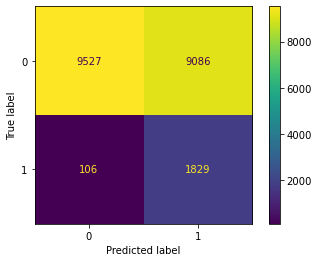

In [41]:
disp.plot()
plt.savefig("ANNTP.png")

# 8 Final Testing of ANN

In [118]:
X_Holdout = np.array(X_Holdout).astype('float32')

In [119]:
y_pred = net.predict(X_Holdout)


In [123]:
y_pred_prob = net.predict_proba(X_Holdout)


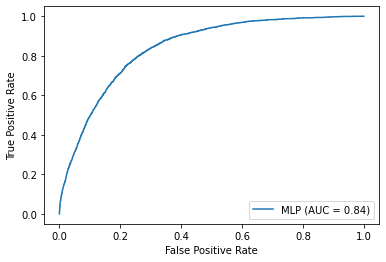

In [124]:
from sklearn import metrics
# Code adapted from below link
#https://scikit-learn.org/stable/modules/generated/sklearn.metrics.RocCurveDisplay.html#sklearn.metrics.RocCurveDisplay.from_predictions
a, b, c = metrics.roc_curve(y_Holdout, y_pred_prob)
roc_auc = metrics.auc(a, b)
display = metrics.RocCurveDisplay(fpr=a, tpr=b, roc_auc=roc_auc, estimator_name='MLP')
display.plot()

In [120]:
plt.show()

In [125]:
cm = confusion_matrix(y_Holdout, y_pred_prob.round())
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                            )

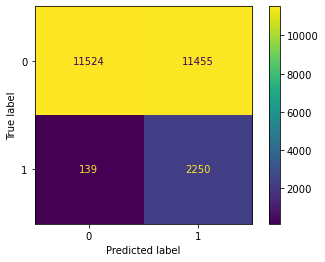

In [127]:
disp.plot()
plt.savefig("ANN.png")